In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def coth(a):
    if a>0: return (1+tf.math.exp(-2*a))/(1-tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)+1)/(tf.math.exp(2*a)-1)
    if a==0: return 0

def tanh(a):
    if a>0: return (1-tf.math.exp(-2*a))/(1+tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)-1)/(tf.math.exp(2*a)+1)
    if a==0: return 0

In [3]:
data=100
layer=10
n_ini=1.0
n_fin=0.1
dn=-0.1
m2=-1
lam=1
c_reg1=0.03
c_reg2=0

<tf.Variable 'Variable:0' shape=(10,) dtype=float64, numpy=
array([0.67454856, 1.52291862, 2.68817644, 0.66219844, 0.21579788,
       2.0943891 , 5.93820276, 4.40954199, 6.07679221, 9.21355931])>
tf.Tensor(
[ 3.01490951  3.02722263  3.04978824  3.09134316  3.16854751  3.31437385
  3.59861219  4.18820179  5.58607614 10.29821491], shape=(10,), dtype=float64)


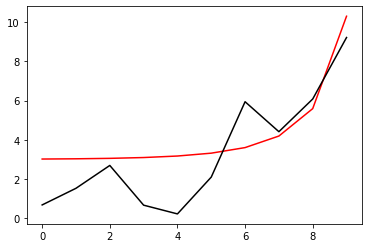

In [4]:
h=tf.zeros(layer)
h_in=[]
#h_in=[3.0205426, 3.022307 , 3.0291433, 3.04402  , 3.0732646, 3.131582 ,
# 3.2585216, 3.5762587, 4.59116  , 9.752249]
for i in range (layer):
#   midd=np.float64(10.0)
#    h_in.append(midd)
#    midd=3*coth(3*((i-layer)*dn)).numpy()
#    h_in.append(midd)
    mu=1/(1-i/10)
    h_inn=np.float64(np.random.normal(mu, 1))
    h_in.append(h_inn)
h=tf.Variable(h_in)
print(h)

h_real=tf.zeros(layer)
middd=[]
for i in range (layer):
    midd=3*coth(3*((i-layer)*dn)).numpy()
    middd.append(midd)
h_real=tf.constant(middd)
print(h_real)
plt.plot(h_real, 'r-')
plt.plot(h.numpy(), 'k-')
plt.show()

In [5]:
def F_func(a,b):
    return 2*b/n_fin-m2*a-lam*(a**3)

def t_func(a):
    return 0.5*(tf.math.tanh(100*(a-0.1))-tf.math.tanh(100*(a+0.1))+2)

In [6]:
def LP2(hh, phi, pi):
    for j in range (layer-1):
        phi1=phi+dn*pi
        pi1 =phi*m2*dn+(1-dn*hh[j])*pi+dn*lam*(phi1**3)
        phi=phi1
        pi=pi1
    return phi, pi
def NN_func_p(hh):
    Positive=[]
    while len(Positive)<data:
        phi1=np.random.uniform(0.0, 1.5, 10000)
        pi1=np.random.uniform(-0.2, 0.2, 10000)
        phi_1, pi_1=LP2(hh, phi1, pi1)
        for i in range (10000):
            if len(Positive)>=100: break
            if tf.math.abs(F_func(phi_1[i], pi_1[i]))<0.1: Positive.append([phi1[i], pi1[i]]), print(len(Positive))
            else: continue
    return Positive
def NN_func_n(hh):
    Negative=[]
    while len(Negative)<data:
        phi1=np.random.uniform(0.0, 1.5, 200)
        pi1=np.random.uniform(-0.2, 0.2, 200)
        phi_1, pi_1 = LP2(hh, phi1, pi1)
        for i in range (200):
            if len(Negative)>=100: break
            if tf.math.abs(F_func(phi_1[i], pi_1[i]))>=0.1: Negative.append([phi1[i], pi1[i]])
            else: continue
    return Negative
def NN_func_01(hh, list1):
    PP=[]
    NN=[]
    for i in range (data):
        phi=list1[i][0]
        pi=list1[i][1]
        if tf.math.abs(LP2(hh, phi, pi)[1])<0.1: PP.append([phi, pi])
        else: NN.append([phi, pi])
    return PP, NN

In [7]:
Positive=NN_func_p(h_real)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100


In [8]:
Negative=NN_func_n(h_real)

In [9]:
[Positive0, Positive1]=NN_func_01(h, Positive)
[Negative0, Negative1]=NN_func_01(h, Negative)

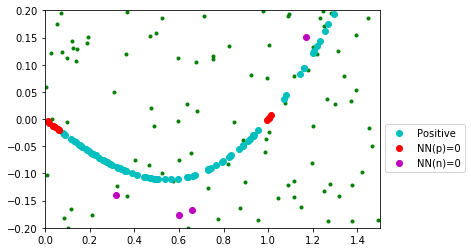

In [10]:
x_data1=[v[0] for v in Positive0]
y_data1=[v[1] for v in Positive0]
x_data2=[v[0] for v in Positive1]
y_data2=[v[1] for v in Positive1]
x_data3=[v[0] for v in Negative0]
y_data3=[v[1] for v in Negative0]
x_data4=[v[0] for v in Negative1]
y_data4=[v[1] for v in Negative1]
plt.plot(x_data4, y_data4, 'g.')
plt.plot(x_data2, y_data2, 'co', label='Positive')
plt.plot(x_data1, y_data1, 'ro', label='NN(p)=0')
plt.plot(x_data3, y_data3, 'mo', label='NN(n)=0')
plt.xlim(0.0, 1.5)
plt.ylim(-0.2, 0.2)
plt.legend(bbox_to_anchor=(1, 0.5))
plt.show()

# Error function

$E=\sum_{data} \left\vert y(\bar{x}^{(1)}) - \bar{y} \right\vert+E_{reg}(W)$
, $E_{reg}=c_{reg}^{(1)}\sum_{n=1}^{N-1}(\eta^{(n)})^{4}(h(\eta^{(n+1)})-h(\eta^{(n)}))^{2}+c_{reg}^{(2)}(h(\eta^{(N)})-1/\eta^{(N)})^{2}$

In [11]:
def Error_func(hh):
    phi0=np.array([v[0] for v in Positive])
    pi0=np.array([v[1] for v in Positive])
    phi1=np.array([v[0] for v in Negative])
    pi1=np.array([v[1] for v in Negative])
    phi_0, pi_0=LP2(hh, phi0, pi0)
    phi_1, pi_1=LP2(hh, phi1, pi1)
    PPlist=t_func(pi_0)
    NNlist=t_func(pi_1)
    sum_p=sum(PPlist)
    sum_n=data-sum(NNlist)

    inside=0
    for k in range (layer-1):
        second=((n_ini+k*dn)**4)*((hh[k+1]-hh[k])**2)
        inside=inside+second
    E_reg1=c_reg1*inside
    E_reg2=c_reg2*((hh[layer-1]-1/n_fin)**2)
    return E_reg1+E_reg2+sum_p+sum_n

In [12]:
print(Error_func(h_real))
print(Error_func(h))

tf.Tensor(0.9087703304208687, shape=(), dtype=float64)
tf.Tensor(92.44995883381752, shape=(), dtype=float64)


In [13]:
def run():
    with tf.GradientTape() as g:
        loss=Error_func(h) #돌리기전에 Error함수 수정 잊지말것
        gradients=g.gradient(loss, [h])
    optimizer.apply_gradients(zip(gradients, [h]))

100 92.423010801803
[0.65591007 1.50262502 2.66367038 0.65226408 0.20707767 2.08882718
 5.934643   4.40940332 6.07734801 9.2135292 ]


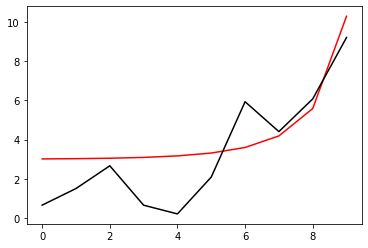

200 92.42144872042589
[0.65976328 1.50051933 2.65280847 0.65518213 0.20798742 2.08785079
 5.93220518 4.40882061 6.07643229 9.21349909]


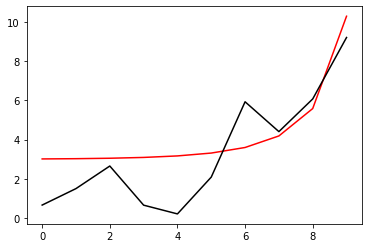

300 92.41993413458961
[0.66461744 1.49916442 2.64253012 0.65852211 0.2092264  2.08702746
 5.92980506 4.40822386 6.0754703  9.21346897]


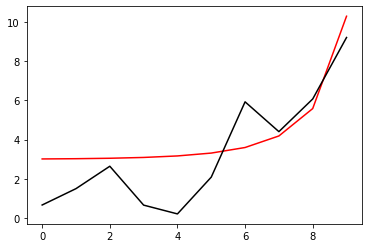

400 92.4184265074316
[0.66959206 1.49786102 2.63231633 0.66179406 0.21042593 2.08617629
 5.92739141 4.4076176  6.07450494 9.21343884]


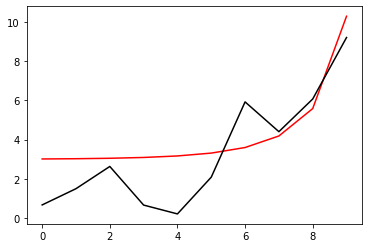

500 92.41692421378822
[0.6746497  1.49657469 2.62213787 0.66496907 0.21156267 2.08528511
 5.92496023 4.40700128 6.07353824 9.2134087 ]


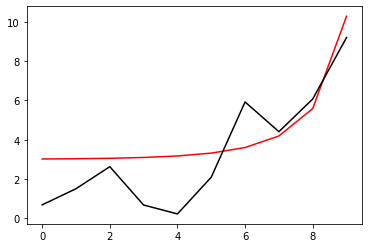

600 92.41542552723956
[0.67979652 1.49530485 2.61199011 0.66804115 0.21263027 2.08435001
 5.92250984 4.40637408 6.07257019 9.21337856]


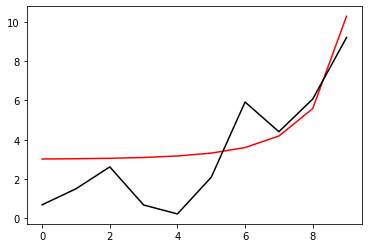

700 92.41392846803119
[0.68504212 1.49405286 2.6018694  0.67100488 0.21362269 2.08336714
 5.92003856 4.40573517 6.07160077 9.2133484 ]


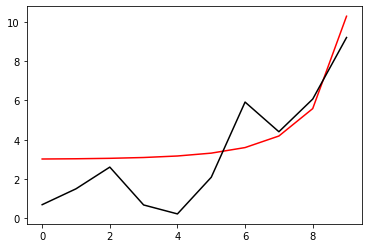

800 92.41243074198238
[0.69039765 1.49282035 2.59177177 0.67385419 0.21453318 2.08233228
 5.91754459 4.40508373 6.07063011 9.21331823]


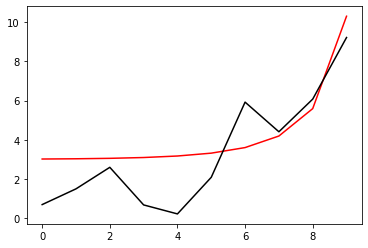

900 92.41092966139192
[0.69587604 1.49160926 2.58169276 0.67658211 0.2153541  2.08124069
 5.91502599 4.404419   6.06965851 9.21328806]


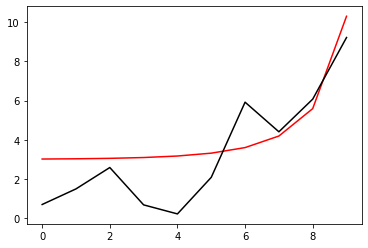

1000 92.40942204007813
[0.7014924  1.49042181 2.57162739 0.67918061 0.21607675 2.08008707
 5.9124807  4.40374032 6.06868651 9.21325788]


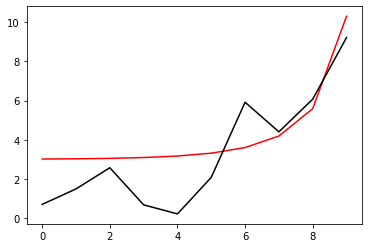

1100 92.40790405152626
[0.70726459 1.48926069 2.56156995 0.68164035 0.21669115 2.07886543
 5.90990652 4.40304719 6.06771507 9.21322768]


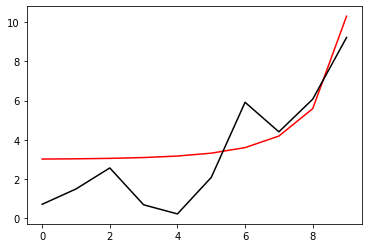

1200 92.4063710331314
[0.71321396 1.48812911 2.55151393 0.68395041 0.21718573 2.07756899
 5.90730114 4.40233939 6.06674565 9.21319748]


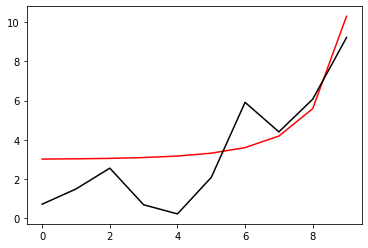

1300 92.40481720938375
[0.7193664  1.48703107 2.54145175 0.68609782 0.21754696 2.07619003
 5.90466217 4.40161713 6.06578048 9.21316727]


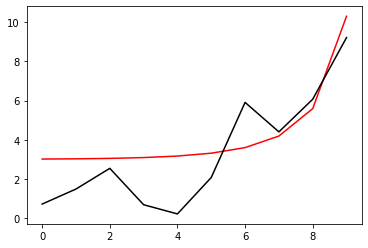

1400 92.40323528897711
[0.72575388 1.48597157 2.53137452 0.68806707 0.21775886 2.07471965
 5.90198723 4.40088131 6.0648229  9.21313705]


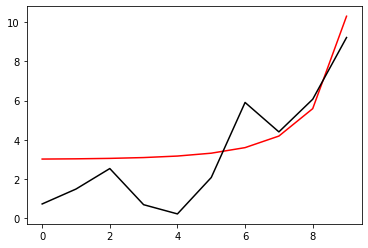

1500 92.4016158577655
[0.73241665 1.48495714 2.52127167 0.6898393  0.21780223 2.07314758
 5.89927402 4.40013391 6.0638779  9.21310682]


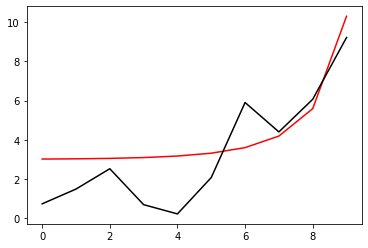

1600 92.39994642465895
[0.7394067  1.4839965  2.51113044 0.69139121 0.21765368 2.07146182
 5.89652065 4.39937865 6.06295295 9.21307659]


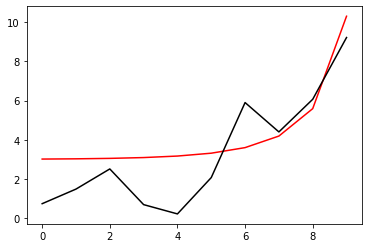

1700 92.3982098410641
[0.74679341 1.48310192 2.50093521 0.69269339 0.21728412 2.06964824
 5.893726   4.39862206 6.06205947 9.21304634]


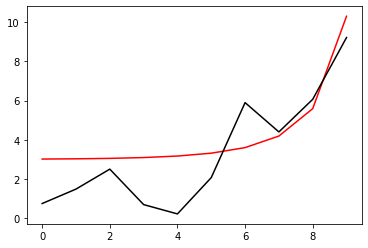

1800 92.39638150068735
[0.75467323 1.48229155 2.49066647 0.69370778 0.21665645 2.06769003
 5.89089062 4.39787545 6.06121523 9.21301609]


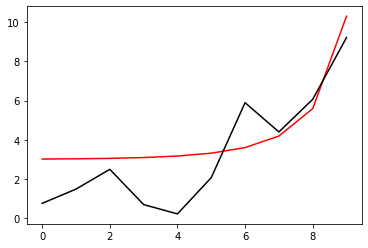

1900 92.3944239188284
[0.76318805 1.48159434 2.48029961 0.69438356 0.21572178 2.06556703
 5.88801847 4.39715865 6.06044904 9.21298583]


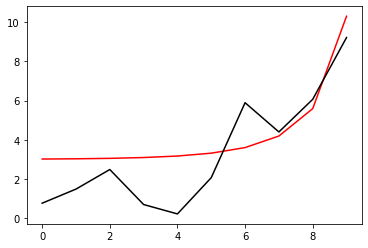

2000 92.39227487113789
[0.77256386 1.48106133 2.4698035  0.69464998 0.21441301 2.06325506
 5.88512082 4.39650784 6.0598103  9.21295556]


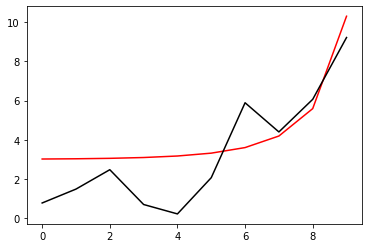

2100 92.38981626737429
[0.78320696 1.4807969  2.45914124 0.69440366 0.21263282 2.06072631
 5.88222625 4.39599442 6.05939156 9.21292529]


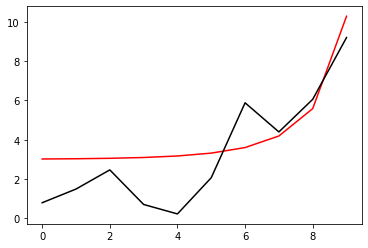

2200 92.38676336934708
[0.79601617 1.4810736  2.44828979 0.6934876  0.21023178 2.05795784
 5.87941342 4.39578251 6.05939564 9.21289501]


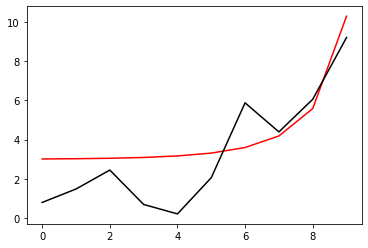

2300 92.38188722781562
[0.81412127 1.48308251 2.43749049 0.69173834 0.20701762 2.05503197
 5.87698785 4.39640827 6.06044923 9.21286474]


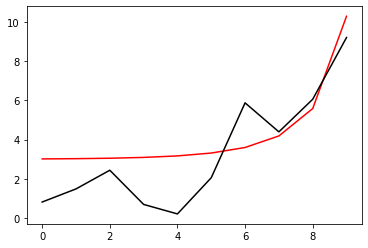

2400 91.92723658090308
[0.93169077 1.54155074 2.45762753 0.71137223 0.21854238 2.06232744
 5.88229524 4.40601587 6.0702175  9.21283451]


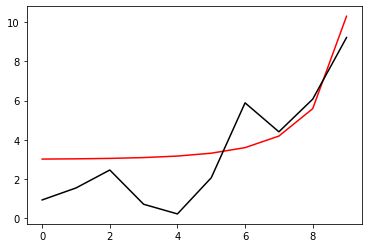

2500 90.32317956632028
[1.02563805 1.62104095 2.51473116 0.77915983 0.27361808 2.09326245
 5.89471284 4.41501191 6.0738585  9.21280436]


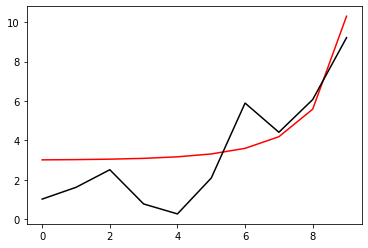

2600 90.30282100615514
[1.00017335 1.61849279 2.5177659  0.8022386  0.29689441 2.10786462
 5.90077161 4.42095711 6.07712345 9.21277424]


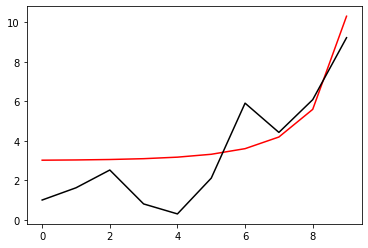

2700 90.28152891291194
[0.97485936 1.61594558 2.52102601 0.82559117 0.32074973 2.1233058
 5.90771906 4.42805752 6.08155073 9.21274416]


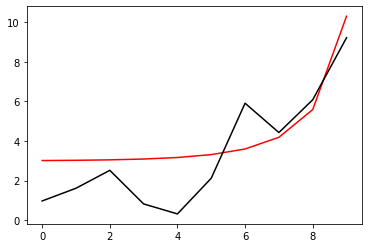

2800 90.26093597509127
[0.95050329 1.6135759  2.52427968 0.84864266 0.34433552 2.13869007
 5.91477226 4.43538482 6.08626443 9.21271413]


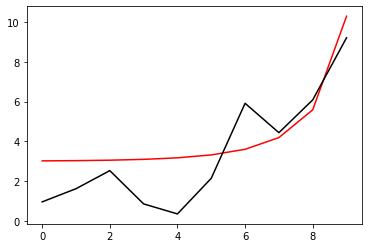

2900 90.24217091779443
[0.92761359 1.61147491 2.52734283 0.87097373 0.36703846 2.15336312
 5.921353   4.44224976 6.09061105 9.21268413]


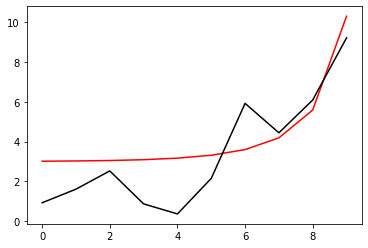

3000 90.22573782290155
[0.90642752 1.60967128 2.53009924 0.89234192 0.38850408 2.16693735
 5.92711115 4.44823053 6.09418711 9.21265418]


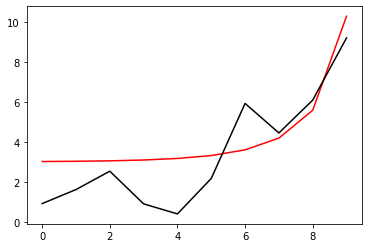

3100 90.21167236000115
[0.886989   1.60815645 2.53249278 0.9126478  0.40858402 2.1792382
 5.93187992 4.45312078 6.09679118 9.21262425]


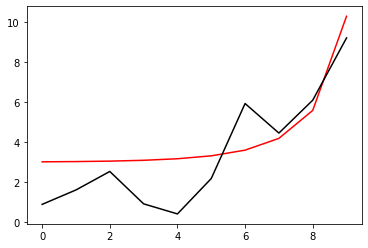

3200 90.1997518302294
[0.86922581 1.60690352 2.5345102  0.93188749 0.42726636 2.190233
 5.93561558 4.45685921 6.0983584  9.21259435]


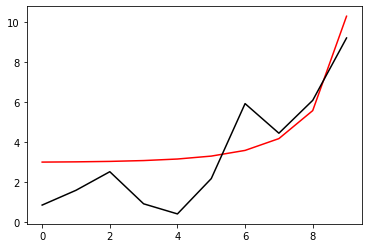

3300 90.18965322781754
[0.8530068  1.60587903 2.53616466 0.95011244 0.44461757 2.1999717
 5.9383469  4.45947049 6.09890517 9.21256446]


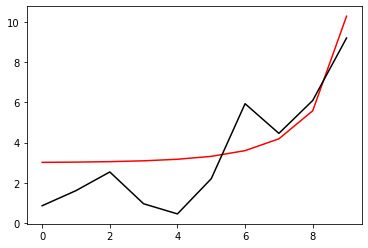

3400 90.18104432809378
[0.83817825 1.60504923 2.53748362 0.96740137 0.46074271 2.20854593
 5.94014018 4.46102423 6.09849089 9.21253457]


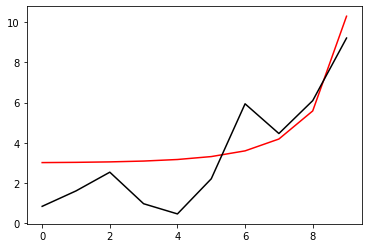

3500 90.17362597135306
[0.82458456 1.60438308 2.5385009  0.983843   0.47576098 2.21606386
 5.94107756 4.46160956 6.09719399 9.21250467]


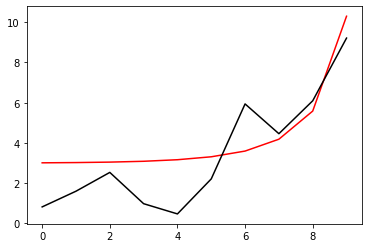

3600 90.16714615257597
[0.81207888 1.60385334 2.53925195 0.99952624 0.48979197 2.22263594
 5.9412446  4.46132049 6.0950982  9.21247475]


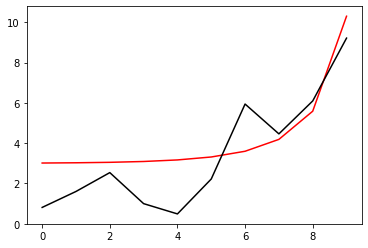

3700 90.16140023392624
[0.80052768 1.60343672 2.53977123 1.01453508 0.50294863 2.22836743
 5.94072372 4.46024817 6.09228518 9.21244481]


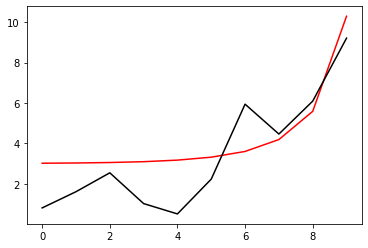

3800 90.1562254508416
[0.78981215 1.60311356 2.54009092 1.02894642 0.51533412 2.233355
 5.93959112 4.4584771  6.08883091 9.21241484]


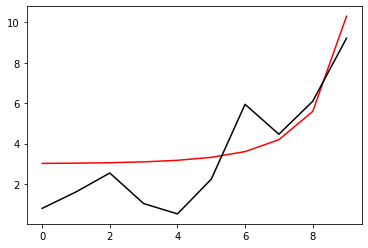

3900 90.15149382599031
[0.7798278  1.60286744 2.54024035 1.04282928 0.52704091 2.23768558
 5.93791553 4.4560837  6.08480423 9.21238484]


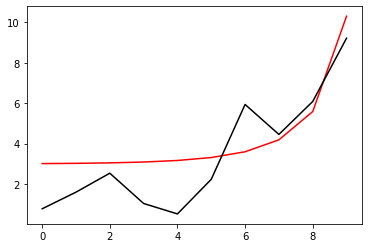

4000 90.147105329376
[0.77048336 1.60268467 2.54024589 1.05624497 0.53815092 2.24143635
 5.93575817 4.45313607 6.08026656 9.21235479]


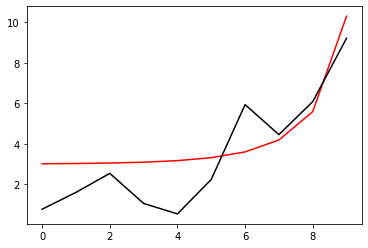

4100 90.14298196712225
[0.76169936 1.60255387 2.54013101 1.06924761 0.5487363  2.24467538
 5.9331731  4.44969439 6.07527225 9.2123247 ]


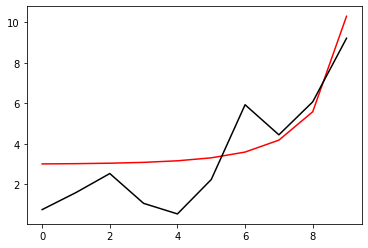

4200 90.13906294324364
[0.75340668 1.60246556 2.53991655 1.08188482 0.55886039 2.24746245
 5.93020786 4.44581158 6.06986907 9.21229456]


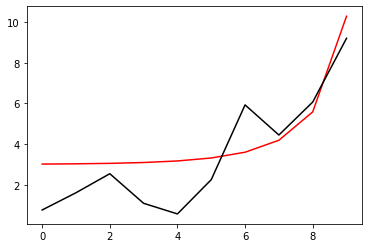

4300 90.13530081469055
[0.74554515 1.60241184 2.5396209  1.09419845 0.56857868 2.24984999
 5.92690414 4.44153406 6.06409899 9.21226436]


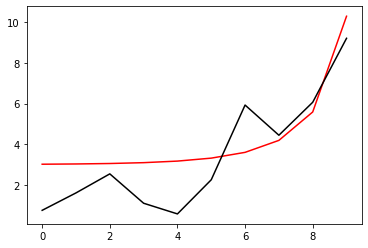

4400 90.13165848570114
[0.73806239 1.60238613 2.5392603  1.10622525 0.5779398  2.25188395
 5.92329852 4.43690252 6.05799877 9.21223411]


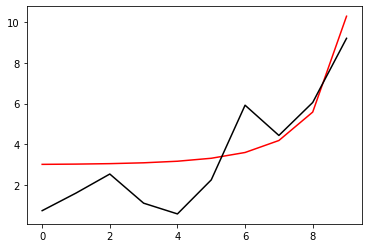

4500 90.12810687939604
[0.73091268 1.60238292 2.53884909 1.11799754 0.58698642 2.25360465
 5.9194231  4.43195266 6.05160067 9.2122038 ]


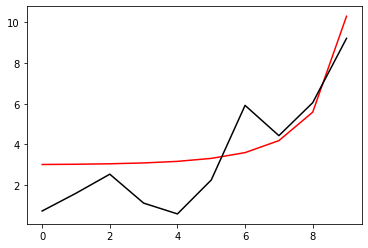

4600 90.12462314220384
[0.72405606 1.6023976  2.53839989 1.12954376 0.59575597 2.25504748
 5.91530604 4.42671581 6.044933   9.21217343]


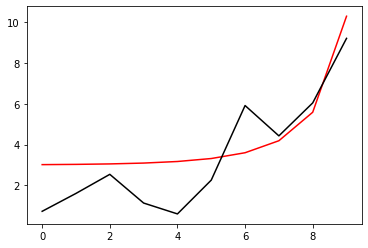

4700 90.12118926162032
[0.71745754 1.6024263  2.53792385 1.14088897 0.60428137 2.25624358
 5.91097213 4.42121951 6.03802064 9.21214299]


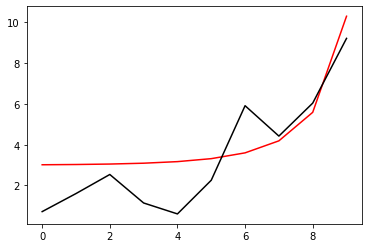

4800 90.11779100216766
[0.7110864  1.60246576 2.5374308  1.1520553  0.61259162 2.25722037
 5.9064432  4.41548802 6.03088551 9.21211249]


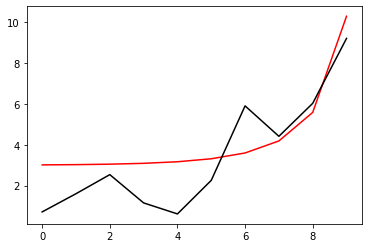

4900 90.11441708543069
[0.70491561 1.60251322 2.53692941 1.16306228 0.62071227 2.25800207
 5.90173854 4.40954275 6.02354696 9.21208191]


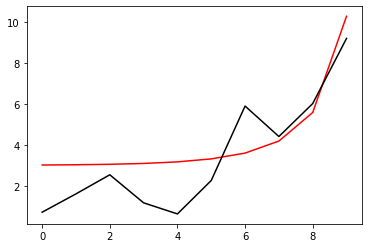

5000 90.11105855710532
[0.69892139 1.60256636 2.53642733 1.17392723 0.62866593 2.25861009
 5.89687521 4.40340264 6.01602211 9.21205127]


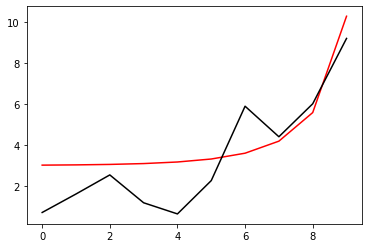

5100 90.10770829741296
[0.69308272 1.60262322 2.53593131 1.18466547 0.63647257 2.25906342
 5.89186834 4.39708451 6.00832615 9.21202055]


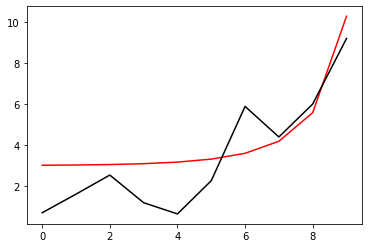

5200 90.10436064159464
[0.68738103 1.60268209 2.5354473  1.19529063 0.64414993 2.2593789
 5.88673141 4.3906033  6.00047261 9.21198975]


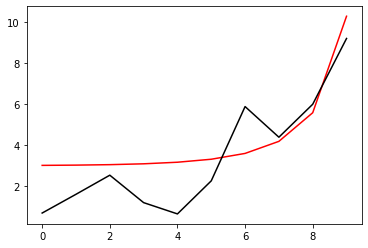

5300 90.10101108511293
[0.6817999  1.60274155 2.53498052 1.20581478 0.65171374 2.25957157
 5.88147641 4.38397238 5.99247357 9.21195889]


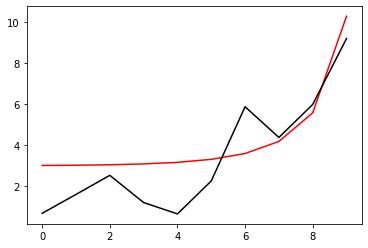

5400 90.09765605421083
[0.67632474 1.60280035 2.53453557 1.21624869 0.65917798 2.2596548
 5.8761141  4.3772037  5.98433986 9.21192794]


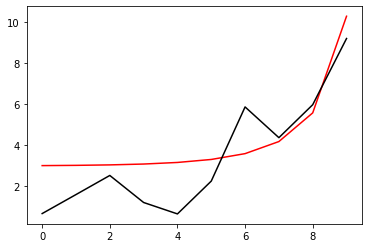

5500 90.09429272703761
[0.67094266 1.60285742 2.53411649 1.22660192 0.66655511 2.2596406
 5.87065413 4.370308   5.97608125 9.21189692]


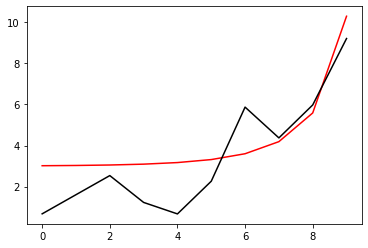

5600 90.09091889401304
[0.66564218 1.60291182 2.53372678 1.23688296 0.67385623 2.2595397
 5.86510517 4.36329501 5.96770655 9.21186581]


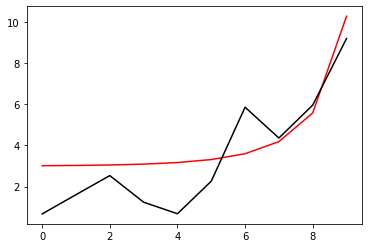

5700 90.08753284872247
[0.66041314 1.60296272 2.53336951 1.24709939 0.68109122 2.25936176
 5.85947508 4.35617351 5.95922378 9.21183463]


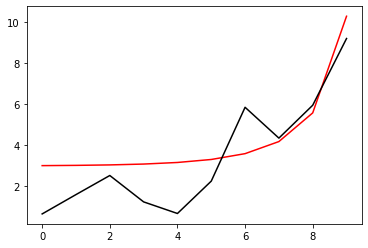

5800 90.08413330263248
[0.6552465  1.60300939 2.53304731 1.25725795 0.68826895 2.25911548
 5.85377098 4.34895153 5.95064028 9.21180336]


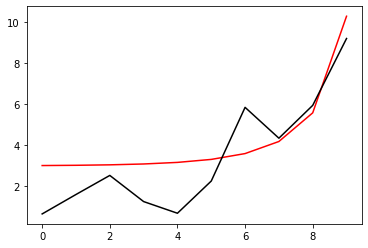

5900 90.08071931843575
[0.65013427 1.60305115 2.53276243 1.26736462 0.6953973  2.25880874
 5.84799938 4.34163642 5.94196279 9.21177202]


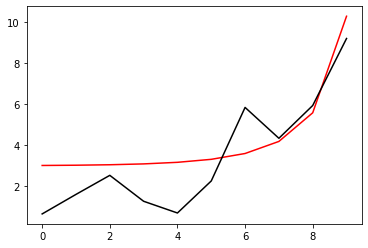

6000 90.07729025799243
[0.64506936 1.6030874  2.53251678 1.27742469 0.70248334 2.25844866
 5.84216621 4.33423494 5.93319755 9.21174058]


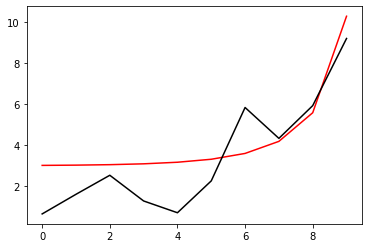

6100 90.07384574172707
[0.64004549 1.60311756 2.53231195 1.28744287 0.70953339 2.25804173
 5.83627696 4.32675336 5.92435036 9.21170907]


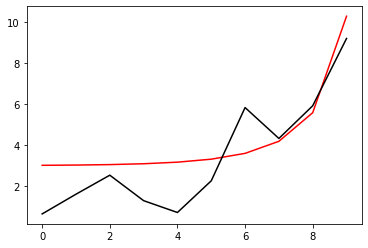

6200 90.07038561702063
[0.63505714 1.60314109 2.53214924 1.2974233  0.71655309 2.25759384
 5.83033668 4.31919754 5.91542667 9.21167747]


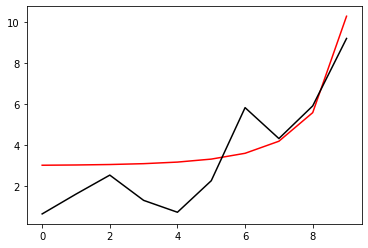

6300 90.06690993366448
[0.63009945 1.60315746 2.53202966 1.30736961 0.72354749 2.25711041
 5.82435007 4.31157296 5.90643164 9.21164578]


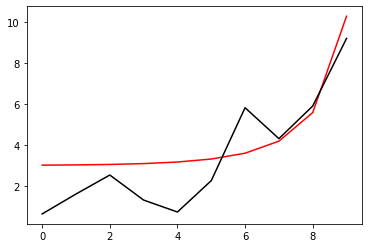

6400 90.06341892485027
[0.62516816 1.60316616 2.53195399 1.31728501 0.7305211  2.25659639
 5.81832154 4.30388482 5.89737016 9.21161401]


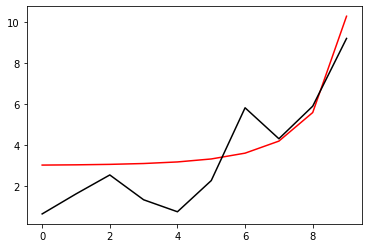

6500 90.05991299248277
[0.62025959 1.60316668 2.53192274 1.32717224 0.73747794 2.25605634
 5.81225523 4.29613804 5.88824694 9.21158215]


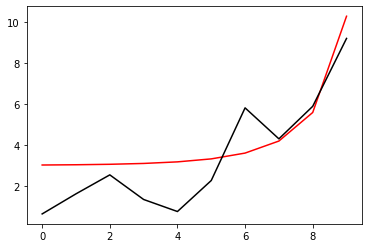

6600 90.05639269585035
[0.61537053 1.60315851 2.53193623 1.33703368 0.7444216  2.25549449
 5.80615504 4.28833736 5.87906651 9.2115502 ]


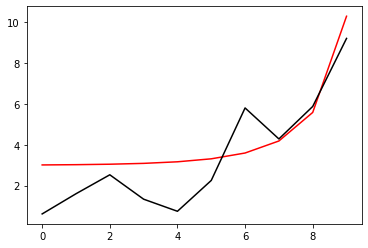

6700 90.05285874287557
[0.61049827 1.6031411  2.53199454 1.34687135 0.75135525 2.25491474
 5.8000247  4.28048735 5.86983329 9.21151817]


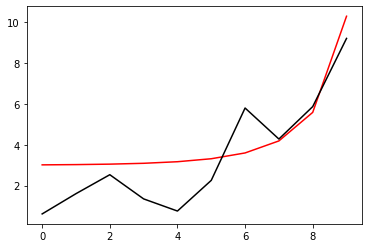

6800 90.0493119833215
[0.60564051 1.60311392 2.53209756 1.35668694 0.75828171 2.25432071
 5.79386777 4.27259241 5.86055161 9.21148604]


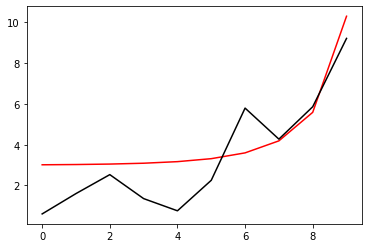

6900 90.0457534034427
[0.60079535 1.60307641 2.53224499 1.36648183 0.76520347 2.25371582
 5.78768767 4.26465688 5.85122572 9.21145383]


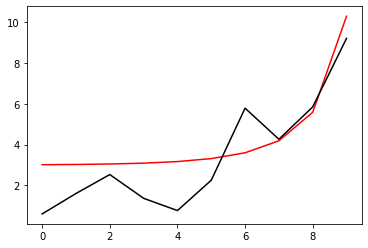

7000 90.0421841216664
[0.59596128 1.60302796 2.53243635 1.37625709 0.77212271 2.25310323
 5.78148771 4.256685   5.84185984 9.21142153]


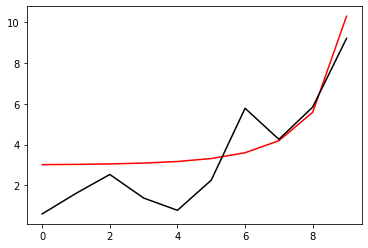

7100 90.03860538495879
[0.59113711 1.60296798 2.53267096 1.38601356 0.7790413  2.25248592
 5.77527111 4.24868095 5.83245818 9.21138913]


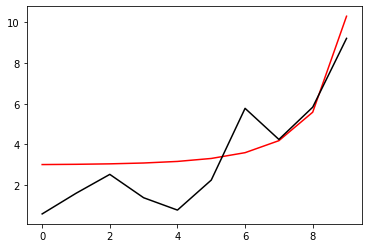

7200 90.03501856559433
[0.586322   1.6028958  2.53294799 1.39575177 0.78596089 2.2518667
 5.769041   4.24064888 5.82302493 9.21135665]


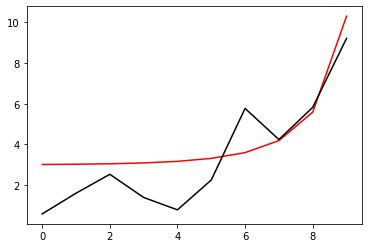

7300 90.03142515808975
[0.58151541 1.60281076 2.53326643 1.40547204 0.79288286 2.25124822
 5.76280047 4.23259293 5.8135643  9.21132408]


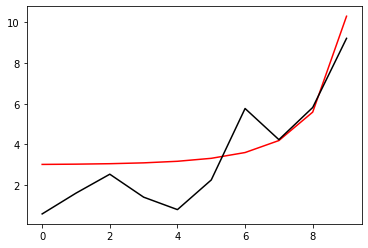

7400 90.02782677610503
[0.57671708 1.60271212 2.53362513 1.41517445 0.79980836 2.25063299
 5.75655253 4.2245172  5.80408054 9.21129141]


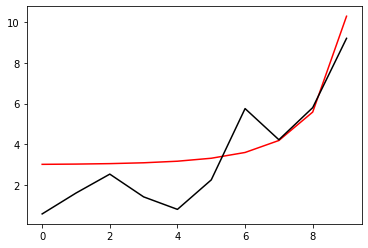

7500 90.0242251491462
[0.57192706 1.60259916 2.53402277 1.42485885 0.80673832 2.2500234
 5.75030016 4.21642583 5.79457792 9.21125866]


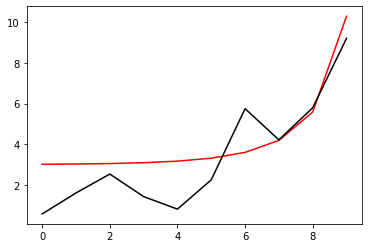

7600 90.02062211892942
[0.56714561 1.60247106 2.53445786 1.43452488 0.81367348 2.2494217
 5.74404632 4.20832296 5.78506078 9.21122582]


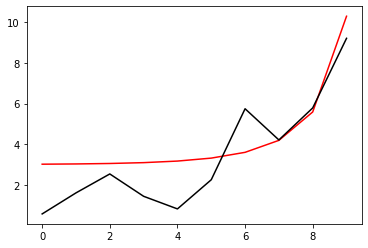

7700 90.0170196352929
[0.5623733  1.60232703 2.5349288  1.44417199 0.82061438 2.24883004
 5.73779393 4.20021275 5.7755335  9.21119288]


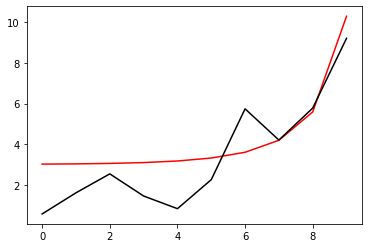

7800 90.0134197515594
[0.5576109  1.60216618 2.53543381 1.45379941 0.82756137 2.24825047
 5.73154588 4.19209939 5.7660005  9.21115985]


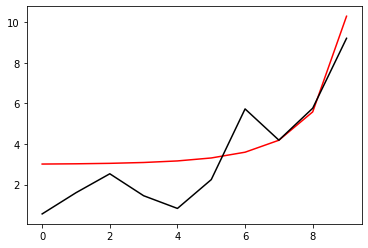

7900 90.00982461927394
[0.55285944 1.60198763 2.535971   1.46340619 0.83451463 2.24768493
 5.72530505 4.18398708 5.75646628 9.21112673]


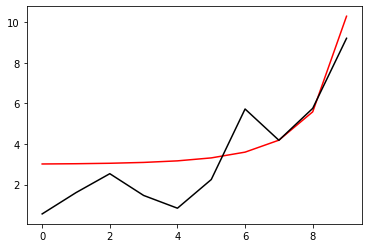

8000 90.00623648225721
[0.54812015 1.60179043 2.53653831 1.47299121 0.84147416 2.24713528
 5.7190743  4.17588008 5.74693541 9.21109352]


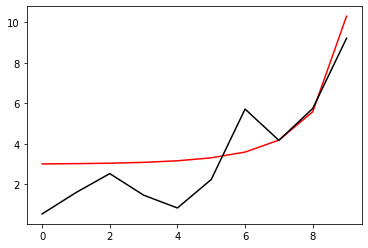

8100 90.00265766992948
[0.54339448 1.60157362 2.53713359 1.48255315 0.8484398  2.24660328
 5.71285649 4.16778266 5.7374125  9.21106022]


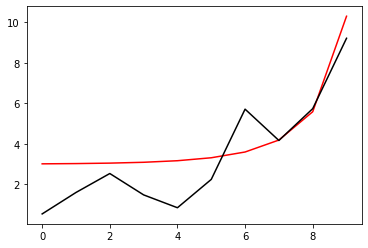

8200 89.99909058987807
[0.53868409 1.60133619 2.53775452 1.49209054 0.85541124 2.24609061
 5.70665443 4.15969913 5.72790221 9.21102683]


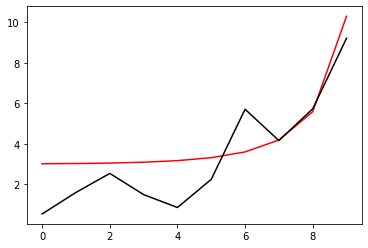

8300 89.99553771965273
[0.53399083 1.60107711 2.53839867 1.50160174 0.86238801 2.24559883
 5.70047094 4.1516338  5.71840928 9.21099335]


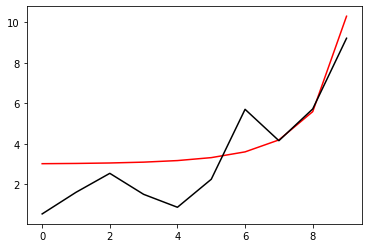

8400 89.99200159778982
[0.52931675 1.6007953  2.53906352 1.51108495 0.86936948 2.24512946
 5.69430881 4.14359103 5.70893848 9.21095977]


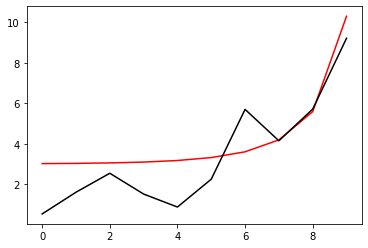

8500 89.9884848140789
[0.52466405 1.60048968 2.53974639 1.52053824 0.8763549  2.24468391
 5.6881708  4.13557517 5.69949463 9.21092611]


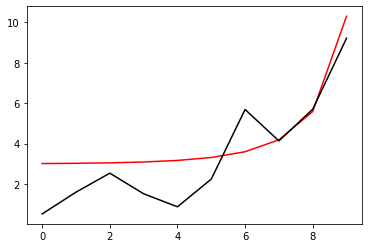

8600 89.98498999909886
[0.52003514 1.60015911 2.54044453 1.52995951 0.88334336 2.24426349
 5.68205965 4.1275906  5.69008257 9.21089235]


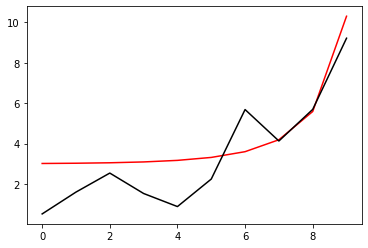

8700 89.98151981306442
[0.51543256 1.59980246 2.54115506 1.53934655 0.89033384 2.24386944
 5.67597807 4.11964168 5.68070718 9.21085851]


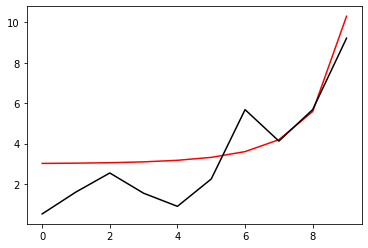

8800 89.97807693403607
[0.51085901 1.59941855 2.54187503 1.54869701 0.89732518 2.24350292
 5.66992873 4.11173278 5.67137334 9.21082458]


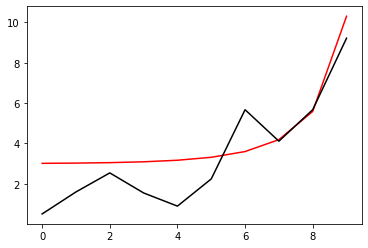

8900 89.97466404555993
[0.50631732 1.59900623 2.5426014  1.55800842 0.90431608 2.24316498
 5.66391426 4.10386822 5.66208594 9.21079055]


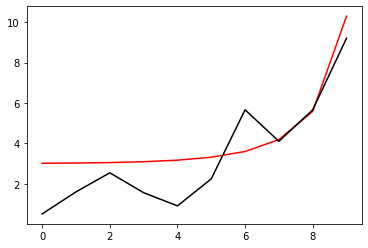

9000 89.97128382381474
[0.50181046 1.59856429 2.54333103 1.56727822 0.91130516 2.24285658
 5.65793723 4.09605234 5.65284988 9.21075644]


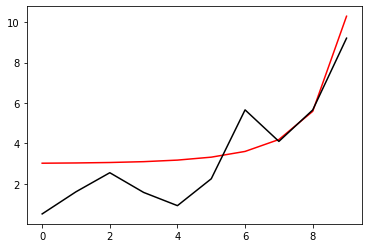

9100 89.9679389243559
[0.49734151 1.59809154 2.54406072 1.57650372 0.9182909  2.2425786
 5.65200018 4.0882894  5.64367002 9.21072224]


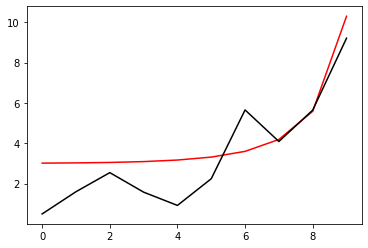

9200 89.96463196855552
[0.49291366 1.59758677 2.54478723 1.58568216 0.92527169 2.24233183
 5.64610558 4.08058363 5.6345512  9.21068796]


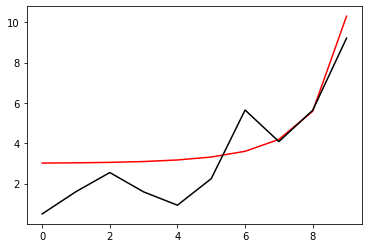

9300 89.96136552984989
[0.48853018 1.5970488  2.54550723 1.59481072 0.93224582 2.24211695
 5.64025583 4.07293919 5.6254982  9.21065358]


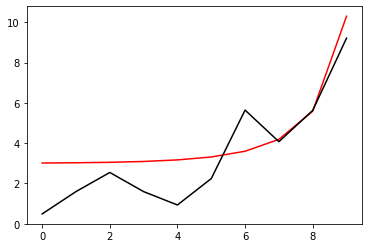

9400 89.95814211991132
[0.48419442 1.59647642 2.54621738 1.60388646 0.93921149 2.24193456
 5.63445327 4.06536018 5.61651575 9.21061912]


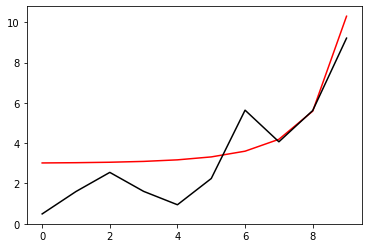

9500 89.95496417487162
[0.47990979 1.59586846 2.54691429 1.61290644 0.94616682 2.24178517
 5.62870014 4.05785062 5.60760852 9.21058458]


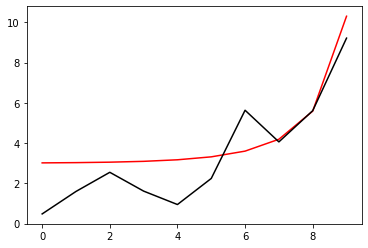

9600 89.95183404172981
[0.47567974 1.59522376 2.54759456 1.62186765 0.95310986 2.2416692
 5.62299862 4.0504144  5.59878109 9.21054995]


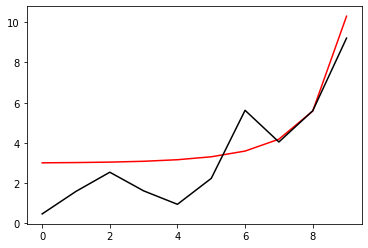

9700 89.94875396508067
[0.47150777 1.59454117 2.54825478 1.63076704 0.96003859 2.24158695
 5.6173508  4.04305535 5.59003792 9.21051523]


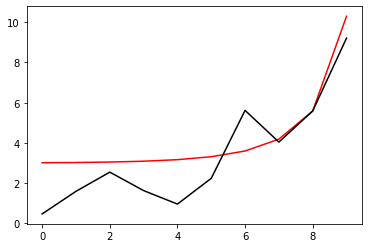

9800 89.9457260743056
[0.46739736 1.59381958 2.54889154 1.63960157 0.96695095 2.24153866
 5.61175866 4.03577716 5.58138338 9.21048043]


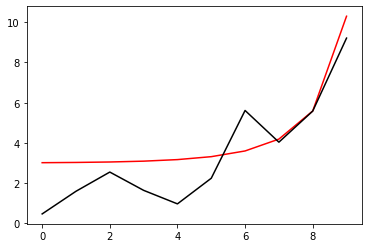

9900 89.94275237136593
[0.46335201 1.5930579  2.54950145 1.64836818 0.97384483 2.24152447
 5.6062241  4.02858339 5.57282171 9.21044555]


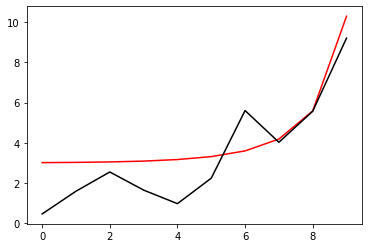

10000 89.93983471933957
[0.45937518 1.59225511 2.55008115 1.65706383 0.98071808 2.24154444
 5.6007489  4.02147747 5.564357   9.21041059]


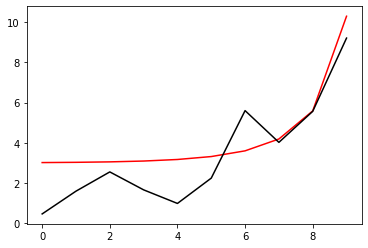

In [14]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.93697483183749
[0.45547031 1.5914102  2.55062733 1.66568549 0.98756854 2.24159854
 5.59533474 4.01446266 5.55599319 9.21037555]


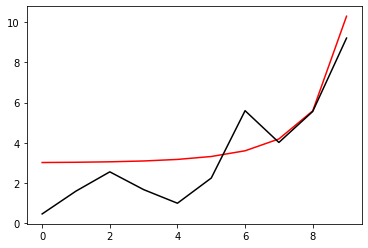

200 89.93417426343056
[0.45164074 1.59052221 2.55113671 1.67423019 0.99439404 2.24168666
 5.58998319 4.00754209 5.54773406 9.21034043]


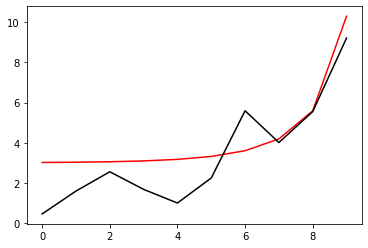

300 89.93143440120856
[0.44788979 1.58959027 2.5516061  1.682695   1.00119241 2.24180862
 5.58469571 4.00071871 5.53958322 9.21030523]


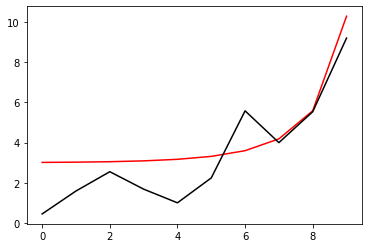

400 89.92875645758235
[0.44422065 1.58861353 2.5520324  1.69107707 1.00796148 2.24196414
 5.57947361 3.99399529 5.53154406 9.21026995]


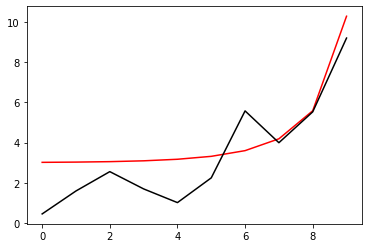

500 89.92614146442638
[0.44063639 1.58759123 2.55241257 1.69937363 1.01469914 2.24215291
 5.57431812 3.98737442 5.52361981 9.2102346 ]


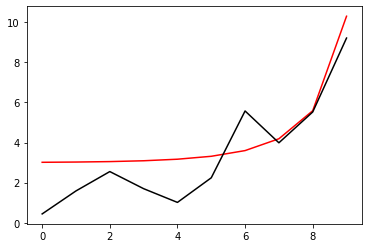

600 89.92359026864139
[0.43713999 1.58652267 2.55274371 1.70758198 1.02140327 2.24237453
 5.56923032 3.98085849 5.51581346 9.21019917]


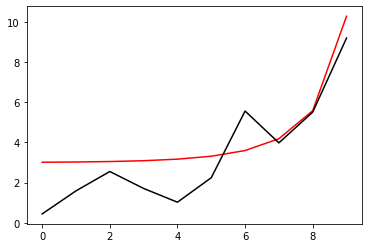

700 89.9211035292004
[0.43373425 1.58540723 2.55302301 1.71569958 1.02807182 2.24262854
 5.56421117 3.97444971 5.50812781 9.21016367]


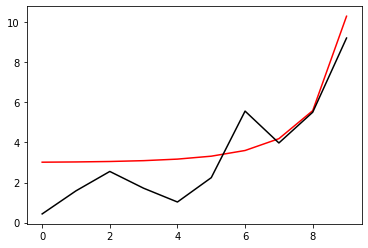

800 89.91868171571906
[0.43042183 1.58424437 2.55324781 1.72372396 1.0347028  2.24291443
 5.55926153 3.96815007 5.50056541 9.21012809]


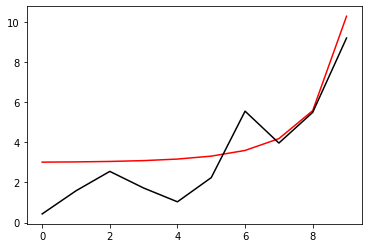

900 89.91632510856986
[0.42720522 1.58303363 2.55341558 1.73165282 1.04129428 2.24323164
 5.55438209 3.96196138 5.4931286  9.21009245]


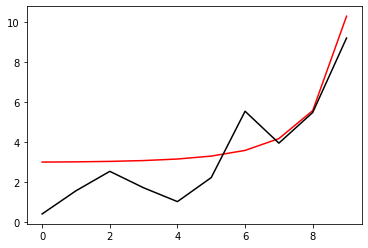

1000 89.91403380053801
[0.42408672 1.58177463 2.55352394 1.73948399 1.04784441 2.24357957
 5.54957345 3.95588521 5.48581947 9.21005673]


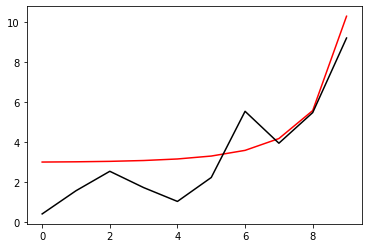

1100 89.91180769999052
[0.42106842 1.5804671  2.55357067 1.74721544 1.05435142 2.24395755
 5.54483607 3.94992293 5.47863986 9.21002094]


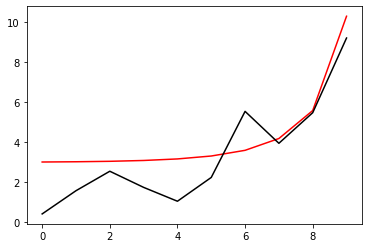

1200 89.9096465355102
[0.41815222 1.57911083 2.55355371 1.75484533 1.06081364 2.24436492
 5.54017028 3.94407572 5.47159139 9.20998509]


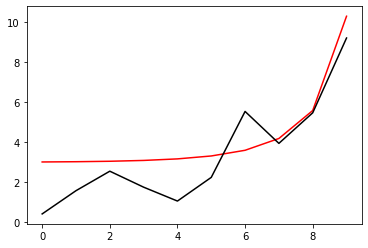

1300 89.90754986192066
[0.41533982 1.57770574 2.55347118 1.76237197 1.06722949 2.24480094
 5.53557631 3.9383445  5.46467541 9.20994917]


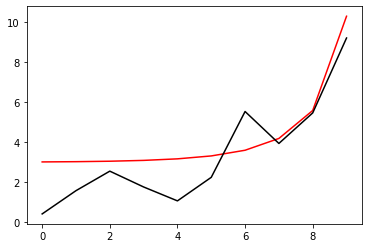

1400 89.90551706760867
[0.41263266 1.57625182 2.55332137 1.76979385 1.07359751 2.24526488
 5.53105425 3.93273002 5.45789304 9.20991318]


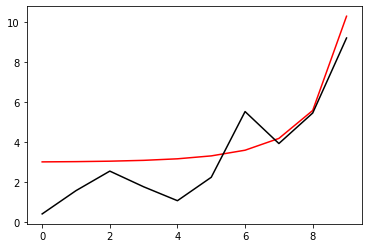

1500 89.90354738303125
[0.41003198 1.57474917 2.55310276 1.77710964 1.07991635 2.24575598
 5.52660408 3.9272328  5.45124514 9.20987713]


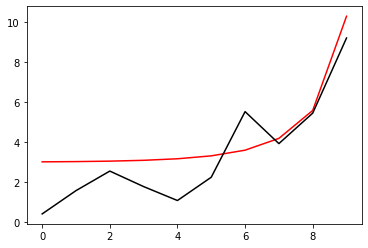

1600 89.90163989027691
[0.40753879 1.57319799 2.55281401 1.7843182  1.08618476 2.24627344
 5.52222567 3.92185315 5.44473233 9.20984101]


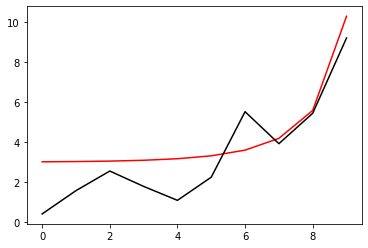

1700 89.89979353353826
[0.40515386 1.57159854 2.55245397 1.79141858 1.09240164 2.24681648
 5.51791876 3.91659119 5.438355   9.20980484]


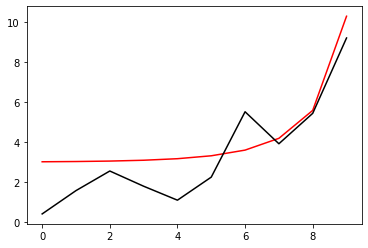

1800 89.89800713034077
[0.40287774 1.56995123 2.55202168 1.79841    1.09856598 2.2473843
 5.51368302 3.91144682 5.43211328 9.2097686 ]


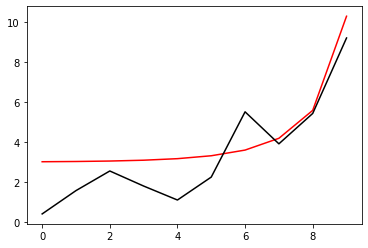

1900 89.8962793833676
[0.40071073 1.56825653 2.55151636 1.80529188 1.10467691 2.24797608
 5.50951797 3.90641976 5.42600708 9.20973231]


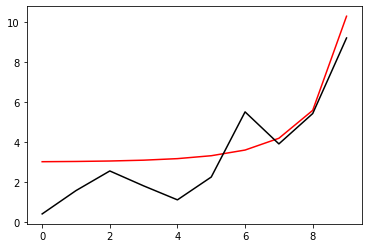

2000 89.89460889271513
[0.39865293 1.56651501 2.55093744 1.81206384 1.11073369 2.248591
 5.50542307 3.90150954 5.42003609 9.20969596]


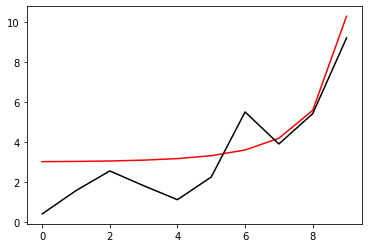

2100 89.89299416841544
[0.39670419 1.56472733 2.55028451 1.81872564 1.1167357  2.24922827
 5.50139767 3.89671551 5.41419976 9.20965955]


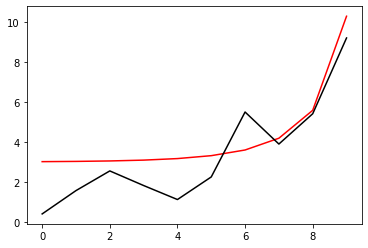

2200 89.89143364306388
[0.39486416 1.56289423 2.54955735 1.82527728 1.12268244 2.24988706
 5.49744103 3.89203684 5.40849736 9.20962309]


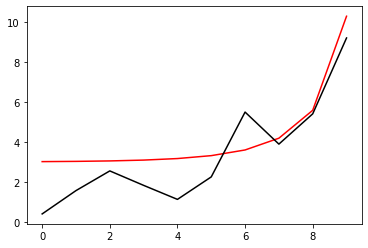

2300 89.88992568439924
[0.39313229 1.56101653 2.5487559  1.83171888 1.12857352 2.25056658
 5.49355234 3.88747254 5.40292792 9.20958657]


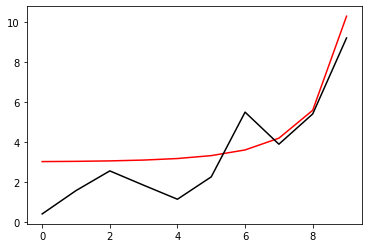

2400 89.88846860769075
[0.39150779 1.55909515 2.5478803  1.83805076 1.13440868 2.25126604
 5.48973069 3.88302146 5.39749032 9.20955   ]


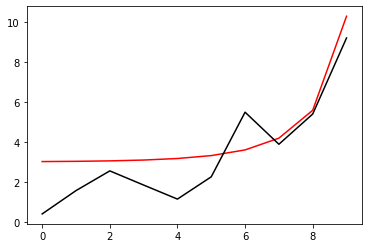

2500 89.88706068779939
[0.38998973 1.55713107 2.54693084 1.8442734  1.14018779 2.25198466
 5.48597513 3.8786823  5.39218322 9.20951338]


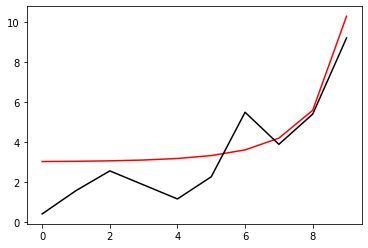

2600 89.88570017079587
[0.38857696 1.55512533 2.54590796 1.85038742 1.1459108  2.25272166
 5.48228461 3.87445364 5.38700514 9.20947671]


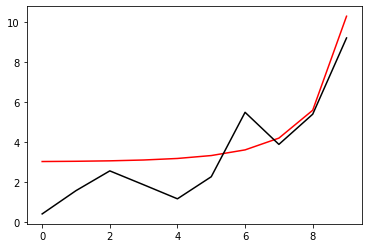

2700 89.88438528503062
[0.38726817 1.55307905 2.54481225 1.85639361 1.15157777 2.25347629
 5.47865803 3.8703339  5.38195442 9.20943999]


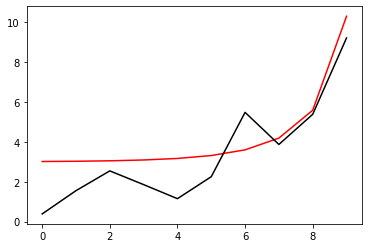

2800 89.88311425156925
[0.38606189 1.5509934  2.54364445 1.86229287 1.15718889 2.25424782
 5.47509426 3.86632142 5.37702927 9.20940322]


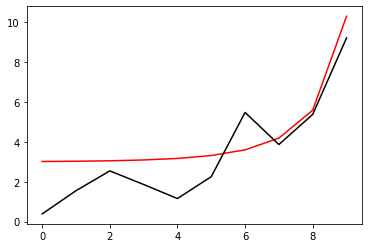

2900 89.8818852939227
[0.3849565  1.5488696  2.54240542 1.86808626 1.1627444  2.25503552
 5.47159209 3.86241441 5.37222775 9.20936641]


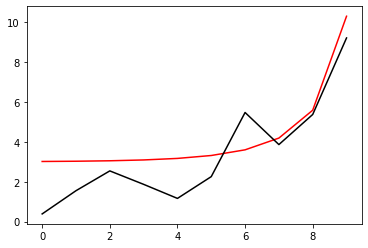

3000 89.88069664701787
[0.38395025 1.54670894 2.54109615 1.87377493 1.16824467 2.25583868
 5.46815027 3.85861098 5.36754781 9.20932955]


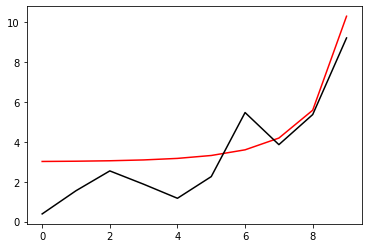

3100 89.8795465653712
[0.38304125 1.54451273 2.53971776 1.87936018 1.17369013 2.25665663
 5.46476753 3.85490917 5.36298726 9.20929265]


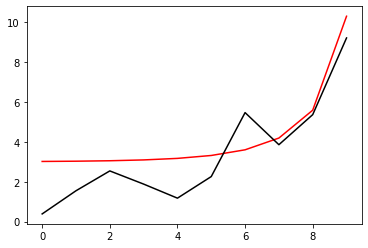

3200 89.87843333044191
[0.38222753 1.54228232 2.53827144 1.88484337 1.17908128 2.25748868
 5.46144255 3.85130692 5.35854386 9.2092557 ]


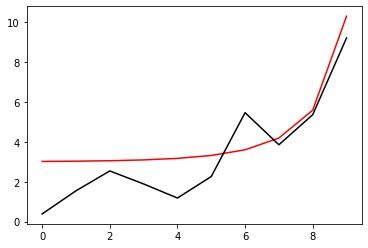

3300 89.87735525715739
[0.38150698 1.5400191  2.5367585  1.89022599 1.18441873 2.25833421
 5.45817399 3.84780213 5.35421522 9.20921871]


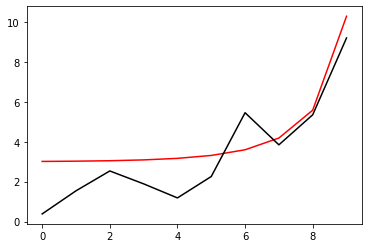

3400 89.8763106996149
[0.38087742 1.53772449 2.53518033 1.89550957 1.18970311 2.25919257
 5.45496048 3.84439261 5.34999893 9.20918168]


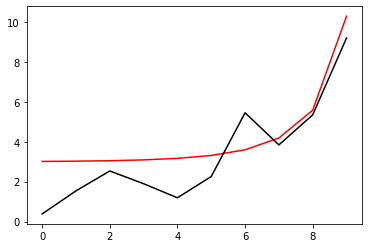

3500 89.87529805597514
[0.38033661 1.53539991 2.53353839 1.90069576 1.19493512 2.26006317
 5.45180066 3.84107616 5.34589249 9.20914462]


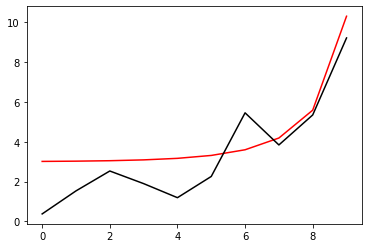

3600 89.87431577257507
[0.37988222 1.53304681 2.53183422 1.90578624 1.20011554 2.26094541
 5.44869313 3.83785051 5.34189334 9.20910751]


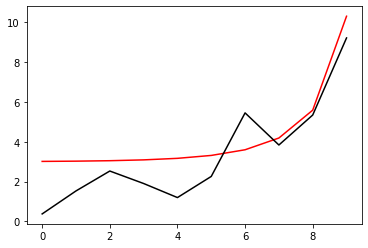

3700 89.8733623472931
[0.37951187 1.53066665 2.53006942 1.91078276 1.20524516 2.26183872
 5.44563648 3.83471338 5.33799889 9.20907037]


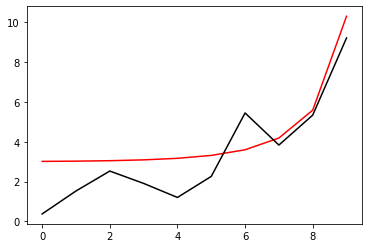

3800 89.87243633220751
[0.37922315 1.5282609  2.52824561 1.91568711 1.21032484 2.26274257
 5.44262931 3.83166245 5.3342065  9.20903319]


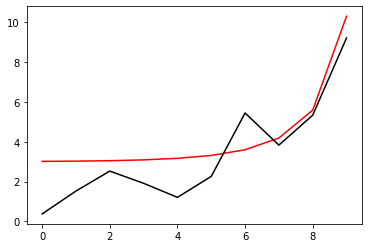

3900 89.87153633559605
[0.37901361 1.52583102 2.52636449 1.92050113 1.21535544 2.26365643
 5.43967023 3.82869539 5.33051353 9.20899597]


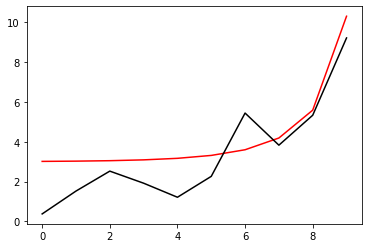

4000 89.87066102332399
[0.37888077 1.52337848 2.52442777 1.92522668 1.22033789 2.26457978
 5.43675783 3.82580988 5.32691731 9.20895872]


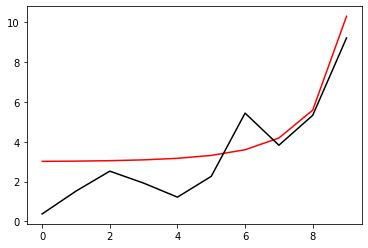

4100 89.86980911967545
[0.37882215 1.52090472 2.52243721 1.92986565 1.22527313 2.26551214
 5.43389071 3.82300358 5.32341516 9.20892144]


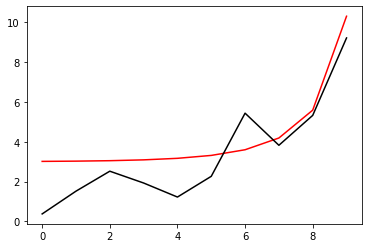

4200 89.86897940768006
[0.37883524 1.51841119 2.52039455 1.93441993 1.2301621  2.26645304
 5.43106751 3.82027418 5.32000441 9.20888412]


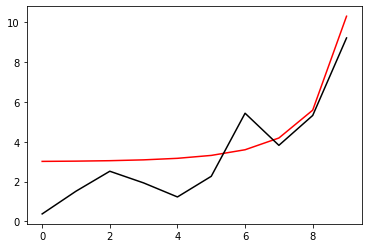

4300 89.86817072898883
[0.37891756 1.51589932 2.51830159 1.93889145 1.23500577 2.26740203
 5.42828686 3.81761934 5.3166824  9.20884677]


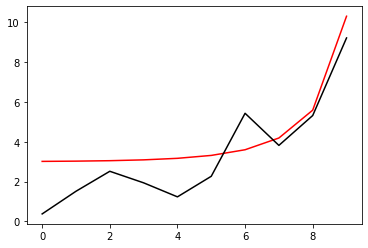

4400 89.86738198335284
[0.37906663 1.51337052 2.5161601  1.94328211 1.23980515 2.26835868
 5.42554739 3.81503679 5.31344647 9.20880939]


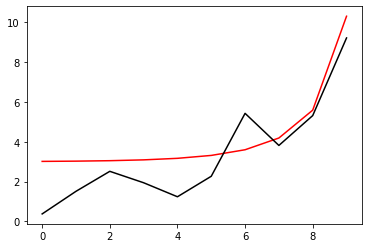

4500 89.86661212775472
[0.37927996 1.51082617 2.51397187 1.94759383 1.2445612  2.26932258
 5.42284779 3.81252424 5.310294   9.20877198]


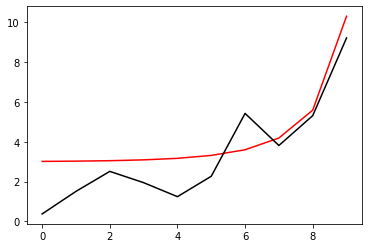

4600 89.86586017524375
[0.37955513 1.50826765 2.51173867 1.95182852 1.24927493 2.27029332
 5.42018674 3.81007946 5.30722238 9.20873454]


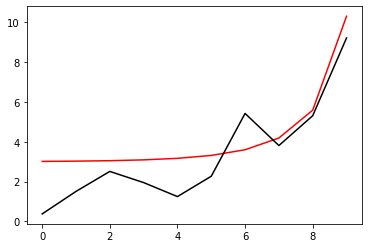

4700 89.86512519351962
[0.3798897  1.50569628 2.50946229 1.95598807 1.25394734 2.27127054
 5.41756295 3.80770023 5.30422907 9.20869707]


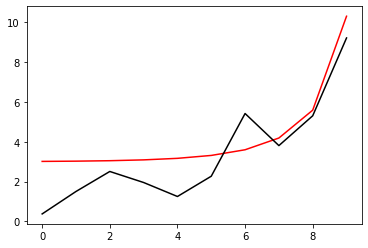

4800 89.8644063033091
[0.38028129 1.50311339 2.50714447 1.96007436 1.25857941 2.27225387
 5.41497516 3.80538437 5.30131152 9.20865957]


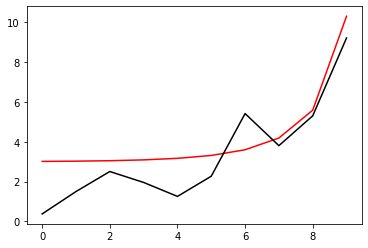

4900 89.86370267657615
[0.38072756 1.50052025 2.50478695 1.96408925 1.26317213 2.27324296
 5.41242214 3.80312975 5.29846724 9.20862205]


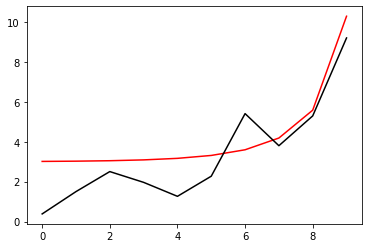

5000 89.8630135346016
[0.38122618 1.49791811 2.50239146 1.96803457 1.26772648 2.27423748
 5.40990268 3.80093427 5.2956938  9.2085845 ]


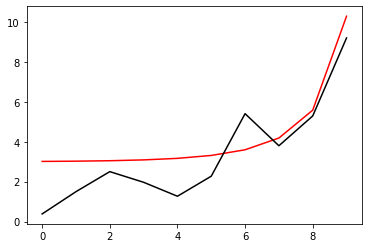

5100 89.8623381459665
[0.3817749  1.49530819 2.49995969 1.97191212 1.27224343 2.27523711
 5.40741559 3.79879587 5.29298879 9.20854692]


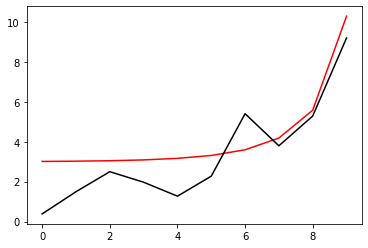

5200 89.86167582446883
[0.3823715  1.49269166 2.49749329 1.9757237  1.27672393 2.27624156
 5.40495972 3.79671255 5.29034988 9.20850932]


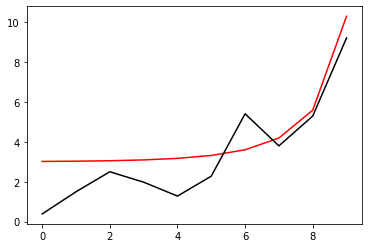

5300 89.86102592700006
[0.38301381 1.49006968 2.49499391 1.97947103 1.28116893 2.27725053
 5.40253395 3.79468235 5.28777478 9.2084717 ]


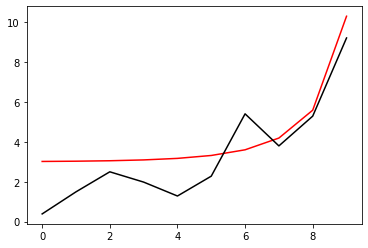

5400 89.86038785140548
[0.38369971 1.48744335 2.49246314 1.98315584 1.28557935 2.27826375
 5.4001372  3.79270335 5.28526125 9.20843405]


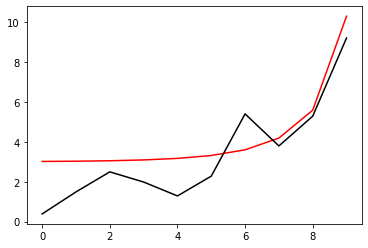

5500 89.85976103434813
[0.38442714 1.48481374 2.48990256 1.98677979 1.2899561  2.27928096
 5.3977684  3.7907737  5.2828071  9.20839637]


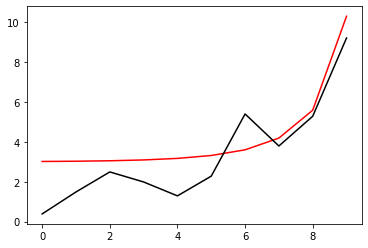

5600 89.85914494919389
[0.3851941  1.48218189 2.4873137  1.99034454 1.29430007 2.28030192
 5.39542652 3.78889159 5.28041023 9.20835867]


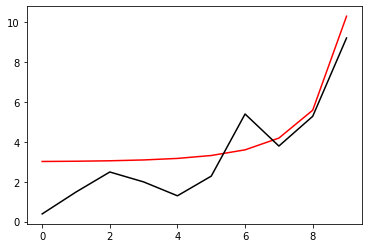

5700 89.85853910393223
[0.38599863 1.47954881 2.48469804 1.99385167 1.29861214 2.28132638
 5.39311056 3.78705525 5.27806856 9.20832096]


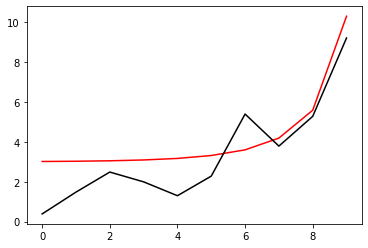

5800 89.85794303914594
[0.38683884 1.47691544 2.48205706 1.99730275 1.30289314 2.28235412
 5.39081957 3.78526299 5.27578009 9.20828321]


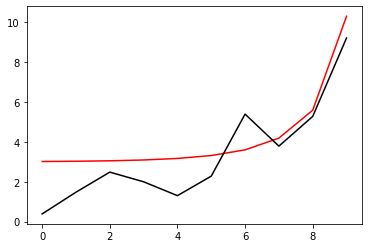

5900 89.85735632603756
[0.38771289 1.47428272 2.47939216 2.0006993  1.30714392 2.28338492
 5.3885526  3.78351315 5.27354289 9.20824545]


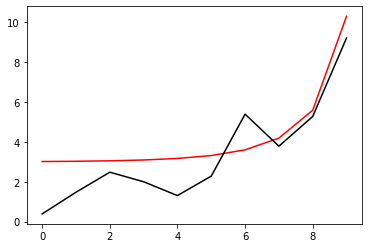

6000 89.85677856452344
[0.388619   1.47165153 2.47670472 2.00404281 1.31136529 2.28441859
 5.38630875 3.78180413 5.27135506 9.20820767]


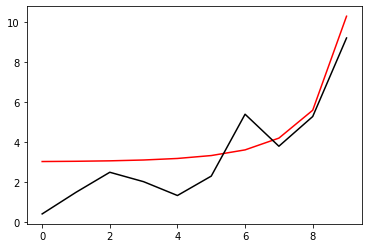

6100 89.85620938139868
[0.38955546 1.46902272 2.47399609 2.0073347  1.31555803 2.28545492
 5.38408714 3.78013437 5.26921478 9.20816986]


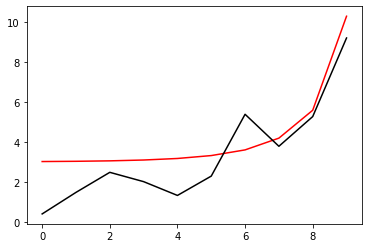

6200 89.85564842857934
[0.39052059 1.46639711 2.47126755 2.01057638 1.3197229  2.28649374
 5.38188694 3.77850239 5.26712029 9.20813204]


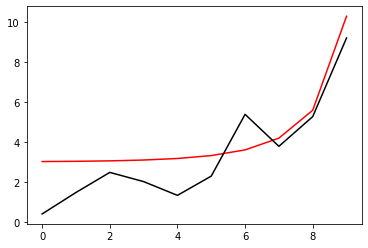

6300 89.85509538142486
[0.3915128  1.46377548 2.46852037 2.01376921 1.32386065 2.28753487
 5.37970733 3.77690672 5.26506988 9.2080942 ]


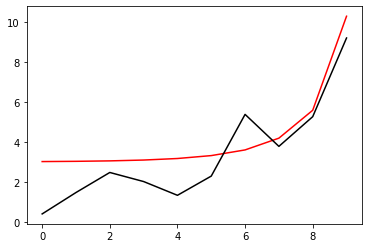

6400 89.85454993714094
[0.39253053 1.46115856 2.46575575 2.0169145  1.32797201 2.28857814
 5.37754753 3.77534599 5.26306191 9.20805633]


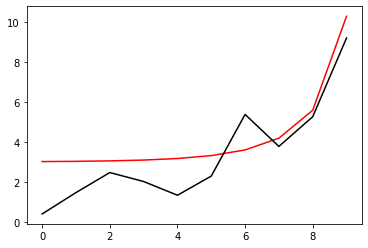

6500 89.85401181326617
[0.39357229 1.45854707 2.46297489 2.02001353 1.33205767 2.2896234
 5.37540678 3.77381883 5.26109477 9.20801845]


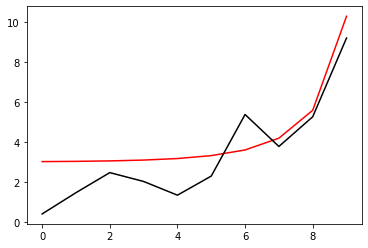

6600 89.8534807462398
[0.39463665 1.45594167 2.4601789  2.02306755 1.33611831 2.2906705
 5.37328436 3.77232394 5.25916695 9.20798055]


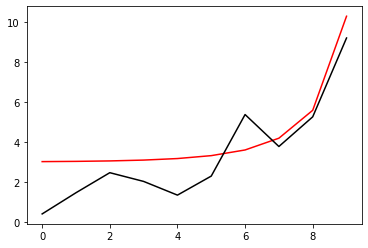

6700 89.85295649005182
[0.39572221 1.45334302 2.4573689  2.02607773 1.34015458 2.2917193
 5.37117956 3.77086009 5.25727695 9.20794264]


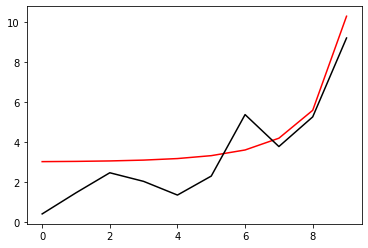

6800 89.85243881497286
[0.39682765 1.45075172 2.45454594 2.02904526 1.34416712 2.29276967
 5.36909172 3.76942606 5.25542336 9.2079047 ]


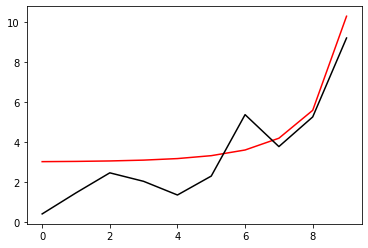

6900 89.85192750636158
[0.39795169 1.44816834 2.45171103 2.03197123 1.34815654 2.29382147
 5.36702018 3.76802069 5.2536048  9.20786675]


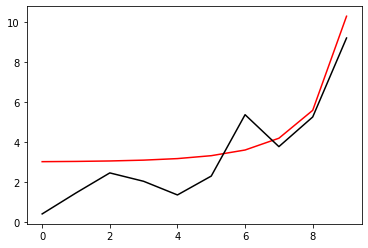

7000 89.8514223635483
[0.3990931  1.44559344 2.44886516 2.03485675 1.35212343 2.29487459
 5.36496434 3.76664287 5.25181995 9.20782878]


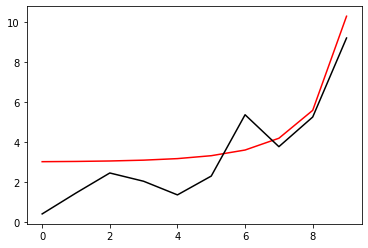

7100 89.85092319879072
[0.40025071 1.44302753 2.44600928 2.03770284 1.35606837 2.29592891
 5.36292358 3.76529153 5.25006755 9.20779079]


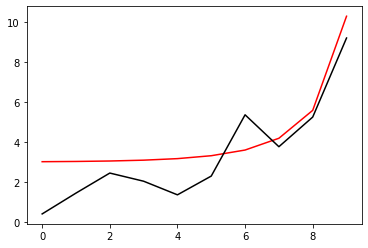

7200 89.85042983630021
[0.4014234  1.44047109 2.44314429 2.04051053 1.3599919  2.29698434
 5.36089735 3.76396564 5.24834638 9.20775279]


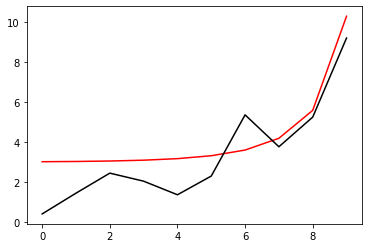

7300 89.8499421113348
[0.40261007 1.43792459 2.44027107 2.04328079 1.36389456 2.29804075
 5.35888508 3.76266421 5.24665526 9.20771477]


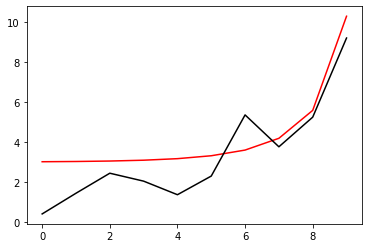

7400 89.84945986935496
[0.40380969 1.43538846 2.43739045 2.04601456 1.36777685 2.29909807
 5.35688627 3.7613863  5.24499307 9.20767674]


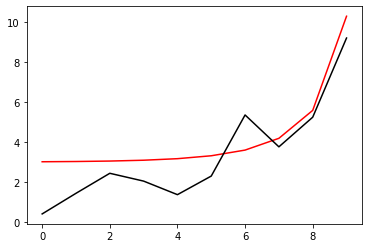

7500 89.84898296524078
[0.40502128 1.43286311 2.43450325 2.04871275 1.37163927 2.3001562
 5.3549004  3.76013098 5.24335873 9.20763869]


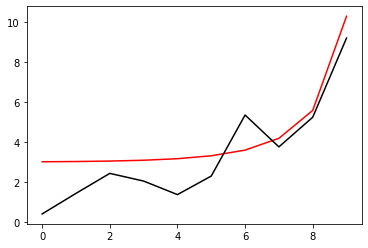

7600 89.84851126256535
[0.40624388 1.43034892 2.43161023 2.05137623 1.3754823  2.30121504
 5.35292699 3.7588974  5.2417512  9.20760063]


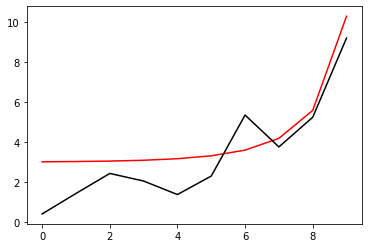

7700 89.84804463292164
[0.4074766  1.42784624 2.42871214 2.05400585 1.37930638 2.30227453
 5.35096557 3.75768471 5.24016949 9.20756255]


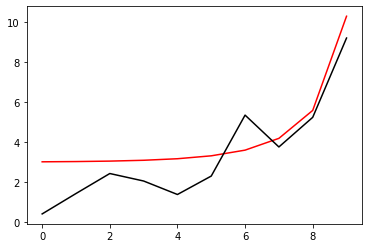

7800 89.84758295530091
[0.40871856 1.4253554  2.42580969 2.05660242 1.38311196 2.30333459
 5.34901572 3.75649212 5.23861264 9.20752445]


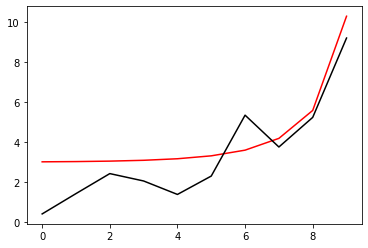

7900 89.84712611551743
[0.40996895 1.42287673 2.42290356 2.05916673 1.38689947 2.30439514
 5.347077   3.75531885 5.23707975 9.20748634]


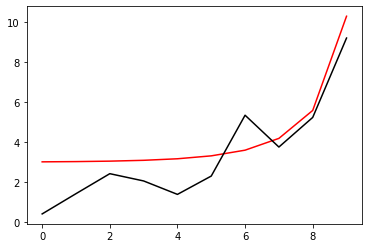

8000 89.84667400567787
[0.41122698 1.4204105  2.4199944  2.06169954 1.3906693  2.30545611
 5.345149   3.75416417 5.23556994 9.20744822]


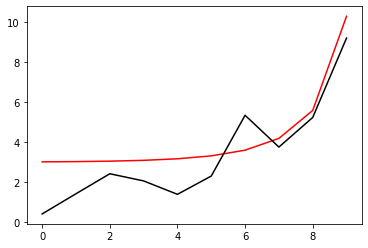

8100 89.84622652369228
[0.41249189 1.41795698 2.41708283 2.06420156 1.39442185 2.30651744
 5.34323135 3.75302737 5.23408237 9.20741008]


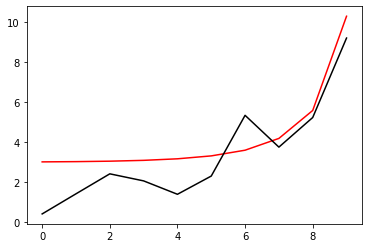

8200 89.84578357282331
[0.41376298 1.41551643 2.41416945 2.06667351 1.39815749 2.30757907
 5.34132367 3.75190779 5.23261624 9.20737193]


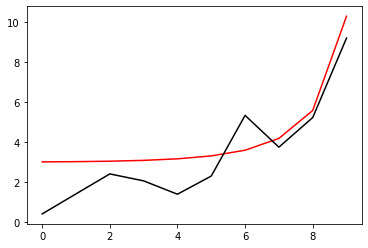

8300 89.8453450612713
[0.41503955 1.41308907 2.41125484 2.06911606 1.40187658 2.30864094
 5.3394256  3.75080478 5.23117077 9.20733377]


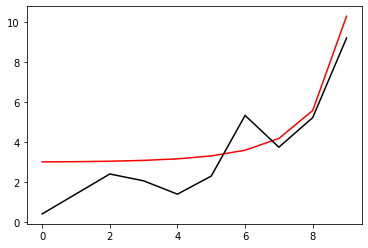

8400 89.84491090179306
[0.41632097 1.41067511 2.40833953 2.07152986 1.40557947 2.309703
 5.33753681 3.74971772 5.22974524 9.20729559]


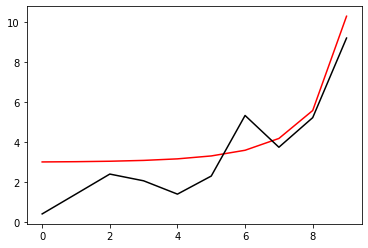

8500 89.84448101135074
[0.41760661 1.40827475 2.40542405 2.07391554 1.40926649 2.31076519
 5.33565698 3.74864602 5.22833894 9.2072574 ]


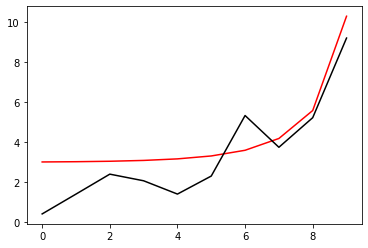

8600 89.84405531079024
[0.4188959  1.40588816 2.4025089  2.0762737  1.41293796 2.31182747
 5.33378579 3.74758911 5.22695119 9.2072192 ]


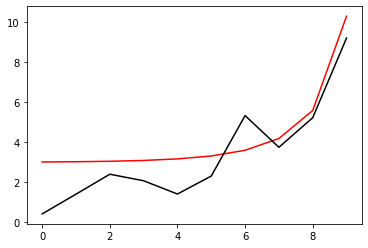

8700 89.84363372454543
[0.42018826 1.4035155  2.39959455 2.07860493 1.41659419 2.3128898
 5.33192295 3.74654646 5.22558136 9.20718098]


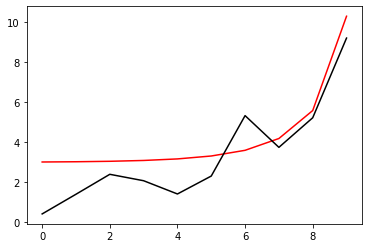

8800 89.84321618036684
[0.42148318 1.40115692 2.39668145 2.08090979 1.42023546 2.31395213
 5.33006818 3.74551756 5.22422882 9.20714275]


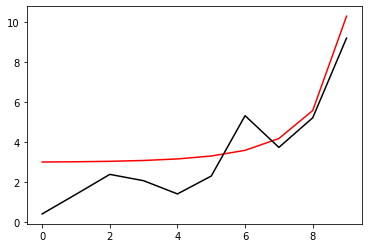

8900 89.84280260907302
[0.42278014 1.39881255 2.39377004 2.08318882 1.42386207 2.31501441
 5.3282212  3.7445019  5.22289299 9.20710451]


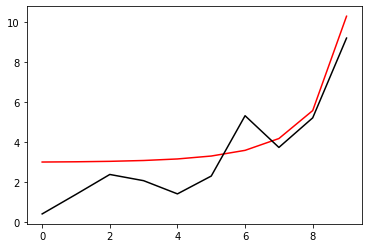

9000 89.84239294432263
[0.42407868 1.3964825  2.39086073 2.08544254 1.42747427 2.31607662
 5.32638177 3.74349901 5.22157329 9.20706625]


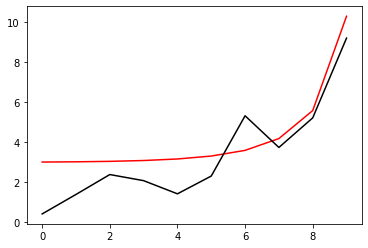

9100 89.84198712240547
[0.42537833 1.39416687 2.38795391 2.08767145 1.43107234 2.31713872
 5.32454963 3.74250845 5.2202692  9.20702799]


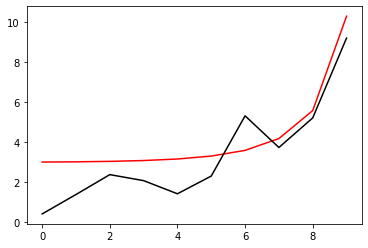

9200 89.84158508205122
[0.42667868 1.39186577 2.38504996 2.08987603 1.43465652 2.31820066
 5.32272456 3.74152979 5.2189802  9.20698971]


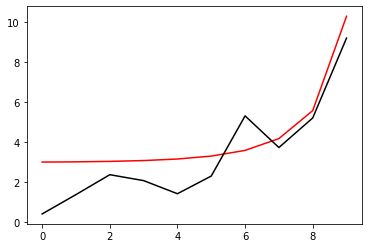

9300 89.84118676425413
[0.42797931 1.38957927 2.38214923 2.09205676 1.43822704 2.31926244
 5.32090632 3.74056261 5.2177058  9.20695142]


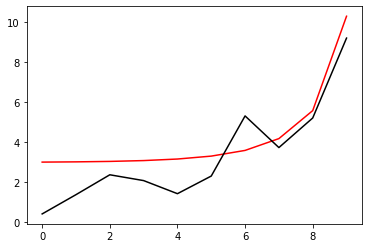

9400 89.84079211211274
[0.42927984 1.38730742 2.37925205 2.09421408 1.44178415 2.320324
 5.3190947  3.73960652 5.21644551 9.20691311]


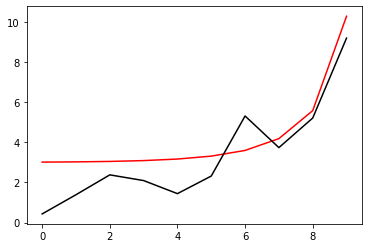

9500 89.84040107068282
[0.4305799  1.3850503  2.37635877 2.09634842 1.44532805 2.32138533
 5.31728951 3.73866115 5.21519891 9.2068748 ]


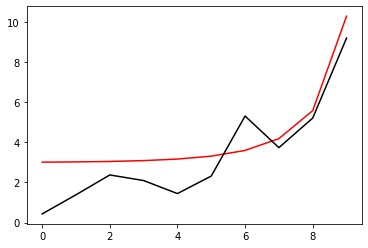

9600 89.84001358684313
[0.43187916 1.38280795 2.37346967 2.09846021 1.44885897 2.32244639
 5.31549054 3.73772614 5.21396554 9.20683647]


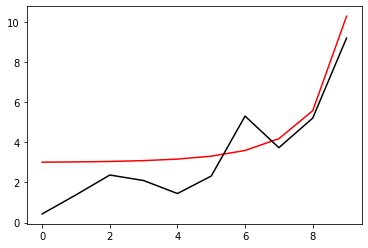

9700 89.8396296091723
[0.43317728 1.3805804  2.37058506 2.10054985 1.4523771  2.32350717
 5.31369761 3.73680114 5.21274501 9.20679814]


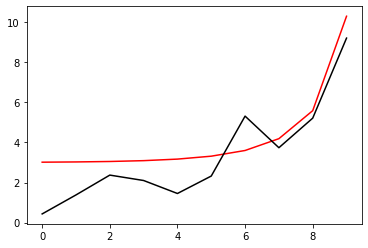

9800 89.8392490878362
[0.43447395 1.37836768 2.36770521 2.10261772 1.45588264 2.32456765
 5.31191054 3.73588582 5.21153693 9.20675979]


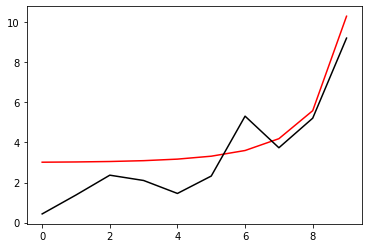

9900 89.83887197448483
[0.43576889 1.37616981 2.36483038 2.1046642  1.45937577 2.32562779
 5.31012917 3.73497989 5.2103409  9.20672143]


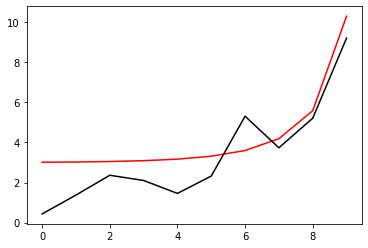

10000 89.83849822215802
[0.43706183 1.3739868  2.36196082 2.10668966 1.46285668 2.32668758
 5.30835332 3.73408303 5.20915658 9.20668306]


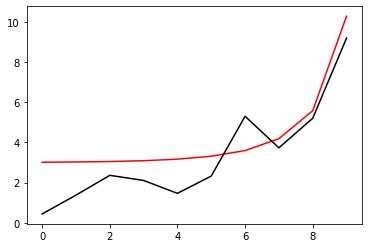

In [15]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.83812778519884
[0.4383525  1.37181865 2.35909678 2.10869444 1.46632554 2.327747
 5.30658286 3.73319496 5.20798363 9.20664468]


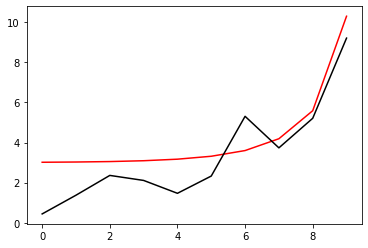

200 89.83776061917459
[0.43964066 1.36966536 2.35623847 2.11067888 1.46978251 2.32880604
 5.30481763 3.73231541 5.20682171 9.20660628]


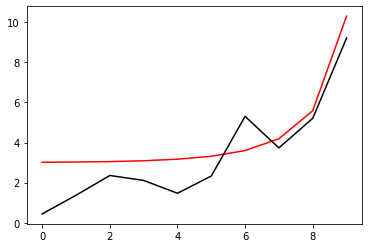

300 89.8373966808042
[0.44092608 1.36752692 2.35338611 2.11264332 1.47322775 2.32986467
 5.30305748 3.73144412 5.20567051 9.20656788]


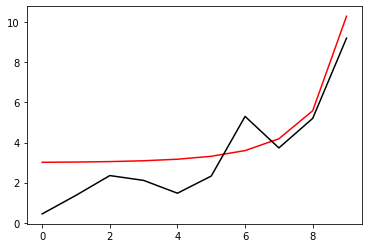

400 89.83703592789169
[0.44220855 1.36540331 2.35053991 2.11458806 1.47666142 2.33092288
 5.3013023  3.73058084 5.20452974 9.20652947]


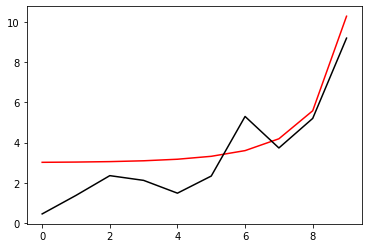

500 89.83667831926522
[0.44348786 1.3632945  2.34770005 2.11651341 1.48008366 2.33198066
 5.29955195 3.72972533 5.2033991  9.20649104]


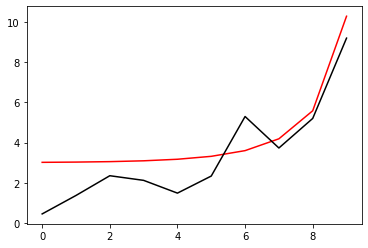

600 89.83632381472135
[0.44476383 1.36120046 2.34486671 2.11841966 1.4834946  2.333038
 5.2978063  3.72887737 5.20227833 9.20645261]


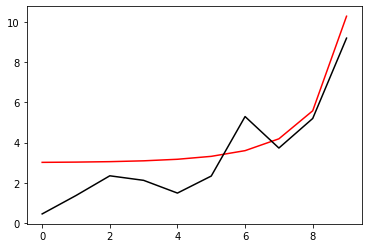

700 89.83597237497331
[0.44603628 1.35912116 2.34204007 2.12030711 1.4868944  2.33409487
 5.29606524 3.72803673 5.20116715 9.20641416]


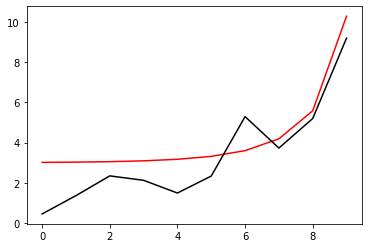

800 89.83562396160424
[0.44730503 1.35705656 2.3392203  2.12217602 1.49028318 2.33515127
 5.29432867 3.72720322 5.20006533 9.20637571]


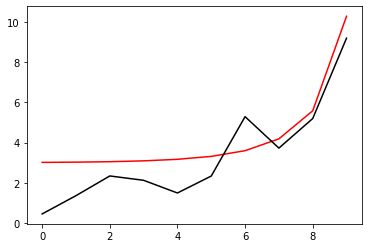

900 89.83527853702354
[0.44856994 1.35500661 2.33640753 2.12402667 1.49366106 2.33620719
 5.29259647 3.72637664 5.19897262 9.20633724]


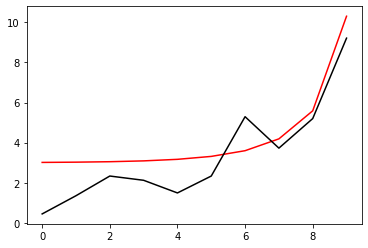

1000 89.834936064427
[0.44983085 1.35297126 2.33360192 2.12585931 1.49702816 2.33726262
 5.29086854 3.72555679 5.19788879 9.20629877]


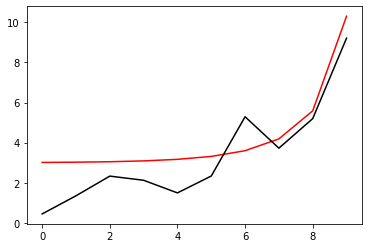

1100 89.83459650776028
[0.45108764 1.35095046 2.33080361 2.1276742  1.5003846  2.33831755
 5.28914479 3.72474349 5.19681363 9.20626028]


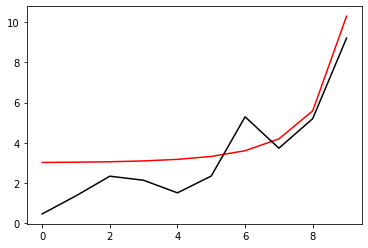

1200 89.83425983168482
[0.45234017 1.34894415 2.32801272 2.12947158 1.5037305  2.33937197
 5.28742512 3.72393658 5.19574692 9.20622178]


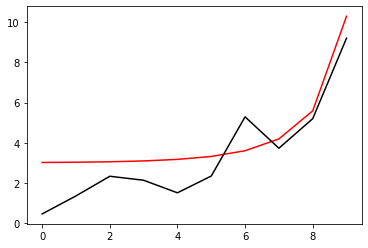

1300 89.83392600154664
[0.45358832 1.34695226 2.32522938 2.13125169 1.50706595 2.34042586
 5.28570945 3.72313588 5.19468847 9.20618328]


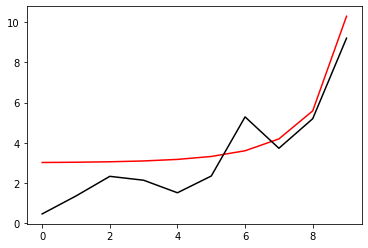

1400 89.83359498334755
[0.45483198 1.34497474 2.3224537  2.13301475 1.51039106 2.34147923
 5.2839977  3.72234124 5.19363807 9.20614476]


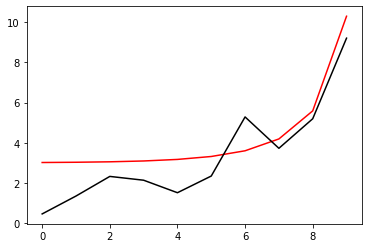

1500 89.83326674371861
[0.45607106 1.34301151 2.31968578 2.13476098 1.51370594 2.34253207
 5.28228977 3.7215525  5.19259556 9.20610624]


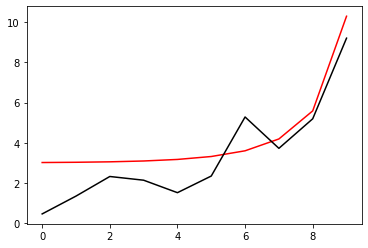

1600 89.83294124989513
[0.45730546 1.34106249 2.31692574 2.13649061 1.51701068 2.34358437
 5.28058561 3.72076953 5.19156076 9.2060677 ]


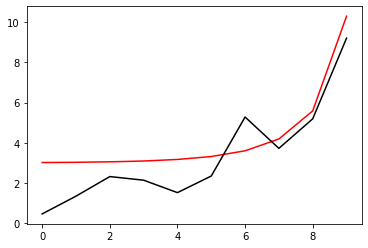

1700 89.83261846969388
[0.45853508 1.33912763 2.31417365 2.13820385 1.52030537 2.34463612
 5.27888512 3.71999219 5.19053348 9.20602916]


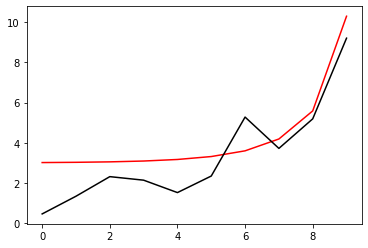

1800 89.83229837149203
[0.45975985 1.33720684 2.31142963 2.13990088 1.5235901  2.34568732
 5.27718825 3.71922033 5.18951359 9.20599061]


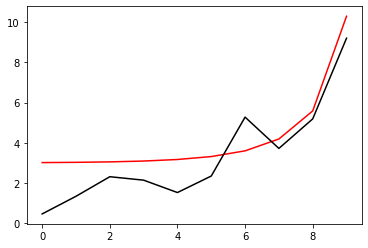

1900 89.83198092420712
[0.4609797  1.33530004 2.30869373 2.14158193 1.52686495 2.34673797
 5.27549492 3.71845384 5.18850091 9.20595204]


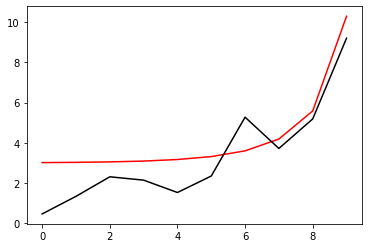

2000 89.83166609727876
[0.46219454 1.33340714 2.30596606 2.14324716 1.53013002 2.34778805
 5.27380507 3.71769259 5.1874953  9.20591347]


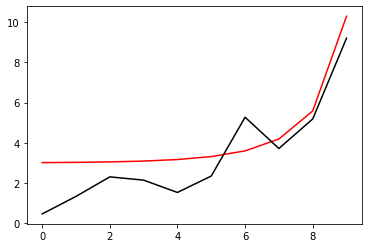

2100 89.83135386065173
[0.46340434 1.33152808 2.30324667 2.14489679 1.53338537 2.34883757
 5.27211864 3.71693647 5.18649663 9.20587489]


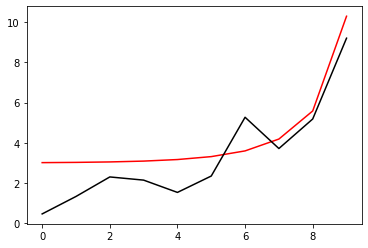

2200 89.8310441847595
[0.46460901 1.32966275 2.30053563 2.14653098 1.5366311  2.34988652
 5.27043558 3.71618537 5.18550475 9.2058363 ]


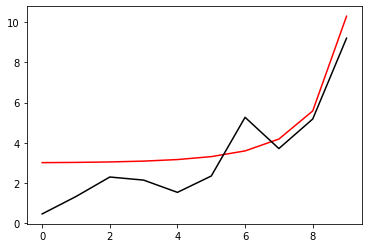

2300 89.83073704050952
[0.46580852 1.32781108 2.29783302 2.14814991 1.53986727 2.35093489
 5.26875582 3.71543917 5.18451954 9.2057977 ]


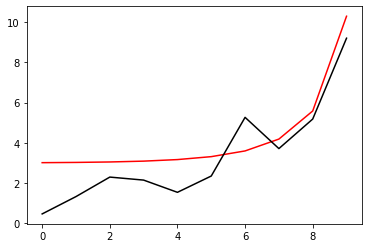

2400 89.83043239926927
[0.46700281 1.32597297 2.29513888 2.14975377 1.54309395 2.35198269
 5.26707931 3.71469779 5.18354087 9.20575909]


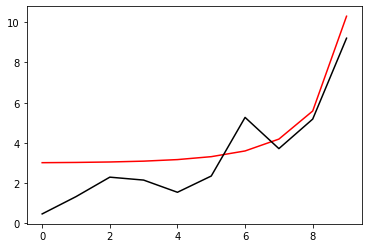

2500 89.83013023285305
[0.46819185 1.32414834 2.29245328 2.1513427  1.54631122 2.35302991
 5.265406   3.71396111 5.18256861 9.20572047]


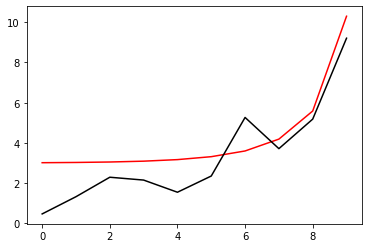

2600 89.82983051350921
[0.46937559 1.32233709 2.28977626 2.1529169  1.54951915 2.35407655
 5.26373585 3.71322905 5.18160266 9.20568185]


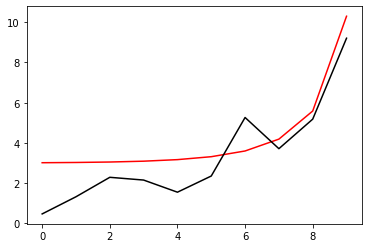

2700 89.8295332139091
[0.470554   1.32053913 2.28710787 2.1544765  1.55271779 2.3551226
 5.2620688  3.71250151 5.18064291 9.20564321]


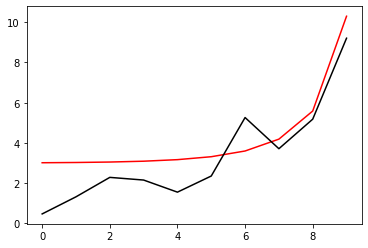

2800 89.82923830713558
[0.47172705 1.31875437 2.28444816 2.15602167 1.55590722 2.35616807
 5.26040481 3.71177841 5.17968925 9.20560457]


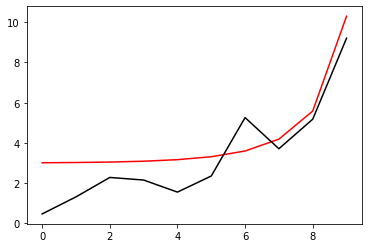

2900 89.82894576667296
[0.47289472 1.31698272 2.28179716 2.15755257 1.5590875  2.35721295
 5.25874383 3.71105967 5.17874157 9.20556591]


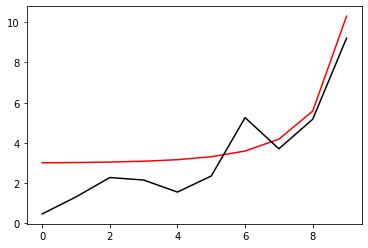

3000 89.8286555663969
[0.47405698 1.31522408 2.27915491 2.15906933 1.56225868 2.35825724
 5.25708583 3.71034521 5.17779978 9.20552725]


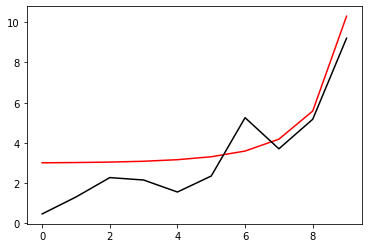

3100 89.82836768056522
[0.47521381 1.31347835 2.27652144 2.16057212 1.56542083 2.35930094
 5.25543077 3.70963494 5.17686379 9.20548858]


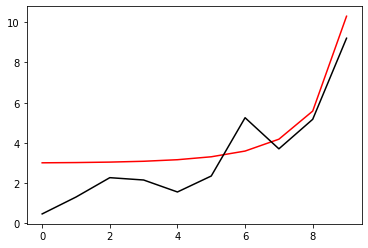

3200 89.82808208380882
[0.47636519 1.31174543 2.27389678 2.16206106 1.568574   2.36034404
 5.2537786  3.70892881 5.1759335  9.2054499 ]


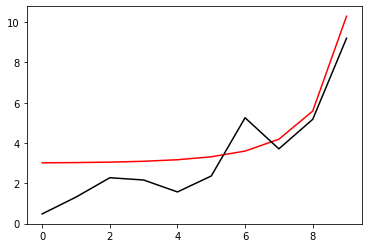

3300 89.82779875112377
[0.47751112 1.31002524 2.27128097 2.16353631 1.57171824 2.36138656
 5.25212929 3.70822672 5.17500883 9.20541121]


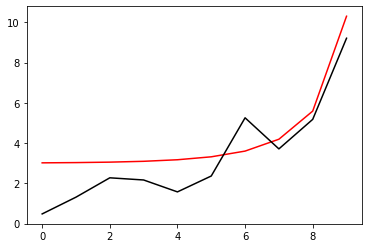

3400 89.82751765786249
[0.47865158 1.30831767 2.26867402 2.16499799 1.57485361 2.36242847
 5.25048281 3.70752863 5.17408969 9.20537252]


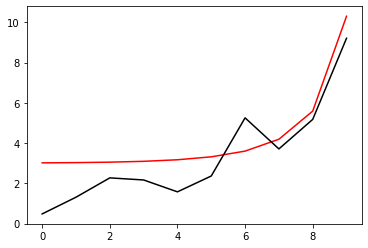

3500 89.82723877972681
[0.47978657 1.30662263 2.26607596 2.16644625 1.57798016 2.36346979
 5.24883913 3.70683446 5.17317601 9.20533381]


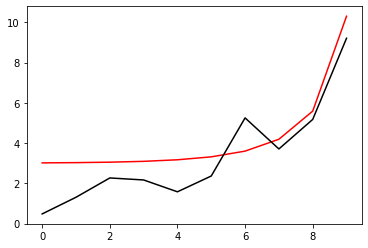

3600 89.82696209276004
[0.48091608 1.30494002 2.2634868  2.16788121 1.58109795 2.36451052
 5.2471982  3.70614415 5.1722677  9.2052951 ]


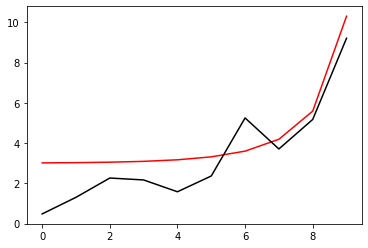

3700 89.82668757334025
[0.4820401  1.30326973 2.26090656 2.169303   1.58420701 2.36555064
 5.24556    3.70545764 5.17136469 9.20525638]


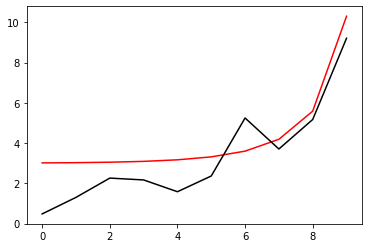

3800 89.82641519817355
[0.48315864 1.30161168 2.25833526 2.17071175 1.5873074  2.36659017
 5.2439245  3.70477488 5.17046691 9.20521765]


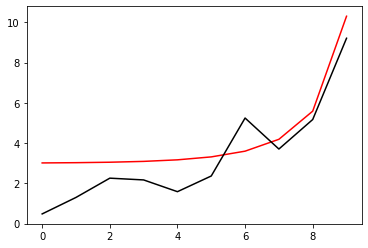

3900 89.82614494428739
[0.48427169 1.29996576 2.25577291 2.17210758 1.59039917 2.3676291
 5.24229167 3.70409579 5.16957429 9.20517891]


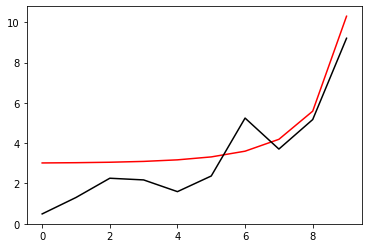

4000 89.82587678902449
[0.48537927 1.29833188 2.25321952 2.17349062 1.59348235 2.36866744
 5.24066149 3.70342034 5.16868676 9.20514017]


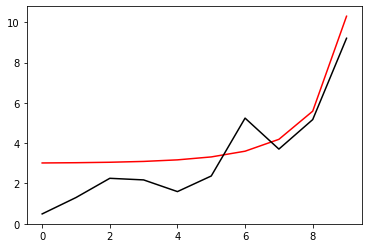

4100 89.82561071003677
[0.48648137 1.29670994 2.2506751  2.17486098 1.596557   2.36970517
 5.23903392 3.70274847 5.16780426 9.20510141]


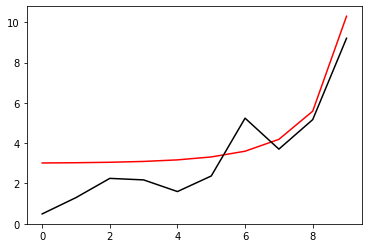

4200 89.82534668527947
[0.487578   1.29509983 2.24813965 2.17621877 1.59962316 2.37074231
 5.23740894 3.70208013 5.16692672 9.20506265]


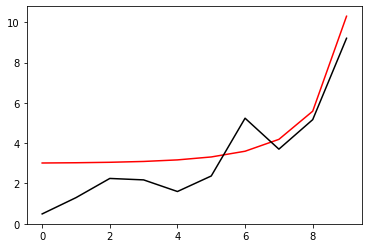

4300 89.82508469300569
[0.48866918 1.29350147 2.24561318 2.17756413 1.60268087 2.37177885
 5.23578653 3.70141527 5.16605409 9.20502388]


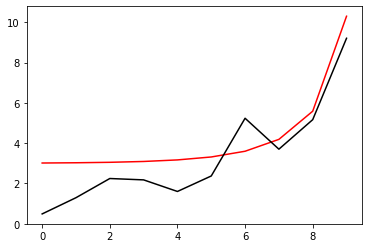

4400 89.82482471176102
[0.48975491 1.29191475 2.24309569 2.17889715 1.60573016 2.3728148
 5.23416666 3.70075385 5.1651863  9.2049851 ]


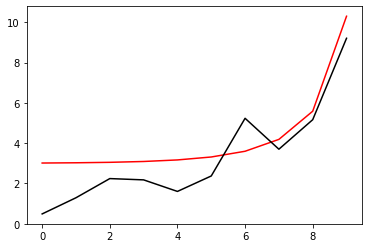

4500 89.82456672037803
[0.4908352  1.29033958 2.24058718 2.18021794 1.60877109 2.37385014
 5.23254932 3.70009581 5.1643233  9.20494632]


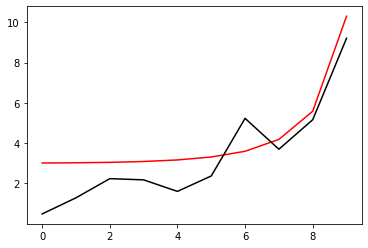

4600 89.82431069797153
[0.49191007 1.28877586 2.23808766 2.18152663 1.61180369 2.37488489
 5.23093447 3.69944112 5.16346504 9.20490752]


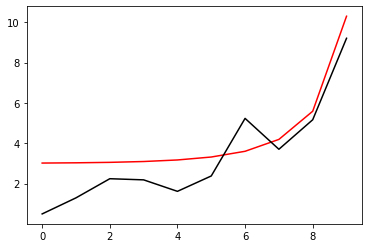

4700 89.82405662393333
[0.49297953 1.28722348 2.23559712 2.18282331 1.614828   2.37591904
 5.22932209 3.69878973 5.16261146 9.20486872]


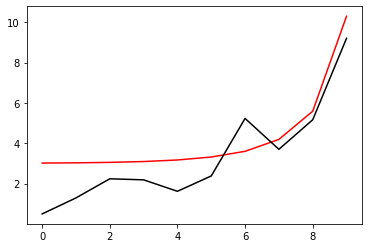

4800 89.82380447792764
[0.49404359 1.28568237 2.23311555 2.18410809 1.61784406 2.3769526
 5.22771218 3.69814161 5.1617625  9.20482991]


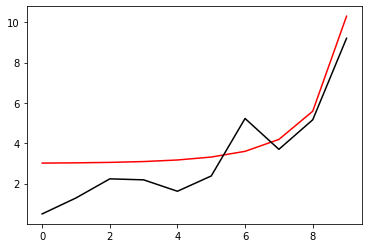

4900 89.82355423988648
[0.49510228 1.28415242 2.23064296 2.18538107 1.62085189 2.37798556
 5.2261047  3.69749671 5.16091813 9.20479109]


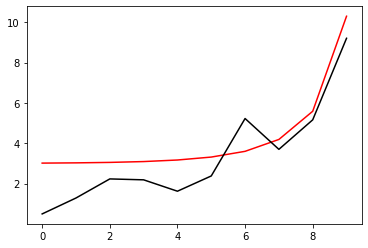

5000 89.82330589000497
[0.49615561 1.28263353 2.22817933 2.18664236 1.62385155 2.37901792
 5.22449964 3.69685499 5.16007829 9.20475227]


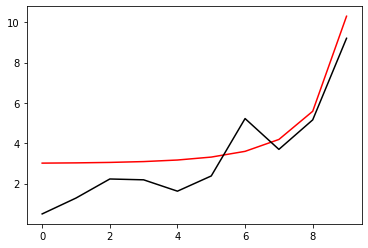

5100 89.82305940873714
[0.4972036  1.28112561 2.22572467 2.18789206 1.62684307 2.38004969
 5.22289697 3.69621642 5.15924294 9.20471344]


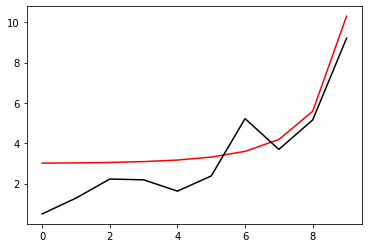

5200 89.82281477679136
[0.49824626 1.27962856 2.22327896 2.18913027 1.62982647 2.38108087
 5.22129669 3.69558096 5.15841203 9.2046746 ]


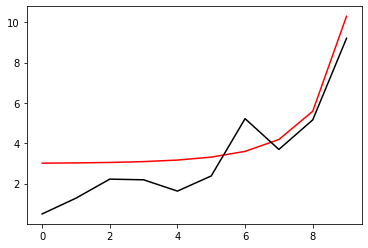

5300 89.82257197512646
[0.49928363 1.2781423  2.22084218 2.19035708 1.6328018  2.38211145
 5.21969877 3.69494858 5.15758551 9.20463575]


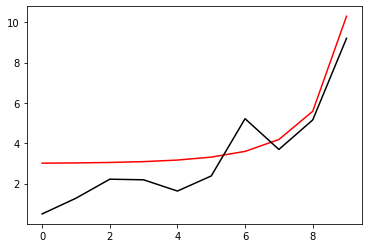

5400 89.82233098494751
[0.50031571 1.27666672 2.21841434 2.19157259 1.63576908 2.38314145
 5.2181032  3.69431925 5.15676335 9.20459689]


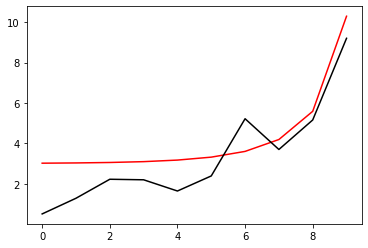

5500 89.82209178770195
[0.50134254 1.27520174 2.21599543 2.19277689 1.63872836 2.38417084
 5.21650996 3.69369292 5.15594551 9.20455803]


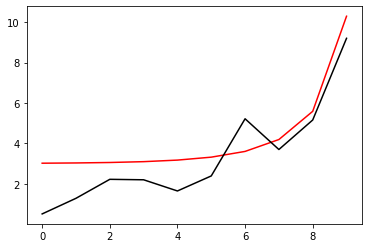

5600 89.82185436507545
[0.50236414 1.27374725 2.21358542 2.19397009 1.64167966 2.38519965
 5.21491904 3.69306957 5.15513193 9.20451916]


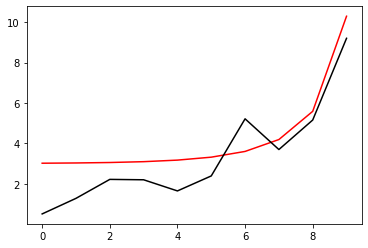

5700 89.82161869898835
[0.50338052 1.27230318 2.2111843  2.19515227 1.64462301 2.38622787
 5.21333041 3.69244918 5.15432259 9.20448028]


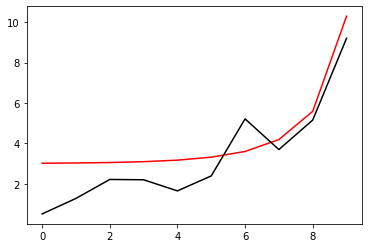

5800 89.821384771592
[0.50439171 1.27086942 2.20879207 2.19632352 1.64755845 2.3872555
 5.21174407 3.69183169 5.15351744 9.2044414 ]


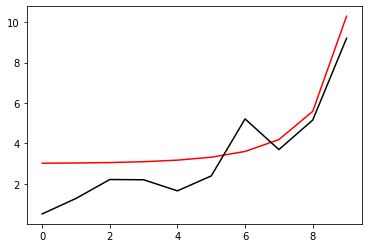

5900 89.82115256526492
[0.50539774 1.26944589 2.2064087  2.19748393 1.65048601 2.38828254
 5.21016    3.6912171  5.15271645 9.2044025 ]


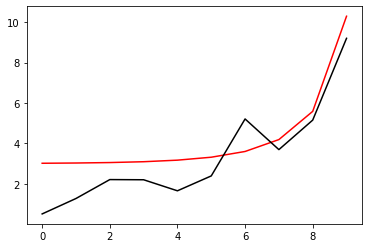

6000 89.82092206260948
[0.50639863 1.2680325  2.20403418 2.1986336  1.65340571 2.38930899
 5.20857819 3.69060537 5.15191959 9.20436361]


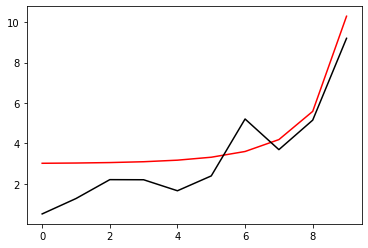

6100 89.82069324644797
[0.5073944  1.26662915 2.20166849 2.19977261 1.65631759 2.39033486
 5.20699862 3.68999648 5.15112681 9.2043247 ]


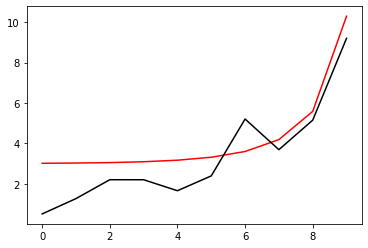

6200 89.82046609982008
[0.50838509 1.26523577 2.19931163 2.20090104 1.65922168 2.39136014
 5.20542128 3.68939038 5.15033808 9.20428578]


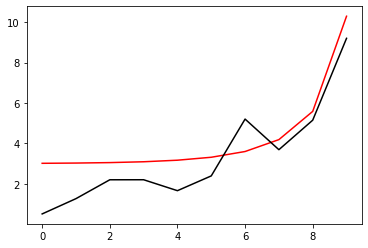

6300 89.82024060597855
[0.50937071 1.26385225 2.19696356 2.20201899 1.662118   2.39238483
 5.20384616 3.68878707 5.14955337 9.20424686]


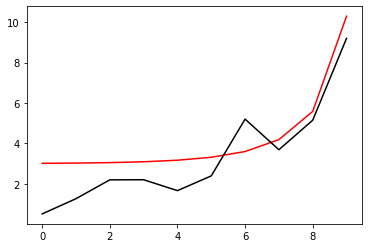

6400 89.82001674838658
[0.5103513  1.26247851 2.19462427 2.20312653 1.66500658 2.39340894
 5.20227325 3.68818651 5.14877264 9.20420793]


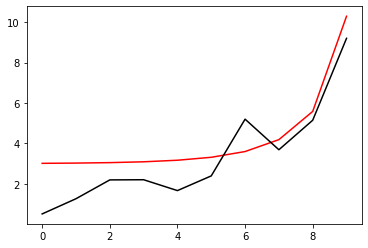

6500 89.81979451071443
[0.51132688 1.26111448 2.19229374 2.20422375 1.66788746 2.39443247
 5.20070252 3.68758869 5.14799587 9.204169  ]


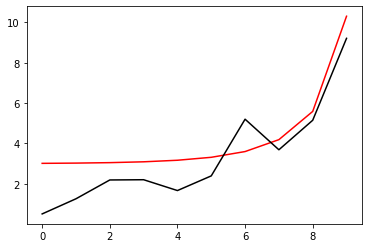

6600 89.81957387683626
[0.51229747 1.25976005 2.18997195 2.20531074 1.67076066 2.39545541
 5.19913398 3.68699356 5.14722303 9.20413006]


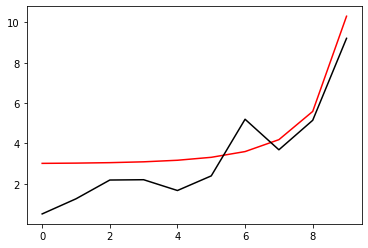

6700 89.81935483082705
[0.51326311 1.25841514 2.18765888 2.20638757 1.6736262  2.39647777
 5.19756761 3.68640112 5.14645407 9.20409111]


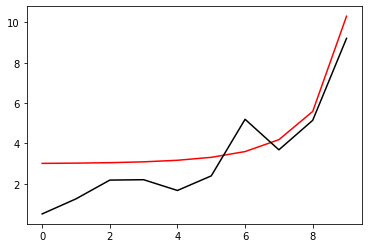

6800 89.81913735695976
[0.51422383 1.25707968 2.18535452 2.20745433 1.67648412 2.39749956
 5.1960034  3.68581134 5.14568898 9.20405215]


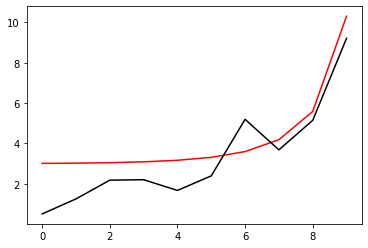

6900 89.81892143970212
[0.51517964 1.25575356 2.18305883 2.20851109 1.67933444 2.39852076
 5.19444133 3.68522419 5.14492772 9.20401319]


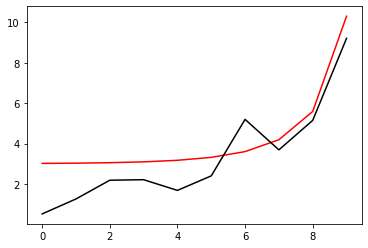

7000 89.81870706371375
[0.51613058 1.25443673 2.1807718  2.20955794 1.68217719 2.39954138
 5.1928814  3.68463966 5.14417026 9.20397421]


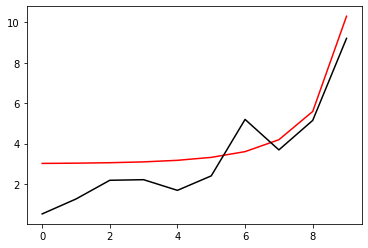

7100 89.81849421384358
[0.51707668 1.25312908 2.17849341 2.21059496 1.68501239 2.40056143
 5.1913236  3.68405771 5.14341658 9.20393524]


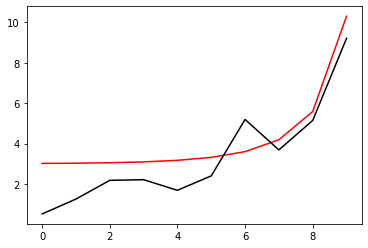

7200 89.8182828751267
[0.51801795 1.25183053 2.17622362 2.21162221 1.68784007 2.4015809
 5.18976791 3.68347834 5.14266666 9.20389625]


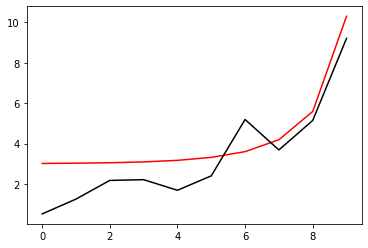

7300 89.81807303278205
[0.51895445 1.25054102 2.17396243 2.21263978 1.69066026 2.40259979
 5.18821433 3.68290152 5.14192045 9.20385726]


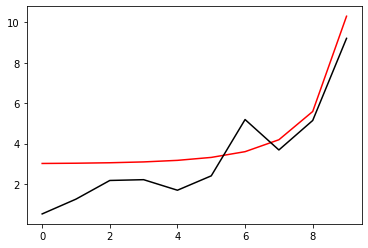

7400 89.81786467220925
[0.51988618 1.24926045 2.1717098  2.21364774 1.69347297 2.40361811
 5.18666284 3.68232723 5.14117794 9.20381826]


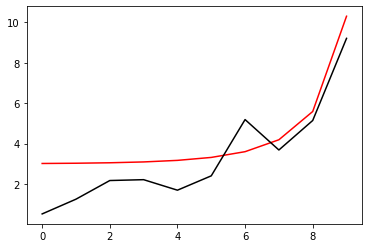

7500 89.81765777898615
[0.52081318 1.24798874 2.16946572 2.21464617 1.69627824 2.40463585
 5.18511345 3.68175545 5.1404391  9.20377926]


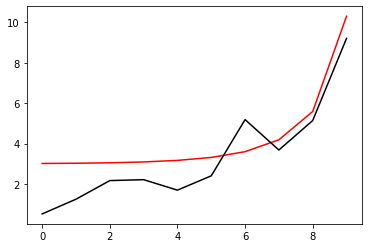

7600 89.81745233886629
[0.52173547 1.24672582 2.16723015 2.21563514 1.69907609 2.40565302
 5.18356613 3.68118615 5.1397039  9.20374025]


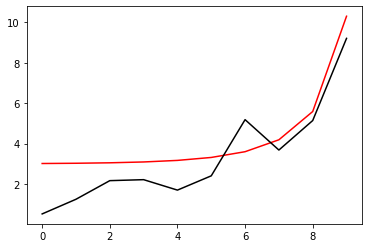

7700 89.8172483377764
[0.52265309 1.24547161 2.16500308 2.21661473 1.70186654 2.40666962
 5.18202088 3.68061933 5.13897232 9.20370123]


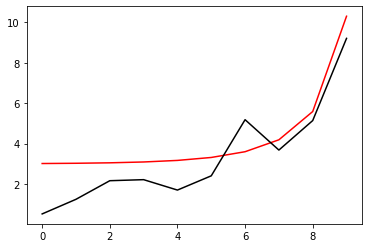

7800 89.81704576181362
[0.52356607 1.24422603 2.16278447 2.21758501 1.70464963 2.40768564
 5.18047768 3.68005496 5.13824434 9.2036622 ]


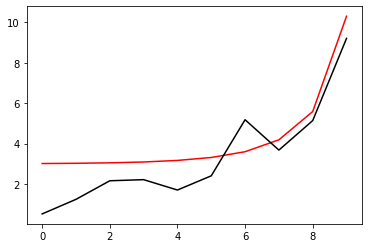

7900 89.8168445972434
[0.52447443 1.24298901 2.16057431 2.21854604 1.70742536 2.40870109
 5.17893654 3.67949303 5.13751993 9.20362317]


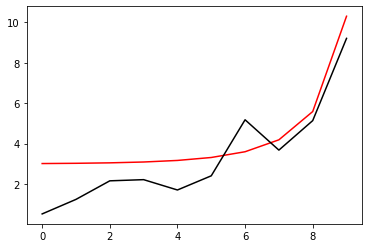

8000 89.81664483049671
[0.52537819 1.24176046 2.15837257 2.21949791 1.71019377 2.40971598
 5.17739744 3.67893351 5.13679907 9.20358414]


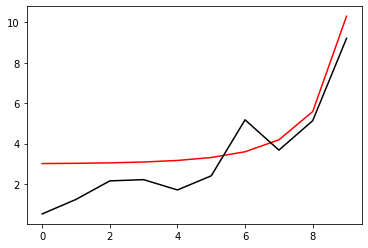

8100 89.81644644816788
[0.5262774  1.24054031 2.15617921 2.22044068 1.71295488 2.41073029
 5.17586038 3.67837639 5.13608174 9.20354509]


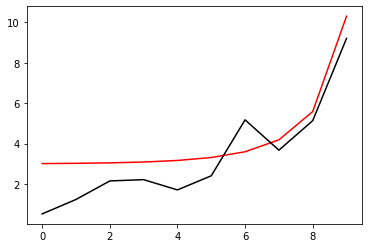

8200 89.81624943701233
[0.52717207 1.23932849 2.15399423 2.22137443 1.71570872 2.41174404
 5.17432534 3.67782165 5.1353679  9.20350604]


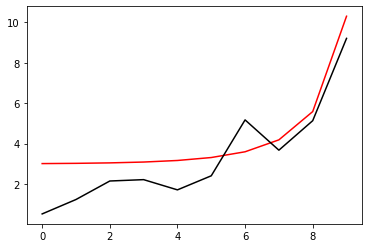

8300 89.81605378394389
[0.52806224 1.23812492 2.15181759 2.22229922 1.7184553  2.41275722
 5.17279231 3.67726928 5.13465755 9.20346698]


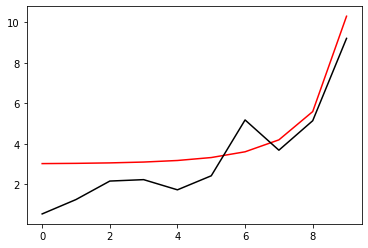

8400 89.81585947603308
[0.52894794 1.23692953 2.14964926 2.22321511 1.72119464 2.41376983
 5.1712613  3.67671925 5.13395065 9.20342792]


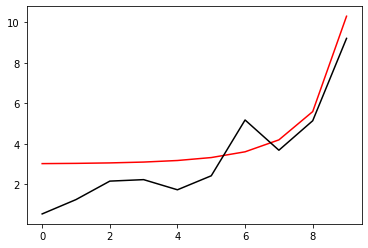

8500 89.81566650050435
[0.52982918 1.23574225 2.14748922 2.22412219 1.72392678 2.41478187
 5.16973229 3.67617155 5.13324719 9.20338885]


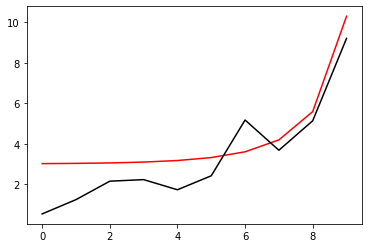

8600 89.81547484473441
[0.53070601 1.23456301 2.14533744 2.22502051 1.72665174 2.41579335
 5.16820527 3.67562616 5.13254715 9.20334977]


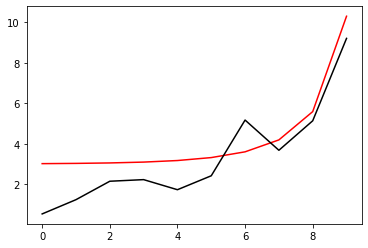

8700 89.81528449624962
[0.53157844 1.23339172 2.14319389 2.22591015 1.72936953 2.41680427
 5.16668024 3.67508308 5.13185049 9.20331069]


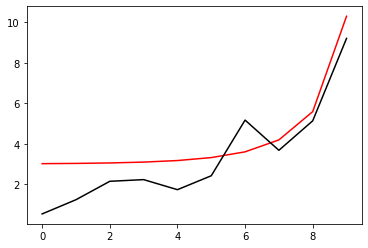

8800 89.81509544272411
[0.53244651 1.23222834 2.14105855 2.22679117 1.73208018 2.41781462
 5.16515718 3.67454227 5.13115721 9.2032716 ]


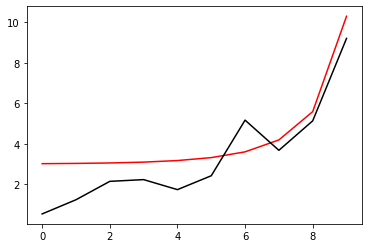

8900 89.81490767197772
[0.53331025 1.23107277 2.1389314  2.22766363 1.73478372 2.41882441
 5.1636361  3.67400374 5.13046728 9.20323251]


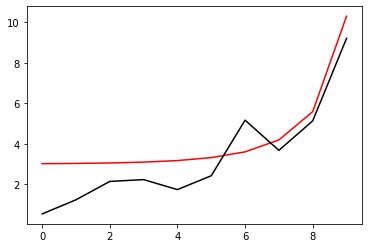

9000 89.81472117197387
[0.53416967 1.22992496 2.13681239 2.22852761 1.73748015 2.41983364
 5.16211698 3.67346745 5.12978069 9.2031934 ]


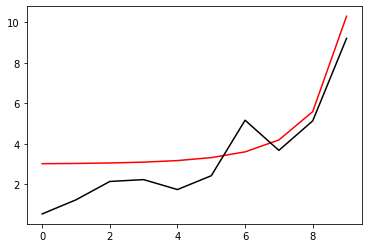

9100 89.81453593081763
[0.53502482 1.22878483 2.13470151 2.22938316 1.74016951 2.4208423
 5.16059982 3.6729334  5.12909741 9.2031543 ]


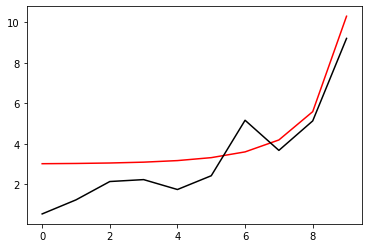

9200 89.81435193675355
[0.53587571 1.22765232 2.13259873 2.23023035 1.74285182 2.42185041
 5.15908461 3.67240157 5.12841741 9.20311518]


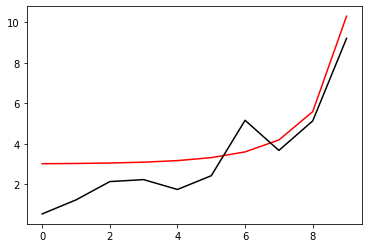

9300 89.81416917816398
[0.53672238 1.22652736 2.13050402 2.23106924 1.74552709 2.42285795
 5.15757134 3.67187195 5.1277407  9.20307606]


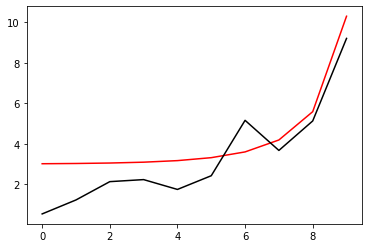

9400 89.81398764356703
[0.53756485 1.22540988 2.12841734 2.23189991 1.74819536 2.42386493
 5.15606001 3.67134452 5.12706723 9.20303694]


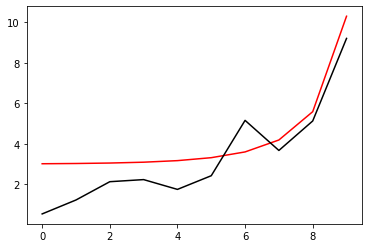

9500 89.81380732161462
[0.53840315 1.22429982 2.12633869 2.2327224  1.75085663 2.42487136
 5.1545506  3.67081927 5.126397   9.2029978 ]


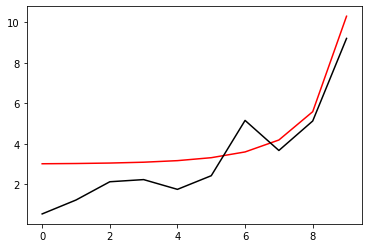

9600 89.81362820109075
[0.53923731 1.22319712 2.12426802 2.23353678 1.75351094 2.42587722
 5.15304312 3.67029619 5.12572999 9.20295866]


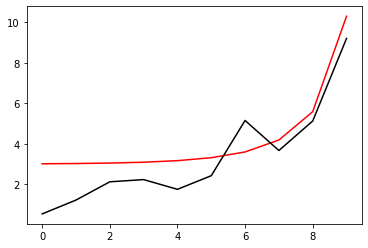

9700 89.81345027090968
[0.54006735 1.2221017  2.1222053  2.23434311 1.75615829 2.42688253
 5.15153756 3.66977525 5.12506618 9.20291952]


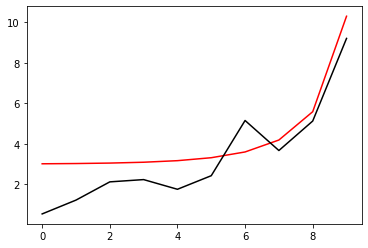

9800 89.81327352011395
[0.5408933  1.2210135  2.12015052 2.23514146 1.75879872 2.42788728
 5.1500339  3.66925645 5.12440555 9.20288037]


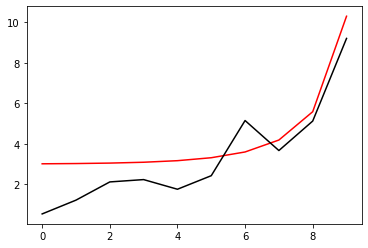

9900 89.81309793787293
[0.54171518 1.21993247 2.11810364 2.23593189 1.76143225 2.42889148
 5.14853215 3.66873978 5.12374808 9.20284121]


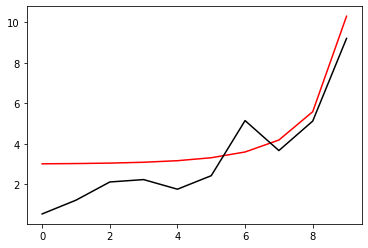

10000 89.81292351348058
[0.54253303 1.21885853 2.11606463 2.23671444 1.76405888 2.42989512
 5.1470323  3.66822521 5.12309375 9.20280205]


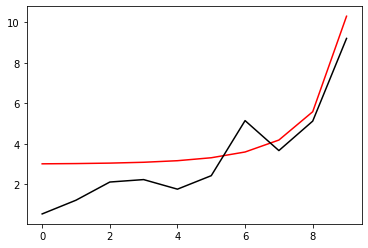

In [16]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.81275023635447
[0.54334687 1.21779163 2.11403346 2.2374892  1.76667866 2.4308982
 5.14553434 3.66771274 5.12244255 9.20276288]


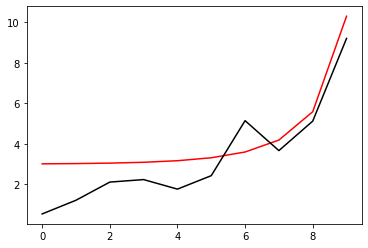

200 89.81257809603339
[0.54415673 1.21673171 2.11201011 2.2382562  1.76929158 2.43190073
 5.14403826 3.66720235 5.12179446 9.20272371]


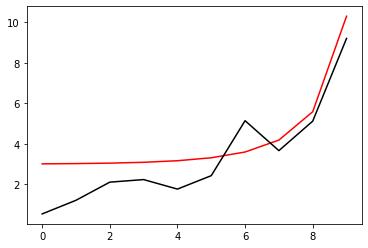

300 89.81240708217604
[0.54496262 1.2156787  2.10999455 2.23901552 1.77189768 2.4329027
 5.14254406 3.66669404 5.12114947 9.20268453]


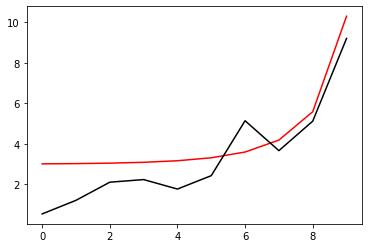

400 89.8122371845596
[0.54576459 1.21463254 2.10798674 2.2397672  1.77449698 2.43390412
 5.14105174 3.66618778 5.12050754 9.20264534]


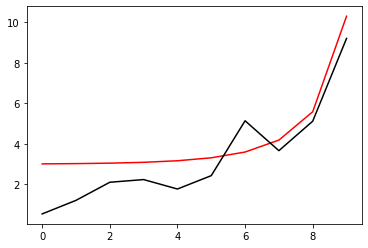

500 89.81206839307765
[0.54656265 1.21359318 2.10598667 2.24051132 1.77708949 2.43490499
 5.13956128 3.66568357 5.11986868 9.20260615]


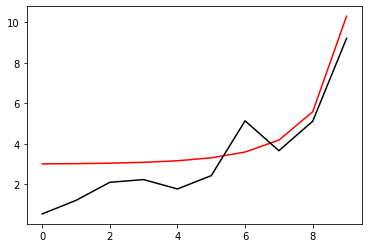

600 89.81190069773875
[0.54735682 1.21256055 2.10399429 2.24124792 1.77967524 2.4359053
 5.13807268 3.66518139 5.11923286 9.20256696]


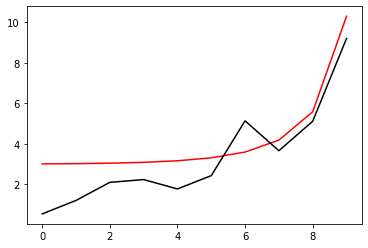

700 89.81173408866522
[0.54814714 1.2115346  2.10200959 2.24197706 1.78225424 2.43690507
 5.13658593 3.66468123 5.11860007 9.20252775]


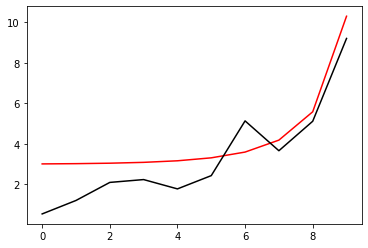

800 89.81156855609122
[0.54893363 1.21051527 2.10003253 2.2426988  1.78482651 2.43790427
 5.13510104 3.66418309 5.11797028 9.20248854]


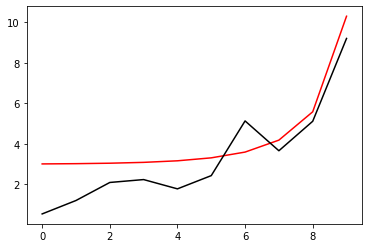

900 89.81140409036144
[0.54971632 1.2095025  2.09806309 2.24341319 1.78739208 2.43890293
 5.13361799 3.66368693 5.11734349 9.20244933]


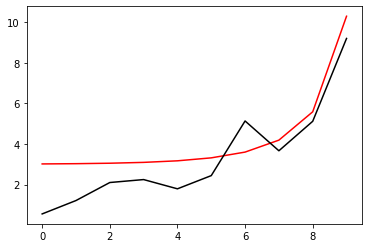

1000 89.81124068192945
[0.55049522 1.20849623 2.09610123 2.24412029 1.78995096 2.43990104
 5.13213678 3.66319277 5.11671968 9.20241011]


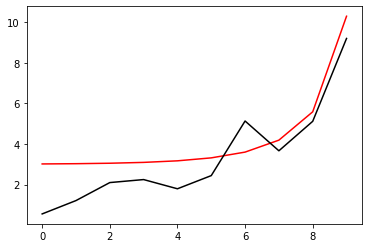

1100 89.81107832135646
[0.55127037 1.20749642 2.09414693 2.24482016 1.79250317 2.4408986
 5.1306574  3.66270057 5.11609883 9.20237088]


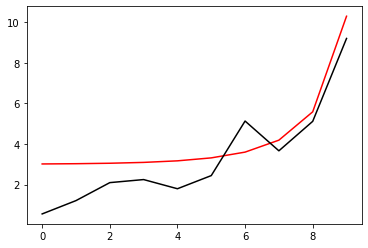

1200 89.81091699930965
[0.55204179 1.206503   2.09220016 2.24551284 1.79504873 2.4418956
 5.12917985 3.66221034 5.11548093 9.20233165]


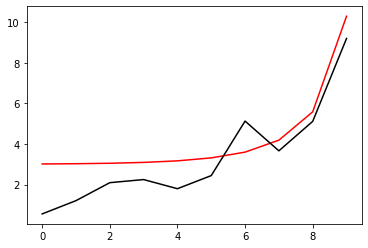

1300 89.81075670656115
[0.5528095  1.20551592 2.09026089 2.2461984  1.79758767 2.44289206
 5.12770412 3.66172205 5.11486595 9.20229242]


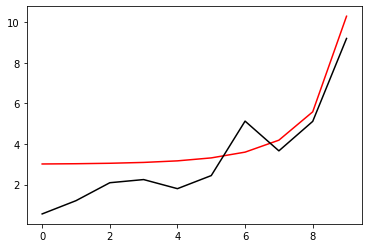

1400 89.81059743398608
[0.55357352 1.20453512 2.08832909 2.24687689 1.80011999 2.44388797
 5.1262302  3.66123571 5.11425389 9.20225318]


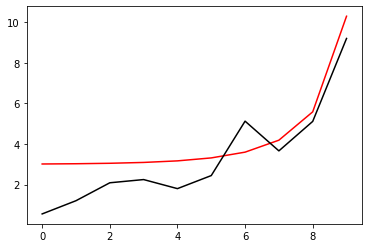

1500 89.81043917256159
[0.55433389 1.20356055 2.08640473 2.24754835 1.80264572 2.44488332
 5.1247581  3.66075129 5.11364474 9.20221393]


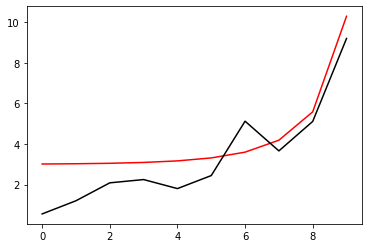

1600 89.8102819133655
[0.55509062 1.20259217 2.08448779 2.24821285 1.80516488 2.44587813
 5.1232878  3.66026879 5.11303847 9.20217467]


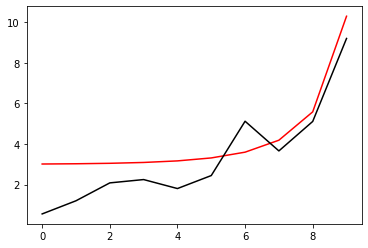

1700 89.81012564757475
[0.55584375 1.20162991 2.08257823 2.24887044 1.80767749 2.44687239
 5.12181931 3.65978819 5.11243507 9.20213542]


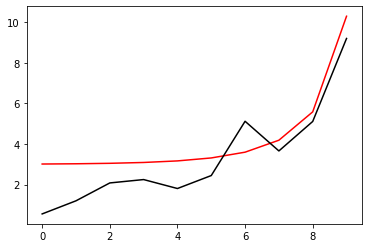

1800 89.80997036646431
[0.55659328 1.20067372 2.08067602 2.24952116 1.81018356 2.4478661
 5.1203526  3.65930949 5.11183452 9.20209615]


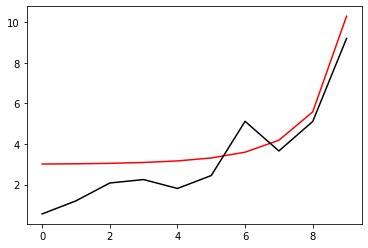

1900 89.80981606140567
[0.55733925 1.19972355 2.07878115 2.25016508 1.81268311 2.44885927
 5.11888769 3.65883267 5.11123682 9.20205688]


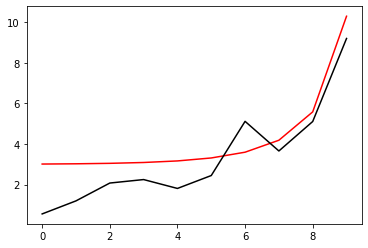

2000 89.80966272386578
[0.55808168 1.19877935 2.07689357 2.25080224 1.81517616 2.44985189
 5.11742457 3.65835772 5.11064194 9.20201761]


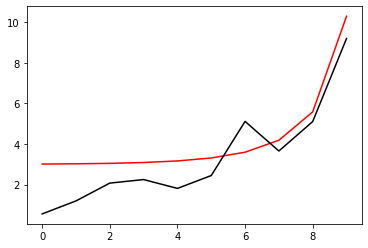

2100 89.80951034540574
[0.55882059 1.19784108 2.07501326 2.25143269 1.81766274 2.45084395
 5.11596322 3.65788463 5.11004988 9.20197833]


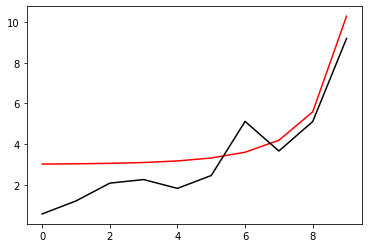

2200 89.8093589176795
[0.55955601 1.19690867 2.07314019 2.25205648 1.82014285 2.45183548
 5.11450365 3.6574134  5.10946061 9.20193904]


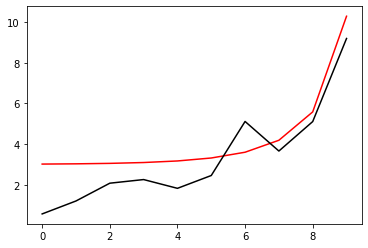

2300 89.80920843243271
[0.56028795 1.19598208 2.07127433 2.25267367 1.82261652 2.45282645
 5.11304585 3.656944   5.10887413 9.20189975]


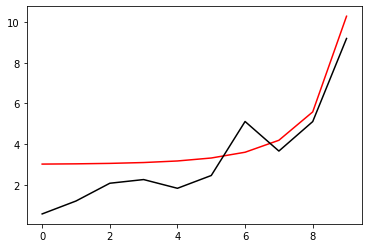

2400 89.8090588815015
[0.56101644 1.19506127 2.06941566 2.2532843  1.82508377 2.45381688
 5.11158981 3.65647644 5.10829042 9.20186046]


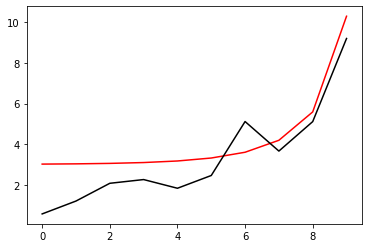

2500 89.8089102568114
[0.56174151 1.19414618 2.06756414 2.25388843 1.8275446  2.45480676
 5.11013553 3.65601069 5.10770946 9.20182116]


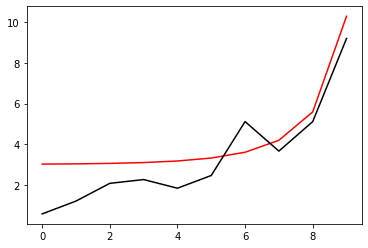

2600 89.80876255037597
[0.56246317 1.19323676 2.06571975 2.2544861  1.82999905 2.4557961
 5.10868301 3.65554676 5.10713125 9.20178185]


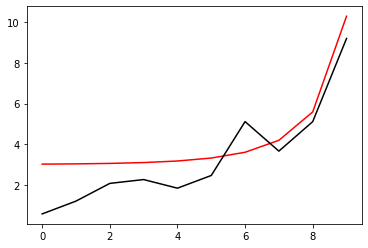

2700 89.80861575429573
[0.56318144 1.19233297 2.06388246 2.25507736 1.83244713 2.45678489
 5.10723224 3.65508462 5.10655577 9.20174254]


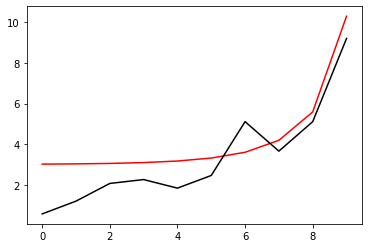

2800 89.80846986075743
[0.56389636 1.19143476 2.06205223 2.25566226 1.83488886 2.45777314
 5.10578321 3.65462427 5.105983   9.20170322]


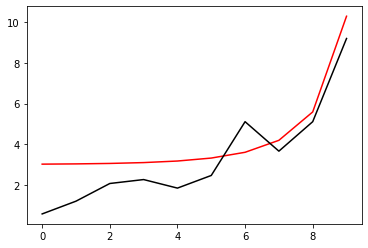

2900 89.80832486203214
[0.56460793 1.19054208 2.06022905 2.25624085 1.83732425 2.45876084
 5.10433593 3.65416571 5.10541293 9.2016639 ]


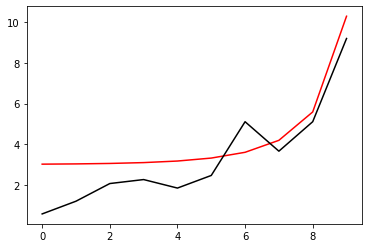

3000 89.80818075047497
[0.56531619 1.1896549  2.05841288 2.25681318 1.83975332 2.45974799
 5.10289038 3.65370891 5.10484556 9.20162458]


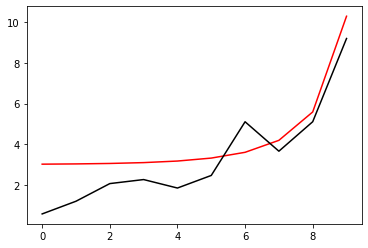

3100 89.80803751852353
[0.56602114 1.18877315 2.05660369 2.25737928 1.84217609 2.4607346
 5.10144657 3.65325387 5.10428085 9.20158524]


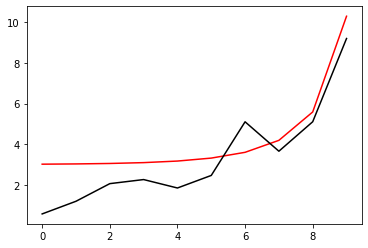

3200 89.80789515869702
[0.56672283 1.1878968  2.05480146 2.25793922 1.84459258 2.46172066
 5.10000448 3.65280058 5.10371882 9.20154591]


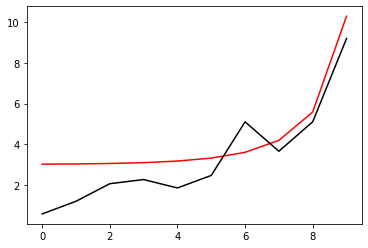

3300 89.8077536635951
[0.56742125 1.18702581 2.05300616 2.25849304 1.84700281 2.46270618
 5.09856411 3.65234904 5.10315943 9.20150657]


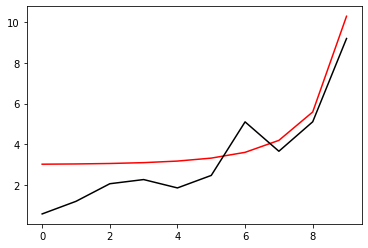

3400 89.80761302589694
[0.56811644 1.18616012 2.05121776 2.25904078 1.84940679 2.46369115
 5.09712546 3.65189922 5.10260267 9.20146722]


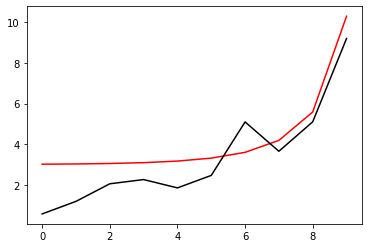

3500 89.80747323836019
[0.56880842 1.18529969 2.04943623 2.2595825  1.85180454 2.46467558
 5.09568852 3.65145113 5.10204854 9.20142787]


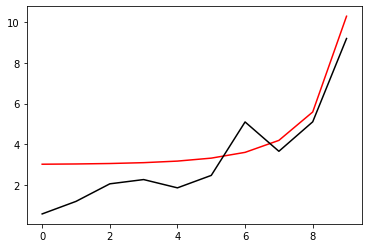

3600 89.80733429382002
[0.56949721 1.18444449 2.04766154 2.26011822 1.85419608 2.46565947
 5.0942533  3.65100475 5.10149703 9.20138851]


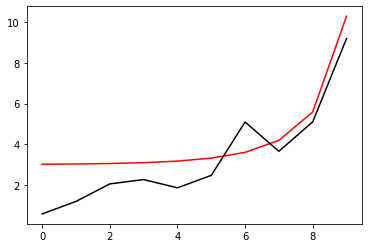

3700 89.80719618518805
[0.57018282 1.18359446 2.04589367 2.26064801 1.85658142 2.46664281
 5.09281977 3.65056007 5.10094811 9.20134915]


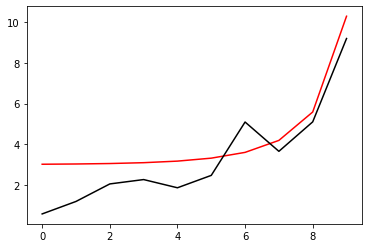

3800 89.80705890545136
[0.57086528 1.18274957 2.04413259 2.26117191 1.85896059 2.4676256
 5.09138795 3.65011708 5.10040177 9.20130978]


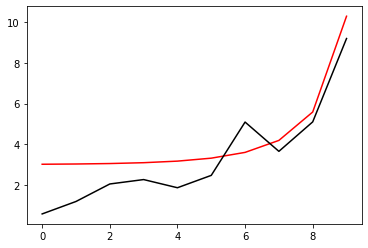

3900 89.80692244767175
[0.5715446  1.18190978 2.04237826 2.26168996 1.86133359 2.46860785
 5.08995782 3.64967578 5.09985801 9.20127041]


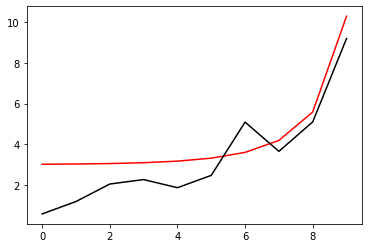

4000 89.80678680498464
[0.57222082 1.18107503 2.04063067 2.2622022  1.86370045 2.46958956
 5.08852939 3.64923616 5.09931682 9.20123104]


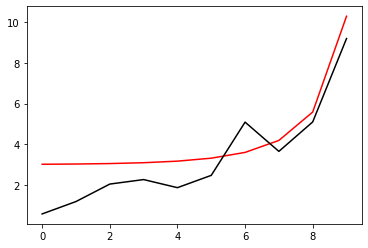

4100 89.80665197059795
[0.57289394 1.1802453  2.03888978 2.26270868 1.86606118 2.47057072
 5.08710264 3.6487982  5.09877817 9.20119166]


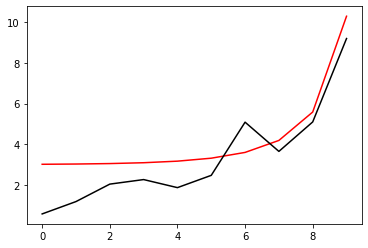

4200 89.8065179377916
[0.57356399 1.17942053 2.03715557 2.26320945 1.86841581 2.47155134
 5.08567757 3.6483619  5.09824205 9.20115227]


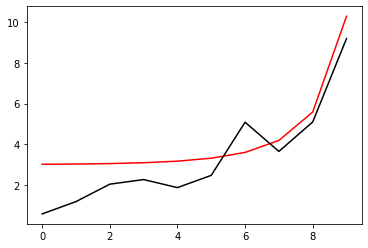

4300 89.80638469991628
[0.57423098 1.17860069 2.035428   2.26370454 1.87076434 2.47253141
 5.08425419 3.64792725 5.09770847 9.20111288]


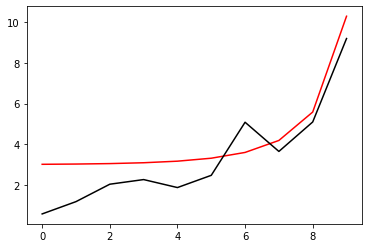

4400 89.80625225039284
[0.57489494 1.17778575 2.03370706 2.264194   1.87310679 2.47351094
 5.08283247 3.64749424 5.09717739 9.20107348]


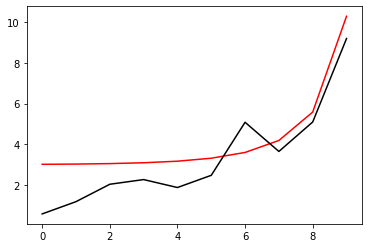

4500 89.80612058271099
[0.57555588 1.17697565 2.03199271 2.26467788 1.87544319 2.47448992
 5.08141243 3.64706285 5.09664882 9.20103409]


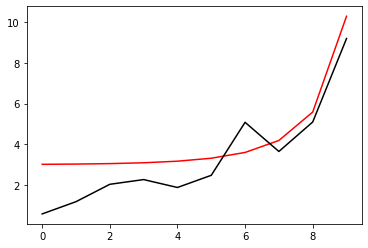

4600 89.80598969042893
[0.57621383 1.17617036 2.03028492 2.26515621 1.87777354 2.47546836
 5.07999405 3.6466331  5.09612274 9.20099468]


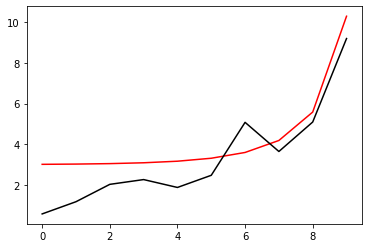

4700 89.80585956717222
[0.57686879 1.17536985 2.02858368 2.26562905 1.88009787 2.47644626
 5.07857733 3.64620495 5.09559913 9.20095527]


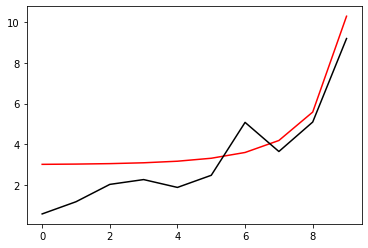

4800 89.80573020663293
[0.5775208  1.17457407 2.02688894 2.26609642 1.88241619 2.47742361
 5.07716227 3.64577841 5.09507799 9.20091586]


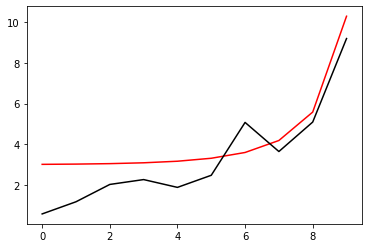

4900 89.80560160256897
[0.57816987 1.17378298 2.0252007  2.26655837 1.88472852 2.47840041
 5.07574887 3.64535347 5.0945593  9.20087644]


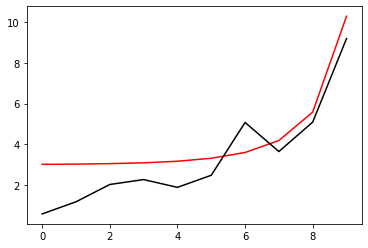

5000 89.80547374880315
[0.57881602 1.17299655 2.0235189  2.26701495 1.88703487 2.47937667
 5.07433711 3.64493011 5.09404306 9.20083702]


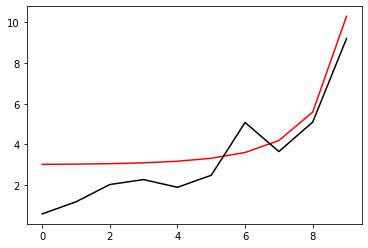

5100 89.80534663922236
[0.57945926 1.17221475 2.02184354 2.26746619 1.88933526 2.48035239
 5.072927   3.64450834 5.09352925 9.20079759]


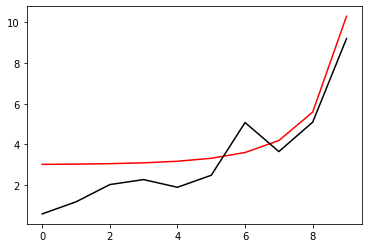

5200 89.80522026777687
[0.58009961 1.17143752 2.02017458 2.26791214 1.89162971 2.48132756
 5.07151852 3.64408814 5.09301786 9.20075816]


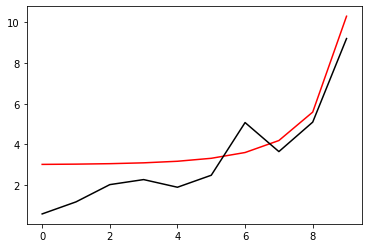

5300 89.80509462847954
[0.5807371  1.17066484 2.01851199 2.26835283 1.89391823 2.48230219
 5.07011169 3.6436695  5.09250887 9.20071872]


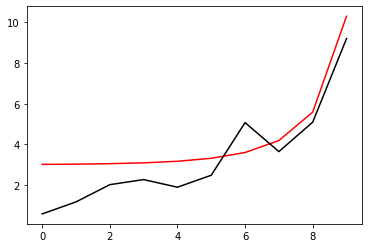

5400 89.80496971540502
[0.58137174 1.16989668 2.01685576 2.26878831 1.89620084 2.48327627
 5.06870649 3.64325241 5.09200229 9.20067928]


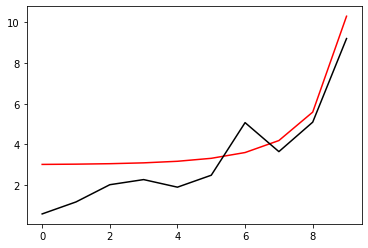

5500 89.80484552268891
[0.58200354 1.16913299 2.01520585 2.26921861 1.89847755 2.48424981
 5.06730292 3.64283688 5.09149809 9.20063983]


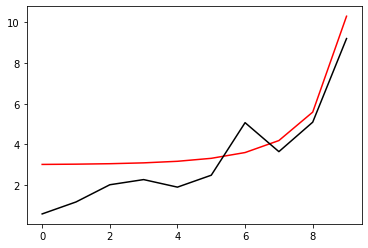

5600 89.80472204452731
[0.58263253 1.16837373 2.01356223 2.26964378 1.90074839 2.4852228
 5.06590097 3.64242288 5.09099627 9.20060038]


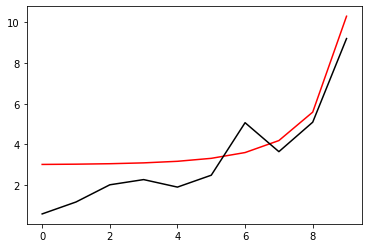

5700 89.80459927517558
[0.58325872 1.16761888 2.01192488 2.27006385 1.90301337 2.48619525
 5.06450065 3.64201041 5.09049681 9.20056093]


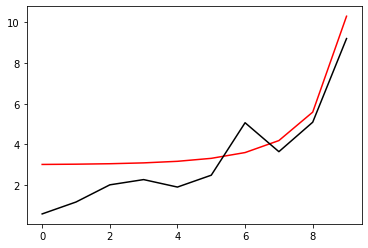

5800 89.8044772089481
[0.58388213 1.16686841 2.01029377 2.27047887 1.90527249 2.48716715
 5.06310194 3.64159947 5.08999971 9.20052147]


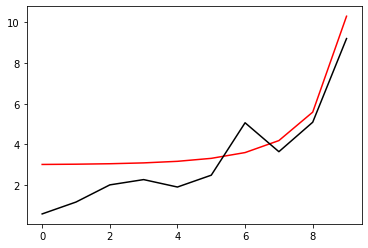

5900 89.80435584021731
[0.58450278 1.16612226 2.00866888 2.27088888 1.90752579 2.48813851
 5.06170484 3.64119004 5.08950495 9.20048201]


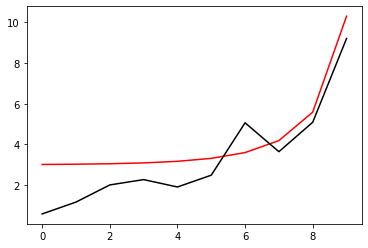

6000 89.80423516341307
[0.58512068 1.16538042 2.00705018 2.2712939  1.90977328 2.48910932
 5.06030936 3.64078212 5.08901253 9.20044254]


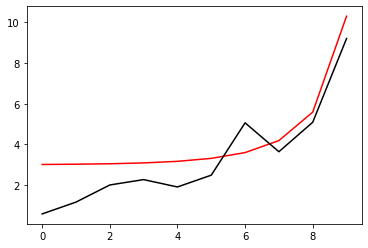

6100 89.80411517302186
[0.58573585 1.16464285 2.00543765 2.27169398 1.91201496 2.49007959
 5.05891548 3.6403757  5.08852242 9.20040307]


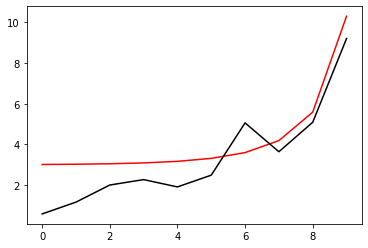

6200 89.80399586358624
[0.5863483  1.1639095  2.00383125 2.27208916 1.91425087 2.49104931
 5.05752321 3.63997077 5.08803463 9.20036359]


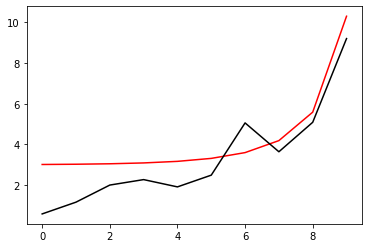

6300 89.80387722970427
[0.58695806 1.16318036 2.00223096 2.27247948 1.916481   2.49201848
 5.05613253 3.63956733 5.08754914 9.20032411]


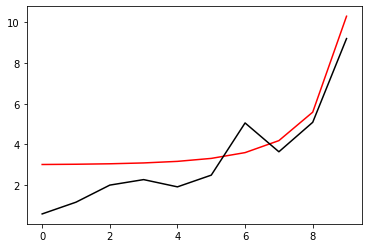

6400 89.80375926602835
[0.58756515 1.16245539 2.00063675 2.27286496 1.91870539 2.49298711
 5.05474344 3.63916536 5.08706594 9.20028463]


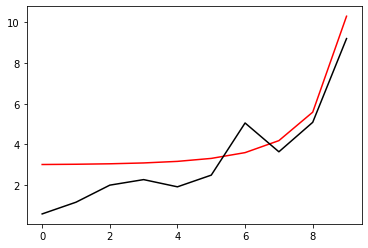

6500 89.80364196726508
[0.58816956 1.16173455 1.99904861 2.27324566 1.92092404 2.49395519
 5.05335595 3.63876486 5.08658502 9.20024514]


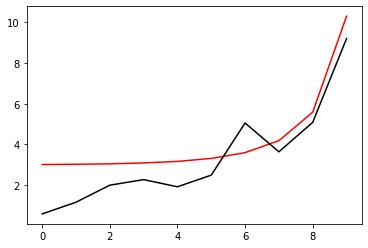

6600 89.80352532817456
[0.58877133 1.16101782 1.9974665  2.27362161 1.92313697 2.49492272
 5.05197005 3.63836582 5.08610637 9.20020564]


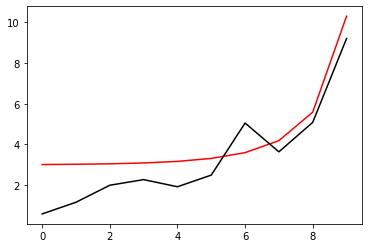

6700 89.8034093435693
[0.58937047 1.16030516 1.99589039 2.27399284 1.9253442  2.49588971
 5.05058573 3.63796824 5.08562997 9.20016615]


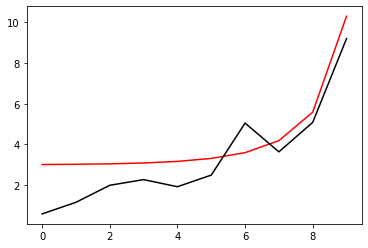

6800 89.80329400831418
[0.58996699 1.15959654 1.99432027 2.27435938 1.92754574 2.49685615
 5.04920298 3.6375721  5.08515583 9.20012665]


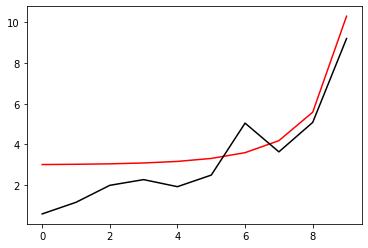

6900 89.80317931732533
[0.59056092 1.15889192 1.9927561  2.27472129 1.9297416  2.49782204
 5.04782182 3.6371774  5.08468393 9.20008714]


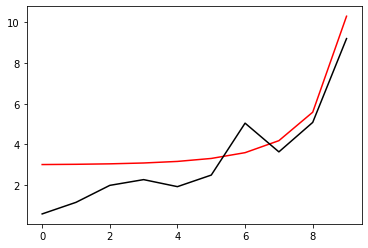

7000 89.80306526556993
[0.59115226 1.15819129 1.99119786 2.27507859 1.93193181 2.49878738
 5.04644223 3.63678414 5.08421426 9.20004763]


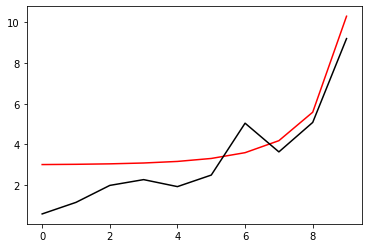

7100 89.80295184806526
[0.59174103 1.1574946  1.98964553 2.27543131 1.93411638 2.49975218
 5.0450642  3.63639229 5.0837468  9.20000812]


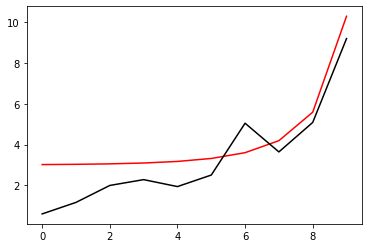

7200 89.80283905987832
[0.59232724 1.15680183 1.98809907 2.2757795  1.93629531 2.50071643
 5.04368774 3.63600187 5.08328156 9.1999686 ]


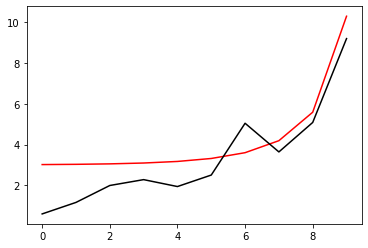

7300 89.80272689612521
[0.59291092 1.15611295 1.98655848 2.27612318 1.93846864 2.50168013
 5.04231285 3.63561286 5.08281852 9.19992908]


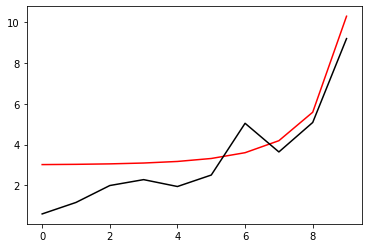

7400 89.80261535197035
[0.59349208 1.15542792 1.98502371 2.2764624  1.94063637 2.50264328
 5.04093951 3.63522525 5.08235766 9.19988955]


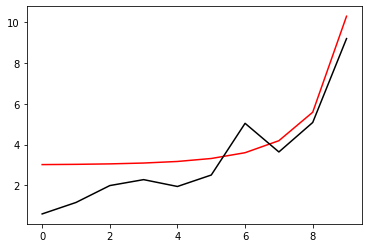

7500 89.80250442262627
[0.59407073 1.15474672 1.98349474 2.27679719 1.94279852 2.50360589
 5.03956773 3.63483903 5.08189899 9.19985002]


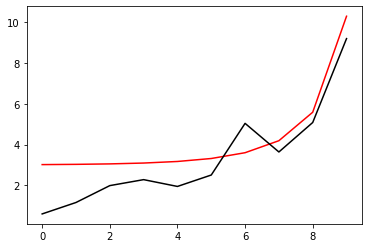

7600 89.80239410335264
[0.59464689 1.15406932 1.98197155 2.27712758 1.94495511 2.50456794
 5.0381975  3.63445421 5.08144249 9.19981048]


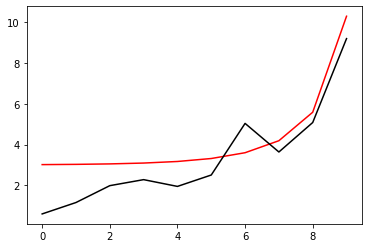

7700 89.80228438945608
[0.59522057 1.15339569 1.98045412 2.2774536  1.94710614 2.50552945
 5.03682881 3.63407076 5.08098815 9.19977095]


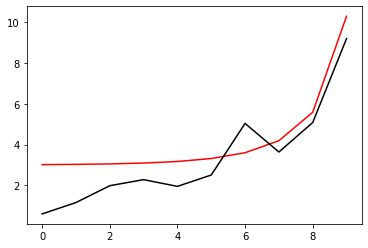

7800 89.80217527628928
[0.59579179 1.15272581 1.97894241 2.2777753  1.94925164 2.5064904
 5.03546167 3.6336887  5.08053596 9.1997314 ]


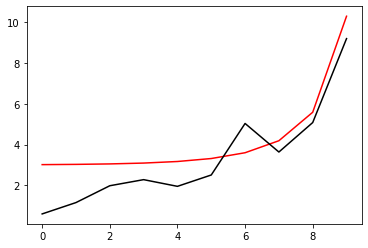

7900 89.80206675925076
[0.59636056 1.15205963 1.97743641 2.2780927  1.95139161 2.50745081
 5.03409607 3.633308   5.08008591 9.19969186]


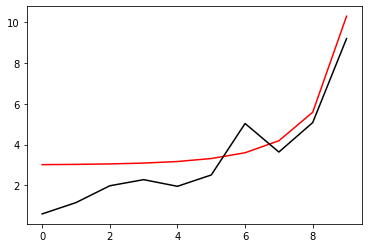

8000 89.80195883378414
[0.59692689 1.15139714 1.97593609 2.27840583 1.95352608 2.50841067
 5.03273201 3.63292866 5.079638   9.19965231]


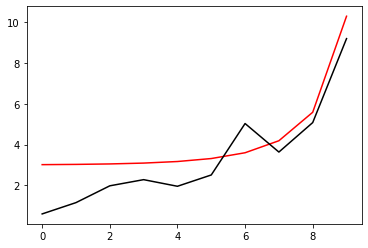

8100 89.80185149537756
[0.59749081 1.1507383  1.97444143 2.27871474 1.95565506 2.50936997
 5.03136949 3.63255067 5.07919221 9.19961275]


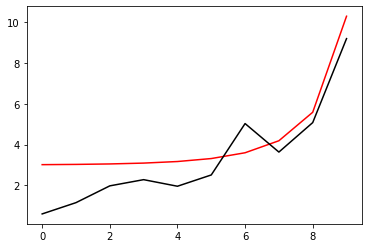

8200 89.80174473956338
[0.59805232 1.1500831  1.9729524  2.27901945 1.95777857 2.51032873
 5.03000849 3.63217404 5.07874853 9.1995732 ]


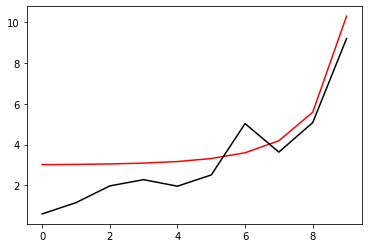

8300 89.80163856191753
[0.59861144 1.1494315  1.97146897 2.27931999 1.95989661 2.51128693
 5.02864902 3.63179874 5.07830696 9.19953363]


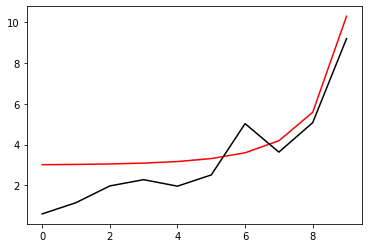

8400 89.80153295805898
[0.59916818 1.14878347 1.96999112 2.27961641 1.96200921 2.51224459
 5.02729108 3.63142478 5.07786748 9.19949407]


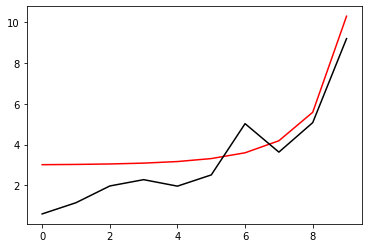

8500 89.80142792364916
[0.59972256 1.14813899 1.96851883 2.27990872 1.96411637 2.51320169
 5.02593465 3.63105215 5.07743009 9.1994545 ]


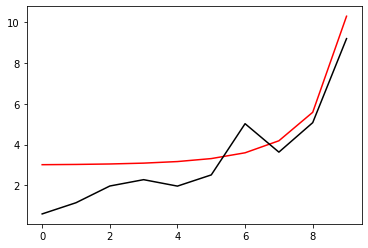

8600 89.80132345439196
[0.6002746  1.14749803 1.96705208 2.28019697 1.96621812 2.51415824
 5.02457975 3.63068084 5.07699478 9.19941493]


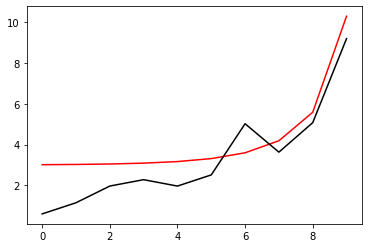

8700 89.8012195460323
[0.60082429 1.14686057 1.96559083 2.28048119 1.96831446 2.51511424
 5.02322636 3.63031084 5.07656154 9.19937535]


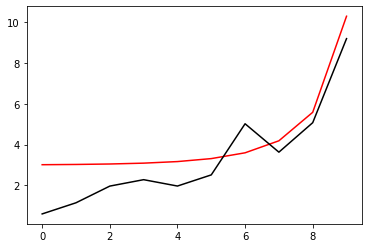

8800 89.80111619435665
[0.60137167 1.14622658 1.96413507 2.28076139 1.97040542 2.51606968
 5.02187447 3.62994216 5.07613035 9.19933577]


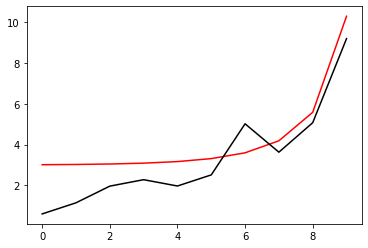

8900 89.80101339519204
[0.60191673 1.14559603 1.96268477 2.28103763 1.97249101 2.51702457
 5.0205241  3.62957477 5.07570122 9.19929618]


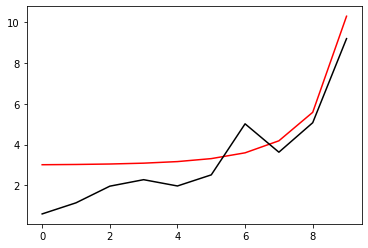

9000 89.80091114440548
[0.60245951 1.1449689  1.96123991 2.28130993 1.97457123 2.51797891
 5.01917523 3.62920868 5.07527413 9.19925659]


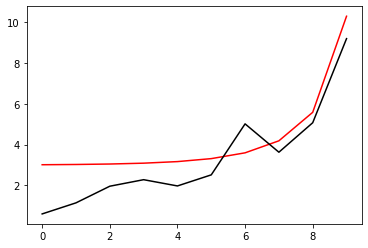

9100 89.80080943790381
[0.603      1.14434517 1.95980047 2.28157831 1.97664611 2.5189327
 5.01782786 3.62884388 5.07484907 9.199217  ]


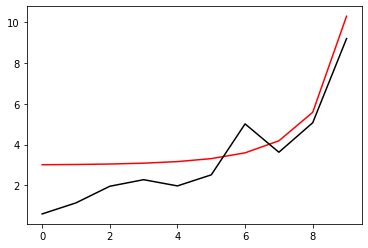

9200 89.80070827163314
[0.60353822 1.1437248  1.95836641 2.28184282 1.97871567 2.51988593
 5.01648199 3.62848036 5.07442604 9.19917741]


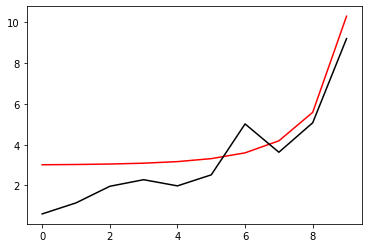

9300 89.80060764157827
[0.60407419 1.14310777 1.95693772 2.28210348 1.9807799  2.5208386
 5.01513762 3.62811812 5.07400502 9.19913781]


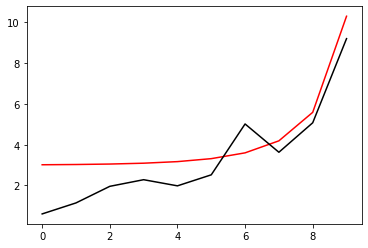

9400 89.80050754376256
[0.60460792 1.14249407 1.95551438 2.28236031 1.98283884 2.52179073
 5.01379473 3.62775714 5.07358601 9.1990982 ]


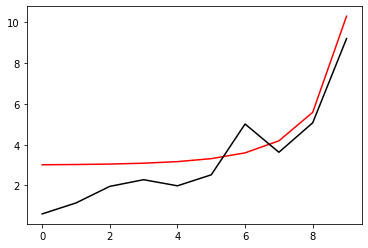

9500 89.80040797424701
[0.60513941 1.14188365 1.95409636 2.28261336 1.98489249 2.52274229
 5.01245334 3.62739744 5.073169   9.1990586 ]


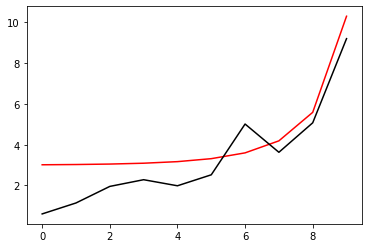

9600 89.80030892913025
[0.6056687  1.14127651 1.95268363 2.28286265 1.98694087 2.52369331
 5.01111343 3.62703899 5.07275398 9.19901899]


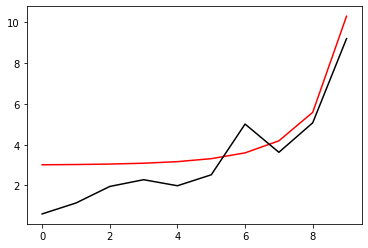

9700 89.800210404548
[0.60619577 1.14067261 1.95127618 2.28310821 1.98898399 2.52464376
 5.009775   3.62668179 5.07234094 9.19897937]


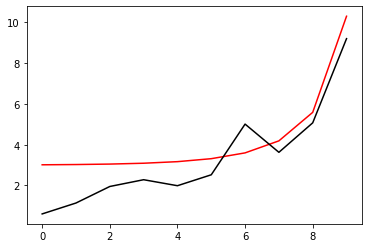

9800 89.8001123966724
[0.60672066 1.14007194 1.94987398 2.28335007 1.99102186 2.52559366
 5.00843805 3.62632583 5.07192988 9.19893976]


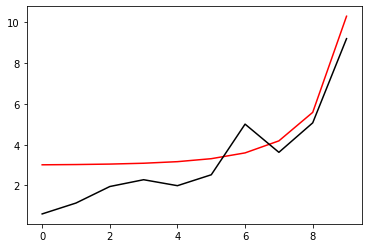

9900 89.80001490171216
[0.60724337 1.13947446 1.94847701 2.28358826 1.99305451 2.526543
 5.00710257 3.62597112 5.07152078 9.19890013]


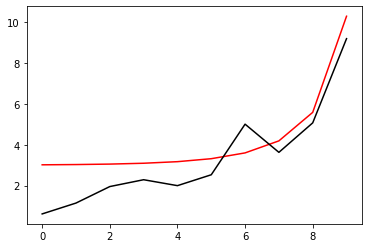

10000 89.7999179159114
[0.60776392 1.13888017 1.94708524 2.28382281 1.99508194 2.52749179
 5.00576857 3.62561764 5.07111363 9.19886051]


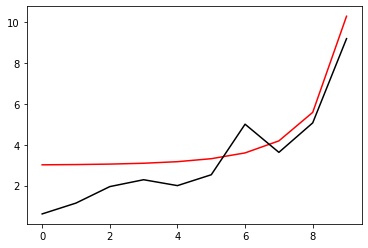

In [17]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.79982143554989
[0.60828231 1.13828902 1.94569865 2.28405375 1.99710417 2.52844002
 5.00443604 3.62526539 5.07070843 9.19882088]


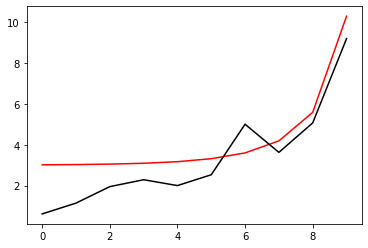

200 89.79972545694227
[0.60879856 1.137701   1.94431723 2.2842811  1.99912121 2.52938769
 5.00310498 3.62491435 5.07030518 9.19878125]


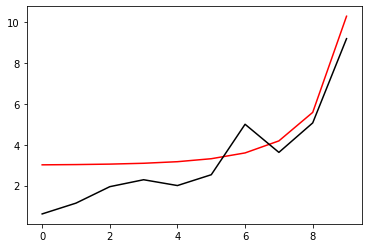

300 89.79962997643791
[0.60931268 1.13711609 1.94294094 2.28450489 2.00113308 2.53033481
 5.00177538 3.62456454 5.06990385 9.19874162]


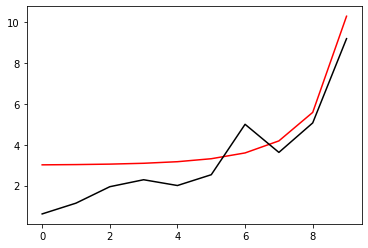

400 89.79953499042026
[0.60982468 1.13653427 1.94156977 2.28472516 2.00313979 2.53128136
 5.00044724 3.62421593 5.06950445 9.19870198]


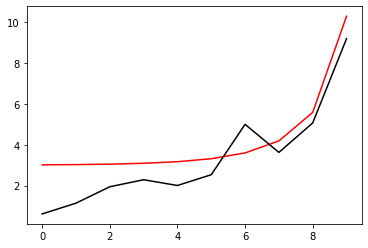

500 89.7994404953067
[0.61033458 1.13595551 1.94020369 2.28494193 2.00514135 2.53222736
 4.99912055 3.62386853 5.06910697 9.19866233]


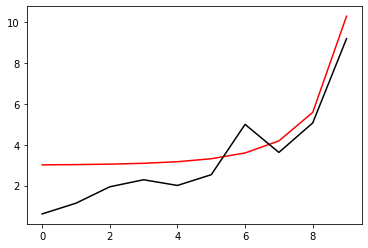

600 89.7993464875479
[0.61084239 1.13537979 1.93884268 2.28515522 2.00713778 2.53317279
 4.99779533 3.62352233 5.06871139 9.19862269]


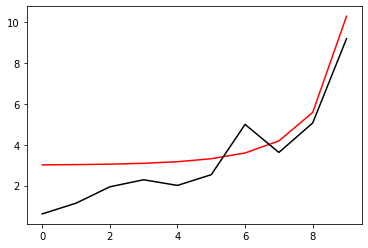

700 89.79925296362778
[0.61134811 1.13480708 1.93748672 2.28536507 2.00912909 2.53411767
 4.99647155 3.62317732 5.06831771 9.19858304]


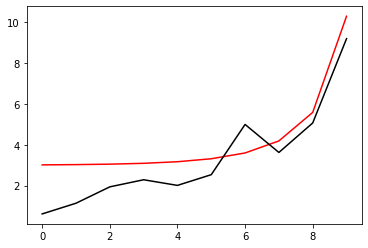

800 89.7991599200629
[0.61185177 1.13423738 1.93613578 2.28557151 2.0111153  2.53506199
 4.99514922 3.62283349 5.06792593 9.19854339]


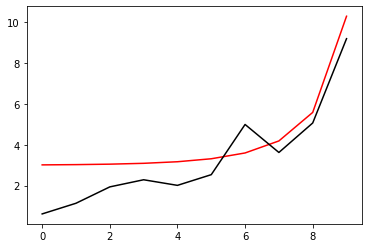

900 89.79906735340207
[0.61235337 1.13367065 1.93478985 2.28577455 2.01309642 2.53600574
 4.99382834 3.62249085 5.06753603 9.19850373]


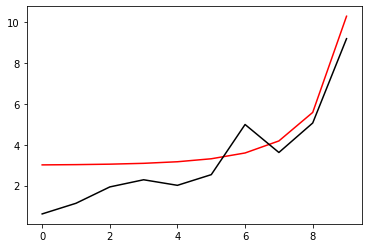

1000 89.79897526022617
[0.61285292 1.13310688 1.9334489  2.28597423 2.01507246 2.53694894
 4.9925089  3.62214938 5.067148   9.19846407]


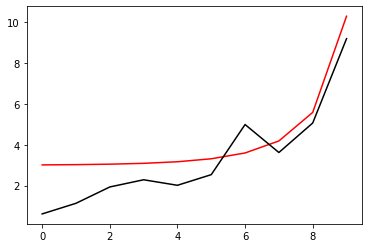

1100 89.7988836371477
[0.61335044 1.13254603 1.93211291 2.28617058 2.01704344 2.53789157
 4.9911909  3.62180908 5.06676184 9.19842441]


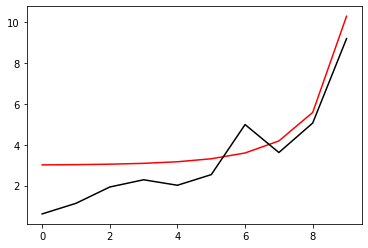

1200 89.79879248081026
[0.61384593 1.13198811 1.93078186 2.28636361 2.01900937 2.53883364
 4.98987434 3.62146994 5.06637755 9.19838475]


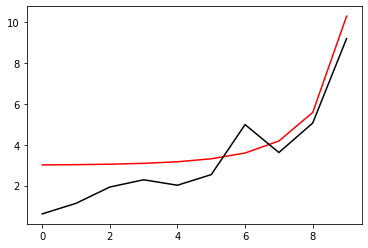

1300 89.79870178788866
[0.61433942 1.13143307 1.92945573 2.28655336 2.02097026 2.53977515
 4.98855921 3.62113197 5.0659951  9.19834508]


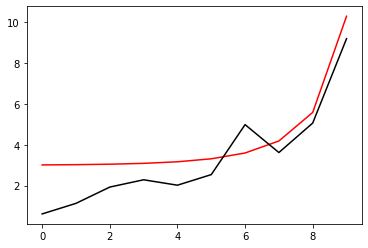

1400 89.79861155508802
[0.6148309  1.13088091 1.92813449 2.28673986 2.02292614 2.5407161
 4.98724551 3.62079514 5.0656145  9.1983054 ]


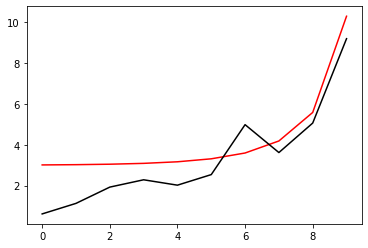

1500 89.79852177914384
[0.61532039 1.13033159 1.92681812 2.28692313 2.024877   2.54165649
 4.98593324 3.62045947 5.06523574 9.19826573]


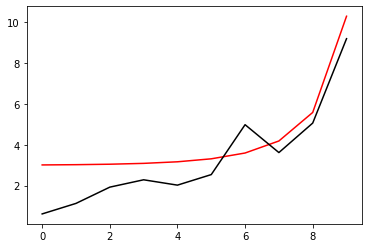

1600 89.79843245682149
[0.61580791 1.12978511 1.92550661 2.28710319 2.02682286 2.54259631
 4.9846224  3.62012494 5.06485881 9.19822605]


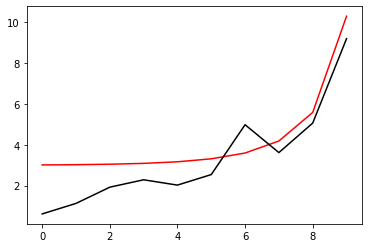

1700 89.79834358491587
[0.61629346 1.12924144 1.92419992 2.28728007 2.02876375 2.54353556
 4.98331298 3.61979154 5.0644837  9.19818637]


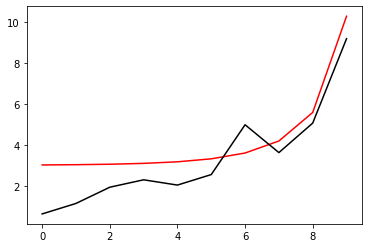

1800 89.79825516025112
[0.61677705 1.12870056 1.92289805 2.2874538  2.03069967 2.54447425
 4.98200498 3.61945927 5.06411041 9.19814668]


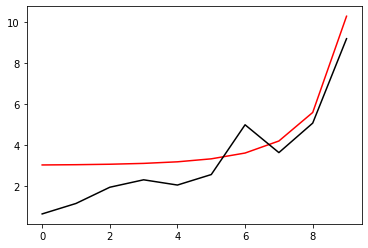

1900 89.79816717968045
[0.61725869 1.12816246 1.92160096 2.2876244  2.03263063 2.54541238
 4.9806984  3.61912813 5.06373892 9.198107  ]


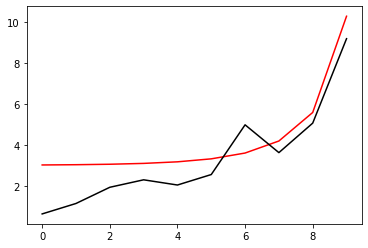

2000 89.79807964008553
[0.6177384  1.1276271  1.92030865 2.28779189 2.03455665 2.54634994
 4.97939323 3.61879811 5.06336924 9.1980673 ]


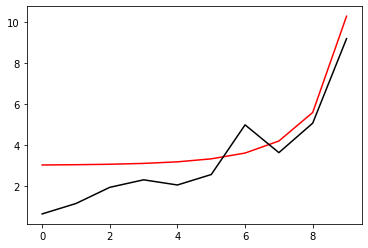

2100 89.79799253837625
[0.61821619 1.12709448 1.91902108 2.28795631 2.03647774 2.54728694
 4.97808947 3.61846921 5.06300134 9.19802761]


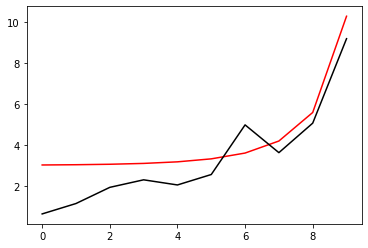

2200 89.79790587149077
[0.61869206 1.12656458 1.91773823 2.28811767 2.03839392 2.54822337
 4.97678712 3.61814142 5.06263523 9.19798791]


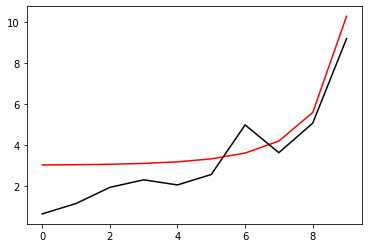

2300 89.79781963639466
[0.61916603 1.12603737 1.91646009 2.28827601 2.04030519 2.54915923
 4.97548617 3.61781473 5.0622709  9.19794821]


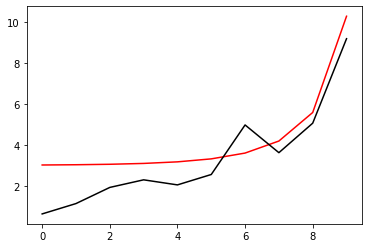

2400 89.79773383008096
[0.6196381  1.12551283 1.91518664 2.28843134 2.04221158 2.55009452
 4.97418663 3.61748914 5.06190835 9.19790851]


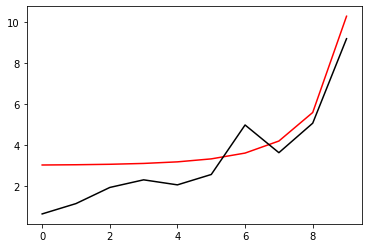

2500 89.79764844956979
[0.6201083  1.12499096 1.91391784 2.28858369 2.04411309 2.55102925
 4.97288849 3.61716464 5.06154755 9.1978688 ]


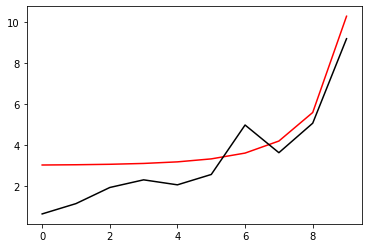

2600 89.79756349190802
[0.62057662 1.12447172 1.9126537  2.28873309 2.04600973 2.55196341
 4.97159175 3.61684124 5.06118851 9.19782909]


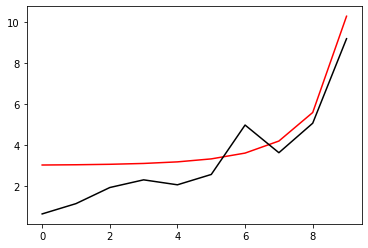

2700 89.7974789541691
[0.62104308 1.12395511 1.91139417 2.28887955 2.04790153 2.552897
 4.9702964  3.61651892 5.06083122 9.19778938]


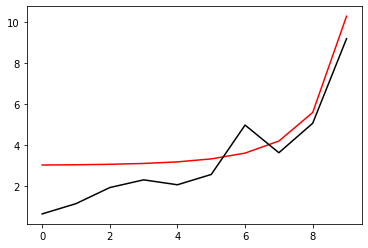

2800 89.79739483345269
[0.62150769 1.1234411  1.91013925 2.28902311 2.04978849 2.55383002
 4.96900244 3.61619768 5.06047568 9.19774966]


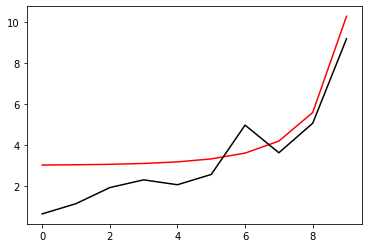

2900 89.79731112688414
[0.62197046 1.12292968 1.9088889  2.28916378 2.05167063 2.55476248
 4.96770988 3.61587751 5.06012187 9.19770994]


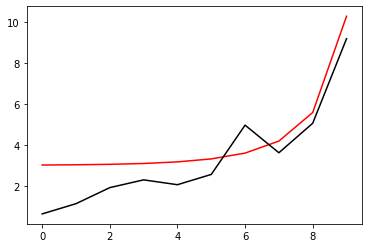

3000 89.79722783161462
[0.62243139 1.12242082 1.90764313 2.28930159 2.05354796 2.55569436
 4.9664187  3.61555841 5.05976978 9.19767022]


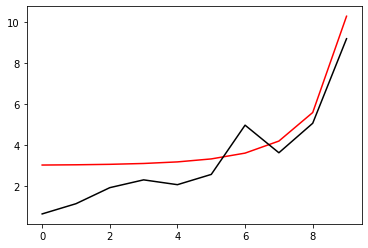

3100 89.79714494482084
[0.6228905  1.12191451 1.90640189 2.28943656 2.05542049 2.55662567
 4.9651289  3.61524037 5.05941942 9.19763049]


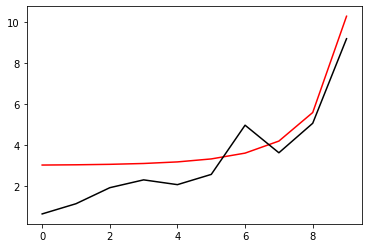

3200 89.79706246370425
[0.6233478  1.12141074 1.90516517 2.28956872 2.05728823 2.55755641
 4.96384049 3.6149234  5.05907078 9.19759076]


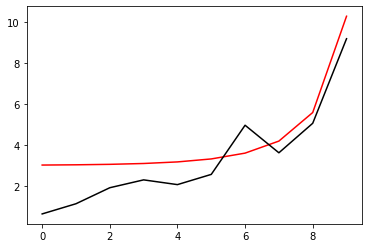

3300 89.79698038549122
[0.6238033  1.12090948 1.90393296 2.28969808 2.05915121 2.55848658
 4.96255345 3.61460748 5.05872384 9.19755103]


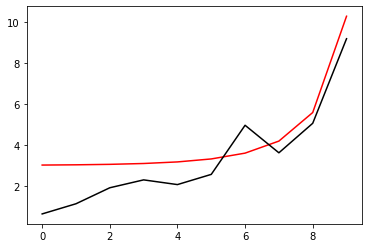

3400 89.79689870743296
[0.62425701 1.12041072 1.90270523 2.28982468 2.06100942 2.55941618
 4.9612678  3.61429261 5.0583786  9.1975113 ]


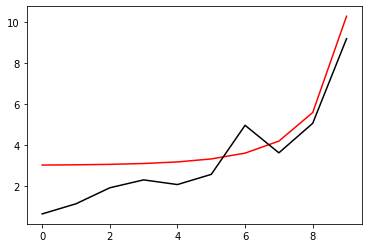

3500 89.79681742680461
[0.62470894 1.11991445 1.90148196 2.28994853 2.06286289 2.5603452
 4.95998351 3.61397878 5.05803506 9.19747156]


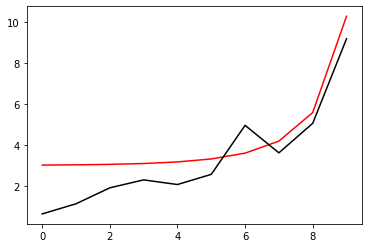

3600 89.7967365409055
[0.62515909 1.11942064 1.90026314 2.29006965 2.06471163 2.56127365
 4.9587006  3.61366599 5.0576932  9.19743182]


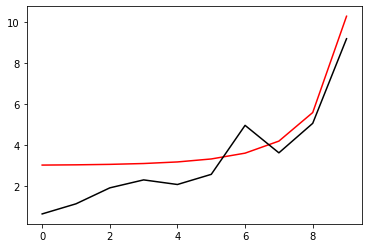

3700 89.79665604705876
[0.62560747 1.11892927 1.89904874 2.29018807 2.06655564 2.56220153
 4.95741905 3.61335424 5.05735303 9.19739208]


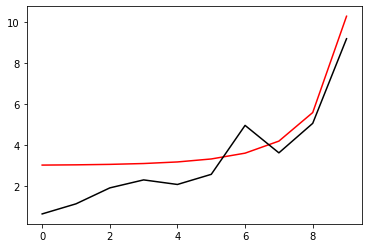

3800 89.79657594261093
[0.62605411 1.11844034 1.89783874 2.29030382 2.06839495 2.56312884
 4.95613887 3.61304352 5.05701452 9.19735233]


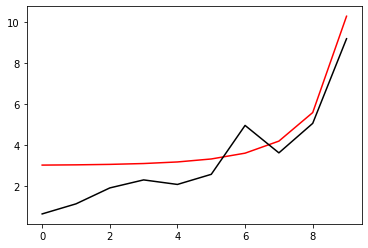

3900 89.79649622493193
[0.626499   1.11795382 1.89663313 2.2904169  2.07022956 2.56405557
 4.95486006 3.61273382 5.05667769 9.19731258]


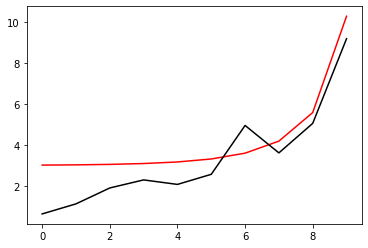

4000 89.79641689141464
[0.62694215 1.1174697  1.89543189 2.29052735 2.07205949 2.56498172
 4.9535826  3.61242514 5.05634252 9.19727283]


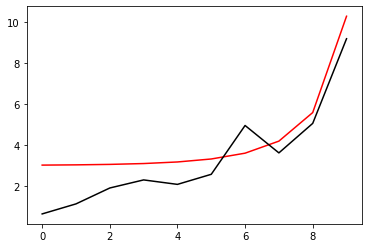

4100 89.79633793947485
[0.62738358 1.11698797 1.89423499 2.29063518 2.07388474 2.5659073
 4.9523065  3.61211748 5.056009   9.19723308]


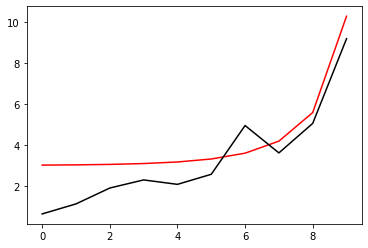

4200 89.79625936655054
[0.62782329 1.1165086  1.89304241 2.29074042 2.07570534 2.5668323
 4.95103176 3.61181083 5.05567712 9.19719332]


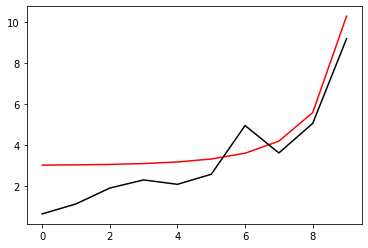

4300 89.79618117010251
[0.62826129 1.11603158 1.89185415 2.29084309 2.0775213  2.56775673
 4.94975837 3.61150519 5.05534689 9.19715356]


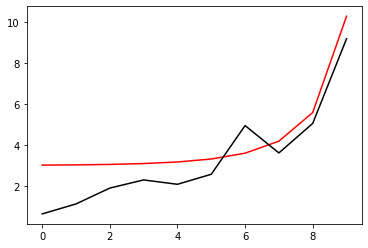

4400 89.79610334761321
[0.62869759 1.11555689 1.89067018 2.29094321 2.07933262 2.56868058
 4.94848633 3.61120054 5.0550183  9.1971138 ]


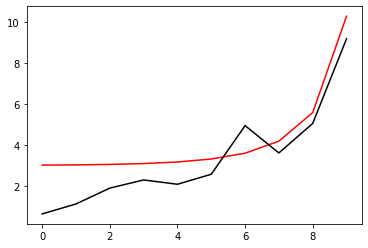

4500 89.79602589658701
[0.62913221 1.11508453 1.88949047 2.2910408  2.08113933 2.56960385
 4.94721564 3.6108969  5.05469133 9.19707403]


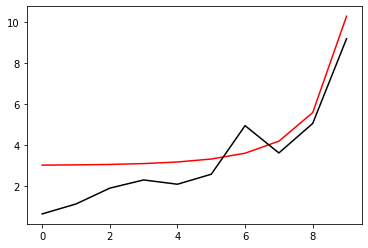

4600 89.79594881454996
[0.62956514 1.11461447 1.88831502 2.29113588 2.08294142 2.57052655
 4.9459463  3.61059425 5.05436598 9.19703426]


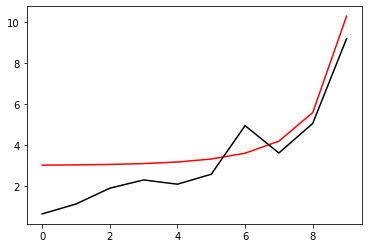

4700 89.7958720990495
[0.6299964  1.1141467  1.8871438  2.29122848 2.08473892 2.57144866
 4.9446783  3.61029259 5.05404225 9.19699449]


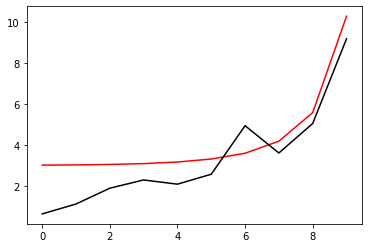

4800 89.7957957476541
[0.630426   1.1136812  1.8859768  2.2913186  2.08653184 2.5723702
 4.94341164 3.60999191 5.05372013 9.19695472]


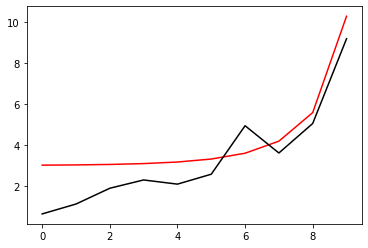

4900 89.79571975795331
[0.63085394 1.11321796 1.88481399 2.29140628 2.08832018 2.57329116
 4.94214631 3.60969221 5.05339961 9.19691494]


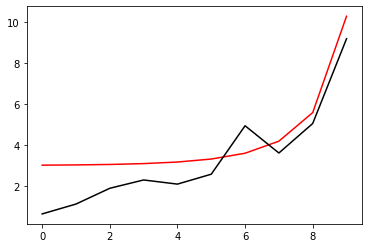

5000 89.79564412755717
[0.63128024 1.11275697 1.88365536 2.29149153 2.09010397 2.57421154
 4.94088233 3.60939348 5.05308069 9.19687516]


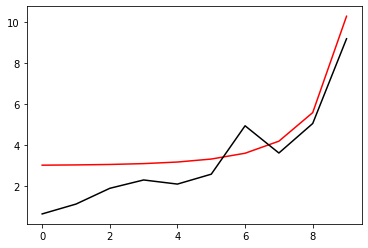

5100 89.79556885409649
[0.6317049  1.1122982  1.88250088 2.29157438 2.09188321 2.57513134
 4.93961967 3.60909573 5.05276335 9.19683538]


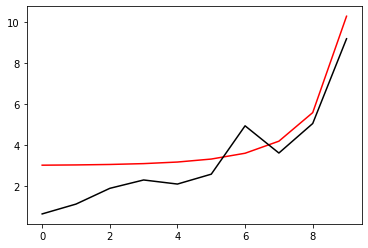

5200 89.79549393522221
[0.63212793 1.11184165 1.88135055 2.29165484 2.09365791 2.57605055
 4.93835835 3.60879894 5.05244761 9.1967956 ]


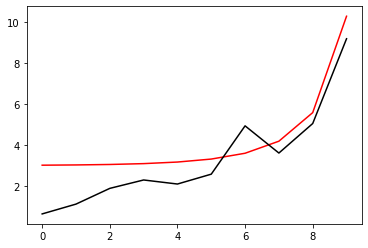

5300 89.79541936860515
[0.63254934 1.11138729 1.88020435 2.29173293 2.0954281  2.57696919
 4.93709836 3.60850311 5.05213344 9.19675581]


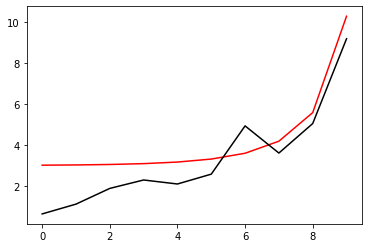

5400 89.79534515193636
[0.63296914 1.11093513 1.87906224 2.29180868 2.09719377 2.57788724
 4.93583969 3.60820824 5.05182084 9.19671602]


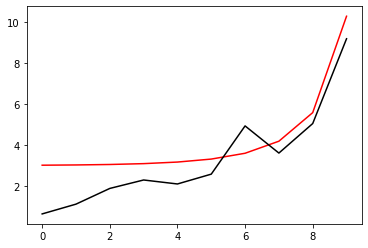

5500 89.79527128292638
[0.63338733 1.11048513 1.87792423 2.2918821  2.09895495 2.57880471
 4.93458234 3.60791432 5.0515098  9.19667623]


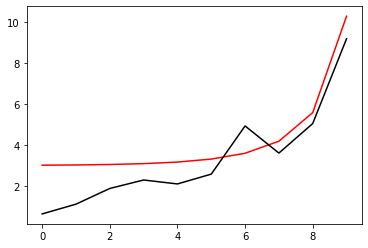

5600 89.79519775930507
[0.63380394 1.11003729 1.87679028 2.29195321 2.10071164 2.5797216
 4.93332632 3.60762135 5.05120033 9.19663643]


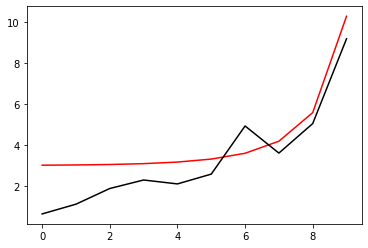

5700 89.79512457882171
[0.63421895 1.10959159 1.87566038 2.29202203 2.10246386 2.5806379
 4.93207162 3.60732933 5.05089241 9.19659664]


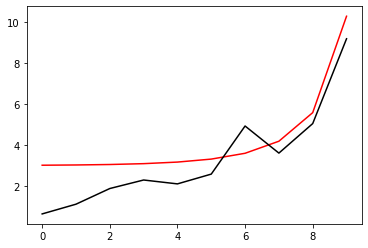

5800 89.79505173924463
[0.63463239 1.10914802 1.87453452 2.29208859 2.10421162 2.58155362
 4.93081823 3.60703824 5.05058604 9.19655684]


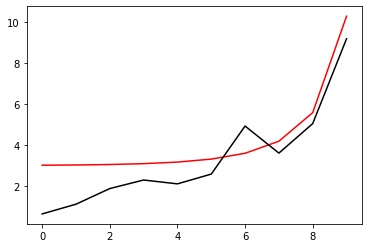

5900 89.79497923836082
[0.63504425 1.10870656 1.87341267 2.29215289 2.10595493 2.58246876
 4.92956615 3.60674809 5.05028121 9.19651703]


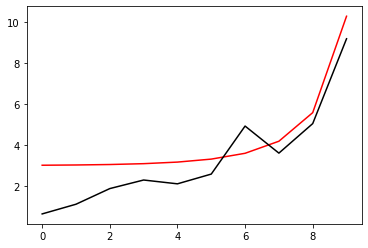

6000 89.79490707397616
[0.63545456 1.10826721 1.87229482 2.29221496 2.1076938  2.58338331
 4.92831539 3.60645888 5.04997791 9.19647723]


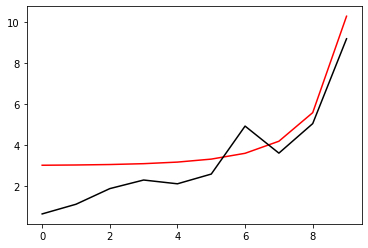

6100 89.79483524391487
[0.63586331 1.10782994 1.87118096 2.29227482 2.10942824 2.58429728
 4.92706594 3.60617059 5.04967615 9.19643742]


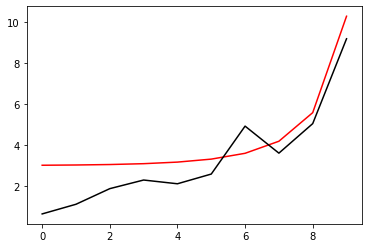

6200 89.79476374601947
[0.63627051 1.10739475 1.87007105 2.29233249 2.11115827 2.58521065
 4.92581779 3.60588322 5.04937591 9.19639761]


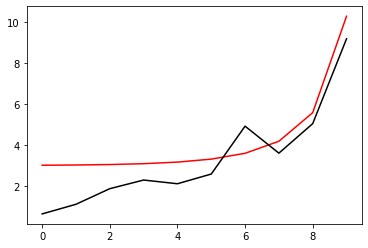

6300 89.79469257815057
[0.63667618 1.10696162 1.86896509 2.29238797 2.1128839  2.58612345
 4.92457095 3.60559677 5.04907719 9.1963578 ]


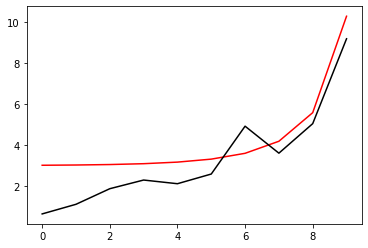

6400 89.79462173818678
[0.63708031 1.10653053 1.86786306 2.29244131 2.11460514 2.58703565
 4.92332541 3.60531124 5.04877998 9.19631798]


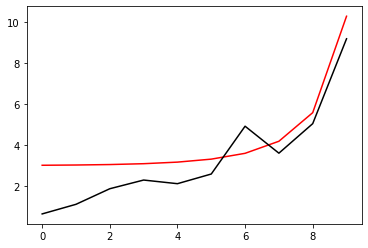

6500 89.79455122402423
[0.63748293 1.10610148 1.86676494 2.2924925  2.116322   2.58794727
 4.92208117 3.60502661 5.04848427 9.19627817]


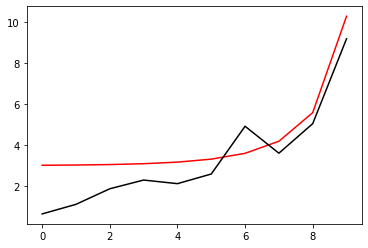

6600 89.79448103357673
[0.63788403 1.10567445 1.86567072 2.29254157 2.11803449 2.5888583
 4.92083823 3.6047429  5.04819007 9.19623835]


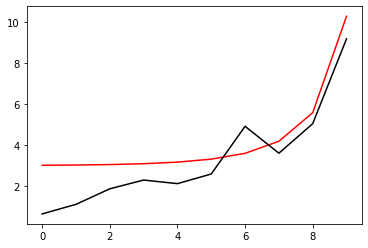

6700 89.79441116477543
[0.63828362 1.10524942 1.86458037 2.29258854 2.11974263 2.58976874
 4.91959658 3.60446009 5.04789736 9.19619852]


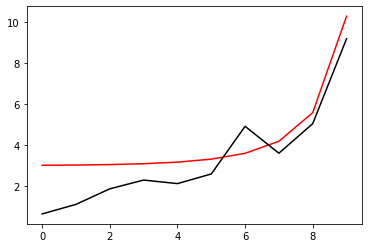

6800 89.7943416155687
[0.63868171 1.1048264  1.86349388 2.29263343 2.12144643 2.59067859
 4.91835623 3.60417817 5.04760614 9.1961587 ]


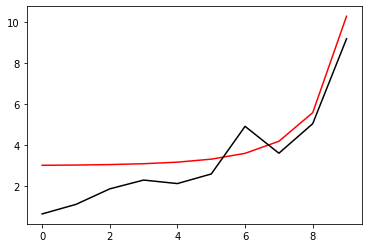

6900 89.79427238392185
[0.63907831 1.10440535 1.86241123 2.29267624 2.12314589 2.59158785
 4.91711717 3.60389715 5.04731641 9.19611887]


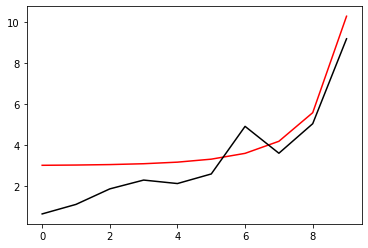

7000 89.79420346781707
[0.63947343 1.10398627 1.86133242 2.29271701 2.12484103 2.59249653
 4.9158794  3.60361702 5.04702815 9.19607904]


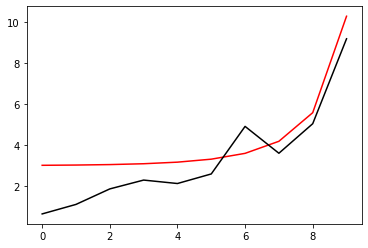

7100 89.79413486525327
[0.63986707 1.10356916 1.86025741 2.29275574 2.12653187 2.59340461
 4.91464291 3.60333778 5.04674137 9.19603921]


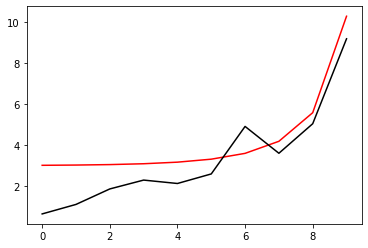

7200 89.79406657424572
[0.64025924 1.10315398 1.85918619 2.29279246 2.12821841 2.5943121
 4.91340771 3.60305942 5.04645605 9.19599938]


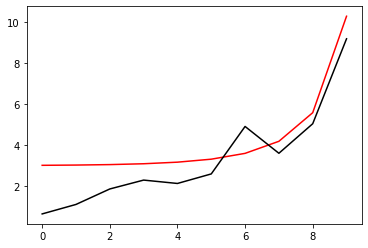

7300 89.79399859282607
[0.64064995 1.10274074 1.85811875 2.29282718 2.12990067 2.595219
 4.91217379 3.60278194 5.04617219 9.19595954]


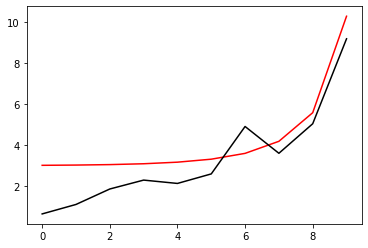

7400 89.79393091904231
[0.64103921 1.10232942 1.85705508 2.29285992 2.13157865 2.5961253
 4.91094115 3.60250533 5.0458898  9.1959197 ]


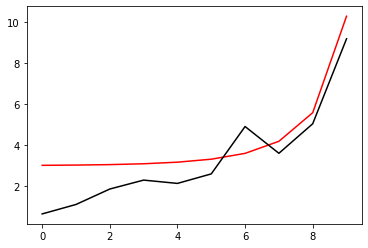

7500 89.7938635509582
[0.64142702 1.10192    1.85599514 2.2928907  2.13325237 2.59703102
 4.90970978 3.6022296  5.04560885 9.19587986]


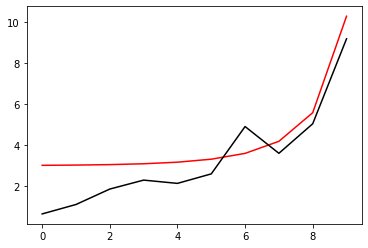

7600 89.79379648665358
[0.64181339 1.10151249 1.85493894 2.29291953 2.13492183 2.59793614
 4.90847969 3.60195473 5.04532934 9.19584001]


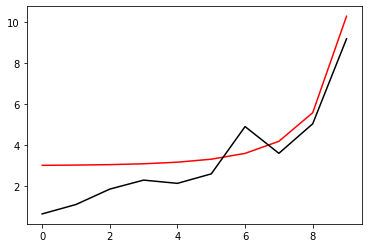

7700 89.79372972422375
[0.64219833 1.10110685 1.85388644 2.29294643 2.13658706 2.59884066
 4.90725088 3.60168072 5.04505128 9.19580017]


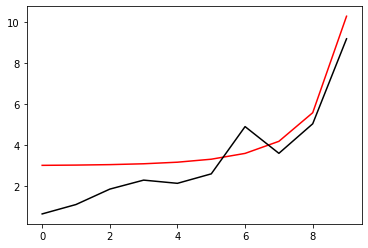

7800 89.79366326177961
[0.64258184 1.10070309 1.85283764 2.29297141 2.13824806 2.59974459
 4.90602334 3.60140758 5.04477465 9.19576032]


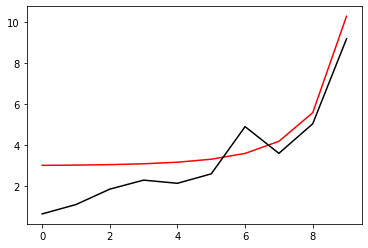

7900 89.7935970974476
[0.64296394 1.10030119 1.85179252 2.2929945  2.13990485 2.60064793
 4.90479706 3.60113529 5.04449944 9.19572047]


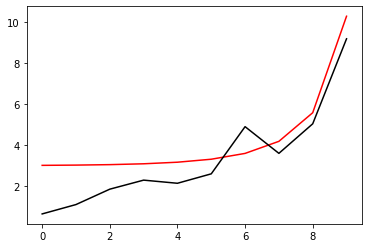

8000 89.79353122936908
[0.64334462 1.09990113 1.85075106 2.29301571 2.14155743 2.60155067
 4.90357205 3.60086385 5.04422567 9.19568062]


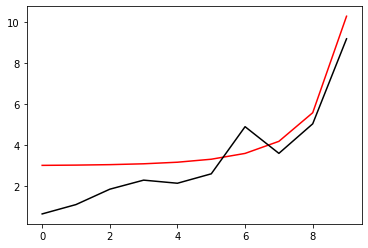

8100 89.79346565570076
[0.6437239  1.09950292 1.84971325 2.29303505 2.14320581 2.60245282
 4.90234831 3.60059326 5.04395331 9.19564076]


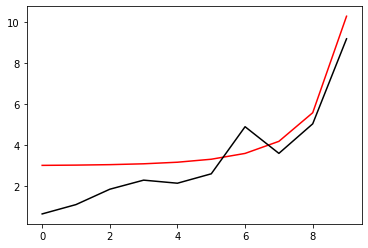

8200 89.79340037461417
[0.64410179 1.09910653 1.84867907 2.29305254 2.14485002 2.60335437
 4.90112582 3.60032352 5.04368236 9.1956009 ]


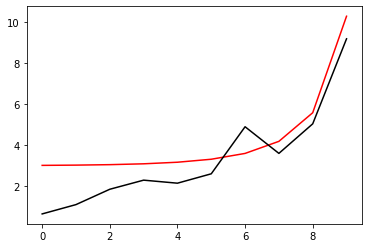

8300 89.79333538429559
[0.64447828 1.09871195 1.84764851 2.2930682  2.14649005 2.60425532
 4.8999046  3.60005461 5.04341282 9.19556104]


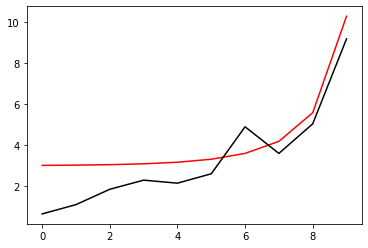

8400 89.79327068294599
[0.64485339 1.09831918 1.84662154 2.29308205 2.14812592 2.60515568
 4.89868464 3.59978655 5.04314468 9.19552118]


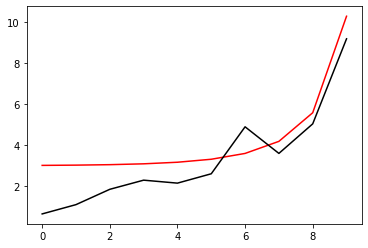

8500 89.79320626878061
[0.64522713 1.0979282  1.84559816 2.29309409 2.14975764 2.60605543
 4.89746593 3.59951931 5.04287794 9.19548132]


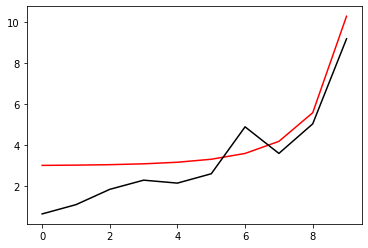

8600 89.79314214002936
[0.6455995  1.097539   1.84457835 2.29310435 2.15138523 2.60695459
 4.89624847 3.59925291 5.04261259 9.19544145]


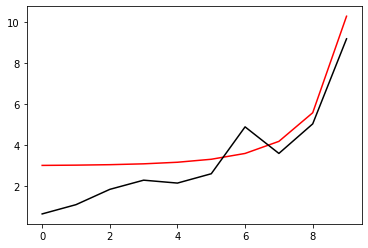

8700 89.79307829493617
[0.6459705  1.09715157 1.84356209 2.29311283 2.15300869 2.60785315
 4.89503227 3.59898733 5.04234863 9.19540158]


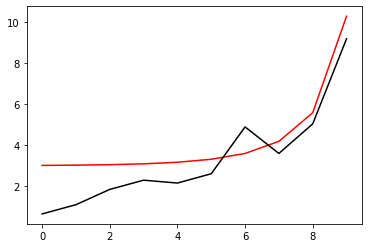

8800 89.79301473175899
[0.64634015 1.09676589 1.84254937 2.29311957 2.15462803 2.60875111
 4.89381731 3.59872258 5.04208605 9.19536171]


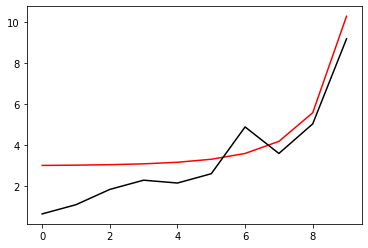

8900 89.79295144876968
[0.64670845 1.09638197 1.84154017 2.29312456 2.15624327 2.60964847
 4.89260361 3.59845864 5.04182485 9.19532184]


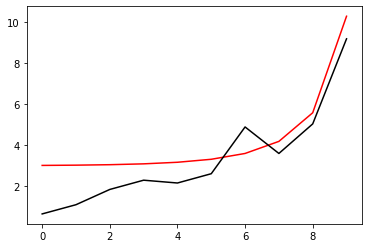

9000 89.79288844425412
[0.64707541 1.09599978 1.84053448 2.29312783 2.15785441 2.61054523
 4.89139114 3.59819552 5.04156501 9.19528197]


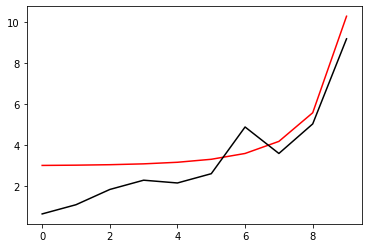

9100 89.79282571651156
[0.64744103 1.09561932 1.83953228 2.29312939 2.15946148 2.61144139
 4.89017993 3.59793321 5.04130655 9.19524209]


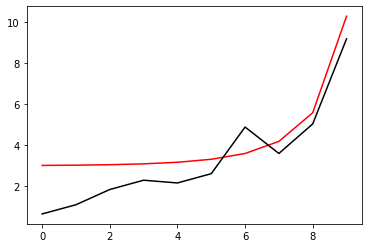

9200 89.79276326385492
[0.64780532 1.09524057 1.83853356 2.29312926 2.16106447 2.61233695
 4.88896995 3.59767171 5.04104945 9.19520221]


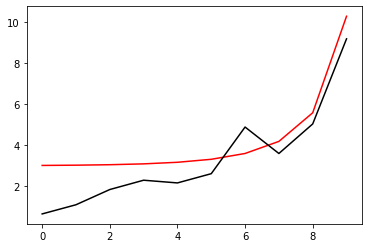

9300 89.79270108461033
[0.64816829 1.09486353 1.8375383  2.29312745 2.1626634  2.61323191
 4.88776121 3.59741101 5.0407937  9.19516233]


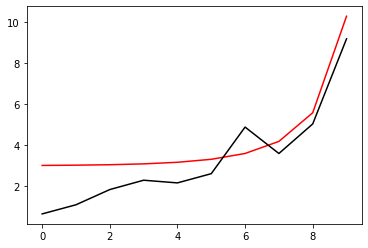

9400 89.79263917711745
[0.64852994 1.09448819 1.83654648 2.29312397 2.16425828 2.61412626
 4.88655371 3.59715112 5.0405393  9.19512245]


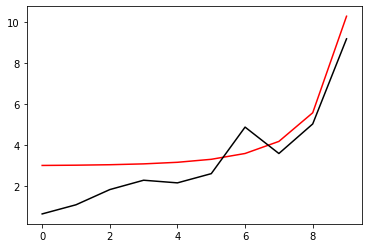

9500 89.79257753972881
[0.64889029 1.09411453 1.8355581  2.29311885 2.16584912 2.61502001
 4.88534744 3.59689202 5.04028625 9.19508256]


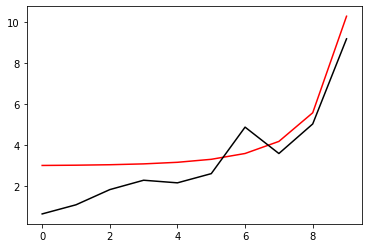

9600 89.79251617081009
[0.64924933 1.09374254 1.83457313 2.29311209 2.16743594 2.61591315
 4.8841424  3.59663372 5.04003454 9.19504268]


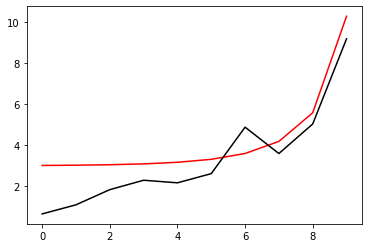

9700 89.79245506873977
[0.64960707 1.09337221 1.83359157 2.29310371 2.16901873 2.6168057
 4.8829386  3.59637621 5.03978417 9.19500279]


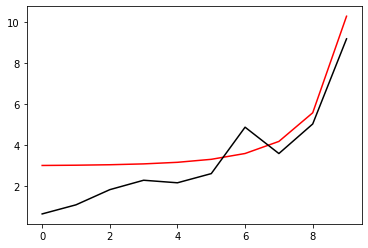

9800 89.79239423190906
[0.64996353 1.09300354 1.83261339 2.29309372 2.17059752 2.61769764
 4.88173603 3.59611948 5.03953513 9.1949629 ]


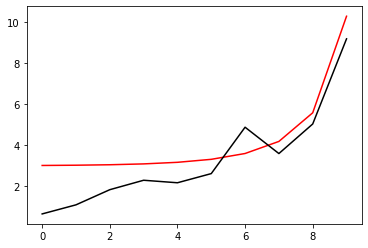

9900 89.79233365872193
[0.6503187  1.09263652 1.83163859 2.29308214 2.17217232 2.61858897
 4.88053468 3.59586354 5.03928742 9.194923  ]


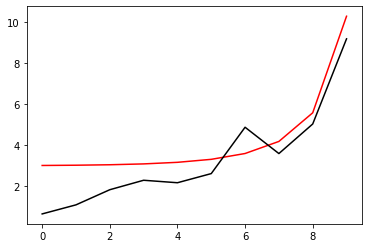

10000 89.7922733475946
[0.65067259 1.09227113 1.83066714 2.29306898 2.17374313 2.6194797
 4.87933455 3.59560838 5.03904103 9.19488311]


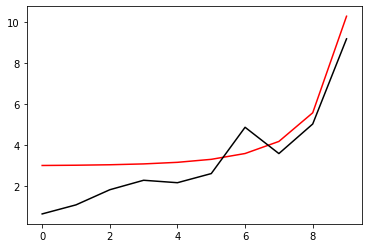

In [18]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.79221329695598
[0.65102521 1.09190736 1.82969904 2.29305426 2.17530996 2.62036982
 4.87813565 3.595354   5.03879596 9.19484321]


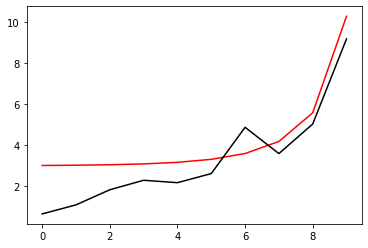

200 89.79215350524692
[0.65137656 1.09154521 1.82873427 2.29303799 2.17687284 2.62125933
 4.87693797 3.59510039 5.03855219 9.19480331]


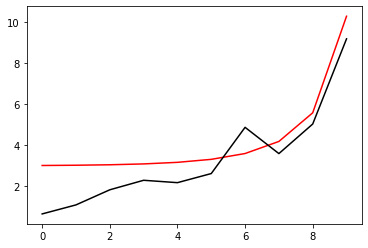

300 89.79209397092067
[0.65172665 1.09118466 1.82777281 2.29302019 2.17843176 2.62214824
 4.87574151 3.59484755 5.03830974 9.19476341]


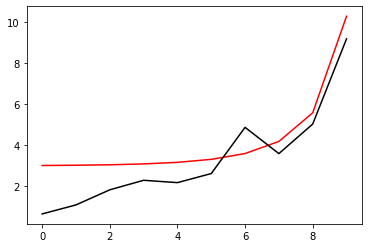

400 89.79203469244237
[0.65207549 1.0908257  1.82681465 2.29300086 2.17998674 2.62303654
 4.87454626 3.59459548 5.03806859 9.19472351]


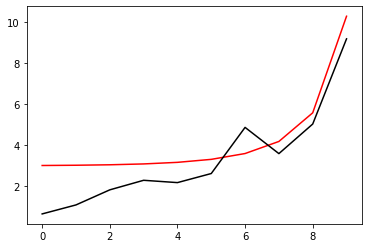

500 89.79197566828913
[0.65242308 1.09046833 1.82585978 2.29298002 2.18153778 2.62392423
 4.87335223 3.59434417 5.03782874 9.1946836 ]


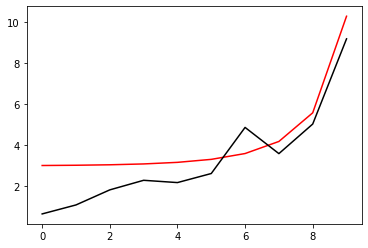

600 89.79191689694984
[0.65276944 1.09011254 1.82490819 2.29295769 2.18308491 2.62481131
 4.87215941 3.59409362 5.03759018 9.1946437 ]


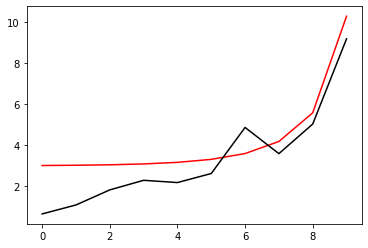

700 89.79185837692505
[0.65311455 1.08975831 1.82395985 2.29293388 2.18462813 2.62569779
 4.8709678  3.59384383 5.03735291 9.19460379]


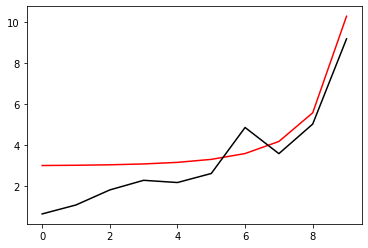

800 89.79180010672694
[0.65345844 1.08940564 1.82301475 2.2929086  2.18616744 2.62658365
 4.8697774  3.5935948  5.03711693 9.19456388]


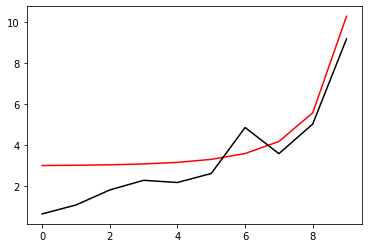

900 89.79174208487906
[0.6538011  1.08905451 1.82207289 2.29288186 2.18770287 2.62746891
 4.86858821 3.59334652 5.03688222 9.19452396]


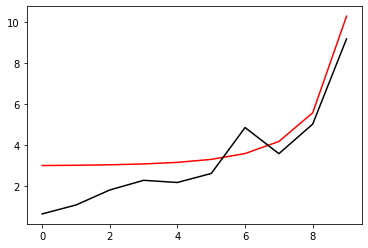

1000 89.79168430991646
[0.65414254 1.08870493 1.82113424 2.29285368 2.18923442 2.62835355
 4.86740022 3.59309898 5.03664879 9.19448405]


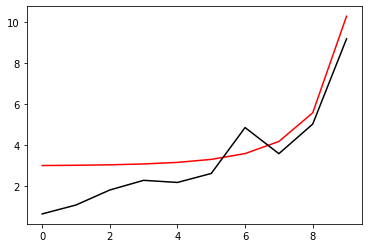

1100 89.79162678038527
[0.65448278 1.08835687 1.82019879 2.29282408 2.19076209 2.62923759
 4.86621344 3.59285219 5.03641663 9.19444413]


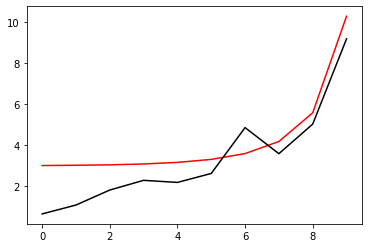

1200 89.79156949484297
[0.6548218  1.08801034 1.81926654 2.29279305 2.19228592 2.63012101
 4.86502785 3.59260614 5.03618574 9.19440422]


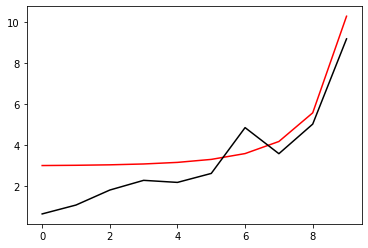

1300 89.7915124518578
[0.65515963 1.08766531 1.81833746 2.29276063 2.19380589 2.63100382
 4.86384347 3.59236082 5.03595611 9.1943643 ]


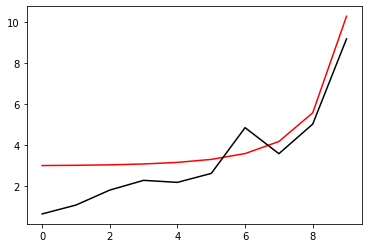

1400 89.7914556500092
[0.65549626 1.08732179 1.81741154 2.29272681 2.19532203 2.63188602
 4.86266028 3.59211625 5.03572773 9.19432437]


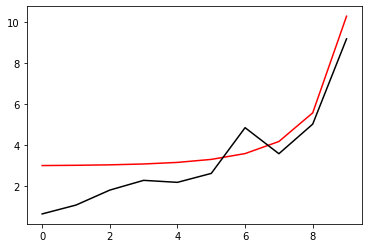

1500 89.79139908788721
[0.6558317  1.08697976 1.81648876 2.29269162 2.19683434 2.6327676
 4.86147828 3.5918724  5.03550061 9.19428445]


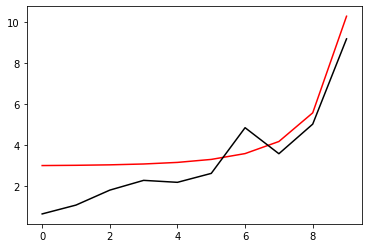

1600 89.79134276409289
[0.65616596 1.08663921 1.81556913 2.29265506 2.19834283 2.63364857
 4.86029748 3.59162928 5.03527474 9.19424453]


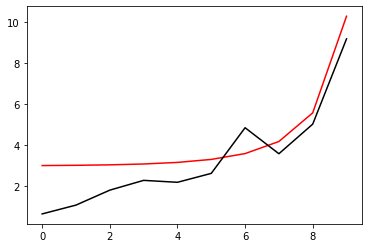

1700 89.79128667723754
[0.65649904 1.08630015 1.81465261 2.29261715 2.19984751 2.63452893
 4.85911787 3.59138689 5.03505011 9.1942046 ]


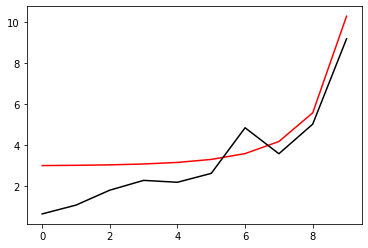

1800 89.79123082594325
[0.65683095 1.08596254 1.81373921 2.2925779  2.2013484  2.63540867
 4.85793945 3.59114522 5.03482671 9.19416467]


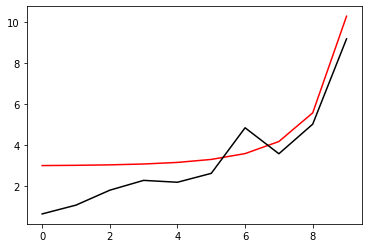

1900 89.79117520884259
[0.65716169 1.0856264  1.81282889 2.29253732 2.20284551 2.6362878
 4.85676222 3.59090428 5.03460456 9.19412474]


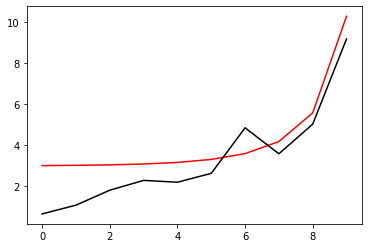

2000 89.79111982457823
[0.65749127 1.0852917  1.81192166 2.29249542 2.20433884 2.63716631
 4.85558618 3.59066404 5.03438363 9.19408481]


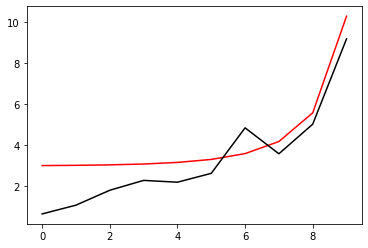

2100 89.79106467180327
[0.65781969 1.08495845 1.8110175  2.29245222 2.2058284  2.63804421
 4.85441131 3.59042452 5.03416393 9.19404487]


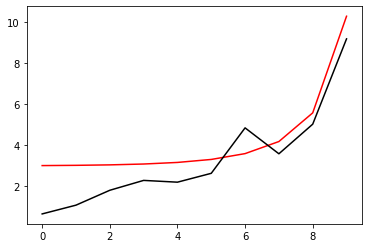

2200 89.7910097491808
[0.65814697 1.08462663 1.81011639 2.29240773 2.20731421 2.63892149
 4.85323763 3.59018572 5.03394545 9.19400494]


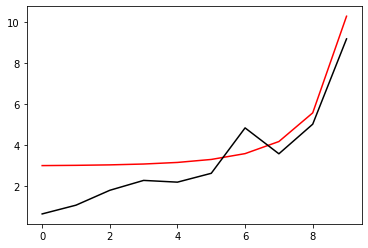

2300 89.790955055384
[0.65847309 1.08429624 1.80921833 2.29236196 2.20879627 2.63979815
 4.85206513 3.58994761 5.03372819 9.193965  ]


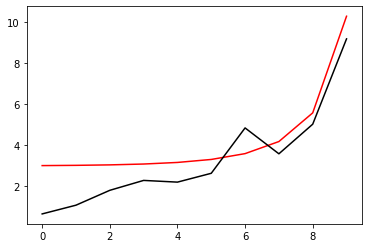

2400 89.7909005890962
[0.65879808 1.08396726 1.80832329 2.29231493 2.2102746  2.6406742
 4.85089381 3.58971022 5.03351214 9.19392506]


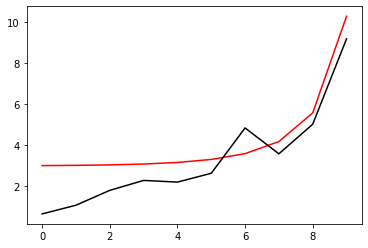

2500 89.79084634901032
[0.65912194 1.08363968 1.80743127 2.29226664 2.2117492  2.64154962
 4.84972366 3.58947352 5.0332973  9.19388512]


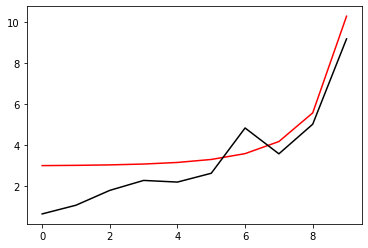

2600 89.79079233382905
[0.65944466 1.08331351 1.80654225 2.2922171  2.21322009 2.64242443
 4.84855469 3.58923753 5.03308367 9.19384518]


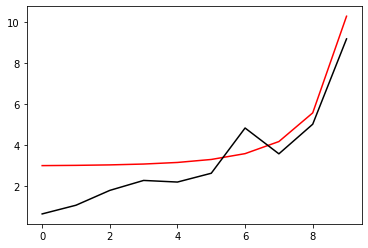

2700 89.79073854226505
[0.65976627 1.08298873 1.80565623 2.29216633 2.21468727 2.64329862
 4.84738689 3.58900222 5.03287124 9.19380523]


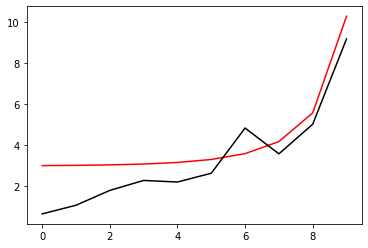

2800 89.79068497304016
[0.66008675 1.08266534 1.80477318 2.29211434 2.21615076 2.6441722
 4.84622026 3.58876762 5.03266    9.19376529]


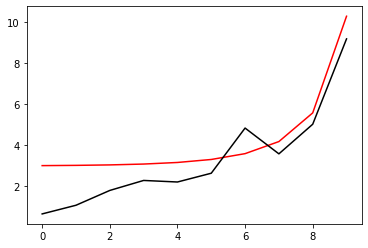

2900 89.79063162488607
[0.66040612 1.08234332 1.8038931  2.29206114 2.21761056 2.64504515
 4.8450548  3.5885337  5.03244995 9.19372534]


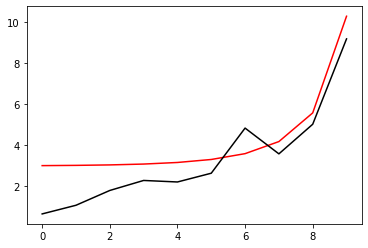

3000 89.7905784965438
[0.66072438 1.08202266 1.80301597 2.29200674 2.21906669 2.64591748
 4.8438905  3.58830046 5.03224109 9.19368539]


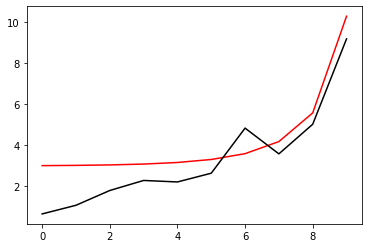

3100 89.79052558676345
[0.66104154 1.08170337 1.80214178 2.29195116 2.22051915 2.64678919
 4.84272737 3.58806792 5.03203342 9.19364544]


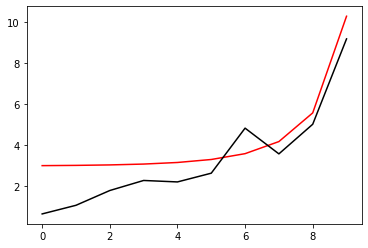

3200 89.79047289430467
[0.6613576  1.08138543 1.80127052 2.2918944  2.22196795 2.64766028
 4.84156541 3.58783605 5.03182692 9.19360549]


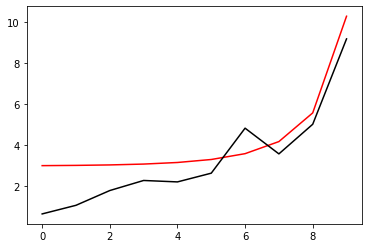

3300 89.79042041793625
[0.66167257 1.08106883 1.80040217 2.29183647 2.22341311 2.64853075
 4.8404046  3.58760486 5.0316216  9.19356553]


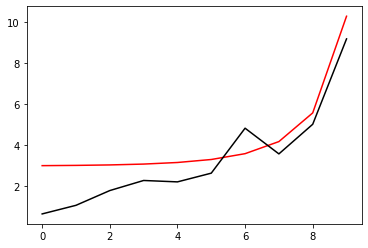

3400 89.79036815643579
[0.66198645 1.08075357 1.79953673 2.29177739 2.22485464 2.6494006
 4.83924496 3.58737435 5.03141745 9.19352558]


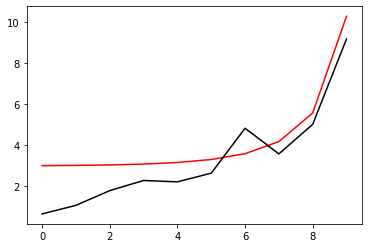

3500 89.79031610859005
[0.66229925 1.08043964 1.79867418 2.29171717 2.22629254 2.65026982
 4.83808647 3.58714451 5.03121447 9.19348562]


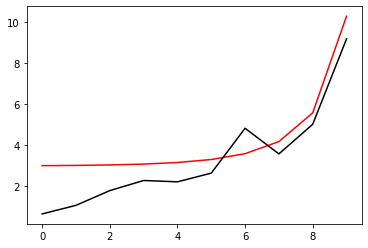

3600 89.79026427319482
[0.66261097 1.08012703 1.79781451 2.29165582 2.22772682 2.65113842
 4.83692914 3.58691533 5.03101265 9.19344566]


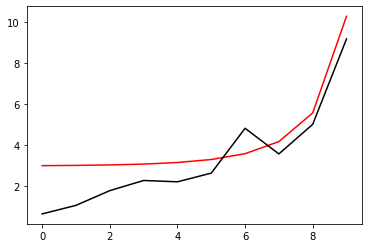

3700 89.79021264905452
[0.66292162 1.07981573 1.7969577  2.29159335 2.22915749 2.6520064
 4.83577297 3.58668683 5.030812   9.1934057 ]


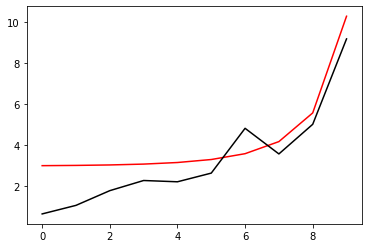

3800 89.79016123498243
[0.6632312  1.07950574 1.79610375 2.29152976 2.23058457 2.65287375
 4.83461794 3.58645899 5.03061249 9.19336574]


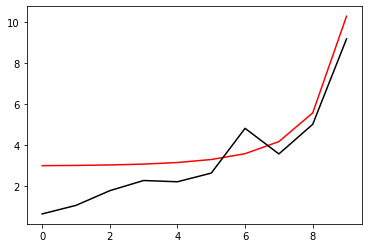

3900 89.79011002980042
[0.66353972 1.07919705 1.79525264 2.29146508 2.23200806 2.65374048
 4.83346407 3.58623181 5.03041414 9.19332578]


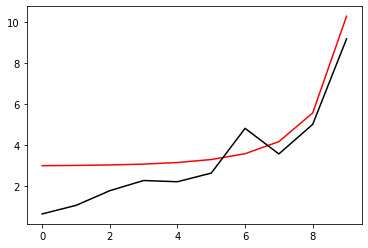

4000 89.79005903233893
[0.66384717 1.07888965 1.79440436 2.2913993  2.23342798 2.65460659
 4.83231135 3.58600529 5.03021693 9.19328581]


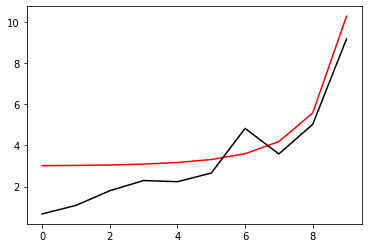

4100 89.79000824143704
[0.66415358 1.07858353 1.79355889 2.29133245 2.23484433 2.65547207
 4.83115977 3.58577943 5.03002087 9.19324585]


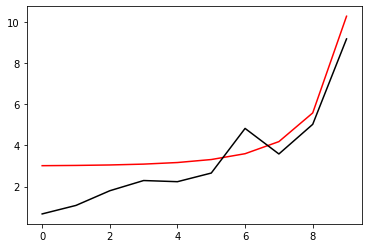

4200 89.7899576559422
[0.66445894 1.07827869 1.79271624 2.29126453 2.23625711 2.65633692
 4.83000934 3.58555422 5.02982595 9.19320588]


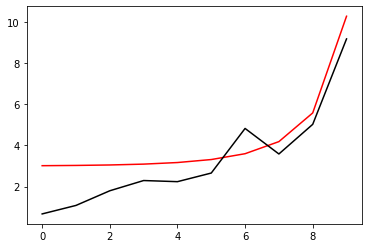

4300 89.78990727471022
[0.66476325 1.07797512 1.79187638 2.29119555 2.23766635 2.65720115
 4.82886006 3.58532966 5.02963216 9.19316591]


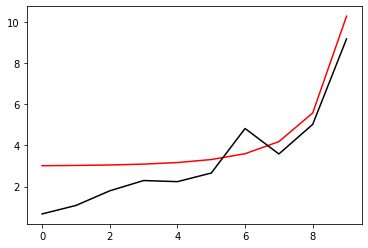

4400 89.78985709660515
[0.66506653 1.07767281 1.7910393  2.29112553 2.23907206 2.65806475
 4.82771191 3.58510574 5.0294395  9.19312594]


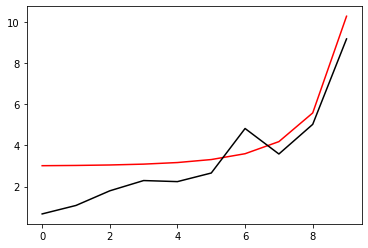

4500 89.7898071204993
[0.66536877 1.07737176 1.79020499 2.29105447 2.24047423 2.65892773
 4.82656491 3.58488248 5.02924798 9.19308597]


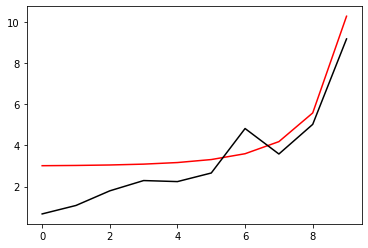

4600 89.78975734527312
[0.66566998 1.07707196 1.78937345 2.29098237 2.24187288 2.65979008
 4.82541904 3.58465985 5.02905757 9.19304599]


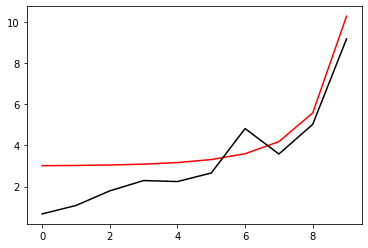

4700 89.78970776981518
[0.66597016 1.0767734  1.78854465 2.29090927 2.24326802 2.66065179
 4.82427431 3.58443786 5.02886828 9.19300602]


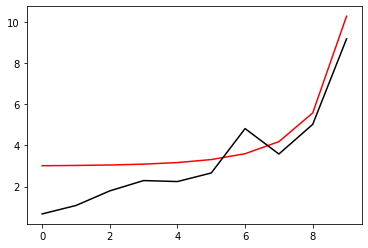

4800 89.78965839302178
[0.66626933 1.07647607 1.78771859 2.29083515 2.24465966 2.66151289
 4.82313072 3.58421652 5.02868012 9.19296604]


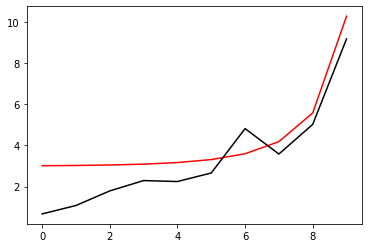

4900 89.78960921379759
[0.66656748 1.07617997 1.78689525 2.29076004 2.24604781 2.66237335
 4.82198826 3.5839958  5.02849306 9.19292607]


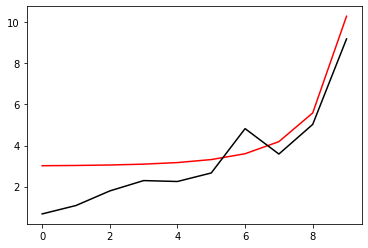

5000 89.78956023105474
[0.66686462 1.07588508 1.78607462 2.29068394 2.24743248 2.66323318
 4.82084693 3.58377572 5.02830711 9.19288609]


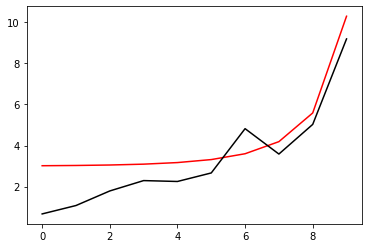

5100 89.78951144371325
[0.66716075 1.07559142 1.7852567  2.29060686 2.24881367 2.66409239
 4.81970673 3.58355627 5.02812227 9.19284611]


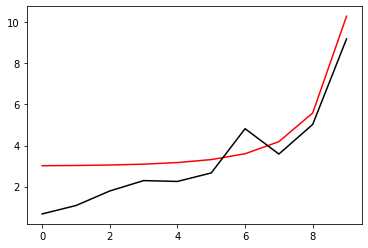

5200 89.78946285070097
[0.66745589 1.07529896 1.78444147 2.29052881 2.2501914  2.66495096
 4.81856766 3.58333744 5.02793852 9.19280612]


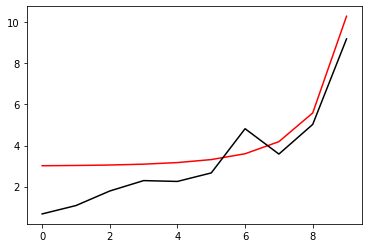

5300 89.78941445095322
[0.66775002 1.0750077  1.78362892 2.29044981 2.25156568 2.6658089
 4.81742971 3.58311924 5.02775588 9.19276614]


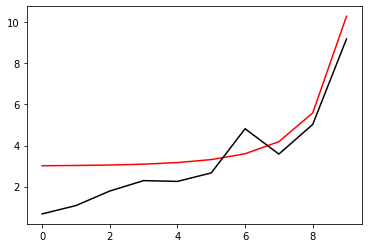

5400 89.78936624341301
[0.66804316 1.07471763 1.78281904 2.29036985 2.25293651 2.66666621
 4.81629289 3.58290166 5.02757432 9.19272615]


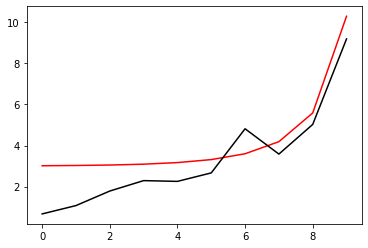

5500 89.78931822703086
[0.66833532 1.07442875 1.78201181 2.29028895 2.25430391 2.66752289
 4.8151572  3.5826847  5.02739386 9.19268617]


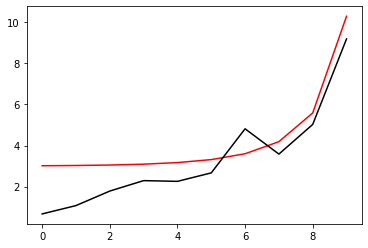

5600 89.78927040076472
[0.66862649 1.07414105 1.78120723 2.29020713 2.25566788 2.66837894
 4.81402262 3.58246835 5.02721448 9.19264618]


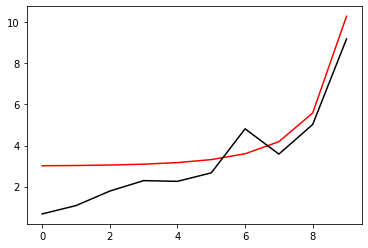

5700 89.78922276357974
[0.66891667 1.07385452 1.78040529 2.29012438 2.25702843 2.66923436
 4.81288917 3.58225262 5.02703619 9.19260619]


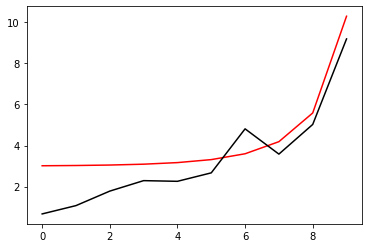

5800 89.78917531444876
[0.66920589 1.07356916 1.77960597 2.29004072 2.25838558 2.67008915
 4.81175683 3.5820375  5.02685897 9.1925662 ]


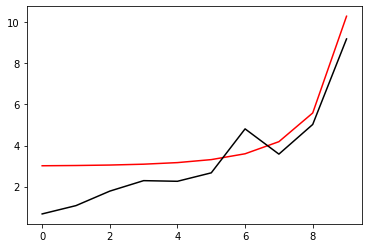

5900 89.78912805235151
[0.66949413 1.07328497 1.77880926 2.28995616 2.25973933 2.6709433
 4.81062561 3.58182299 5.02668283 9.19252621]


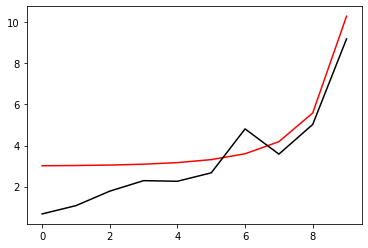

6000 89.78908097627514
[0.66978141 1.07300192 1.77801516 2.28987071 2.26108969 2.67179681
 4.8094955  3.58160908 5.02650776 9.19248622]


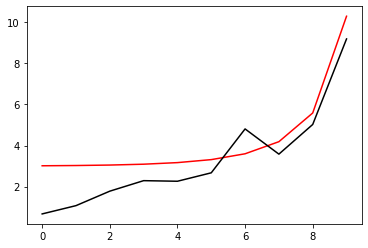

6100 89.78903408521373
[0.67006773 1.07272003 1.77722364 2.28978437 2.26243667 2.6726497
 4.80836651 3.58139578 5.02633376 9.19244622]


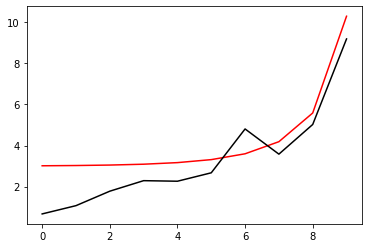

6200 89.7889873781686
[0.67035308 1.07243927 1.77643471 2.28969715 2.26378028 2.67350195
 4.80723863 3.58118308 5.02616082 9.19240623]


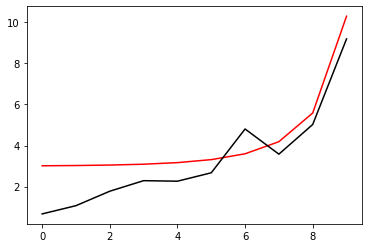

6300 89.78894085414801
[0.67063749 1.07215965 1.77564835 2.28960907 2.26512052 2.67435356
 4.80611186 3.58097098 5.02598894 9.19236623]


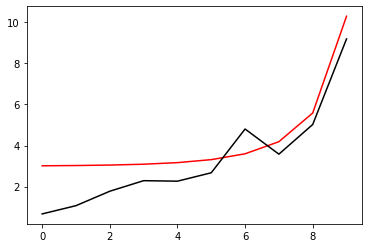

6400 89.7888945121671
[0.67092094 1.07188116 1.77486455 2.28952013 2.26645741 2.67520454
 4.80498619 3.58075948 5.02581812 9.19232623]


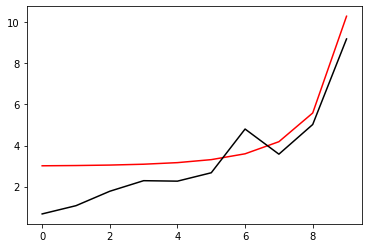

6500 89.78884835124785
[0.67120345 1.0716038  1.7740833  2.28943034 2.26779096 2.67605489
 4.80386164 3.58054856 5.02564836 9.19228624]


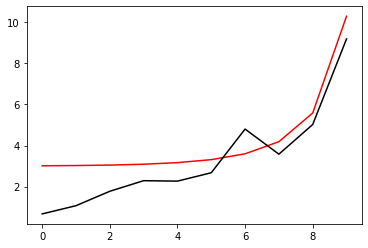

6600 89.7888023704193
[0.67148502 1.07132755 1.77330458 2.2893397  2.26912118 2.6769046
 4.80273819 3.58033825 5.02547964 9.19224623]


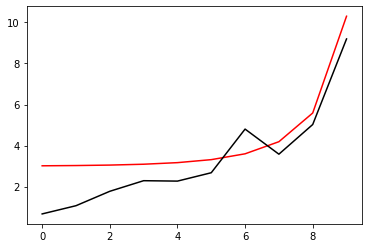

6700 89.78875656871693
[0.67176565 1.07105241 1.77252839 2.28924824 2.27044807 2.67775367
 4.80161584 3.58012852 5.02531197 9.19220623]


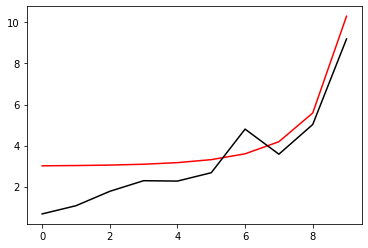

6800 89.78871094518317
[0.67204535 1.07077837 1.77175472 2.28915596 2.27177164 2.67860211
 4.80049459 3.57991937 5.02514534 9.19216623]


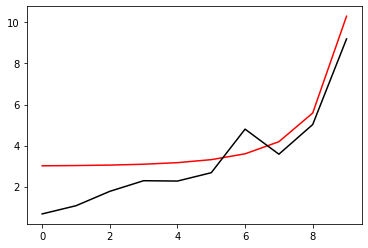

6900 89.78866549886702
[0.67232411 1.07050544 1.77098356 2.28906286 2.2730919  2.67944991
 4.79937444 3.57971082 5.02497975 9.19212623]


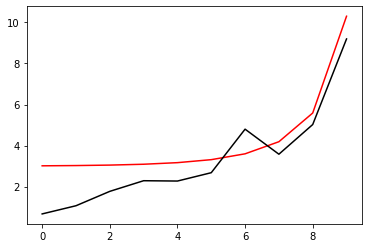

7000 89.78862022882397
[0.67260196 1.0702336  1.77021489 2.28896895 2.27440887 2.68029707
 4.79825539 3.57950284 5.0248152  9.19208622]


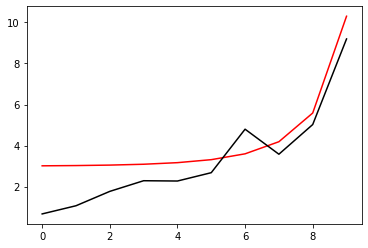

7100 89.78857513411616
[0.67287888 1.06996284 1.76944871 2.28887424 2.27572255 2.68114359
 4.79713744 3.57929544 5.02465168 9.19204622]


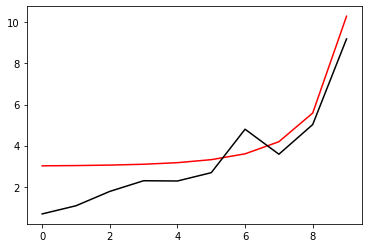

7200 89.78853021381215
[0.67315489 1.06969317 1.76868501 2.28877875 2.27703294 2.68198948
 4.79602058 3.57908862 5.02448919 9.19200621]


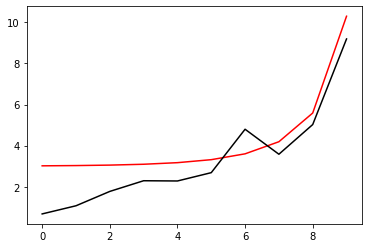

7300 89.78848546698696
[0.67342999 1.06942457 1.76792377 2.28868247 2.27834006 2.68283472
 4.79490482 3.57888238 5.02432773 9.1919662 ]


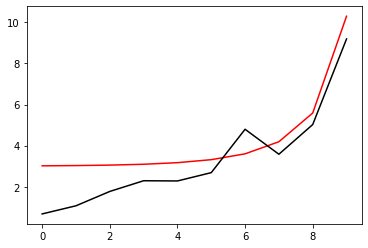

7400 89.78844089272185
[0.67370417 1.06915704 1.76716499 2.28858542 2.27964392 2.68367933
 4.79379015 3.57867671 5.02416728 9.19192619]


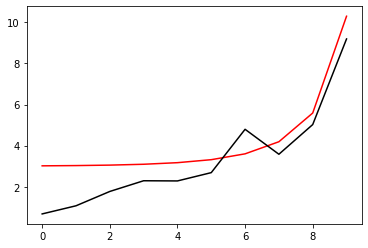

7500 89.78839649010459
[0.67397746 1.06889057 1.76640865 2.28848761 2.28094453 2.6845233
 4.79267657 3.57847161 5.02400786 9.19188618]


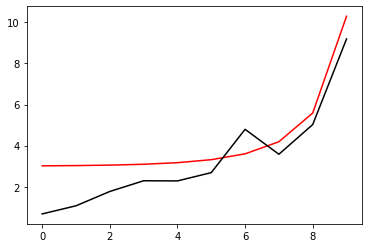

7600 89.78835225822903
[0.67424984 1.06862516 1.76565475 2.28838904 2.28224189 2.68536663
 4.79156407 3.57826707 5.02384945 9.19184617]


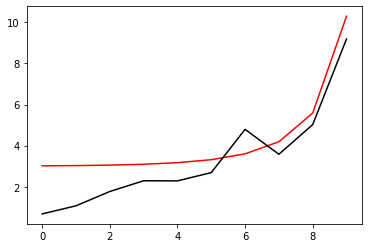

7700 89.78830819619529
[0.67452132 1.0683608  1.76490327 2.28828972 2.28353601 2.68620931
 4.79045267 3.57806311 5.02369206 9.19180615]


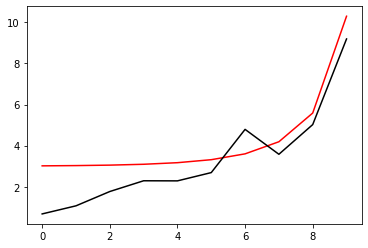

7800 89.7882643031097
[0.67479191 1.06809749 1.76415421 2.28818965 2.2848269  2.68705136
 4.78934235 3.5778597  5.02353567 9.19176614]


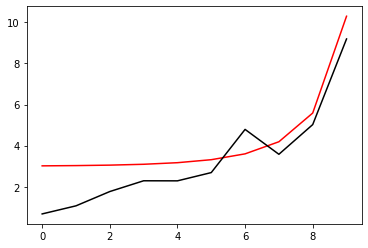

7900 89.78822057808456
[0.67506162 1.06783522 1.76340756 2.28808886 2.28611458 2.68789277
 4.78823311 3.57765686 5.02338029 9.19172612]


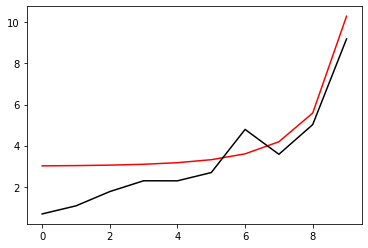

8000 89.78817702023831
[0.67533044 1.06757399 1.7626633  2.28798734 2.28739904 2.68873353
 4.78712496 3.57745458 5.02322591 9.19168611]


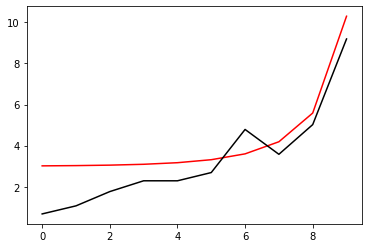

8100 89.78813362869536
[0.67559837 1.06731378 1.76192143 2.2878851  2.2886803  2.68957366
 4.78601789 3.57725285 5.02307253 9.19164609]


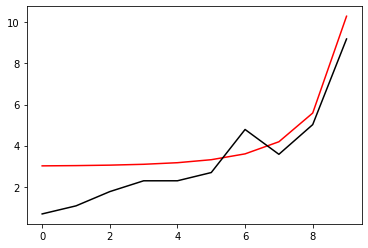

8200 89.78809040258598
[0.67586543 1.0670546  1.76118193 2.28778215 2.28995837 2.69041314
 4.78491189 3.57705168 5.02292014 9.19160607]


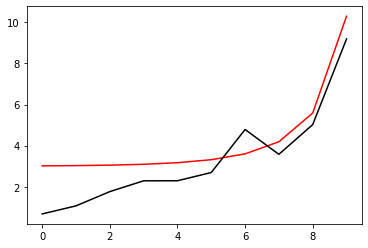

8300 89.7880473410466
[0.67613162 1.06679644 1.7604448  2.2876785  2.29123326 2.69125198
 4.78380698 3.57685106 5.02276875 9.19156605]


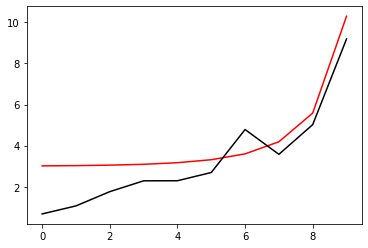

8400 89.78800444321908
[0.67639694 1.06653929 1.75971003 2.28757416 2.29250496 2.69209017
 4.78270314 3.57665099 5.02261835 9.19152603]


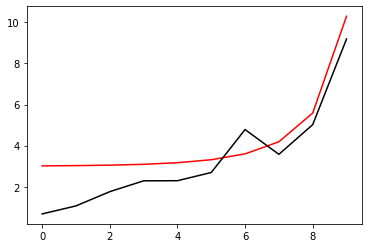

8500 89.78796170825142
[0.67666139 1.06628315 1.7589776  2.28746913 2.2937735  2.69292772
 4.78160037 3.57645146 5.02246893 9.19148601]


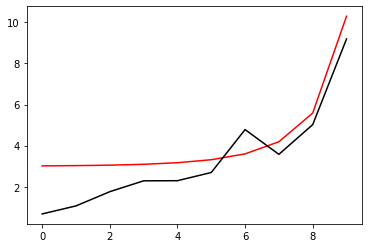

8600 89.78791913529727
[0.67692498 1.06602801 1.75824751 2.28736342 2.29503888 2.69376463
 4.78049868 3.57625249 5.0223205  9.19144598]


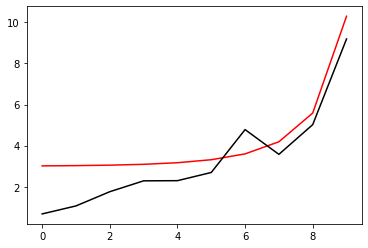

8700 89.78787672351591
[0.6771877  1.06577387 1.75751975 2.28725703 2.29630111 2.6946009
 4.77939806 3.57605405 5.02217304 9.19140596]


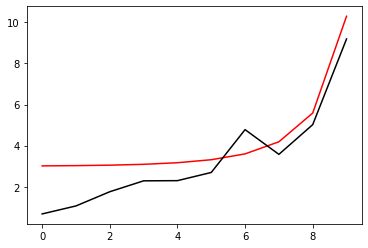

8800 89.78783447207236
[0.67744958 1.06552072 1.75679431 2.28714999 2.2975602  2.69543652
 4.77829851 3.57585616 5.02202656 9.19136593]


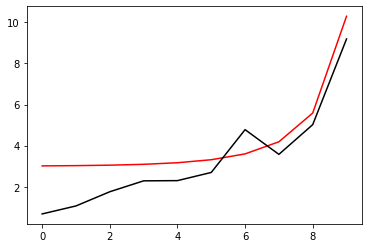

8900 89.78779238013716
[0.6777106  1.06526856 1.75607117 2.28704228 2.29881615 2.6962715
 4.77720003 3.57565881 5.02188105 9.19132591]


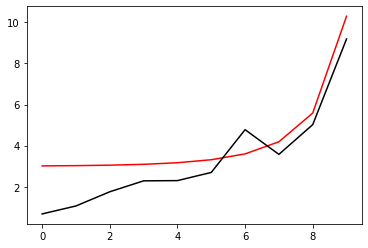

9000 89.78775044688645
[0.67797078 1.06501738 1.75535034 2.28693392 2.30006898 2.69710583
 4.77610262 3.57546199 5.02173652 9.19128588]


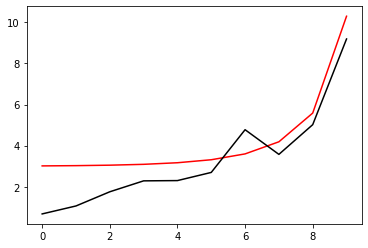

9100 89.78770867150193
[0.67823011 1.06476718 1.7546318  2.28682493 2.3013187  2.69793951
 4.77500627 3.57526571 5.02159295 9.19124585]


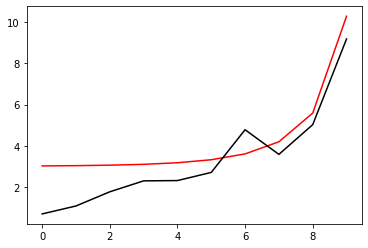

9200 89.78766705317061
[0.6784886  1.06451795 1.75391554 2.28671529 2.3025653  2.69877256
 4.77391098 3.57506996 5.02145034 9.19120582]


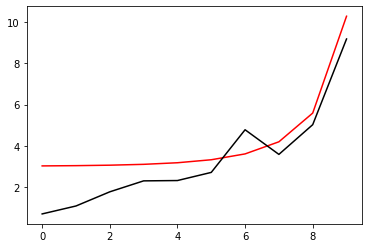

9300 89.78762559108512
[0.67874626 1.06426968 1.75320155 2.28660503 2.30380881 2.69960495
 4.77281676 3.57487474 5.0213087  9.19116579]


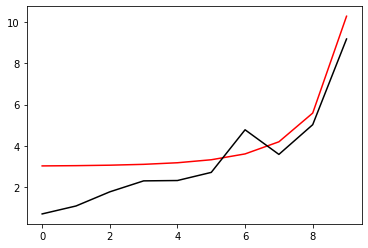

9400 89.78758428444337
[0.67900308 1.06402238 1.75248982 2.28649414 2.30504922 2.7004367
 4.7717236  3.57468005 5.02116801 9.19112576]


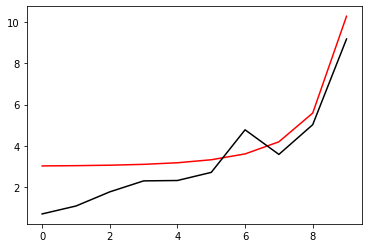

9500 89.78754313244852
[0.67925907 1.06377603 1.75178035 2.28638264 2.30628655 2.7012678
 4.7706315  3.57448589 5.02102828 9.19108573]


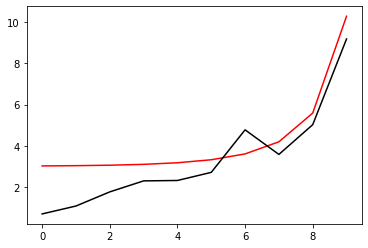

9600 89.7875021343092
[0.67951423 1.06353063 1.75107312 2.28627054 2.30752081 2.70209825
 4.76954045 3.57429225 5.02088949 9.1910457 ]


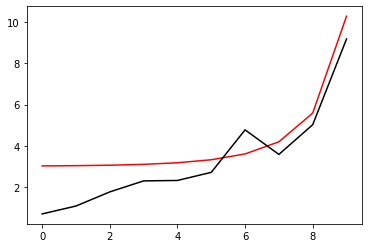

9700 89.78746128923905
[0.67976858 1.06328618 1.75036812 2.28615783 2.308752   2.70292806
 4.76845046 3.57409913 5.02075166 9.19100566]


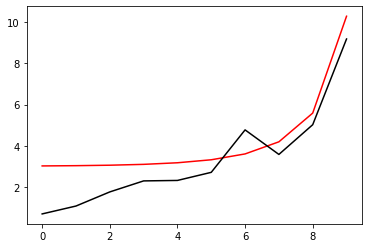

9800 89.78742059645718
[0.6800221  1.06304266 1.74966536 2.28604453 2.30998013 2.70375722
 4.76736153 3.57390653 5.02061477 9.19096563]


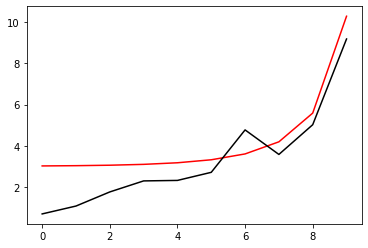

9900 89.78738005518757
[0.68027481 1.06280009 1.74896481 2.28593064 2.31120521 2.70458573
 4.76627365 3.57371445 5.02047882 9.19092559]


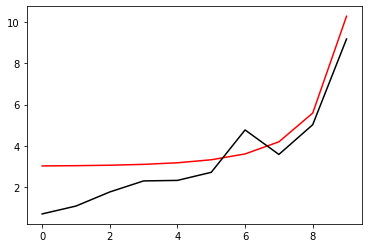

10000 89.7873396646596
[0.6805267  1.06255845 1.74826646 2.28581617 2.31242725 2.70541359
 4.76518682 3.57352289 5.02034381 9.19088556]


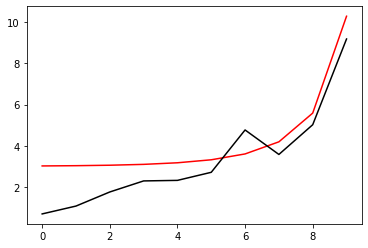

In [19]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.78729942410746
[0.68077779 1.06231773 1.74757032 2.28570113 2.31364626 2.70624081
 4.76410104 3.57333184 5.02020974 9.19084552]


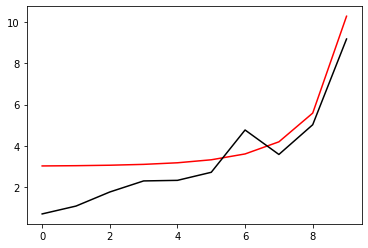

200 89.78725933277065
[0.68102807 1.06207793 1.74687637 2.28558552 2.31486224 2.70706737
 4.76301631 3.5731413  5.0200766  9.19080548]


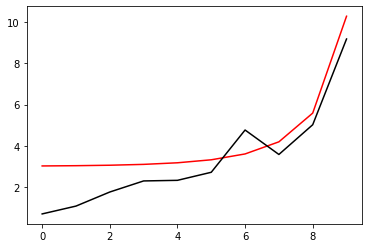

300 89.78721938989338
[0.68127755 1.06183906 1.7461846  2.28546934 2.31607521 2.70789329
 4.76193263 3.57295127 5.01994439 9.19076544]


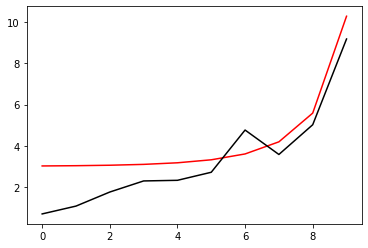

400 89.78717959472489
[0.68152623 1.06160109 1.745495   2.28535262 2.31728516 2.70871855
 4.76085    3.57276175 5.0198131  9.1907254 ]


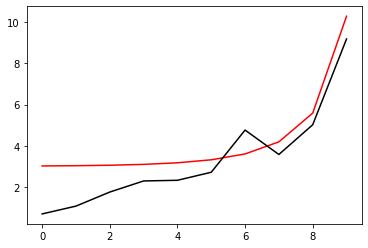

500 89.78713994651956
[0.68177412 1.06136403 1.74480757 2.28523535 2.31849212 2.70954317
 4.75976841 3.57257273 5.01968274 9.19068536]


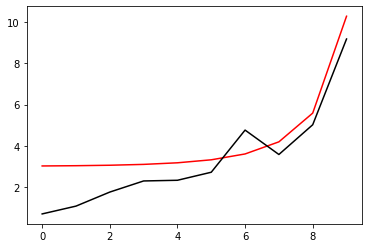

600 89.78710044453629
[0.68202121 1.06112788 1.74412229 2.28511753 2.31969608 2.71036713
 4.75868786 3.57238422 5.01955331 9.19064532]


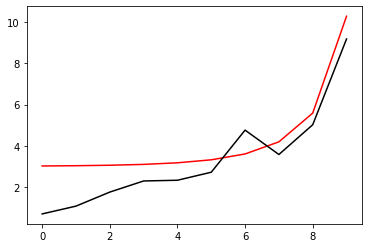

700 89.787061088039
[0.68226751 1.06089262 1.74343916 2.28499918 2.32089706 2.71119045
 4.75760835 3.57219621 5.01942479 9.19060527]


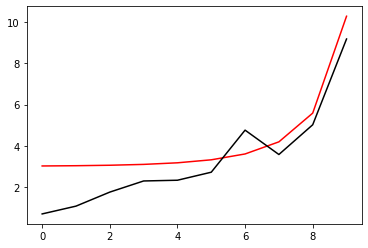

800 89.78702187629652
[0.68251303 1.06065825 1.74275817 2.28488031 2.32209506 2.71201311
 4.75652989 3.5720087  5.01929718 9.19056523]


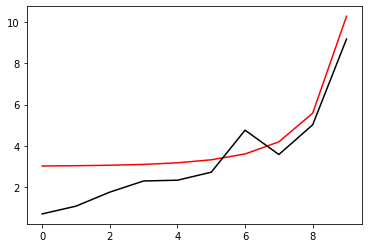

900 89.78698280858204
[0.68275777 1.06042478 1.74207931 2.28476091 2.3232901  2.71283512
 4.75545246 3.57182169 5.01917049 9.19052518]


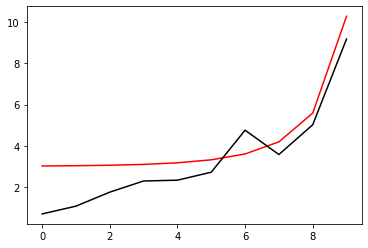

1000 89.78694388417388
[0.68300173 1.06019219 1.74140257 2.28464099 2.32448217 2.71365648
 4.75437607 3.57163518 5.0190447  9.19048514]


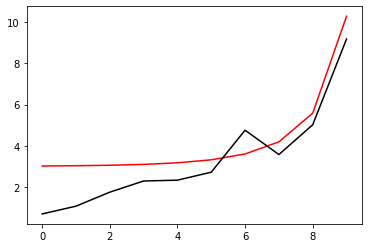

1100 89.7869051023549
[0.68324491 1.05996047 1.74072794 2.28452057 2.32567129 2.71447719
 4.75330071 3.57144915 5.01891983 9.19044509]


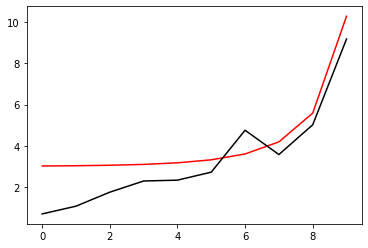

1200 89.78686646241245
[0.68348732 1.05972964 1.74005542 2.28439964 2.32685747 2.71529725
 4.75222639 3.57126362 5.01879585 9.19040505]


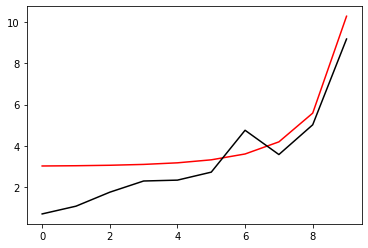

1300 89.78682796363869
[0.68372896 1.05949967 1.73938499 2.28427822 2.32804071 2.71611665
 4.75115311 3.57107858 5.01867278 9.190365  ]


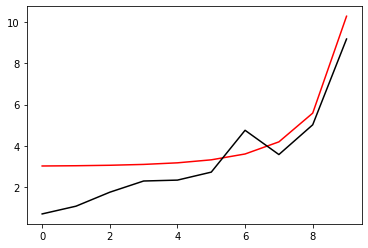

1400 89.78678960533017
[0.68396984 1.05927057 1.73871665 2.2841563  2.32922103 2.7169354
 4.75008085 3.57089403 5.0185506  9.19032495]


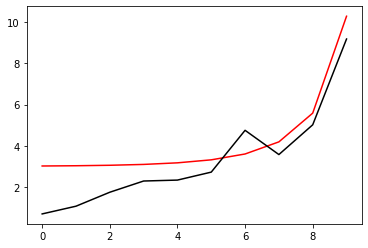

1500 89.78675138678818
[0.68420995 1.05904234 1.73805039 2.2840339  2.33039842 2.7177535
 4.74900963 3.57070996 5.01842932 9.1902849 ]


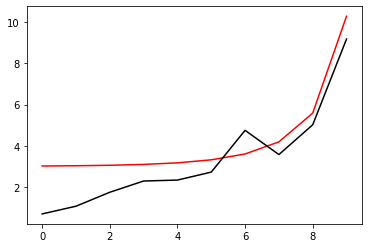

1600 89.78671330731824
[0.6844493  1.05881496 1.7373862  2.28391102 2.3315729  2.71857094
 4.74793943 3.57052638 5.01830893 9.19024485]


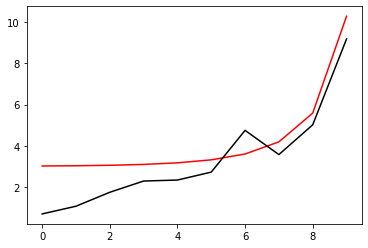

1700 89.78667536623048
[0.6846879  1.05858843 1.73672407 2.28378766 2.33274447 2.71938773
 4.74687026 3.57034328 5.01818943 9.1902048 ]


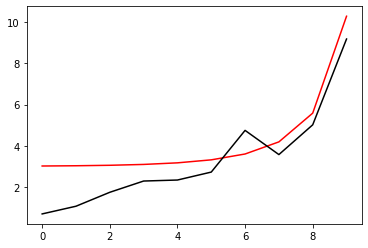

1800 89.78663756283947
[0.68492574 1.05836276 1.736064   2.28366384 2.33391315 2.72020387
 4.74580211 3.57016066 5.01807082 9.19016475]


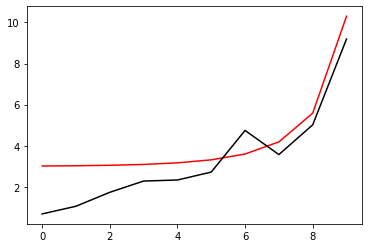

1900 89.78659989646418
[0.68516283 1.05813792 1.73540597 2.28353955 2.33507894 2.72101935
 4.74473499 3.56997852 5.01795309 9.19012469]


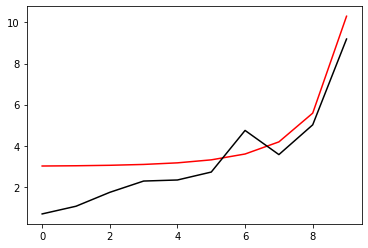

2000 89.78656236642776
[0.68539918 1.05791393 1.73474998 2.28341481 2.33624185 2.72183418
 4.7436689  3.56979686 5.01783624 9.19008464]


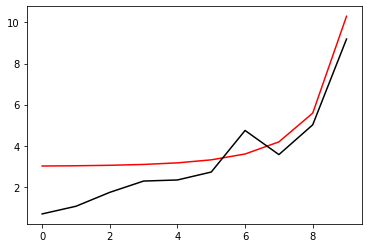

2100 89.78652497205779
[0.68563478 1.05769077 1.73409602 2.28328962 2.33740189 2.72264835
 4.74260382 3.56961567 5.01772027 9.19004459]


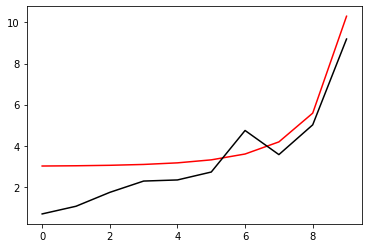

2200 89.78648771268622
[0.68586964 1.05746845 1.73344409 2.28316399 2.33855906 2.72346186
 4.74153977 3.56943495 5.01760518 9.19000453]


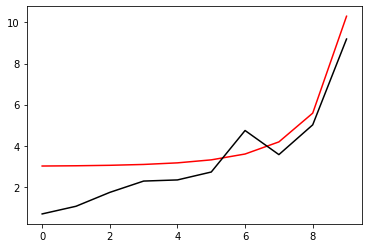

2300 89.78645058764916
[0.68610377 1.05724695 1.73279416 2.28303791 2.33971337 2.72427473
 4.74047673 3.56925471 5.01749096 9.18996448]


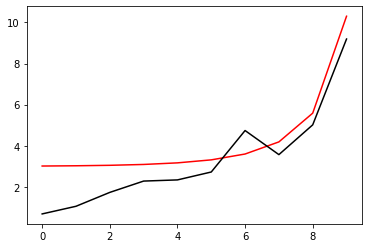

2400 89.78641359628692
[0.68633715 1.05702628 1.73214625 2.28291141 2.34086484 2.72508693
 4.73941471 3.56907493 5.0173776  9.18992442]


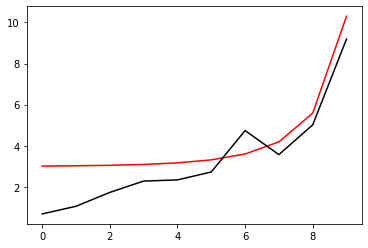

2500 89.78637673794397
[0.68656981 1.05680642 1.73150033 2.28278447 2.34201346 2.72589848
 4.73835371 3.56889562 5.01726512 9.18988436]


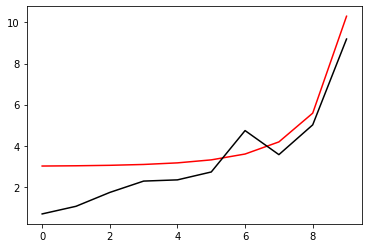

2600 89.78634001196892
[0.68680174 1.05658739 1.7308564  2.28265712 2.34315924 2.72670937
 4.73729372 3.56871678 5.0171535  9.18984431]


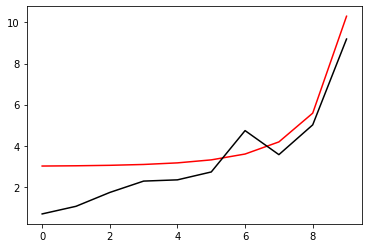

2700 89.78630341771468
[0.68703294 1.05636916 1.73021446 2.28252934 2.3443022  2.72751961
 4.73623474 3.5685384  5.01704274 9.18980425]


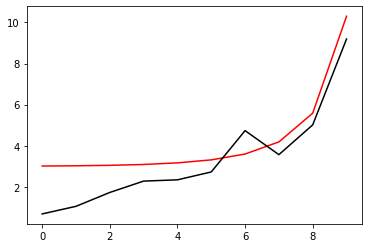

2800 89.78626695453796
[0.68726341 1.05615174 1.72957449 2.28240116 2.34544234 2.72832919
 4.73517678 3.56836048 5.01693284 9.18976419]


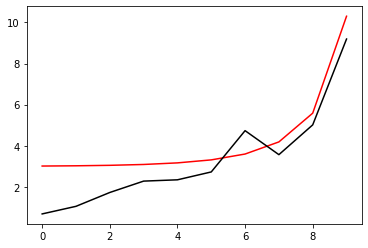

2900 89.78623062179979
[0.68749317 1.05593512 1.72893649 2.28227256 2.34657967 2.72913811
 4.73411982 3.56818302 5.01682379 9.18972413]


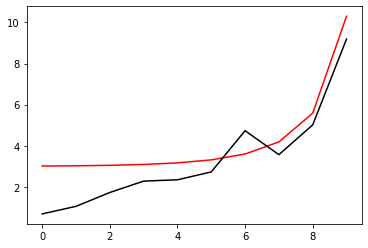

3000 89.78619441886502
[0.68772221 1.0557193  1.72830044 2.28214357 2.34771419 2.72994638
 4.73306388 3.56800603 5.0167156  9.18968407]


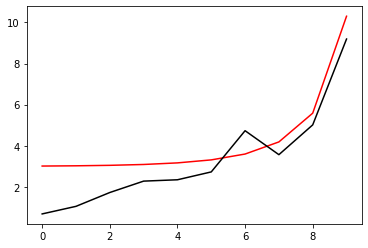

3100 89.78615834510259
[0.68795054 1.05550428 1.72766635 2.28201419 2.34884592 2.73075399
 4.73200894 3.56782948 5.01660826 9.18964401]


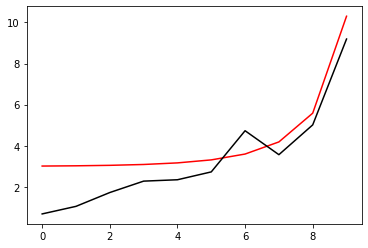

3200 89.7861223998854
[0.68817815 1.05529004 1.7270342  2.28188441 2.34997486 2.73156094
 4.73095501 3.5676534  5.01650177 9.18960395]


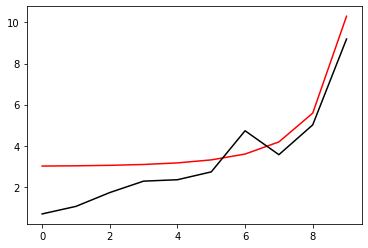

3300 89.78608658259019
[0.68840506 1.0550766  1.72640399 2.28175425 2.35110102 2.73236723
 4.72990208 3.56747776 5.01639613 9.18956389]


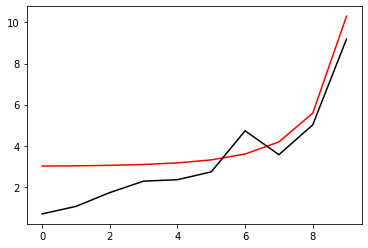

3400 89.78605089259771
[0.68863126 1.05486393 1.7257757  2.28162371 2.35222441 2.73317286
 4.72885016 3.56730258 5.01629133 9.18952382]


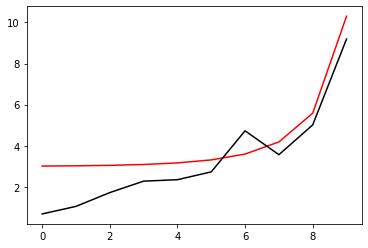

3500 89.78601532929254
[0.68885676 1.05465205 1.72514934 2.28149279 2.35334502 2.73397783
 4.72779924 3.56712785 5.01618736 9.18948376]


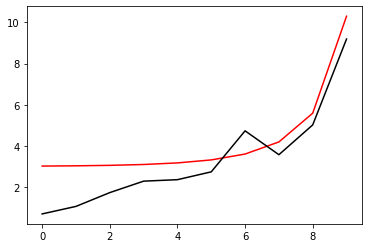

3600 89.78597989206298
[0.68908156 1.05444094 1.72452489 2.28136151 2.35446288 2.73478215
 4.72674932 3.56695356 5.01608424 9.1894437 ]


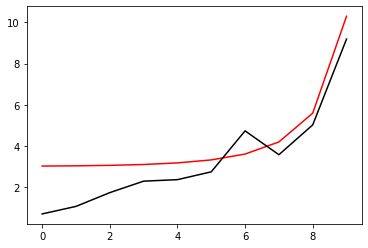

3700 89.78594458030133
[0.68930566 1.05423061 1.72390235 2.28122986 2.35557799 2.73558581
 4.7257004  3.56677972 5.01598195 9.18940363]


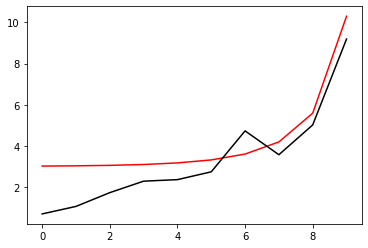

3800 89.78590939340353
[0.68952907 1.05402104 1.7232817  2.28109785 2.35669036 2.7363888
 4.72465248 3.56660633 5.01588049 9.18936357]


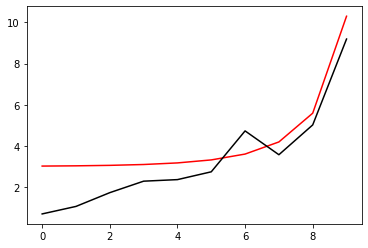

3900 89.7858743307693
[0.68975178 1.05381223 1.72266295 2.28096549 2.35779998 2.73719114
 4.72360555 3.56643337 5.01577987 9.1893235 ]


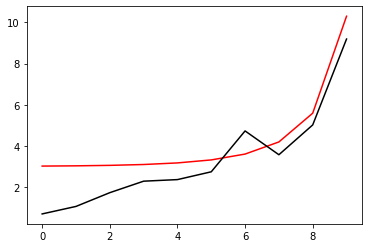

4000 89.78583939180213
[0.68997381 1.05360419 1.72204608 2.28083277 2.35890688 2.73799282
 4.72255962 3.56626086 5.01568007 9.18928343]


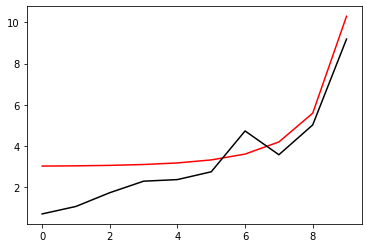

4100 89.7858045759091
[0.69019515 1.0533969  1.72143109 2.28069972 2.36001106 2.73879383
 4.72151469 3.56608879 5.0155811  9.18924337]


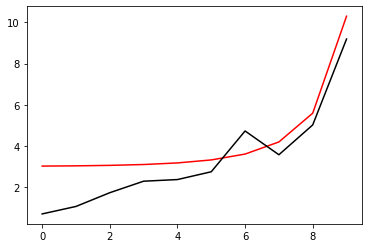

4200 89.78576988250107
[0.69041581 1.05319037 1.72081796 2.28056632 2.36111253 2.73959419
 4.72047074 3.56591715 5.01548295 9.1892033 ]


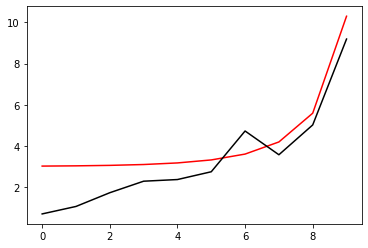

4300 89.78573531099251
[0.69063579 1.05298458 1.7202067  2.28043259 2.36221128 2.74039388
 4.71942779 3.56574595 5.01538562 9.18916323]


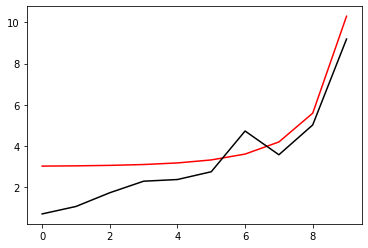

4400 89.7857008608014
[0.69085509 1.05277954 1.71959729 2.28029853 2.36330734 2.74119292
 4.71838583 3.56557519 5.0152891  9.18912316]


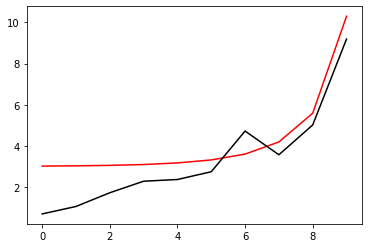

4500 89.78566653134938
[0.69107371 1.05257524 1.71898973 2.28016415 2.36440071 2.74199129
 4.71734485 3.56540486 5.0151934  9.18908309]


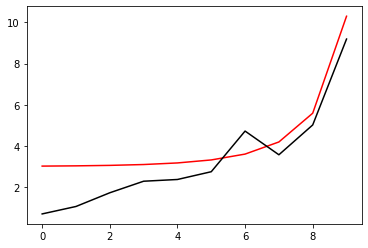

4600 89.78563232206153
[0.69129167 1.05237168 1.71838402 2.28002944 2.36549139 2.742789
 4.71630487 3.56523496 5.01509852 9.18904302]


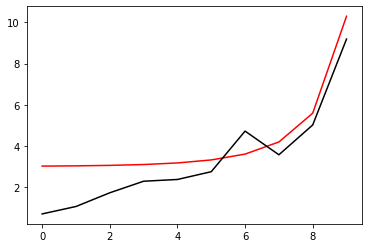

4700 89.78559823236672
[0.69150895 1.05216885 1.71778013 2.27989442 2.36657939 2.74358605
 4.71526587 3.56506548 5.01500444 9.18900295]


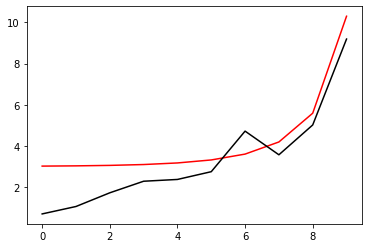

4800 89.78556426169705
[0.69172556 1.05196676 1.71717807 2.27975909 2.36766472 2.74438244
 4.71422785 3.56489644 5.01491117 9.18896288]


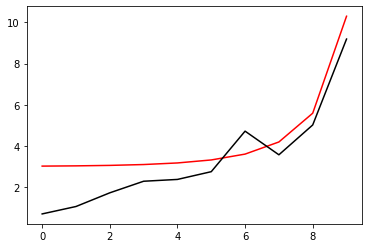

4900 89.78553040948817
[0.69194152 1.05176539 1.71657783 2.27962345 2.36874739 2.74517817
 4.71319082 3.56472782 5.01481871 9.18892281]


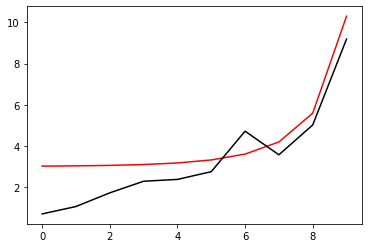

5000 89.78549667517936
[0.69215681 1.05156474 1.7159794  2.27948751 2.36982741 2.74597323
 4.71215477 3.56455962 5.01472705 9.18888274]


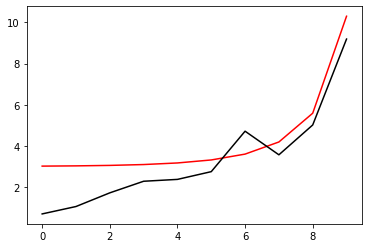

5100 89.78546305821288
[0.69237144 1.05136482 1.71538277 2.27935127 2.37090477 2.74676764
 4.7111197  3.56439185 5.01463618 9.18884267]


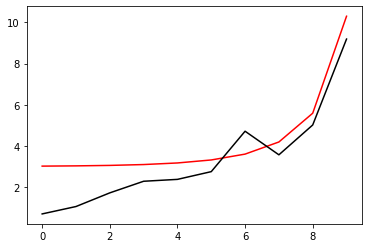

5200 89.78542955803486
[0.69258541 1.05116561 1.71478795 2.27921474 2.37197949 2.74756137
 4.71008561 3.5642245  5.01454612 9.1888026 ]


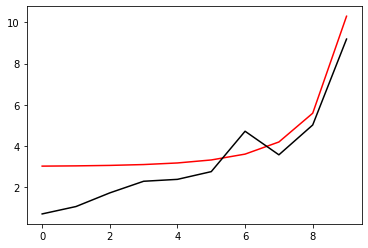

5300 89.78539617409453
[0.69279873 1.05096712 1.71419491 2.27907792 2.37305158 2.74835445
 4.7090525  3.56405757 5.01445685 9.18876252]


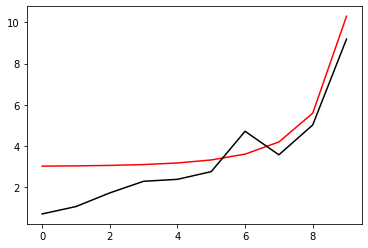

5400 89.78536290584451
[0.6930114  1.05076933 1.71360366 2.27894082 2.37412105 2.74914686
 4.70802037 3.56389105 5.01436837 9.18872245]


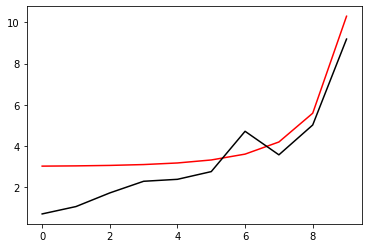

5500 89.7853297527408
[0.69322342 1.05057226 1.71301418 2.27880344 2.37518789 2.74993861
 4.70698921 3.56372495 5.01428069 9.18868238]


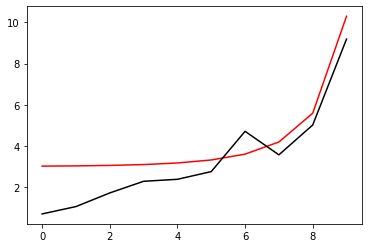

5600 89.78529671424263
[0.6934348  1.05037588 1.71242648 2.27866578 2.37625212 2.7507297
 4.70595902 3.56355927 5.01419379 9.1886423 ]


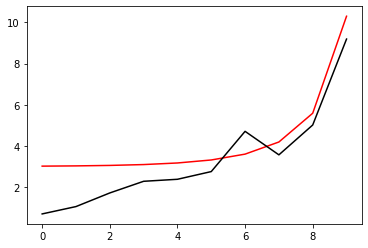

5700 89.78526378981249
[0.69364553 1.05018021 1.71184054 2.27852786 2.37731374 2.75152012
 4.70492981 3.563394   5.01410768 9.18860223]


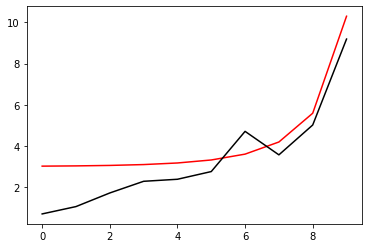

5800 89.78523097891615
[0.69385562 1.04998523 1.71125636 2.27838966 2.37837277 2.75230988
 4.70390157 3.56322914 5.01402235 9.18856215]


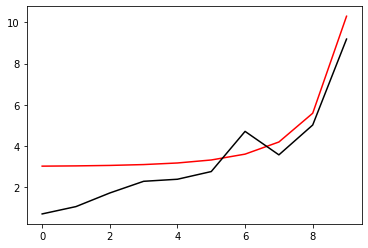

5900 89.78519828102259
[0.69406507 1.04979094 1.71067392 2.27825121 2.3794292  2.75309897
 4.7028743  3.56306469 5.0139378  9.18852208]


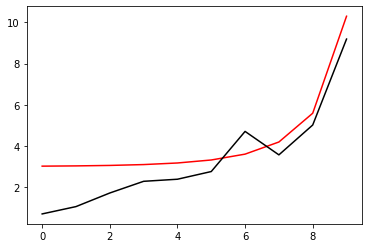

6000 89.785165695604
[0.69427389 1.04959734 1.71009324 2.27811249 2.38048305 2.7538874
 4.701848   3.56290065 5.01385403 9.188482  ]


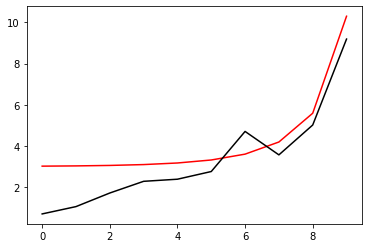

6100 89.78513322213568
[0.69448207 1.04940443 1.70951428 2.27797353 2.38153432 2.75467517
 4.70082267 3.56273701 5.01377104 9.18844192]


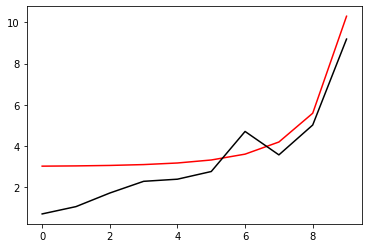

6200 89.78510086009608
[0.69468962 1.04921221 1.70893706 2.27783431 2.38258302 2.75546227
 4.6997983  3.56257379 5.01368882 9.18840185]


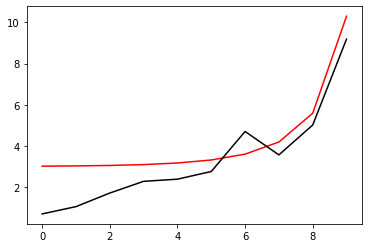

6300 89.78506860896695
[0.69489654 1.04902066 1.70836156 2.27769485 2.38362915 2.7562487
 4.6987749  3.56241096 5.01360737 9.18836177]


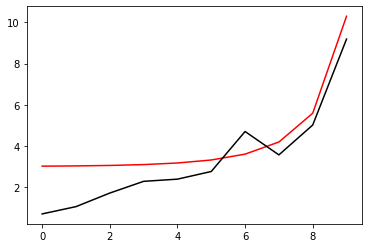

6400 89.78503646823292
[0.69510284 1.04882979 1.70778778 2.27755514 2.38467273 2.75703448
 4.69775246 3.56224854 5.01352669 9.18832169]


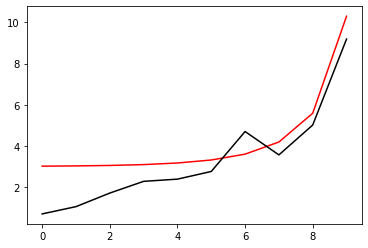

6500 89.78500443738183
[0.69530851 1.04863959 1.70721571 2.2774152  2.38571376 2.75781958
 4.69673099 3.56208651 5.01344677 9.18828161]


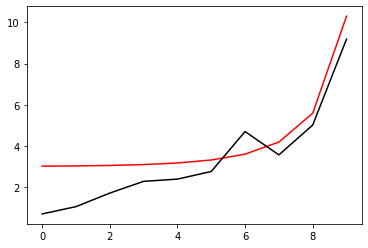

6600 89.78497251590439
[0.69551356 1.04845006 1.70664534 2.27727503 2.38675225 2.75860402
 4.69571047 3.56192489 5.01336763 9.18824153]


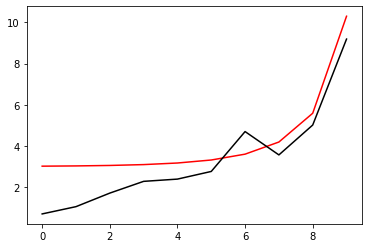

6700 89.78494070329468
[0.695718   1.0482612  1.70607667 2.27713463 2.3877882  2.75938779
 4.69469092 3.56176366 5.01328924 9.18820145]


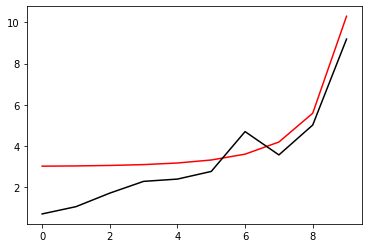

6800 89.78490899904942
[0.69592181 1.048073   1.70550969 2.276994   2.38882162 2.7601709
 4.69367233 3.56160283 5.01321161 9.18816138]


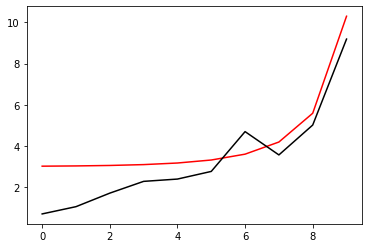

6900 89.78487740266864
[0.69612501 1.04788546 1.70494439 2.27685315 2.38985252 2.76095334
 4.69265469 3.56144239 5.01313474 9.1881213 ]


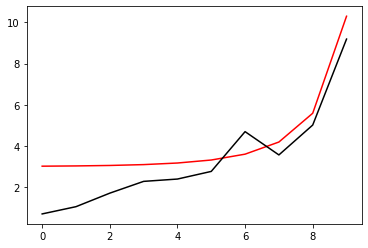

7000 89.78484591365502
[0.6963276  1.04769858 1.70438078 2.27671208 2.3908809  2.76173512
 4.69163801 3.56128235 5.01305863 9.18808122]


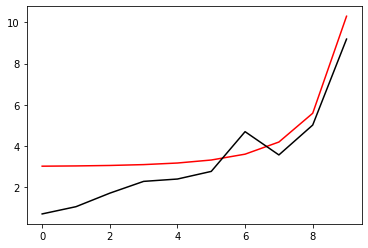

7100 89.78481453151451
[0.69652959 1.04751236 1.70381883 2.2765708  2.39190677 2.76251623
 4.69062229 3.5611227  5.01298327 9.18804113]


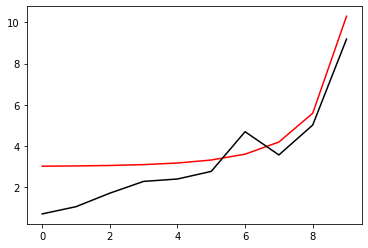

7200 89.78478325575574
[0.69673096 1.04732678 1.70325855 2.27642931 2.39293015 2.76329667
 4.68960752 3.56096343 5.01290866 9.18800105]


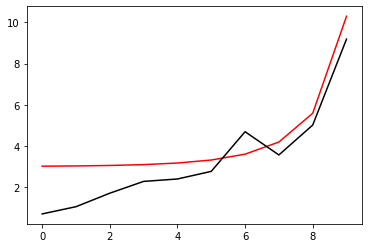

7300 89.78475208589033
[0.69693173 1.04714186 1.70269993 2.27628761 2.39395102 2.76407645
 4.6885937  3.56080456 5.0128348  9.18796097]


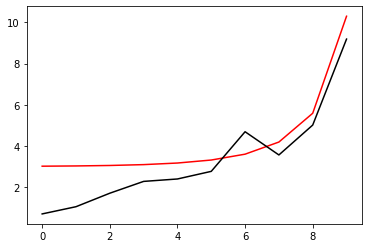

7400 89.7847210214328
[0.6971319  1.04695757 1.70214296 2.27614572 2.39496941 2.76485556
 4.68758083 3.56064607 5.01276168 9.18792089]


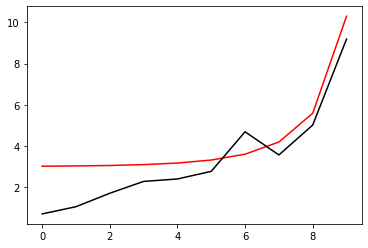

7500 89.78469006190048
[0.69733146 1.04677393 1.70158764 2.27600362 2.39598532 2.765634
 4.68656892 3.56048797 5.01268931 9.18788081]


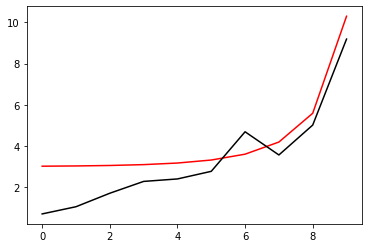

7600 89.78465920681357
[0.69753043 1.04659093 1.70103396 2.27586133 2.39699875 2.76641177
 4.68555795 3.56033025 5.01261768 9.18784073]


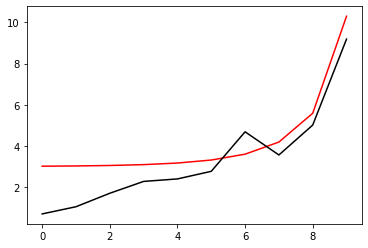

7700 89.78462845569513
[0.69772881 1.04640857 1.70048191 2.27571885 2.39800972 2.76718888
 4.68454793 3.56017292 5.01254679 9.18780065]


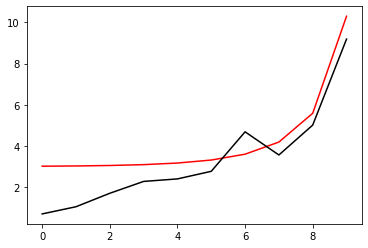

7800 89.78459780807091
[0.69792659 1.04622684 1.6999315  2.27557618 2.39901822 2.76796532
 4.68353886 3.56001597 5.01247664 9.18776056]


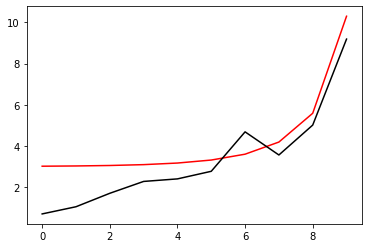

7900 89.78456726346953
[0.69812378 1.04604573 1.6993827  2.27543333 2.40002427 2.76874109
 4.68253073 3.55985939 5.01240722 9.18772048]


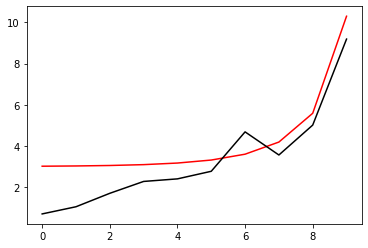

8000 89.78453682142234
[0.69832038 1.04586526 1.69883552 2.27529029 2.40102787 2.7695162
 4.68152354 3.5597032  5.01233854 9.1876804 ]


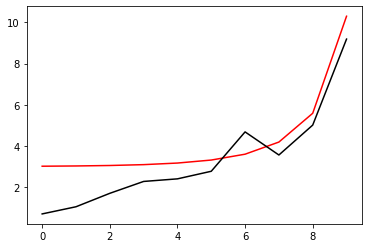

8100 89.78450648146338
[0.6985164  1.04568541 1.69828995 2.27514709 2.40202903 2.77029063
 4.6805173  3.55954738 5.01227058 9.18764031]


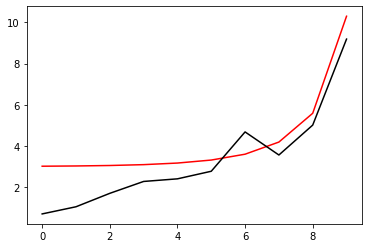

8200 89.78447624312946
[0.69871183 1.04550618 1.69774598 2.2750037  2.40302775 2.7710644
 4.679512   3.55939193 5.01220336 9.18760023]


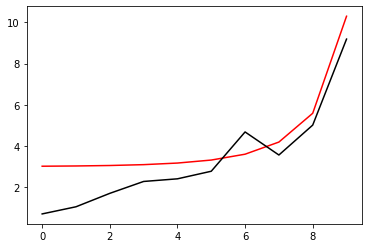

8300 89.78444610596017
[0.69890668 1.04532757 1.69720361 2.27486015 2.40402405 2.7718375
 4.67850764 3.55923686 5.01213686 9.18756015]


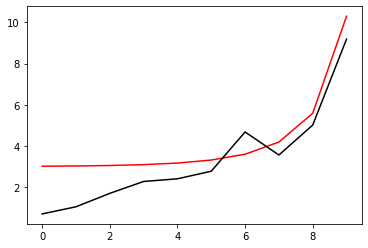

8400 89.78441606949752
[0.69910095 1.04514957 1.69666283 2.27471644 2.40501792 2.77260993
 4.67750422 3.55908217 5.01207109 9.18752006]


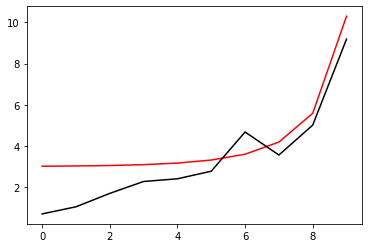

8500 89.78438613328639
[0.69929464 1.04497219 1.69612364 2.27457256 2.40600938 2.7733817
 4.67650174 3.55892784 5.01200604 9.18747998]


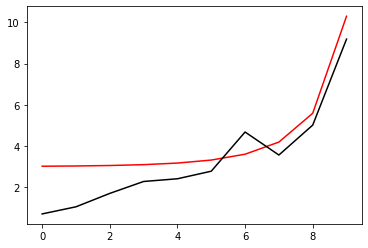

8600 89.7843562968744
[0.69948776 1.04479541 1.69558602 2.27442852 2.40699843 2.77415279
 4.6755002  3.55877389 5.01194171 9.18743989]


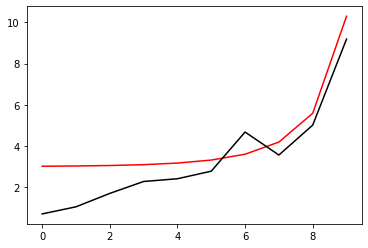

8700 89.78432655981152
[0.6996803  1.04461925 1.69504999 2.27428433 2.40798508 2.77492322
 4.67449959 3.5586203  5.01187809 9.18739981]


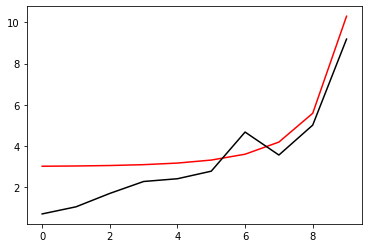

8800 89.78429692165048
[0.69987228 1.04444368 1.69451551 2.27413998 2.40896933 2.77569297
 4.67349991 3.55846708 5.0118152  9.18735972]


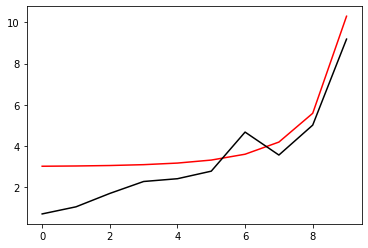

8900 89.78426738194652
[0.70006368 1.04426872 1.69398261 2.27399549 2.40995119 2.77646206
 4.67250117 3.55831423 5.01175301 9.18731964]


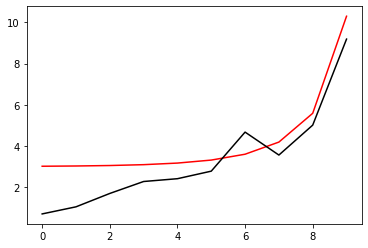

9000 89.78423794025753
[0.70025452 1.04409436 1.69345125 2.27385085 2.41093067 2.77723048
 4.67150336 3.55816174 5.01169154 9.18727955]


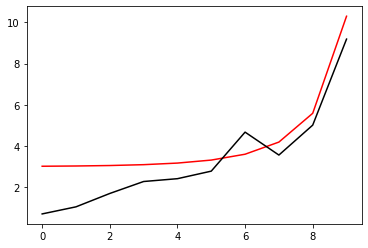

9100 89.78420859614397
[0.7004448  1.04392059 1.69292145 2.27370607 2.41190778 2.77799823
 4.67050648 3.55800961 5.01163078 9.18723947]


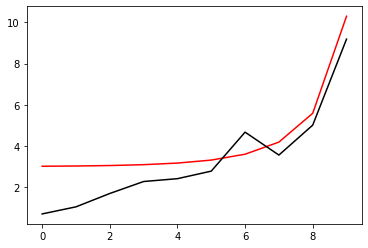

9200 89.78417934916861
[0.70063451 1.04374741 1.69239319 2.27356115 2.41288251 2.7787653
 4.66951052 3.55785784 5.01157073 9.18719938]


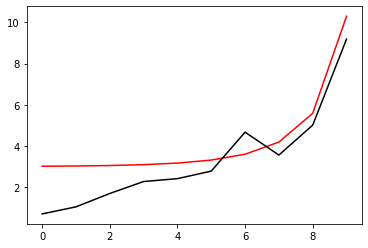

9300 89.78415019889701
[0.70082366 1.04357483 1.69186647 2.27341609 2.41385488 2.77953171
 4.6685155  3.55770644 5.01151138 9.18715929]


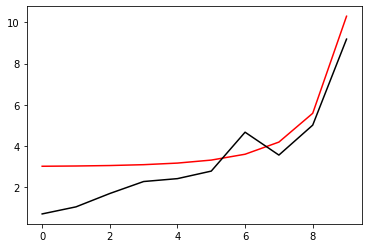

9400 89.784121144897
[0.70101226 1.04340283 1.69134129 2.27327091 2.4148249  2.78029745
 4.66752141 3.55755539 5.01145273 9.18711921]


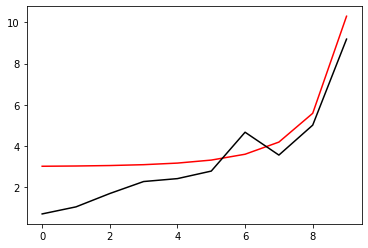

9500 89.78409218673909
[0.70120029 1.04323142 1.69081763 2.27312559 2.41579256 2.78106252
 4.66652824 3.5574047  5.01139479 9.18707912]


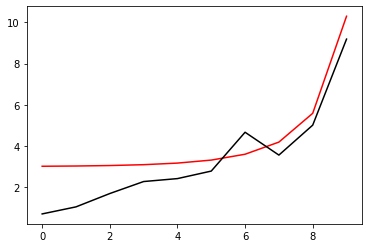

9600 89.78406332399607
[0.70138778 1.04306059 1.6902955  2.27298015 2.41675788 2.78182692
 4.66553599 3.55725437 5.01133754 9.18703903]


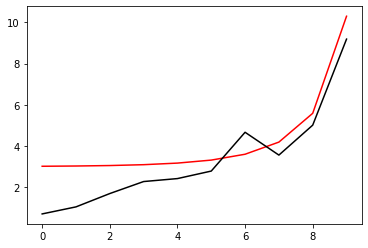

9700 89.78403455624328
[0.70157471 1.04289033 1.68977488 2.27283458 2.41772087 2.78259065
 4.66454467 3.55710439 5.011281   9.18699895]


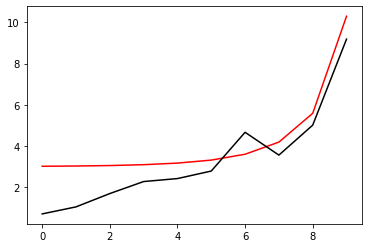

9800 89.78400588305846
[0.7017611  1.04272066 1.68925577 2.2726889  2.41868152 2.78335371
 4.66355427 3.55695477 5.01122514 9.18695886]


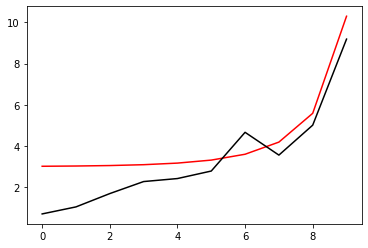

9900 89.78397730402168
[0.70194693 1.04255156 1.68873816 2.2725431  2.41963985 2.7841161
 4.66256479 3.55680549 5.01116999 9.18691877]


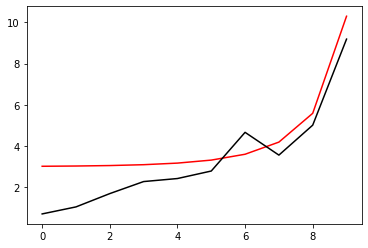

10000 89.78394881871552
[0.70213222 1.04238303 1.68822206 2.27239718 2.42059585 2.78487782
 4.66157624 3.55665657 5.01111552 9.18687869]


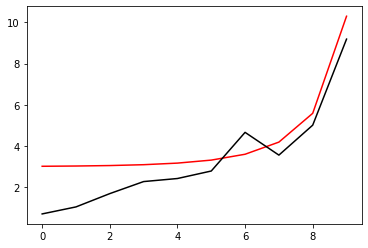

In [20]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.78392042672482
[0.70231697 1.04221507 1.68770745 2.27225115 2.42154955 2.78563887
 4.6605886  3.556508   5.01106174 9.1868386 ]


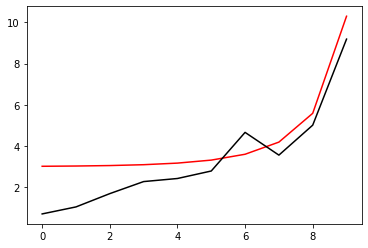

200 89.78389212763693
[0.70250117 1.04204767 1.68719433 2.27210502 2.42250094 2.78639924
 4.65960188 3.55635978 5.01100865 9.18679851]


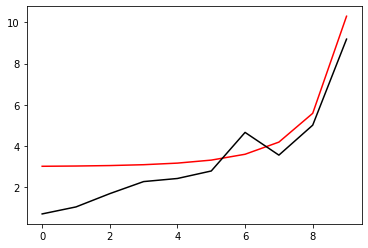

300 89.78386392104137
[0.70268484 1.04188084 1.68668269 2.27195878 2.42345003 2.78715895
 4.65861607 3.5562119  5.01095624 9.18675842]


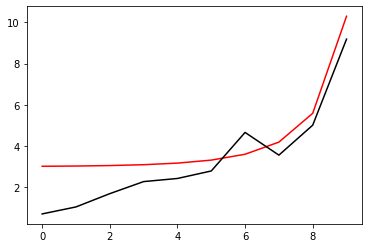

400 89.78383580653005
[0.70286797 1.04171457 1.68617253 2.27181244 2.42439682 2.78791799
 4.65763118 3.55606437 5.01090452 9.18671834]


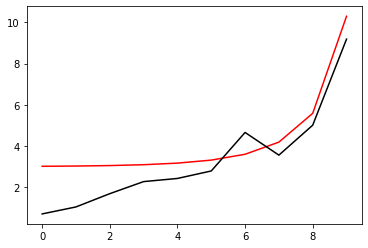

500 89.78380778369717
[0.70305056 1.04154886 1.68566384 2.27166601 2.42534133 2.78867635
 4.65664721 3.55591718 5.01085348 9.18667825]


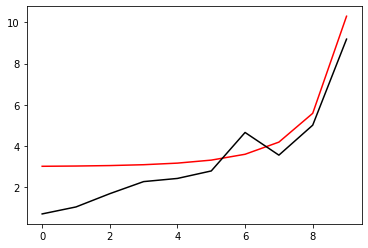

600 89.78377985213938
[0.70323262 1.04138371 1.68515662 2.27151947 2.42628356 2.78943404
 4.65566414 3.55577034 5.01080311 9.18663816]


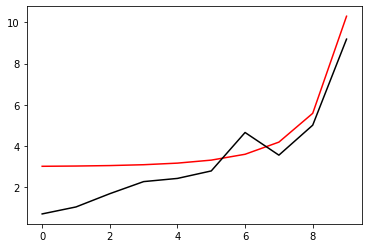

700 89.78375201145533
[0.70341415 1.04121911 1.68465085 2.27137285 2.42722351 2.79019107
 4.65468199 3.55562384 5.01075343 9.18659807]


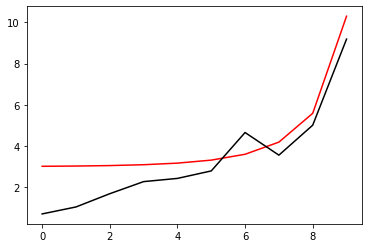

800 89.78372426124609
[0.70359514 1.04105506 1.68414655 2.27122613 2.42816119 2.79094742
 4.65370075 3.55547767 5.01070442 9.18655798]


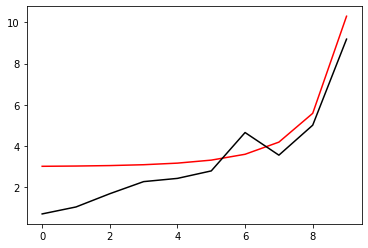

900 89.78369660111495
[0.70377561 1.04089155 1.6836437  2.27107933 2.42909661 2.7917031
 4.65272042 3.55533185 5.01065608 9.1865179 ]


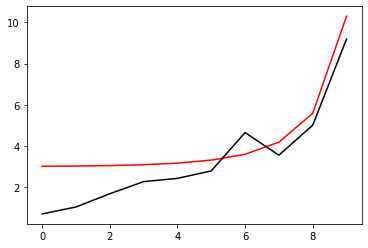

1000 89.78366903066751
[0.70395556 1.0407286  1.68314229 2.27093244 2.43002978 2.79245811
 4.651741   3.55518637 5.01060841 9.18647781]


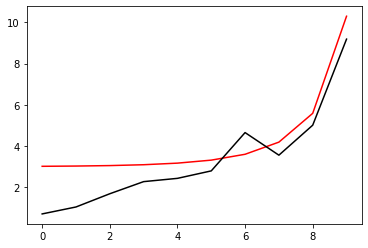

1100 89.78364154951137
[0.70413498 1.04056619 1.68264232 2.27078547 2.43096069 2.79321244
 4.65076249 3.55504122 5.01056142 9.18643772]


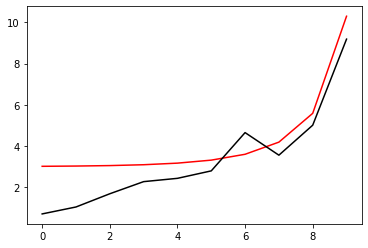

1200 89.78361415725661
[0.70431388 1.04040431 1.68214378 2.27063842 2.43188936 2.79396611
 4.64978488 3.55489641 5.01051509 9.18639763]


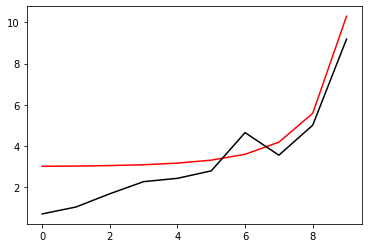

1300 89.78358685351526
[0.70449226 1.04024298 1.68164668 2.2704913  2.43281579 2.7947191
 4.64880817 3.55475193 5.01046942 9.18635754]


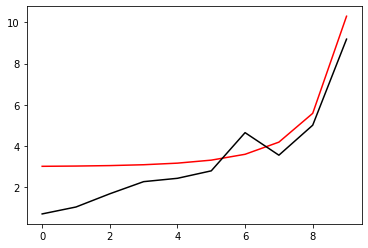

1400 89.78355963790146
[0.70467012 1.04008219 1.681151   2.27034411 2.43373999 2.79547142
 4.64783237 3.55460779 5.01042443 9.18631745]


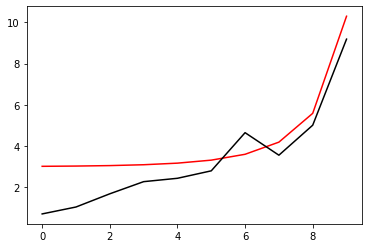

1500 89.78353251003195
[0.70484747 1.03992192 1.68065674 2.27019684 2.43466196 2.79622308
 4.64685747 3.55446397 5.01038009 9.18627737]


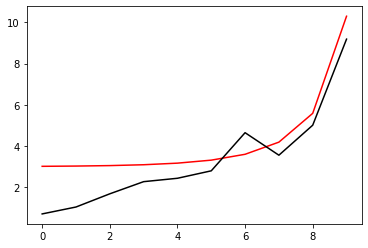

1600 89.78350546952502
[0.7050243  1.03976219 1.68016389 2.2700495  2.43558171 2.79697405
 4.64588348 3.55432049 5.01033641 9.18623728]


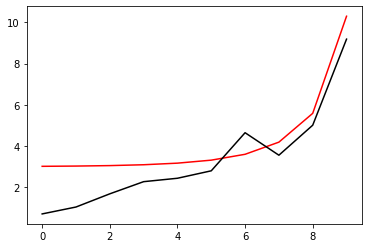

1700 89.78347851600151
[0.70520062 1.03960299 1.67967245 2.26990211 2.43649925 2.79772436
 4.64491038 3.55417734 5.01029339 9.18619719]


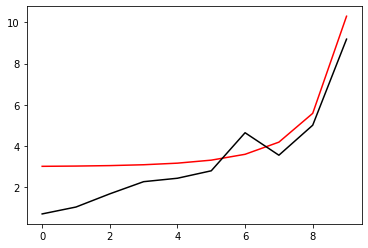

1800 89.78345164908418
[0.70537643 1.03944431 1.67918241 2.26975464 2.43741457 2.79847399
 4.64393818 3.55403451 5.01025103 9.1861571 ]


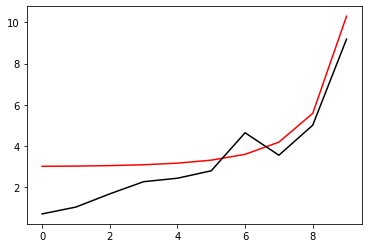

1900 89.7834248683979
[0.70555173 1.03928616 1.67869378 2.26960712 2.4383277  2.79922296
 4.64296689 3.55389201 5.01020932 9.18611701]


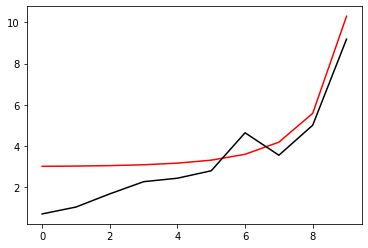

2000 89.78339817356971
[0.70572653 1.03912853 1.67820654 2.26945954 2.43923863 2.79997125
 4.64199648 3.55374984 5.01016826 9.18607692]


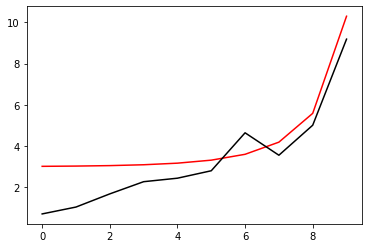

2100 89.78337156422857
[0.70590082 1.03897143 1.67772068 2.26931191 2.44014737 2.80071886
 4.64102698 3.55360799 5.01012785 9.18603683]


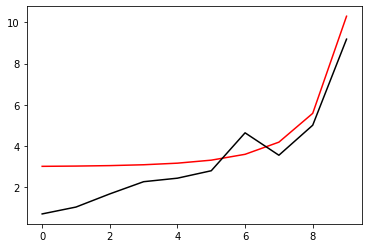

2200 89.78334504000561
[0.7060746  1.03881483 1.67723621 2.26916423 2.44105393 2.80146581
 4.64005837 3.55346647 5.01008809 9.18599674]


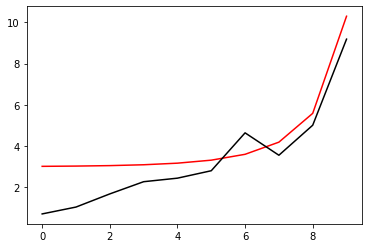

2300 89.78331860053387
[0.70624789 1.03865876 1.67675312 2.26901649 2.44195831 2.80221208
 4.63909065 3.55332526 5.01004898 9.18595666]


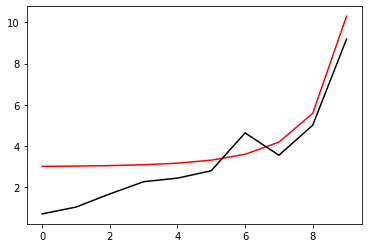

2400 89.78329224544866
[0.70642068 1.03850319 1.6762714  2.26886871 2.44286051 2.80295768
 4.63812382 3.55318438 5.01001052 9.18591657]


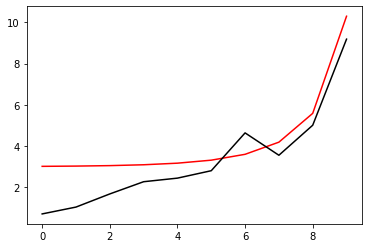

2500 89.78326597438704
[0.70659297 1.03834814 1.67579105 2.26872088 2.44376055 2.80370261
 4.63715789 3.55304382 5.00997269 9.18587648]


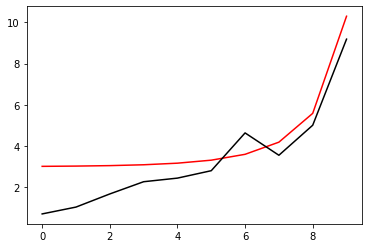

2600 89.7832397869881
[0.70676476 1.03819359 1.67531206 2.26857302 2.44465843 2.80444687
 4.63619285 3.55290357 5.00993551 9.18583639]


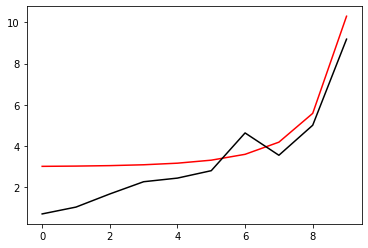

2700 89.78321368289318
[0.70693606 1.03803955 1.67483443 2.26842511 2.44555415 2.80519045
 4.63522869 3.55276365 5.00989897 9.1857963 ]


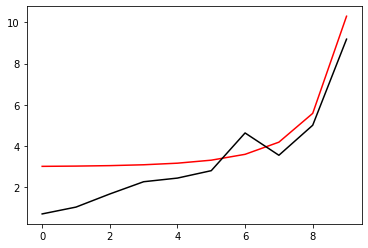

2800 89.78318766174515
[0.70710687 1.03788602 1.67435816 2.26827716 2.44644773 2.80593336
 4.63426542 3.55262404 5.00986306 9.18575621]


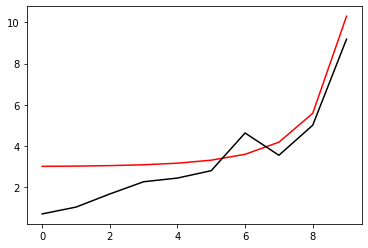

2900 89.78316172318924
[0.70727719 1.03773298 1.67388324 2.26812918 2.44733916 2.8066756
 4.63330304 3.55248474 5.00982779 9.18571612]


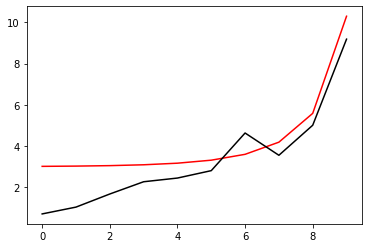

3000 89.78313586687239
[0.70744701 1.03758045 1.67340965 2.26798117 2.44822845 2.80741717
 4.63234155 3.55234576 5.00979316 9.18567604]


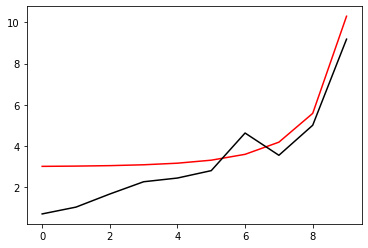

3100 89.78311009244351
[0.70761636 1.03742841 1.67293741 2.26783313 2.44911561 2.80815806
 4.63138094 3.55220709 5.00975915 9.18563595]


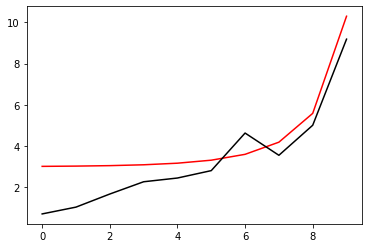

3200 89.78308439955349
[0.70778522 1.03727687 1.6724665  2.26768506 2.45000065 2.80889828
 4.63042121 3.55206873 5.00972578 9.18559586]


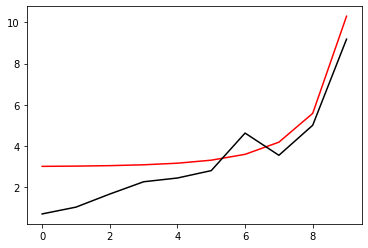

3300 89.78305878785501
[0.70795359 1.03712582 1.67199693 2.26753696 2.45088356 2.80963783
 4.62946237 3.55193068 5.00969304 9.18555577]


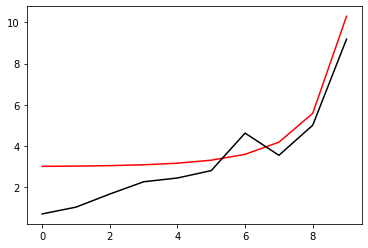

3400 89.78303325700283
[0.70812148 1.03697526 1.67152867 2.26738885 2.45176437 2.8103767
 4.62850441 3.55179295 5.00966092 9.18551568]


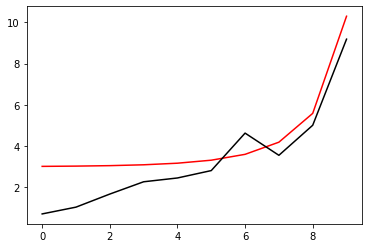

3500 89.78300780665342
[0.7082889  1.03682519 1.67106174 2.26724071 2.45264306 2.8111149
 4.62754733 3.55165552 5.00962943 9.18547559]


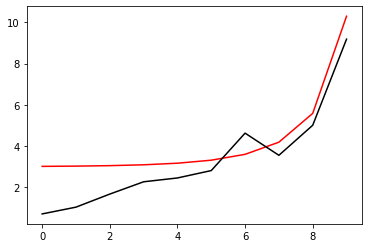

3600 89.78298243646518
[0.70845583 1.0366756  1.67059612 2.26709255 2.45351965 2.81185243
 4.62659112 3.55151839 5.00959856 9.18543551]


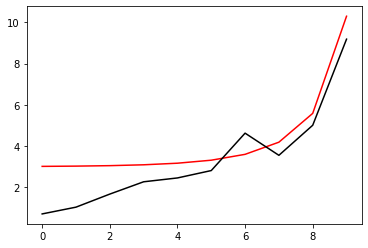

3700 89.78295714609827
[0.70862229 1.0365265  1.67013182 2.26694438 2.45439414 2.81258929
 4.6256358  3.55138158 5.00956831 9.18539542]


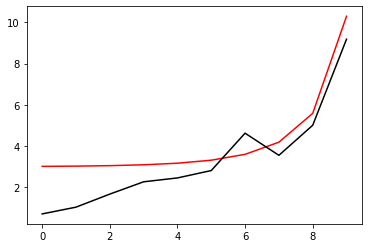

3800 89.7829319352149
[0.70878827 1.03637788 1.66966882 2.26679619 2.45526654 2.81332547
 4.62468135 3.55124506 5.00953868 9.18535533]


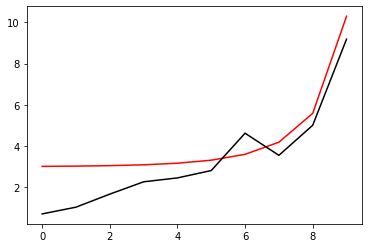

3900 89.78290680347894
[0.70895379 1.03622974 1.66920712 2.26664799 2.45613686 2.81406098
 4.62372778 3.55110885 5.00950967 9.18531524]


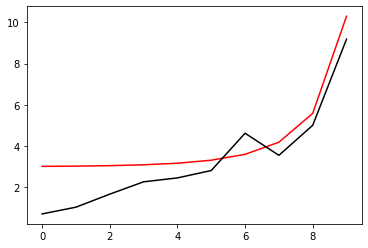

4000 89.78288175055606
[0.70911883 1.03608208 1.66874672 2.26649978 2.45700509 2.81479581
 4.62277508 3.55097295 5.00948128 9.18527515]


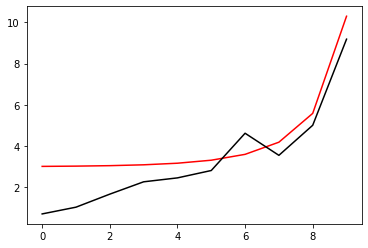

4100 89.78285677611382
[0.7092834  1.0359349  1.66828761 2.26635157 2.45787126 2.81552998
 4.62182326 3.55083734 5.0094535  9.18523507]


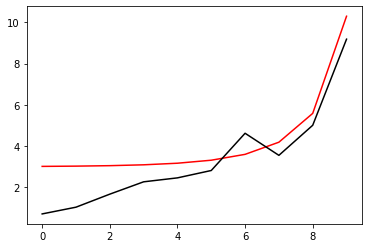

4200 89.78283187982153
[0.7094475  1.03578818 1.66782978 2.26620335 2.45873535 2.81626347
 4.62087231 3.55070204 5.00942633 9.18519498]


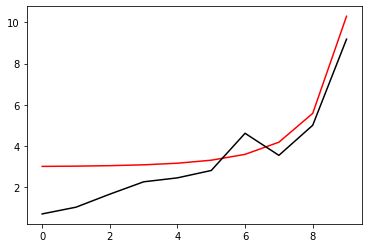

4300 89.78280706135043
[0.70961114 1.03564194 1.66737324 2.26605512 2.45959738 2.81699628
 4.61992223 3.55056703 5.00939978 9.18515489]


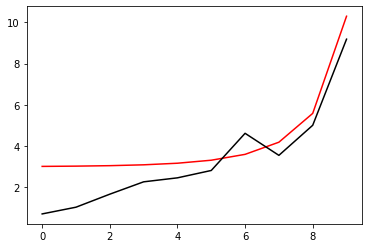

4400 89.78278232037314
[0.70977431 1.03549617 1.66691798 2.2659069  2.46045735 2.81772843
 4.61897302 3.55043232 5.00937383 9.1851148 ]


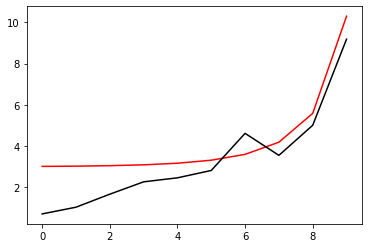

4500 89.78275765656448
[0.70993702 1.03535087 1.666464   2.26575868 2.46131526 2.8184599
 4.61802468 3.55029791 5.0093485  9.18507472]


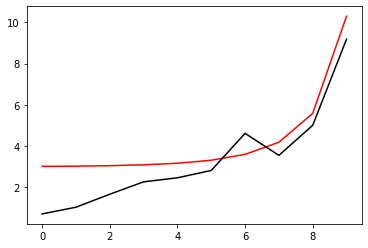

4600 89.7827330696008
[0.71009927 1.03520603 1.66601128 2.26561046 2.46217114 2.8191907
 4.61707721 3.5501638  5.00932376 9.18503463]


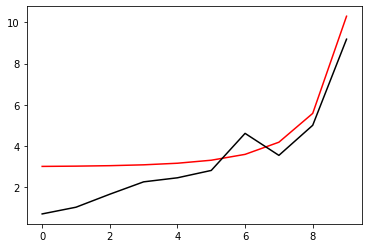

4700 89.7827085591602
[0.71026106 1.03506166 1.66555983 2.26546224 2.46302497 2.81992082
 4.6161306  3.55002998 5.00929964 9.18499454]


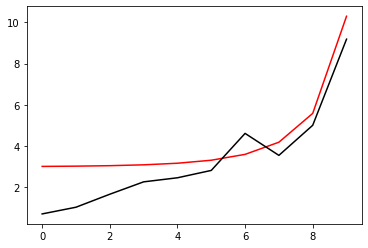

4800 89.78268412492238
[0.71042239 1.03491775 1.66510964 2.26531403 2.46387676 2.82065027
 4.61518486 3.54989645 5.00927611 9.18495446]


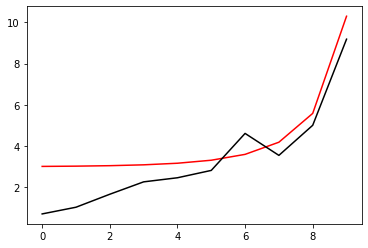

4900 89.78265976656911
[0.71058326 1.03477429 1.6646607  2.26516583 2.46472653 2.82137905
 4.61423999 3.54976321 5.00925319 9.18491437]


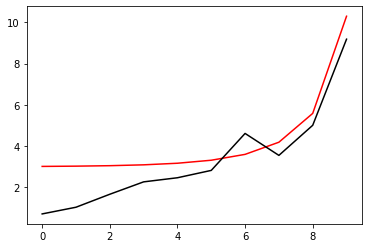

5000 89.78263548378348
[0.71074368 1.0346313  1.66421301 2.26501765 2.46557427 2.82210716
 4.61329598 3.54963027 5.00923086 9.18487428]


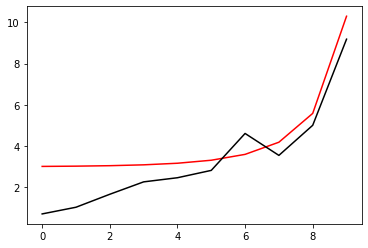

5100 89.78261127625044
[0.71090365 1.03448876 1.66376658 2.26486947 2.46641999 2.82283459
 4.61235283 3.54949762 5.00920914 9.1848342 ]


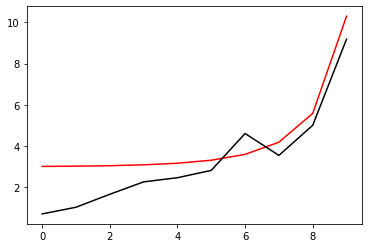

5200 89.78258714365668
[0.71106317 1.03434667 1.66332138 2.26472132 2.4672637  2.82356135
 4.61141055 3.54936526 5.009188   9.18479411]


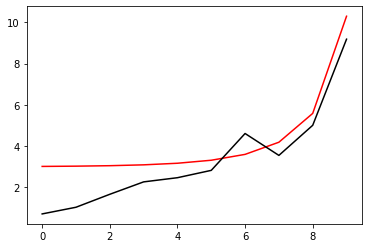

5300 89.78256308569037
[0.71122223 1.03420504 1.66287743 2.26457317 2.4681054  2.82428744
 4.61046913 3.54923318 5.00916747 9.18475403]


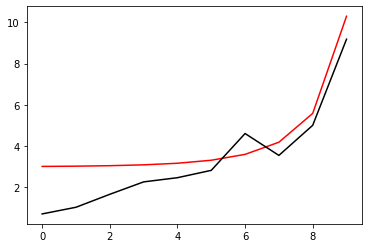

5400 89.7825391020415
[0.71138085 1.03406385 1.66243471 2.26442505 2.4689451  2.82501285
 4.60952856 3.5491014  5.00914752 9.18471394]


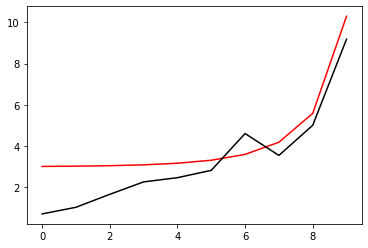

5500 89.78251519240163
[0.71153902 1.03392312 1.66199321 2.26427695 2.4697828  2.82573759
 4.60858886 3.54896989 5.00912817 9.18467386]


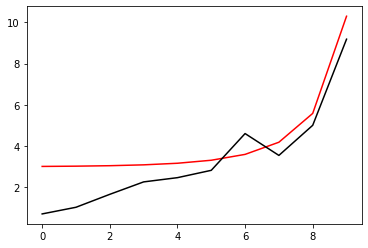

5600 89.78249135646395
[0.71169675 1.03378283 1.66155295 2.26412888 2.4706185  2.82646166
 4.60765001 3.54883868 5.00910941 9.18463377]


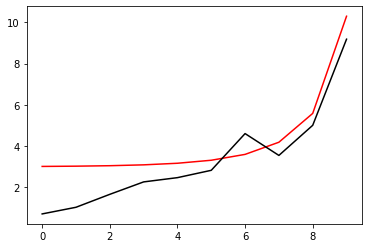

5700 89.78246759392339
[0.71185403 1.03364298 1.6611139  2.26398082 2.47145223 2.82718505
 4.60671202 3.54870775 5.00909123 9.18459369]


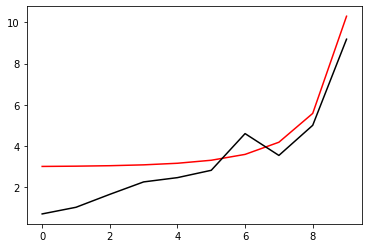

5800 89.78244390447625
[0.71201087 1.03350357 1.66067607 2.2638328  2.47228397 2.82790777
 4.60577489 3.5485771  5.00907364 9.1845536 ]


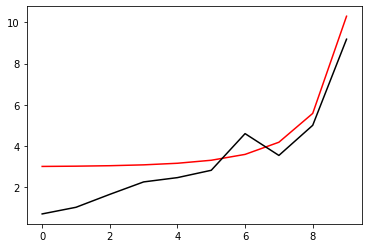

5900 89.78242028782068
[0.71216727 1.03336461 1.66023946 2.2636848  2.47311373 2.82862982
 4.6048386  3.54844673 5.00905663 9.18451352]


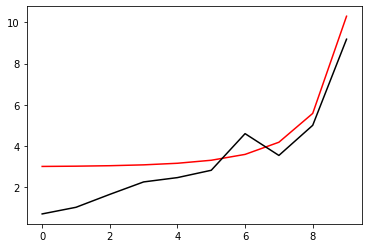

6000 89.78239674365626
[0.71232323 1.03322608 1.65980405 2.26353683 2.47394153 2.82935119
 4.60390318 3.54831665 5.00904021 9.18447343]


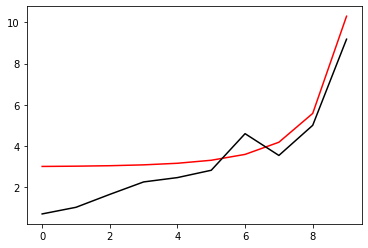

6100 89.7823732716843
[0.71247875 1.03308799 1.65936985 2.2633889  2.47476736 2.83007189
 4.6029686  3.54818684 5.00902437 9.18443335]


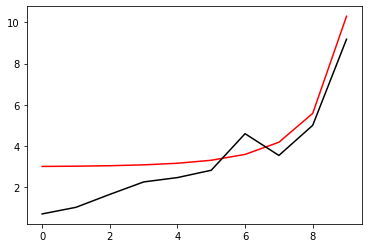

6200 89.78234987160755
[0.71263384 1.03295034 1.65893684 2.263241   2.47559122 2.83079192
 4.60203488 3.54805732 5.00900911 9.18439326]


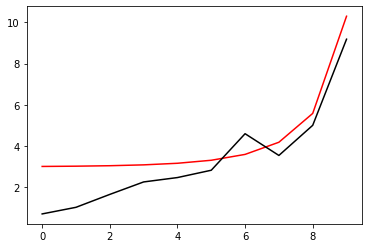

6300 89.78232654313031
[0.71278849 1.03281311 1.65850504 2.26309314 2.47641314 2.83151128
 4.60110201 3.54792807 5.00899442 9.18435318]


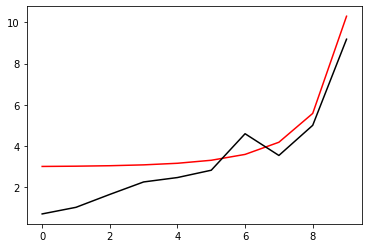

6400 89.78230328595855
[0.71294271 1.03267632 1.65807442 2.26294531 2.47723311 2.83222996
 4.60016998 3.5477991  5.00898032 9.1843131 ]


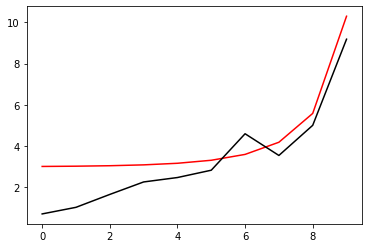

6500 89.78228009979975
[0.7130965  1.03253996 1.65764499 2.26279753 2.47805113 2.83294797
 4.59923881 3.5476704  5.00896678 9.18427301]


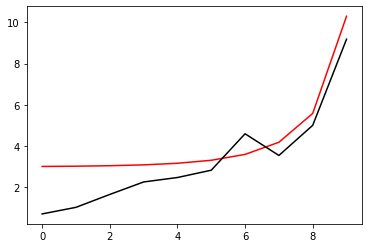

6600 89.78225698436286
[0.71324986 1.03240402 1.65721675 2.26264978 2.47886721 2.8336653
 4.59830848 3.54754198 5.00895382 9.18423293]


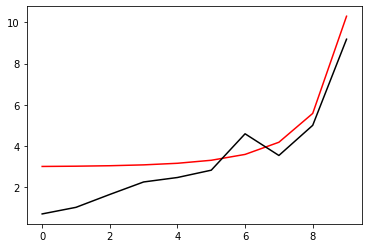

6700 89.7822339393583
[0.71340279 1.03226852 1.65678968 2.26250208 2.47968136 2.83438197
 4.597379   3.54741383 5.00894144 9.18419285]


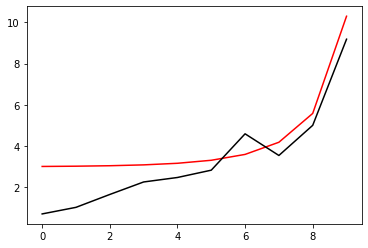

6800 89.78221096449823
[0.71355529 1.03213343 1.65636379 2.26235442 2.48049358 2.83509796
 4.59645036 3.54728596 5.00892962 9.18415277]


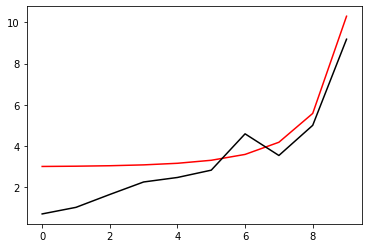

6900 89.78218805949611
[0.71370737 1.03199876 1.65593907 2.26220681 2.48130388 2.83581328
 4.59552257 3.54715836 5.00891837 9.18411269]


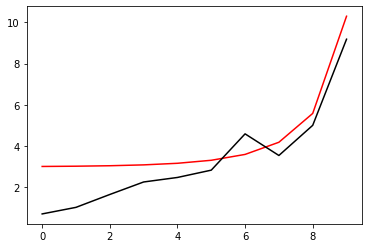

7000 89.78216522406687
[0.71385902 1.03186452 1.65551552 2.26205925 2.48211227 2.83652792
 4.59459562 3.54703103 5.00890769 9.1840726 ]


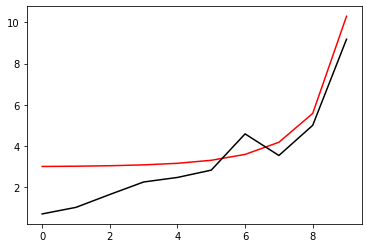

7100 89.78214245792716
[0.71401026 1.03173069 1.65509313 2.26191174 2.48291873 2.83724189
 4.59366951 3.54690397 5.00889757 9.18403252]


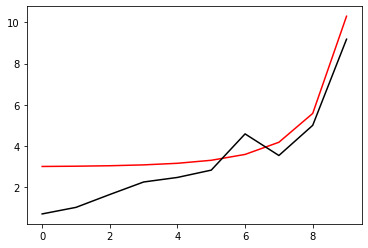

7200 89.78211976079477
[0.71416107 1.03159729 1.6546719  2.26176428 2.4837233  2.83795519
 4.59274424 3.54677718 5.00888802 9.18399244]


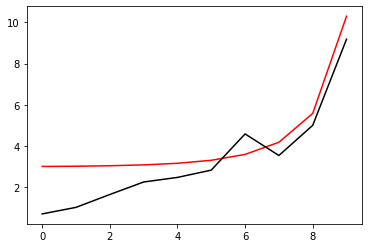

7300 89.78209713238931
[0.71431146 1.03146429 1.65425183 2.26161687 2.48452595 2.83866782
 4.59181981 3.54665066 5.00887903 9.18395236]


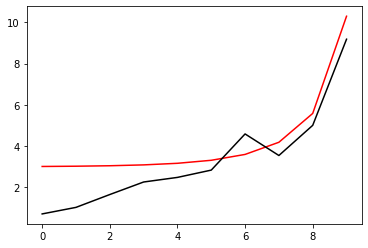

7400 89.78207457243154
[0.71446143 1.03133171 1.6538329  2.26146951 2.48532672 2.83937977
 4.59089623 3.5465244  5.0088706  9.18391228]


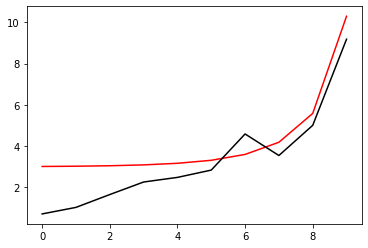

7500 89.78205208064384
[0.71461099 1.03119954 1.65341512 2.26132222 2.48612559 2.84009106
 4.58997348 3.54639841 5.00886272 9.1838722 ]


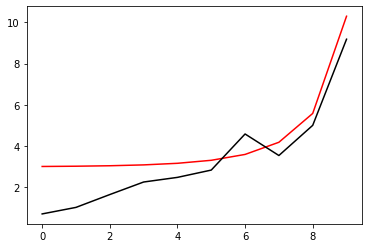

7600 89.78202965674993
[0.71476013 1.03106778 1.65299849 2.26117498 2.48692257 2.84080167
 4.58905156 3.54627269 5.00885541 9.18383212]


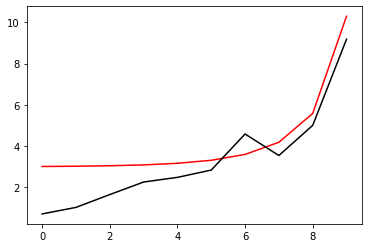

7700 89.7820073004751
[0.71490886 1.03093643 1.652583   2.2610278  2.48771767 2.8415116
 4.58813049 3.54614722 5.00884865 9.18379204]


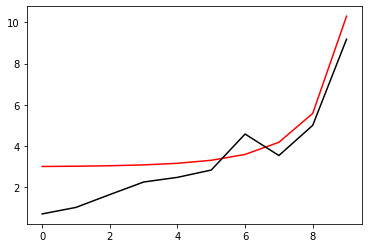

7800 89.78198501154586
[0.71505717 1.03080548 1.65216864 2.26088068 2.4885109  2.84222087
 4.58721024 3.54602203 5.00884245 9.18375196]


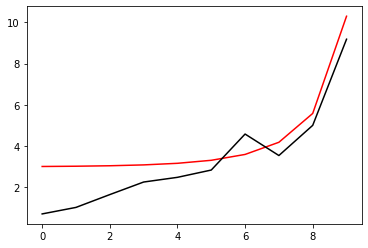

7900 89.7819627896903
[0.71520508 1.03067494 1.65175541 2.26073362 2.48930225 2.84292946
 4.58629084 3.54589709 5.0088368  9.18371188]


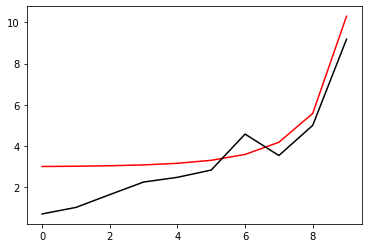

8000 89.78194063463782
[0.71535257 1.0305448  1.65134331 2.26058663 2.49009174 2.84363738
 4.58537226 3.54577242 5.00883171 9.1836718 ]


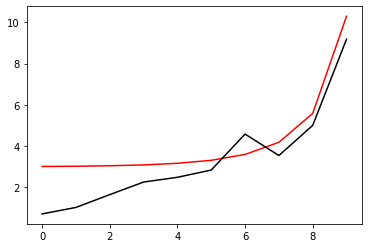

8100 89.78191854611929
[0.71549966 1.03041506 1.65093233 2.26043971 2.49087937 2.84434463
 4.58445452 3.54564801 5.00882716 9.18363172]


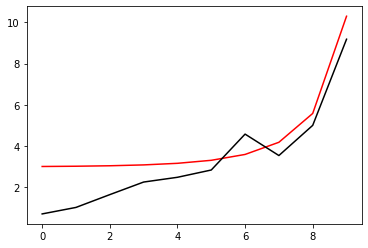

8200 89.78189652386679
[0.71564634 1.03028573 1.65052247 2.26029285 2.49166514 2.8450512
 4.5835376  3.54552385 5.00882316 9.18359165]


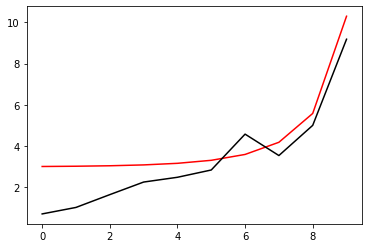

8300 89.78187456761395
[0.71579261 1.03015678 1.65011373 2.26014606 2.49244905 2.84575711
 4.58262152 3.54539996 5.00881971 9.18355157]


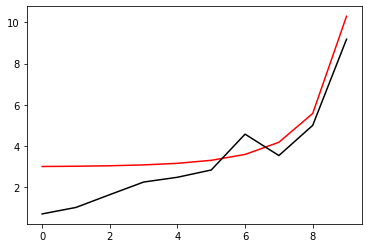

8400 89.78185267709577
[0.71593849 1.03002824 1.6497061  2.25999934 2.49323113 2.84646234
 4.58170627 3.54527632 5.0088168  9.18351149]


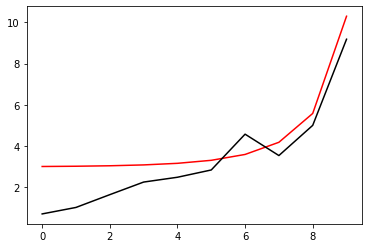

8500 89.78183085204846
[0.71608395 1.02990009 1.64929958 2.25985269 2.49401136 2.8471669
 4.58079184 3.54515294 5.00881444 9.18347141]


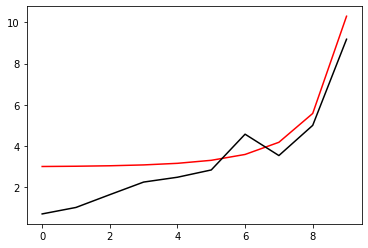

8600 89.78180909220967
[0.71622902 1.02977234 1.64889417 2.25970611 2.49478975 2.84787078
 4.57987824 3.54502981 5.00881262 9.18343134]


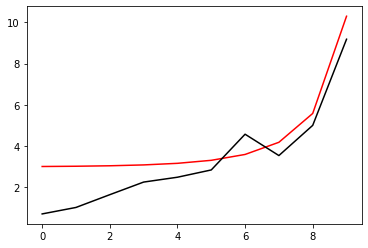

8700 89.78178739731841
[0.71637369 1.02964497 1.64848985 2.25955961 2.49556631 2.848574
 4.57896547 3.54490694 5.00881134 9.18339126]


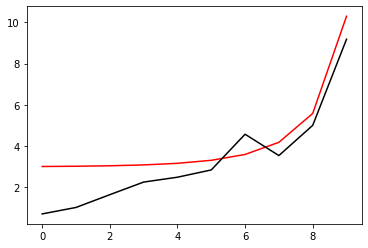

8800 89.78176576711503
[0.71651796 1.02951799 1.64808663 2.25941319 2.49634105 2.84927654
 4.57805352 3.54478432 5.00881061 9.18335119]


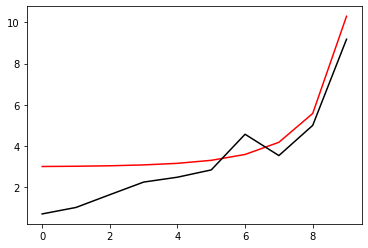

8900 89.78174420134116
[0.71666183 1.02939141 1.64768451 2.25926684 2.49711396 2.84997841
 4.5771424  3.54466196 5.00881041 9.18331111]


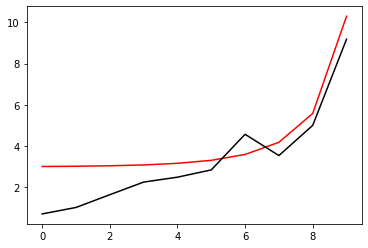

9000 89.78172269973957
[0.7168053  1.02926521 1.64728347 2.25912057 2.49788506 2.85067961
 4.5762321  3.54453985 5.00881074 9.18327104]


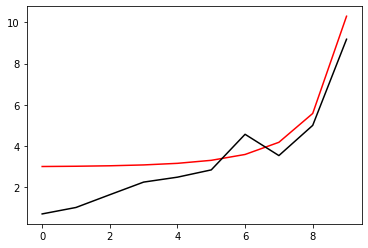

9100 89.78170126205478
[0.71694839 1.02913939 1.64688352 2.25897438 2.49865435 2.85138014
 4.57532262 3.54441799 5.00881162 9.18323096]


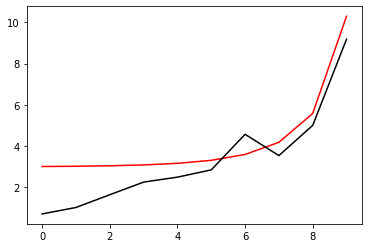

9200 89.78167988803224
[0.71709107 1.02901396 1.64648466 2.25882828 2.49942183 2.85208
 4.57441396 3.54429638 5.00881302 9.18319089]


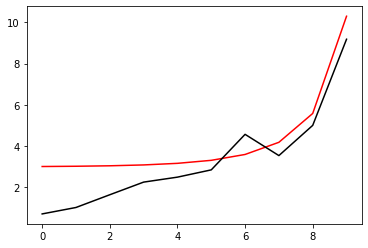

9300 89.78165857741875
[0.71723337 1.02888891 1.64608687 2.25868225 2.5001875  2.85277918
 4.57350612 3.54417502 5.00881496 9.18315081]


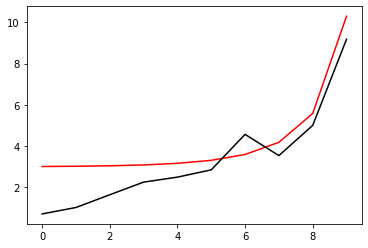

9400 89.78163732996249
[0.71737528 1.02876424 1.64569015 2.25853631 2.50095138 2.8534777
 4.5725991  3.54405391 5.00881743 9.18311074]


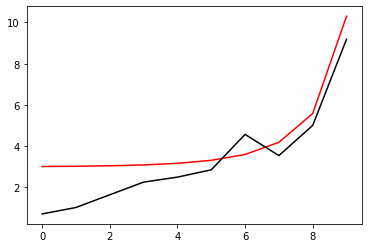

9500 89.78161614541285
[0.71751679 1.02863995 1.64529451 2.25839046 2.50171347 2.85417554
 4.5716929  3.54393304 5.00882043 9.18307067]


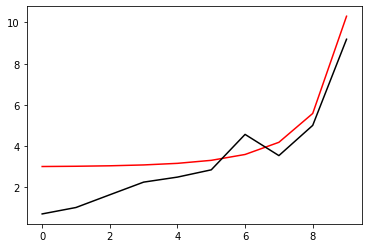

9600 89.78159502352054
[0.71765792 1.02851603 1.64489994 2.25824469 2.50247377 2.85487271
 4.57078751 3.54381242 5.00882396 9.18303059]


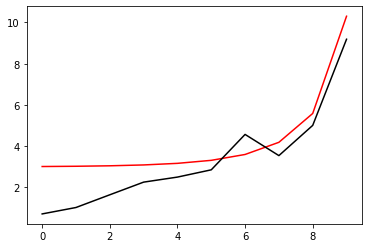

9700 89.78157396403742
[0.71779866 1.02839249 1.64450643 2.25809901 2.50323229 2.85556921
 4.56988294 3.54369205 5.00882802 9.18299052]


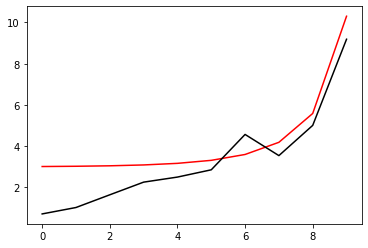

9800 89.78155296671669
[0.71793902 1.02826933 1.64411398 2.25795343 2.50398903 2.85626504
 4.56897919 3.54357192 5.0088326  9.18295045]


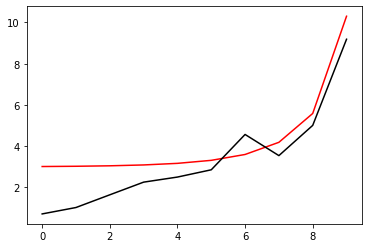

9900 89.7815320313128
[0.718079   1.02814653 1.64372258 2.25780793 2.504744   2.8569602
 4.56807625 3.54345204 5.0088377  9.18291038]


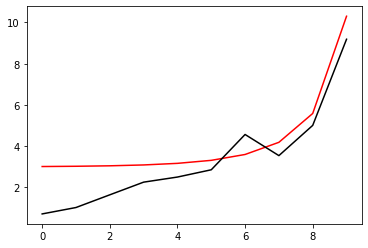

10000 89.78151115758146
[0.71821859 1.02802411 1.64333224 2.25766252 2.5054972  2.85765469
 4.56717412 3.5433324  5.00884333 9.18287031]


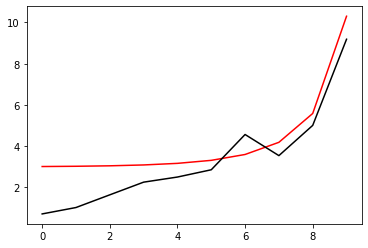

In [21]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.78149034527944
[0.7183578  1.02790206 1.64294295 2.25751721 2.50624863 2.85834851
 4.5662728  3.543213   5.00884948 9.18283024]


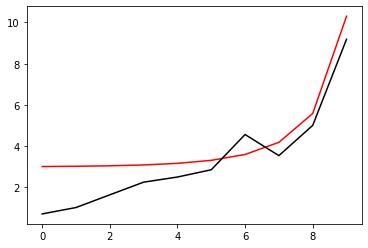

200 89.78146959416489
[0.71849662 1.02778037 1.64255471 2.25737199 2.50699831 2.85904165
 4.5653723  3.54309384 5.00885615 9.18279017]


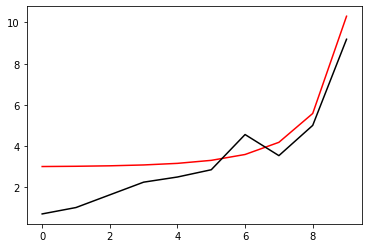

300 89.78144890399717
[0.71863508 1.02765906 1.64216751 2.25722687 2.50774623 2.85973413
 4.56447261 3.54297493 5.00886333 9.1827501 ]


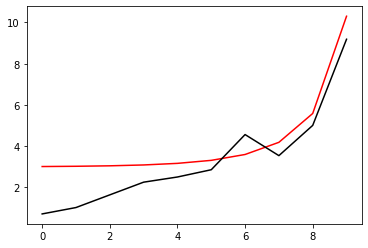

400 89.78142827453684
[0.71877315 1.0275381  1.64178135 2.25708184 2.50849241 2.86042594
 4.56357372 3.54285625 5.00887104 9.18271003]


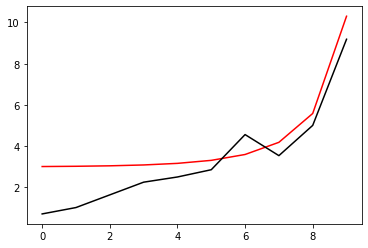

500 89.78140770554546
[0.71891084 1.02741751 1.64139622 2.25693692 2.50923684 2.86111707
 4.56267565 3.54273781 5.00887926 9.18266996]


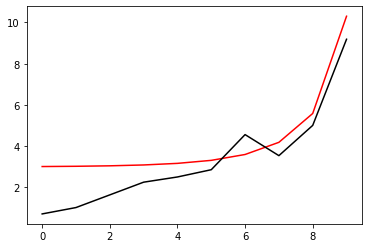

600 89.78138719678617
[0.71904817 1.02729729 1.64101213 2.25679209 2.50997953 2.86180754
 4.56177838 3.54261961 5.00888799 9.18262989]


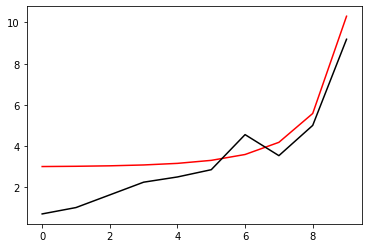

700 89.78136674802285
[0.71918511 1.02717742 1.64062906 2.25664736 2.51072048 2.86249733
 4.56088191 3.54250165 5.00889723 9.18258982]


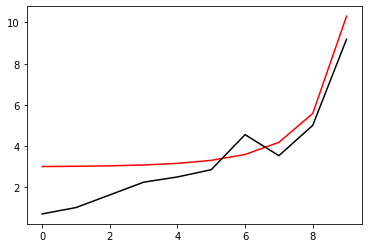

800 89.78134635902086
[0.71932169 1.02705791 1.64024702 2.25650274 2.51145971 2.86318646
 4.55998626 3.54238392 5.00890699 9.18254976]


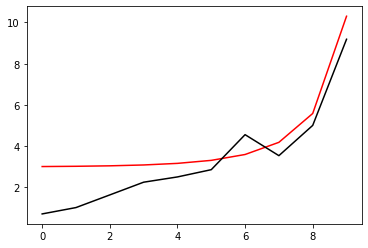

900 89.78132602954672
[0.71945789 1.02693876 1.63986601 2.25635822 2.51219721 2.86387491
 4.5590914  3.54226643 5.00891726 9.18250969]


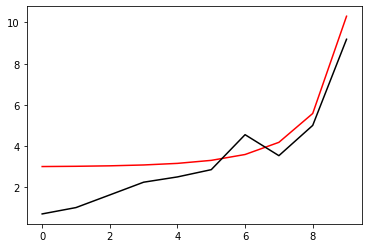

1000 89.78130575936794
[0.71959373 1.02681997 1.63948601 2.2562138  2.51293299 2.8645627
 4.55819735 3.54214917 5.00892804 9.18246962]


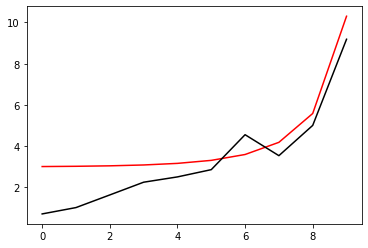

1100 89.78128554825332
[0.71972919 1.02670153 1.63910702 2.25606949 2.51366705 2.86524981
 4.55730411 3.54203215 5.00893932 9.18242956]


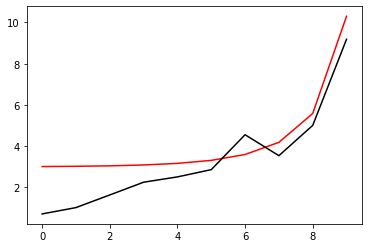

1200 89.78126539597278
[0.71986429 1.02658345 1.63872905 2.25592528 2.5143994  2.86593626
 4.55641166 3.54191536 5.00895111 9.18238949]


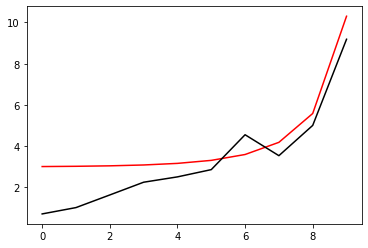

1300 89.78124530229731
[0.71999902 1.02646571 1.63835209 2.25578119 2.51513004 2.86662204
 4.55552001 3.5417988  5.00896341 9.18234943]


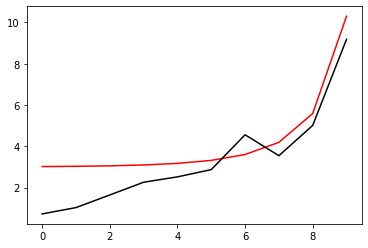

1400 89.7812252669991
[0.72013339 1.02634833 1.63797613 2.2556372  2.51585898 2.86730714
 4.55462917 3.54168247 5.0089762  9.18230936]


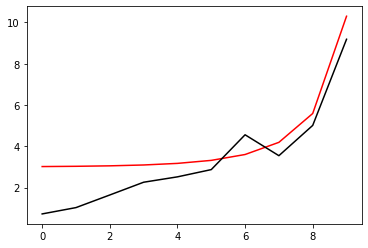

1500 89.78120528985153
[0.72026739 1.0262313  1.63760118 2.25549332 2.51658623 2.86799158
 4.55373912 3.54156638 5.0089895  9.1822693 ]


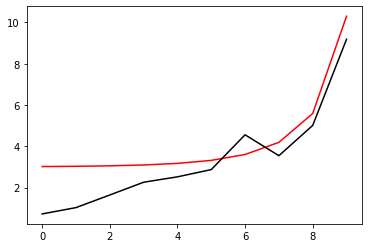

1600 89.78118537062895
[0.72040103 1.02611461 1.63722722 2.25534955 2.51731177 2.86867535
 4.55284987 3.54145051 5.00900331 9.18222924]


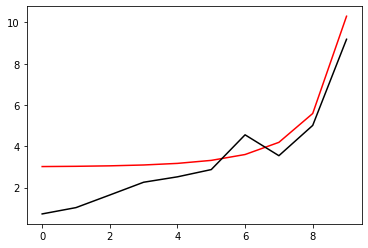

1700 89.78116550910701
[0.7205343  1.02599827 1.63685426 2.25520589 2.51803564 2.86935845
 4.55196142 3.54133487 5.00901761 9.18218917]


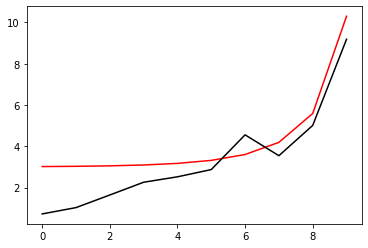

1800 89.7811457050622
[0.72066722 1.02588228 1.63648228 2.25506235 2.51875781 2.87004088
 4.55107376 3.54121946 5.00903241 9.18214911]


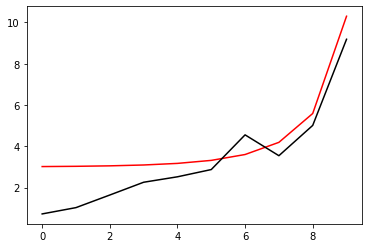

1900 89.78112595827234
[0.72079978 1.02576662 1.6361113  2.25491892 2.51947831 2.87072264
 4.5501869  3.54110427 5.0090477  9.18210905]


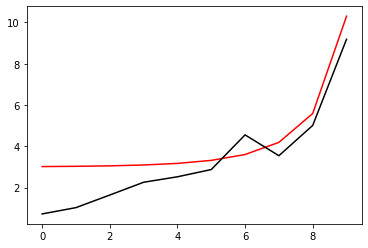

2000 89.7811062685164
[0.72093198 1.02565132 1.63574131 2.25477561 2.52019713 2.87140374
 4.54930083 3.54098932 5.00906349 9.18206899]


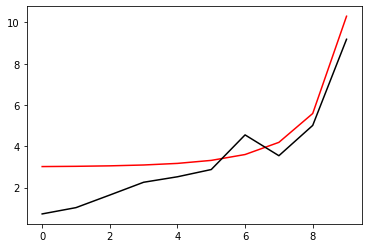

2100 89.78108663557411
[0.72106382 1.02553635 1.63537229 2.25463241 2.52091428 2.87208416
 4.54841555 3.54087458 5.00907978 9.18202893]


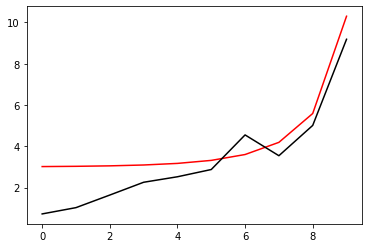

2200 89.78106705922654
[0.72119531 1.02542172 1.63500426 2.25448933 2.52162977 2.87276392
 4.54753107 3.54076008 5.00909655 9.18198887]


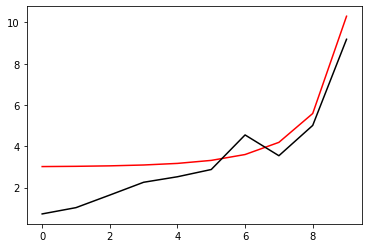

2300 89.78104753925584
[0.72132644 1.02530743 1.6346372  2.25434637 2.52234359 2.87344301
 4.54664738 3.54064579 5.00911382 9.18194881]


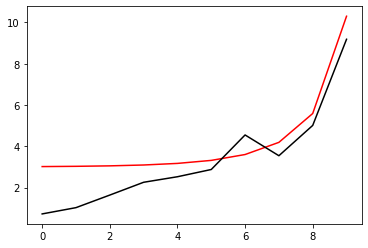

2400 89.78102807544508
[0.72145722 1.02519348 1.63427111 2.25420353 2.52305576 2.87412143
 4.54576448 3.54053173 5.00913158 9.18190875]


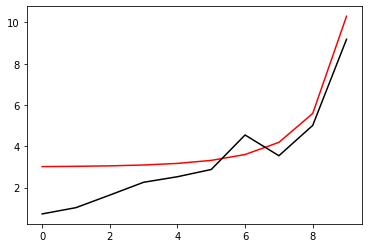

2500 89.78100866757852
[0.72158765 1.02507986 1.63390599 2.25406081 2.52376627 2.87479918
 4.54488236 3.54041789 5.00914983 9.18186869]


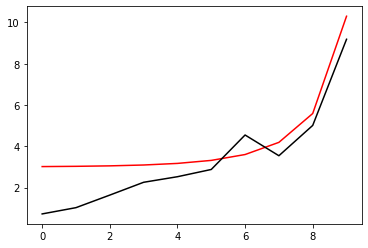

2600 89.7809893154414
[0.72171773 1.02496657 1.63354184 2.2539182  2.52447513 2.87547627
 4.54400104 3.54030428 5.00916857 9.18182863]


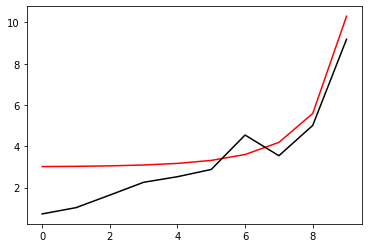

2700 89.78097001882007
[0.72184745 1.02485362 1.63317865 2.25377573 2.52518236 2.87615269
 4.5431205  3.54019088 5.00918779 9.18178858]


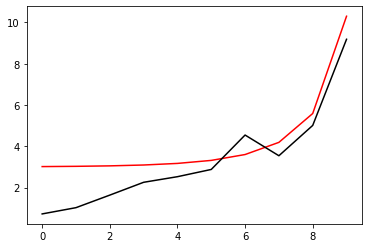

2800 89.78095077750183
[0.72197683 1.024741   1.63281642 2.25363337 2.52588794 2.87682844
 4.54224075 3.54007771 5.0092075  9.18174852]


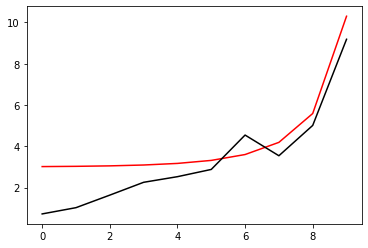

2900 89.78093159127509
[0.72210586 1.02462872 1.63245514 2.25349114 2.52659188 2.87750352
 4.54136178 3.53996475 5.00922769 9.18170846]


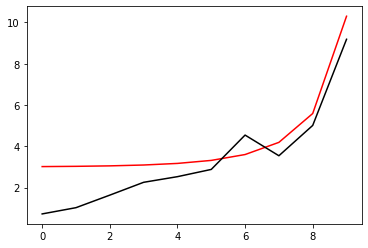

3000 89.7809124599293
[0.72223454 1.02451676 1.63209482 2.25334903 2.5272942  2.87817793
 4.5404836  3.53985201 5.00924836 9.18166841]


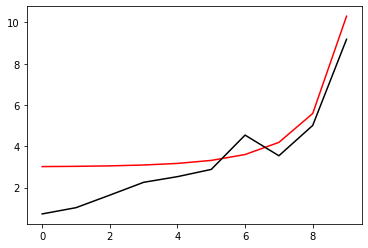

3100 89.78089338325483
[0.72236288 1.02440512 1.63173545 2.25320706 2.52799489 2.87885168
 4.5396062  3.53973949 5.00926952 9.18162835]


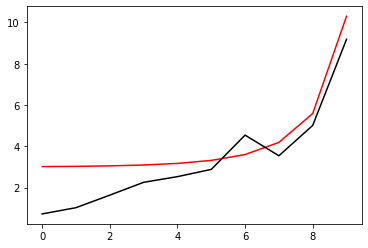

3200 89.7808743610432
[0.72249087 1.02429382 1.63137703 2.2530652  2.52869396 2.87952476
 4.53872959 3.53962718 5.00929115 9.1815883 ]


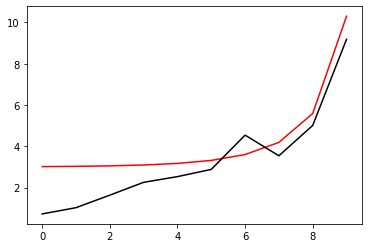

3300 89.7808553930869
[0.72261853 1.02418284 1.63101955 2.25292348 2.52939141 2.88019718
 4.53785375 3.53951509 5.00931327 9.18154825]


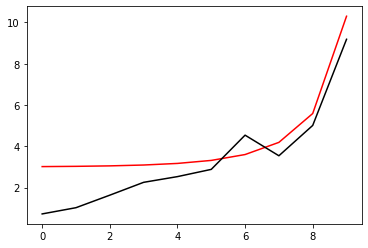

3400 89.78083647917937
[0.72274583 1.02407218 1.63066302 2.25278188 2.53008725 2.88086892
 4.5369787  3.53940322 5.00933586 9.18150819]


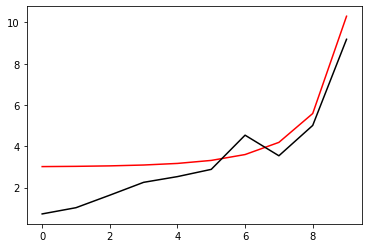

3500 89.78081761911507
[0.7228728  1.02396184 1.63030742 2.25264042 2.53078148 2.88154001
 4.53610443 3.53929156 5.00935893 9.18146814]


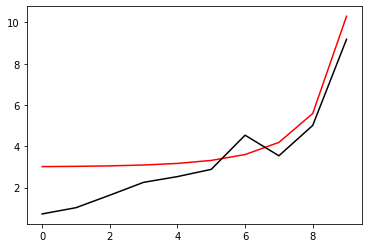

3600 89.7807988126895
[0.72299943 1.02385183 1.62995275 2.25249908 2.5314741  2.88221042
 4.53523094 3.53918011 5.00938247 9.18142809]


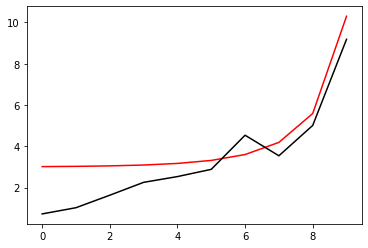

3700 89.78078005969914
[0.72312572 1.02374214 1.62959902 2.25235788 2.53216513 2.88288017
 4.53435822 3.53906888 5.00940649 9.18138804]


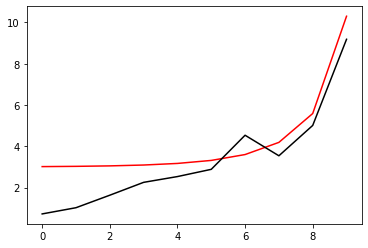

3800 89.7807613599414
[0.72325167 1.02363276 1.62924621 2.25221681 2.53285456 2.88354925
 4.53348628 3.53895786 5.00943098 9.18134799]


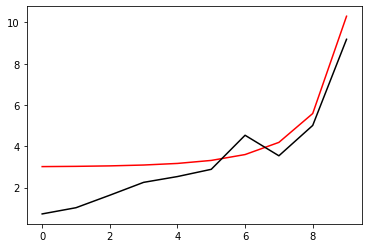

3900 89.78074271321464
[0.72337729 1.02352371 1.62889434 2.25207587 2.5335424  2.88421767
 4.53261512 3.53884705 5.00945594 9.18130794]


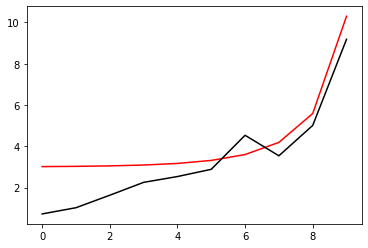

4000 89.78072411931832
[0.72350257 1.02341497 1.62854338 2.25193506 2.53422865 2.88488542
 4.53174473 3.53873645 5.00948137 9.18126789]


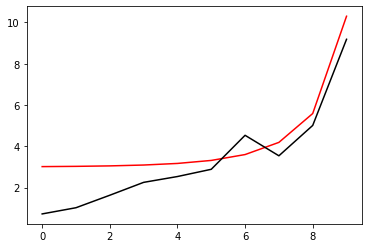

4100 89.78070557805279
[0.72362751 1.02330654 1.62819335 2.2517944  2.53491332 2.8855525
 4.53087512 3.53862607 5.00950727 9.18122784]


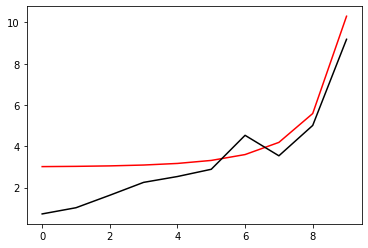

4200 89.78068708921927
[0.72375212 1.02319843 1.62784423 2.25165386 2.53559641 2.88621892
 4.53000628 3.53851589 5.00953363 9.18118779]


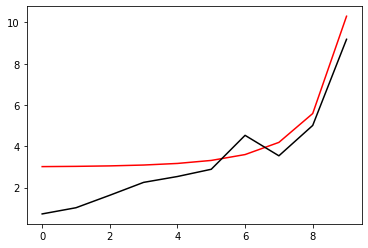

4300 89.78066865262014
[0.7238764  1.02309063 1.62749602 2.25151347 2.53627792 2.88688468
 4.52913821 3.53840591 5.00956047 9.18114774]


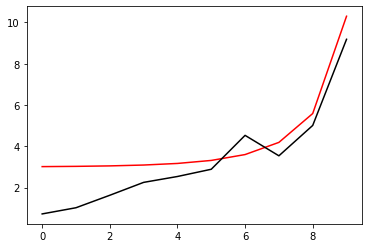

4400 89.78065026805848
[0.72400035 1.02298314 1.62714873 2.25137321 2.53695787 2.88754977
 4.52827092 3.53829615 5.00958776 9.18110769]


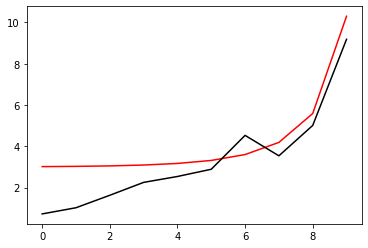

4500 89.78063193533855
[0.72412397 1.02287597 1.62680234 2.25123309 2.53763624 2.88821419
 4.5274044  3.53818659 5.00961553 9.18106765]


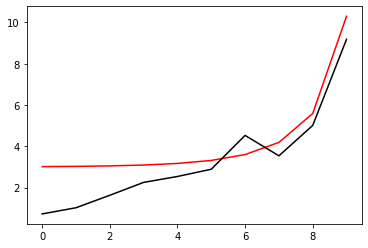

4600 89.78061365426537
[0.72424726 1.0227691  1.62645686 2.25109311 2.53831306 2.88887795
 4.52653864 3.53807724 5.00964375 9.1810276 ]


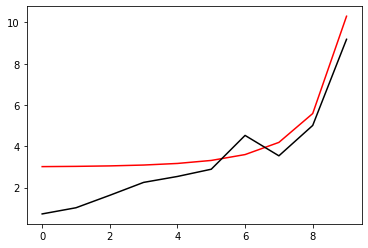

4700 89.78059542464504
[0.72437022 1.02266254 1.62611228 2.25095326 2.53898832 2.88954105
 4.52567366 3.5379681  5.00967244 9.18098756]


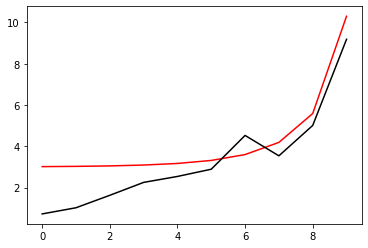

4800 89.7805772462844
[0.72449286 1.02255628 1.6257686  2.25081356 2.53966203 2.89020348
 4.52480944 3.53785916 5.00970159 9.18094751]


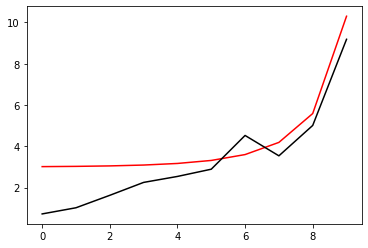

4900 89.78055911899132
[0.72461516 1.02245033 1.62542582 2.250674   2.54033419 2.89086525
 4.52394599 3.53775042 5.00973119 9.18090747]


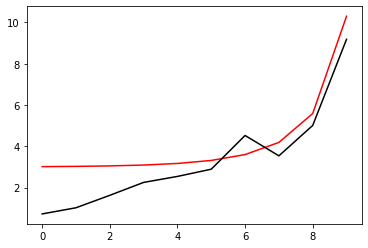

5000 89.78054104257464
[0.72473715 1.02234469 1.62508393 2.25053459 2.5410048  2.89152635
 4.52308331 3.53764189 5.00976126 9.18086743]


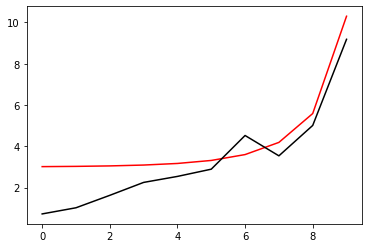

5100 89.78052301684399
[0.72485881 1.02223935 1.62474293 2.25039531 2.54167387 2.89218679
 4.52222139 3.53753356 5.00979178 9.18082738]


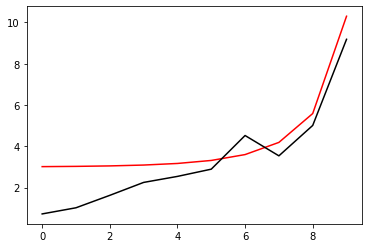

5200 89.78050504161003
[0.72498015 1.02213431 1.62440282 2.25025618 2.5423414  2.89284656
 4.52136023 3.53742543 5.00982276 9.18078734]


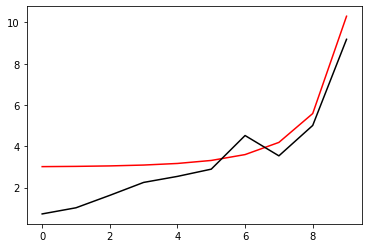

5300 89.7804871166842
[0.72510116 1.02202957 1.62406359 2.25011719 2.54300741 2.89350568
 4.52049984 3.5373175  5.00985419 9.1807473 ]


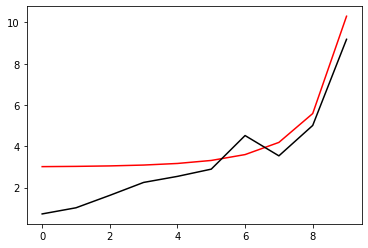

5400 89.78046924187886
[0.72522186 1.02192513 1.62372525 2.24997835 2.54367188 2.89416412
 4.51964022 3.53720978 5.00988607 9.18070726]


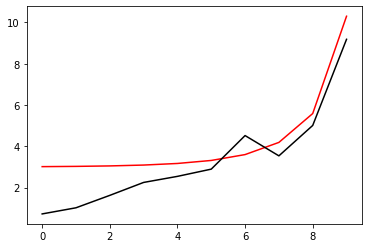

5500 89.78045141700727
[0.72534223 1.02182099 1.62338778 2.24983966 2.54433483 2.89482191
 4.51878135 3.53710225 5.00991841 9.18066722]


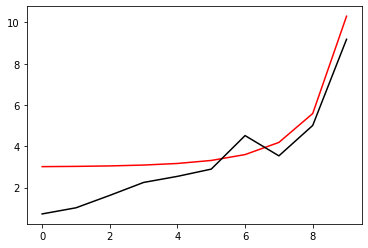

5600 89.78043364188373
[0.72546229 1.02171715 1.62305119 2.24970111 2.54499626 2.89547903
 4.51792325 3.53699492 5.0099512  9.18062718]


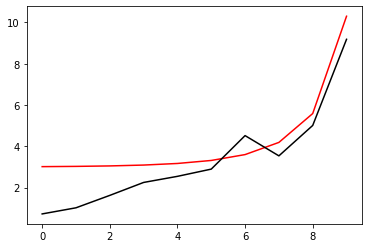

5700 89.78041591632302
[0.72558203 1.0216136  1.62271548 2.24956271 2.54565617 2.89613549
 4.5170659  3.53688779 5.00998443 9.18058715]


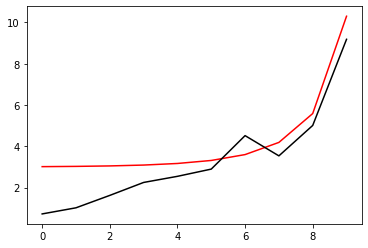

5800 89.7803982401413
[0.72570145 1.02151035 1.62238063 2.24942446 2.54631457 2.89679129
 4.51620932 3.53678086 5.01001812 9.18054711]


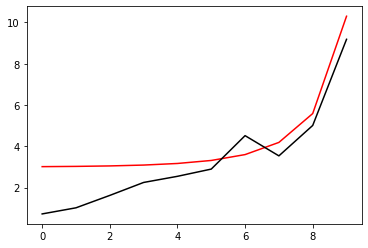

5900 89.7803806131552
[0.72582056 1.02140739 1.62204666 2.24928635 2.54697147 2.89744642
 4.51535349 3.53667412 5.01005225 9.18050707]


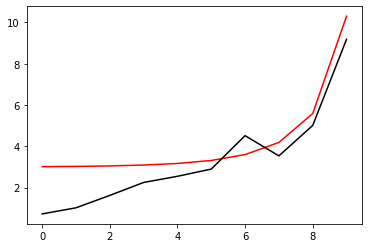

6000 89.78036303518233
[0.72593935 1.02130473 1.62171355 2.2491484  2.54762686 2.89810089
 4.51449842 3.53656758 5.01008683 9.18046704]


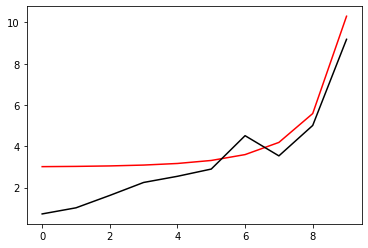

6100 89.7803455060413
[0.72605783 1.02120235 1.6213813  2.24901059 2.54828074 2.8987547
 4.5136441  3.53646124 5.01012186 9.180427  ]


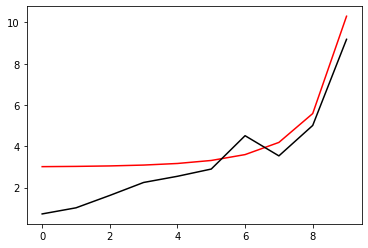

6200 89.78032802555134
[0.72617599 1.02110027 1.62104991 2.24887294 2.54893314 2.89940785
 4.51279055 3.53635509 5.01015733 9.18038697]


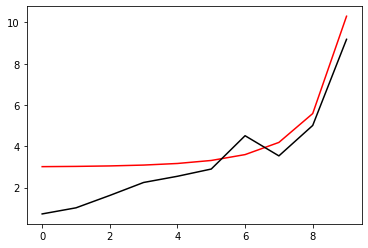

6300 89.78031059353277
[0.72629384 1.02099848 1.62071938 2.24873544 2.54958404 2.90006034
 4.51193774 3.53624913 5.01019324 9.18034693]


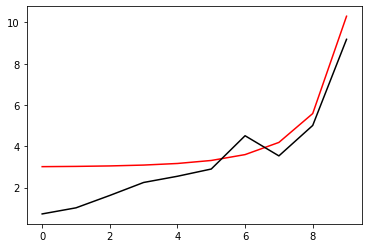

6400 89.78029320980652
[0.72641139 1.02089697 1.6203897  2.24859809 2.55023345 2.90071216
 4.51108569 3.53614337 5.01022959 9.1803069 ]


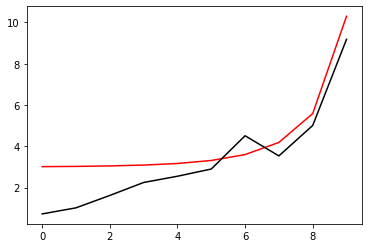

6500 89.78027587419449
[0.72652862 1.02079576 1.62006087 2.24846089 2.55088138 2.90136333
 4.5102344  3.5360378  5.01026639 9.18026687]


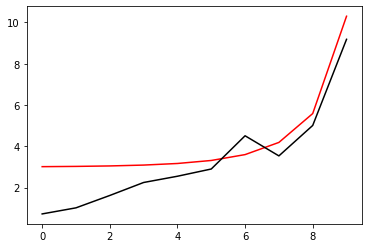

6600 89.78025858651937
[0.72664554 1.02069482 1.6197329  2.24832384 2.55152783 2.90201383
 4.50938385 3.53593242 5.01030362 9.18022683]


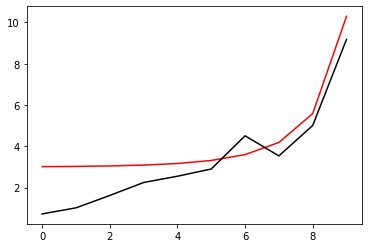

6700 89.7802413466048
[0.72676216 1.02059418 1.61940577 2.24818695 2.55217281 2.90266367
 4.50853406 3.53582723 5.01034129 9.1801868 ]


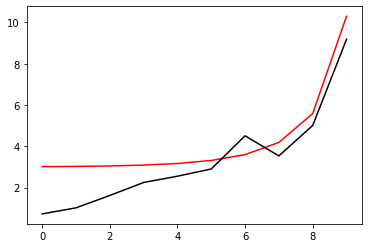

6800 89.78022415427503
[0.72687847 1.02049382 1.61907948 2.24805022 2.55281631 2.90331286
 4.50768502 3.53572224 5.0103794  9.18014677]


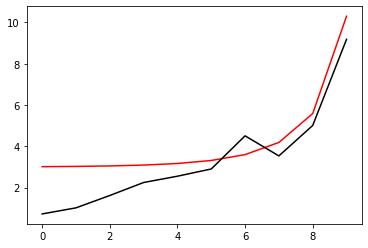

6900 89.78020700935531
[0.72699447 1.02039374 1.61875403 2.24791364 2.55345834 2.90396138
 4.50683672 3.53561743 5.01041795 9.18010674]


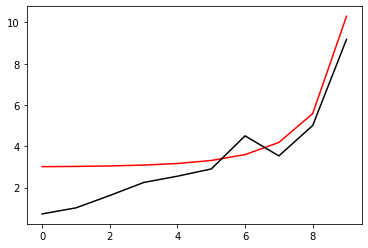

7000 89.78018991167161
[0.72711017 1.02029394 1.61842942 2.24777722 2.55409891 2.90460924
 4.50598918 3.53551282 5.01045693 9.18006672]


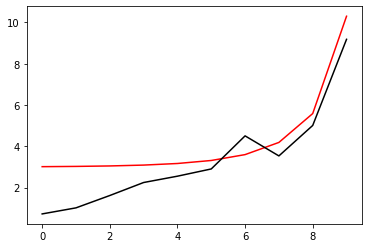

7100 89.78017286105073
[0.72722557 1.02019442 1.61810565 2.24764095 2.55473802 2.90525644
 4.50514238 3.53540839 5.01049634 9.18002669]


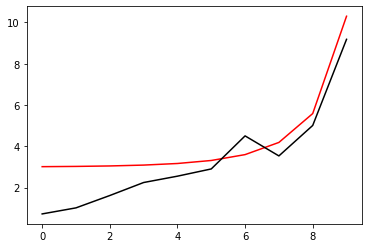

7200 89.7801558573203
[0.72734066 1.02009519 1.61778271 2.24750484 2.55537568 2.90590298
 4.50429633 3.53530415 5.01053619 9.17998666]


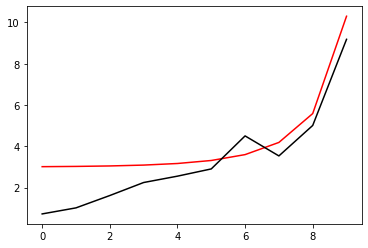

7300 89.7801389003087
[0.72745545 1.01999623 1.6174606  2.24736888 2.55601188 2.90654886
 4.50345103 3.5352001  5.01057647 9.17994663]


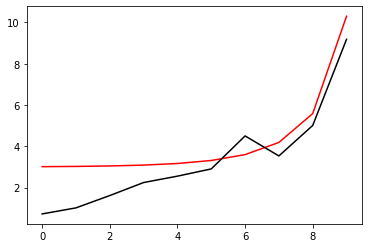

7400 89.78012198984517
[0.72756994 1.01989755 1.61713932 2.24723309 2.55664663 2.90719408
 4.50260647 3.53509623 5.01061718 9.17990661]


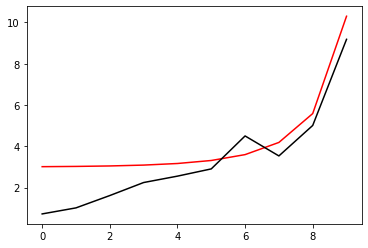

7500 89.78010512575972
[0.72768413 1.01979914 1.61681886 2.24709745 2.55727994 2.90783865
 4.50176265 3.53499255 5.01065831 9.17986658]


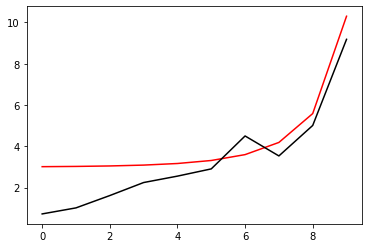

7600 89.78008830788309
[0.72779802 1.01970102 1.61649923 2.24696198 2.55791181 2.90848255
 4.50091958 3.53488906 5.01069988 9.17982656]


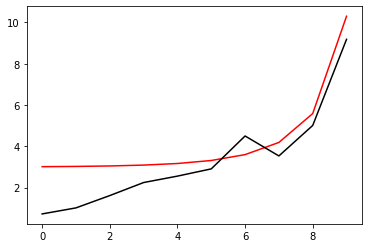

7700 89.78007153604689
[0.72791161 1.01960316 1.61618042 2.24682666 2.55854224 2.90912579
 4.50007725 3.53478575 5.01074188 9.17978654]


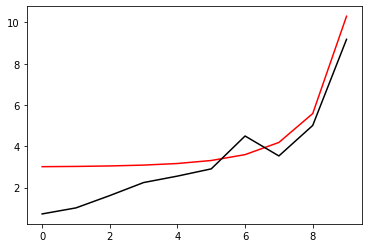

7800 89.7800548100835
[0.7280249  1.01950558 1.61586242 2.24669151 2.55917124 2.90976838
 4.49923567 3.53468262 5.0107843  9.17974651]


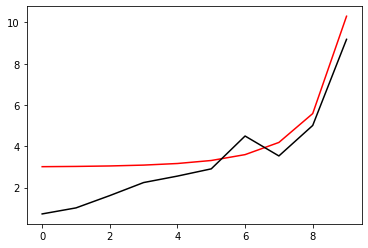

7900 89.78003812982598
[0.7281379  1.01940828 1.61554524 2.24655651 2.5597988  2.91041031
 4.49839482 3.53457968 5.01082714 9.17970649]


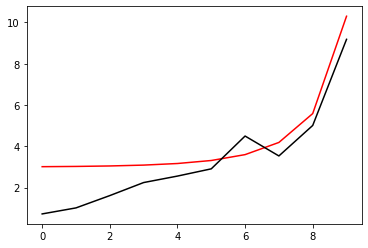

8000 89.78002149510826
[0.7282506  1.01931124 1.61522887 2.24642168 2.56042495 2.91105158
 4.49755471 3.53447692 5.01087041 9.17966647]


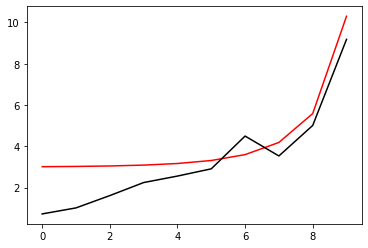

8100 89.78000490576497
[0.72836301 1.01921448 1.61491331 2.24628701 2.56104967 2.91169219
 4.49671535 3.53437434 5.0109141  9.17962645]


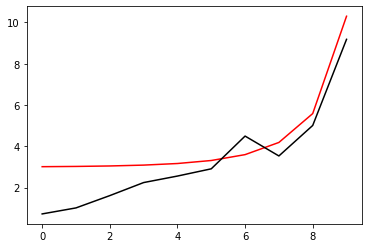

8200 89.77998836163157
[0.72847512 1.01911798 1.61459856 2.2461525  2.56167298 2.91233215
 4.49587672 3.53427194 5.01095822 9.17958643]


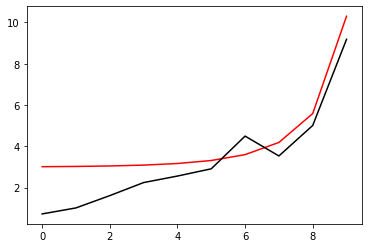

8300 89.77997186254419
[0.72858694 1.01902175 1.61428461 2.24601816 2.56229487 2.91297144
 4.49503882 3.53416973 5.01100275 9.17954641]


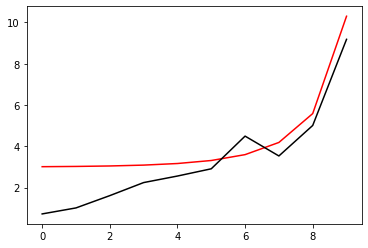

8400 89.77995540833983
[0.72869847 1.01892579 1.61397146 2.24588397 2.56291535 2.91361008
 4.49420167 3.53406769 5.01104771 9.1795064 ]


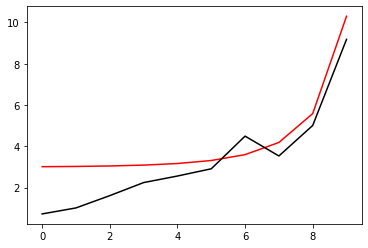

8500 89.77993899885603
[0.7288097  1.0188301  1.61365912 2.24574996 2.56353442 2.91424807
 4.49336525 3.53396584 5.01109308 9.17946638]


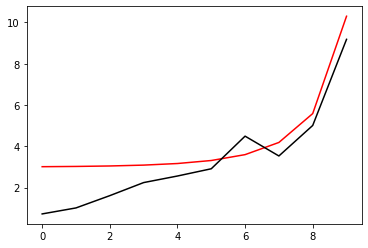

8600 89.77992263393129
[0.72892065 1.01873467 1.61334757 2.24561611 2.56415209 2.91488539
 4.49252956 3.53386416 5.01113887 9.17942636]


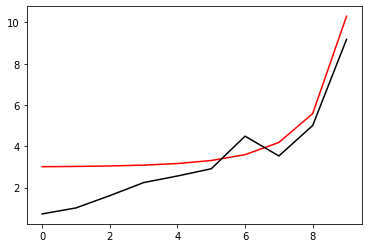

8700 89.77990631340484
[0.72903131 1.01863951 1.61303681 2.24548242 2.56476837 2.91552206
 4.49169461 3.53376266 5.01118508 9.17938635]


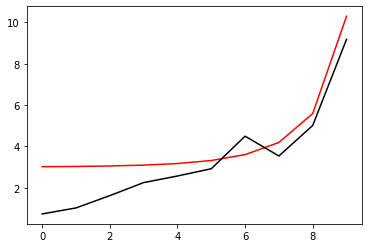

8800 89.77989003711646
[0.72914168 1.01854461 1.61272685 2.2453489  2.56538324 2.91615807
 4.4908604  3.53366134 5.0112317  9.17934633]


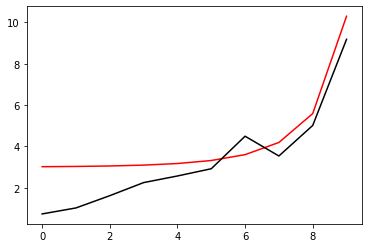

8900 89.77987380490686
[0.72925176 1.01844997 1.61241768 2.24521554 2.56599673 2.91679343
 4.49002691 3.53356019 5.01127874 9.17930632]


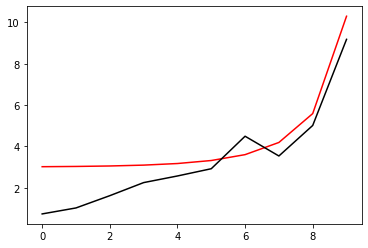

9000 89.7798576166173
[0.72936156 1.0183556  1.61210929 2.24508236 2.56660883 2.91742813
 4.48919416 3.53345923 5.01132619 9.17926631]


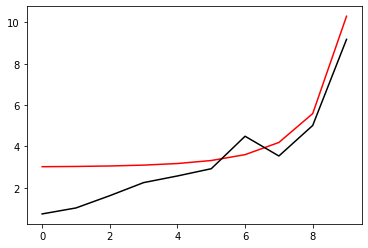

9100 89.77984147208996
[0.72947106 1.01826148 1.61180169 2.24494933 2.56721955 2.91806218
 4.48836213 3.53335843 5.01137406 9.1792263 ]


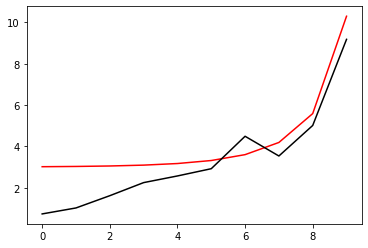

9200 89.77982537116759
[0.72958029 1.01816763 1.61149487 2.24481648 2.56782888 2.91869557
 4.48753084 3.53325782 5.01142233 9.17918628]


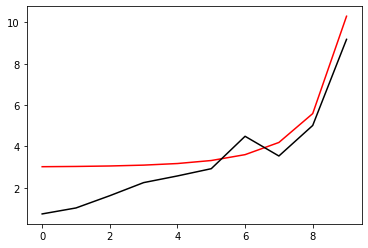

9300 89.7798093136937
[0.72968923 1.01807403 1.61118884 2.2446838  2.56843684 2.9193283
 4.48670027 3.53315737 5.01147102 9.17914627]


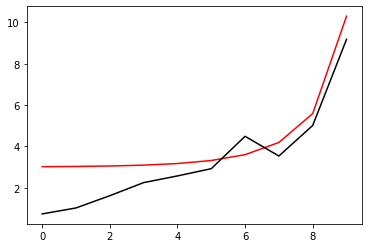

9400 89.77979329951249
[0.72979789 1.0179807  1.61088358 2.24455128 2.56904343 2.91996038
 4.48587044 3.5330571  5.01152011 9.17910627]


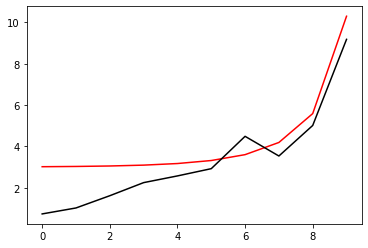

9500 89.77977732846892
[0.72990626 1.01788761 1.61057909 2.24441893 2.56964864 2.92059181
 4.48504133 3.53295701 5.01156961 9.17906626]


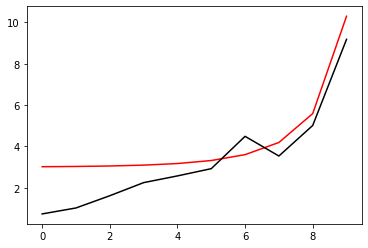

9600 89.77976140040866
[0.73001436 1.01779479 1.61027538 2.24428675 2.57025249 2.92122258
 4.48421295 3.53285708 5.01161952 9.17902625]


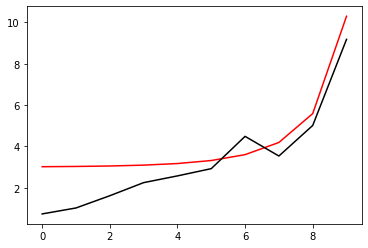

9700 89.77974551517799
[0.73012217 1.01770222 1.60997244 2.24415475 2.57085498 2.9218527
 4.48338529 3.53275733 5.01166984 9.17898624]


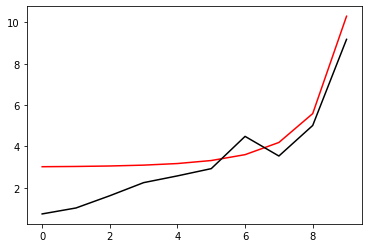

9800 89.77972967262387
[0.73022971 1.0176099  1.60967026 2.24402291 2.57145612 2.92248216
 4.48255836 3.53265775 5.01172056 9.17894624]


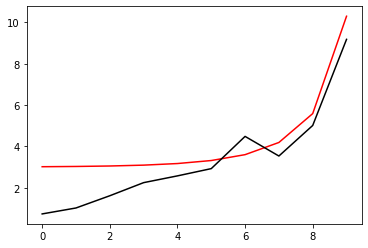

9900 89.77971387259416
[0.73033696 1.01751784 1.60936886 2.24389124 2.57205589 2.92311097
 4.48173215 3.53255834 5.01177168 9.17890623]


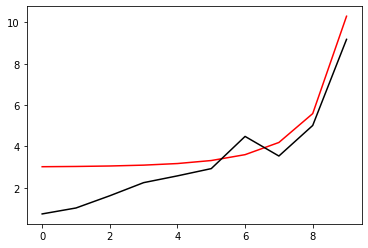

10000 89.7796981149372
[0.73044394 1.01742603 1.60906821 2.24375975 2.57265432 2.92373912
 4.48090666 3.5324591  5.01182321 9.17886623]


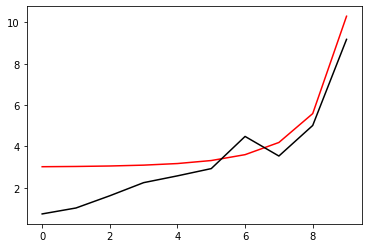

In [22]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.77968239950208
[0.73055064 1.01733447 1.60876833 2.24362842 2.5732514  2.92436663
 4.4800819  3.53236004 5.01187514 9.17882622]


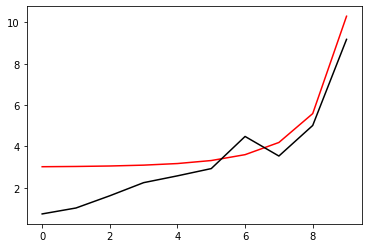

200 89.7796667261386
[0.73065706 1.01724316 1.6084692  2.24349727 2.57384713 2.92499348
 4.47925785 3.53226113 5.01192747 9.17878622]


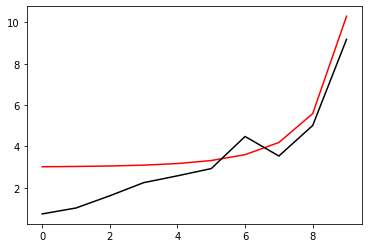

300 89.77965109469719
[0.73076321 1.0171521  1.60817083 2.24336629 2.57444153 2.92561967
 4.47843453 3.5321624  5.01198021 9.17874622]


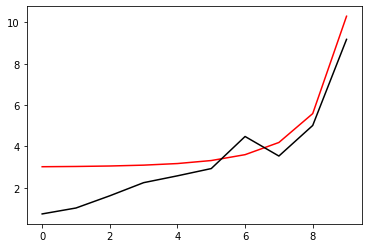

400 89.77963550502893
[0.73086908 1.01706129 1.60787322 2.24323548 2.57503459 2.92624522
 4.47761193 3.53206384 5.01203334 9.17870622]


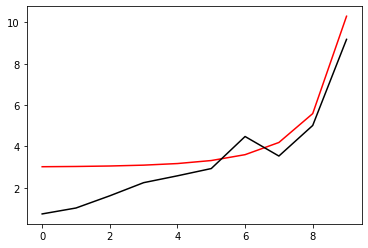

500 89.77961995698564
[0.73097468 1.01697072 1.60757636 2.24310485 2.57562632 2.92687011
 4.47679005 3.53196544 5.01208686 9.17866622]


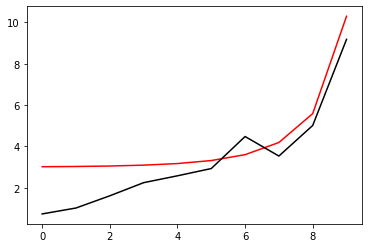

600 89.7796044504199
[0.73108001 1.0168804  1.60728024 2.24297439 2.57621671 2.92749435
 4.47596888 3.53186721 5.01214079 9.17862622]


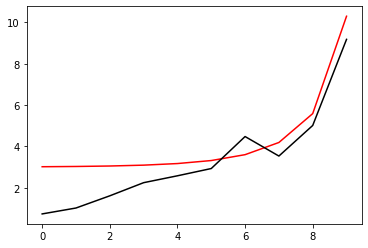

700 89.77958898518457
[0.73118507 1.01679033 1.60698488 2.24284411 2.57680578 2.92811794
 4.47514844 3.53176915 5.01219511 9.17858622]


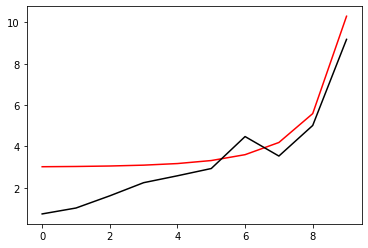

800 89.77957356113365
[0.73128985 1.01670051 1.60669025 2.24271399 2.57739353 2.92874087
 4.4743287  3.53167125 5.01224983 9.17854623]


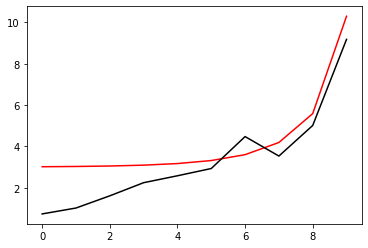

900 89.77955817812152
[0.73139436 1.01661092 1.60639637 2.24258406 2.57797996 2.92936316
 4.47350969 3.53157351 5.01230494 9.17850623]


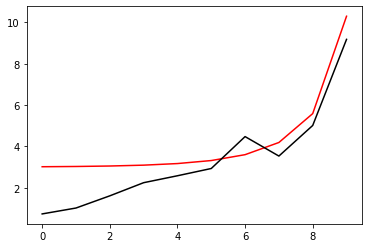

1000 89.77954283600313
[0.73149861 1.01652158 1.60610324 2.2424543  2.57856508 2.92998479
 4.47269139 3.53147594 5.01236044 9.17846624]


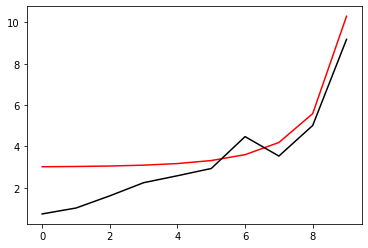

1100 89.77952753463435
[0.73160258 1.01643249 1.60581083 2.24232471 2.57914888 2.93060578
 4.4718738  3.53137854 5.01241634 9.17842624]


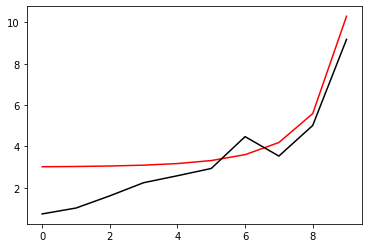

1200 89.77951227387152
[0.73170629 1.01634363 1.60551917 2.2421953  2.57973137 2.93122611
 4.47105693 3.53128129 5.01247263 9.17838625]


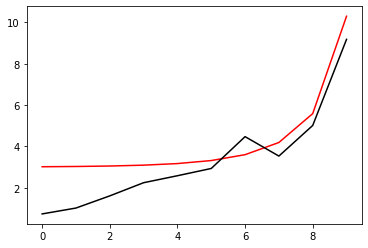

1300 89.77949705357167
[0.73180973 1.01625502 1.60522824 2.24206606 2.58031256 2.93184579
 4.47024077 3.53118421 5.01252931 9.17834626]


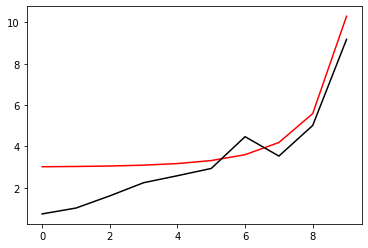

1400 89.77948187359239
[0.7319129  1.01616664 1.60493804 2.24193701 2.58089245 2.93246483
 4.46942532 3.5310873  5.01258637 9.17830627]


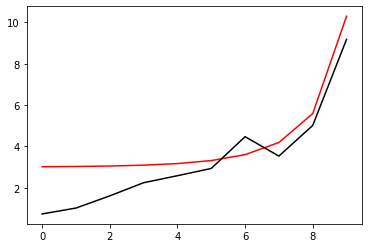

1500 89.77946673379202
[0.73201581 1.01607851 1.60464857 2.24180813 2.58147104 2.93308321
 4.46861058 3.53099054 5.01264383 9.17826627]


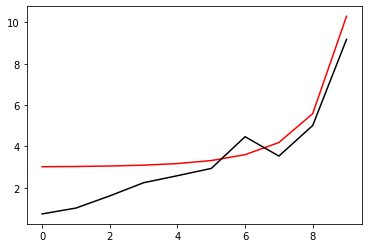

1600 89.77945163402939
[0.73211845 1.01599061 1.60435982 2.24167942 2.58204834 2.93370095
 4.46779655 3.53089394 5.01270167 9.17822629]


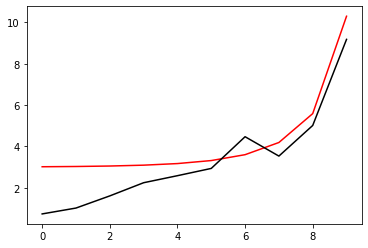

1700 89.77943657416412
[0.73222083 1.01590295 1.6040718  2.2415509  2.58262435 2.93431803
 4.46698323 3.53079751 5.0127599  9.1781863 ]


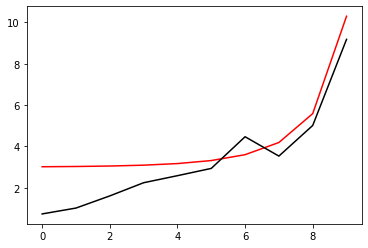

1800 89.77942155405633
[0.73232295 1.01581552 1.60378451 2.24142255 2.58319907 2.93493447
 4.46617062 3.53070123 5.01281851 9.17814631]


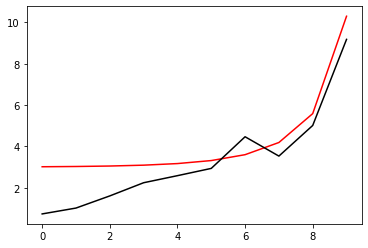

1900 89.77940657356687
[0.7324248  1.01572833 1.60349793 2.24129438 2.5837725  2.93555026
 4.46535871 3.53060511 5.01287751 9.17810632]


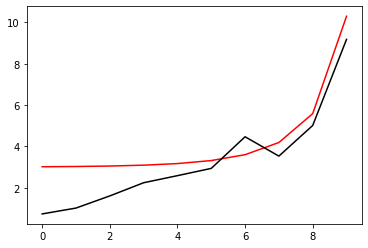

2000 89.77939163255706
[0.73252639 1.01564138 1.60321207 2.24116638 2.58434465 2.9361654
 4.46454752 3.53050915 5.01293689 9.17806634]


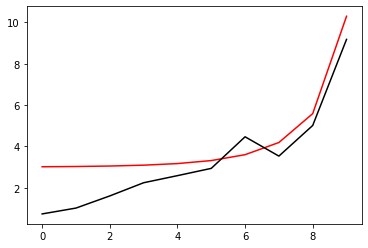

2100 89.77937673088896
[0.73262772 1.01555466 1.60292693 2.24103857 2.58491553 2.93677989
 4.46373702 3.53041335 5.01299666 9.17802635]


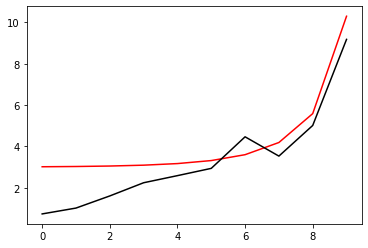

2200 89.77936186842508
[0.73272879 1.01546817 1.6026425  2.24091094 2.58548513 2.93739373
 4.46292724 3.53031771 5.0130568  9.17798637]


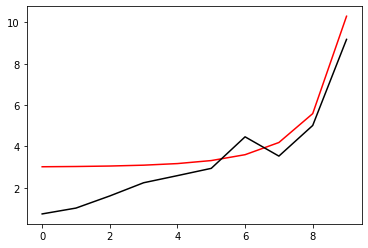

2300 89.7793470450288
[0.7328296  1.01538191 1.60235878 2.24078348 2.58605347 2.93800693
 4.46211816 3.53022222 5.01311733 9.17794639]


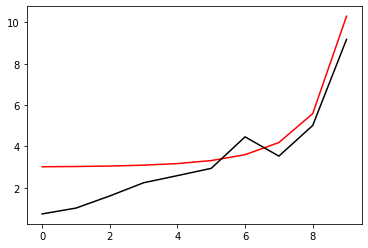

2400 89.77933226056388
[0.73293015 1.01529589 1.60207577 2.24065621 2.58662053 2.93861948
 4.46130978 3.53012689 5.01317824 9.1779064 ]


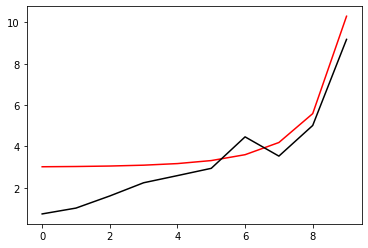

2500 89.77931751489471
[0.73303045 1.01521009 1.60179347 2.24052911 2.58718634 2.93923138
 4.4605021  3.53003172 5.01323952 9.17786642]


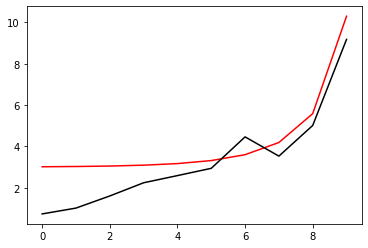

2600 89.77930280788635
[0.73313049 1.01512453 1.60151188 2.2404022  2.58775088 2.93984263
 4.45969513 3.5299367  5.01330118 9.17782644]


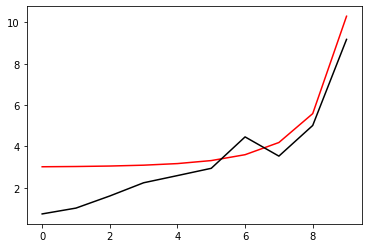

2700 89.77928813940441
[0.73323027 1.01503919 1.60123099 2.24027546 2.58831416 2.94045324
 4.45888885 3.52984183 5.01336322 9.17778646]


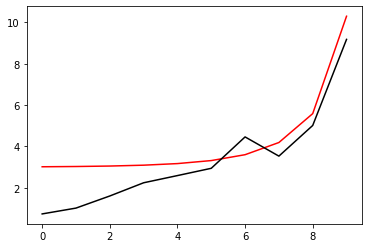

2800 89.77927350931513
[0.73332979 1.01495408 1.60095079 2.24014891 2.58887619 2.94106321
 4.45808328 3.52974712 5.01342564 9.17774649]


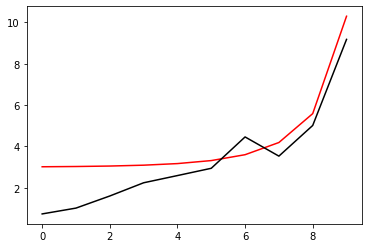

2900 89.77925891748524
[0.73342906 1.0148692  1.6006713  2.24002254 2.58943698 2.94167252
 4.45727841 3.52965257 5.01348843 9.17770651]


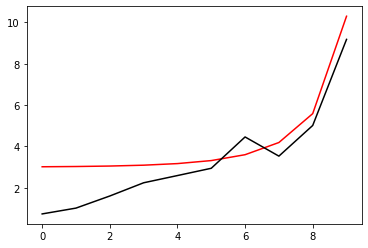

3000 89.77924436378225
[0.73352808 1.01478455 1.60039251 2.23989635 2.58999651 2.94228119
 4.45647423 3.52955816 5.01355159 9.17766653]


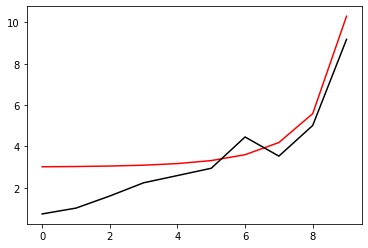

3100 89.77922984807397
[0.73362685 1.01470012 1.60011441 2.23977034 2.5905548  2.94288922
 4.45567075 3.52946391 5.01361513 9.17762656]


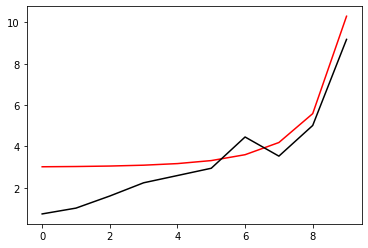

3200 89.779215370229
[0.73372536 1.01461591 1.599837   2.23964451 2.59111185 2.9434966
 4.45486797 3.52936981 5.01367904 9.17758658]


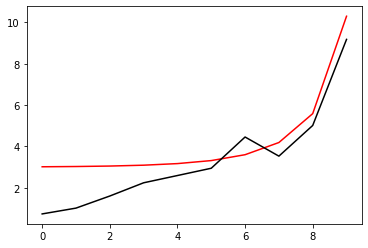

3300 89.77920093011646
[0.73382362 1.01453193 1.59956028 2.23951886 2.59166767 2.94410334
 4.45406589 3.52927586 5.01374332 9.17754661]


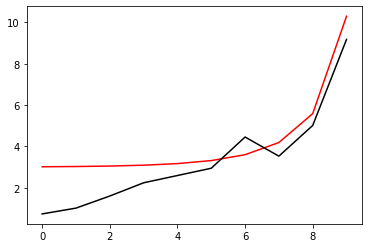

3400 89.779186527606
[0.73392162 1.01444817 1.59928425 2.2393934  2.59222225 2.94470943
 4.4532645  3.52918207 5.01380797 9.17750664]


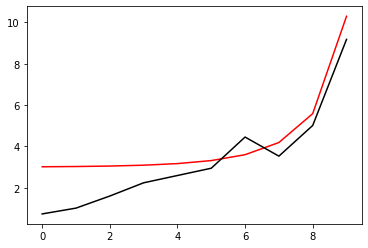

3500 89.77917216256789
[0.73401938 1.01436464 1.59900891 2.23926812 2.5927756  2.94531488
 4.45246381 3.52908842 5.01387299 9.17746667]


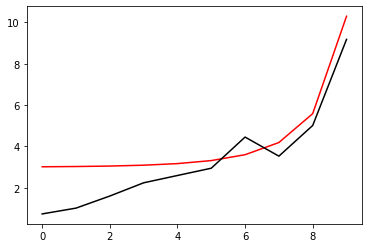

3600 89.77915783487295
[0.73411689 1.01428133 1.59873425 2.23914302 2.59332772 2.94591968
 4.45166381 3.52899492 5.01393838 9.1774267 ]


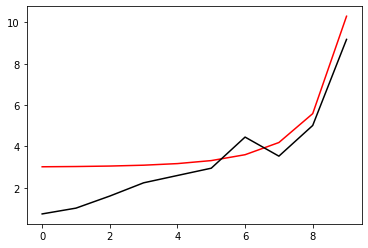

3700 89.77914354439255
[0.73421415 1.01419823 1.59846028 2.23901811 2.59387862 2.94652384
 4.4508645  3.52890157 5.01400414 9.17738673]


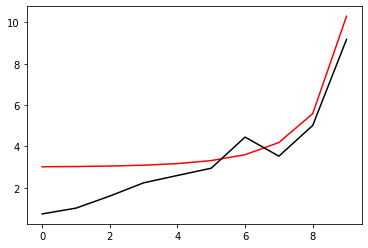

3800 89.77912929099861
[0.73431116 1.01411536 1.59818698 2.23889338 2.5944283  2.94712736
 4.45006589 3.52880838 5.01407026 9.17734676]


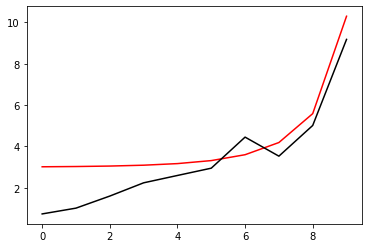

3900 89.77911507456369
[0.73440793 1.01403271 1.59791436 2.23876883 2.59497676 2.94773023
 4.44926796 3.52871532 5.01413675 9.17730679]


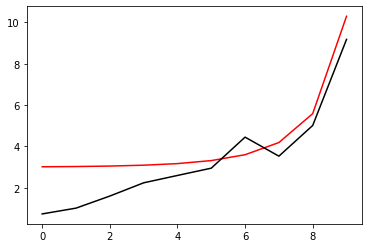

4000 89.77910089496076
[0.73450444 1.01395028 1.59764242 2.23864447 2.59552401 2.94833247
 4.44847073 3.52862242 5.01420361 9.17726683]


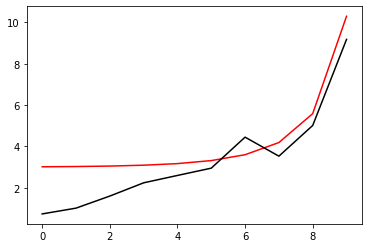

4100 89.77908675206348
[0.73460072 1.01386806 1.59737116 2.23852029 2.59607005 2.94893405
 4.44767419 3.52852967 5.01427082 9.17722686]


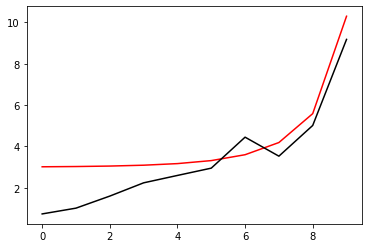

4200 89.77907264574588
[0.73469674 1.01378606 1.59710056 2.23839629 2.59661488 2.949535
 4.44687834 3.52843706 5.01433841 9.1771869 ]


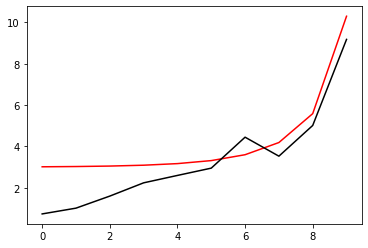

4300 89.77905857588276
[0.73479253 1.01370428 1.59683064 2.23827248 2.5971585  2.95013531
 4.44608317 3.52834459 5.01440635 9.17714694]


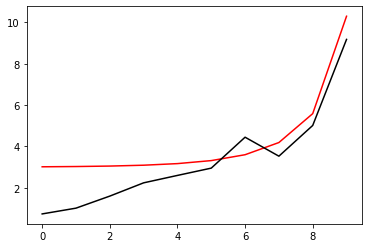

4400 89.77904454234934
[0.73488806 1.01362271 1.59656138 2.23814885 2.59770093 2.95073497
 4.44528869 3.52825228 5.01447466 9.17710697]


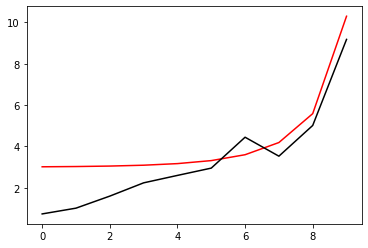

4500 89.77903054502134
[0.73498336 1.01354136 1.59629279 2.23802541 2.59824215 2.95133399
 4.4444949  3.5281601  5.01454332 9.17706701]


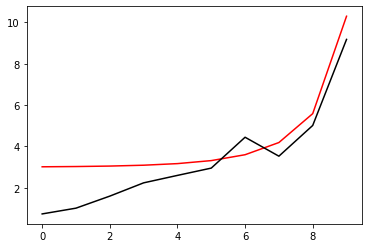

4600 89.7790165837751
[0.73507841 1.01346022 1.59602487 2.23790216 2.59878218 2.95193238
 4.4437018  3.52806808 5.01461235 9.17702705]


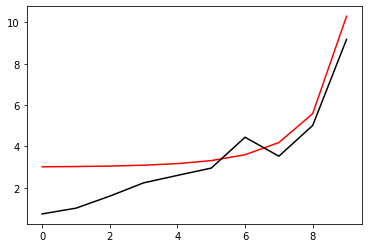

4700 89.77900265848746
[0.73517322 1.01337929 1.5957576  2.23777908 2.59932102 2.95253012
 4.44290938 3.52797619 5.01468173 9.1769871 ]


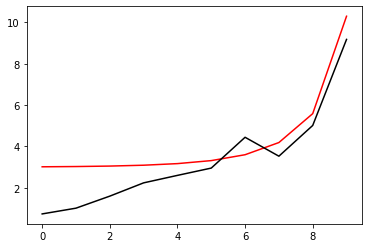

4800 89.77898876903573
[0.73526779 1.01329858 1.595491   2.2376562  2.59985867 2.95312722
 4.44211765 3.52788445 5.01475147 9.17694714]


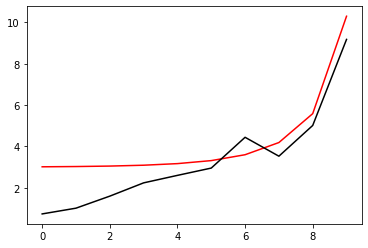

4900 89.77897491529788
[0.73536213 1.01321808 1.59522506 2.2375335  2.60039514 2.95372368
 4.4413266  3.52779286 5.01482157 9.17690718]


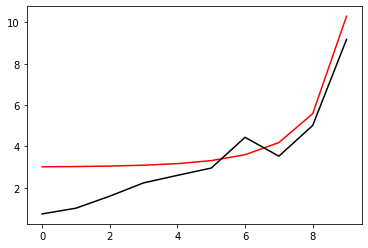

5000 89.77896109715229
[0.73545622 1.01313778 1.59495977 2.23741098 2.60093042 2.9543195
 4.44053623 3.5277014  5.01489203 9.17686723]


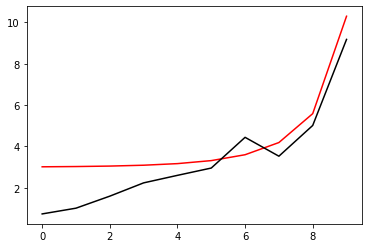

5100 89.77894731447795
[0.73555007 1.0130577  1.59469514 2.23728866 2.60146453 2.95491468
 4.43974654 3.52761009 5.01496284 9.17682727]


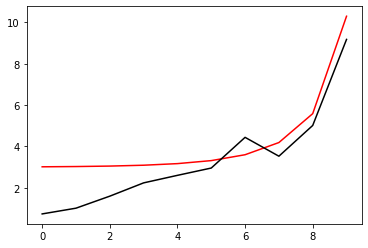

5200 89.77893356715417
[0.73564368 1.01297783 1.59443116 2.23716651 2.60199746 2.95550922
 4.43895754 3.52751892 5.015034   9.17678732]


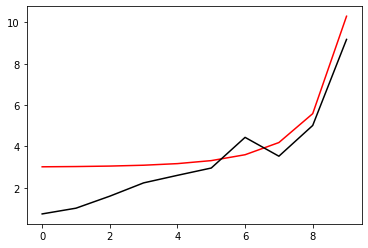

5300 89.7789198550611
[0.73573706 1.01289817 1.59416783 2.23704456 2.60252921 2.95610313
 4.43816921 3.52742789 5.01510552 9.17674737]


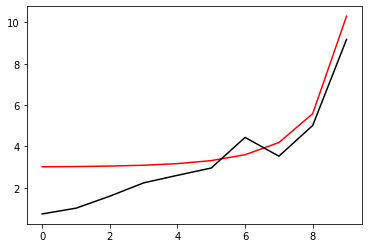

5400 89.77890617807913
[0.7358302  1.01281872 1.59390515 2.23692279 2.6030598  2.95669639
 4.43738157 3.527337   5.01517739 9.17670741]


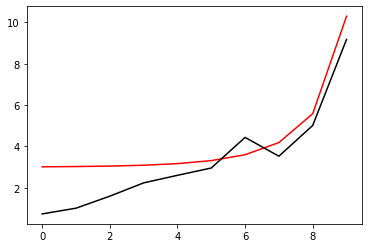

5500 89.77889253608934
[0.7359231  1.01273947 1.59364312 2.23680121 2.60358922 2.95728902
 4.43659461 3.52724625 5.01524961 9.17666746]


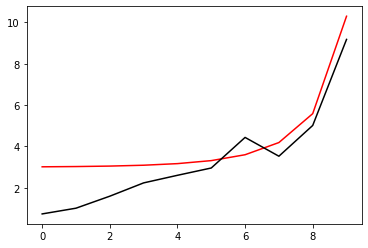

5600 89.77887892897314
[0.73601577 1.01266043 1.59338173 2.23667981 2.60411747 2.95788101
 4.43580832 3.52715564 5.01532219 9.17662752]


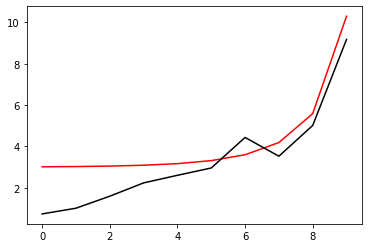

5700 89.77886535661266
[0.7361082  1.0125816  1.59312098 2.2365586  2.60464457 2.95847236
 4.43502271 3.52706517 5.01539511 9.17658757]


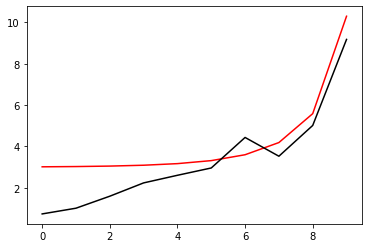

5800 89.77885181889027
[0.7362004  1.01250297 1.59286088 2.23643758 2.60517051 2.95906307
 4.43423778 3.52697484 5.01546838 9.17654762]


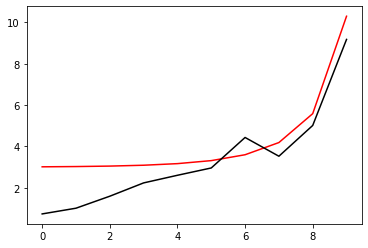

5900 89.77883831568907
[0.73629237 1.01242455 1.59260141 2.23631674 2.60569529 2.95965315
 4.43345352 3.52688465 5.015542   9.17650767]


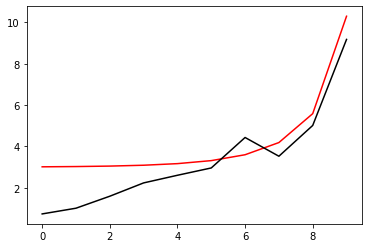

6000 89.77882484689263
[0.7363841  1.01234633 1.59234259 2.2361961  2.60621893 2.96024259
 4.43266994 3.52679459 5.01561597 9.17646773]


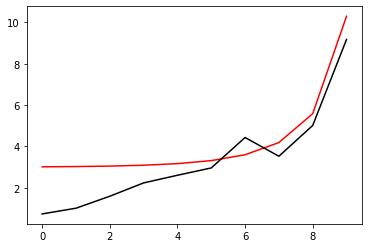

6100 89.77881141238485
[0.7364756  1.01226831 1.5920844  2.23607564 2.60674141 2.9608314
 4.43188704 3.52670467 5.01569029 9.17642779]


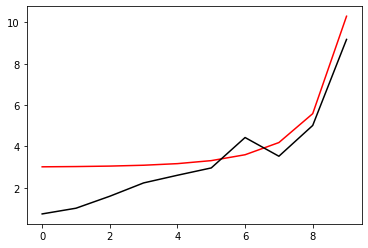

6200 89.77879801205036
[0.73656687 1.0121905  1.59182684 2.23595537 2.60726275 2.96141957
 4.4311048  3.52661489 5.01576495 9.17638784]


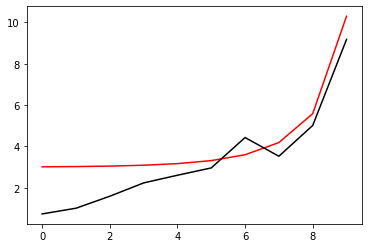

6300 89.77878464577394
[0.73665791 1.01211288 1.59156991 2.23583528 2.60778295 2.9620071
 4.43032325 3.52652524 5.01583995 9.1763479 ]


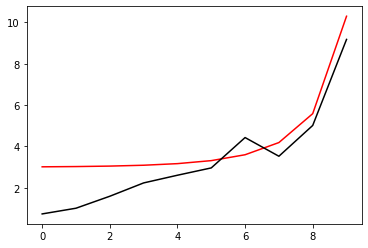

6400 89.77877131344134
[0.73674872 1.01203547 1.59131362 2.23571539 2.60830201 2.962594
 4.42954236 3.52643573 5.0159153  9.17630796]


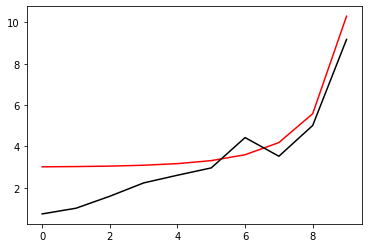

6500 89.77875801493832
[0.7368393  1.01195826 1.59105795 2.23559568 2.60881993 2.96318026
 4.42876214 3.52634636 5.015991   9.17626802]


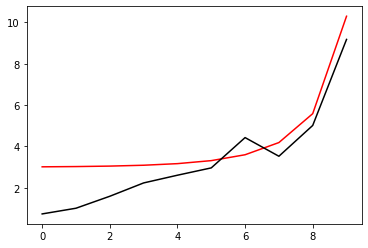

6600 89.7787447501514
[0.73692966 1.01188125 1.59080291 2.23547616 2.60933672 2.96376589
 4.4279826  3.52625712 5.01606703 9.17622808]


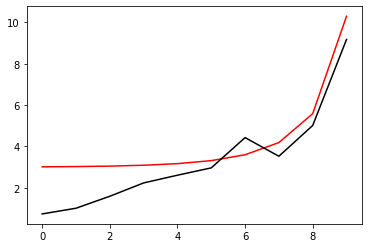

6700 89.77873151896753
[0.73701978 1.01180444 1.59054849 2.23535683 2.60985238 2.96435088
 4.42720372 3.52616801 5.01614341 9.17618815]


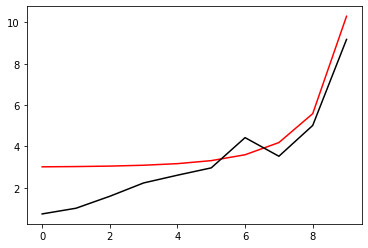

6800 89.7787183212741
[0.73710967 1.01172783 1.5902947  2.23523769 2.61036691 2.96493524
 4.42642552 3.52607904 5.01622013 9.17614821]


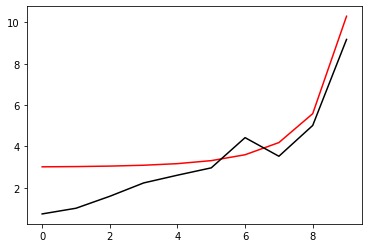

6900 89.77870515695894
[0.73719934 1.01165141 1.59004153 2.23511873 2.61088032 2.96551896
 4.42564798 3.5259902  5.01629719 9.17610828]


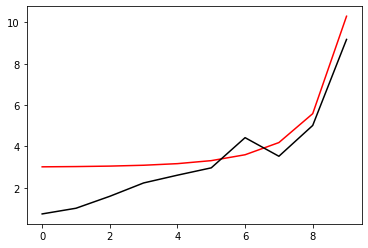

7000 89.77869202591043
[0.73728879 1.01157519 1.58978897 2.23499997 2.61139261 2.96610206
 4.42487111 3.52590149 5.01637458 9.17606834]


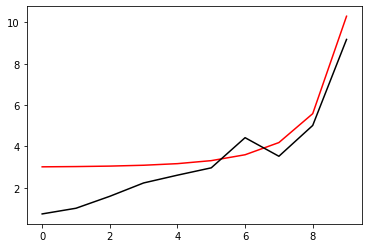

7100 89.77867892801748
[0.73737801 1.01149917 1.58953704 2.23488139 2.61190378 2.96668452
 4.42409491 3.52581292 5.01645232 9.17602841]


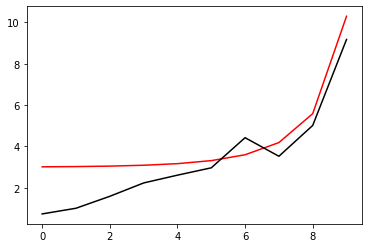

7200 89.77866586316917
[0.737467   1.01142334 1.58928572 2.234763   2.61241383 2.96726634
 4.42331937 3.52572448 5.01653039 9.17598848]


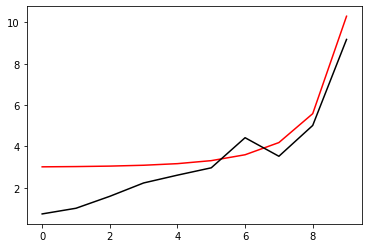

7300 89.77865283125546
[0.73755577 1.01134771 1.58903501 2.2346448  2.61292277 2.96784753
 4.4225445  3.52563617 5.0166088  9.17594855]


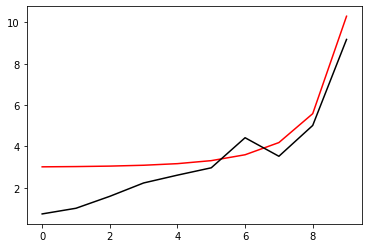

7400 89.77863983216646
[0.73764431 1.01127227 1.58878492 2.2345268  2.61343061 2.9684281
 4.42177029 3.52554799 5.01668755 9.17590862]


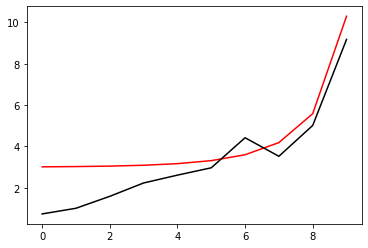

7500 89.77862686579287
[0.73773263 1.01119703 1.58853543 2.23440898 2.61393733 2.96900803
 4.42099675 3.52545994 5.01676663 9.17586869]


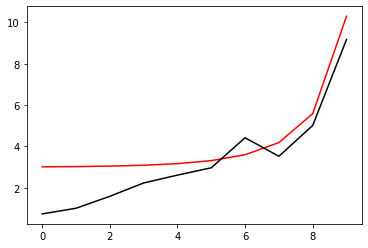

7600 89.77861393202579
[0.73782074 1.01112198 1.58828656 2.23429135 2.61444296 2.96958732
 4.42022387 3.52537202 5.01684605 9.17582877]


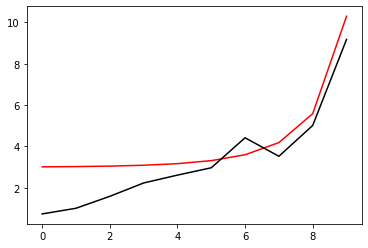

7700 89.77860103075687
[0.73790861 1.01104712 1.58803829 2.2341739  2.61494748 2.97016599
 4.41945165 3.52528423 5.01692579 9.17578884]


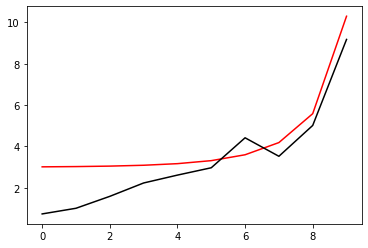

7800 89.77858816187813
[0.73799627 1.01097245 1.58779063 2.23405665 2.61545091 2.97074403
 4.4186801  3.52519657 5.01700588 9.17574891]


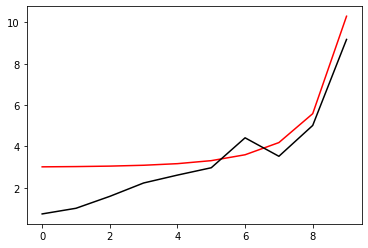

7900 89.77857532528203
[0.73808371 1.01089798 1.58754357 2.23393959 2.61595324 2.97132143
 4.4179092  3.52510903 5.01708629 9.17570899]


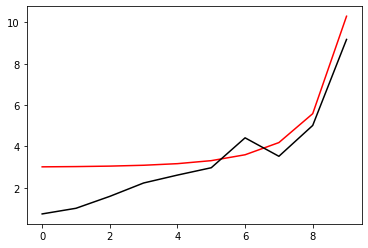

8000 89.77856252086153
[0.73817093 1.01082369 1.58729711 2.23382272 2.61645447 2.97189821
 4.41713897 3.52502163 5.01716703 9.17566907]


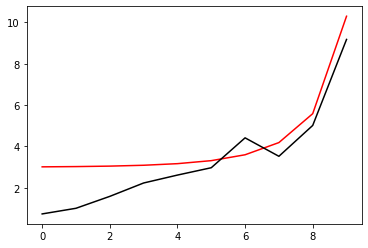

8100 89.77854974851004
[0.73825792 1.01074959 1.58705125 2.23370604 2.61695462 2.97247435
 4.4163694  3.52493435 5.01724811 9.17562915]


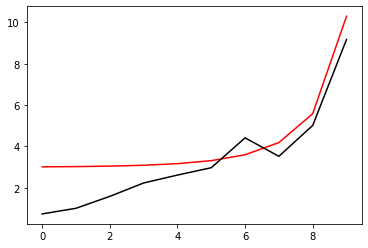

8200 89.77853700812138
[0.7383447  1.01067569 1.58680599 2.23358954 2.61745369 2.97304987
 4.41560048 3.52484721 5.01732951 9.17558923]


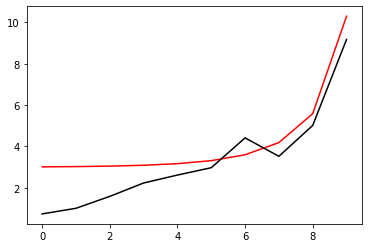

8300 89.77852429958982
[0.73843127 1.01060197 1.58656132 2.23347324 2.61795167 2.97362476
 4.41483222 3.52476018 5.01741124 9.17554931]


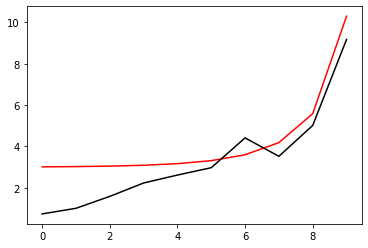

8400 89.77851162281007
[0.73851761 1.01052844 1.58631725 2.23335713 2.61844857 2.97419902
 4.41406462 3.52467329 5.01749331 9.17550939]


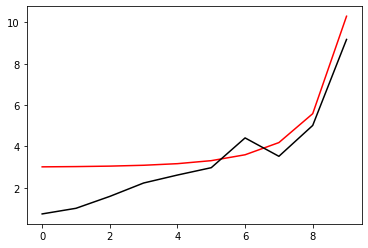

8500 89.77849897767726
[0.73860374 1.0104551  1.58607378 2.23324121 2.61894439 2.97477265
 4.41329768 3.52458652 5.01757569 9.17546948]


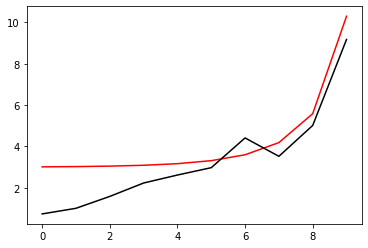

8600 89.77848636408704
[0.73868965 1.01038194 1.58583089 2.23312547 2.61943914 2.97534565
 4.41253139 3.52449987 5.01765841 9.17542956]


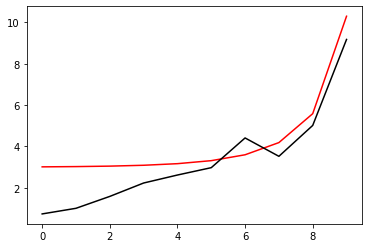

8700 89.7784737819354
[0.73877535 1.01030897 1.5855886  2.23300993 2.61993282 2.97591802
 4.41176576 3.52441335 5.01774145 9.17538965]


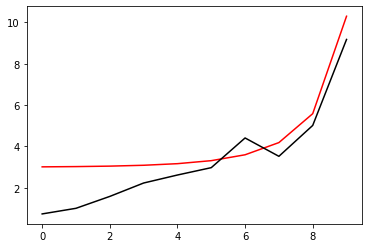

8800 89.77846123111868
[0.73886083 1.01023619 1.58534689 2.23289458 2.62042543 2.97648977
 4.41100078 3.52432696 5.01782481 9.17534973]


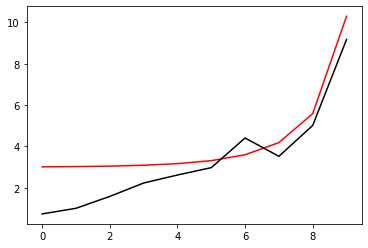

8900 89.77844871153393
[0.7389461  1.01016359 1.58510577 2.23277942 2.62091697 2.97706089
 4.41023645 3.52424069 5.0179085  9.17530982]


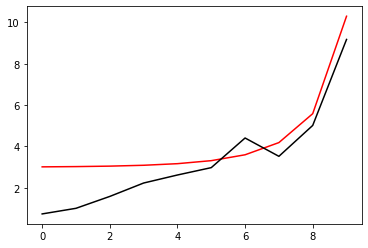

9000 89.7784362230783
[0.73903115 1.01009117 1.58486523 2.23266445 2.62140745 2.97763138
 4.40947278 3.52415454 5.01799251 9.17526991]


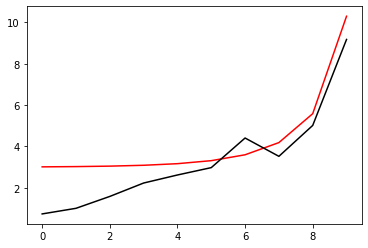

9100 89.77842376564966
[0.73911599 1.01001894 1.58462528 2.23254966 2.62189687 2.97820124
 4.40870976 3.52406852 5.01807684 9.17523   ]


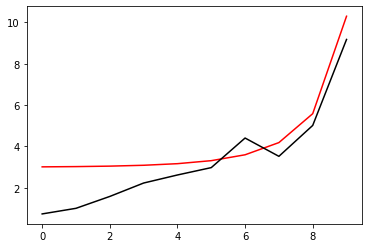

9200 89.77841133914606
[0.73920062 1.00994689 1.5843859  2.23243507 2.62238523 2.97877048
 4.40794739 3.52398262 5.0181615  9.17519009]


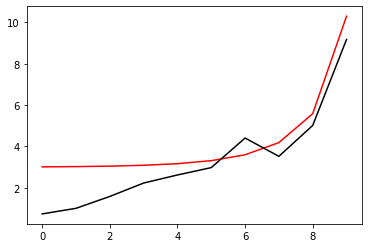

9300 89.77839894346606
[0.73928504 1.00987503 1.58414711 2.23232067 2.62287253 2.9793391
 4.40718567 3.52389684 5.01824648 9.17515019]


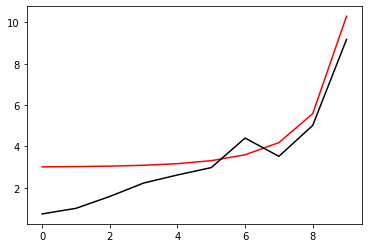

9400 89.77838657850867
[0.73936924 1.00980334 1.58390889 2.23220647 2.62335879 2.97990709
 4.4064246  3.52381118 5.01833177 9.17511028]


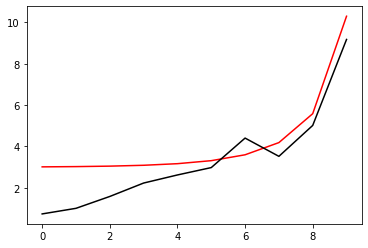

9500 89.77837424417336
[0.73945324 1.00973184 1.58367125 2.23209245 2.62384399 2.98047445
 4.40566418 3.52372565 5.01841739 9.17507038]


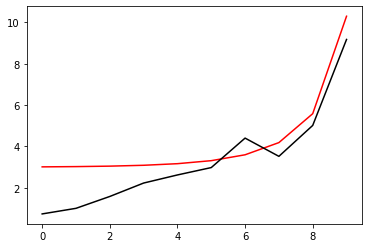

9600 89.77836194035983
[0.73953702 1.00966052 1.58343419 2.23197862 2.62432815 2.98104119
 4.40490441 3.52364023 5.01850332 9.17503047]


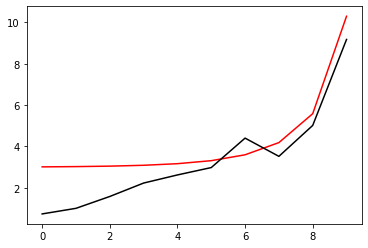

9700 89.7783496669684
[0.7396206  1.00958937 1.5831977  2.23186498 2.62481126 2.9816073
 4.40414529 3.52355494 5.01858957 9.17499057]


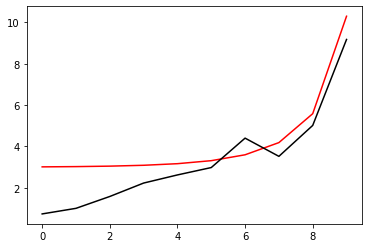

9800 89.7783374238996
[0.73970397 1.00951841 1.58296178 2.23175153 2.62529333 2.98217279
 4.40338682 3.52346977 5.01867614 9.17495067]


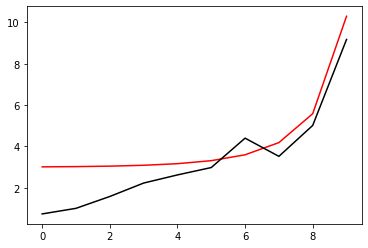

9900 89.77832521105454
[0.73978712 1.00944762 1.58272643 2.23163828 2.62577437 2.98273766
 4.40262899 3.52338471 5.01876303 9.17491077]


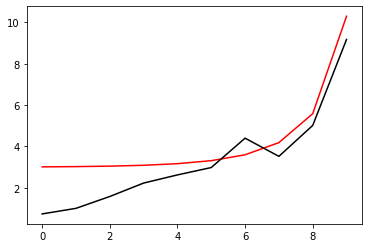

10000 89.77831302833478
[0.73987007 1.00937702 1.58249165 2.23152521 2.62625437 2.9833019
 4.4018718  3.52329978 5.01885023 9.17487087]


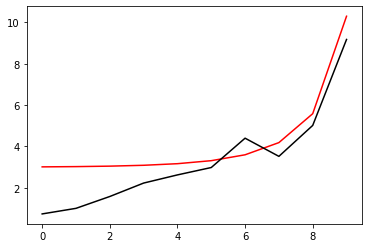

In [23]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.77830087564192
[0.73995282 1.00930659 1.58225743 2.23141234 2.62673333 2.98386552
 4.40111526 3.52321497 5.01893775 9.17483098]


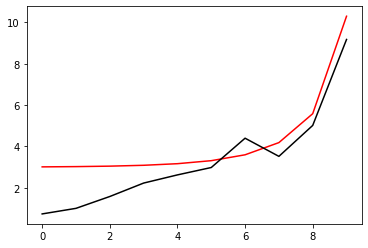

200 89.77828875287837
[0.74003535 1.00923634 1.58202378 2.23129966 2.62721127 2.98442852
 4.40035937 3.52313027 5.01902558 9.17479108]


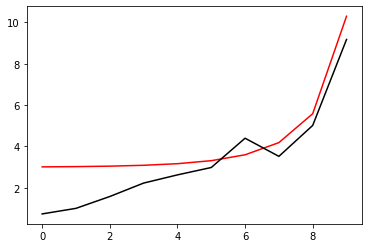

300 89.77827665994675
[0.74011768 1.00916626 1.58179069 2.23118716 2.62768818 2.9849909
 4.39960412 3.52304569 5.01911372 9.17475119]


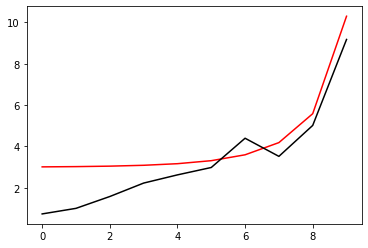

400 89.7782645967501
[0.74019981 1.00909636 1.58155817 2.23107486 2.62816406 2.98555265
 4.39884951 3.52296123 5.01920217 9.17471129]


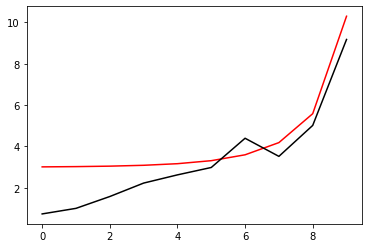

500 89.77825256319184
[0.74028173 1.00902663 1.5813262  2.23096275 2.62863892 2.98611378
 4.39809554 3.52287689 5.01929094 9.1746714 ]


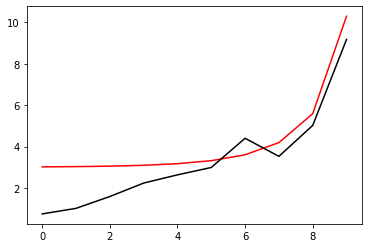

600 89.77824055917586
[0.74036345 1.00895708 1.58109479 2.23085083 2.62911277 2.98667429
 4.39734221 3.52279266 5.01938002 9.17463151]


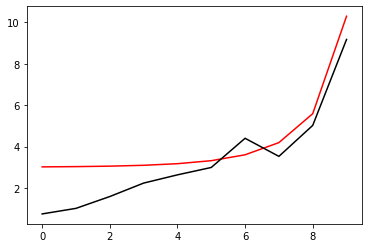

700 89.77822858460637
[0.74044496 1.00888771 1.58086394 2.2307391  2.62958559 2.98723418
 4.39658953 3.52270855 5.01946941 9.17459162]


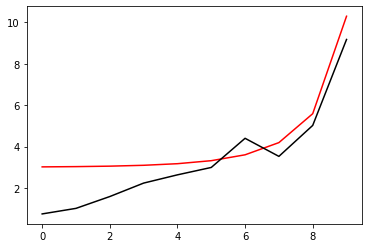

800 89.77821663938794
[0.74052627 1.00881851 1.58063365 2.23062756 2.6300574  2.98779345
 4.39583748 3.52262456 5.01955911 9.17455173]


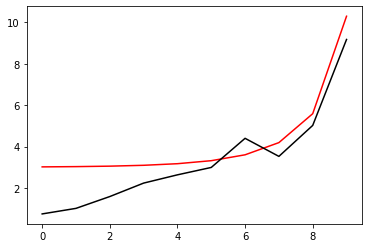

900 89.77820472342562
[0.74060738 1.00874948 1.58040391 2.23051621 2.6305282  2.9883521
 4.39508608 3.52254068 5.01964912 9.17451184]


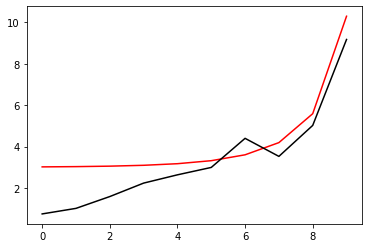

1000 89.77819283662477
[0.74068828 1.00868062 1.58017472 2.23040506 2.630998   2.98891013
 4.39433531 3.52245691 5.01973943 9.17447196]


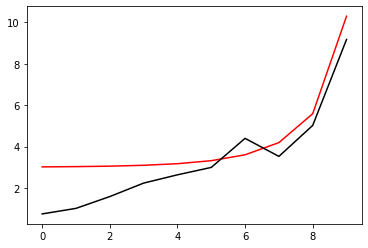

1100 89.77818097889111
[0.74076898 1.00861193 1.57994608 2.23029409 2.63146678 2.98946754
 4.39358518 3.52237327 5.01983005 9.17443207]


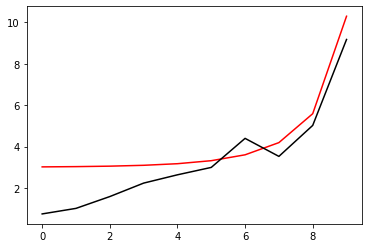

1200 89.77816915013094
[0.74084949 1.00854342 1.57971799 2.23018332 2.63193456 2.99002433
 4.39283569 3.52228973 5.01992098 9.17439219]


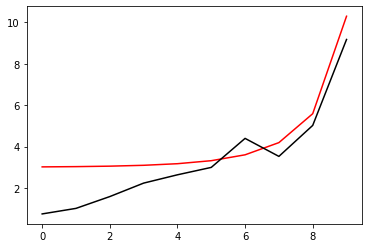

1300 89.77815735025057
[0.74092979 1.00847508 1.57949045 2.23007273 2.63240135 2.9905805
 4.39208683 3.52220631 5.02001222 9.17435231]


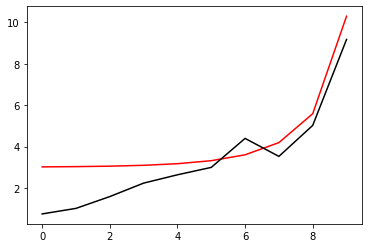

1400 89.77814557915713
[0.74100989 1.0084069  1.57926346 2.22996234 2.63286713 2.99113606
 4.39133861 3.52212301 5.02010376 9.17431242]


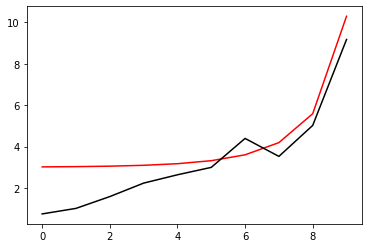

1500 89.77813383675777
[0.74108979 1.0083389  1.57903701 2.22985214 2.63333192 2.99169099
 4.39059102 3.52203981 5.0201956  9.17427254]


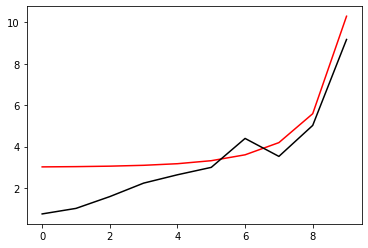

1600 89.77812212296021
[0.7411695  1.00827107 1.5788111  2.22974213 2.63379571 2.99224531
 4.38984407 3.52195673 5.02028775 9.17423267]


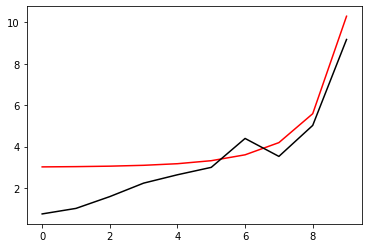

1700 89.77811043767242
[0.74124901 1.0082034  1.57858574 2.22963231 2.63425852 2.99279901
 4.38909775 3.52187376 5.0203802  9.17419279]


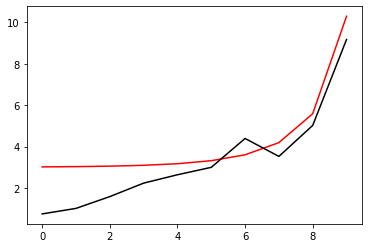

1800 89.77809878080285
[0.74132831 1.0081359  1.57836091 2.22952268 2.63472033 2.99335209
 4.38835206 3.52179091 5.02047296 9.17415291]


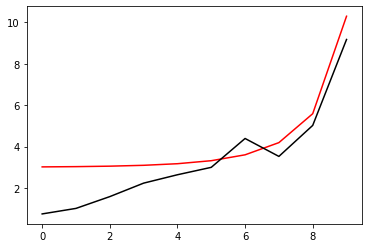

1900 89.77808715226024
[0.74140743 1.00806857 1.57813663 2.22941324 2.63518117 2.99390456
 4.38760701 3.52170816 5.02056601 9.17411304]


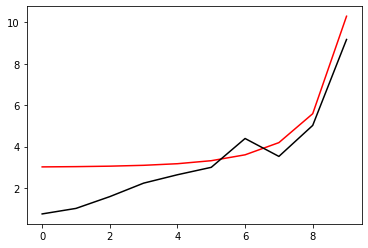

2000 89.77807555195373
[0.74148634 1.00800141 1.57791288 2.22930399 2.63564102 2.99445641
 4.38686259 3.52162553 5.02065937 9.17407317]


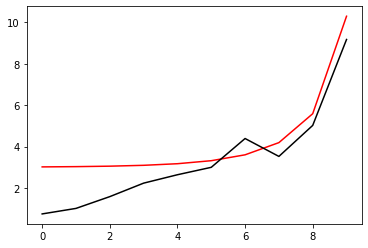

2100 89.77806397979279
[0.74156506 1.00793441 1.57768966 2.22919493 2.63609989 2.99500765
 4.38611879 3.52154301 5.02075303 9.17403329]


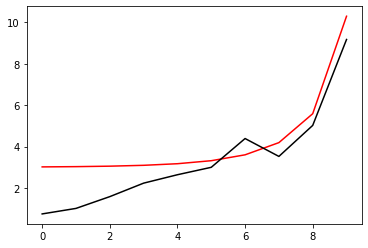

2200 89.7780524356874
[0.74164358 1.00786758 1.57746698 2.22908607 2.63655778 2.99555827
 4.38537563 3.52146059 5.02084698 9.17399342]


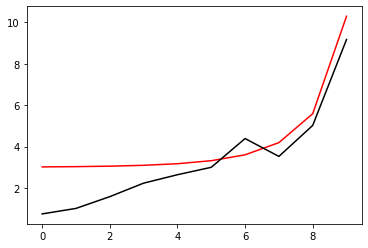

2300 89.77804091954764
[0.74172191 1.00780091 1.57724484 2.22897739 2.6370147  2.99610827
 4.3846331  3.52137829 5.02094124 9.17395355]


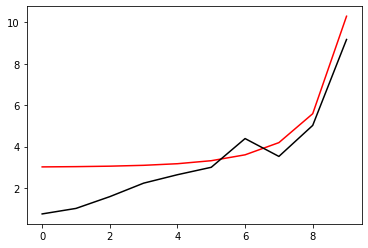

2400 89.77802943128407
[0.74180005 1.00773441 1.57702322 2.22886891 2.63747064 2.99665766
 4.3838912  3.5212961  5.02103579 9.17391368]


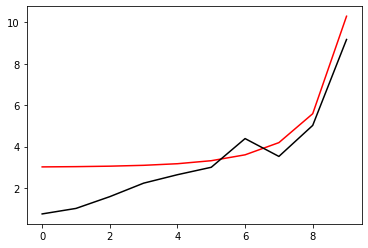

2500 89.7780179708078
[0.74187799 1.00766807 1.57680213 2.22876061 2.63792562 2.99720644
 4.38314992 3.52121401 5.02113064 9.17387382]


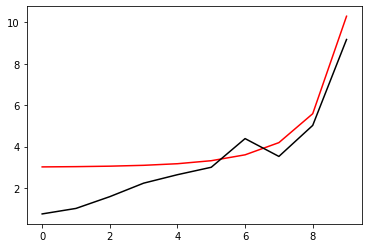

2600 89.77800653802997
[0.74195573 1.0076019  1.57658157 2.22865251 2.63837963 2.9977546
 4.38240927 3.52113204 5.02122579 9.17383395]


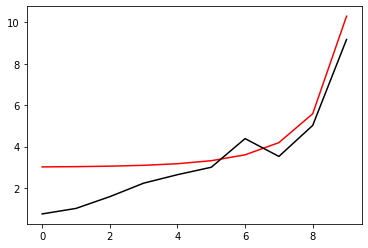

2700 89.77799513286233
[0.74203329 1.00753589 1.57636154 2.2285446  2.63883267 2.99830215
 4.38166925 3.52105017 5.02132123 9.17379409]


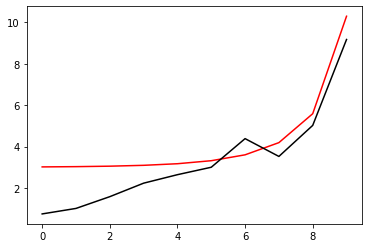

2800 89.77798375521684
[0.74211065 1.00747004 1.57614204 2.22843688 2.63928475 2.99884908
 4.38092985 3.52096841 5.02141697 9.17375422]


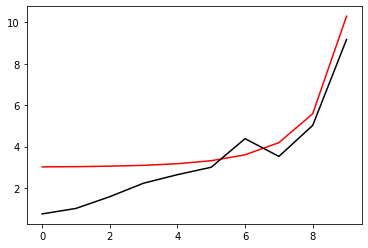

2900 89.77797240500581
[0.74218782 1.00740436 1.57592305 2.22832934 2.63973587 2.9993954
 4.38019108 3.52088676 5.021513   9.17371436]


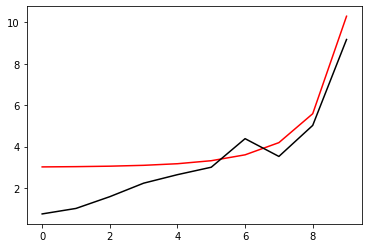

3000 89.777961082142
[0.7422648  1.00733883 1.57570459 2.228222   2.64018604 2.99994111
 4.37945293 3.52080522 5.02160932 9.1736745 ]


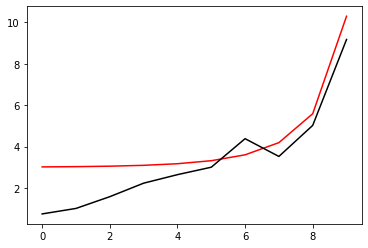

3100 89.77794978653841
[0.74234159 1.00727347 1.57548665 2.22811485 2.64063525 3.00048621
 4.3787154  3.52072378 5.02170594 9.17363464]


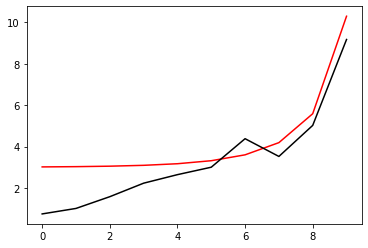

3200 89.77793851810844
[0.74241819 1.00720827 1.57526924 2.22800789 2.64108351 3.00103069
 4.3779785  3.52064245 5.02180286 9.17359478]


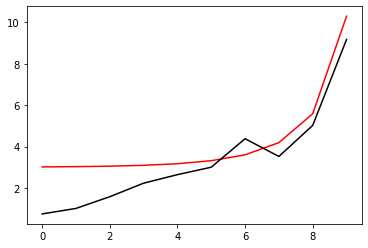

3300 89.77792727676588
[0.74249459 1.00714322 1.57505233 2.22790112 2.64153082 3.00157457
 4.37724222 3.52056123 5.02190006 9.17355493]


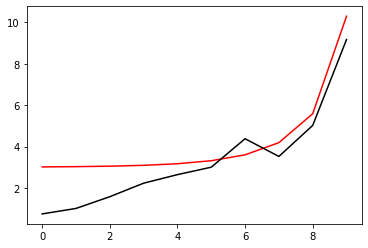

3400 89.77791606242475
[0.74257081 1.00707834 1.57483595 2.22779454 2.64197718 3.00211783
 4.37650657 3.52048011 5.02199755 9.17351507]


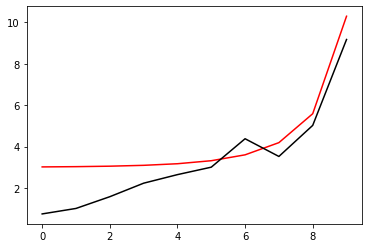

3500 89.77790487499946
[0.74264684 1.00701362 1.57462008 2.22768815 2.6424226  3.00266048
 4.37577153 3.52039909 5.02209534 9.17347522]


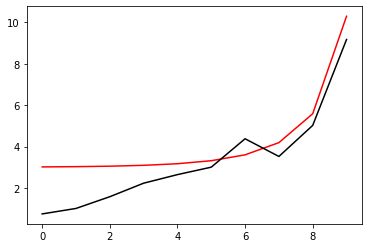

3600 89.77789371440485
[0.74272269 1.00694905 1.57440472 2.22758195 2.64286707 3.00320253
 4.37503711 3.52031819 5.02219341 9.17343537]


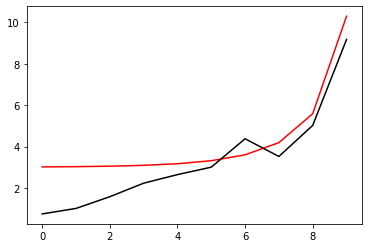

3700 89.77788258055591
[0.74279834 1.00688464 1.57418988 2.22747595 2.64331061 3.00374396
 4.37430331 3.52023738 5.02229178 9.17339552]


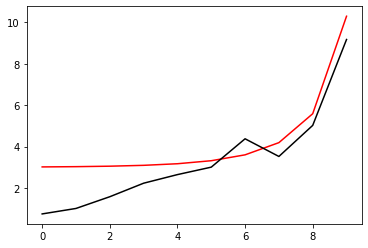

3800 89.77787147336812
[0.74287381 1.00682039 1.57397555 2.22737013 2.64375321 3.00428478
 4.37357014 3.52015668 5.02239043 9.17335567]


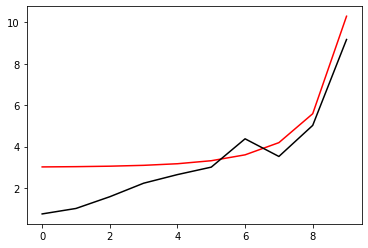

3900 89.77786039275722
[0.74294909 1.0067563  1.57376172 2.2272645  2.64419487 3.00482499
 4.37283758 3.52007609 5.02248937 9.17331582]


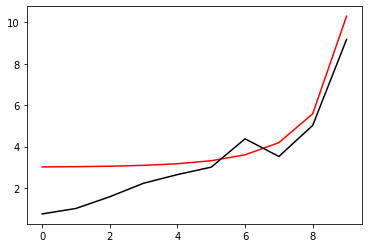

4000 89.77784933863936
[0.74302419 1.00669236 1.57354841 2.22715906 2.6446356  3.0053646
 4.37210563 3.51999559 5.0225886  9.17327597]


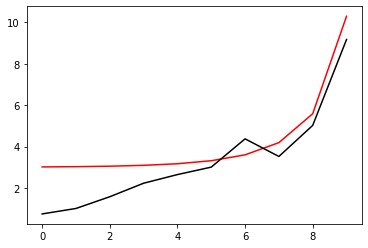

4100 89.77783831093099
[0.7430991  1.00662858 1.5733356  2.22705381 2.64507541 3.00590359
 4.37137431 3.5199152  5.02268811 9.17323612]


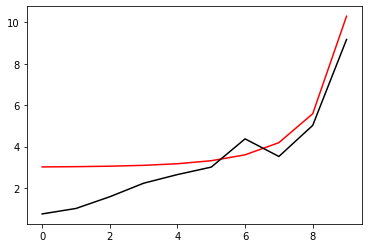

4200 89.77782730954866
[0.74317382 1.00656496 1.57312329 2.22694875 2.64551428 3.00644198
 4.3706436  3.51983492 5.02278791 9.17319628]


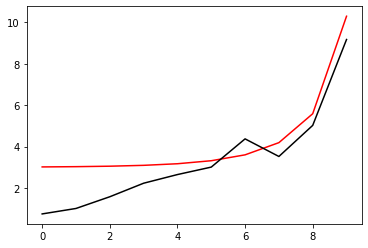

4300 89.77781633440965
[0.74324836 1.00650149 1.5729115  2.22684389 2.64595223 3.00697976
 4.3699135  3.51975473 5.02288799 9.17315644]


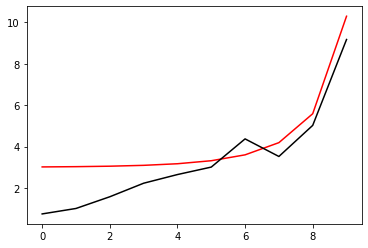

4400 89.77780538543132
[0.74332272 1.00643817 1.5727002  2.22673921 2.64638926 3.00751694
 4.36918402 3.51967465 5.02298836 9.17311659]


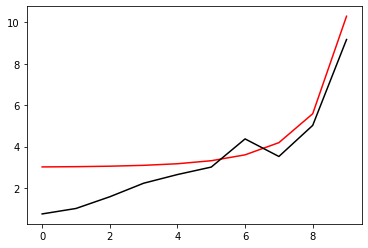

4500 89.77779446253139
[0.74339689 1.00637501 1.5724894  2.22663472 2.64682536 3.0080535
 4.36845516 3.51959467 5.02308901 9.17307675]


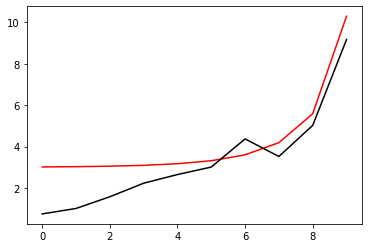

4600 89.77778356562786
[0.74347088 1.006312   1.57227911 2.22653042 2.64726055 3.00858946
 4.36772691 3.51951479 5.02318995 9.17303691]


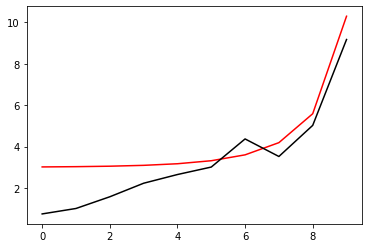

4700 89.77777269463927
[0.74354468 1.00624915 1.57206931 2.22642631 2.64769483 3.00912482
 4.36699927 3.51943501 5.02329116 9.17299708]


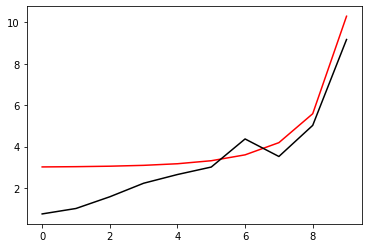

4800 89.77776184948405
[0.74361831 1.00618645 1.57186001 2.22632239 2.64812819 3.00965957
 4.36627224 3.51935533 5.02339266 9.17295724]


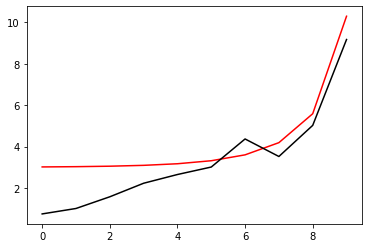

4900 89.77775103008149
[0.74369175 1.0061239  1.57165121 2.22621866 2.64856064 3.01019371
 4.36554582 3.51927576 5.02349444 9.1729174 ]


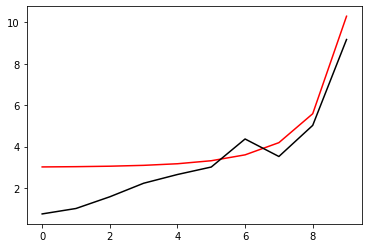

5000 89.77774023635077
[0.74376501 1.0060615  1.5714429  2.22611511 2.64899218 3.01072725
 4.36482002 3.51919628 5.0235965  9.17287757]


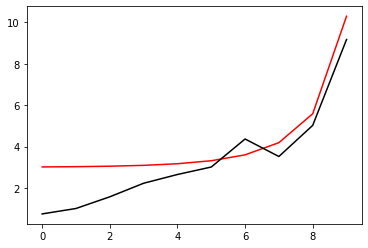

5100 89.77772946821152
[0.74383809 1.00599925 1.57123508 2.22601176 2.64942281 3.01126018
 4.36409482 3.5191169  5.02369884 9.17283774]


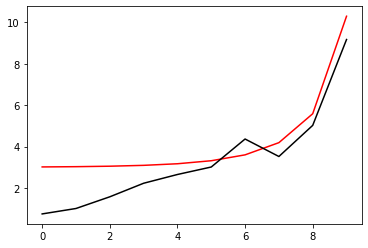

5200 89.77771872558374
[0.74391099 1.00593715 1.57102775 2.2259086  2.64985254 3.01179251
 4.36337024 3.51903762 5.02380146 9.17279791]


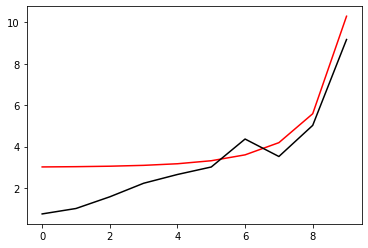

5300 89.77770800838769
[0.74398371 1.00587521 1.57082092 2.22580563 2.65028138 3.01232424
 4.36264626 3.51895844 5.02390436 9.17275808]


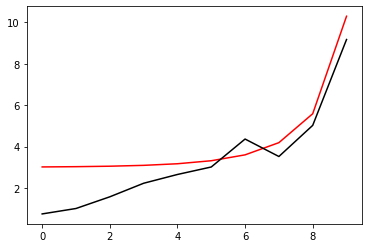

5400 89.77769731654392
[0.74405625 1.00581341 1.57061457 2.22570284 2.65070931 3.01285536
 4.36192289 3.51887936 5.02400753 9.17271825]


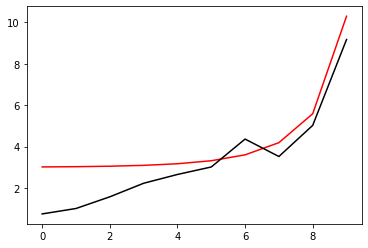

5500 89.77768664997333
[0.74412862 1.00575176 1.57040872 2.22560024 2.65113634 3.01338588
 4.36120013 3.51880037 5.02411098 9.17267842]


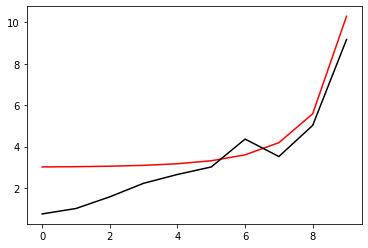

5600 89.77767600859715
[0.7442008  1.00569026 1.57020334 2.22549784 2.65156249 3.0139158
 4.36047797 3.51872148 5.02421471 9.1726386 ]


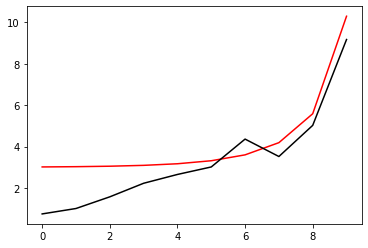

5700 89.77766539233693
[0.74427281 1.00562891 1.56999846 2.22539562 2.65198774 3.01444511
 4.35975642 3.51864269 5.02431871 9.17259877]


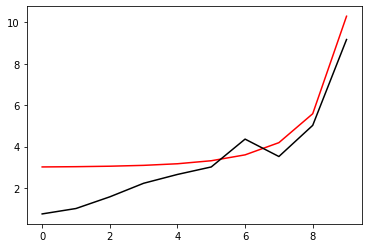

5800 89.77765480111432
[0.74434464 1.00556771 1.56979406 2.22529359 2.6524121  3.01497382
 4.35903547 3.518564   5.02442299 9.17255895]


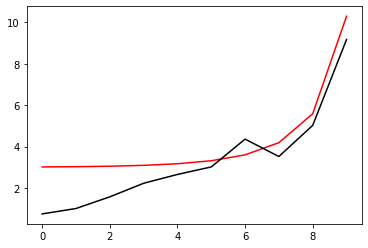

5900 89.77764423485152
[0.74441629 1.00550666 1.56959013 2.22519175 2.65283557 3.01550194
 4.35831513 3.51848541 5.02452755 9.17251913]


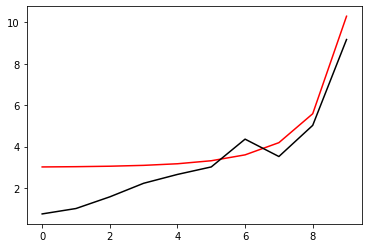

6000 89.77763369347092
[0.74448777 1.00544575 1.5693867  2.2250901  2.65325816 3.01602945
 4.3575954  3.51840691 5.02463237 9.17247931]


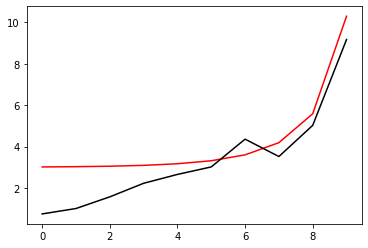

6100 89.77762317689526
[0.74455907 1.00538499 1.56918374 2.22498863 2.65367986 3.01655636
 4.35687627 3.5183285  5.02473747 9.17243949]


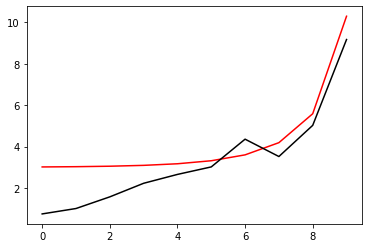

6200 89.77761268504753
[0.74463019 1.00532437 1.56898126 2.22488736 2.65410069 3.01708267
 4.35615774 3.51825019 5.02484285 9.17239967]


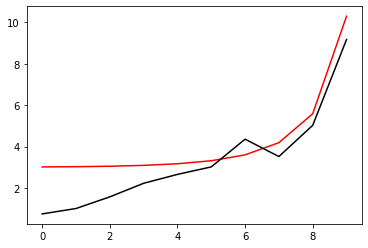

6300 89.77760221785101
[0.74470114 1.0052639  1.56877925 2.22478627 2.65452064 3.01760837
 4.35543981 3.51817198 5.02494849 9.17235986]


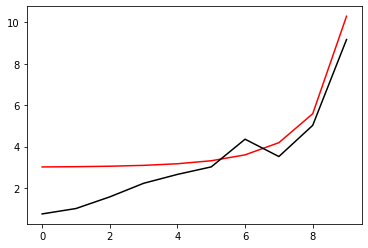

6400 89.77759177522935
[0.74477192 1.00520357 1.56857772 2.22468537 2.65493971 3.01813349
 4.35472248 3.51809386 5.02505441 9.17232004]


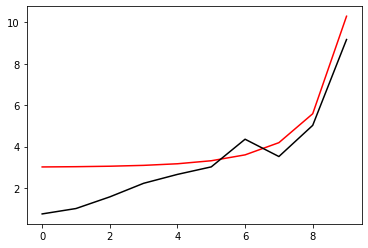

6500 89.77758135710636
[0.74484252 1.00514339 1.56837667 2.22458466 2.65535791 3.018658
 4.35400575 3.51801584 5.0251606  9.17228023]


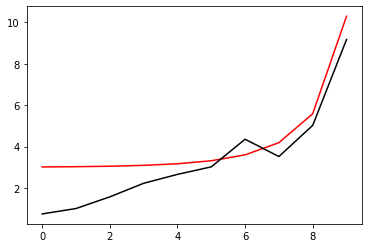

6600 89.7775709634063
[0.74491294 1.00508336 1.56817609 2.22448414 2.65577523 3.01918191
 4.35328963 3.51793791 5.02526705 9.17224042]


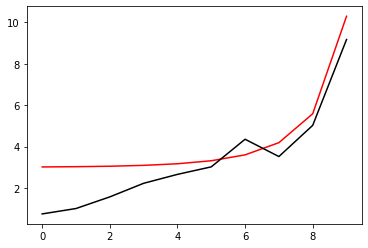

6700 89.7775605940537
[0.7449832  1.00502347 1.56797598 2.2243838  2.65619169 3.01970522
 4.3525741  3.51786007 5.02537378 9.17220061]


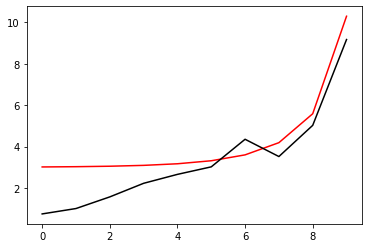

6800 89.77755024897323
[0.74505328 1.00496372 1.56777635 2.22428365 2.65660728 3.02022794
 4.35185917 3.51778233 5.02548077 9.1721608 ]


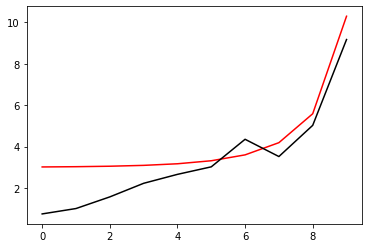

6900 89.77753992808992
[0.74512319 1.00490411 1.56757718 2.22418369 2.65702201 3.02075006
 4.35114484 3.51770468 5.02558804 9.17212099]


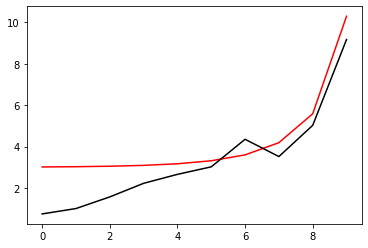

7000 89.77752963132919
[0.74519293 1.00484465 1.56737848 2.22408392 2.65743588 3.02127158
 4.35043111 3.51762712 5.02569557 9.17208118]


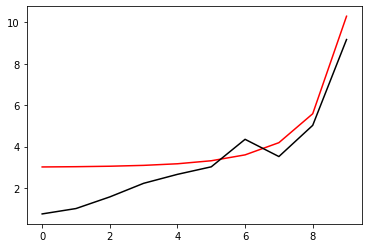

7100 89.77751935861667
[0.74526249 1.00478533 1.56718025 2.22398434 2.65784888 3.0217925
 4.34971797 3.51754966 5.02580337 9.17204138]


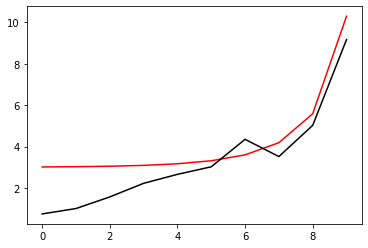

7200 89.77750910987827
[0.74533189 1.00472615 1.56698249 2.22388494 2.65826103 3.02231283
 4.34900543 3.51747229 5.02591143 9.17200158]


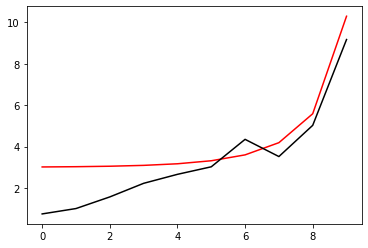

7300 89.77749888504019
[0.74540111 1.00466711 1.56678518 2.22378573 2.65867232 3.02283257
 4.34829349 3.51739501 5.02601976 9.17196178]


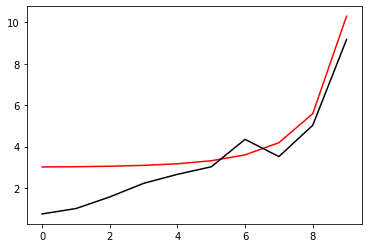

7400 89.77748868402894
[0.74547017 1.00460821 1.56658835 2.22368671 2.65908276 3.0233517
 4.34758213 3.51731782 5.02612836 9.17192197]


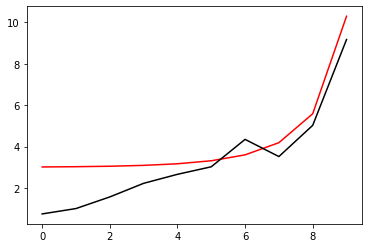

7500 89.77747850677117
[0.74553906 1.00454945 1.56639197 2.22358787 2.65949235 3.02387025
 4.34687138 3.51724072 5.02623722 9.17188218]


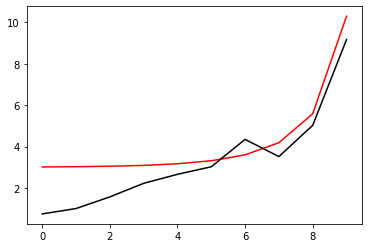

7600 89.77746835319407
[0.74560777 1.00449083 1.56619606 2.22348922 2.65990109 3.02438819
 4.34616121 3.51716372 5.02634634 9.17184238]


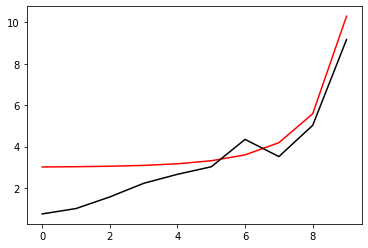

7700 89.77745822322487
[0.74567632 1.00443235 1.5660006  2.22339076 2.66030898 3.02490555
 4.34545164 3.5170868  5.02645573 9.17180258]


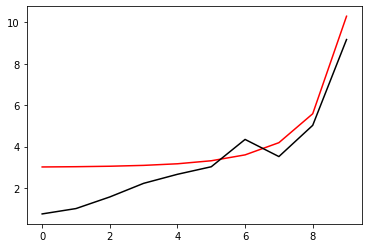

7800 89.77744811679116
[0.7457447  1.00437401 1.5658056  2.22329248 2.66071603 3.02542231
 4.34474267 3.51700997 5.02656538 9.17176279]


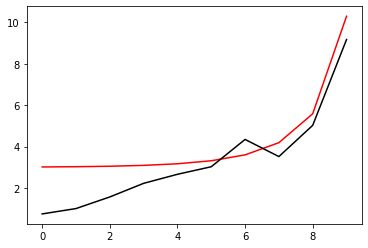

7900 89.77743803382089
[0.74581291 1.00431581 1.56561106 2.22319439 2.66112224 3.02593847
 4.34403428 3.51693324 5.02667529 9.17172299]


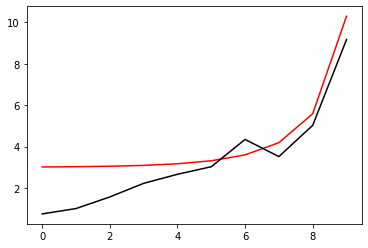

8000 89.7774279742421
[0.74588096 1.00425775 1.56541698 2.22309649 2.6615276  3.02645404
 4.34332648 3.51685659 5.02678546 9.1716832 ]


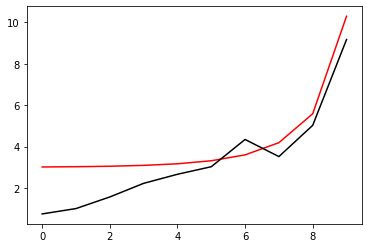

8100 89.7774179379833
[0.74594883 1.00419982 1.56522335 2.22299878 2.66193213 3.02696903
 4.34261928 3.51678003 5.02689589 9.17164341]


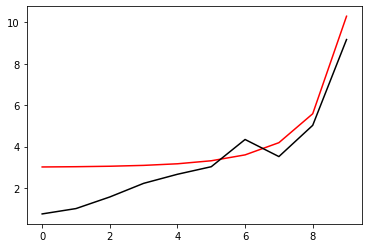

8200 89.77740792497316
[0.74601655 1.00414203 1.56503018 2.22290125 2.66233582 3.02748341
 4.34191266 3.51670356 5.02700659 9.17160362]


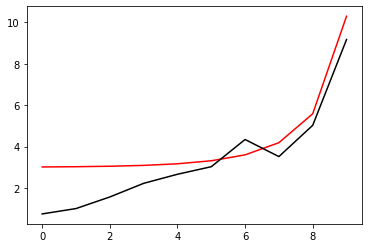

8300 89.77739793514058
[0.74608409 1.00408438 1.56483745 2.2228039  2.66273868 3.02799721
 4.34120663 3.51662718 5.02711754 9.17156384]


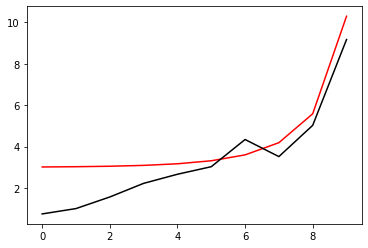

8400 89.77738796841493
[0.74615147 1.00402687 1.56464518 2.22270674 2.66314071 3.02851041
 4.34050119 3.51655089 5.02722875 9.17152405]


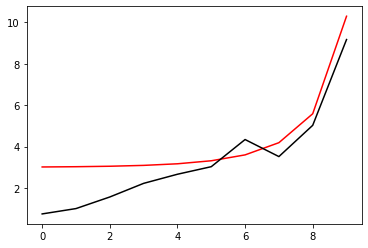

8500 89.77737802472551
[0.74621868 1.00396949 1.56445336 2.22260977 2.66354191 3.02902303
 4.33979634 3.51647469 5.02734022 9.17148427]


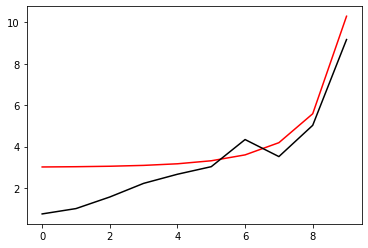

8600 89.77736810400226
[0.74628573 1.00391225 1.56426198 2.22251299 2.66394228 3.02953505
 4.33909208 3.51639857 5.02745195 9.17144448]


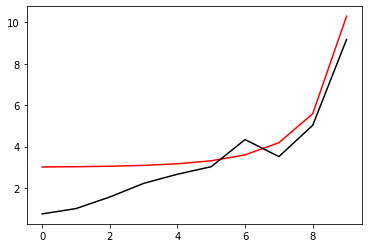

8700 89.77735820617511
[0.74635262 1.00385514 1.56407106 2.22241638 2.66434183 3.03004648
 4.3383884  3.51632254 5.02756393 9.1714047 ]


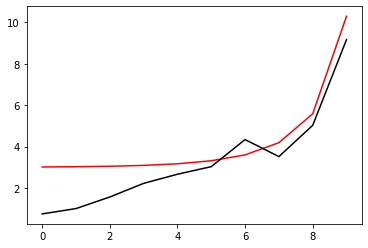

8800 89.77734833117441
[0.74641934 1.00379817 1.56388058 2.22231997 2.66474055 3.03055732
 4.3376853  3.5162466  5.02767618 9.17136492]


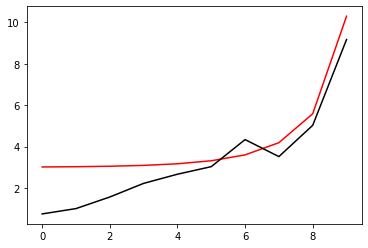

8900 89.77733847893067
[0.7464859  1.00374133 1.56369054 2.22222374 2.66513846 3.03106758
 4.33698279 3.51617074 5.02778868 9.17132514]


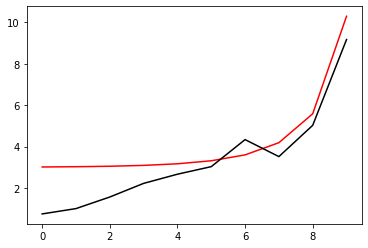

9000 89.77732864937478
[0.7465523  1.00368462 1.56350095 2.2221277  2.66553554 3.03157724
 4.33628087 3.51609497 5.02790143 9.17128536]


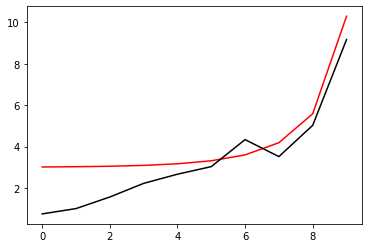

9100 89.77731884243775
[0.74661853 1.00362805 1.56331181 2.22203184 2.66593181 3.03208632
 4.33557953 3.51601929 5.02801444 9.17124559]


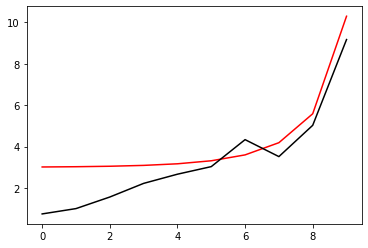

9200 89.77730905805089
[0.7466846  1.00357161 1.5631231  2.22193616 2.66632726 3.03259481
 4.33487877 3.51594369 5.0281277  9.17120581]


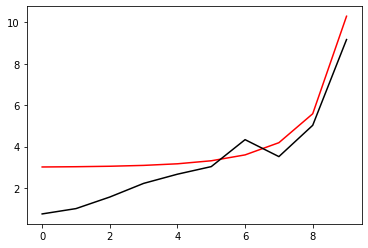

9300 89.77729929614593
[0.74675051 1.00351531 1.56293484 2.22184067 2.66672191 3.03310271
 4.3341786  3.51586818 5.02824122 9.17116604]


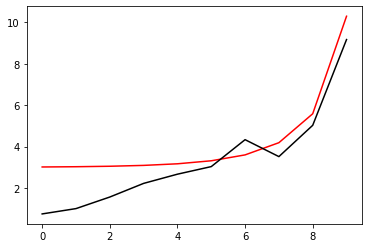

9400 89.77728955665457
[0.74681626 1.00345913 1.56274701 2.22174537 2.66711574 3.03361002
 4.333479   3.51579275 5.02835499 9.17112627]


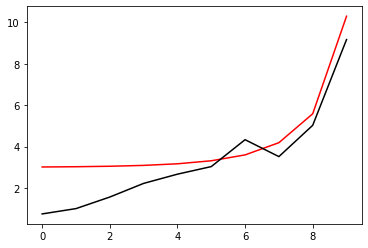

9500 89.77727983950902
[0.74688184 1.00340309 1.56255962 2.22165025 2.66750876 3.03411674
 4.33277999 3.51571741 5.02846901 9.1710865 ]


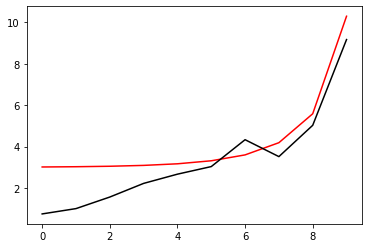

9600 89.77727014464156
[0.74694727 1.00334718 1.56237267 2.22155531 2.66790098 3.03462288
 4.33208156 3.51564215 5.02858328 9.17104673]


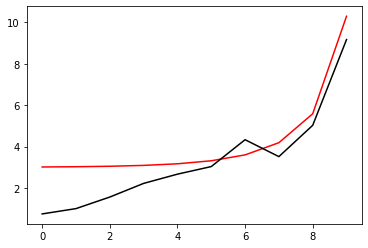

9700 89.77726047198495
[0.74701254 1.00329141 1.56218615 2.22146056 2.6682924  3.03512843
 4.33138371 3.51556698 5.02869781 9.17100697]


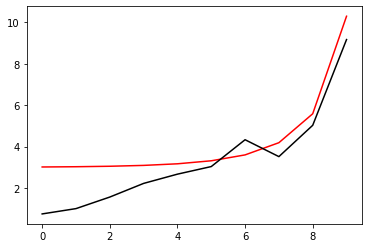

9800 89.77725082147194
[0.74707764 1.00323576 1.56200007 2.22136599 2.66868301 3.0356334
 4.33068644 3.51549189 5.02881258 9.1709672 ]


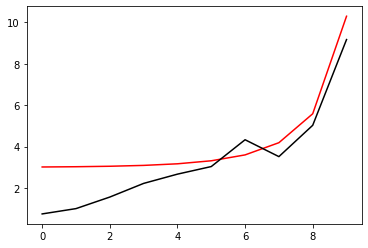

9900 89.77724119303562
[0.74714259 1.00318024 1.56181443 2.22127161 2.66907282 3.03613778
 4.32998974 3.51541688 5.02892761 9.17092744]


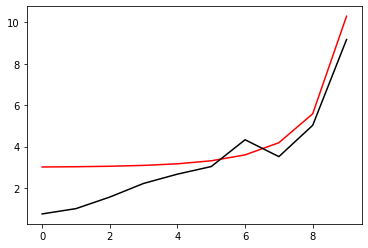

10000 89.77723158660947
[0.74720738 1.00312485 1.56162921 2.22117741 2.66946184 3.03664158
 4.32929363 3.51534195 5.02904288 9.17088767]


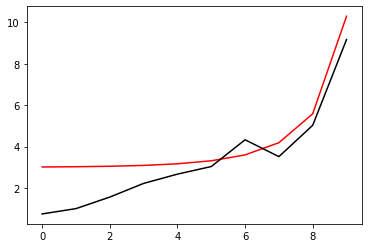

In [24]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.77722200212696
[0.74727201 1.0030696  1.56144443 2.22108339 2.66985006 3.03714479
 4.32859809 3.51526711 5.02915841 9.17084791]


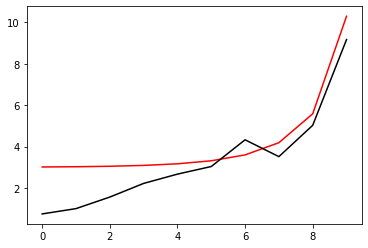

200 89.77721243952215
[0.74733648 1.00301447 1.56126008 2.22098956 2.67023748 3.03764742
 4.32790312 3.51519235 5.02927418 9.17080815]


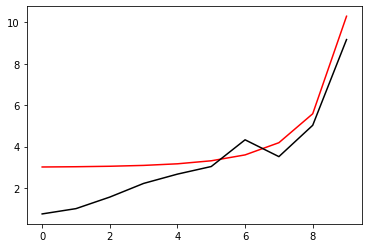

300 89.77720289872899
[0.74740079 1.00295947 1.56107615 2.22089591 2.67062412 3.03814946
 4.32720874 3.51511768 5.0293902  9.1707684 ]


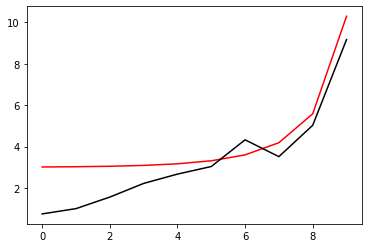

400 89.77719337968189
[0.74746495 1.0029046  1.56089266 2.22080245 2.67100996 3.03865092
 4.32651493 3.51504308 5.02950647 9.17072864]


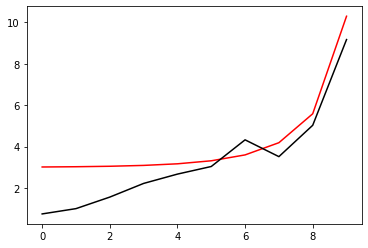

500 89.77718388231557
[0.74752895 1.00284985 1.56070959 2.22070916 2.67139502 3.0391518
 4.32582169 3.51496857 5.02962298 9.17068888]


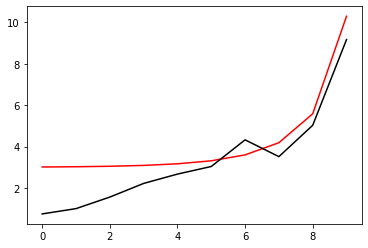

600 89.77717440656457
[0.7475928  1.00279524 1.56052694 2.22061607 2.67177929 3.0396521
 4.32512903 3.51489414 5.02973975 9.17064913]


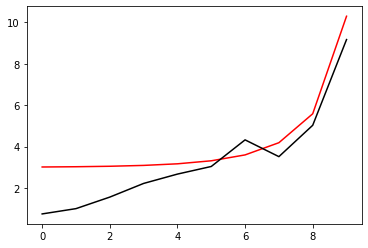

700 89.77716495236422
[0.74765648 1.00274075 1.56034472 2.22052315 2.67216278 3.04015181
 4.32443694 3.51481979 5.02985675 9.17060938]


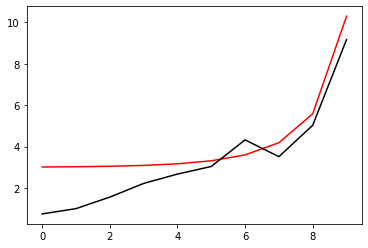

800 89.77715551964981
[0.74772002 1.00268639 1.56016293 2.22043042 2.67254549 3.04065094
 4.32374543 3.51474552 5.029974   9.17056963]


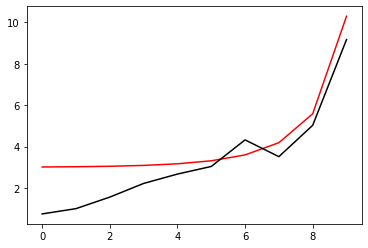

900 89.7771461083569
[0.74778339 1.00263215 1.55998155 2.22033786 2.67292742 3.04114949
 4.32305448 3.51467133 5.0300915  9.17052988]


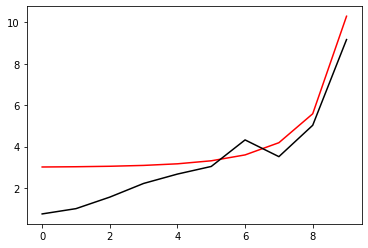

1000 89.77713671842127
[0.74784662 1.00257804 1.5598006  2.2202455  2.67330857 3.04164746
 4.32236411 3.51459722 5.03020924 9.17049013]


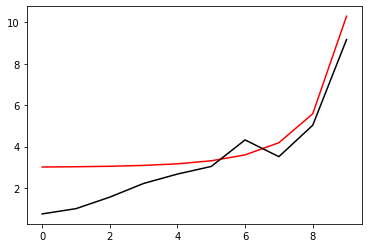

1100 89.77712734977898
[0.74790968 1.00252406 1.55962007 2.22015331 2.67368895 3.04214485
 4.32167431 3.51452319 5.03032722 9.17045039]


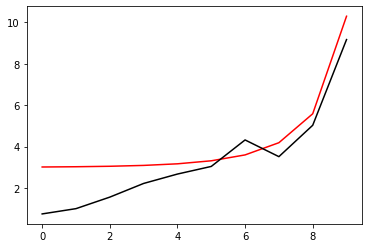

1200 89.77711800236625
[0.7479726  1.0024702  1.55943995 2.22006131 2.67406855 3.04264166
 4.32098508 3.51444924 5.03044545 9.17041064]


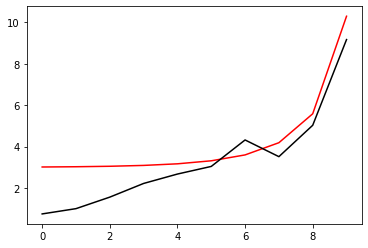

1300 89.77710867611974
[0.74803536 1.00241647 1.55926026 2.21996948 2.67444738 3.04313789
 4.32029642 3.51437537 5.03056392 9.1703709 ]


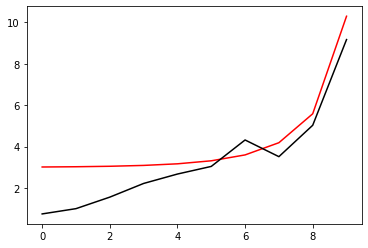

1400 89.777099370976
[0.74809797 1.00236286 1.55908098 2.21987784 2.67482545 3.04363355
 4.31960833 3.51430158 5.03068263 9.17033116]


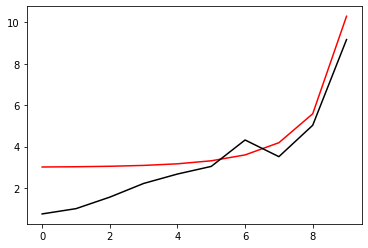

1500 89.77709008687215
[0.74816042 1.00230938 1.55890212 2.21978639 2.67520274 3.04412862
 4.31892081 3.51422787 5.03080158 9.17029142]


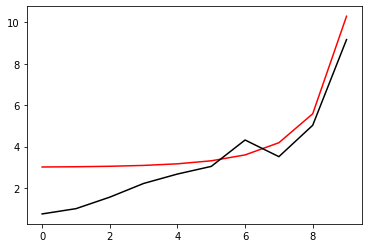

1600 89.7770808237454
[0.74822272 1.00225602 1.55872367 2.21969511 2.67557927 3.04462311
 4.31823385 3.51415423 5.03092077 9.17025168]


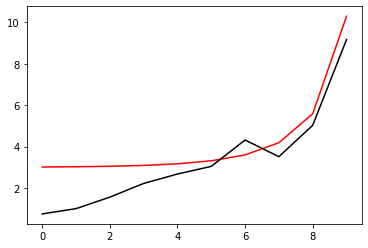

1700 89.77707158153304
[0.74828487 1.00220278 1.55854563 2.21960401 2.67595504 3.04511703
 4.31754746 3.51408068 5.0310402  9.17021194]


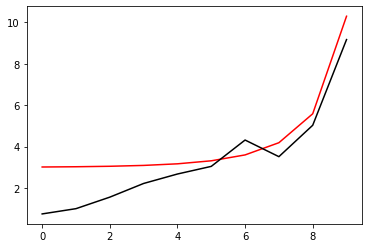

1800 89.77706236017295
[0.74834687 1.00214967 1.55836801 2.2195131  2.67633004 3.04561037
 4.31686164 3.5140072  5.03115987 9.17017221]


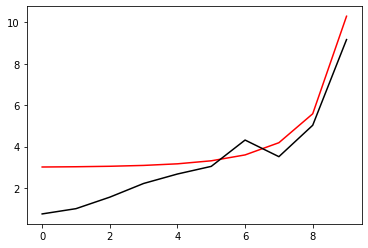

1900 89.7770531596029
[0.74840872 1.00209668 1.5581908  2.21942237 2.67670429 3.04610313
 4.31617639 3.5139338  5.03127978 9.17013247]


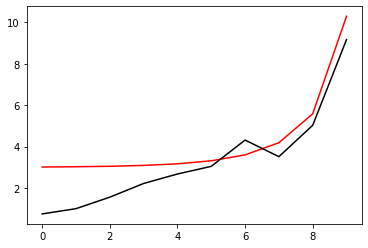

2000 89.77704397976109
[0.74847042 1.00204381 1.558014   2.21933182 2.67707777 3.04659531
 4.3154917  3.51386048 5.03139993 9.17009274]


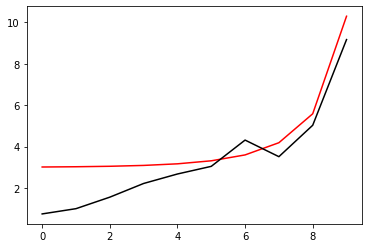

2100 89.7770348205858
[0.74853196 1.00199107 1.55783761 2.21924145 2.67745051 3.04708692
 4.31480757 3.51378723 5.03152032 9.17005301]


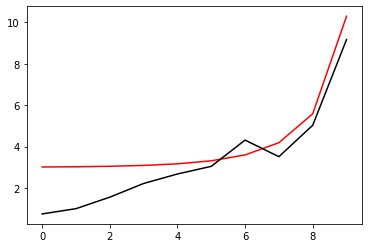

2200 89.7770256820157
[0.74859336 1.00193844 1.55766163 2.21915125 2.67782249 3.04757796
 4.31412401 3.51371406 5.03164094 9.17001328]


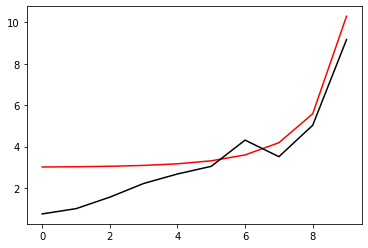

2300 89.7770165639895
[0.7486546  1.00188594 1.55748605 2.21906124 2.67819371 3.04806842
 4.31344102 3.51364097 5.0317618  9.16997355]


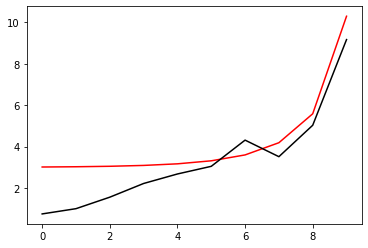

2400 89.77700746644636
[0.7487157  1.00183356 1.55731088 2.21897142 2.67856419 3.0485583
 4.31275858 3.51356795 5.0318829  9.16993383]


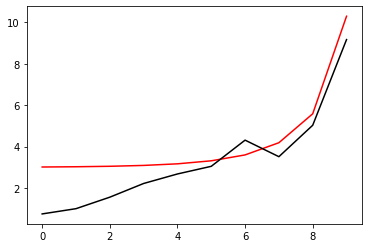

2500 89.77699838932541
[0.74877665 1.0017813  1.55713612 2.21888177 2.67893392 3.04904761
 4.31207671 3.51349501 5.03200423 9.1698941 ]


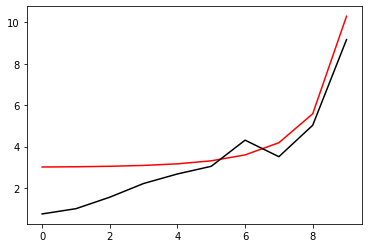

2600 89.77698933256622
[0.74883745 1.00172916 1.55696176 2.2187923  2.6793029  3.04953634
 4.3113954  3.51342214 5.0321258  9.16985438]


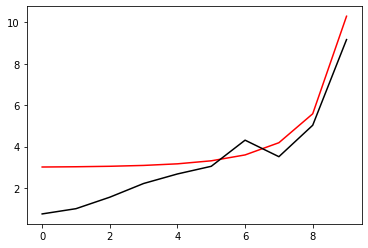

2700 89.77698029610842
[0.7488981  1.00167714 1.5567878  2.21870301 2.67967114 3.0500245
 4.31071465 3.51334935 5.0322476  9.16981466]


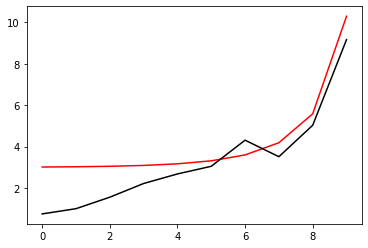

2800 89.77697127989192
[0.7489586  1.00162524 1.55661425 2.2186139  2.68003864 3.05051209
 4.31003447 3.51327663 5.03236964 9.16977494]


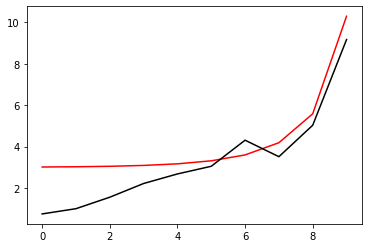

2900 89.77696228385693
[0.74901896 1.00157346 1.55644109 2.21852497 2.6804054  3.05099911
 4.30935484 3.51320399 5.03249191 9.16973522]


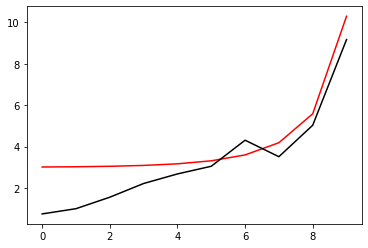

3000 89.77695330794378
[0.74907916 1.00152179 1.55626834 2.21843621 2.68077142 3.05148555
 4.30867577 3.51313143 5.03261441 9.1696955 ]


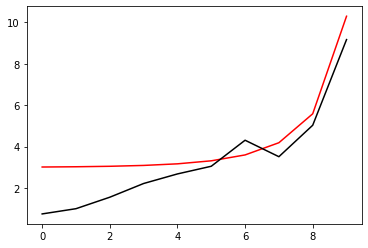

3100 89.77694435209295
[0.74913923 1.00147025 1.55609598 2.21834764 2.6811367  3.05197142
 4.30799726 3.51305893 5.03273715 9.16965579]


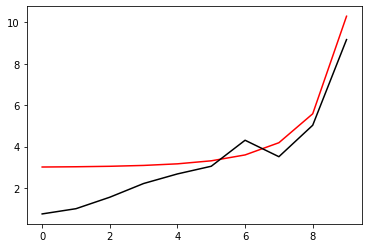

3200 89.77693541624534
[0.74919914 1.00141882 1.55592402 2.21825925 2.68150125 3.05245672
 4.30731931 3.51298651 5.03286011 9.16961607]


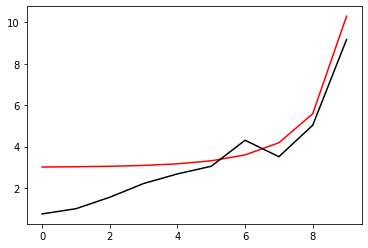

3300 89.77692650034184
[0.74925891 1.00136751 1.55575246 2.21817104 2.68186506 3.05294145
 4.30664191 3.51291417 5.03298331 9.16957636]


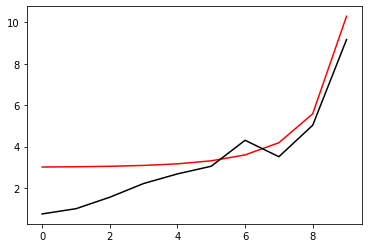

3400 89.7769176043238
[0.74931853 1.00131632 1.5555813  2.218083   2.68222814 3.05342561
 4.30596507 3.5128419  5.03310674 9.16953665]


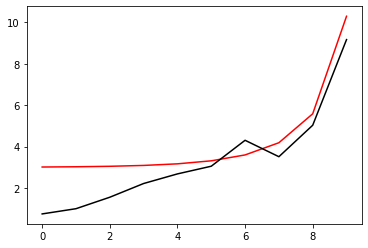

3500 89.77690872813254
[0.74937801 1.00126525 1.55541053 2.21799514 2.6825905  3.05390919
 4.30528879 3.5127697  5.0332304  9.16949694]


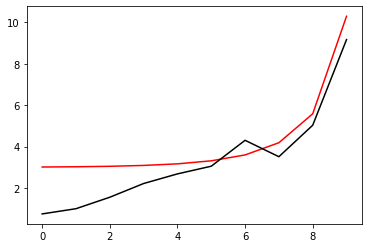

3600 89.77689987170977
[0.74943735 1.00121429 1.55524015 2.21790747 2.68295213 3.05439221
 4.30461307 3.51269757 5.03335429 9.16945724]


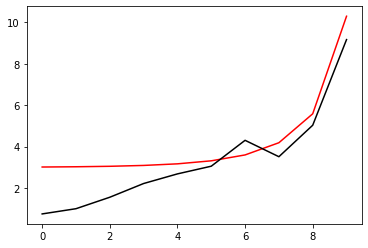

3700 89.77689103499729
[0.74949654 1.00116345 1.55507017 2.21781997 2.68331303 3.05487466
 4.3039379  3.51262552 5.03347841 9.16941753]


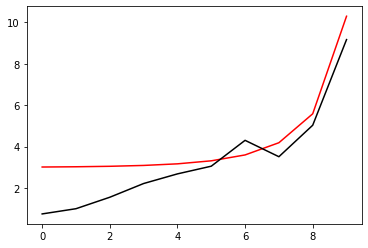

3800 89.77688221793714
[0.74955558 1.00111273 1.55490058 2.21773264 2.68367321 3.05535654
 4.30326328 3.51255354 5.03360276 9.16937783]


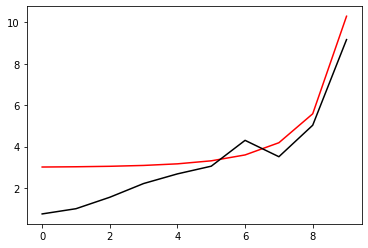

3900 89.77687342047165
[0.74961448 1.00106212 1.55473137 2.2176455  2.68403267 3.05583785
 4.30258922 3.51248163 5.03372733 9.16933812]


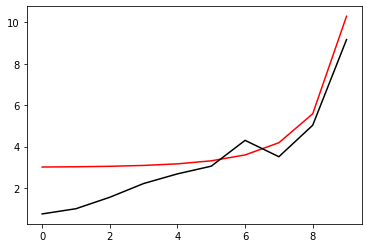

4000 89.77686464254326
[0.74967324 1.00101163 1.55456256 2.21755853 2.68439141 3.05631859
 4.30191571 3.51240979 5.03385214 9.16929842]


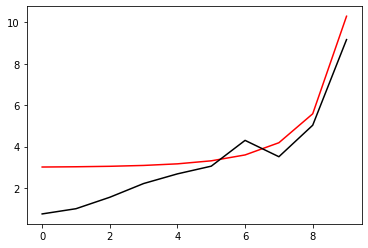

4100 89.7768558840947
[0.74973185 1.00096125 1.55439414 2.21747174 2.68474943 3.05679877
 4.30124275 3.51233802 5.03397717 9.16925872]


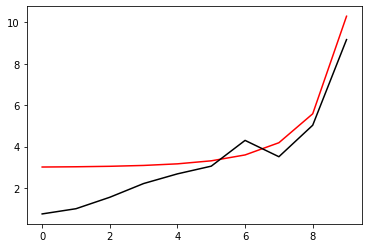

4200 89.77684714506883
[0.74979033 1.00091099 1.55422611 2.21738513 2.68510674 3.05727838
 4.30057035 3.51226633 5.03410243 9.16921902]


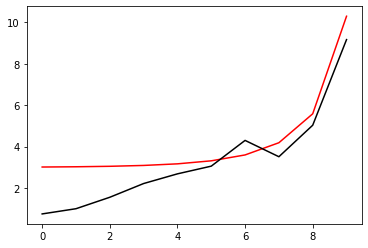

4300 89.7768384254087
[0.74984866 1.00086084 1.55405846 2.2172987  2.68546333 3.05775742
 4.29989849 3.5121947  5.03422791 9.16917933]


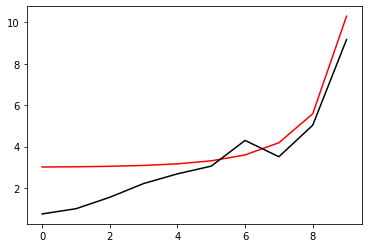

4400 89.77682972505765
[0.74990684 1.0008108  1.55389119 2.21721244 2.68581921 3.05823589
 4.29922719 3.51212315 5.03435362 9.16913963]


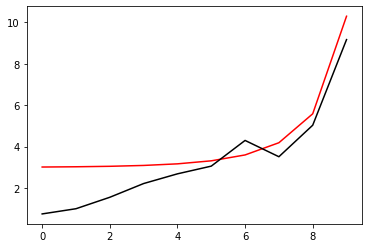

4500 89.77682104395923
[0.74996489 1.00076088 1.55372432 2.21712636 2.68617437 3.0587138
 4.29855644 3.51205166 5.03447955 9.16909994]


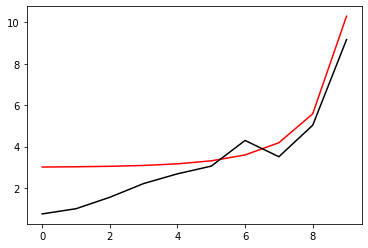

4600 89.77681238205709
[0.75002279 1.00071108 1.55355782 2.21704045 2.68652883 3.05919115
 4.29788623 3.51198025 5.03460571 9.16906025]


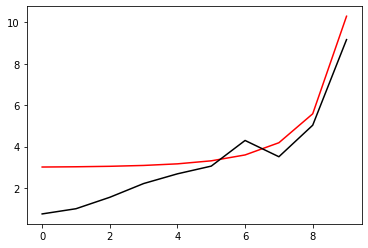

4700 89.77680373929522
[0.75008056 1.00066138 1.55339171 2.21695473 2.68688259 3.05966793
 4.29721658 3.51190891 5.0347321  9.16902056]


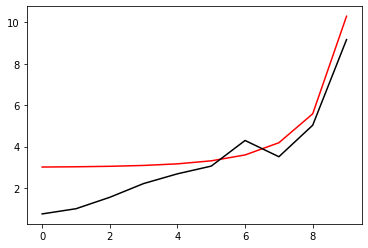

4800 89.77679511561756
[0.75013818 1.0006118  1.55322598 2.21686917 2.68723563 3.06014414
 4.29654748 3.51183763 5.0348587  9.16898087]


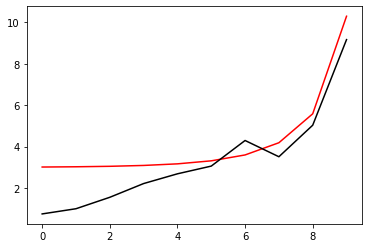

4900 89.77678651096859
[0.75019566 1.00056233 1.55306063 2.2167838  2.68758798 3.06061979
 4.29587892 3.51176643 5.03498553 9.16894118]


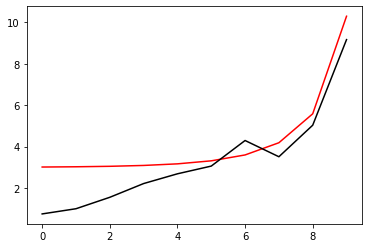

5000 89.77677792529279
[0.75025301 1.00051298 1.55289567 2.2166986  2.68793962 3.06109487
 4.29521091 3.51169529 5.03511259 9.1689015 ]


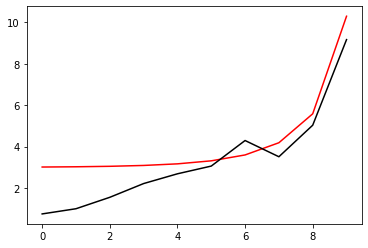

5100 89.77676935853482
[0.75031021 1.00046373 1.55273108 2.21661358 2.68829056 3.0615694
 4.29454344 3.51162422 5.03523986 9.16886181]


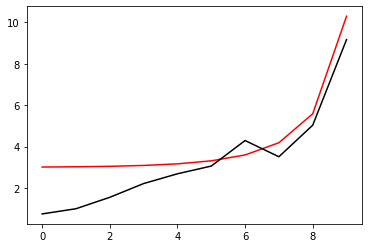

5200 89.7767608106396
[0.75036727 1.0004146  1.55256687 2.21652873 2.68864081 3.06204336
 4.29387653 3.51155323 5.03536736 9.16882213]


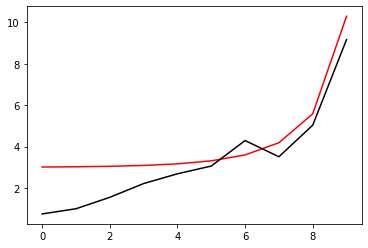

5300 89.77675228155225
[0.7504242  1.00036558 1.55240303 2.21644406 2.68899036 3.06251675
 4.29321016 3.51148229 5.03549508 9.16878245]


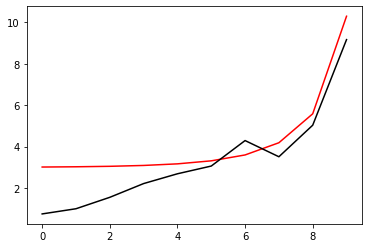

5400 89.77674377121801
[0.75048099 1.00031666 1.55223957 2.21635956 2.68933921 3.06298959
 4.29254433 3.51141143 5.03562301 9.16874277]


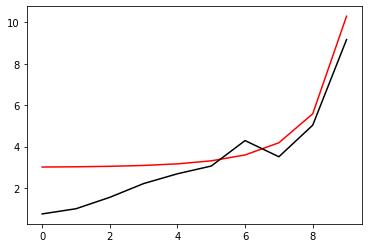

5500 89.77673527958245
[0.75053764 1.00026786 1.55207649 2.21627524 2.68968738 3.06346186
 4.29187905 3.51134064 5.03575117 9.1687031 ]


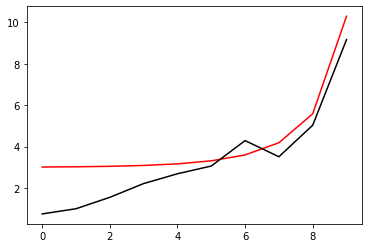

5600 89.77672680659123
[0.75059415 1.00021917 1.55191378 2.21619109 2.69003485 3.06393357
 4.29121431 3.51126991 5.03587955 9.16866342]


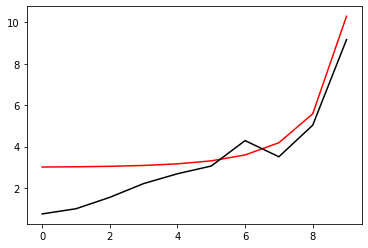

5700 89.7767183521902
[0.75065052 1.00017059 1.55175144 2.21610712 2.69038163 3.06440473
 4.29055011 3.51119925 5.03600815 9.16862375]


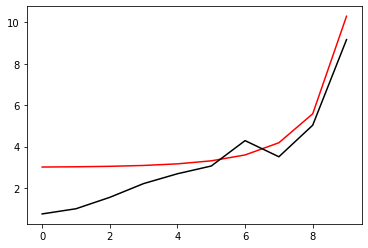

5800 89.77670991632549
[0.75070676 1.00012212 1.55158948 2.21602332 2.69072773 3.06487532
 4.28988646 3.51112866 5.03613696 9.16858407]


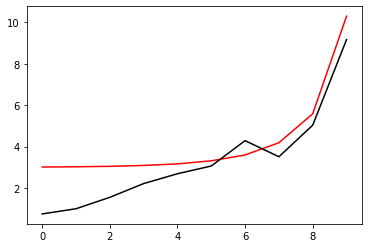

5900 89.77670149894325
[0.75076286 1.00007376 1.55142789 2.21593969 2.69107314 3.06534535
 4.28922335 3.51105813 5.036266   9.1685444 ]


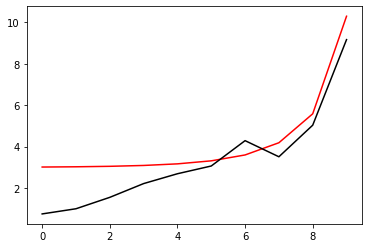

6000 89.77669309999013
[0.75081882 1.00002551 1.55126667 2.21585625 2.69141786 3.06581482
 4.28856078 3.51098767 5.03639525 9.16850473]


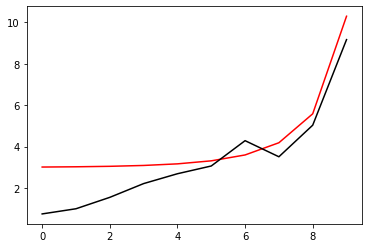

6100 89.77668471941259
[0.75087465 0.99997737 1.55110582 2.21577297 2.69176191 3.06628373
 4.28789875 3.51091728 5.03652472 9.16846507]


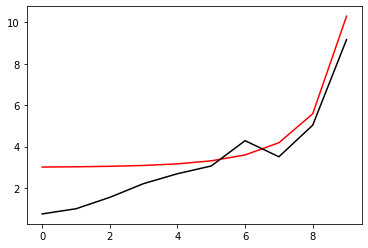

6200 89.7766763571576
[0.75093034 0.99992933 1.55094533 2.21568987 2.69210527 3.06675209
 4.28723726 3.51084695 5.0366544  9.1684254 ]


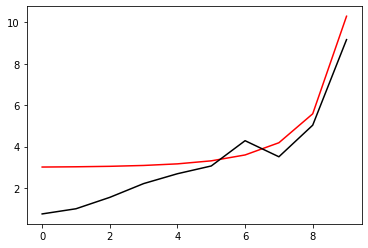

6300 89.77666801317204
[0.75098589 0.9998814  1.55078522 2.21560694 2.69244795 3.06721988
 4.28657631 3.51077669 5.0367843  9.16838574]


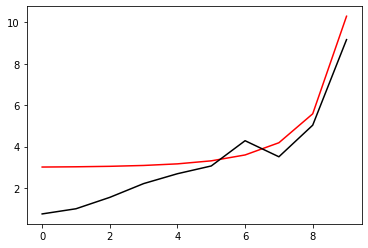

6400 89.7766596874032
[0.75104132 0.99983358 1.55062547 2.21552419 2.69278996 3.06768712
 4.2859159  3.51070649 5.03691442 9.16834607]


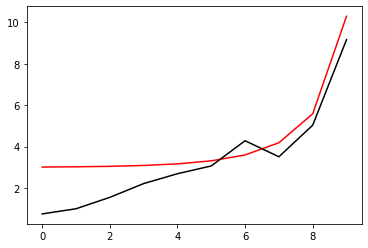

6500 89.77665137979845
[0.7510966  0.99978587 1.55046608 2.2154416  2.69313129 3.0681538
 4.28525602 3.51063636 5.03704475 9.16830641]


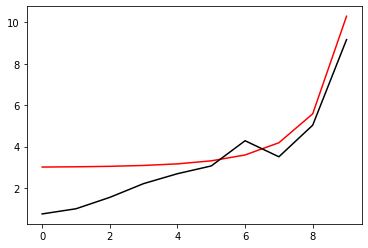

6600 89.77664309030541
[0.75115175 0.99973827 1.55030706 2.2153592  2.69347195 3.06861993
 4.28459669 3.51056629 5.0371753  9.16826675]


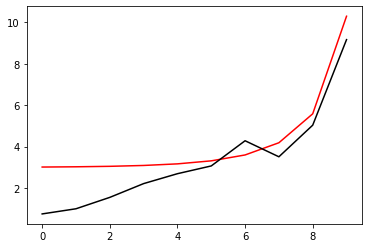

6700 89.77663481887178
[0.75120677 0.99969077 1.55014841 2.21527696 2.69381194 3.0690855
 4.28393789 3.51049629 5.03730606 9.1682271 ]


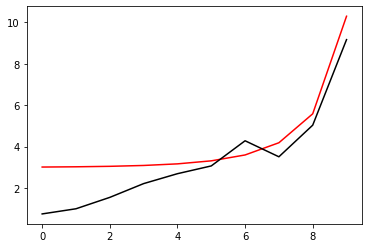

6800 89.77662656544561
[0.75126165 0.99964338 1.54999012 2.2151949  2.69415126 3.06955051
 4.28327963 3.51042635 5.03743703 9.16818744]


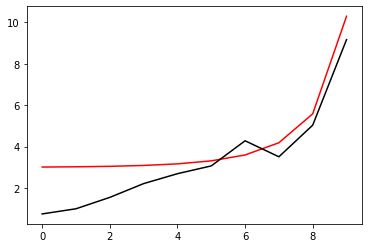

6900 89.77661832997497
[0.7513164  0.99959609 1.54983219 2.21511301 2.69448991 3.07001497
 4.28262191 3.51035648 5.03756822 9.16814779]


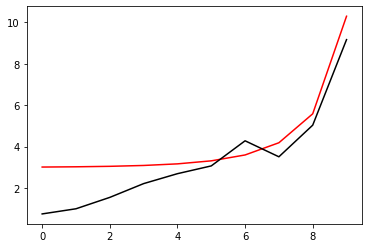

7000 89.77661011240816
[0.75137102 0.99954891 1.54967462 2.21503129 2.69482789 3.07047887
 4.28196472 3.51028667 5.03769962 9.16810813]


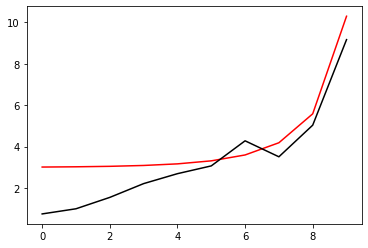

7100 89.77660191269366
[0.75142551 0.99950184 1.54951741 2.21494974 2.69516521 3.07094222
 4.28130806 3.51021692 5.03783123 9.16806848]


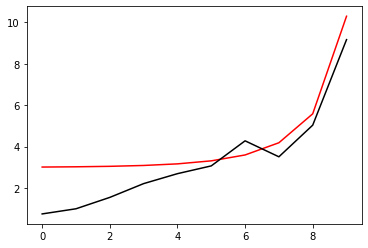

7200 89.77659373078023
[0.75147986 0.99945487 1.54936056 2.21486837 2.69550186 3.07140501
 4.28065194 3.51014724 5.03796306 9.16802883]


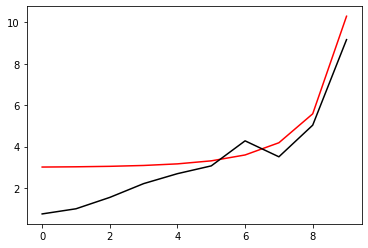

7300 89.77658556661666
[0.75153408 0.99940801 1.54920407 2.21478717 2.69583786 3.07186725
 4.27999636 3.51007762 5.03809509 9.16798918]


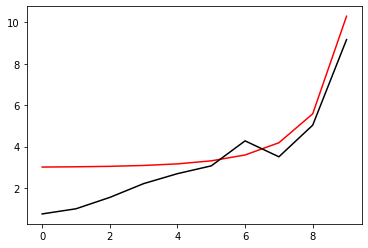

7400 89.776577420152
[0.75158817 0.99936125 1.54904794 2.21470614 2.69617319 3.07232893
 4.2793413  3.51000806 5.03822734 9.16794954]


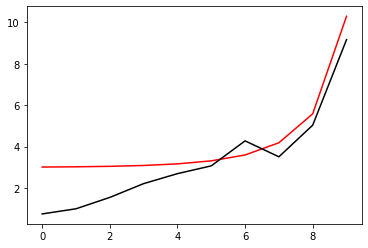

7500 89.77656929133545
[0.75164212 0.99931459 1.54889216 2.21462528 2.69650787 3.07279007
 4.27868678 3.50993857 5.0383598  9.16790989]


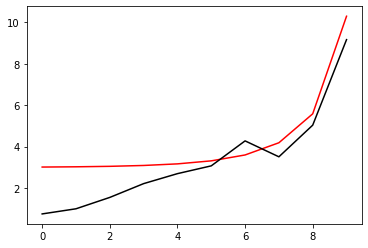

7600 89.77656118011646
[0.75169595 0.99926804 1.54873674 2.21454459 2.69684188 3.07325065
 4.2780328  3.50986914 5.03849246 9.16787025]


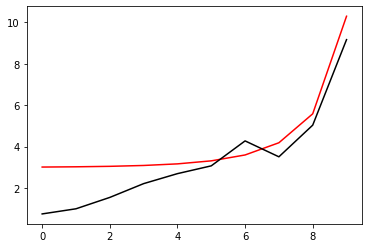

7700 89.77655308644457
[0.75174964 0.9992216  1.54858167 2.21446407 2.69717525 3.07371068
 4.27737934 3.50979977 5.03862534 9.16783061]


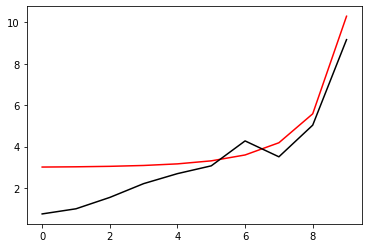

7800 89.77654501026949
[0.75180321 0.99917526 1.54842696 2.21438373 2.69750796 3.07417015
 4.27672641 3.50973046 5.03875843 9.16779097]


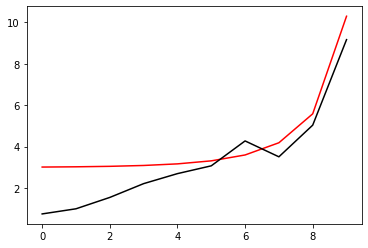

7900 89.77653695154115
[0.75185664 0.99912902 1.5482726  2.21430355 2.69784002 3.07462908
 4.27607402 3.50966122 5.03889172 9.16775133]


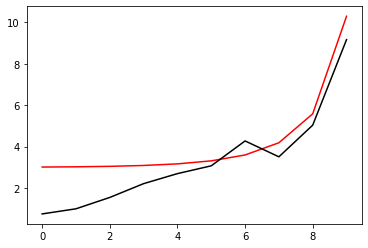

8000 89.77652891020976
[0.75190994 0.99908288 1.5481186  2.21422355 2.69817143 3.07508745
 4.27542215 3.50959204 5.03902522 9.1677117 ]


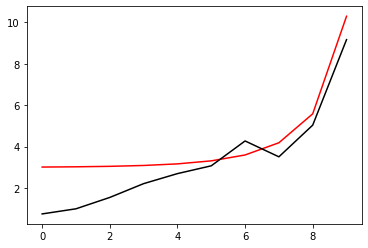

8100 89.77652088622533
[0.75196312 0.99903685 1.54796494 2.21414371 2.69850219 3.07554528
 4.27477082 3.50952291 5.03915893 9.16767206]


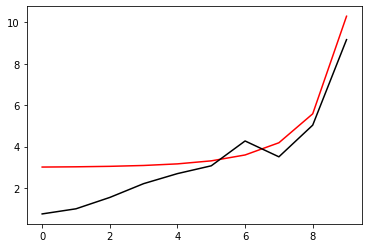

8200 89.77651287953866
[0.75201616 0.99899091 1.54781164 2.21406405 2.6988323  3.07600255
 4.27412001 3.50945385 5.03929285 9.16763243]


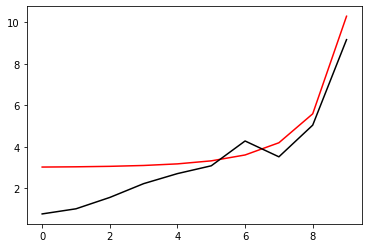

8300 89.77650489010009
[0.75206908 0.99894509 1.54765869 2.21398456 2.69916177 3.07645928
 4.27346973 3.50938485 5.03942697 9.1675928 ]


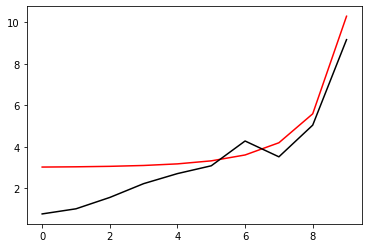

8400 89.77649691786048
[0.75212187 0.99889936 1.54750608 2.21390523 2.6994906  3.07691546
 4.27281997 3.50931591 5.0395613  9.16755317]


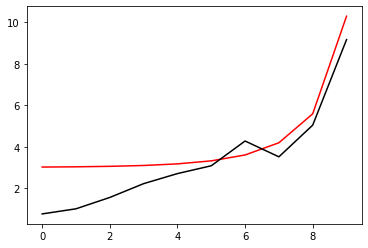

8500 89.77648896277086
[0.75217453 0.99885373 1.54735382 2.21382608 2.69981878 3.07737108
 4.27217075 3.50924703 5.03969583 9.16751354]


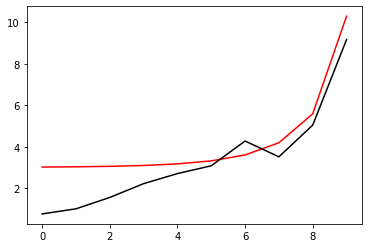

8600 89.77648102478224
[0.75222706 0.99880821 1.54720191 2.21374709 2.70014632 3.07782616
 4.27152205 3.50917822 5.03983057 9.16747391]


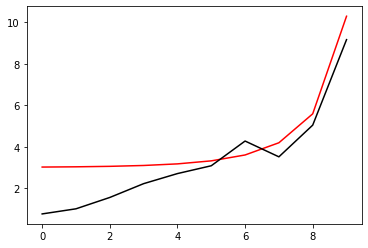

8700 89.77647310384607
[0.75227946 0.99876278 1.54705035 2.21366827 2.70047323 3.0782807
 4.27087388 3.50910946 5.03996552 9.16743429]


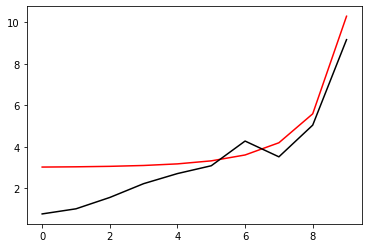

8800 89.77646519991367
[0.75233174 0.99871746 1.54689913 2.21358963 2.7007995  3.07873468
 4.27022623 3.50904076 5.04010067 9.16739467]


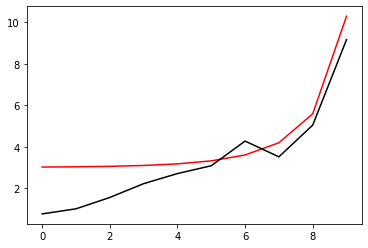

8900 89.77645731293673
[0.75238389 0.99867224 1.54674825 2.21351115 2.70112513 3.07918812
 4.2695791  3.50897212 5.04023602 9.16735505]


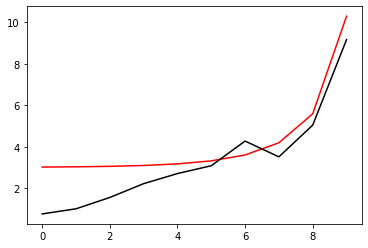

9000 89.77644944286705
[0.75243591 0.99862712 1.54659772 2.21343284 2.70145013 3.07964101
 4.2689325  3.50890354 5.04037158 9.16731543]


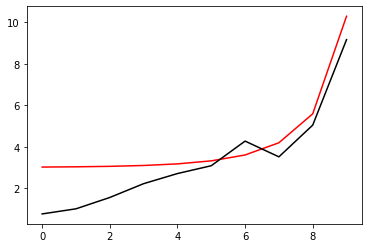

9100 89.77644158965671
[0.75248781 0.99858209 1.54644753 2.21335469 2.7017745  3.08009336
 4.26828643 3.50883501 5.04050733 9.16727581]


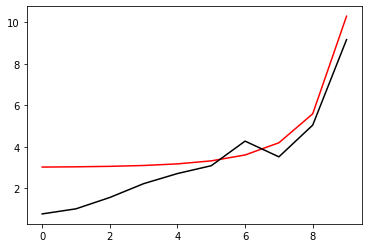

9200 89.77643375325763
[0.75253958 0.99853717 1.54629768 2.21327672 2.70209824 3.08054516
 4.26764087 3.50876655 5.0406433  9.16723619]


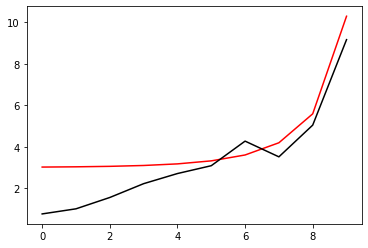

9300 89.7764259336223
[0.75259122 0.99849235 1.54614818 2.21319891 2.70242134 3.08099642
 4.26699584 3.50869814 5.04077946 9.16719658]


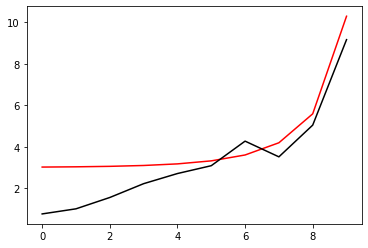

9400 89.77641813070308
[0.75264274 0.99844762 1.54599901 2.21312128 2.70274382 3.08144713
 4.26635133 3.5086298  5.04091582 9.16715696]


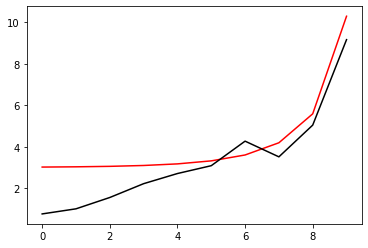

9500 89.77641034445259
[0.75269413 0.998403   1.54585019 2.2130438  2.70306568 3.0818973
 4.26570734 3.50856151 5.04105239 9.16711735]


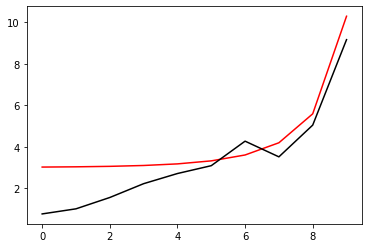

9600 89.77640257482376
[0.7527454  0.99835847 1.5457017  2.2129665  2.70338691 3.08234692
 4.26506388 3.50849328 5.04118916 9.16707774]


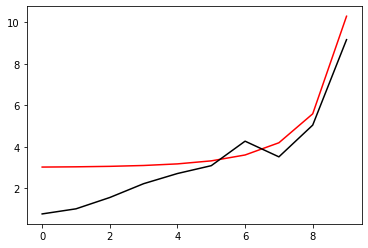

9700 89.77639482176939
[0.75279654 0.99831404 1.54555355 2.21288937 2.70370752 3.08279601
 4.26442093 3.50842511 5.04132612 9.16703814]


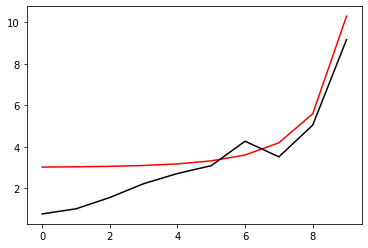

9800 89.7763870852426
[0.75284756 0.99826971 1.54540574 2.2128124  2.70402751 3.08324454
 4.2637785  3.50835699 5.04146329 9.16699853]


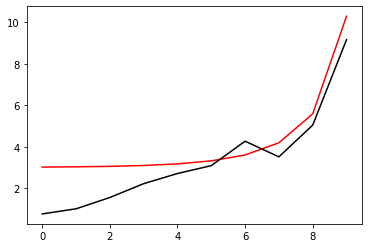

9900 89.77637936519682
[0.75289846 0.99822547 1.54525826 2.21273559 2.70434688 3.08369254
 4.26313659 3.50828893 5.04160066 9.16695893]


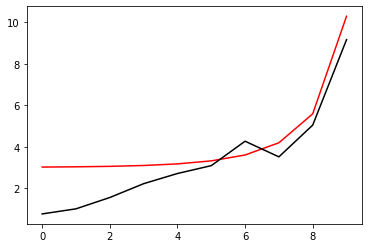

10000 89.77637166158534
[0.75294923 0.99818134 1.54511112 2.21265896 2.70466563 3.08413999
 4.2624952  3.50822093 5.04173822 9.16691932]


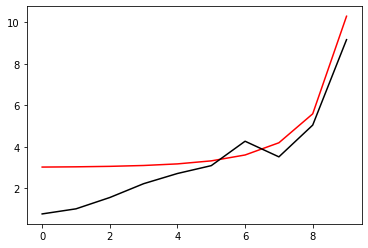

In [25]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.77636397436186
[0.75299988 0.9981373  1.54496431 2.21258249 2.70498376 3.08458691
 4.26185433 3.50815298 5.04187598 9.16687972]


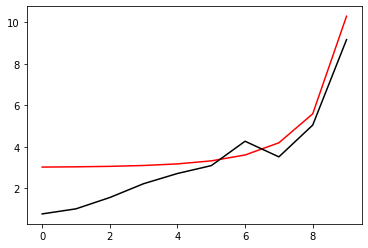

200 89.77635630348001
[0.75305041 0.99809336 1.54481784 2.21250619 2.70530128 3.08503328
 4.26121397 3.5080851  5.04201394 9.16684012]


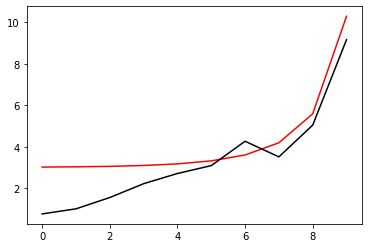

300 89.7763486488938
[0.75310081 0.99804951 1.54467169 2.21243005 2.70561818 3.08547911
 4.26057413 3.50801726 5.0421521  9.16680053]


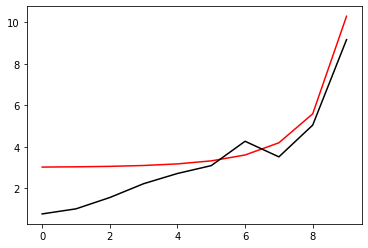

400 89.77634101055732
[0.75315109 0.99800576 1.54452588 2.21235408 2.70593448 3.0859244
 4.25993481 3.50794949 5.04229046 9.16676093]


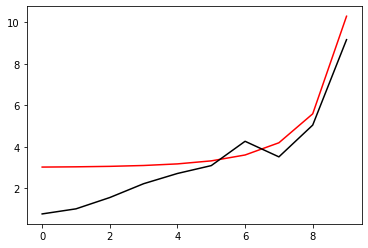

500 89.77633338842472
[0.75320125 0.99796211 1.54438041 2.21227827 2.70625016 3.08636916
 4.25929601 3.50788177 5.04242901 9.16672134]


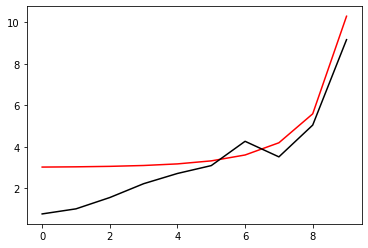

600 89.77632578245048
[0.75325128 0.99791855 1.54423526 2.21220263 2.70656524 3.08681337
 4.25865771 3.5078141  5.04256776 9.16668174]


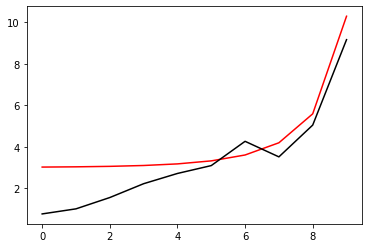

700 89.7763181925891
[0.7533012  0.99787509 1.54409044 2.21212716 2.70687971 3.08725704
 4.25801994 3.50774649 5.0427067  9.16664215]


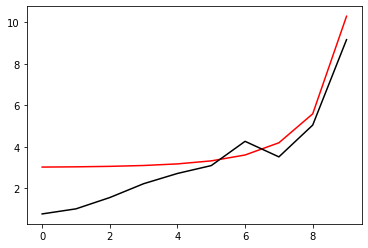

800 89.77631061879518
[0.75335099 0.99783172 1.54394595 2.21205185 2.70719357 3.08770018
 4.25738267 3.50767894 5.04284584 9.16660256]


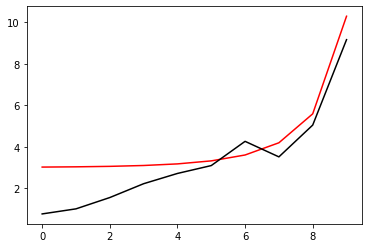

900 89.77630306102371
[0.75340066 0.99778845 1.54380179 2.2119767  2.70750683 3.08814278
 4.25674592 3.50761144 5.04298518 9.16656298]


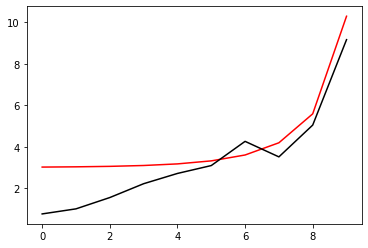

1000 89.77629551922963
[0.75345021 0.99774527 1.54365795 2.21190172 2.70781948 3.08858484
 4.25610969 3.50754399 5.0431247  9.16652339]


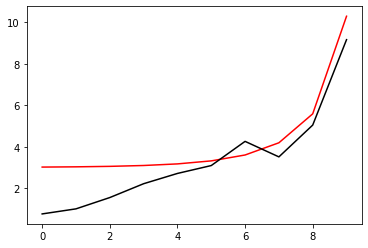

1100 89.77628799336817
[0.75349964 0.99770219 1.54351444 2.21182691 2.70813154 3.08902636
 4.25547396 3.5074766  5.04326443 9.16648381]


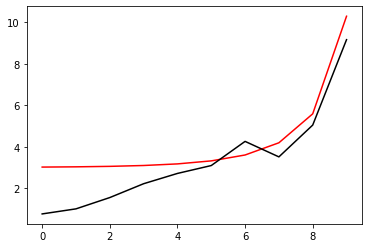

1200 89.77628048339453
[0.75354895 0.9976592  1.54337126 2.21175226 2.708443   3.08946735
 4.25483875 3.50740927 5.04340434 9.16644423]


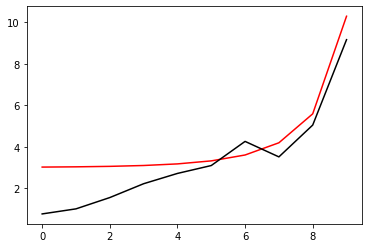

1300 89.77627298926424
[0.75359814 0.99761631 1.5432284  2.21167777 2.70875385 3.0899078
 4.25420405 3.50734199 5.04354445 9.16640465]


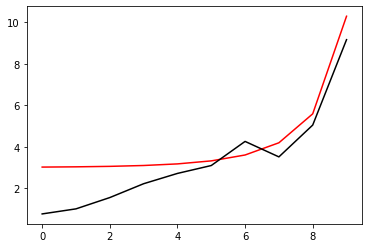

1400 89.77626551093294
[0.75364721 0.99757351 1.54308587 2.21160344 2.70906412 3.09034772
 4.25356985 3.50727476 5.04368475 9.16636507]


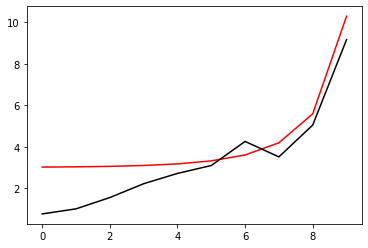

1500 89.7762580483563
[0.75369616 0.9975308  1.54294366 2.21152928 2.70937378 3.0907871
 4.25293617 3.50720758 5.04382525 9.16632549]


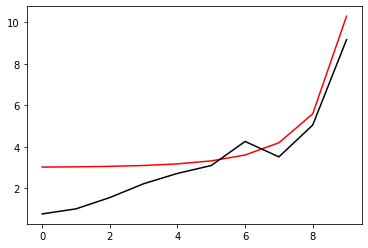

1600 89.77625060149035
[0.753745   0.99748819 1.54280177 2.21145529 2.70968285 3.09122594
 4.252303   3.50714046 5.04396593 9.16628591]


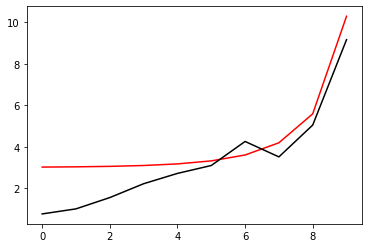

1700 89.77624317029101
[0.75379371 0.99744566 1.5426602  2.21138145 2.70999134 3.09166425
 4.25167034 3.50707339 5.04410681 9.16624634]


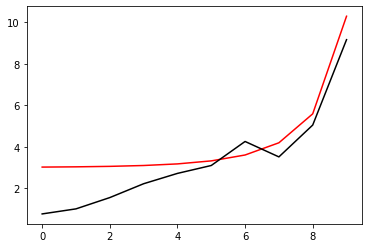

1800 89.7762357547146
[0.75384231 0.99740324 1.54251895 2.21130778 2.71029923 3.09210203
 4.25103819 3.50700638 5.04424788 9.16620677]


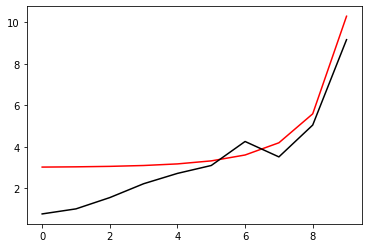

1900 89.77622835471752
[0.75389078 0.9973609  1.54237803 2.21123428 2.71060653 3.09253928
 4.25040654 3.50693942 5.04438914 9.1661672 ]


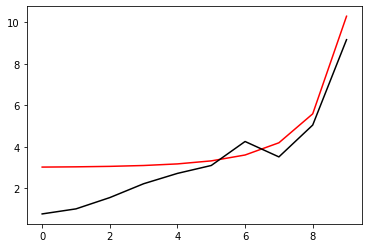

2000 89.77622097025615
[0.75393914 0.99731866 1.54223742 2.21116093 2.71091324 3.09297599
 4.2497754  3.50687251 5.04453058 9.16612763]


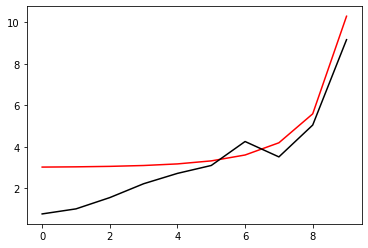

2100 89.77621360128728
[0.75398738 0.9972765  1.54209713 2.21108775 2.71121937 3.09341217
 4.24914477 3.50680565 5.04467222 9.16608806]


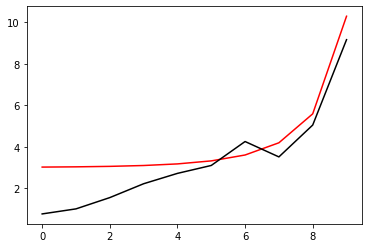

2200 89.77620624776762
[0.75403551 0.99723444 1.54195716 2.21101473 2.71152491 3.09384781
 4.24851464 3.50673885 5.04481405 9.1660485 ]


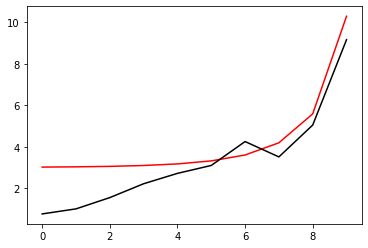

2300 89.77619890965417
[0.75408351 0.99719247 1.5418175  2.21094187 2.71182987 3.09428293
 4.24788502 3.50667209 5.04495607 9.16600894]


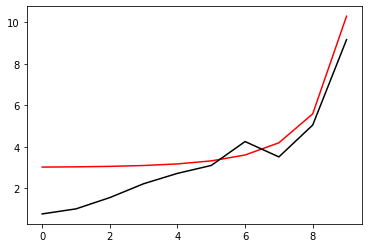

2400 89.7761915869039
[0.7541314  0.9971506  1.54167816 2.21086918 2.71213425 3.09471751
 4.24725591 3.50660539 5.04509827 9.16596938]


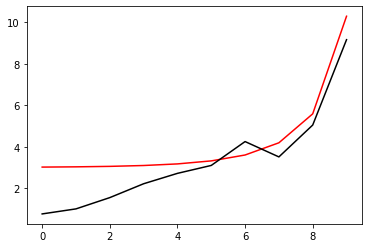

2500 89.77618427947421
[0.75417918 0.99710881 1.54153914 2.21079664 2.71243805 3.09515157
 4.2466273  3.50653874 5.04524066 9.16592982]


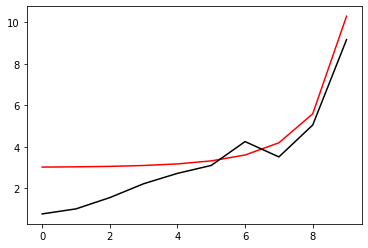

2600 89.77617698732239
[0.75422684 0.99706711 1.54140043 2.21072427 2.71274127 3.09558509
 4.24599919 3.50647214 5.04538325 9.16589026]


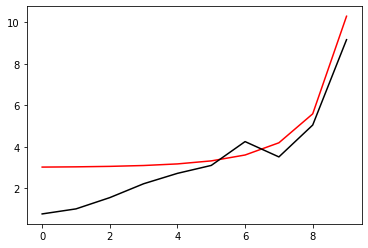

2700 89.77616971040597
[0.75427438 0.99702551 1.54126204 2.21065206 2.71304391 3.09601808
 4.24537159 3.5064056  5.04552601 9.1658507 ]


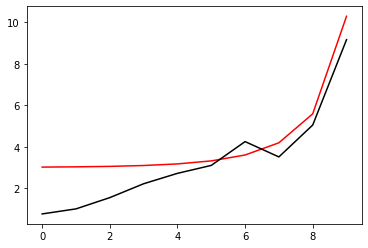

2800 89.77616244868263
[0.7543218  0.99698399 1.54112395 2.21058001 2.71334598 3.09645055
 4.24474449 3.5063391  5.04566897 9.16581115]


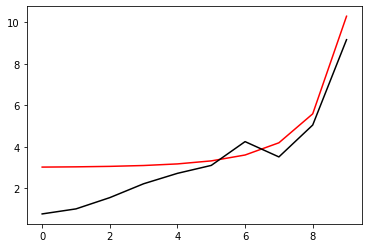

2900 89.77615520211019
[0.75436911 0.99694257 1.54098618 2.21050812 2.71364747 3.09688248
 4.24411789 3.50627266 5.04581211 9.1657716 ]


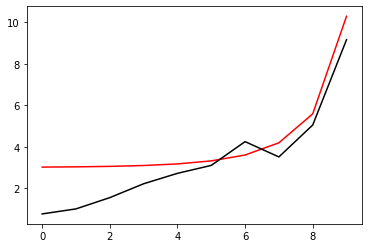

3000 89.77614797064659
[0.75441631 0.99690123 1.54084873 2.21043639 2.71394839 3.09731389
 4.2434918  3.50620626 5.04595543 9.16573205]


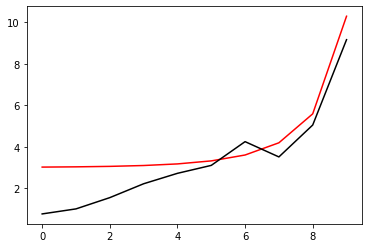

3100 89.77614075424992
[0.75446339 0.99685998 1.54071158 2.21036482 2.71424873 3.09774477
 4.24286621 3.50613992 5.04609895 9.1656925 ]


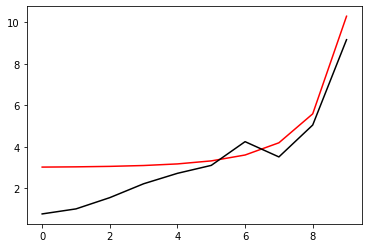

3200 89.77613355287843
[0.75451036 0.99681883 1.54057474 2.21029341 2.71454851 3.09817512
 4.24224111 3.50607362 5.04624264 9.16565295]


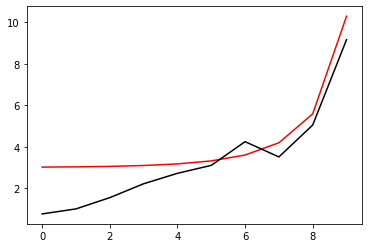

3300 89.77612636649047
[0.75455721 0.99677776 1.54043821 2.21022216 2.71484772 3.09860495
 4.24161652 3.50600738 5.04638652 9.1656134 ]


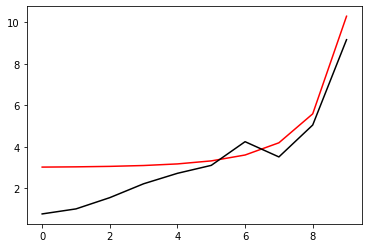

3400 89.7761191950445
[0.75460395 0.99673678 1.54030199 2.21015107 2.71514636 3.09903425
 4.24099243 3.50594118 5.04653059 9.16557386]


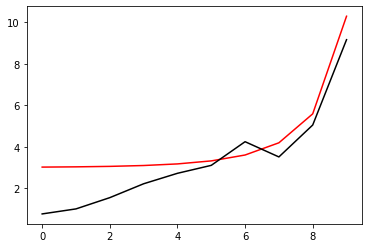

3500 89.77611203849925
[0.75465057 0.99669589 1.54016608 2.21008014 2.71544443 3.09946302
 4.24036883 3.50587503 5.04667484 9.16553432]


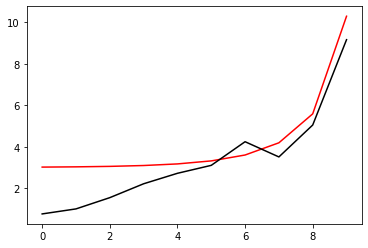

3600 89.77610489681351
[0.75469708 0.99665508 1.54003047 2.21000938 2.71574194 3.09989126
 4.23974574 3.50580894 5.04681927 9.16549478]


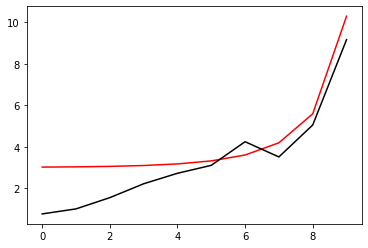

3700 89.77609776994606
[0.75474348 0.99661437 1.53989518 2.20993877 2.71603889 3.10031899
 4.23912314 3.50574289 5.04696389 9.16545524]


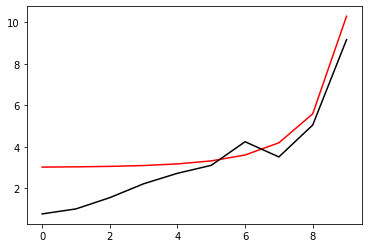

3800 89.77609065785617
[0.75478976 0.99657374 1.53976018 2.20986831 2.71633527 3.10074618
 4.23850104 3.50567689 5.04710869 9.1654157 ]


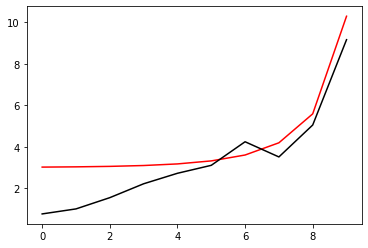

3900 89.77608356050291
[0.75483593 0.9965332  1.53962549 2.20979802 2.7166311  3.10117285
 4.23787944 3.50561094 5.04725367 9.16537617]


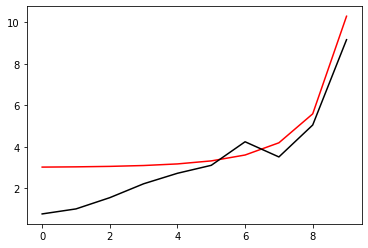

4000 89.77607647784562
[0.75488199 0.99649275 1.53949111 2.20972789 2.71692637 3.101599
 4.23725834 3.50554504 5.04739883 9.16533663]


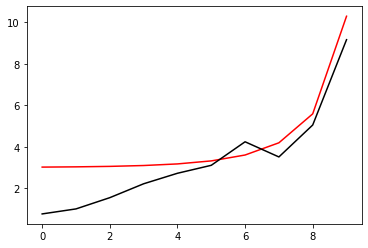

4100 89.77606940984379
[0.75492794 0.99645239 1.53935703 2.20965791 2.71722107 3.10202463
 4.23663773 3.50547919 5.04754418 9.1652971 ]


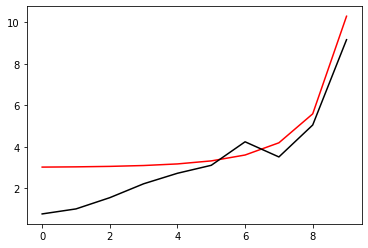

4200 89.77606235645702
[0.75497377 0.99641211 1.53922325 2.2095881  2.71751523 3.10244973
 4.23601762 3.50541338 5.0476897  9.16525757]


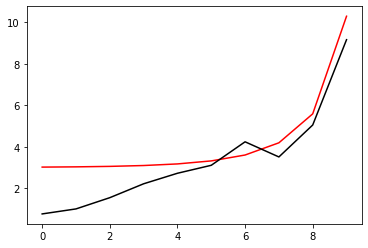

4300 89.77605531764507
[0.7550195  0.99637192 1.53908977 2.20951844 2.71780883 3.10287431
 4.235398   3.50534763 5.04783541 9.16521805]


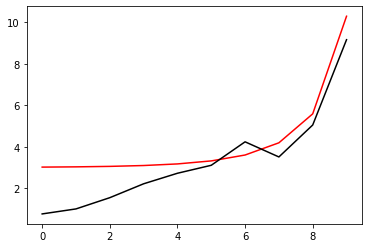

4400 89.7760482933678
[0.75506511 0.99633181 1.5389566  2.20944894 2.71810187 3.10329836
 4.23477887 3.50528192 5.04798129 9.16517852]


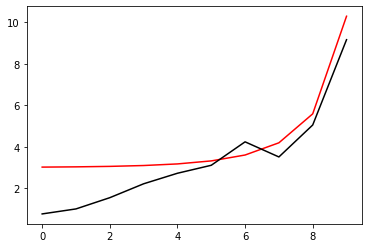

4500 89.77604128358519
[0.75511061 0.99629179 1.53882372 2.20937959 2.71839436 3.1037219
 4.23416024 3.50521626 5.04812736 9.165139  ]


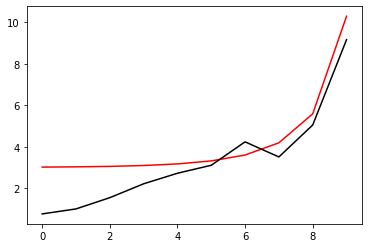

4600 89.77603428825738
[0.755156   0.99625186 1.53869115 2.20931041 2.7186863  3.10414491
 4.23354211 3.50515064 5.0482736  9.16509947]


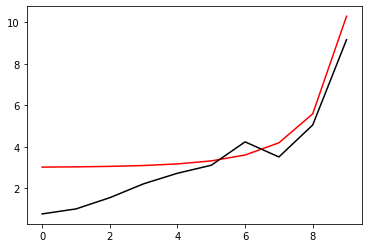

4700 89.7760273073446
[0.75520128 0.99621201 1.53855887 2.20924138 2.7189777  3.1045674
 4.23292446 3.50508508 5.04842003 9.16505995]


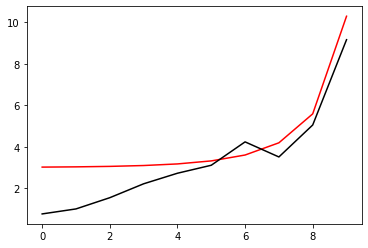

4800 89.77602034080736
[0.75524645 0.99617225 1.53842689 2.20917251 2.71926854 3.10498938
 4.23230731 3.50501956 5.04856663 9.16502043]


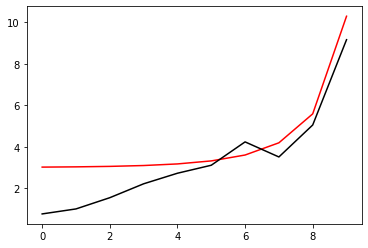

4900 89.77601338860617
[0.75529151 0.99613257 1.53829521 2.20910379 2.71955884 3.10541083
 4.23169065 3.50495408 5.04871341 9.16498092]


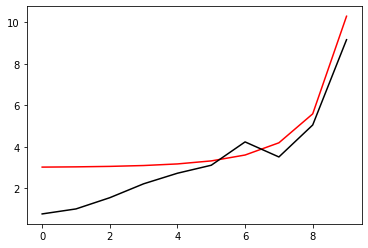

5000 89.77600645070156
[0.75533646 0.99609298 1.53816383 2.20903523 2.71984859 3.10583176
 4.23107448 3.50488865 5.04886037 9.1649414 ]


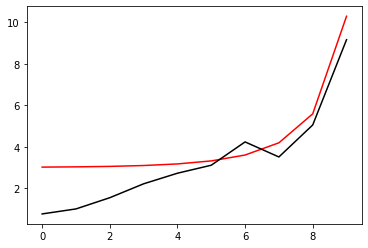

5100 89.77599952705442
[0.7553813  0.99605347 1.53803274 2.20896683 2.7201378  3.10625218
 4.23045881 3.50482327 5.0490075  9.16490189]


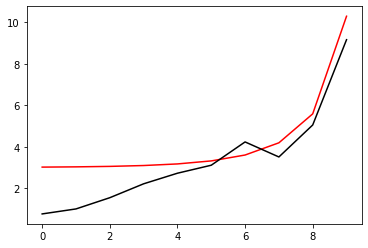

5200 89.77599261762569
[0.75542603 0.99601405 1.53790195 2.20889858 2.72042647 3.10667207
 4.22984362 3.50475794 5.04915482 9.16486238]


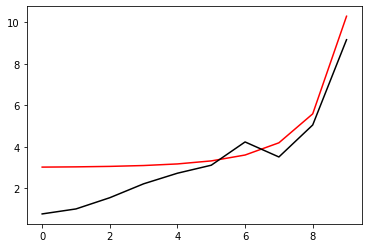

5300 89.77598572237643
[0.75547065 0.99597471 1.53777145 2.20883049 2.7207146  3.10709145
 4.22922892 3.50469265 5.0493023  9.16482287]


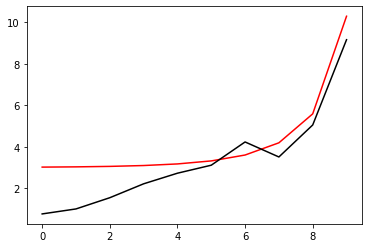

5400 89.77597884126774
[0.75551516 0.99593546 1.53764125 2.20876256 2.72100218 3.10751031
 4.22861471 3.50462741 5.04944997 9.16478336]


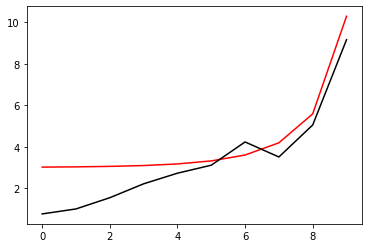

5500 89.77597197426088
[0.75555956 0.99589629 1.53751134 2.20869478 2.72128923 3.10792866
 4.22800099 3.50456221 5.04959781 9.16474385]


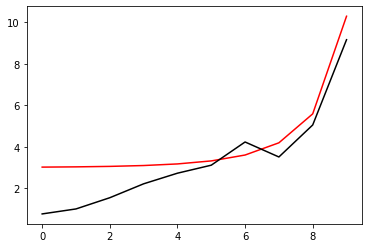

5600 89.77596512131745
[0.75560386 0.9958572  1.53738172 2.20862716 2.72157574 3.10834648
 4.22738776 3.50449706 5.04974583 9.16470435]


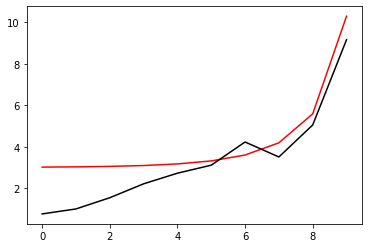

5700 89.77595828239892
[0.75564805 0.9958182  1.5372524  2.20855969 2.72186171 3.10876379
 4.22677502 3.50443195 5.04989402 9.16466484]


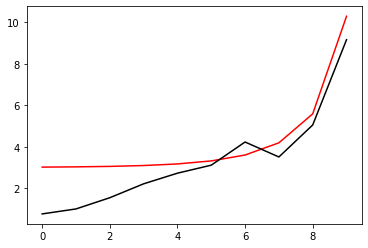

5800 89.77595145746693
[0.75569213 0.99577928 1.53712337 2.20849238 2.72214715 3.10918059
 4.22616276 3.50436689 5.05004239 9.16462534]


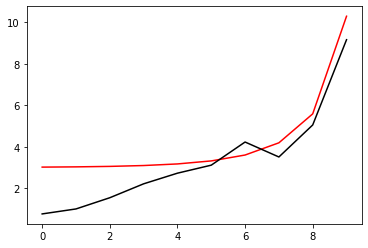

5900 89.77594464648337
[0.7557361  0.99574044 1.53699462 2.20842522 2.72243206 3.10959687
 4.22555099 3.50430188 5.05019093 9.16458584]


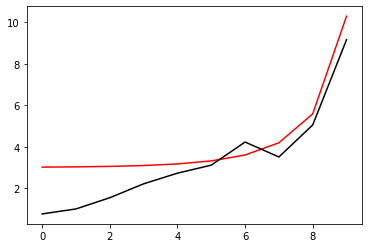

6000 89.77593784941014
[0.75577996 0.99570169 1.53686617 2.20835822 2.72271644 3.11001263
 4.22493971 3.5042369  5.05033964 9.16454635]


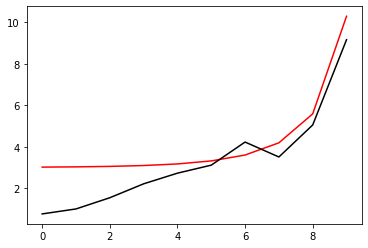

6100 89.77593106620931
[0.75582372 0.99566302 1.536738   2.20829137 2.72300028 3.11042788
 4.22432891 3.50417198 5.05048853 9.16450685]


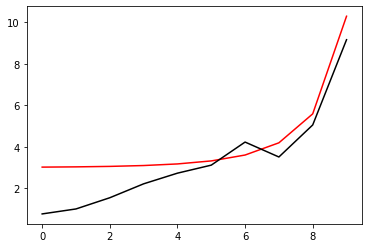

6200 89.77592429684306
[0.75586737 0.99562443 1.53661013 2.20822467 2.7232836  3.11084262
 4.22371859 3.50410709 5.05063759 9.16446736]


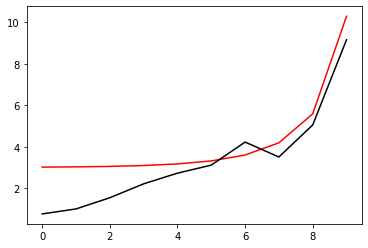

6300 89.77591754127369
[0.75591092 0.99558592 1.53648254 2.20815813 2.72356639 3.11125684
 4.22310876 3.50404225 5.05078682 9.16442787]


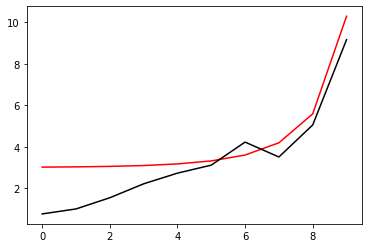

6400 89.77591079946356
[0.75595436 0.9955475  1.53635524 2.20809175 2.72384865 3.11167055
 4.22249942 3.50397746 5.05093623 9.16438838]


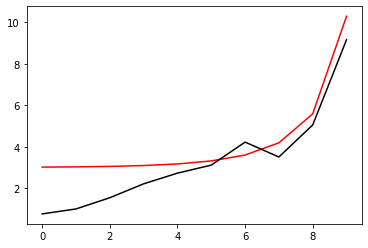

6500 89.7759040713754
[0.75599769 0.99550915 1.53622823 2.20802551 2.72413038 3.11208374
 4.22189056 3.50391271 5.05108581 9.16434889]


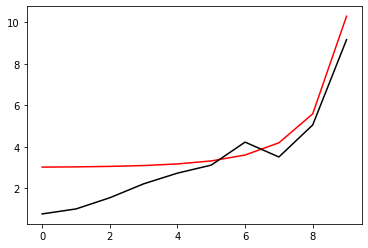

6600 89.77589735697177
[0.75604091 0.99547089 1.5361015  2.20795943 2.7244116  3.11249643
 4.22128218 3.503848   5.05123556 9.1643094 ]


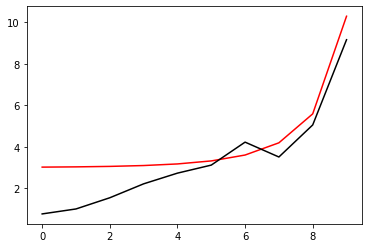

6700 89.77589065621547
[0.75608404 0.99543271 1.53597505 2.2078935  2.72469229 3.1129086
 4.22067428 3.50378334 5.05138548 9.16426992]


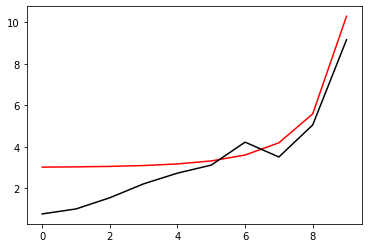

6800 89.77588396906947
[0.75612705 0.99539461 1.53584889 2.20782773 2.72497245 3.11332026
 4.22006687 3.50371871 5.05153557 9.16423043]


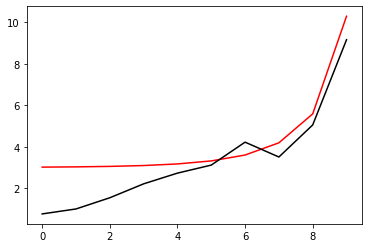

6900 89.77587729549678
[0.75616996 0.99535659 1.53572302 2.20776211 2.7252521  3.11373141
 4.21945994 3.50365414 5.05168583 9.16419095]


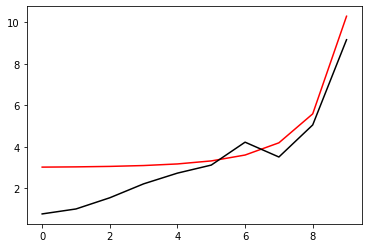

7000 89.77587063546048
[0.75621277 0.99531865 1.53559743 2.20769664 2.72553123 3.11414205
 4.21885348 3.5035896  5.05183626 9.16415147]


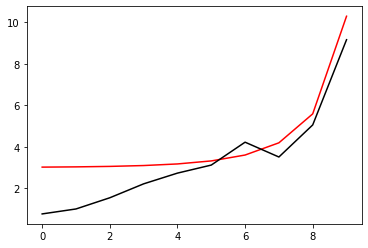

7100 89.77586398892404
[0.75625547 0.9952808  1.53547212 2.20763132 2.72580984 3.11455218
 4.21824751 3.50352511 5.05198686 9.164112  ]


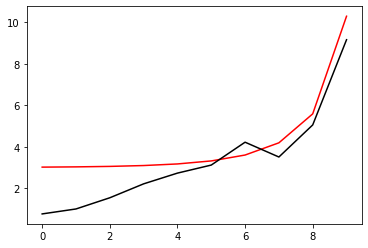

7200 89.77585735585073
[0.75629807 0.99524302 1.53534709 2.20756616 2.72608794 3.1149618
 4.21764202 3.50346066 5.05213763 9.16407252]


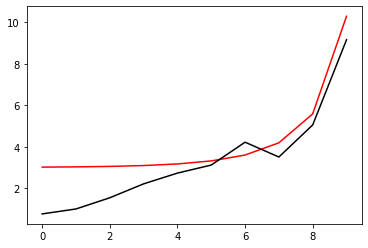

7300 89.775850736204
[0.75634056 0.99520532 1.53522234 2.20750115 2.72636552 3.11537092
 4.21703701 3.50339625 5.05228857 9.16403305]


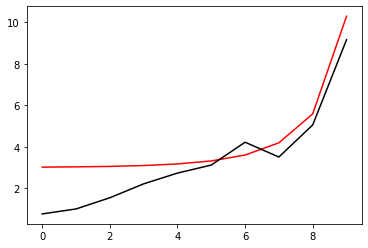

7400 89.77584412994763
[0.75638295 0.9951677  1.53509788 2.20743629 2.72664259 3.11577952
 4.21643248 3.50333188 5.05243968 9.16399358]


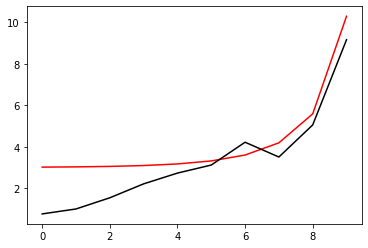

7500 89.77583753704536
[0.75642523 0.99513016 1.53497369 2.20737158 2.72691914 3.11618761
 4.21582842 3.50326756 5.05259096 9.16395411]


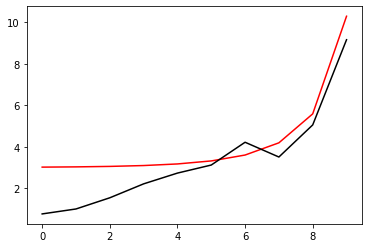

7600 89.77583095746095
[0.75646742 0.99509271 1.53484978 2.20730702 2.72719519 3.1165952
 4.21522484 3.50320328 5.0527424  9.16391464]


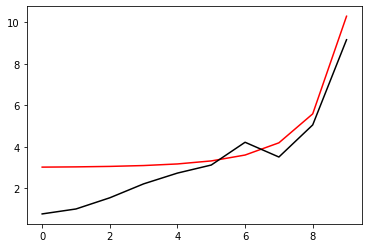

7700 89.77582439115852
[0.75650949 0.99505533 1.53472615 2.20724261 2.72747072 3.11700228
 4.21462174 3.50313904 5.05289401 9.16387517]


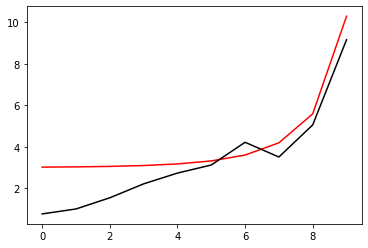

7800 89.77581783810209
[0.75655147 0.99501802 1.5346028  2.20717836 2.72774575 3.11740886
 4.21401912 3.50307484 5.05304579 9.16383571]


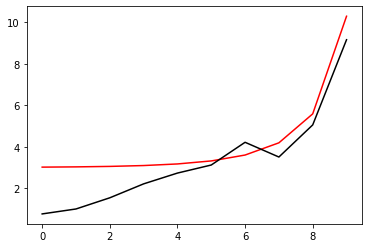

7900 89.77581129825589
[0.75659334 0.9949808  1.53447973 2.20711425 2.72802026 3.11781492
 4.21341697 3.50301068 5.05319773 9.16379624]


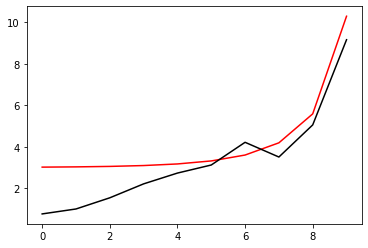

8000 89.77580477158429
[0.75663511 0.99494366 1.53435693 2.2070503  2.72829428 3.11822049
 4.2128153  3.50294656 5.05334984 9.16375678]


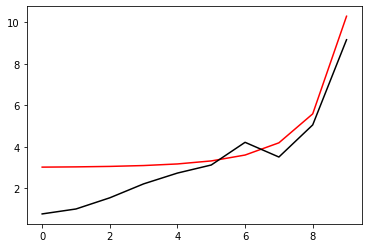

8100 89.77579825805175
[0.75667678 0.99490659 1.53423441 2.20698649 2.72856778 3.11862554
 4.21221411 3.50288249 5.05350212 9.16371732]


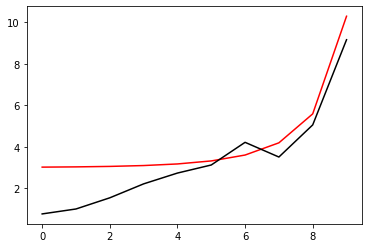

8200 89.77579175762286
[0.75671835 0.99486961 1.53411216 2.20692284 2.72884079 3.11903009
 4.21161339 3.50281845 5.05365456 9.16367787]


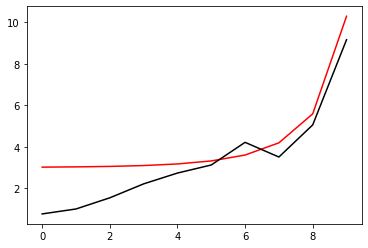

8300 89.77578527026222
[0.75675982 0.9948327  1.53399019 2.20685933 2.72911329 3.11943414
 4.21101314 3.50275445 5.05380717 9.16363841]


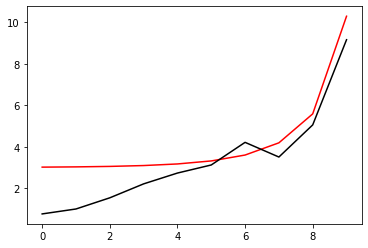

8400 89.77577879593463
[0.75680118 0.99479587 1.53386849 2.20679598 2.72938529 3.11983768
 4.21041337 3.5026905  5.05395994 9.16359896]


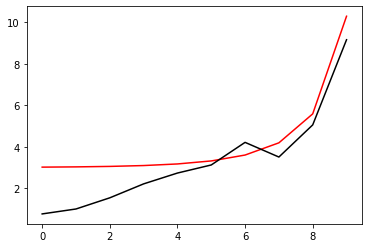

8500 89.77577233460505
[0.75684244 0.99475911 1.53374706 2.20673277 2.72965679 3.12024072
 4.20981407 3.50262659 5.05411288 9.16355951]


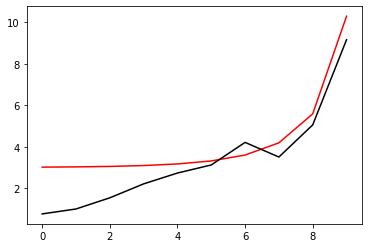

8600 89.77576588623853
[0.7568836  0.99472244 1.53362591 2.20666972 2.72992779 3.12064326
 4.20921524 3.50256271 5.05426598 9.16352006]


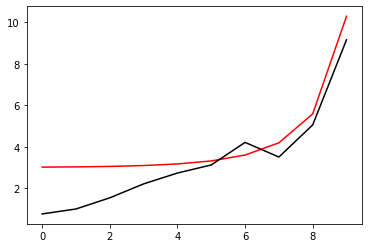

8700 89.77575945080011
[0.75692466 0.99468584 1.53350503 2.20660681 2.73019829 3.12104529
 4.20861689 3.50249888 5.05441925 9.16348061]


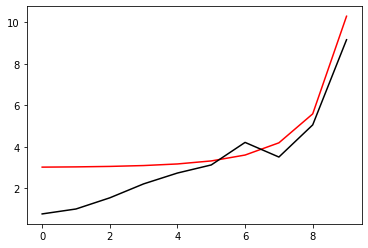

8800 89.77575302825512
[0.75696562 0.99464931 1.53338442 2.20654405 2.7304683  3.12144682
 4.208019   3.50243508 5.05457268 9.16344116]


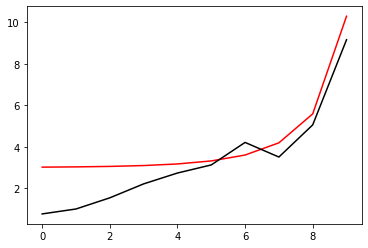

8900 89.77574661856889
[0.75700648 0.99461287 1.53326408 2.20648144 2.73073781 3.12184785
 4.20742159 3.50237133 5.05472627 9.16340172]


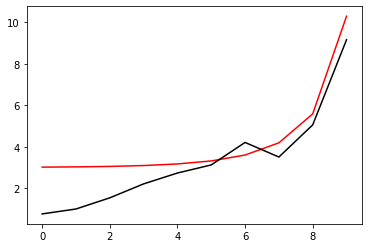

9000 89.77574022170687
[0.75704724 0.9945765  1.53314401 2.20641898 2.73100683 3.12224838
 4.20682465 3.50230761 5.05488002 9.16336228]


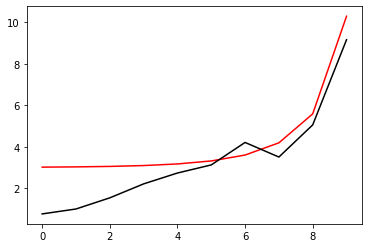

9100 89.77573383763463
[0.7570879  0.99454021 1.53302421 2.20635667 2.73127535 3.12264841
 4.20622818 3.50224393 5.05503394 9.16332284]


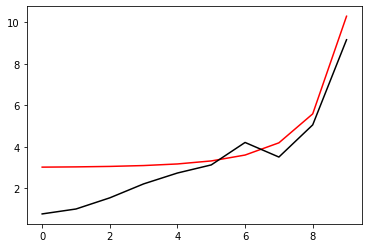

9200 89.7757274663179
[0.75712846 0.99450399 1.53290468 2.2062945  2.73154339 3.12304793
 4.20563218 3.5021803  5.05518801 9.1632834 ]


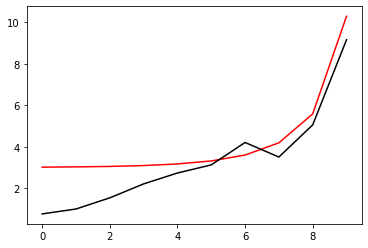

9300 89.7757211077225
[0.75716892 0.99446785 1.53278542 2.20623249 2.73181093 3.12344696
 4.20503665 3.5021167  5.05534225 9.16324396]


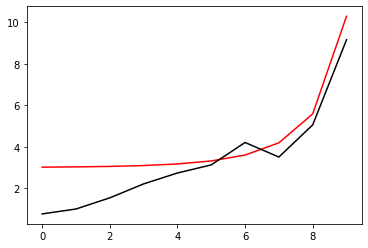

9400 89.77571476181423
[0.75720929 0.99443178 1.53266642 2.20617062 2.73207799 3.12384549
 4.20444158 3.50205314 5.05549665 9.16320453]


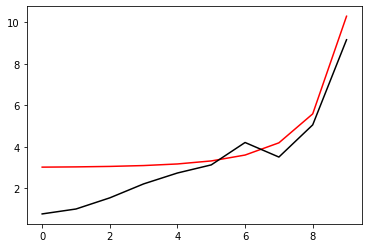

9500 89.77570842855924
[0.75724955 0.99439579 1.5325477  2.2061089  2.73234455 3.12424351
 4.20384699 3.50198961 5.05565122 9.16316509]


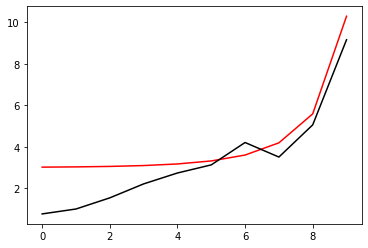

9600 89.77570210792359
[0.75728971 0.99435988 1.53242924 2.20604732 2.73261064 3.12464104
 4.20325286 3.50192613 5.05580594 9.16312566]


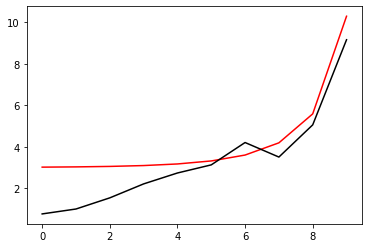

9700 89.7756957998735
[0.75732978 0.99432404 1.53231104 2.20598589 2.73287623 3.12503808
 4.2026592  3.50186268 5.05596082 9.16308623]


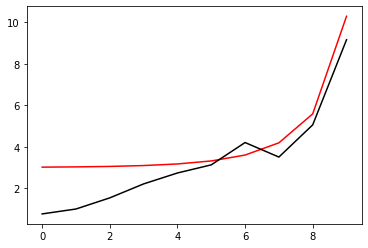

9800 89.77568950437531
[0.75736975 0.99428828 1.53219311 2.20592461 2.73314134 3.12543461
 4.20206601 3.50179928 5.05611586 9.1630468 ]


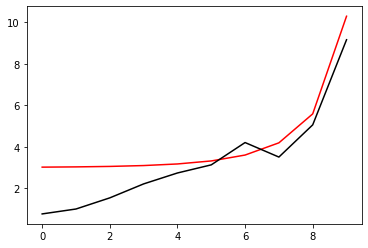

9900 89.77568322139554
[0.75740962 0.99425259 1.53207544 2.20586348 2.73340597 3.12583065
 4.20147329 3.50173591 5.05627106 9.16300738]


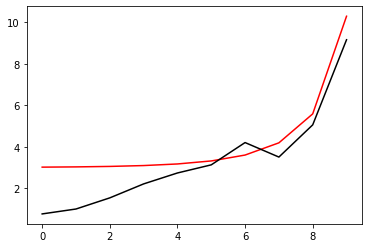

10000 89.77567695090073
[0.75744939 0.99421697 1.53195804 2.20580249 2.73367012 3.12622619
 4.20088103 3.50167257 5.05642642 9.16296795]


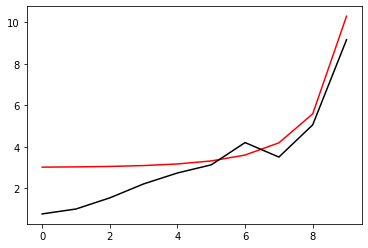

In [26]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.77567069285746
[0.75748906 0.99418143 1.5318409  2.20574165 2.73393378 3.12662123
 4.20028923 3.50160928 5.05658194 9.16292853]


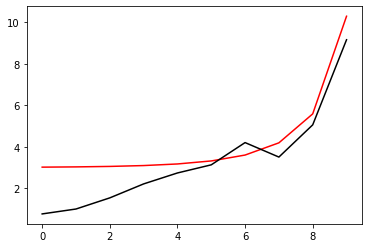

200 89.77566444723254
[0.75752864 0.99414596 1.53172402 2.20568096 2.73419697 3.12701578
 4.1996979  3.50154602 5.05673762 9.16288911]


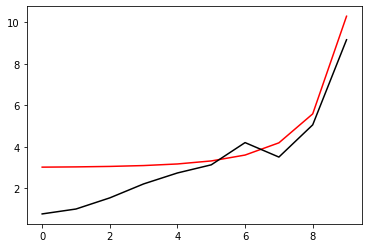

300 89.7756582139929
[0.75756812 0.99411057 1.53160741 2.20562041 2.73445968 3.12740983
 4.19910703 3.5014828  5.05689345 9.16284969]


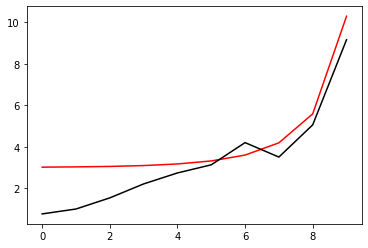

400 89.77565199310546
[0.7576075  0.99407525 1.53149106 2.20556    2.73472191 3.12780339
 4.19851663 3.50141962 5.05704945 9.16281028]


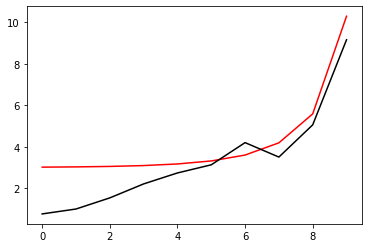

500 89.77564578453735
[0.75764678 0.99404001 1.53137496 2.20549974 2.73498366 3.12819645
 4.19792669 3.50135647 5.0572056  9.16277086]


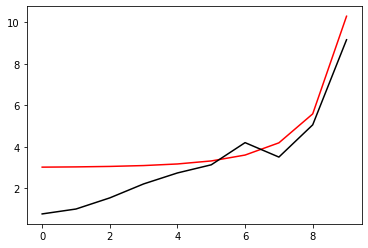

600 89.77563958825569
[0.75768597 0.99400484 1.53125913 2.20543963 2.73524494 3.12858902
 4.19733722 3.50129336 5.0573619  9.16273145]


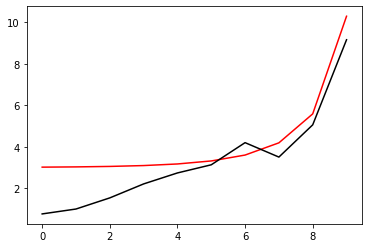

700 89.77563340422785
[0.75772507 0.99396974 1.53114356 2.20537966 2.73550575 3.12898109
 4.1967482  3.50123029 5.05751837 9.16269204]


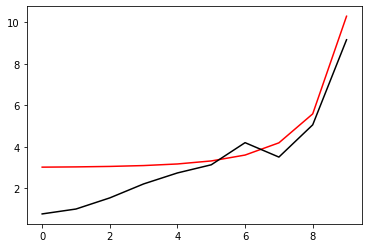

800 89.77562723242119
[0.75776406 0.99393471 1.53102824 2.20531984 2.73576608 3.12937267
 4.19615965 3.50116725 5.05767499 9.16265263]


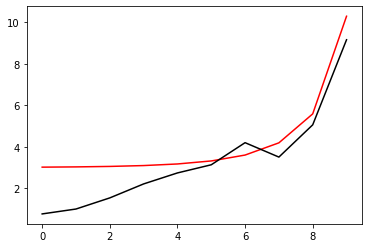

900 89.77562107280319
[0.75780296 0.99389976 1.53091319 2.20526016 2.73602594 3.12976376
 4.19557156 3.50110425 5.05783176 9.16261323]


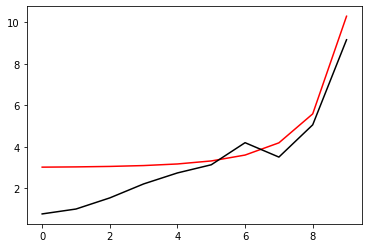

1000 89.77561492534149
[0.75784177 0.99386488 1.53079839 2.20520063 2.73628534 3.13015436
 4.19498393 3.50104129 5.05798869 9.16257382]


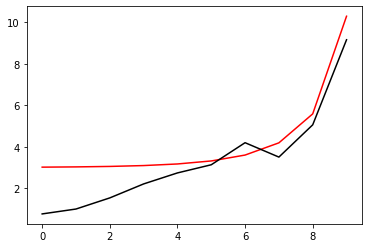

1100 89.77560879000376
[0.75788048 0.99383007 1.53068385 2.20514124 2.73654426 3.13054447
 4.19439676 3.50097836 5.05814578 9.16253442]


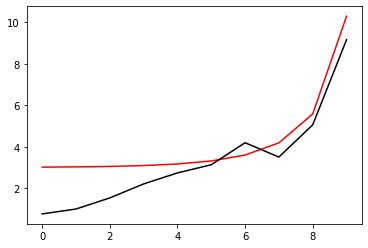

1200 89.77560266675786
[0.75791909 0.99379534 1.53056957 2.20508199 2.73680271 3.13093408
 4.19381005 3.50091546 5.05830302 9.16249502]


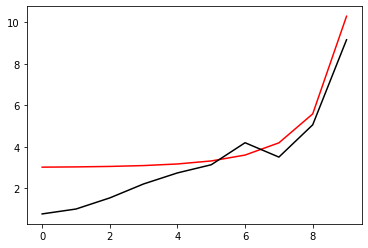

1300 89.77559655557164
[0.75795761 0.99376068 1.53045554 2.20502289 2.7370607  3.1313232
 4.1932238  3.50085261 5.05846042 9.16245562]


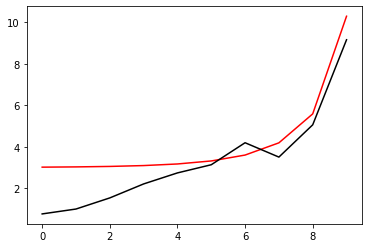

1400 89.7755904564132
[0.75799604 0.99372609 1.53034177 2.20496393 2.73731823 3.13171183
 4.19263801 3.50078978 5.05861797 9.16241622]


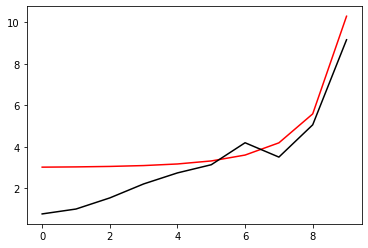

1500 89.77558436925054
[0.75803437 0.99369157 1.53022825 2.20490511 2.73757528 3.13209998
 4.19205268 3.500727   5.05877567 9.16237682]


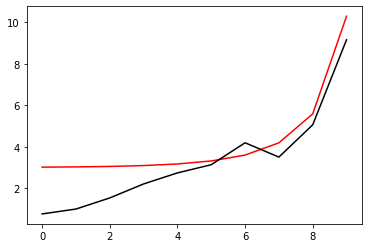

1600 89.77557829405191
[0.75807261 0.99365712 1.53011499 2.20484644 2.73783188 3.13248763
 4.1914678  3.50066425 5.05893353 9.16233743]


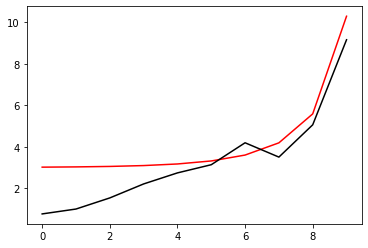

1700 89.77557223078568
[0.75811075 0.99362274 1.53000198 2.20478791 2.73808801 3.13287479
 4.19088338 3.50060153 5.05909154 9.16229804]


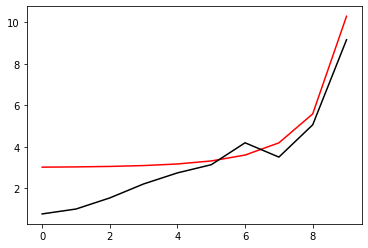

1800 89.77556617942021
[0.7581488  0.99358844 1.52988922 2.20472953 2.73834368 3.13326147
 4.19029942 3.50053885 5.0592497  9.16225865]


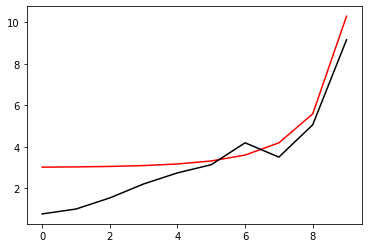

1900 89.775560139924
[0.75818675 0.9935542  1.52977671 2.20467128 2.73859889 3.13364766
 4.18971592 3.5004762  5.05940802 9.16221926]


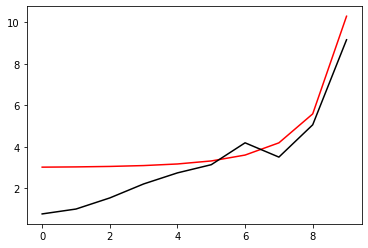

2000 89.77555411226564
[0.75822461 0.99352004 1.52966446 2.20461318 2.73885365 3.13403336
 4.18913287 3.50041358 5.05956649 9.16217987]


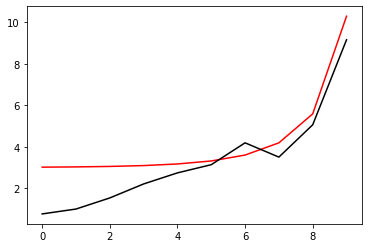

2100 89.77554809641396
[0.75826238 0.99348595 1.52955246 2.20455522 2.73910794 3.13441857
 4.18855028 3.50035101 5.05972511 9.16214049]


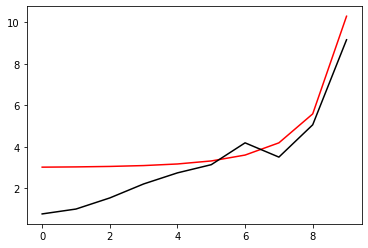

2200 89.77554209233762
[0.75830006 0.99345193 1.52944071 2.2044974  2.73936178 3.13480329
 4.18796814 3.50028846 5.05988388 9.16210111]


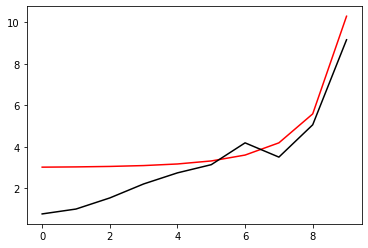

2300 89.77553610000565
[0.75833764 0.99341798 1.52932921 2.20443973 2.73961516 3.13518753
 4.18738646 3.50022595 5.0600428  9.16206173]


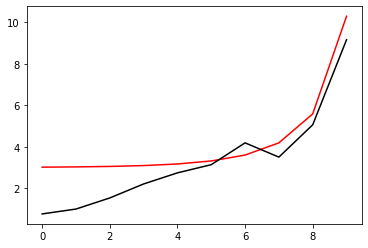

2400 89.77553011938694
[0.75837513 0.99338409 1.52921796 2.20438219 2.73986809 3.13557128
 4.18680523 3.50016347 5.06020188 9.16202235]


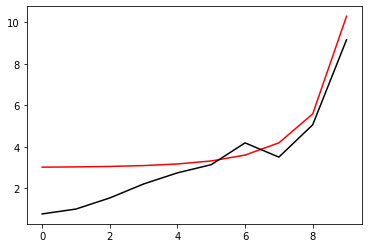

2500 89.77552415045066
[0.75841252 0.99335028 1.52910696 2.2043248  2.74012057 3.13595455
 4.18622445 3.50010103 5.0603611  9.16198297]


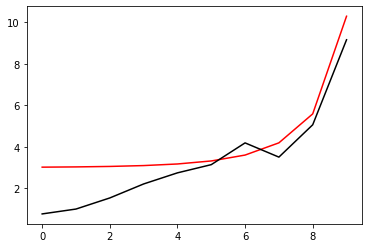

2600 89.77551819316598
[0.75844983 0.99331654 1.52899621 2.20426755 2.74037259 3.13633733
 4.18564413 3.50003862 5.06052047 9.1619436 ]


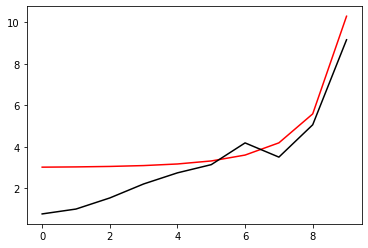

2700 89.7755122475021
[0.75848704 0.99328287 1.5288857  2.20421044 2.74062416 3.13671963
 4.18506426 3.49997624 5.06068    9.16190423]


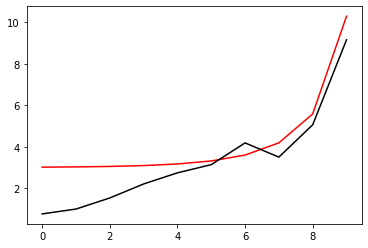

2800 89.77550631342864
[0.75852416 0.99324927 1.52877544 2.20415347 2.74087528 3.13710145
 4.18448484 3.4999139  5.06083967 9.16186486]


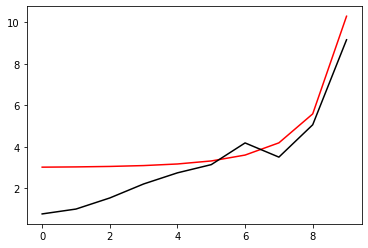

2900 89.77550039091487
[0.75856119 0.99321573 1.52866543 2.20409664 2.74112596 3.13748278
 4.18390588 3.49985159 5.06099949 9.16182549]


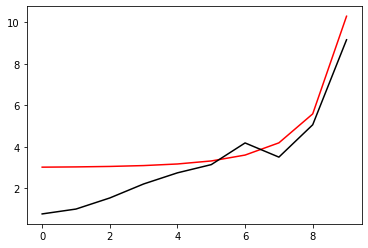

3000 89.77549447993047
[0.75859813 0.99318227 1.52855567 2.20403995 2.74137618 3.13786362
 4.18332736 3.49978931 5.06115946 9.16178612]


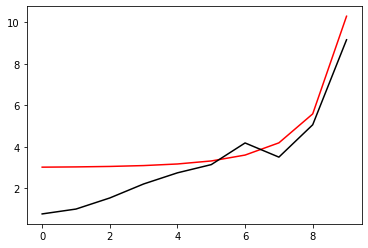

3100 89.7754885804451
[0.75863498 0.99314887 1.52844615 2.2039834  2.74162596 3.13824399
 4.1827493  3.49972707 5.06131958 9.16174675]


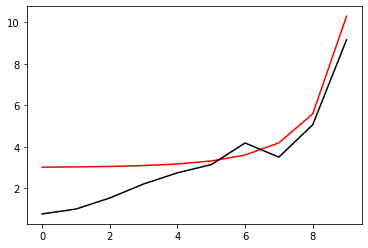

3200 89.77548269242853
[0.75867173 0.99311555 1.52833687 2.203927   2.74187529 3.13862387
 4.18217169 3.49966486 5.06147985 9.16170739]


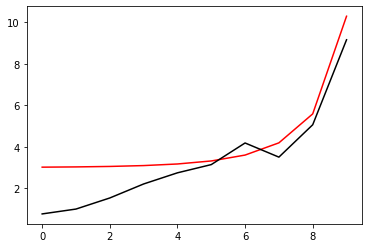

3300 89.77547681585055
[0.7587084  0.99308229 1.52822784 2.20387073 2.74212418 3.13900327
 4.18159452 3.49960268 5.06164027 9.16166803]


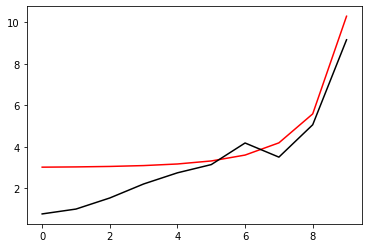

3400 89.77547095068124
[0.75874497 0.9930491  1.52811906 2.2038146  2.74237262 3.13938219
 4.18101781 3.49954053 5.06180083 9.16162867]


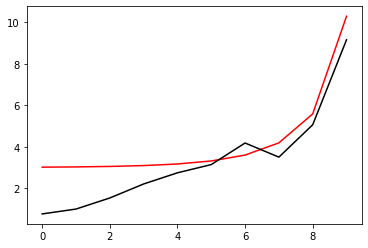

3500 89.77546509689054
[0.75878146 0.99301598 1.52801051 2.20375861 2.74262062 3.13976063
 4.18044154 3.49947841 5.06196154 9.16158931]


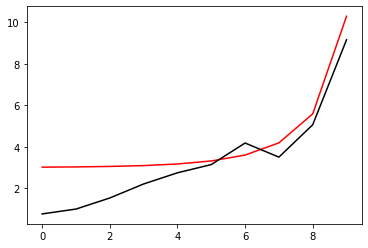

3600 89.77545925444869
[0.75881785 0.99298292 1.52790222 2.20370276 2.74286819 3.14013858
 4.17986572 3.49941633 5.0621224  9.16154996]


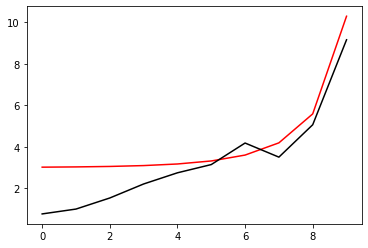

3700 89.77545342332583
[0.75885415 0.99294994 1.52779416 2.20364705 2.74311531 3.14051606
 4.17929035 3.49935428 5.0622834  9.1615106 ]


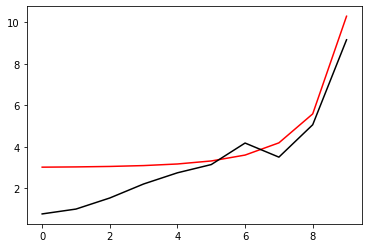

3800 89.77544760349234
[0.75889037 0.99291702 1.52768634 2.20359147 2.74336199 3.14089306
 4.17871543 3.49929226 5.06244455 9.16147125]


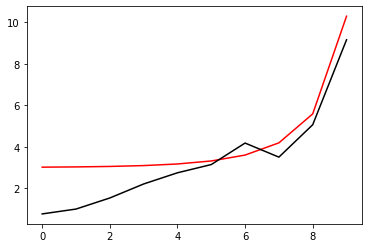

3900 89.77544179491863
[0.75892649 0.99288417 1.52757877 2.20353604 2.74360823 3.14126958
 4.17814096 3.49923027 5.06260585 9.1614319 ]


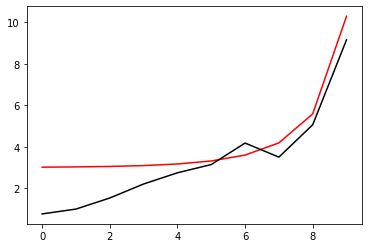

4000 89.77543599757527
[0.75896253 0.99285139 1.52747143 2.20348074 2.74385403 3.14164562
 4.17756693 3.49916832 5.06276729 9.16139255]


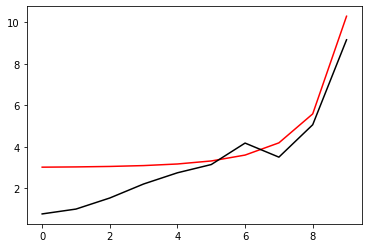

4100 89.77543021143272
[0.75899847 0.99281867 1.52736434 2.20342558 2.7440994  3.14202118
 4.17699335 3.49910639 5.06292888 9.16135321]


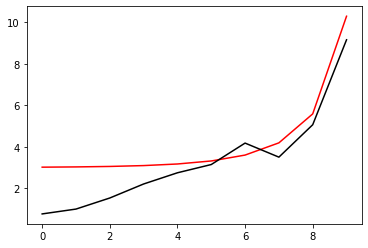

4200 89.77542443646183
[0.75903433 0.99278602 1.52725749 2.20337056 2.74434434 3.14239626
 4.17642021 3.4990445  5.06309061 9.16131387]


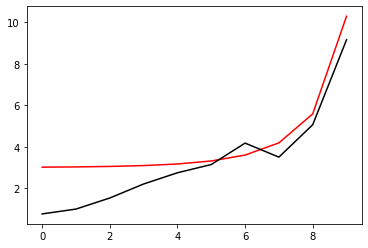

4300 89.77541867263332
[0.7590701  0.99275344 1.52715087 2.20331568 2.74458884 3.14277087
 4.17584752 3.49898263 5.06325248 9.16127452]


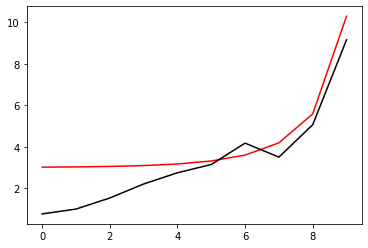

4400 89.77541291991805
[0.75910578 0.99272093 1.52704449 2.20326094 2.74483291 3.143145
 4.17527527 3.4989208  5.0634145  9.16123518]


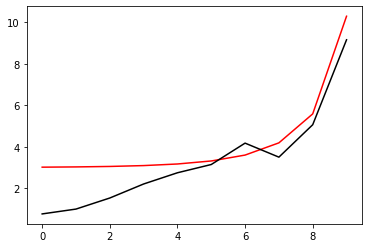

4500 89.77540717828695
[0.75914137 0.99268848 1.52693835 2.20320633 2.74507654 3.14351865
 4.17470346 3.498859   5.06357667 9.16119584]


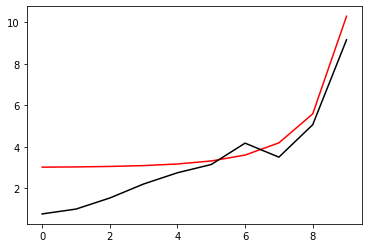

4600 89.7754014477112
[0.75917687 0.9926561  1.52683245 2.20315186 2.74531975 3.14389183
 4.1741321  3.49879723 5.06373897 9.16115651]


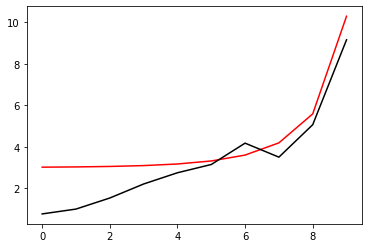

4700 89.77539572816185
[0.75921229 0.99262378 1.52672679 2.20309753 2.74556252 3.14426453
 4.17356119 3.49873549 5.06390143 9.16111717]


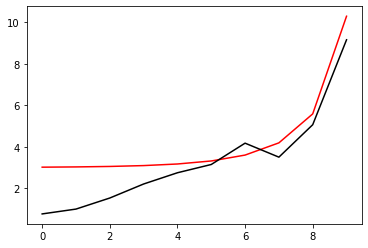

4800 89.7753900196101
[0.75924762 0.99259153 1.52662136 2.20304333 2.74580487 3.14463676
 4.17299071 3.49867378 5.06406402 9.16107784]


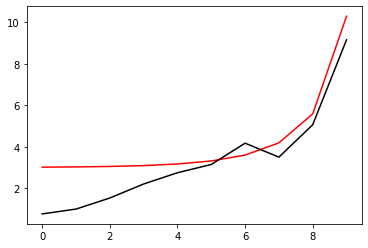

4900 89.77538432202738
[0.75928286 0.99255935 1.52651617 2.20298927 2.74604679 3.14500851
 4.17242068 3.4986121  5.06422676 9.16103851]


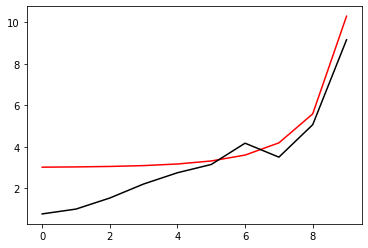

5000 89.77537863538505
[0.75931801 0.99252723 1.52641121 2.20293535 2.74628828 3.14537979
 4.17185109 3.49855045 5.06438964 9.16099918]


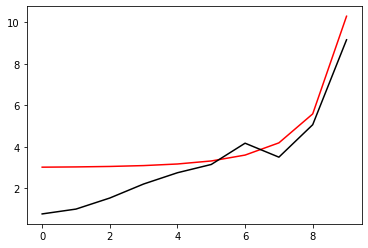

5100 89.77537295965458
[0.75935307 0.99249517 1.52630649 2.20288156 2.74652935 3.14575059
 4.17128194 3.49848883 5.06455266 9.16095986]


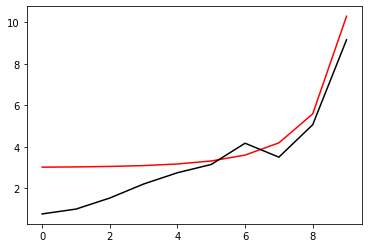

5200 89.77536729480757
[0.75938805 0.99246319 1.526202   2.20282791 2.74676999 3.14612092
 4.17071323 3.49842724 5.06471582 9.16092053]


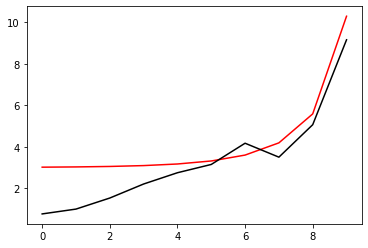

5300 89.7753616408157
[0.75942294 0.99243126 1.52609774 2.2027744  2.74701021 3.14649078
 4.17014497 3.49836567 5.06487912 9.16088121]


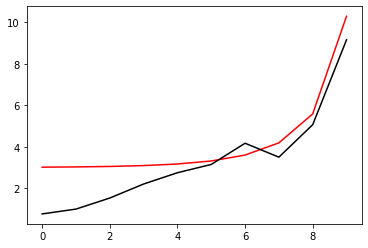

5400 89.77535599765075
[0.75945775 0.99239941 1.52599372 2.20272102 2.74725    3.14686017
 4.16957714 3.49830414 5.06504257 9.16084189]


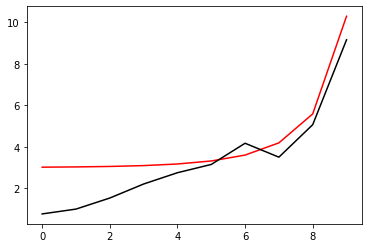

5500 89.77535036528455
[0.75949247 0.99236761 1.52588993 2.20266777 2.74748938 3.14722908
 4.16900975 3.49824264 5.06520616 9.16080257]


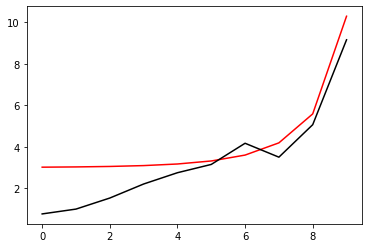

5600 89.775344743689
[0.7595271  0.99233589 1.52578637 2.20261466 2.74772833 3.14759752
 4.1684428  3.49818117 5.06536988 9.16076325]


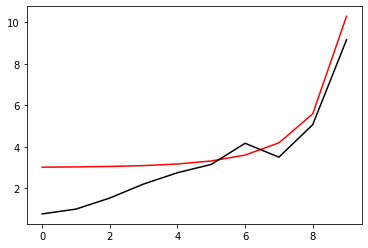

5700 89.77533913283617
[0.75956165 0.99230422 1.52568305 2.20256169 2.74796686 3.1479655
 4.16787629 3.49811972 5.06553375 9.16072394]


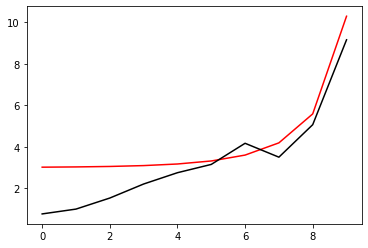

5800 89.77533353269817
[0.75959611 0.99227263 1.52557995 2.20250885 2.74820498 3.148333
 4.16731022 3.49805831 5.06569776 9.16068463]


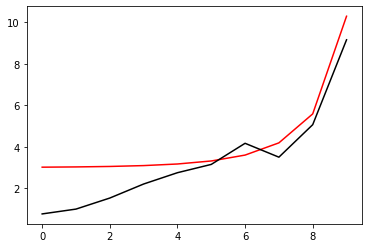

5900 89.77532794324718
[0.75963048 0.99224109 1.52547709 2.20245615 2.74844268 3.14870003
 4.16674458 3.49799692 5.0658619  9.16064531]


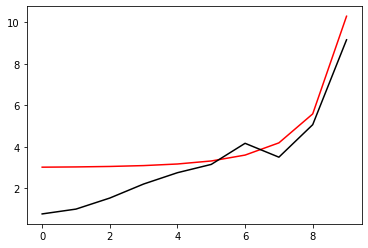

6000 89.77532236445546
[0.75966477 0.99220962 1.52537445 2.20240358 2.74867996 3.14906659
 4.16617938 3.49793556 5.06602619 9.16060601]


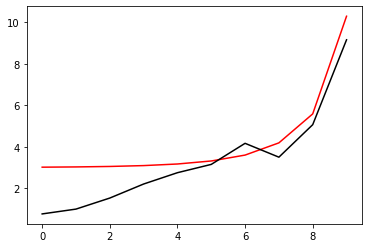

6100 89.77531679629536
[0.75969897 0.99217821 1.52527205 2.20235114 2.74891682 3.14943268
 4.16561462 3.49787423 5.06619061 9.1605667 ]


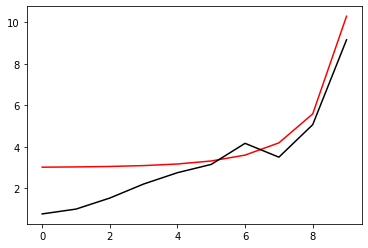

6200 89.77531123873932
[0.75973309 0.99214687 1.52516987 2.20229884 2.74915327 3.1497983
 4.1650503  3.49781293 5.06635518 9.16052739]


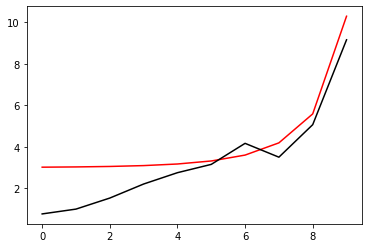

6300 89.77530569175994
[0.75976713 0.99211559 1.52506792 2.20224667 2.74938931 3.15016346
 4.16448641 3.49775166 5.06651988 9.16048809]


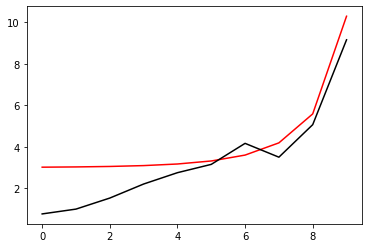

6400 89.77530015532977
[0.75980108 0.99208438 1.52496621 2.20219464 2.74962494 3.15052815
 4.16392295 3.49769041 5.06668472 9.16044879]


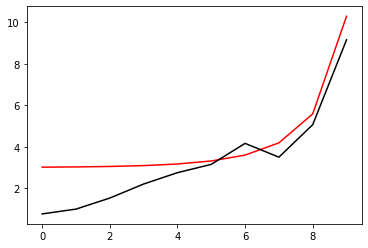

6500 89.77529462942151
[0.75983494 0.99205323 1.52486471 2.20214274 2.74986015 3.15089237
 4.16335993 3.4976292  5.06684969 9.16040949]


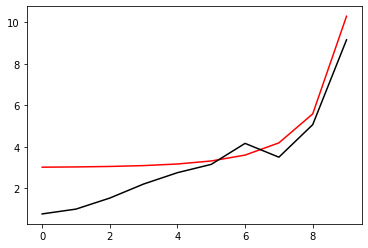

6600 89.77528911400799
[0.75986872 0.99202214 1.52476345 2.20209097 2.75009495 3.15125612
 4.16279735 3.49756801 5.06701481 9.16037019]


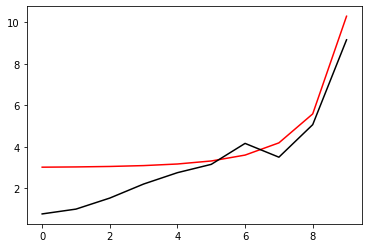

6700 89.77528360906201
[0.75990242 0.99199111 1.52466241 2.20203933 2.75032935 3.1516194
 4.1622352  3.49750684 5.06718006 9.1603309 ]


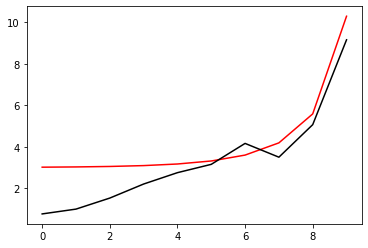

6800 89.77527811455656
[0.75993603 0.99196015 1.52456159 2.20198783 2.75056333 3.15198222
 4.16167348 3.49744571 5.06734545 9.1602916 ]


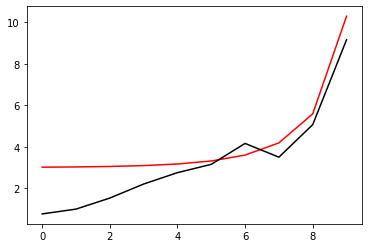

6900 89.77527263046458
[0.75996956 0.99192925 1.52446101 2.20193646 2.75079691 3.15234458
 4.16111219 3.4973846  5.06751097 9.16025231]


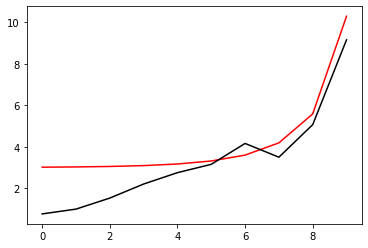

7000 89.77526715675936
[0.760003   0.99189841 1.52436064 2.20188523 2.75103008 3.15270647
 4.16055134 3.49732352 5.06767663 9.16021302]


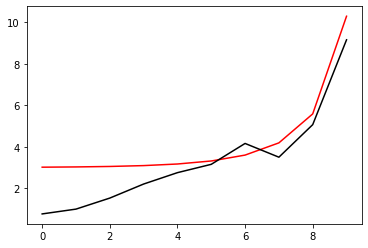

7100 89.7752616934139
[0.76003636 0.99186763 1.5242605  2.20183412 2.75126284 3.15306789
 4.15999092 3.49726247 5.06784243 9.16017374]


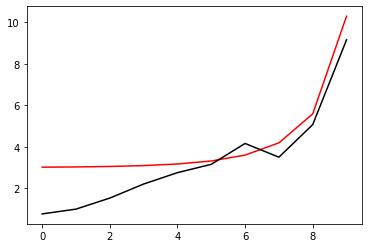

7200 89.7752562404016
[0.76006964 0.99183692 1.52416059 2.20178315 2.7514952  3.15342885
 4.15943093 3.49720144 5.06800836 9.16013445]


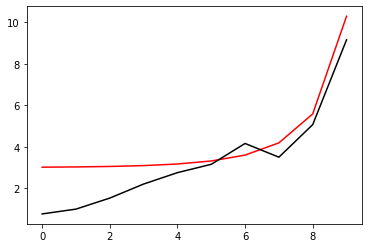

7300 89.77525079769575
[0.76010284 0.99180627 1.5240609  2.20173231 2.75172716 3.15378935
 4.15887137 3.49714045 5.06817443 9.16009517]


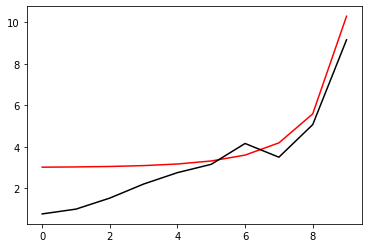

7400 89.77524536526983
[0.76013595 0.99177568 1.52396143 2.2016816  2.75195871 3.15414938
 4.15831225 3.49707947 5.06834063 9.16005589]


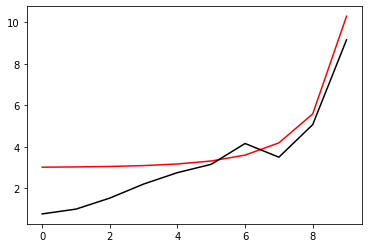

7500 89.77523994309735
[0.76016898 0.99174515 1.52386218 2.20163102 2.75218986 3.15450895
 4.15775355 3.49701853 5.06850697 9.16001661]


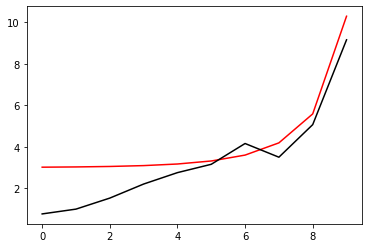

7600 89.77523453115185
[0.76020193 0.99171469 1.52376316 2.20158058 2.75242061 3.15486806
 4.15719528 3.49695761 5.06867344 9.15997733]


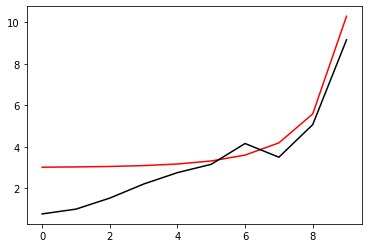

7700 89.77522912940705
[0.76023479 0.99168428 1.52366435 2.20153026 2.75265096 3.15522671
 4.15663745 3.49689672 5.06884005 9.15993805]


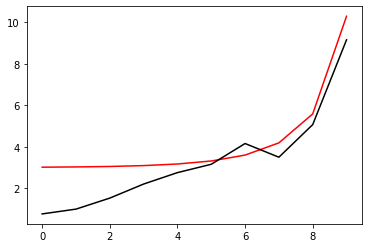

7800 89.77522373783671
[0.76026757 0.99165394 1.52356577 2.20148008 2.75288092 3.15558489
 4.15608004 3.49683585 5.06900679 9.15989878]


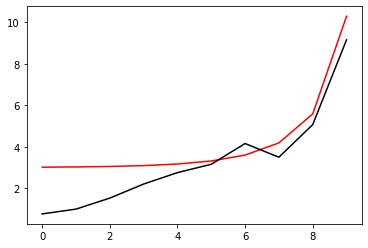

7900 89.77521835641468
[0.76030027 0.99162366 1.52346741 2.20143002 2.75311047 3.15594261
 4.15552306 3.49677501 5.06917366 9.15985951]


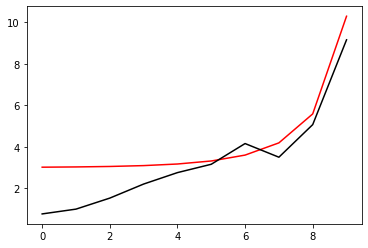

8000 89.77521298511485
[0.76033289 0.99159344 1.52336927 2.2013801  2.75333963 3.15629988
 4.15496651 3.49671419 5.06934067 9.15982024]


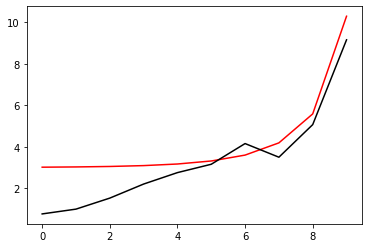

8100 89.77520762391117
[0.76036543 0.99156328 1.52327134 2.20133031 2.75356839 3.15665668
 4.15441038 3.4966534  5.06950781 9.15978097]


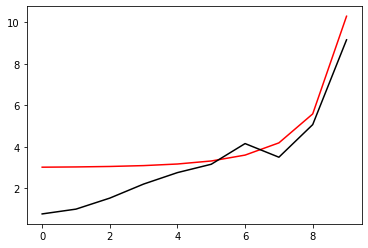

8200 89.77520227277778
[0.76039789 0.99153318 1.52317364 2.20128065 2.75379675 3.15701302
 4.15385469 3.49659264 5.06967508 9.15974171]


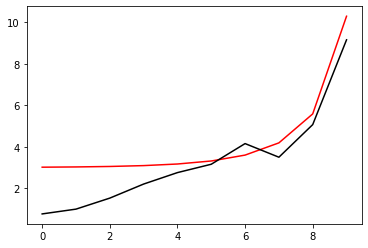

8300 89.7751969316888
[0.76043026 0.99150314 1.52307615 2.20123112 2.75402472 3.1573689
 4.15329942 3.4965319  5.06984249 9.15970244]


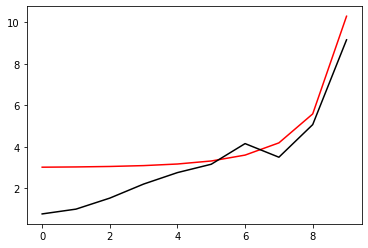

8400 89.77519160061854
[0.76046255 0.99147316 1.52297889 2.20118171 2.7542523  3.15772433
 4.15274457 3.49647119 5.07001002 9.15966318]


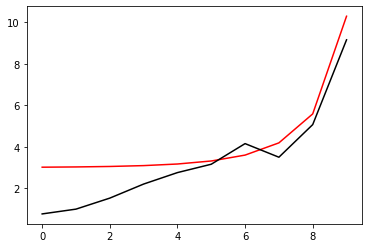

8500 89.77518627954119
[0.76049477 0.99144324 1.52288184 2.20113244 2.75447949 3.15807929
 4.15219015 3.4964105  5.07017769 9.15962392]


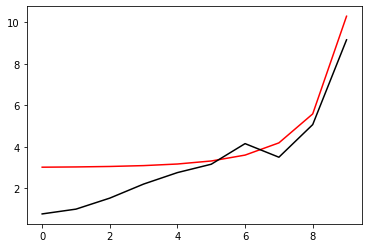

8600 89.7751809684311
[0.7605269  0.99141338 1.522785   2.2010833  2.75470628 3.1584338
 4.15163616 3.49634984 5.07034549 9.15958466]


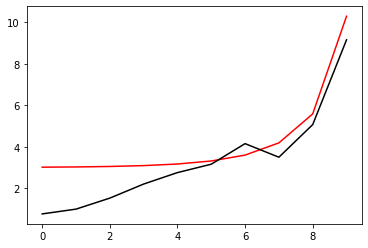

8700 89.7751756672629
[0.76055895 0.99138358 1.52268839 2.20103428 2.75493269 3.15878785
 4.15108259 3.4962892  5.07051342 9.15954541]


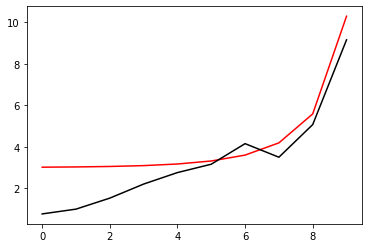

8800 89.775170376011
[0.76059092 0.99135385 1.52259199 2.2009854  2.7551587  3.15914145
 4.15052945 3.49622859 5.07068148 9.15950615]


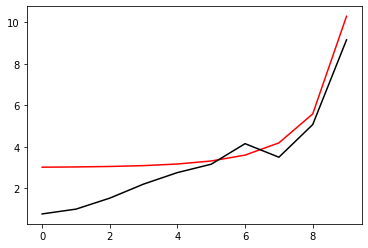

8900 89.77516509465008
[0.76062281 0.99132417 1.5224958  2.20093664 2.75538433 3.15949458
 4.14997673 3.496168   5.07084967 9.1594669 ]


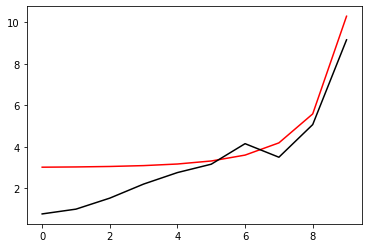

9000 89.7751598231547
[0.76065462 0.99129455 1.52239983 2.20088801 2.75560956 3.15984726
 4.14942443 3.49610744 5.071018   9.15942765]


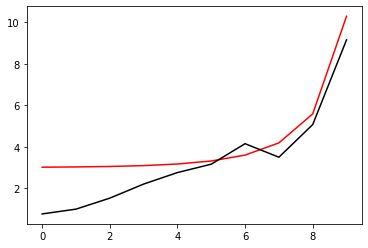

9100 89.77515456149982
[0.76068635 0.99126499 1.52230407 2.20083951 2.75583442 3.16019949
 4.14887256 3.4960469  5.07118645 9.1593884 ]


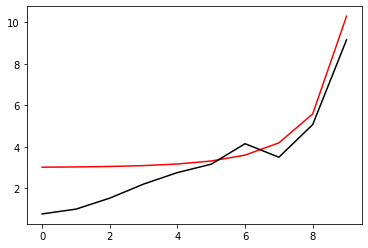

9200 89.7751493096602
[0.760718   0.99123549 1.52220853 2.20079114 2.75605888 3.16055126
 4.14832111 3.49598639 5.07135503 9.15934916]


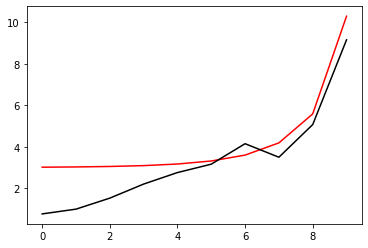

9300 89.77514406761064
[0.76074958 0.99120605 1.5221132  2.2007429  2.75628296 3.16090257
 4.14777008 3.4959259  5.07152374 9.15930992]


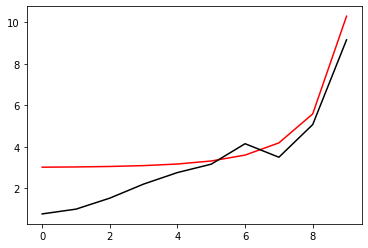

9400 89.77513883532633
[0.76078107 0.99117667 1.52201809 2.20069478 2.75650666 3.16125343
 4.14721947 3.49586543 5.07169258 9.15927067]


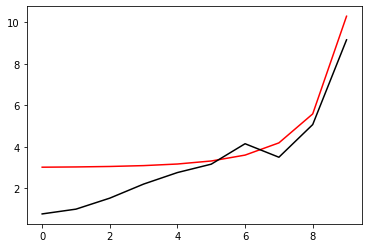

9500 89.77513361278218
[0.76081248 0.99114734 1.52192319 2.20064679 2.75672997 3.16160384
 4.14666929 3.49580499 5.07186155 9.15923143]


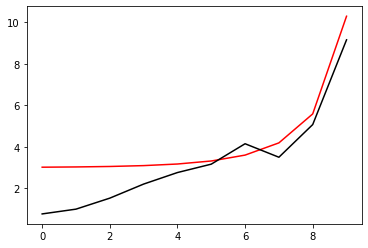

9600 89.77512839995345
[0.76084382 0.99111808 1.5218285  2.20059893 2.7569529  3.16195379
 4.14611952 3.49574457 5.07203065 9.1591922 ]


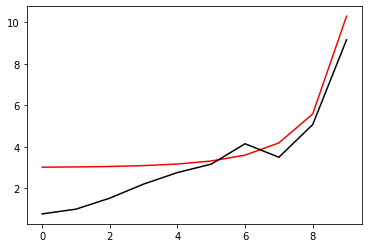

9700 89.77512319681527
[0.76087507 0.99108887 1.52173402 2.2005512  2.75717545 3.16230329
 4.14557018 3.49568418 5.07219988 9.15915296]


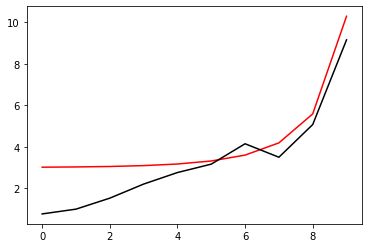

9800 89.775118003343
[0.76090625 0.99105973 1.52163975 2.20050359 2.75739762 3.16265233
 4.14502125 3.49562381 5.07236923 9.15911373]


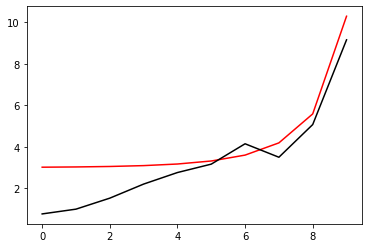

9900 89.7751128195119
[0.76093735 0.99103064 1.52154569 2.20045611 2.75761941 3.16300093
 4.14447275 3.49556346 5.07253871 9.15907449]


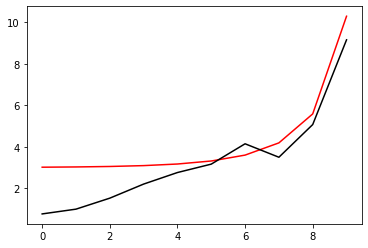

10000 89.77510764529751
[0.76096837 0.99100161 1.52145185 2.20040876 2.75784082 3.16334907
 4.14392466 3.49550314 5.07270832 9.15903526]


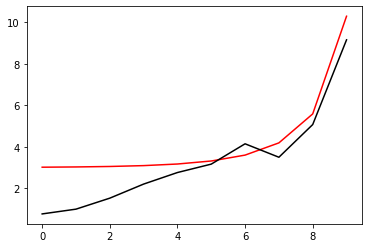

In [27]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 89.77510248067533
[0.76099931 0.99097263 1.52135821 2.20036153 2.75806186 3.16369676
 4.143377   3.49544284 5.07287806 9.15899604]


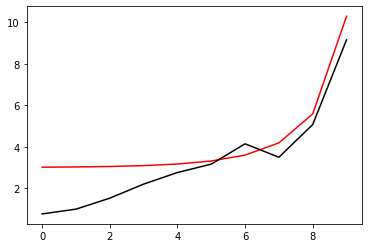

200 89.77509732562088
[0.76103017 0.99094372 1.52126478 2.20031443 2.75828251 3.164044
 4.14282975 3.49538256 5.07304792 9.15895681]


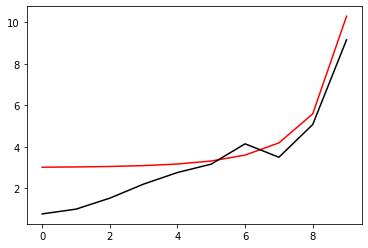

300 89.77509218010987
[0.76106096 0.99091486 1.52117157 2.20026746 2.75850279 3.16439079
 4.14228292 3.4953223  5.07321791 9.15891759]


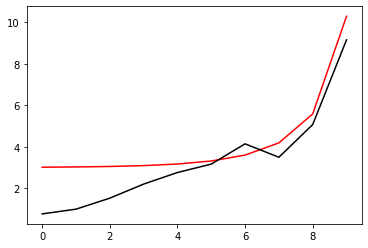

400 89.775087044118
[0.76109167 0.99088606 1.52107856 2.20022061 2.7587227  3.16473713
 4.1417365  3.49526207 5.07338803 9.15887837]


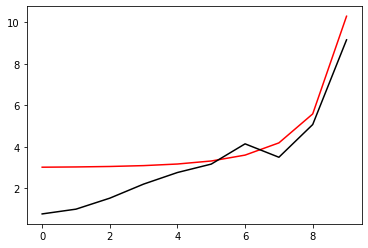

500 89.77508191762114
[0.7611223  0.99085732 1.52098576 2.20017389 2.75894223 3.16508303
 4.14119051 3.49520186 5.07355827 9.15883915]


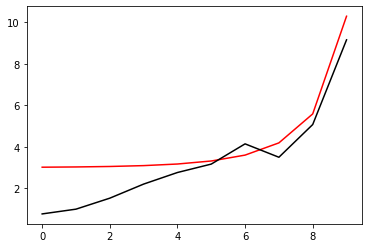

600 89.77507680059507
[0.76115285 0.99082863 1.52089316 2.20012729 2.75916139 3.16542847
 4.14064493 3.49514168 5.07372864 9.15879993]


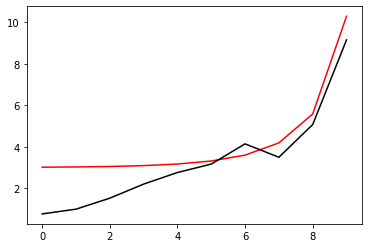

700 89.77507169301579
[0.76118333 0.9908     1.52080077 2.20008082 2.75938018 3.16577346
 4.14009976 3.49508151 5.07389913 9.15876071]


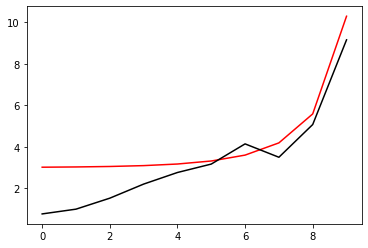

800 89.7750665948593
[0.76121373 0.99077143 1.52070859 2.20003448 2.75959859 3.16611801
 4.13955501 3.49502137 5.07406975 9.1587215 ]


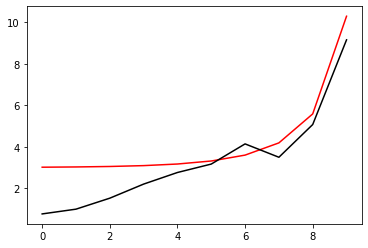

900 89.77506150610176
[0.76124405 0.99074292 1.52061662 2.19998826 2.75981664 3.1664621
 4.13901068 3.49496126 5.0742405  9.15868229]


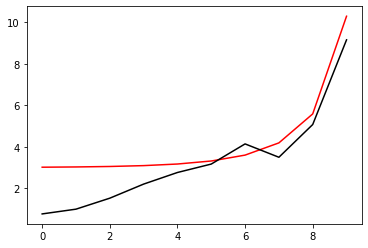

1000 89.7750564267192
[0.7612743  0.99071446 1.52052485 2.19994216 2.76003431 3.16680575
 4.13846676 3.49490116 5.07441136 9.15864308]


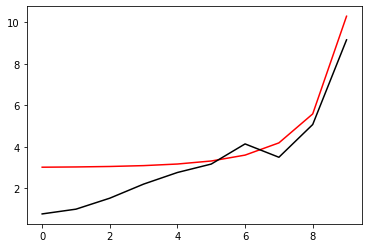

1100 89.77505135668788
[0.76130447 0.99068606 1.52043329 2.19989619 2.76025162 3.16714896
 4.13792326 3.49484108 5.07458236 9.15860387]


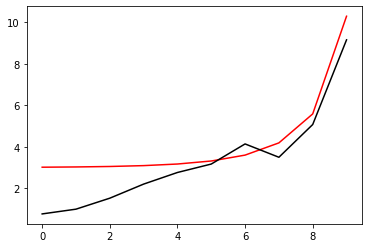

1200 89.77504629598424
[0.76133456 0.99065772 1.52034193 2.19985034 2.76046855 3.16749171
 4.13738017 3.49478103 5.07475347 9.15856466]


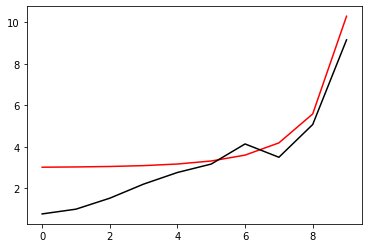

1300 89.7750412445845
[0.76136458 0.99062943 1.52025078 2.19980462 2.76068512 3.16783402
 4.13683749 3.494721   5.07492471 9.15852546]


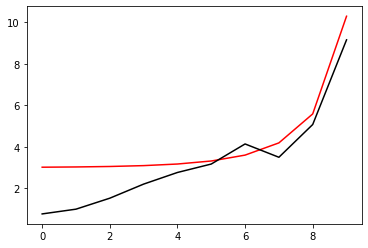

1400 89.77503620246513
[0.76139452 0.9906012  1.52015983 2.19975902 2.76090133 3.16817589
 4.13629523 3.49466099 5.07509608 9.15848626]


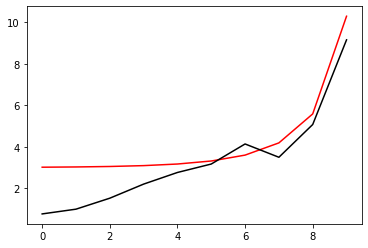

1500 89.77503116960267
[0.76142439 0.99057302 1.52006908 2.19971354 2.76111717 3.16851731
 4.13575338 3.494601   5.07526757 9.15844706]


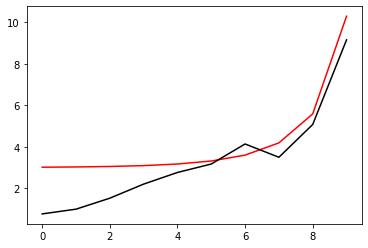

1600 89.77502614597367
[0.76145418 0.9905449  1.51997854 2.19966819 2.76133264 3.16885828
 4.13521194 3.49454104 5.07543918 9.15840786]


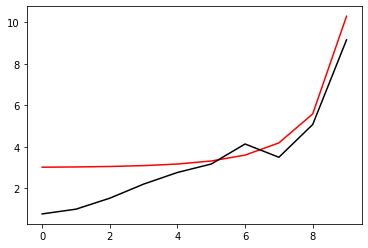

1700 89.77502113155487
[0.76148389 0.99051684 1.51988819 2.19962296 2.76154775 3.16919882
 4.13467091 3.49448109 5.07561091 9.15836867]


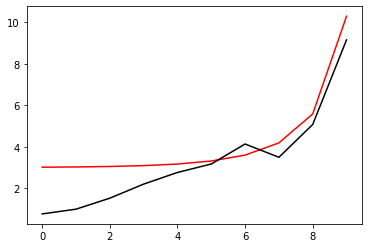

1800 89.77501612632291
[0.76151353 0.99048883 1.51979806 2.19957786 2.7617625  3.1695389
 4.1341303  3.49442117 5.07578277 9.15832947]


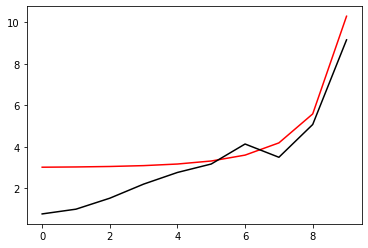

1900 89.77501113025455
[0.76154309 0.99046088 1.51970812 2.19953288 2.76197689 3.16987855
 4.13359009 3.49436127 5.07595474 9.15829028]


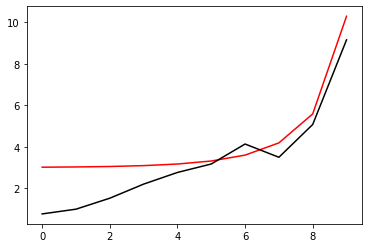

2000 89.7750061433267
[0.76157258 0.99043298 1.51961838 2.19948802 2.76219091 3.17021775
 4.1330503  3.49430139 5.07612684 9.15825109]


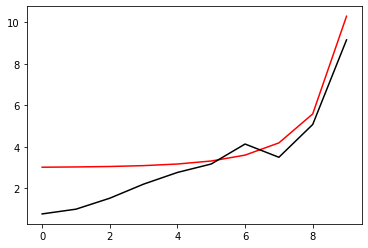

2100 89.77500116551626
[0.761602   0.99040514 1.51952885 2.19944328 2.76240458 3.17055651
 4.13251091 3.49424153 5.07629906 9.1582119 ]


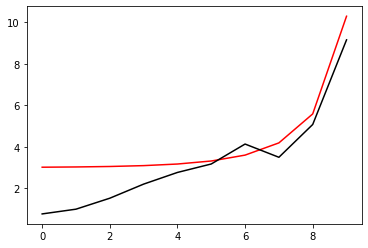

2200 89.7749961968003
[0.76163134 0.99037735 1.51943951 2.19939867 2.76261788 3.17089482
 4.13197194 3.49418169 5.07647141 9.15817272]


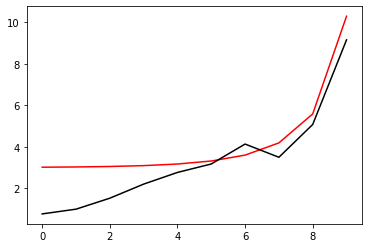

2300 89.77499123715573
[0.7616606  0.99034962 1.51935038 2.19935418 2.76283083 3.1712327
 4.13143337 3.49412187 5.07664387 9.15813354]


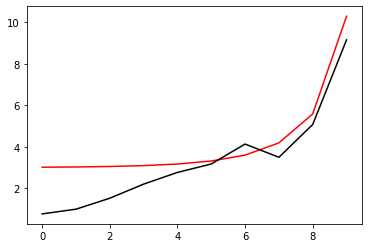

2400 89.77498628655975
[0.76168979 0.99032194 1.51926144 2.19930981 2.76304342 3.17157013
 4.13089521 3.49406207 5.07681646 9.15809436]


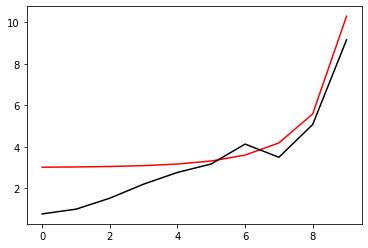

2500 89.7749813449896
[0.76171891 0.99029432 1.51917271 2.19926557 2.76325565 3.17190713
 4.13035746 3.49400229 5.07698916 9.15805518]


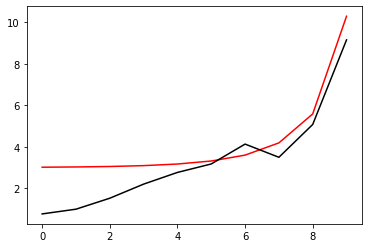

2600 89.7749764124225
[0.76174795 0.99026675 1.51908417 2.19922144 2.76346752 3.17224368
 4.12982012 3.49394253 5.07716199 9.158016  ]


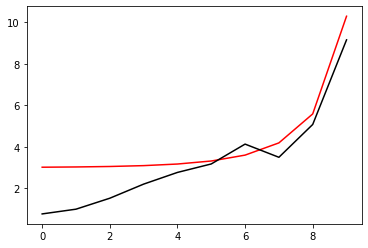

2700 89.77497148883577
[0.76177692 0.99023924 1.51899583 2.19917744 2.76367904 3.1725798
 4.12928319 3.4938828  5.07733493 9.15797682]


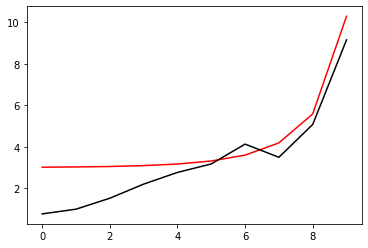

2800 89.77496657420684
[0.76180582 0.99021178 1.51890769 2.19913356 2.76389021 3.17291547
 4.12874666 3.49382308 5.077508   9.15793765]


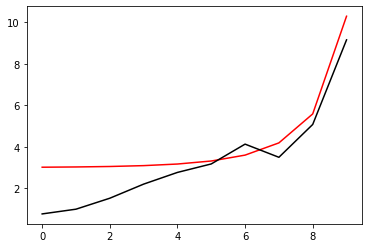

2900 89.77496166851321
[0.76183464 0.99018438 1.51881974 2.19908979 2.76410102 3.17325071
 4.12821054 3.49376338 5.07768118 9.15789848]


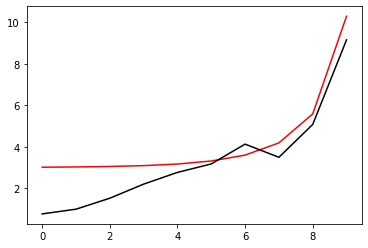

3000 89.77495677173232
[0.76186339 0.99015702 1.518732   2.19904616 2.76431148 3.1735855
 4.12767483 3.4937037  5.07785448 9.15785931]


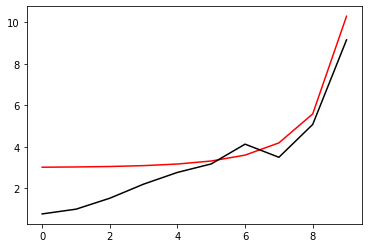

3100 89.77495188384178
[0.76189206 0.99012973 1.51864444 2.19900264 2.76452159 3.17391986
 4.12713952 3.49364404 5.07802791 9.15782014]


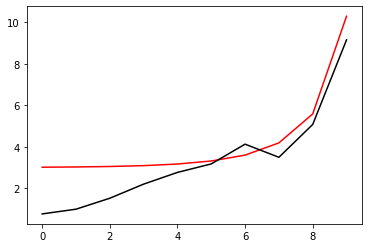

3200 89.77494700481928
[0.76192066 0.99010249 1.51855709 2.19895924 2.76473135 3.17425378
 4.12660462 3.49358441 5.07820145 9.15778098]


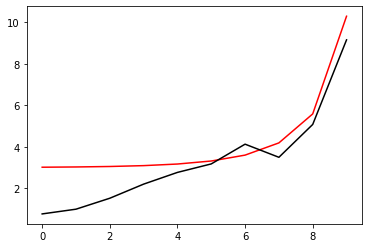

3300 89.77494213464252
[0.76194919 0.9900753  1.51846993 2.19891596 2.76494076 3.17458727
 4.12607012 3.49352479 5.07837511 9.15774181]


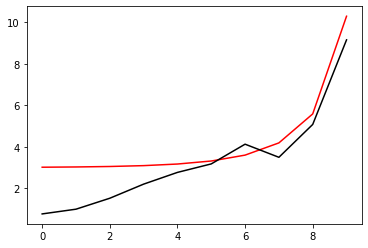

3400 89.77493727328934
[0.76197765 0.99004816 1.51838297 2.19887281 2.76514981 3.17492032
 4.12553603 3.49346519 5.07854889 9.15770265]


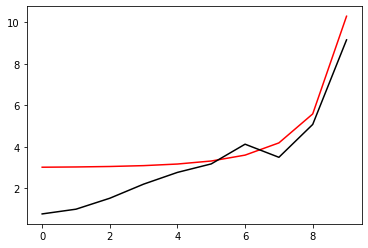

3500 89.77493242073753
[0.76200603 0.99002108 1.5182962  2.19882977 2.76535852 3.17525293
 4.12500234 3.49340561 5.07872278 9.1576635 ]


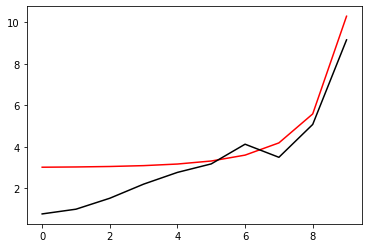

3600 89.77492757696503
[0.76203434 0.98999405 1.51820962 2.19878685 2.76556688 3.1755851
 4.12446905 3.49334605 5.0788968  9.15762434]


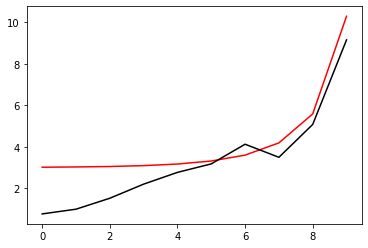

3700 89.77492274194991
[0.76206258 0.98996708 1.51812324 2.19874405 2.7657749  3.17591684
 4.12393617 3.49328651 5.07907093 9.15758518]


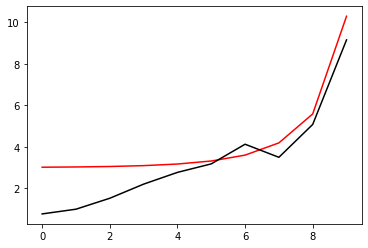

3800 89.77491791567007
[0.76209075 0.98994015 1.51803705 2.19870138 2.76598257 3.17624815
 4.12340369 3.49322698 5.07924518 9.15754603]


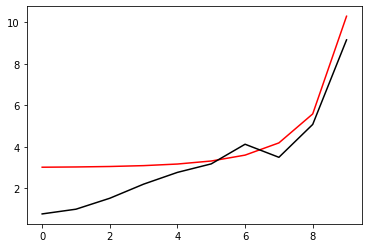

3900 89.77491309810378
[0.76211885 0.98991329 1.51795106 2.19865882 2.76618989 3.17657902
 4.12287161 3.49316748 5.07941954 9.15750688]


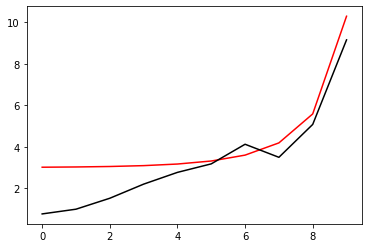

4000 89.77490828922907
[0.76214687 0.98988647 1.51786526 2.19861638 2.76639687 3.17690946
 4.12233994 3.49310799 5.07959402 9.15746773]


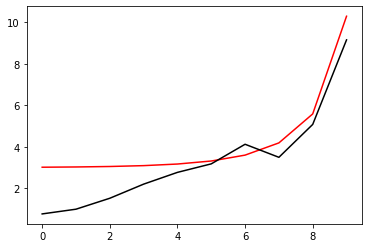

4100 89.77490348902434
[0.76217482 0.98985971 1.51777965 2.19857406 2.7666035  3.17723946
 4.12180866 3.49304853 5.07976862 9.15742859]


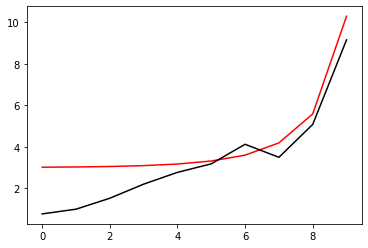

4200 89.77489869746778
[0.7622027  0.989833   1.51769423 2.19853186 2.76680979 3.17756903
 4.12127779 3.49298908 5.07994333 9.15738944]


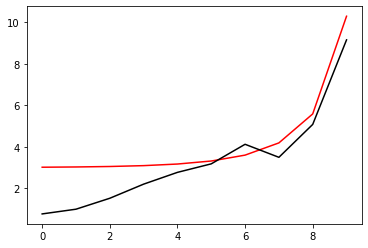

4300 89.77489391453773
[0.76223051 0.98980634 1.517609   2.19848978 2.76701574 3.17789817
 4.12074732 3.49292965 5.08011816 9.1573503 ]


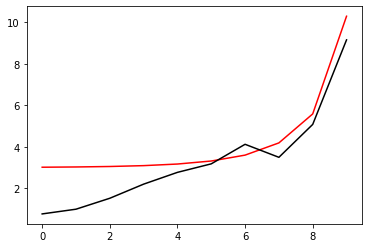

4400 89.77488914021266
[0.76225825 0.98977973 1.51752397 2.19844782 2.76722135 3.17822687
 4.12021725 3.49287024 5.08029311 9.15731116]


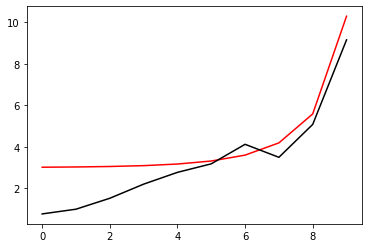

4500 89.7748843744712
[0.76228591 0.98975318 1.51743912 2.19840597 2.76742662 3.17855515
 4.11968757 3.49281085 5.08046817 9.15727202]


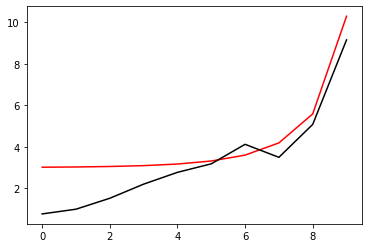

4600 89.7748796172917
[0.76231351 0.98972668 1.51735447 2.19836424 2.76763154 3.17888299
 4.1191583  3.49275147 5.08064335 9.15723288]


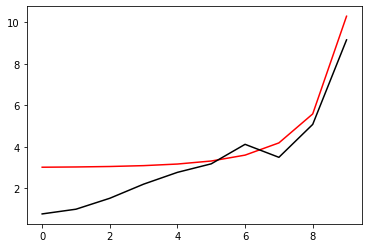

4700 89.77487486865286
[0.76234103 0.98970023 1.51727    2.19832263 2.76783613 3.1792104
 4.11862943 3.49269211 5.08081864 9.15719375]


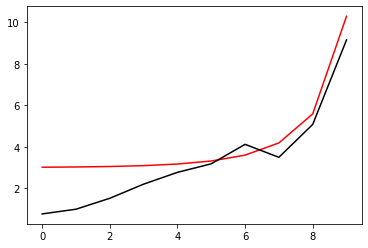

4800 89.7748701285334
[0.76236848 0.98967383 1.51718573 2.19828114 2.76804038 3.17953738
 4.11810095 3.49263277 5.08099404 9.15715462]


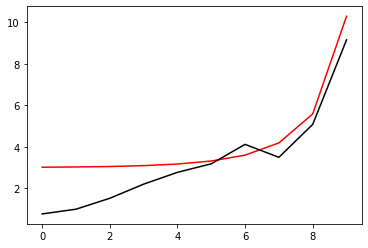

4900 89.77486539691206
[0.76239587 0.98964748 1.51710164 2.19823977 2.7682443  3.17986393
 4.11757288 3.49257345 5.08116956 9.15711549]


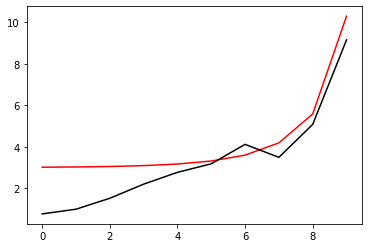

5000 89.77486067376758
[0.76242318 0.98962119 1.51701774 2.19819851 2.76844787 3.18019005
 4.1170452  3.49251415 5.0813452  9.15707636]


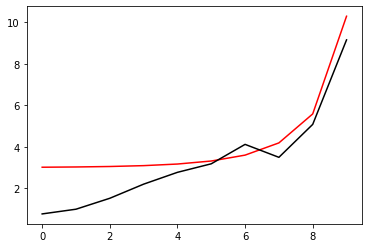

5100 89.77485595907885
[0.76245042 0.98959494 1.51693403 2.19815737 2.76865111 3.18051574
 4.11651792 3.49245486 5.08152094 9.15703723]


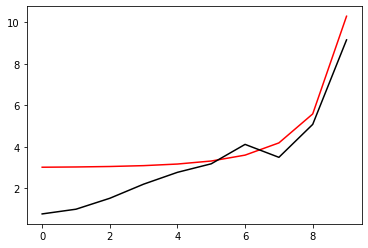

5200 89.77485125282483
[0.7624776  0.98956875 1.51685051 2.19811635 2.76885402 3.180841
 4.11599103 3.4923956  5.0816968  9.15699811]


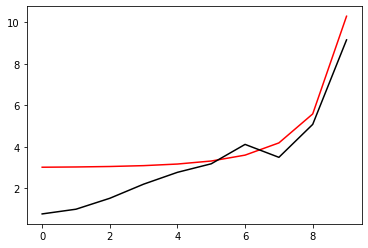

5300 89.7748465549845
[0.7625047  0.98954261 1.51676718 2.19807545 2.76905659 3.18116584
 4.11546454 3.49233634 5.08187278 9.15695899]


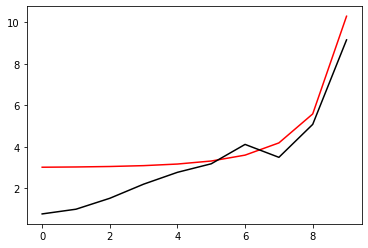

5400 89.77484186553691
[0.76253173 0.98951652 1.51668403 2.19803466 2.76925883 3.18149024
 4.11493845 3.49227711 5.08204886 9.15691987]


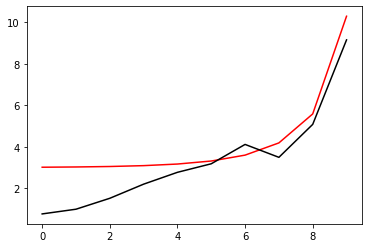

5500 89.77483718446116
[0.7625587  0.98949049 1.51660107 2.19799399 2.76946073 3.18181422
 4.11441275 3.49221789 5.08222506 9.15688075]


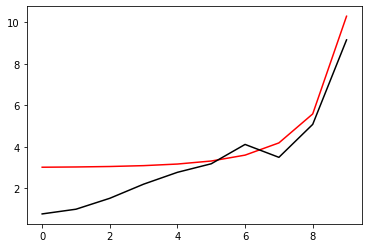

5600 89.77483251173639
[0.76258559 0.9894645  1.51651829 2.19795343 2.76966231 3.18213778
 4.11388745 3.49215869 5.08240138 9.15684163]


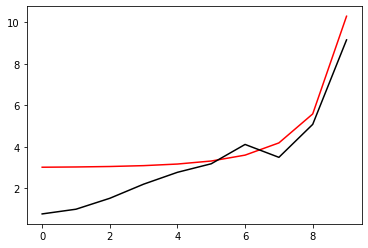

5700 89.77482784734187
[0.76261242 0.98943856 1.5164357  2.19791299 2.76986355 3.1824609
 4.11336255 3.49209951 5.0825778  9.15680252]


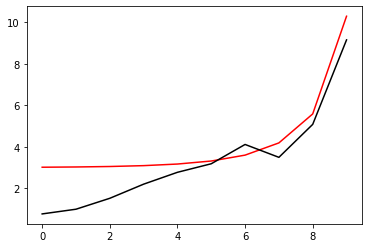

5800 89.77482319125691
[0.76263917 0.98941268 1.5163533  2.19787267 2.77006446 3.1827836
 4.11283804 3.49204035 5.08275434 9.15676341]


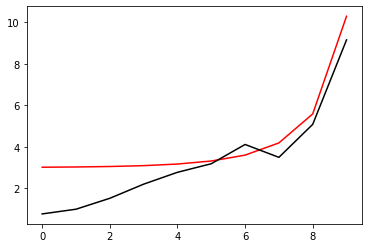

5900 89.7748185434609
[0.76266586 0.98938684 1.51627108 2.19783246 2.77026504 3.18310587
 4.11231392 3.4919812  5.08293099 9.1567243 ]


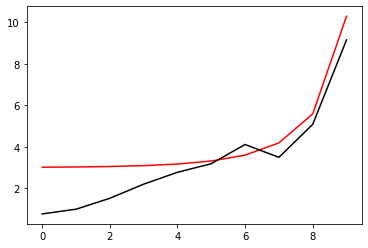

6000 89.7748139039331
[0.76269248 0.98936106 1.51618905 2.19779237 2.7704653  3.18342772
 4.11179019 3.49192206 5.08310775 9.15668519]


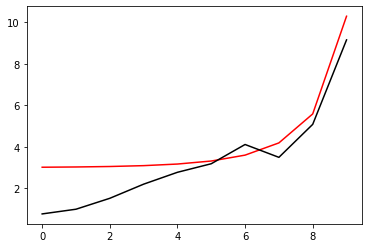

6100 89.77480927265312
[0.76271903 0.98933532 1.51610719 2.1977524  2.77066522 3.18374915
 4.11126686 3.49186295 5.08328462 9.15664609]


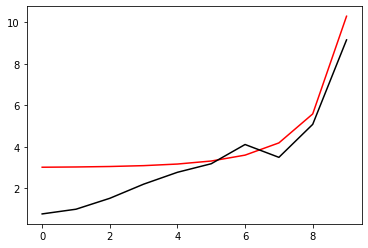

6200 89.77480464960033
[0.76274551 0.98930964 1.51602553 2.19771254 2.77086482 3.18407014
 4.11074393 3.49180385 5.0834616  9.15660698]


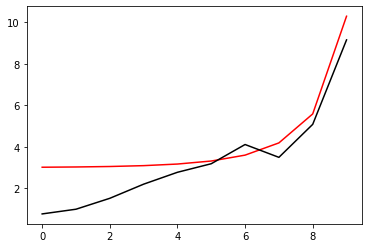

6300 89.7748000347545
[0.76277192 0.989284   1.51594404 2.19767279 2.77106409 3.18439072
 4.11022138 3.49174476 5.08363869 9.15656788]


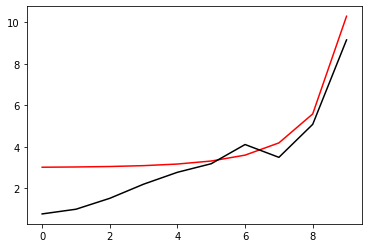

6400 89.77479542809517
[0.76279826 0.98925842 1.51586274 2.19763316 2.77126304 3.18471087
 4.10969923 3.4916857  5.0838159  9.15652878]


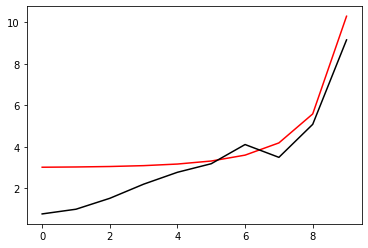

6500 89.77479082960214
[0.76282454 0.98923288 1.51578163 2.19759364 2.77146166 3.1850306
 4.10917747 3.49162665 5.08399321 9.15648969]


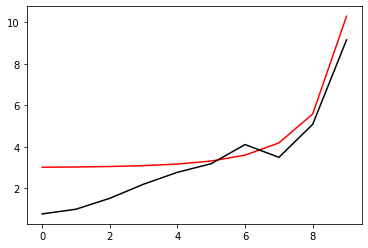

6600 89.77478623925509
[0.76285075 0.9892074  1.51570069 2.19755424 2.77165996 3.1853499
 4.1086561  3.49156761 5.08417064 9.15645059]


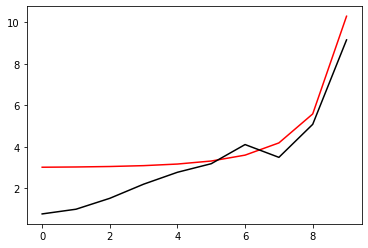

6700 89.7747816570339
[0.76287689 0.98918196 1.51561994 2.19751496 2.77185793 3.18566879
 4.10813512 3.49150859 5.08434817 9.1564115 ]


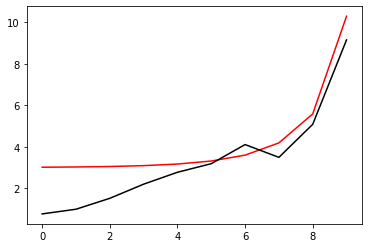

6800 89.77477708291836
[0.76290296 0.98915658 1.51553936 2.19747578 2.77205558 3.18598725
 4.10761453 3.49144959 5.08452581 9.15637241]


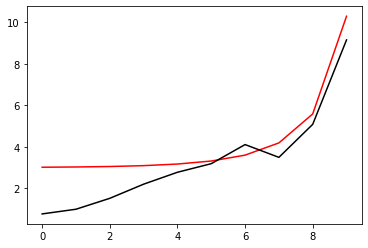

6900 89.7747725168885
[0.76292896 0.98913124 1.51545897 2.19743672 2.77225291 3.18630529
 4.10709433 3.4913906  5.08470356 9.15633332]


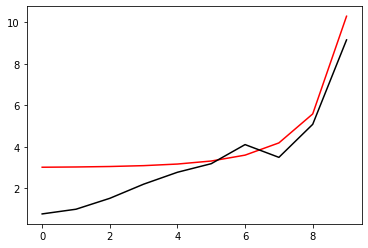

7000 89.77476795892426
[0.7629549  0.98910596 1.51537876 2.19739778 2.77244991 3.18662291
 4.10657452 3.49133163 5.08488143 9.15629423]


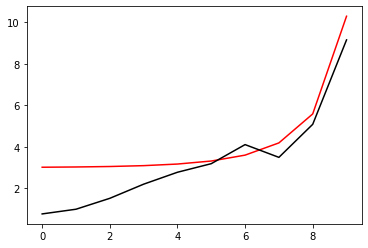

7100 89.77476340900574
[0.76298077 0.98908072 1.51529873 2.19735895 2.7726466  3.18694011
 4.1060551  3.49127268 5.0850594  9.15625515]


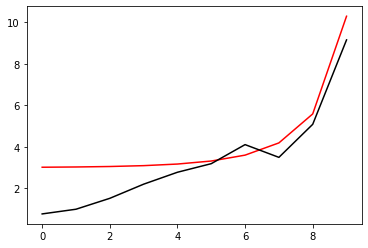

7200 89.77475886711296
[0.76300658 0.98905553 1.51521888 2.19732023 2.77284297 3.18725688
 4.10553607 3.49121373 5.08523748 9.15621606]


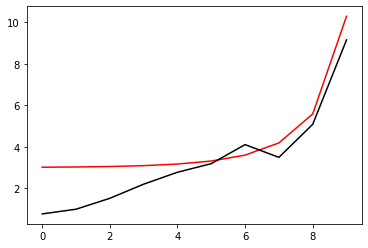

7300 89.77475433322627
[0.76303231 0.98903039 1.51513921 2.19728163 2.77303901 3.18757324
 4.10501742 3.49115481 5.08541566 9.15617698]


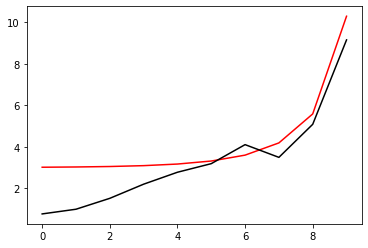

7400 89.77474980732573
[0.76305798 0.9890053  1.51505971 2.19724314 2.77323474 3.18788918
 4.10449917 3.4910959  5.08559396 9.15613791]


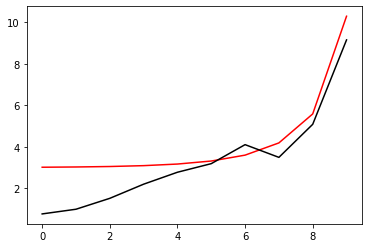

7500 89.77474528939167
[0.76308358 0.98898026 1.5149804  2.19720476 2.77343015 3.1882047
 4.1039813  3.491037   5.08577236 9.15609883]


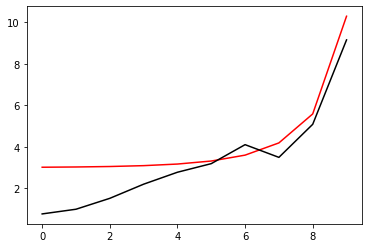

7600 89.77474077940442
[0.76310912 0.98895526 1.51490126 2.19716649 2.77362525 3.18851981
 4.10346382 3.49097812 5.08595087 9.15605976]


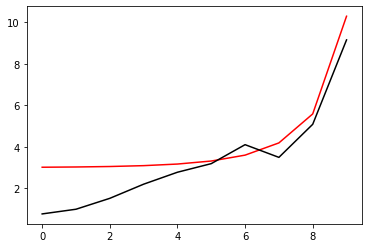

7700 89.77473627734443
[0.76313459 0.98893032 1.51482231 2.19712834 2.77382002 3.18883449
 4.10294673 3.49091926 5.08612949 9.15602068]


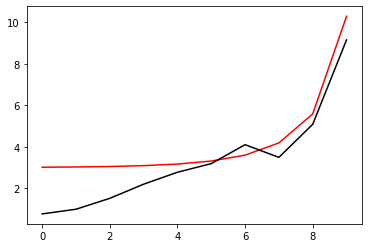

7800 89.77473178319208
[0.76315999 0.98890542 1.51474353 2.1970903  2.77401449 3.18914876
 4.10243002 3.49086041 5.08630822 9.15598161]


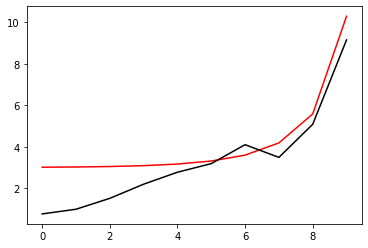

7900 89.77472729692794
[0.76318533 0.98888057 1.51466492 2.19705237 2.77420864 3.18946261
 4.1019137  3.49080157 5.08648705 9.15594255]


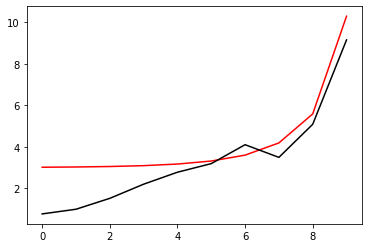

8000 89.77472281853248
[0.7632106  0.98885577 1.5145865  2.19701456 2.77440247 3.18977604
 4.10139776 3.49074275 5.08666599 9.15590348]


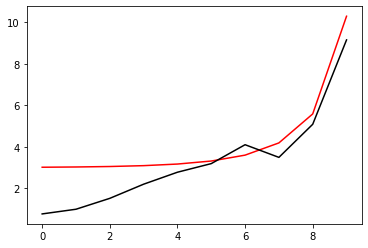

8100 89.77471834798641
[0.76323581 0.98883102 1.51450825 2.19697686 2.77459599 3.19008906
 4.10088221 3.49068395 5.08684504 9.15586442]


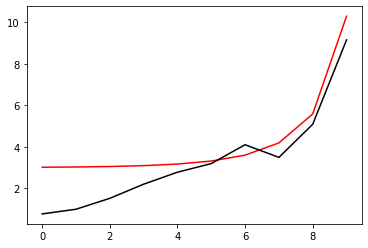

8200 89.77471388527037
[0.76326095 0.98880632 1.51443017 2.19693926 2.7747892  3.19040166
 4.10036705 3.49062515 5.08702419 9.15582535]


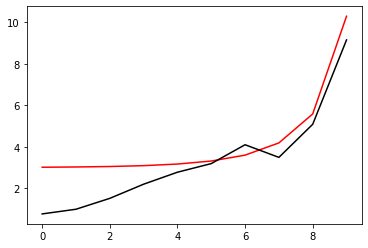

8300 89.77470943036508
[0.76328602 0.98878166 1.51435228 2.19690178 2.77498209 3.19071385
 4.09985226 3.49056638 5.08720344 9.1557863 ]


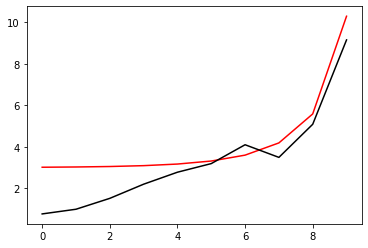

8400 89.77470498325131
[0.76331103 0.98875705 1.51427455 2.19686442 2.77517468 3.19102562
 4.09933787 3.49050761 5.08738281 9.15574724]


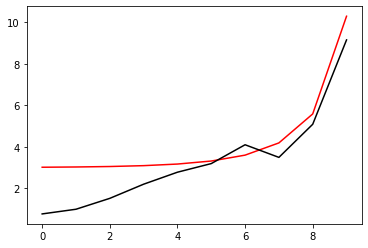

8500 89.77470054390993
[0.76333597 0.98873249 1.51419701 2.19682716 2.77536695 3.19133698
 4.09882385 3.49044886 5.08756228 9.15570818]


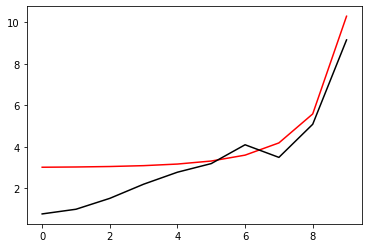

8600 89.77469611232186
[0.76336085 0.98870798 1.51411963 2.19679001 2.77555892 3.19164792
 4.09831022 3.49039013 5.08774185 9.15566913]


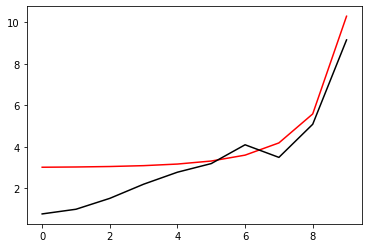

8700 89.77469168846797
[0.76338566 0.98868351 1.51404243 2.19675298 2.77575058 3.19195845
 4.09779697 3.49033141 5.08792153 9.15563008]


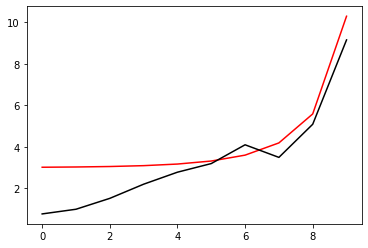

8800 89.77468727232933
[0.76341041 0.98865909 1.51396541 2.19671605 2.77594192 3.19226856
 4.09728411 3.4902727  5.08810131 9.15559103]


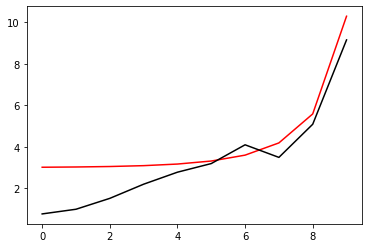

8900 89.77468286388695
[0.76343509 0.98863472 1.51388856 2.19667924 2.77613296 3.19257827
 4.09677162 3.49021401 5.0882812  9.15555198]


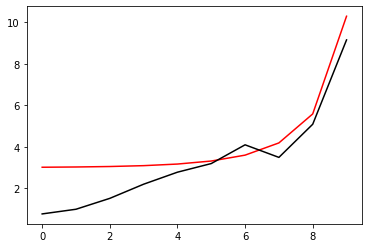

9000 89.7746784631219
[0.76345971 0.9886104  1.51381188 2.19664253 2.7763237  3.19288756
 4.09625952 3.49015533 5.0884612  9.15551294]


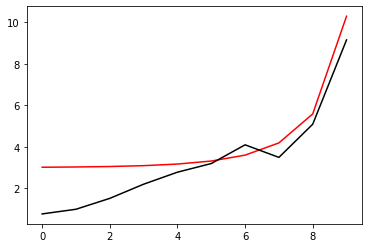

9100 89.77467407001546
[0.76348427 0.98858612 1.51373537 2.19660594 2.77651413 3.19319644
 4.0957478  3.49009666 5.08864129 9.1554739 ]


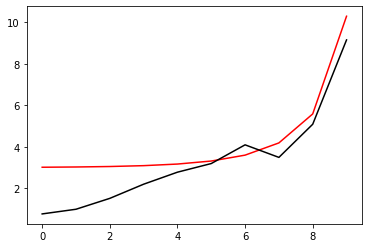

9200 89.77466968454883
[0.76350876 0.98856189 1.51365904 2.19656946 2.77670425 3.1935049
 4.09523646 3.49003801 5.08882149 9.15543485]


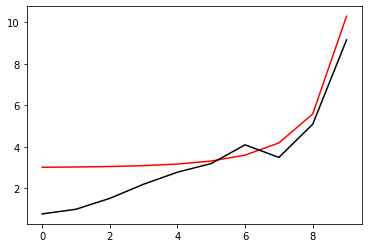

9300 89.77466530670317
[0.76353318 0.9885377  1.51358288 2.19653309 2.77689407 3.19381296
 4.0947255  3.48997937 5.0890018  9.15539582]


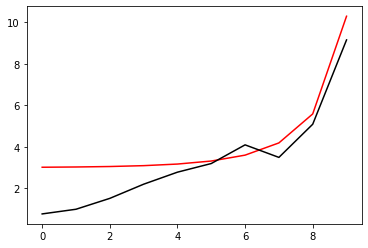

9400 89.77466093645988
[0.76355754 0.98851356 1.51350689 2.19649682 2.77708358 3.19412061
 4.09421492 3.48992074 5.0891822  9.15535678]


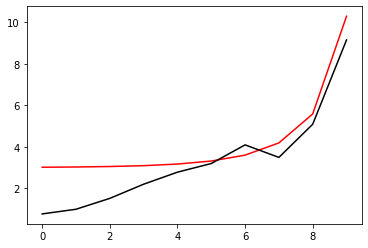

9500 89.77465657380034
[0.76358184 0.98848947 1.51343107 2.19646067 2.77727279 3.19442784
 4.09370472 3.48986213 5.08936272 9.15531775]


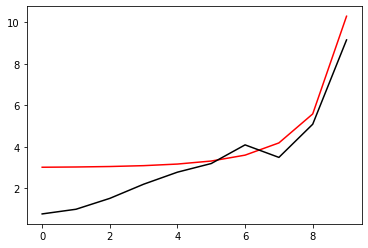

9600 89.77465221870598
[0.76360607 0.98846543 1.51335542 2.19642462 2.7774617  3.19473467
 4.0931949  3.48980353 5.08954333 9.15527871]


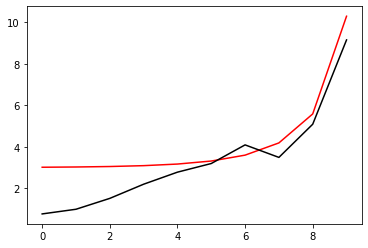

9700 89.77464787115822
[0.76363024 0.98844143 1.51327994 2.19638869 2.7776503  3.19504109
 4.09268546 3.48974495 5.08972405 9.15523968]


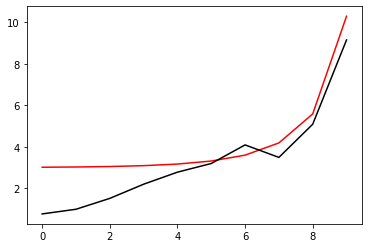

KeyboardInterrupt: 

In [28]:
optimizer=tf.optimizers.SGD(learning_rate=0.001)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 88.72993278584578
[0.82529001 1.39763271 1.97929772 2.57038609 3.01591861 3.29613445
 4.06310441 3.36475664 4.90567228 9.15480598]


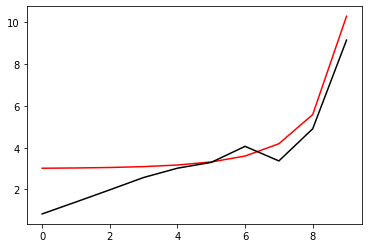

200 88.33886824950102
[0.61084268 1.49804311 2.18070153 2.72980592 3.08331519 3.26065417
 3.92692441 3.14110007 4.63909249 9.1543847 ]


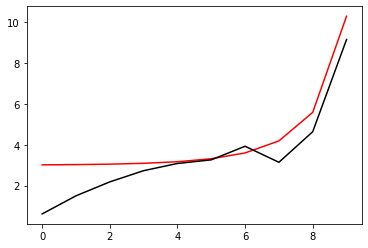

300 88.2361451423978
[0.48925549 1.54792659 2.3096954  2.84136755 3.14173984 3.25628479
 3.85434039 3.01186537 4.47535309 9.15394295]


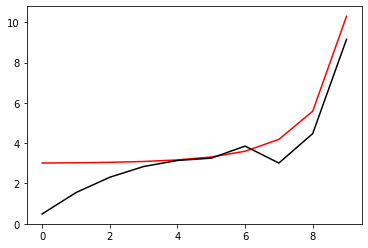

400 88.18049403522029
[0.40340741 1.57654413 2.41023892 2.93574569 3.19851274 3.26603506
 3.80871181 2.92197197 4.35400307 9.15348784]


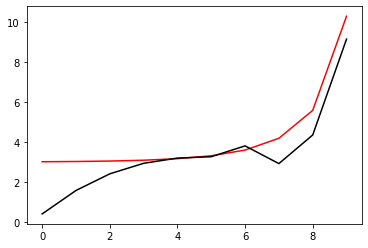

500 88.14425695128678
[0.33883107 1.59075998 2.49017865 3.01619972 3.25039862 3.28012411
 3.77526473 2.85147046 4.2543185  9.15302224]


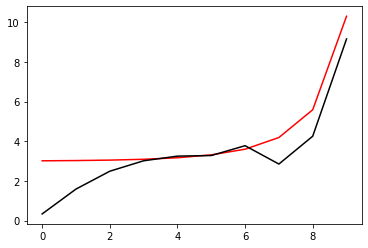

600 88.11808388635566
[0.28806828 1.5961508  2.55617359 3.08726532 3.29875364 3.29657024
 3.74925802 2.79301227 4.16814934 9.15254781]


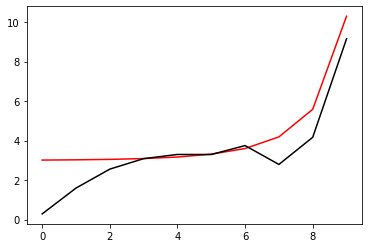

700 88.09772351730427
[0.24667875 1.59601403 2.61219666 3.15167549 3.34454919 3.31447135
 3.72821085 2.74262952 4.09103704 9.1520656 ]


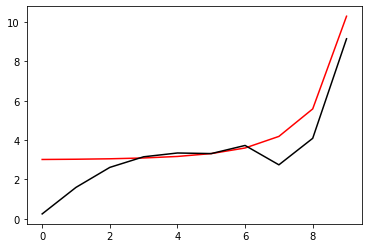

800 88.0810020737838
[0.2118705  1.59240608 2.66078218 3.21115203 3.38844055 3.33334127
 3.71066305 2.69794412 4.02029032 9.15157636]


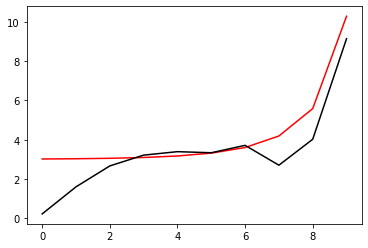

900 88.06670094808838
[0.18179628 1.58666298 2.70365127 3.2668403  3.43088118 3.35289168
 3.69568647 2.65742417 3.95416661 9.15108061]


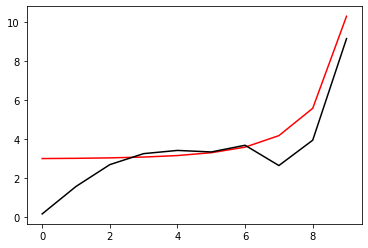

1000 88.05408442506327
[0.15518292 1.57967864 2.74203444 3.3195394  3.47219502 3.37293848
 3.68265436 2.62002441 3.89147192 9.15057873]


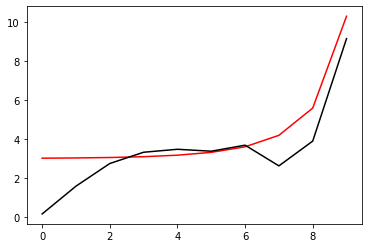

1100 88.04268002130331
[0.13112314 1.57206371 2.7768497  3.36983078 3.51262102 3.39335712
 3.67112217 2.58499689 3.83134853 9.150071  ]


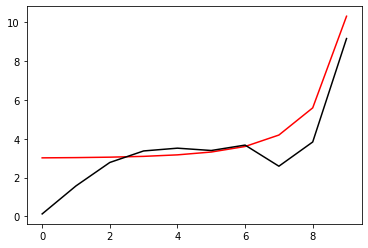

1200 88.03216763628562
[0.10895163 1.56424175 2.80880689 3.41815427 3.55234125 3.41405956
 3.66076132 2.55178414 3.77315452 9.14955765]


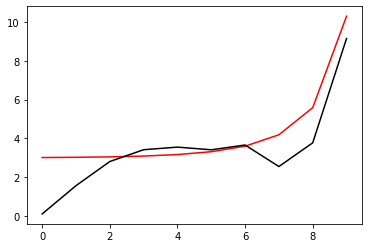

1300 88.02231967919609
[0.08816753 1.55651014 2.83847246 3.46485517 3.5914993  3.4349815
 3.65132015 2.51995526 3.71639118 9.14903883]


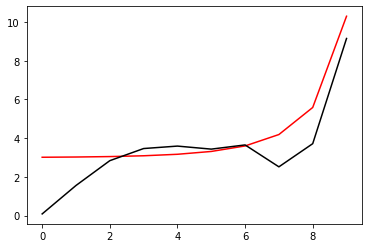

1400 88.01296677351391
[0.06838395 1.54908027 2.86631155 3.51021478 3.63021263 3.45607497
 3.64259947 2.48916554 3.66065709 9.14851467]


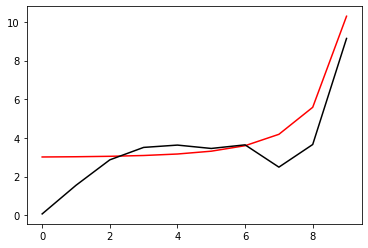

1500 88.00397703487255
[0.04929381 1.54210491 2.89271665 3.55447087 3.66858117 3.47730368
 3.63443665 2.45912972 3.60561738 9.14798524]


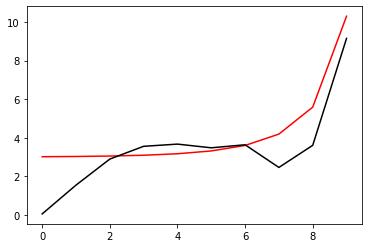

1600 87.99524287767206
[0.03064595 1.53569736 2.91802798 3.5978321  3.70669341 3.49863996
 3.62669448 2.42960325 3.55098227 9.1474506 ]


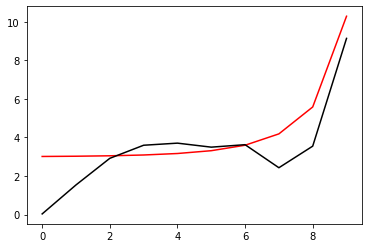

1700 87.98667212713944
[0.01222793 1.52994532 2.94254852 3.64048841 3.74463092 3.5200625
 3.61925313 2.40036853 3.49649105 9.14691077]


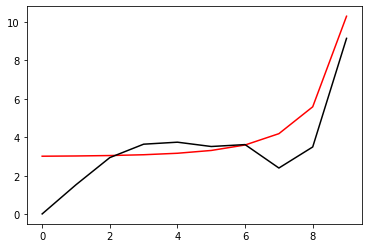

1800 87.97818161604197
[-6.14685504e-03  1.52492118e+00  2.96655579e+00  3.68261894e+00
  3.78247177e+00  3.54155467e+00  3.61200386e+00  2.37122412e+00
  3.44189952e+00  9.14636577e+00]


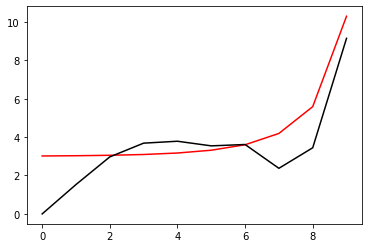

1900 87.96969216521316
[-0.02464923  1.52069007  2.9903114   3.72439835  3.82029319  3.56310299
  3.60484369  2.34197552  3.38696923  9.14581556]


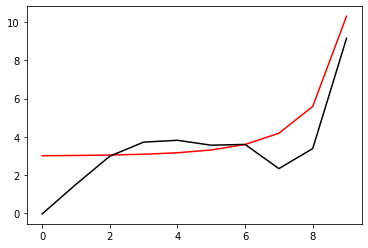

2000 87.96112421619152
[-0.04344241  1.51731634  3.01406937  3.76600222  3.85817379  3.58469567
  3.59767055  2.31242679  3.33145751  9.1452601 ]


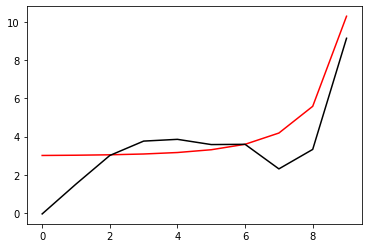

2100 87.95239355591727
[-0.06268912  1.51486934  3.03808384  3.80761192  3.89619537  3.6063209
  3.59037832  2.28237194  3.27510728  9.14469933]


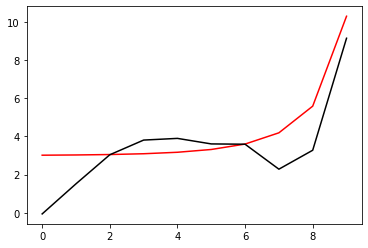

2200 87.94340661481175
[-0.08255824  1.51342878  3.06261655  3.84941921  3.9344444   3.62796478
  3.58285119  2.25158535  3.21763567  9.14413316]


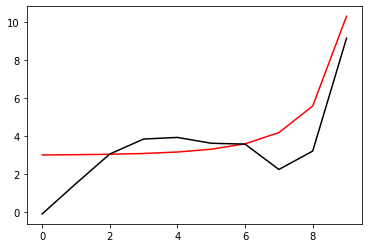

2300 87.93405474861665
[-0.10323139  1.51309034  3.08794469  3.89163089  3.97301298  3.64960814
  3.5749566   2.21980996  3.15872012  9.14356146]


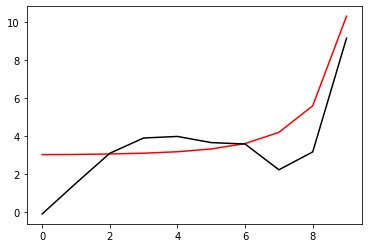

2400 87.92420670785556
[-0.12490982  1.51397165  3.11436906  3.93447313  4.01199882  3.67122166
  3.56653538  2.18674148  3.09797999  9.14298407]


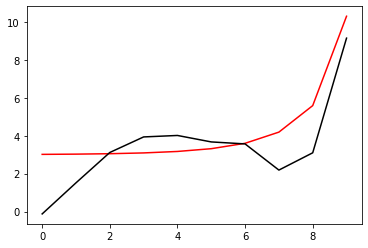

2500 87.91369807427711
[-0.14782197  1.51621907  3.14222277  3.97819524  4.05150308  3.69275732
  3.55738696  2.1520055   3.03495049  9.1424008 ]


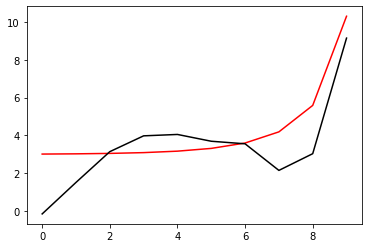

2600 87.90231558720137
[-0.17223142  1.52001509  3.17187925  4.02307061  4.09162331  3.7141326
  3.54724491  2.11512158  2.96904271  9.14181141]


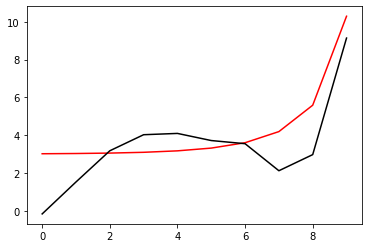

2700 87.88977239890184
[-0.19844443  1.52558545  3.20375671  4.06939025  4.13243474  3.73519889
  3.5357329   2.07544161  2.89947703  9.14121558]


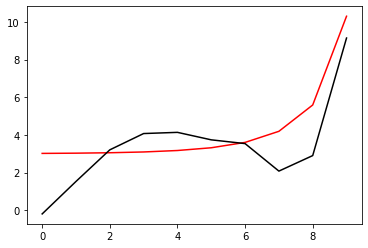

2800 87.87566543346048
[-0.22681358  1.53320221  3.2383096   4.11743521  4.17394287  3.75567318
  3.52227671  2.03203243  2.82515997  9.14061291]


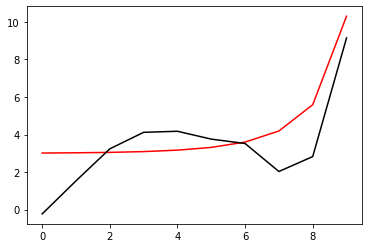

2900 87.8593903285563
[-0.25772677  1.54317167  3.27598047  4.1673901   4.21595951  3.7749757
  3.50590678  1.9834223   2.7444251   9.14000288]


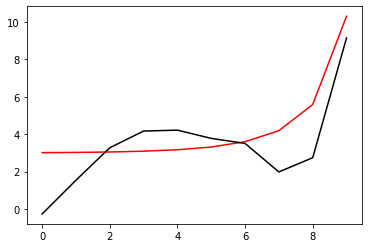

3000 87.83992342861431
[-0.29154915  1.55577426  3.31703147  4.21908294  4.25775736  3.79179812
  3.48475057  1.9269648   2.65439477  9.13938475]


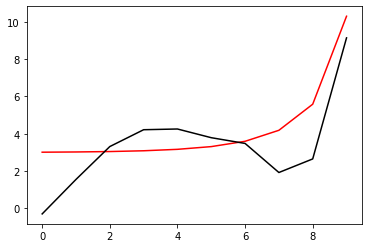

3100 87.81500687383407
[-0.32841019  1.57106379  3.3609966   4.27116367  4.29699998  3.80278365
  3.45449674  1.85693103  2.54907911  9.13875737]


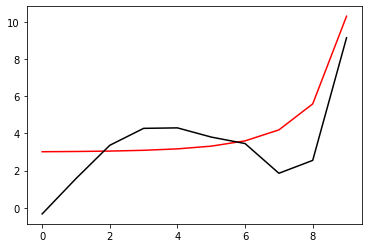

3200 87.77625323969245
[-0.36741046  1.58826807  3.40478505  4.31815348  4.32582643  3.79764198
  3.40266873  1.75735417  2.41222206  9.13811867]


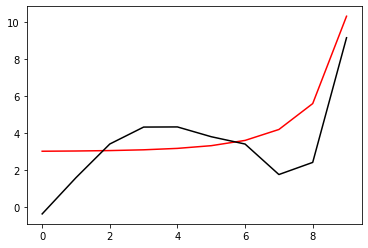

3300 87.66051633503137
[-0.40289727  1.60444596  3.43550847  4.3382227   4.31392723  3.73746024
  3.2826948   1.56903186  2.18391978  9.13746341]


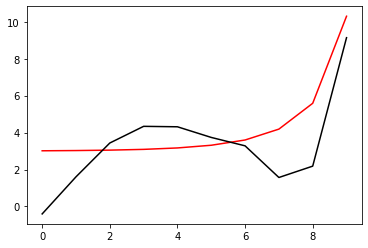

3400 87.10980607870182
[-0.36453928  1.68759152  3.48966402  4.33552245  4.23573086  3.56722259
  3.01087648  1.16765718  1.72489963  9.13677666]


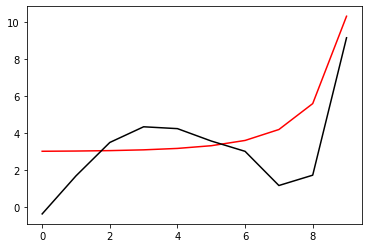

3500 3.246644655342673
[ 2.23706416  3.29468276  4.30505264  4.59277603  4.0611551   2.99782804
  2.05426741 -0.34323002 -0.08884921  9.13598064]


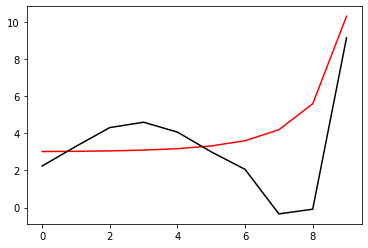

3600 2.5246288264277723
[2.13160482 3.13072697 4.22160349 4.61829096 4.18446741 3.21163188
 2.35264972 0.117266   0.46180747 9.13511988]


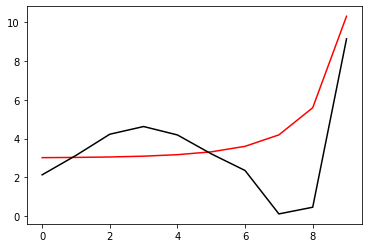

3700 2.199074675860422
[2.14796383 3.02631577 4.13846325 4.61052753 4.25077449 3.34568162
 2.54777156 0.42385711 0.83012196 9.13430734]


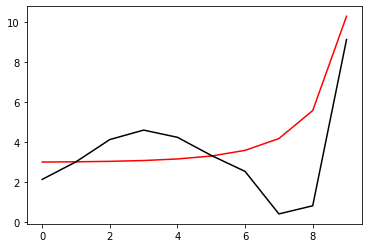

3800 2.118504786428261
[2.17066326 2.97117191 4.08172483 4.5995113  4.2851539  3.41717345
 2.64708533 0.57806851 1.00987517 9.13351948]


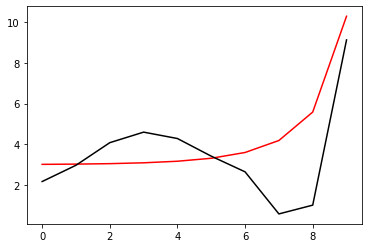

3900 2.080844754624402
[2.18869744 2.93485343 4.03705174 4.58985884 4.31118754 3.4700039
 2.71653925 0.68395737 1.12922379 9.1327456 ]


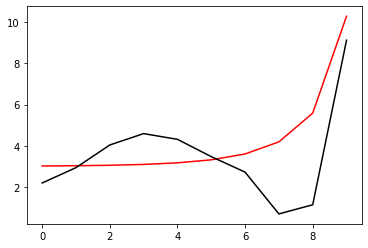

4000 2.055199270200873
[2.2007997  2.90842828 4.00061727 4.5834402  4.33637566 3.5176796
 2.77603068 0.77211727 1.22507863 9.13198196]


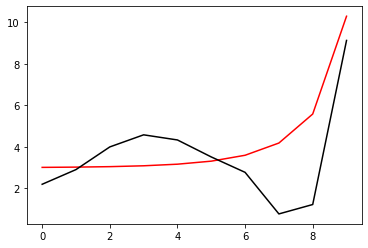

4100 2.031870319547566
[2.20583599 2.88815989 3.97171375 4.5823179  4.36531054 3.56744609
 2.83553838 0.85708406 1.31425921 9.13122717]


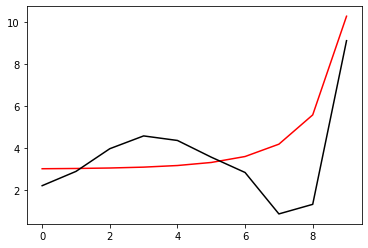

4200 2.0025242849868343
[2.20134932 2.87228706 3.95190543 4.5905433  4.4040749  3.62743419
 2.90516739 0.95233747 1.41123086 9.13048125]


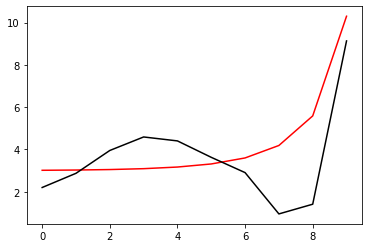

4300 1.9422468474848176
[2.18200947 2.86181605 3.94867416 4.61996455 4.46794543 3.71629151
 3.00660199 1.0850157  1.54342835 9.12974604]


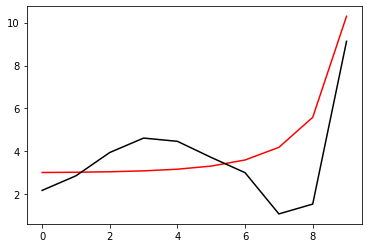

4400 1.042484193179412
[2.24851461 2.95570368 4.05993685 4.76932941 4.66059917 3.94638224
 3.26072029 1.39758926 1.84874066 9.12902885]


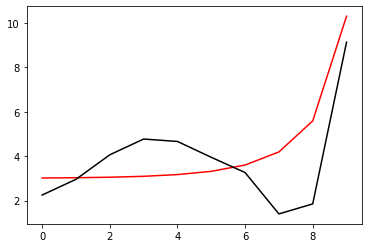

4500 0.16886034229520291
[2.06571474 2.90952681 4.11870653 4.91906255 4.88720363 4.23528846
 3.59375133 1.81408772 2.26880062 9.12835625]


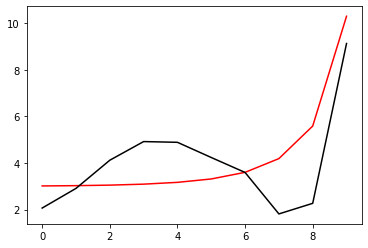

4600 0.12239337677762059
[2.03889764 2.8845616  4.10811405 4.94102006 4.94264347 4.3136613
 3.68233536 1.92709062 2.38123636 9.12770376]


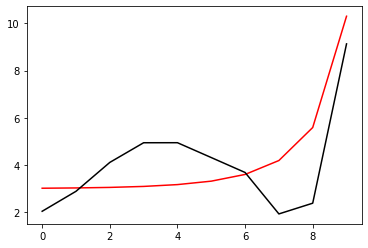

4700 0.10750222660913594
[2.03623531 2.86365495 4.08655671 4.94216097 4.97046346 4.35849368
 3.73236544 1.99272696 2.44594404 9.12705941]


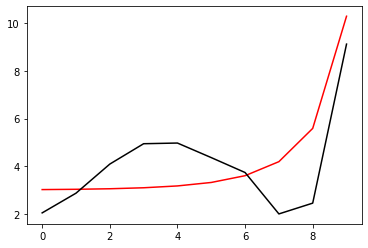

4800 0.09945040061838333
[2.04251035 2.84552462 4.06147083 4.93535791 4.98759404 4.39041795
 3.7676196  2.04021419 2.49237079 9.12642036]


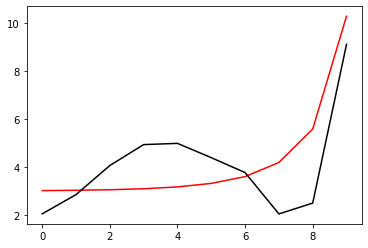

4900 0.09392774204025472
[2.0529811  2.82965064 4.03508121 4.92447097 4.99909357 4.41559063
 3.79518439 2.07824033 2.52926484 9.12578533]


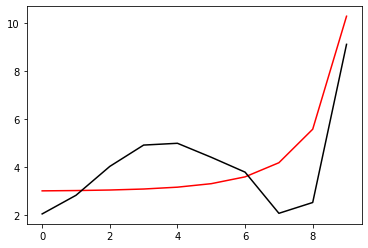

5000 0.08964052296962269
[2.0655969  2.81570337 4.00832372 4.91114493 5.00710718 4.43662113
 3.81806313 2.11048479 2.56033029 9.12515361]


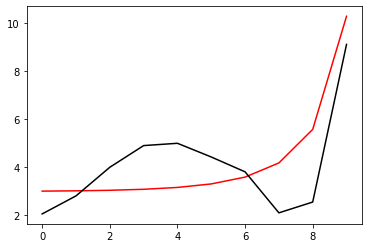

5100 0.08607342342803932
[2.07931551 2.8034353  3.98167038 4.89623002 5.01273496 4.45484608
 3.83779451 2.13883244 2.58746468 9.12452473]


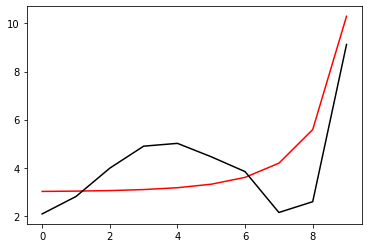

5200 0.08298039745634894
[2.09355487 2.79264494 3.95538568 4.88022412 5.01661383 4.47103768
 3.8552678  2.16437293 2.61176516 9.12389838]


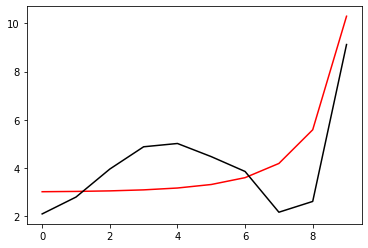

5300 0.08022774599868612
[2.10797039 2.78316157 3.92962688 4.86344545 5.01914515 4.48568091
 3.87104175 2.18779131 2.63392171 9.12327431]


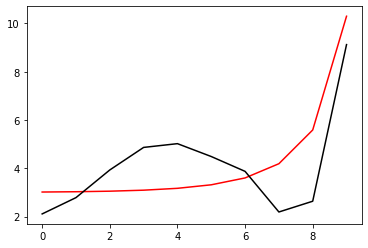

5400 0.07773531294073066
[2.12235086 2.77483749 3.90448995 4.84611104 5.02059824 4.49909963
 3.88548969 2.20954572 2.65439599 9.12265235]


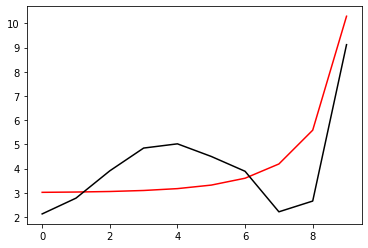

5500 0.07545117235017668
[2.13656447 2.76754352 3.8800331  4.82837653 5.02116288 4.51152053
 3.89887313 2.2299574  2.67351185 9.12203234]


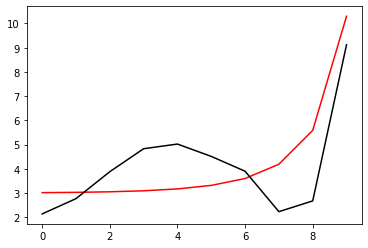

5600 0.07333952718086166
[2.15052886 2.76116601 3.85629    4.81035802 5.02097813 4.52310831
 3.91138216 2.24926025 2.69150525 9.12141418]


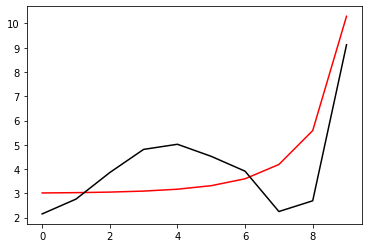

5700 0.07137442302042153
[2.1641934  2.75560464 3.8332777  4.79214485 5.02014924 4.53398634
 3.92315923 2.26762979 2.70855338 9.12079775]


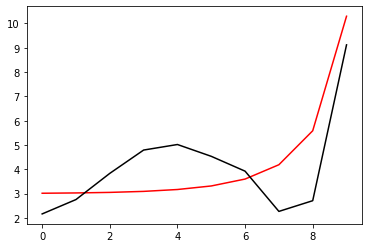

5800 0.06953625279827944
[2.17752834 2.75077065 3.8110017  4.77380758 5.01875812 4.54424932
 3.93431379 2.28520117 2.72479276 9.12018298]


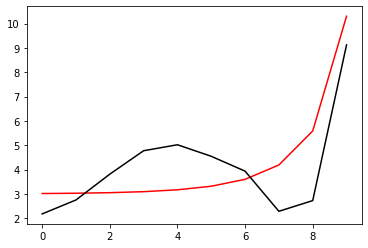

5900 0.06780969913951315
[2.19051785 2.7465854  3.78945925 4.75540306 5.01687    4.55397156
 3.94493171 2.30208065 2.74033084 9.1195698 ]


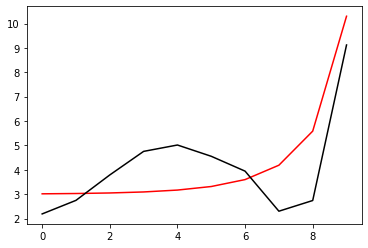

6000 0.06618246242638587
[2.20315547 2.74297921 3.76864174 4.73697785 5.01453794 4.56321243
 3.95508159 2.31835333 2.75525372 9.11895814]


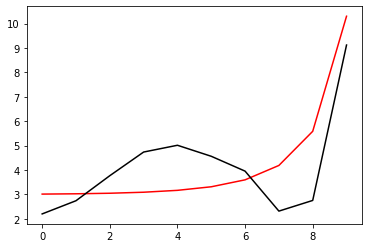

6100 0.06464444054450538
[2.21544111 2.73989021 3.7485363  4.71857061 5.01180587 4.57202011
 3.96481911 2.33408844 2.76963153 9.11834794]


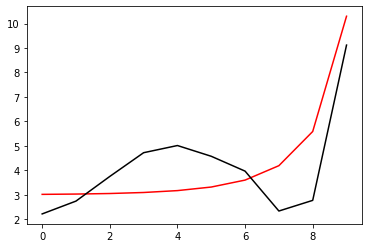

6200 0.063187179942122
[2.2273789  2.73726347 3.72912699 4.70021379 5.00871077 4.58043424
 3.97419005 2.34934308 2.78352215 9.11773915]


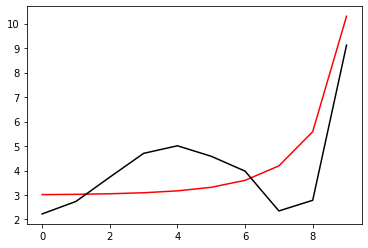

6300 0.06180349606096881
[2.23897584 2.73505021 3.71039576 4.68193479 5.00528422 4.58848787
 3.98323252 2.36416493 2.79697397 9.11713174]


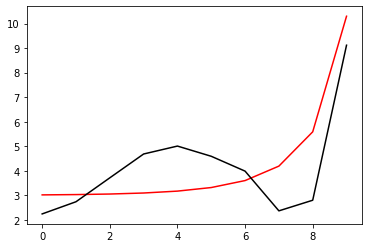

6400 0.06048720317205298
[2.25024076 2.73320703 3.69232306 4.66375695 5.00155355 4.59620885
 3.99197858 2.37859424 2.81002786 9.11652566]


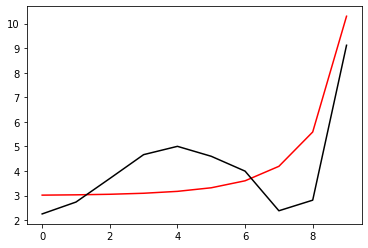

6500 0.05923291706779814
[2.26118361 2.73169531 3.67488838 4.64570022 4.99754267 4.60362088
 4.00045545 2.39266531 2.82271869 9.11592087]


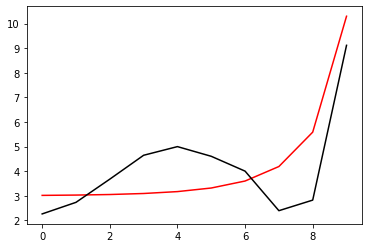

6600 0.05803590761628831
[2.27181501 2.73048069 3.65807066 4.62778165 4.99327274 4.61074431
 4.00868646 2.40640761 2.83507646 9.11531734]


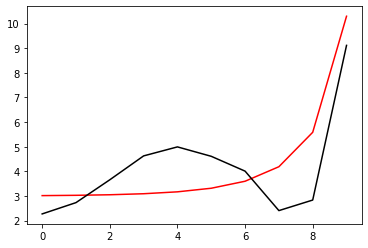

6700 0.056891986291935544
[2.28214588 2.72953252 3.64184857 4.61001592 4.98876265 4.6175968
 4.01669172 2.4198467  2.84712719 9.11471504]


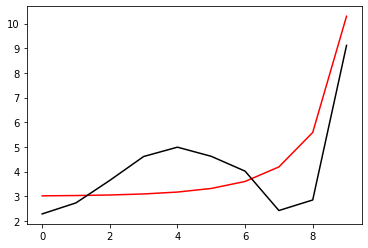

6800 0.05579741879526478
[2.29218719 2.72882346 3.62620076 4.59241557 4.98402939 4.62419375
 4.02448874 2.43300488 2.85889362 9.11411394]


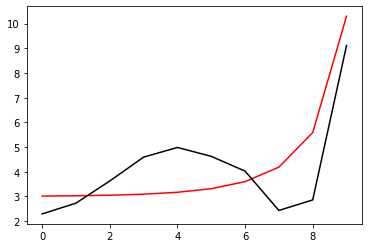

6900 0.054748856037320597
[2.30194982 2.72832913 3.61110604 4.57499136 4.97908841 4.6305487
 4.03209281 2.44590174 2.87039575 9.11351402]


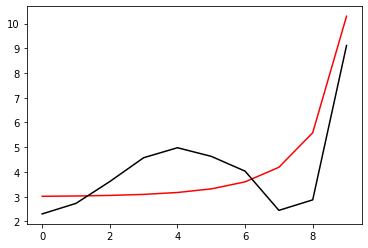

7000 0.05374327881773832
[2.31144442 2.7280277  3.59654352 4.55775247 4.97395378 4.63667366
 4.0395174  2.45855459 2.88165125 9.11291524]


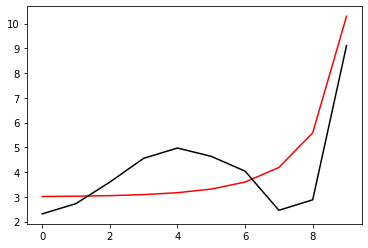

7100 0.05277795288733497
[2.32068133 2.72789969 3.58249275 4.54070668 4.96863847 4.64257931
 4.04677441 2.47097883 2.89267587 9.11231759]


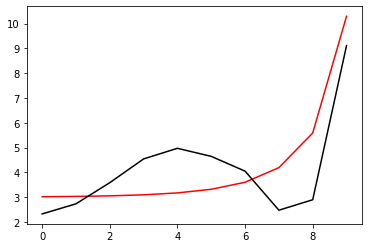

7200 0.05185039200801494
[2.32967055 2.72792762 3.56893373 4.52386056 4.96315442 4.64827526
 4.05387444 2.48318821 2.90348367 9.11172105]


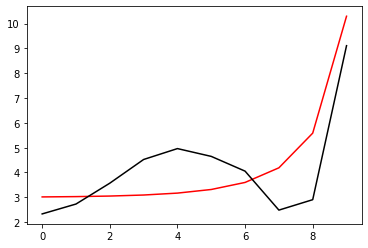

7300 0.05095832725994167
[2.33842173 2.72809583 3.55584703 4.50721961 4.95751273 4.65377014
 4.06082693 2.49519506 2.91408729 9.1111256 ]


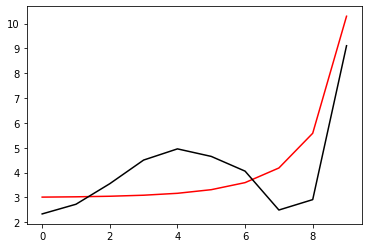

7400 0.05009968129227338
[2.3469441  2.72839029 3.5432138  4.49078833 4.95172375 4.6590718
 4.06764037 2.50701051 2.92449814 9.1105312 ]


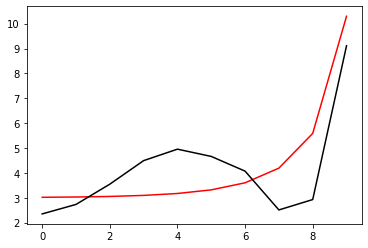

7500 0.04927254653314228
[2.3552465  2.72879837 3.53101584 4.47457039 4.94579714 4.66418737
 4.0743224  2.51864464 2.93472654 9.10993786]


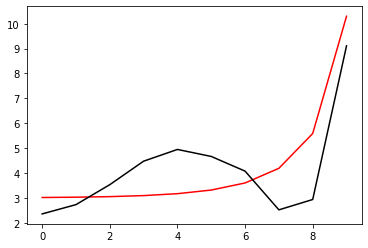

7600 0.04847516660521347
[2.36333739 2.72930871 3.51923554 4.4585687  4.93974199 4.66912339
 4.08087991 2.53010659 2.94478191 9.10934555]


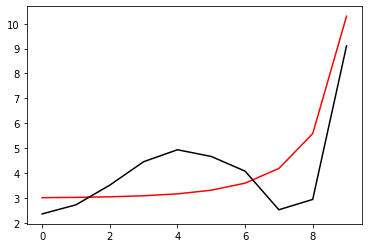

7700 0.04770592036273366
[2.37122484 2.72991112 3.50785598 4.44278546 4.93356683 4.67388589
 4.08731916 2.54140473 2.9546728  9.10875425]


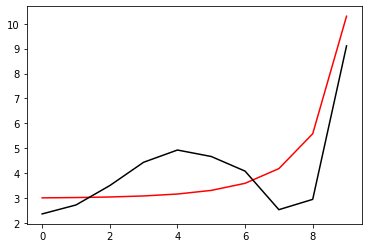

7800 0.04696330809277269
[2.37891654 2.73059637 3.49686087 4.42722228 4.92727971 4.67848041
 4.09364584 2.55254668 2.96440709 9.10816395]


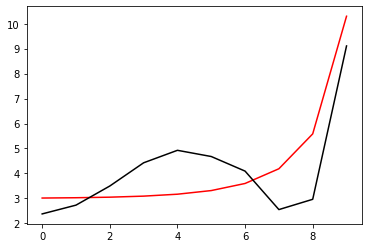

7900 0.046245939517395515
[2.38641984 2.73135617 3.48623454 4.4118802  4.92088826 4.68291211
 4.09986516 2.56353946 2.97399199 9.10757463]


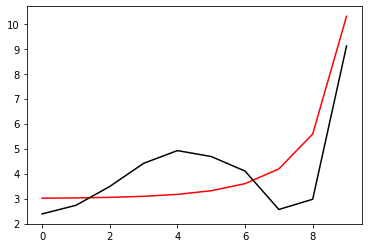

8000 0.045552523307147944
[2.39374173 2.732183   3.475962   4.39675979 4.91439967 4.68718579
 4.10598186 2.57438953 2.98343415 9.10698629]


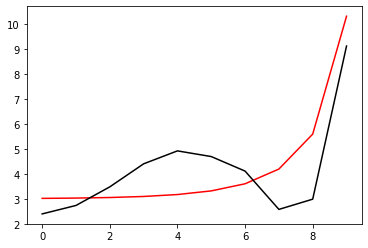

8100 0.044881857870922276
[2.40088887 2.73307009 3.46602884 4.38186115 4.90782078 4.69130593
 4.11200031 2.58510286 2.99273971 9.1063989 ]


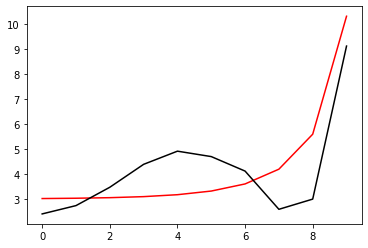

8200 0.04423282323137864
[2.40786762 2.73401128 3.45642128 4.36718401 4.9011581  4.69527674
 4.11792453 2.59568495 3.00191437 9.10581245]


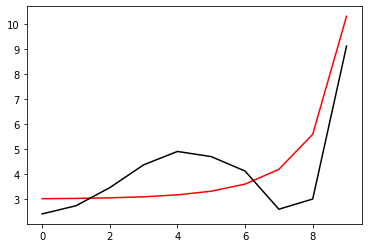

8300 0.043604373828940515
[2.41468402 2.73500102 3.44712612 4.35272773 4.8944178  4.69910219
 4.12375821 2.60614095 3.01096341 9.10522694]


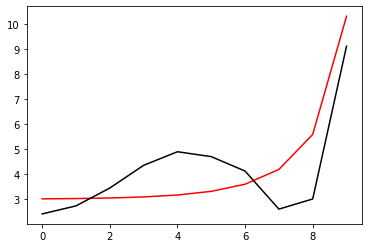

8400 0.04299553212444604
[2.42134386 2.73603426 3.43813075 4.33849137 4.88760576 4.70278601
 4.12950479 2.6164756  3.01989174 9.10464234]


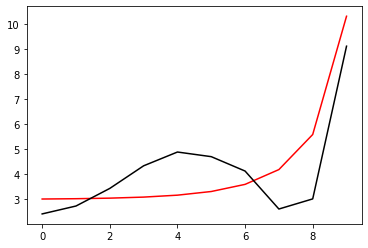

8500 0.04240538289221889
[2.42785262 2.73710642 3.42942308 4.32447369 4.88072758 4.70633174
 4.13516743 2.62669335 3.02870397 9.10405865]


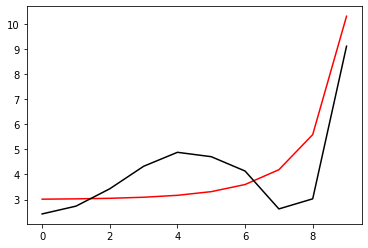

8600 0.0418330681127702
[2.43421556 2.73821332 3.42099159 4.31067321 4.87378861 4.70974275
 4.14074907 2.63679835 3.03740437 9.10347586]


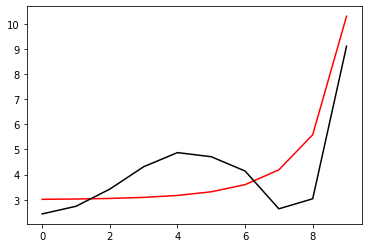

8700 0.0412777823883491
[2.44043769 2.73935119 3.41282525 4.29708823 4.86679395 4.71302224
 4.14625245 2.64679449 3.04599697 9.10289395]


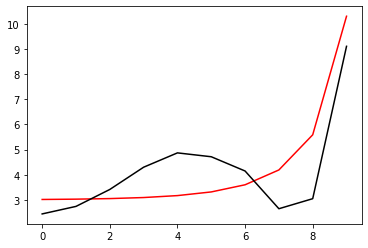

8800 0.04073876881664713
[2.44652378 2.74051657 3.40491353 4.28371685 4.85974845 4.71617326
 4.15168013 2.65668541 3.05448554 9.10231292]


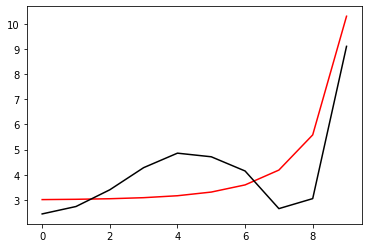

8900 0.040215315266788655
[2.4524784  2.74170632 3.39724636 4.27055698 4.85265678 4.71919873
 4.15703447 2.66647453 3.06287362 9.10173276]


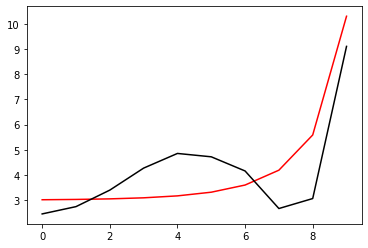

9000 0.03970675101032908
[2.4583059  2.74291757 3.38981414 4.25760641 4.84552336 4.72210147
 4.16231772 2.67616507 3.07116454 9.10115345]


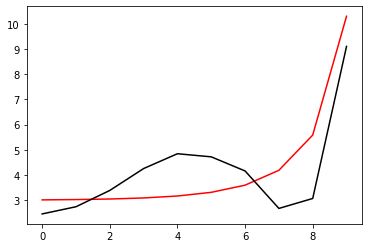

9100 0.03921244366641975
[2.46401046 2.74414771 3.38260771 4.24486277 4.83835244 4.72488417
 4.16753195 2.68576008 3.07936146 9.10057499]


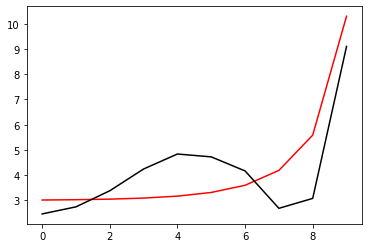

9200 0.0387317964254667
[2.46959605 2.74539434 3.37561828 4.23232359 4.83114807 4.72754942
 4.17267911 2.69526241 3.08746735 9.09999736]


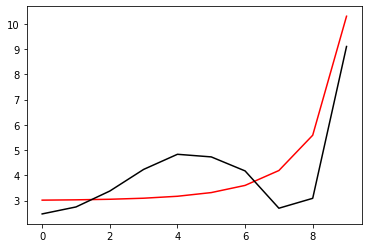

9300 0.03826424552101479
[2.47506649 2.7466553  3.36883751 4.21998629 4.82391412 4.73009972
 4.17776106 2.70467479 3.09548501 9.09942057]


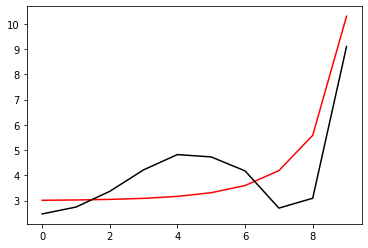

9400 0.037809257922814275
[2.48042543 2.74792857 3.36225739 4.20784821 4.81665431 4.73253748
 4.18277952 2.71399977 3.10341712 9.0988446 ]


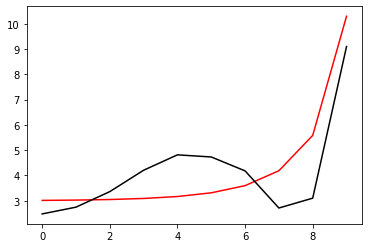

9500 0.03736632922794018
[2.48567635 2.74921234 3.35587031 4.19590661 4.80937217 4.73486506
 4.18773611 2.72323979 3.1112662  9.09826944]


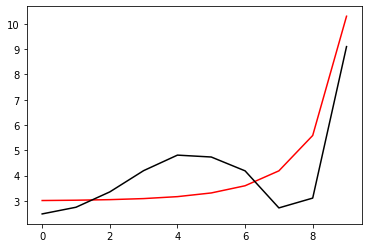

9600 0.03693498172940575
[2.4908226  2.75050494 3.34966896 4.18415872 4.80207107 4.73708471
 4.19263237 2.73239716 3.11903464 9.09769508]


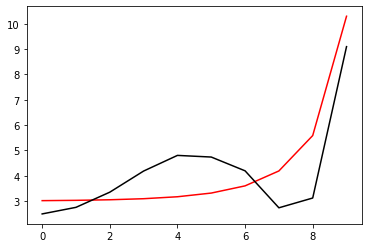

9700 0.03651476264460872
[2.49586739 2.75180483 3.3436464  4.17260168 4.79475426 4.73919863
 4.19746977 2.74147408 3.12672474 9.09712153]


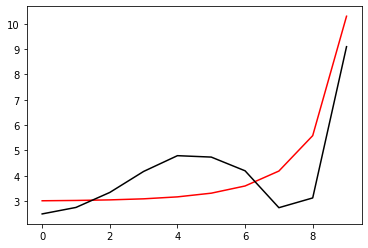

9800 0.0361052424871329
[2.50081379 2.75311061 3.33779596 4.16123262 4.78742482 4.74120896
 4.20224966 2.75047263 3.13433865 9.09654876]


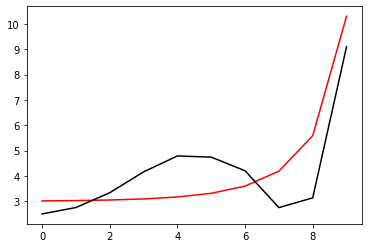

9900 0.03570601356867496
[2.50566474 2.754421   3.3321113  4.15004863 4.78008571 4.74311777
 4.20697335 2.75939481 3.14187846 9.09597677]


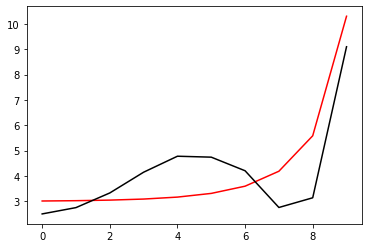

10000 0.03531668861818339
[2.51042307 2.75573483 3.32658634 4.13904678 4.77273974 4.7449271
 4.21164208 2.76824252 3.14934613 9.09540556]


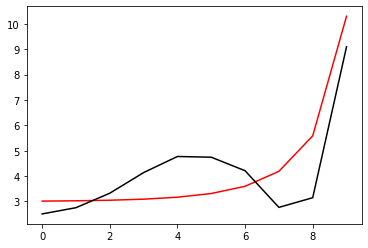

In [29]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.03493689950747077
[2.5150915  2.75705101 3.32121527 4.12822414 4.7653896  4.7466389
 4.21625702 2.77701756 3.15674354 9.09483512]


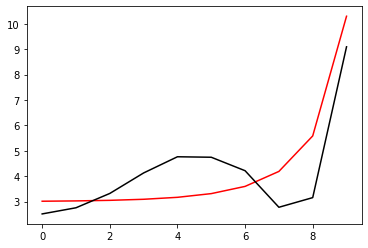

200 0.034566296073210906
[2.51967263 2.75836856 3.31599255 4.11757775 4.75803787 4.74825511
 4.22081927 2.78572167 3.16407251 9.09426544]


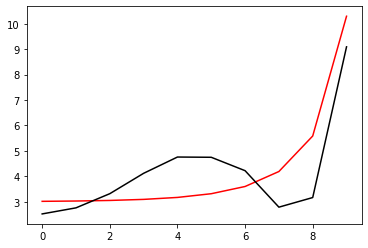

300 0.03420454502708745
[2.52416897 2.75968657 3.31091285 4.10710467 4.750687   4.7497776
 4.22532991 2.7943565  3.17133476 9.09369651]


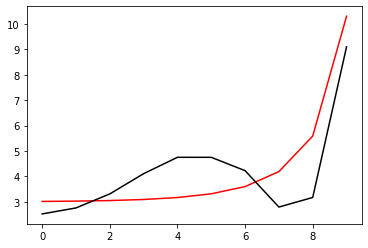

400 0.03385132894572891
[2.52858292 2.76100421 3.30597111 4.09680194 4.74333932 4.75120821
 4.22978993 2.80292365 3.17853193 9.09312833]


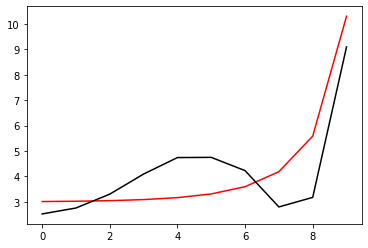

500 0.03350634533375186
[2.5329168  2.76232072 3.30116247 4.08666665 4.73599706 4.75254872
 4.2342003  2.81142462 3.1856656  9.0925609 ]


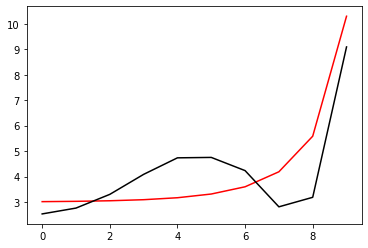

600 0.033169305753538186
[2.53717283 2.76363541 3.29648227 4.07669585 4.72866237 4.7538009
 4.23856194 2.81986088 3.19273731 9.0919942 ]


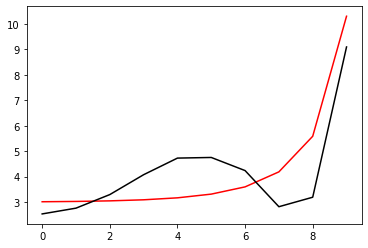

700 0.032839935016263734
[2.54135316 2.76494763 3.29192606 4.06688665 4.72133725 4.75496647
 4.24287573 2.82823383 3.1997485  9.09142823]


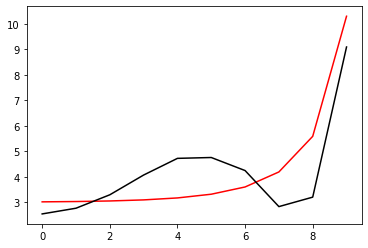

800 0.03251797042879348
[2.54545984 2.7662568  3.28748958 4.05723618 4.71402364 4.7560471
 4.24714249 2.8365448  3.20670057 9.09086299]


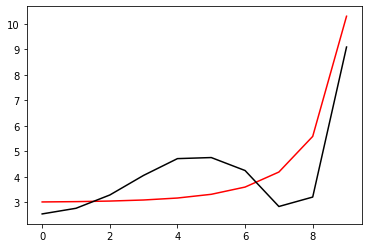

900 0.03220316109202473
[2.54949487 2.7675624  3.28316875 4.04774157 4.70672339 4.75704445
 4.25136305 2.84479509 3.21359486 9.09029846]


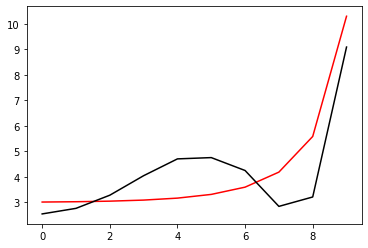

1000 0.03189526724654815
[2.55346015 2.76886392 3.27895965 4.03839999 4.69943823 4.75796013
 4.25553815 2.85298595 3.22043268 9.08973465]


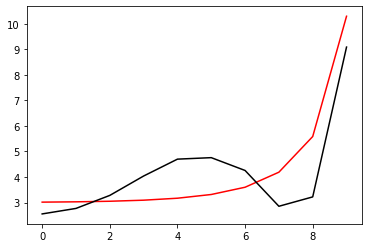

1100 0.03159405966201442
[2.55735753 2.77016092 3.27485853 4.02920866 4.69216983 4.75879573
 4.25966856 2.86111855 3.22721527 9.08917155]


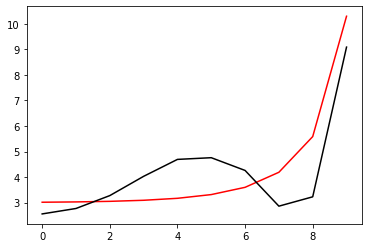

1200 0.031299319066173725
[2.56118879 2.77145301 3.2708618  4.02016479 4.68491977 4.75955281
 4.26375496 2.86919406 3.23394383 9.08860915]


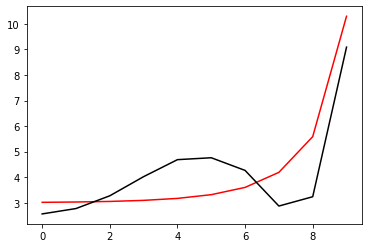

1300 0.0310108356113312
[2.56495563 2.77273979 3.26696602 4.01126566 4.67768955 4.76023289
 4.26779804 2.87721359 3.24061952 9.08804744]


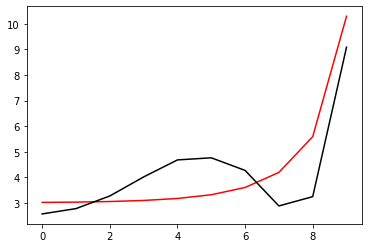

1400 0.030728408374847922
[2.56865972 2.77402095 3.26316787 4.00250857 4.67048059 4.76083748
 4.27179846 2.8851782  3.24724345 9.08748643]


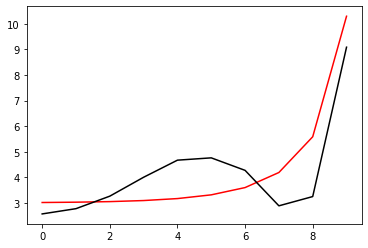

1500 0.030451844891339647
[2.57230264 2.77529616 3.25946418 3.99389087 4.66329425 4.76136805
 4.27575685 2.89308893 3.2538167  9.08692611]


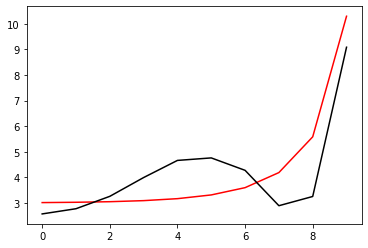

1600 0.030180960713898503
[2.57588594 2.77656515 3.25585191 3.98540992 4.6561318  4.76182605
 4.2796738  2.90094677 3.26034031 9.08636647]


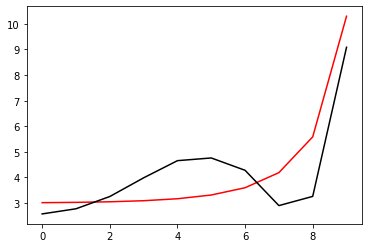

1700 0.02991557900279413
[2.5794111  2.77782768 3.25232813 3.97706316 4.64899446 4.76221289
 4.28354992 2.90875268 3.26681529 9.0858075 ]


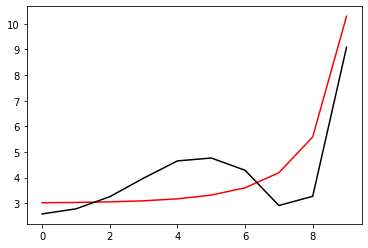

1800 0.029655530139214625
[2.58287956 2.7790835  3.24889003 3.96884803 4.64188338 4.76252999
 4.28738575 2.9165076  3.27324261 9.08524921]


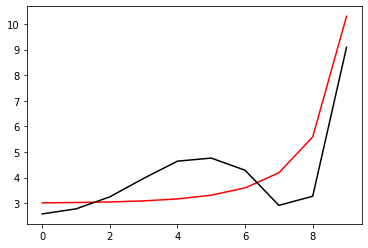

1900 0.029400651362261068
[2.58629271 2.78033242 3.24553493 3.96076204 4.63479963 4.7627787
 4.29118184 2.92421243 3.2796232  9.08469159]


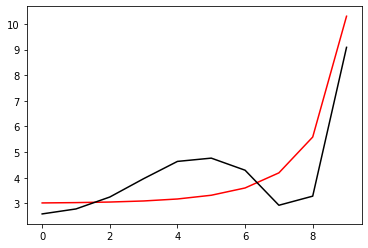

2000 0.029150786427852366
[2.58965188 2.78157424 3.24226022 3.95280273 4.62774424 4.76296039
 4.29493873 2.93186804 3.28595799 9.08413463]


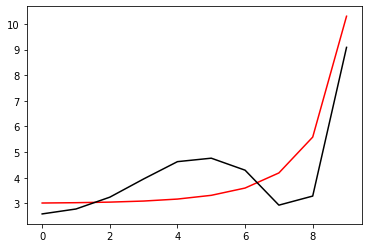

2100 0.028905785287729264
[2.59295839 2.78280881 3.23906341 3.94496768 4.62071818 4.76307639
 4.29865691 2.93947526 3.29224784 9.08357833]


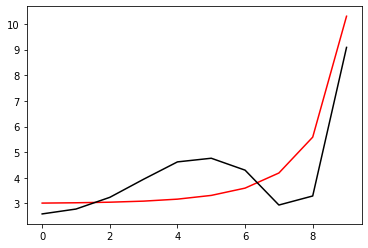

2200 0.028665503787350884
[2.59621347 2.78403597 3.23594211 3.93725451 4.61372235 4.763128
 4.30233689 2.94703492 3.29849362 9.08302269]


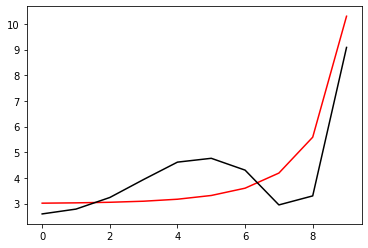

2300 0.028429803381250333
[2.59941835 2.7852556  3.23289402 3.9296609  4.60675761 4.7631165
 4.30597913 2.95454781 3.30469614 9.0824677 ]


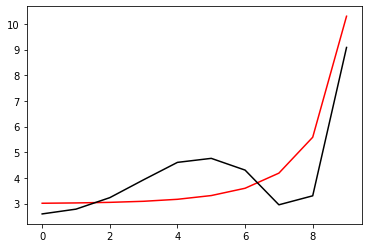

2400 0.028198550864813217
[2.6025742  2.78646757 3.22991691 3.92218455 4.59982477 4.76304317
 4.3095841  2.96201468 3.31085622 9.08191335]


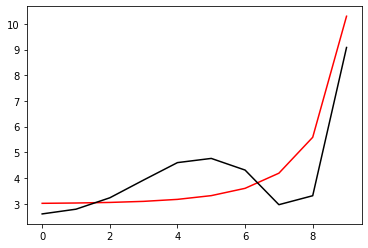

2500 0.027971618121314854
[2.60568216 2.78767179 3.22700865 3.9148232  4.59292458 4.76290925
 4.31315225 2.9694363  3.31697462 9.08135964]


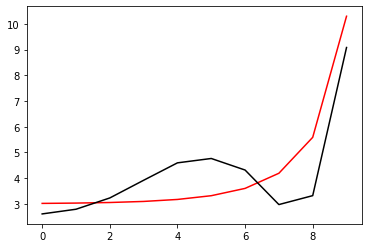

2600 0.027748881883137348
[2.60874332 2.78886815 3.22416719 3.90757467 4.58605774 4.76271595
 4.31668402 2.97681337 3.32305211 9.08080658]


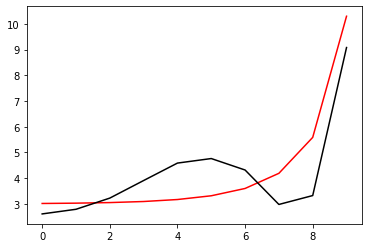

2700 0.027530223506416682
[2.61175876 2.7900566  3.22139055 3.90043677 4.57922493 4.76246449
 4.32017981 2.9841466  3.3290894  9.08025415]


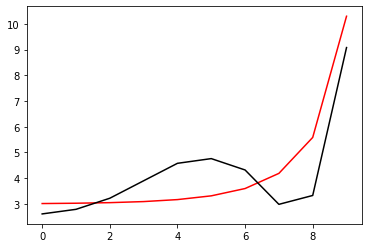

2800 0.027315528758077322
[2.6147295  2.79123705 3.21867683 3.89340739 4.57242676 4.76215606
 4.32364006 2.99143667 3.33508723 9.07970235]


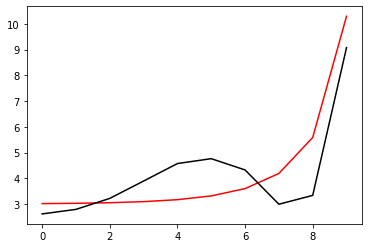

2900 0.027104687614551093
[2.61765656 2.79240946 3.21602418 3.88648445 4.5656638  4.76179181
 4.32706515 2.99868423 3.34104627 9.07915117]


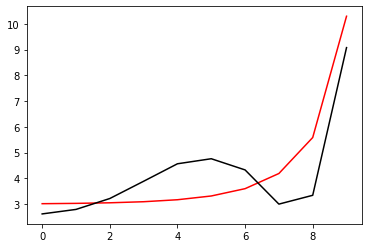

3000 0.02689759407142228
[2.62054088 2.79357378 3.21343085 3.8796659  4.55893659 4.7613729
 4.33045547 3.00588993 3.34696719 9.07860062]


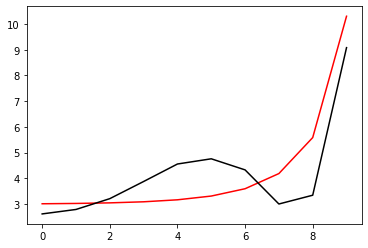

3100 0.02669414596332509
[2.62338343 2.79472997 3.21089512 3.87294974 4.55224562 4.76090045
 4.33381141 3.01305439 3.35285066 9.07805069]


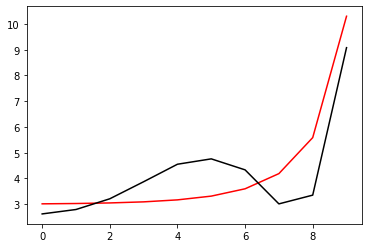

3200 0.026494244793418487
[2.62618511 2.795878   3.20841536 3.86633402 4.54559137 4.76037559
 4.33713333 3.02017822 3.35869729 9.07750138]


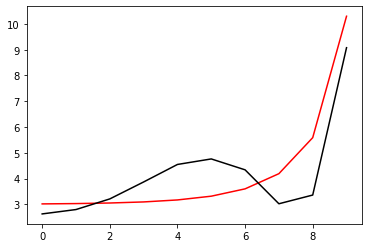

3300 0.026297795571843446
[2.62894681 2.79701785 3.20598996 3.85981681 4.53897425 4.75979939
 4.34042159 3.02726201 3.36450772 9.07695268]


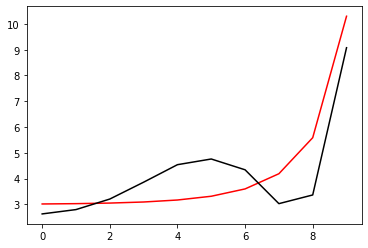

3400 0.0261047066627095
[2.63166938 2.79814951 3.20361742 3.85339624 4.53239465 4.75917295
 4.34367654 3.03430633 3.37028254 9.07640458]


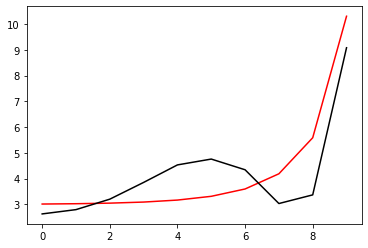

3500 0.025914889638911063
[2.63435366 2.79927296 3.20129624 3.84707046 4.52585293 4.75849732
 4.34689852 3.04131174 3.37602234 9.07585709]


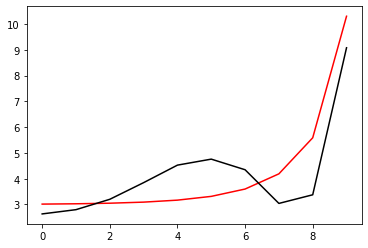

3600 0.025728259144578044
[2.63700045 2.80038821 3.199025   3.84083766 4.51934942 4.75777354
 4.35008788 3.04827878 3.38172768 9.07531021]


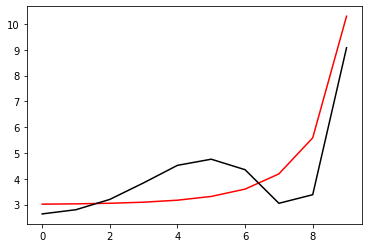

3700 0.025544732764335994
[2.63961055 2.80149525 3.19680233 3.83469609 4.51288442 4.75700265
 4.35324493 3.05520799 3.38739912 9.07476392]


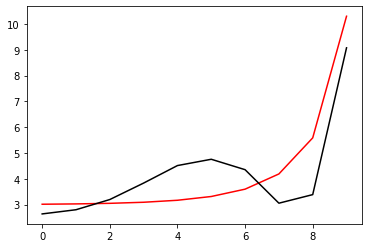

3800 0.025364230899326837
[2.64218472 2.8025941  3.1946269  3.82864401 4.50645819 4.75618564
 4.35637    3.06209988 3.3930372  9.07421823]


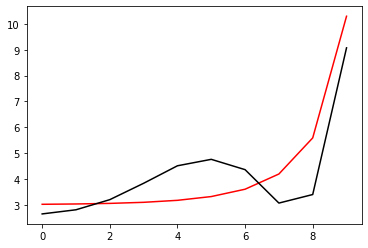

3900 0.02518667664940822
[2.64472369 2.80368477 3.19249742 3.82267972 4.50007098 4.75532353
 4.3594634  3.06895494 3.39864245 9.07367312]


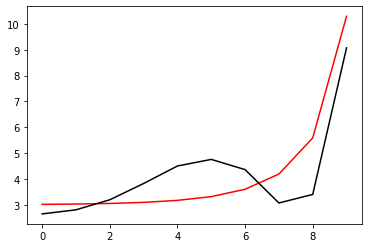

4000 0.025011995701166155
[2.64722819 2.80476728 3.19041266 3.81680158 4.49372299 4.75441728
 4.36252544 3.07577368 3.40421538 9.07312861]


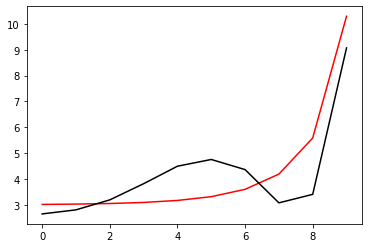

4100 0.024840116221455683
[2.64969891 2.80584165 3.1883714  3.81100796 4.48741443 4.75346785
 4.36555641 3.08255657 3.40975649 9.07258469]


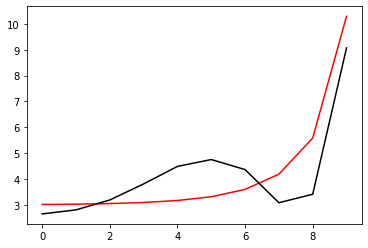

4200 0.024670968756244895
[2.65213654 2.8069079  3.18637251 3.80529727 4.48114545 4.75247621
 4.36855661 3.08930408 3.41526627 9.07204134]


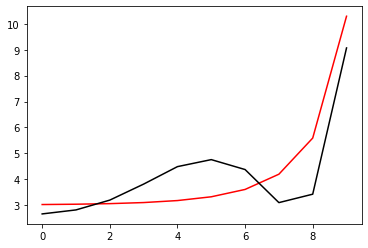

4300 0.024504486134182286
[2.65454174 2.80796606 3.18441485 3.79966797 4.4749162  4.75144327
 4.37152634 3.09601665 3.42074519 9.07149858]


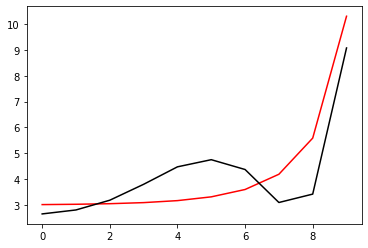

4400 0.024340603375018442
[2.65691515 2.80901616 3.18249734 3.79411852 4.4687268  4.75036997
 4.37446586 3.10269475 3.42619373 9.07095639]


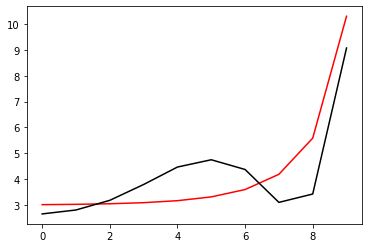

4500 0.024179257602115443
[2.65925739 2.81005825 3.18061893 3.78864744 4.46257735 4.74925719
 4.37737547 3.10933879 3.43161233 9.07041478]


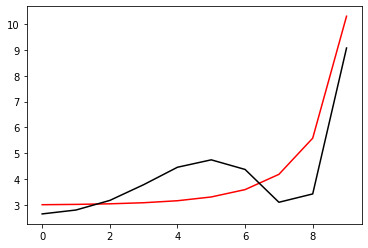

4600 0.024020387959397246
[2.66156908 2.81109234 3.17877861 3.78325328 4.45646793 4.74810584
 4.38025543 3.1159492  3.43700143 9.06987373]


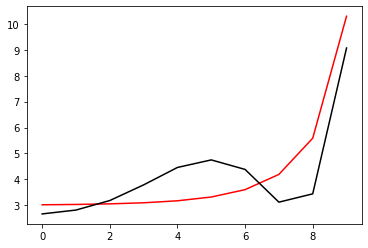

4700 0.02386393553197985
[2.66385081 2.81211849 3.1769754  3.77793461 4.4503986  4.74691678
 4.38310602 3.12252639 3.44236148 9.06933326]


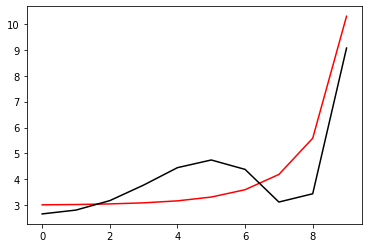

4800 0.023709843270517082
[2.66610314 2.81313674 3.17520834 3.77269004 4.4443694  4.74569088
 4.38592749 3.12907078 3.44769289 9.06879335]


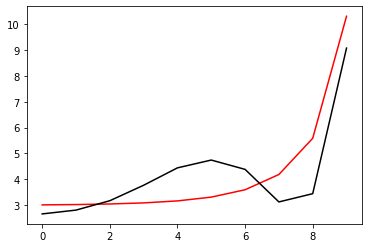

4900 0.023558055919200783
[2.66832665 2.81414712 3.17347653 3.7675182  4.43838037 4.74442899
 4.3887201  3.13558275 3.45299608 9.068254  ]


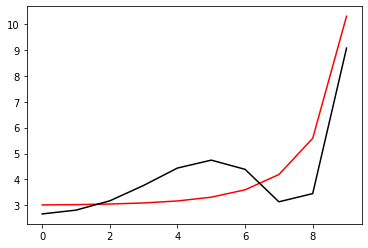

5000 0.023408519946879557
[2.67052188 2.81514968 3.17177905 3.76241777 4.4324315  4.74313193
 4.39148412 3.14206269 3.45827145 9.06771521]


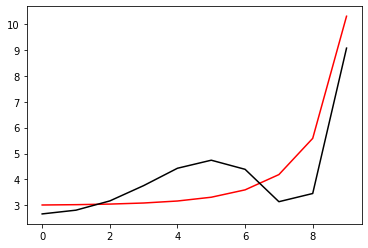

5100 0.023261183481319538
[2.67268935 2.81614447 3.17011506 3.75738744 4.4265228  4.74180053
 4.39421979 3.14851097 3.46351939 9.06717698]


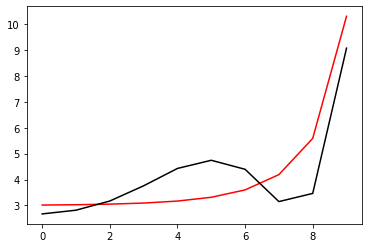

5200 0.023115996246542096
[2.67482959 2.81713155 3.16848371 3.75242592 4.42065424 4.74043559
 4.39692736 3.15492796 3.4687403  9.0666393 ]


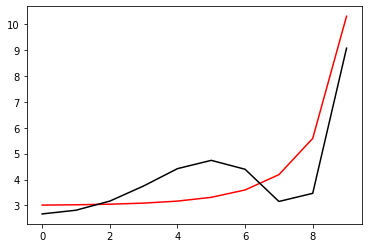

5300 0.022972909502844883
[2.6769431  2.81811094 3.1668842  3.74753198 4.41482579 4.73903791
 4.39960707 3.16131403 3.47393454 9.06610218]


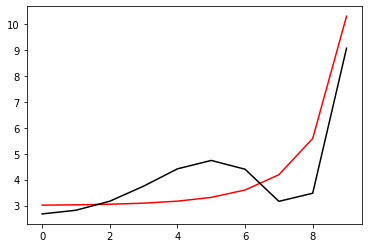

5400 0.02283187598959759
[2.67903037 2.81908272 3.16531574 3.74270439 4.4090374  4.73760827
 4.40225917 3.16766953 3.47910249 9.0655656 ]


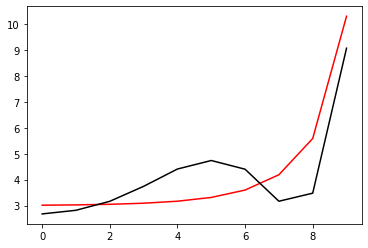

5500 0.022692849870465874
[2.68109188 2.82004692 3.16377758 3.73794195 4.403289   4.73614743
 4.40488388 3.1739948  3.48424451 9.06502957]


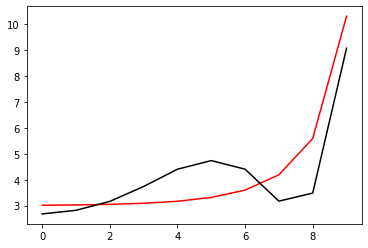

5600 0.022555786680999067
[2.6831281  2.8210036  3.16226896 3.7332435  4.39758053 4.73465615
 4.40748145 3.18029017 3.48936095 9.06449409]


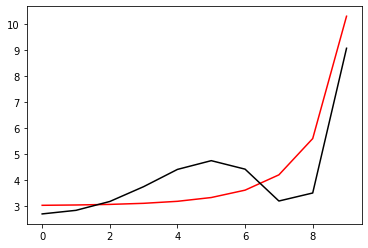

5700 0.022420643278657483
[2.68513947 2.82195282 3.16078918 3.7286079  4.3919119  4.73313518
 4.4100521  3.18655599 3.49445215 9.06395914]


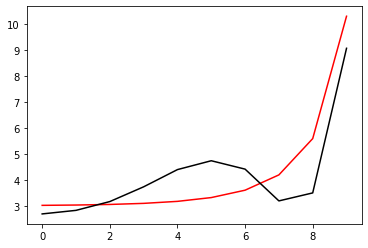

5800 0.022287377794767402
[2.68712645 2.82289463 3.15933755 3.72403401 4.386283   4.73158523
 4.41259606 3.19279257 3.49951847 9.06342473]


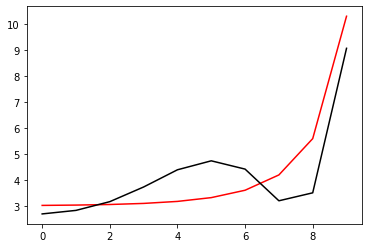

5900 0.022155949588728345
[2.68908946 2.82382907 3.15791338 3.71952075 4.38069374 4.73000704
 4.41511355 3.19900023 3.50456022 9.06289086]


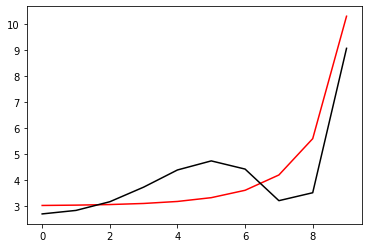

6000 0.02202631920402745
[2.69102892 2.82475622 3.15651603 3.71506705 4.375144   4.72840131
 4.4176048  3.20517928 3.50957774 9.06235753]


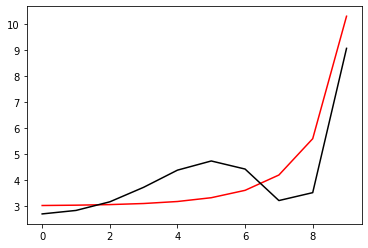

6100 0.02189844832620881
[2.69294526 2.82567612 3.15514486 3.71067186 4.36963365 4.72676873
 4.42007003 3.21133002 3.51457134 9.06182472]


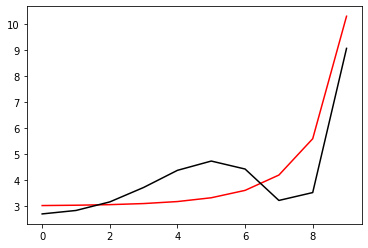

6200 0.02177229974239081
[2.69483885 2.82658883 3.15379926 3.70633415 4.36416256 4.72510999
 4.42250945 3.21745276 3.51954132 9.06129245]


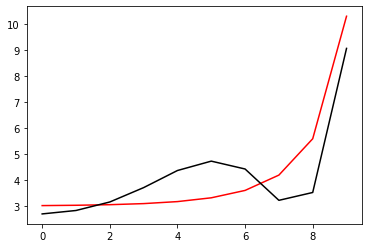

6300 0.021647837302841016
[2.6967101  2.8274944  3.15247863 3.70205291 4.35873059 4.72342576
 4.42492327 3.22354778 3.52448801 9.0607607 ]


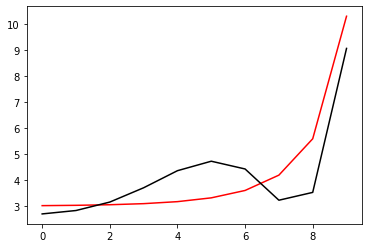

6400 0.021525025883754406
[2.69855939 2.82839289 3.15118239 3.69782718 4.35333757 4.72171669
 4.4273117  3.22961536 3.52941169 9.06022948]


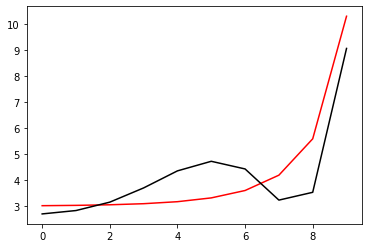

6500 0.02140383135172034
[2.70038709 2.82928436 3.14990998 3.69365598 4.34798337 4.71998344
 4.42967496 3.2356558  3.53431266 9.05969878]


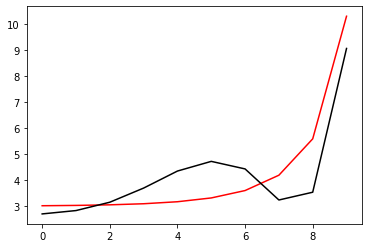

6600 0.021284220529659954
[2.70219356 2.83016886 3.14866085 3.68953837 4.3426678  4.71822665
 4.43201325 3.24166936 3.53919121 9.0591686 ]


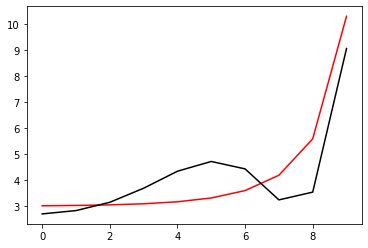

6700 0.021166161164065427
[2.70397916 2.83104646 3.14743446 3.68547345 4.33739071 4.71644694
 4.43432678 3.24765632 3.54404762 9.05863894]


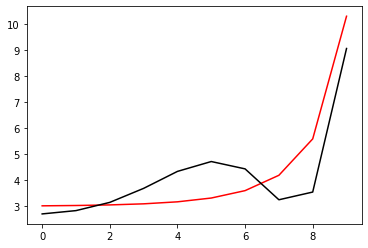

6800 0.021049621893596174
[2.70574423 2.8319172  3.14623031 3.68146029 4.3321519  4.71464493
 4.43661574 3.25361694 3.54888216 9.05810979]


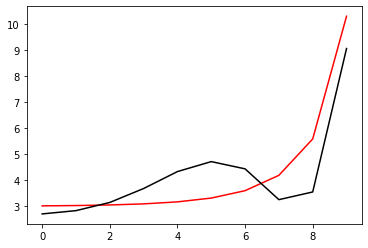

6900 0.02093457221889857
[2.7074891  2.83278114 3.14504789 3.67749803 4.32695121 4.71282123
 4.43888034 3.25955147 3.55369511 9.05758116]


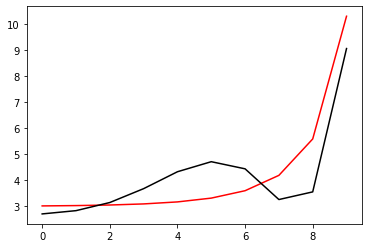

7000 0.020820982473672405
[2.70921412 2.83363835 3.14388672 3.6735858  4.32178843 4.71097644
 4.44112077 3.26546018 3.55848673 9.05705304]


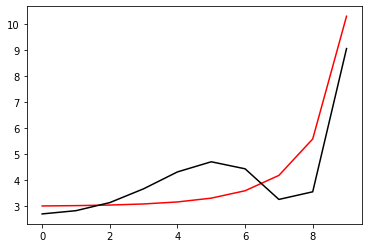

7100 0.0207088237968
[2.7109196  2.83448887 3.14274631 3.66972276 4.31666338 4.70911113
 4.44333724 3.27134331 3.56325729 9.05652543]


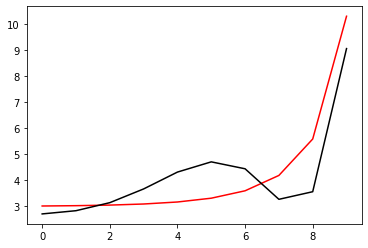

7200 0.020598068105525186
[2.71260585 2.83533277 3.14162622 3.66590808 4.31157586 4.70722588
 4.44552993 3.2772011  3.56800703 9.05599833]


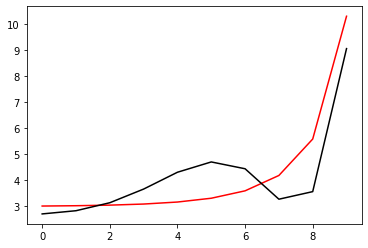

7300 0.020488688069857566
[2.71427319 2.83617009 3.14052598 3.66214095 4.30652566 4.70532127
 4.44769904 3.28303381 3.57273621 9.05547173]


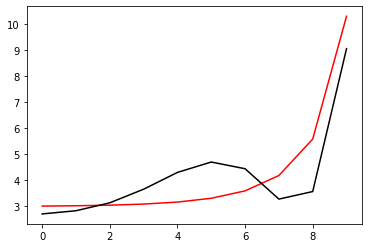

7400 0.020380657087775762
[2.71592191 2.8370009  3.13944517 3.65842058 4.30151258 4.70339785
 4.44984476 3.28884166 3.57744507 9.05494564]


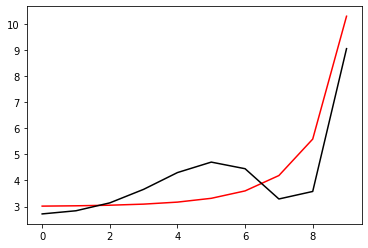

7500 0.020273949261461904
[2.7175523  2.83782524 3.13838337 3.65474619 4.2965364  4.70145615
 4.45196728 3.29462489 3.58213387 9.05442004]


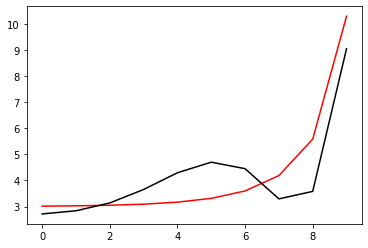

7600 0.020168539374436148
[2.71916466 2.83864318 3.13734015 3.65111703 4.29159692 4.69949673
 4.45406678 3.30038372 3.58680282 9.05389495]


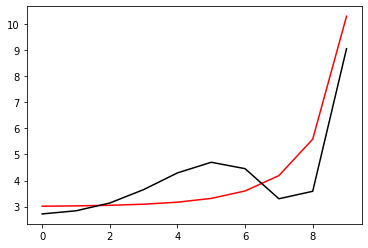

7700 0.02006440286952734
[2.72075926 2.83945478 3.13631512 3.64753234 4.28669391 4.69752011
 4.45614345 3.30611837 3.59145218 9.05337036]


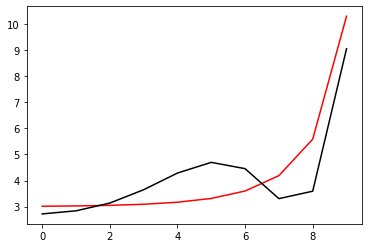

7800 0.019961515827670855
[2.72233638 2.84026007 3.13530789 3.64399142 4.28182715 4.6955268
 4.45819748 3.31182908 3.59608216 9.05284626]


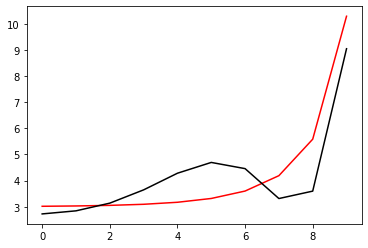

7900 0.01985985494758285
[2.72389628 2.84105913 3.13431808 3.64049353 4.27699643 4.69351732
 4.46022905 3.31751605 3.60069299 9.05232265]


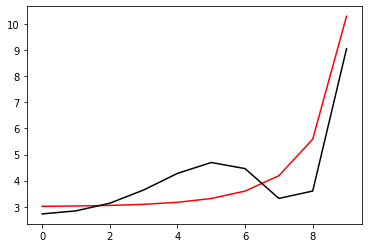

8000 0.01975939752603218
[2.72543923 2.84185199 3.13334532 3.63703799 4.27220151 4.69149216
 4.46223833 3.3231795  3.6052849  9.05179954]


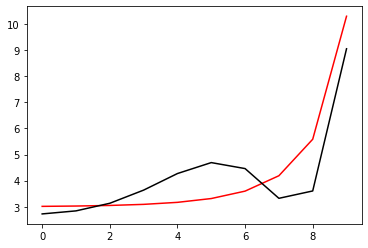

8100 0.019660121438981115
[2.72696548 2.84263873 3.13238925 3.6336241  4.26744216 4.68945182
 4.46422551 3.32881963 3.60985809 9.05127692]


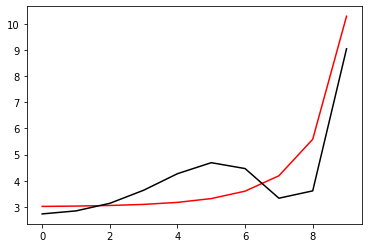

8200 0.019562005123380157
[2.72847528 2.84341938 3.13144951 3.63025121 4.26271817 4.68739678
 4.46619077 3.33443665 3.61441279 9.05075478]


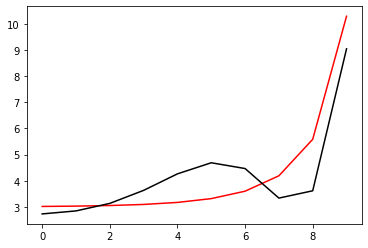

8300 0.019465027559561945
[2.72996887 2.844194   3.13052578 3.62691866 4.25802929 4.68532752
 4.46813428 3.34003076 3.61894919 9.05023313]


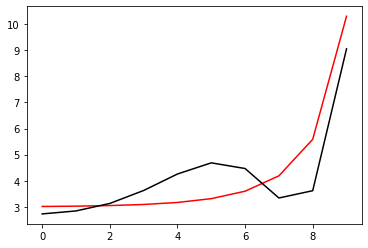

8400 0.019369168254359526
[2.73144651 2.84496265 3.12961771 3.62362579 4.25337529 4.6832445
 4.47005622 3.34560216 3.62346752 9.04971197]


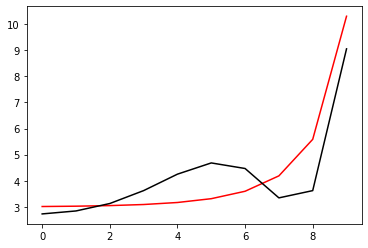

8500 0.019274407224767982
[2.73290841 2.84572538 3.12872498 3.62037199 4.24875593 4.68114817
 4.47195676 3.35115104 3.62796796 9.04919129]


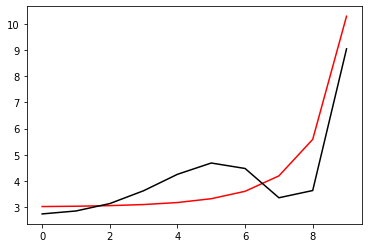

8600 0.019180724982273085
[2.73435482 2.84648223 3.12784728 3.61715664 4.24417099 4.67903899
 4.47383608 3.3566776  3.63245072 9.04867109]


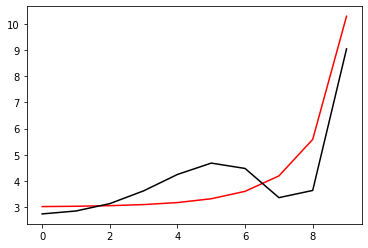

8700 0.019088102517659074
[2.73578594 2.84723326 3.1269843  3.61397913 4.23962022 4.6769174
 4.47569435 3.36218202 3.636916   9.04815137]


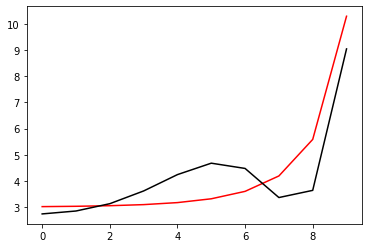

8800 0.018996521286325424
[2.73720202 2.84797852 3.12613575 3.61083887 4.23510339 4.67478383
 4.47753173 3.36766449 3.64136398 9.04763213]


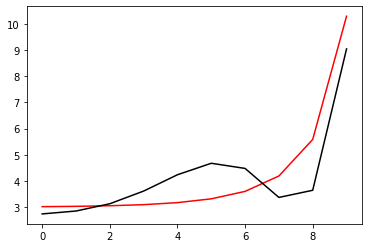

8900 0.01890596319429479
[2.73860325 2.84871806 3.12530132 3.60773529 4.23062025 4.67263871
 4.4793484  3.3731252  3.64579485 9.04711336]


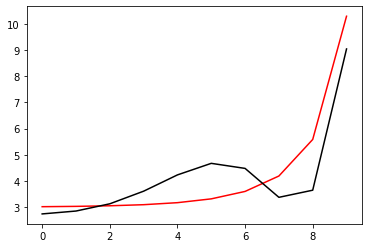

9000 0.018816410584501096
[2.73998985 2.84945192 3.12448073 3.60466781 4.22617057 4.67048245
 4.48114452 3.37856431 3.6502088  9.04659507]


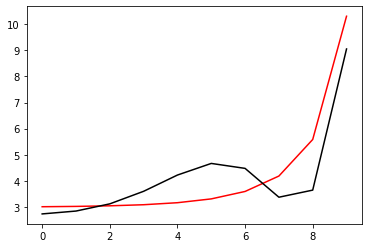

9100 0.018727846223698615
[2.74136202 2.85018017 3.12367371 3.60163588 4.22175411 4.66831547
 4.48292026 3.38398202 3.65460602 9.04607725]


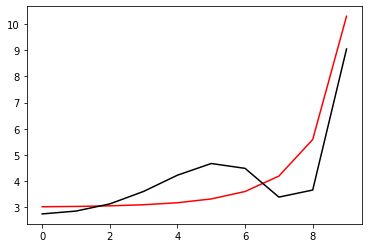

9200 0.018640253289846836
[2.74271997 2.85090284 3.12287999 3.59863895 4.21737062 4.66613816
 4.48467579 3.38937848 3.65898667 9.0455599 ]


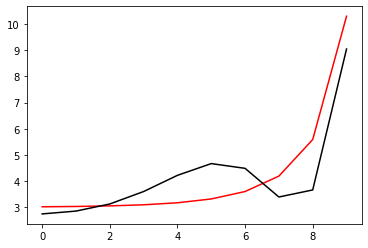

9300 0.018553615359665737
[2.74406389 2.85161999 3.1220993  3.59567648 4.21301986 4.66395093
 4.48641126 3.39475388 3.66335095 9.04504302]


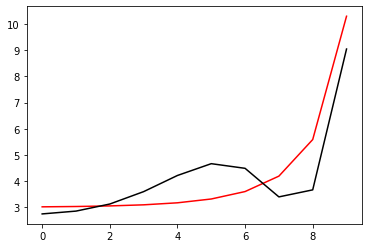

9400 0.01846791639703055
[2.74539399 2.85233165 3.12133139 3.59274797 4.2087016  4.66175416
 4.48812685 3.40010838 3.66769902 9.04452661]


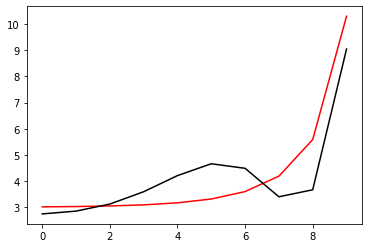

9500 0.018383140741492335
[2.74671044 2.85303789 3.12057601 3.58985288 4.20441559 4.65954823
 4.48982272 3.40544214 3.67203105 9.04401067]


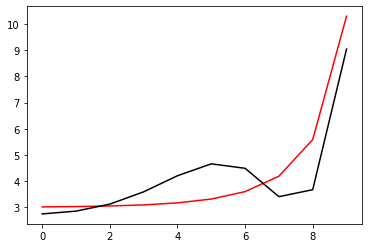

9600 0.018299273097174124
[2.74801343 2.85373875 3.11983291 3.58699071 4.2001616  4.65733351
 4.49149902 3.41075534 3.67634721 9.04349518]


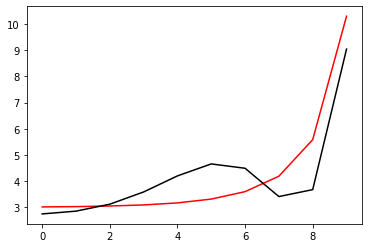

9700 0.018216298522228364
[2.74930314 2.85443427 3.11910185 3.58416098 4.19593937 4.65511038
 4.49315591 3.41604812 3.68064767 9.04298017]


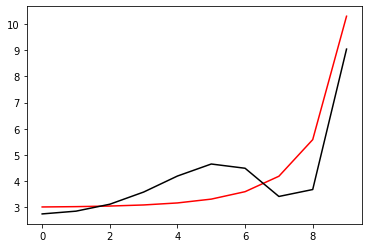

9800 0.0181342024184197
[2.75057976 2.85512449 3.1183826  3.5813632  4.19174868 4.65287919
 4.49479357 3.42132066 3.68493258 9.04246561]


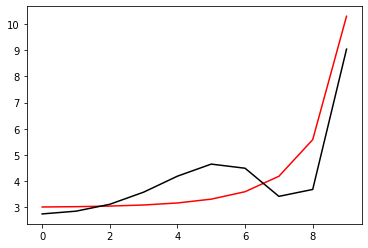

9900 0.018052970521332874
[2.75184346 2.85580947 3.11767493 3.57859689 4.18758928 4.65064029
 4.49641213 3.42657309 3.68920212 9.04195152]


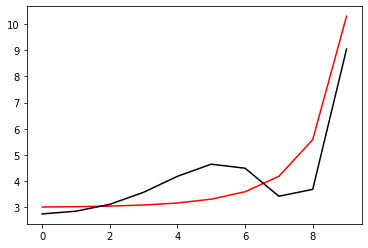

10000 0.017972588890662757
[2.7530944  2.85648925 3.11697863 3.57586158 4.18346093 4.64839404
 4.49801176 3.43180559 3.69345643 9.04143788]


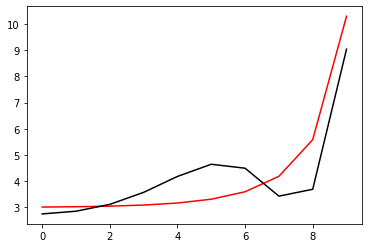

In [30]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.01789304390089265
[2.75433276 2.85716387 3.11629347 3.57315683 4.17936339 4.64614077
 4.49959262 3.4370183  3.69769568 9.0409247 ]


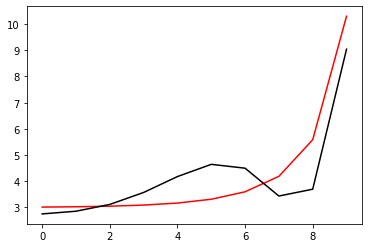

200 0.01781432223243452
[2.75555871 2.85783338 3.11561924 3.57048218 4.17529643 4.64388081
 4.50115486 3.44221136 3.70192001 9.04041197]


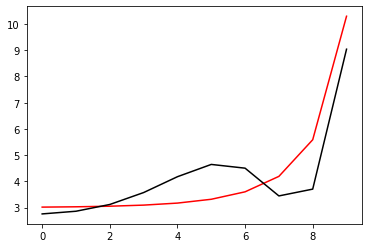

300 0.017736410862801227
[2.75677239 2.85849782 3.11495575 3.56783719 4.17125981 4.6416145
 4.50269863 3.44738493 3.70612958 9.0398997 ]


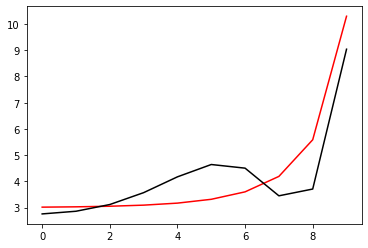

400 0.01765929705832958
[2.75797398 2.85915723 3.11430278 3.56522144 4.16725329 4.63934215
 4.50422408 3.45253915 3.71032453 9.03938789]


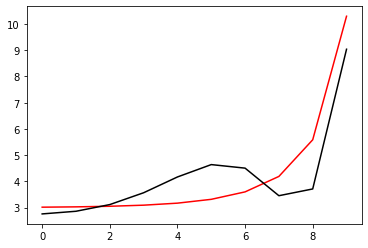

500 0.017582968365908593
[2.75916362 2.85981166 3.11366013 3.56263449 4.16327663 4.63706408
 4.50573138 3.45767416 3.71450501 9.03887652]


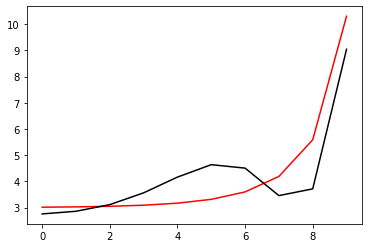

600 0.01750741260526994
[2.76034146 2.86046114 3.11302763 3.56007594 4.1593296  4.6347806
 4.50722066 3.46279011 3.71867117 9.0383656 ]


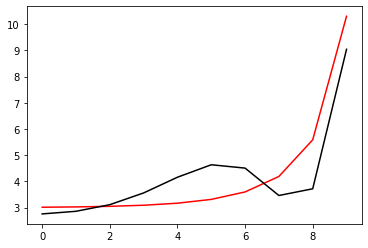

700 0.017432617861284545
[2.76150767 2.86110573 3.11240508 3.55754538 4.15541197 4.63249202
 4.50869208 3.46788713 3.72282314 9.03785513]


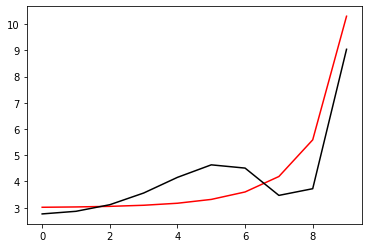

800 0.017358572476695457
[2.76266238 2.86174545 3.11179229 3.5550424  4.1515235  4.63019862
 4.51014579 3.47296535 3.72696106 9.03734511]


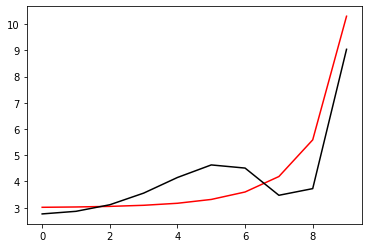

900 0.017285265044841555
[2.76380573 2.86238035 3.11118909 3.55256662 4.14766397 4.62790071
 4.51158193 3.47802492 3.73108508 9.03683553]


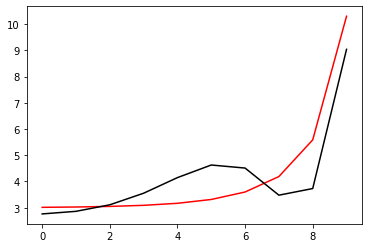

1000 0.01721268440290494
[2.76493788 2.86301048 3.1105953  3.55011766 4.14383313 4.62559856
 4.51300065 3.48306596 3.73519532 9.0363264 ]


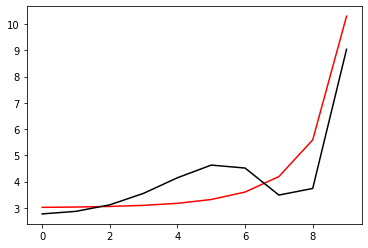

1100 0.017140819625216148
[2.76605895 2.86363587 3.11001075 3.54769512 4.14003076 4.62329246
 4.5144021  3.48808861 3.73929192 9.03581771]


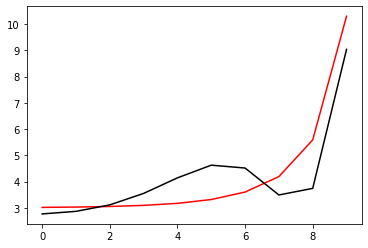

1200 0.017069660016715192
[2.76716909 2.86425655 3.10943527 3.54529865 4.13625664 4.62098268
 4.51578643 3.493093   3.74337501 9.03530946]


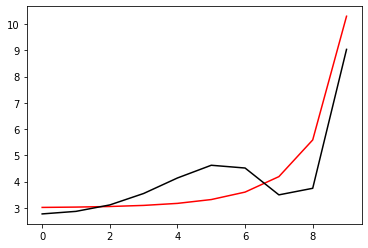

1300 0.016999195106797454
[2.76826842 2.86487258 3.10886871 3.54292788 4.13251053 4.61866949
 4.51715377 3.49807924 3.74744472 9.03480165]


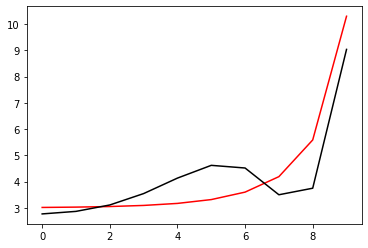

1400 0.01692941464316095
[2.76935708 2.86548398 3.10831089 3.54058245 4.12879221 4.61635316
 4.51850427 3.50304748 3.75150118 9.03429429]


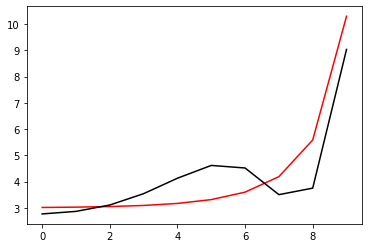

1500 0.016860308586036432
[2.77043519 2.8660908  3.10776167 3.53826201 4.12510146 4.61403394
 4.51983807 3.50799783 3.75554451 9.03378735]


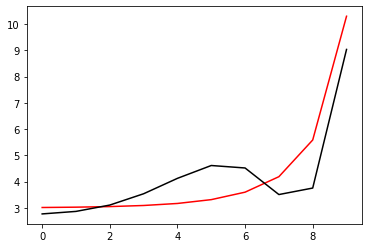

1600 0.016791867102399466
[2.77150289 2.86669307 3.10722089 3.53596622 4.12143805 4.61171209
 4.52115532 3.51293041 3.75957483 9.03328086]


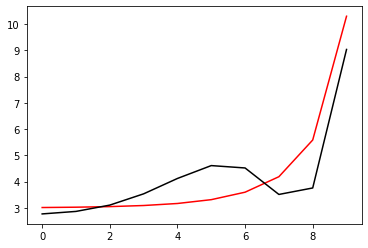

1700 0.016724080560582874
[2.77256029 2.86729083 3.10668839 3.53369474 4.11780176 4.60938786
 4.52245616 3.51784534 3.76359227 9.0327748 ]


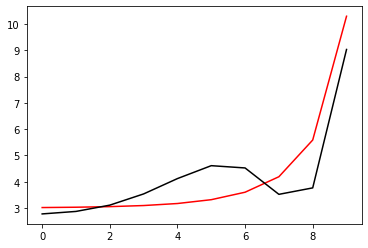

1800 0.016656939524808664
[2.77360753 2.86788411 3.10616405 3.53144724 4.11419236 4.60706149
 4.52374071 3.52274275 3.76759695 9.03226917]


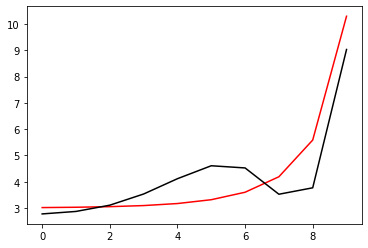

1900 0.016590434750175125
[2.77464471 2.86847296 3.1056477  3.52922338 4.11060965 4.60473322
 4.52500914 3.52762275 3.77158899 9.03176398]


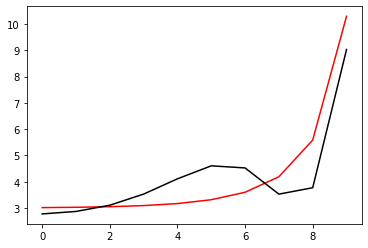

2000 0.016524557177520056
[2.77567196 2.86905741 3.10513921 3.52702286 4.1070534  4.60240329
 4.52626156 3.53248546 3.7755685  9.03125921]


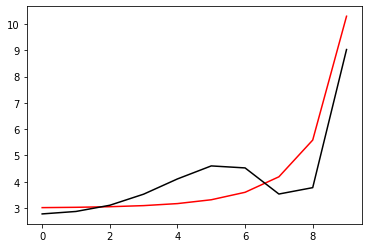

2100 0.0164592979285832
[2.77668939 2.86963749 3.10463845 3.52484535 4.10352339 4.60007191
 4.52749812 3.53733099 3.77953559 9.03075488]


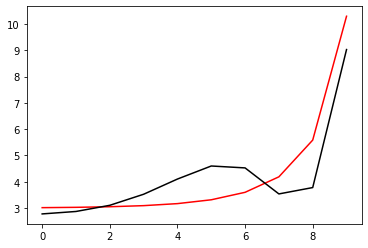

2200 0.016394648301398335
[2.77769711 2.87021323 3.10414528 3.52269054 4.10001942 4.59773933
 4.52871896 3.54215945 3.78349039 9.03025097]


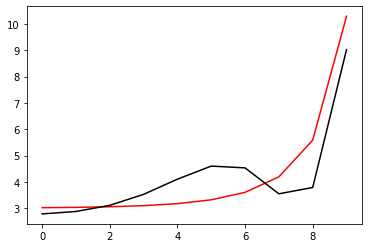

2300 0.01633059976564019
[2.77869525 2.87078469 3.10365956 3.52055814 4.09654127 4.59540575
 4.5299242  3.54697095 3.787433   9.0297475 ]


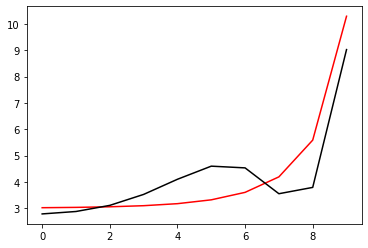

2400 0.016267143958218502
[2.7796839  2.87135188 3.10318118 3.51844784 4.09308872 4.5930714
 4.53111399 3.55176561 3.79136353 9.02924444]


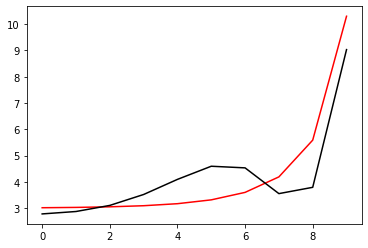

2500 0.016204272679003637
[2.78066318 2.87191484 3.10270999 3.51635936 4.08966157 4.59073648
 4.53228846 3.55654353 3.79528208 9.02874182]


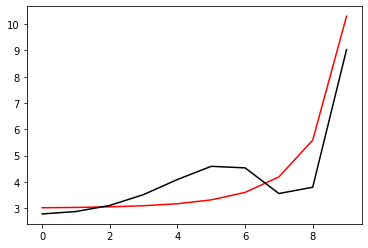

2600 0.016141977886694255
[2.78163319 2.8724736  3.10224589 3.51429239 4.0862596  4.5884012
 4.53344774 3.56130482 3.79918878 9.02823962]


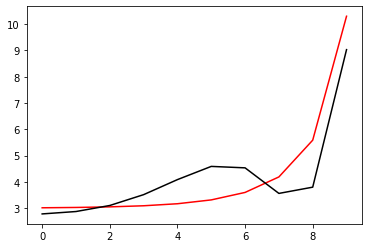

2700 0.01608025169477069
[2.78259405 2.87302821 3.10178874 3.51224666 4.08288262 4.58606577
 4.53459197 3.56604959 3.80308372 9.02773784]


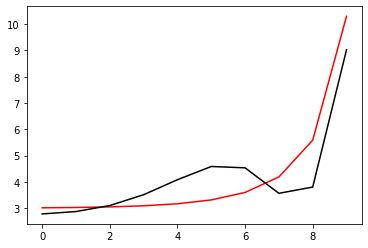

2800 0.01601908636752482
[2.78354584 2.87357869 3.10133844 3.51022189 4.07953041 4.58373038
 4.53572126 3.57077793 3.80696701 9.02723648]


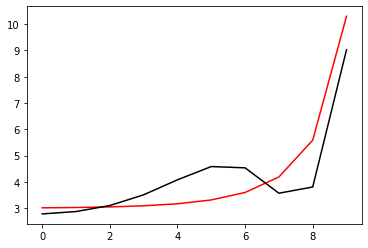

2900 0.015958474316366565
[2.78448867 2.87412506 3.10089486 3.50821781 4.07620278 4.58139522
 4.53683577 3.57548996 3.81083874 9.02673554]


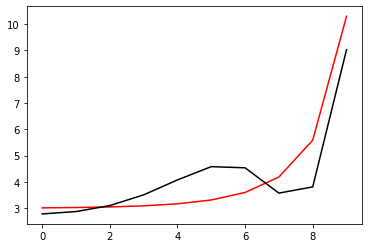

3000 0.015898408096071306
[2.78542264 2.87466738 3.10045789 3.50623414 4.07289951 4.57906049
 4.5379356  3.58018577 3.81469903 9.02623502]


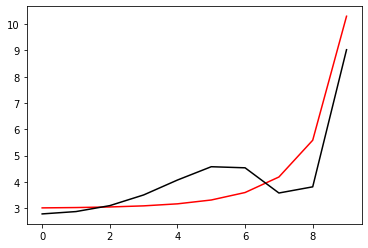

3100 0.015838880401258814
[2.78634786 2.87520566 3.10002742 3.50427063 4.06962041 4.57672637
 4.5390209  3.58486546 3.81854796 9.02573492]


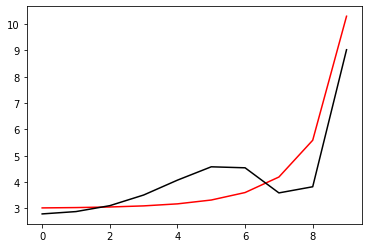

3200 0.015779884062892244
[2.78726441 2.87573994 3.09960333 3.50232701 4.06636527 4.57439305
 4.54009179 3.58952914 3.82238564 9.02523524]


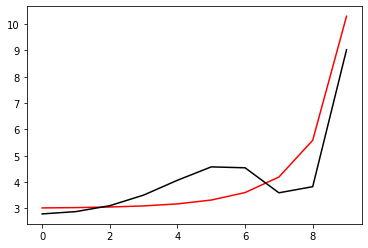

3300 0.015721412044958746
[2.7881724  2.87627025 3.09918554 3.50040302 4.06313391 4.57206069
 4.54114839 3.5941769  3.82621217 9.02473597]


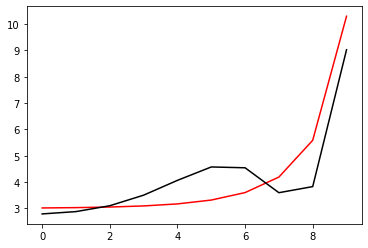

3400 0.015663457441147006
[2.78907191 2.87679663 3.09877391 3.49849841 4.05992612 4.56972948
 4.54219084 3.59880883 3.83002764 9.02423712]


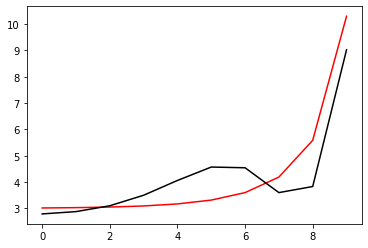

3500 0.015606013471753928
[2.78996303 2.87731909 3.09836837 3.49661295 4.05674171 4.56739959
 4.54321925 3.60342504 3.83383214 9.02373868]


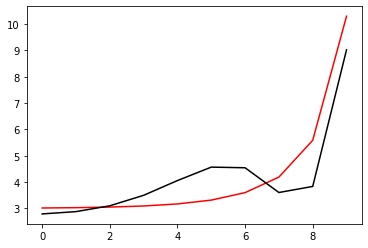

3600 0.015549073480561783
[2.79084587 2.87783767 3.09796879 3.49474637 4.05358049 4.56507118
 4.54423376 3.60802562 3.83762577 9.02324065]


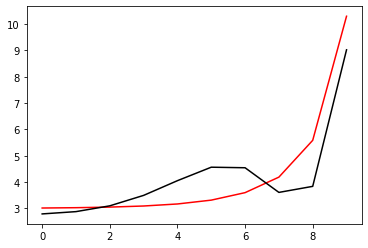

3700 0.015492630931881154
[2.79172051 2.87835241 3.0975751  3.49289845 4.05044226 4.56274441
 4.54523448 3.61261065 3.84140862 9.02274303]


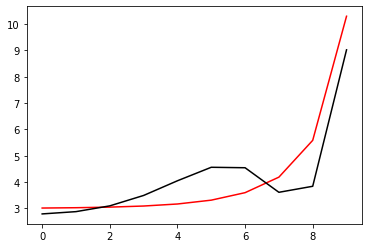

3800 0.015436679407631864
[2.79258703 2.87886332 3.09718718 3.49106894 4.04732683 4.56041945
 4.54622154 3.61718024 3.84518078 9.02224583]


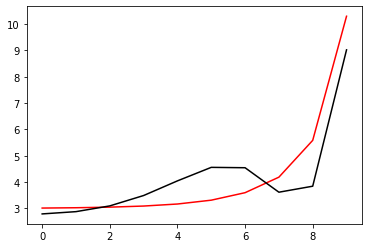

3900 0.015381212604552618
[2.79344553 2.87937044 3.09680494 3.48925762 4.04423402 4.55809644
 4.54719506 3.62173447 3.84894234 9.02174903]


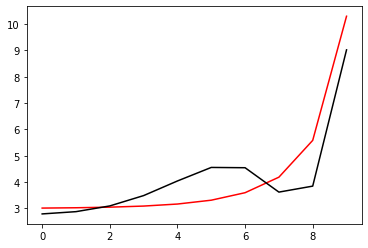

4000 0.015326224331475652
[2.79429609 2.8798738  3.09642829 3.48746426 4.04116364 4.55577555
 4.54815516 3.62627344 3.85269338 9.02125264]


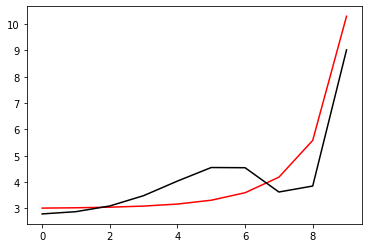

4100 0.015271708506661543
[2.79513879 2.88037343 3.09605715 3.48568863 4.0381155  4.55345692
 4.54910197 3.63079722 3.856434   9.02075666]


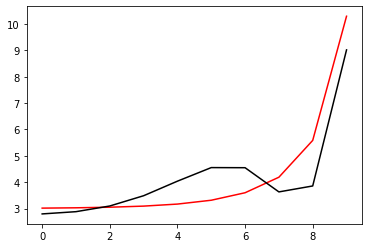

4200 0.015217659155223363
[2.79597372 2.88086936 3.0956914  3.48393051 4.03508942 4.5511407
 4.55003559 3.63530592 3.86016428 9.02026109]


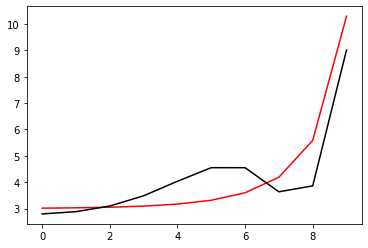

4300 0.01516407040661424
[2.79680096 2.8813616  3.09533098 3.48218968 4.03208522 4.54882702
 4.55095616 3.63979961 3.8638843  9.01976592]


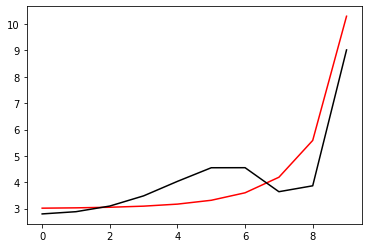

4400 0.015110936492266238
[2.79762059 2.8818502  3.09497579 3.48046594 4.02910271 4.54651603
 4.55186378 3.64427838 3.86759415 9.01927116]


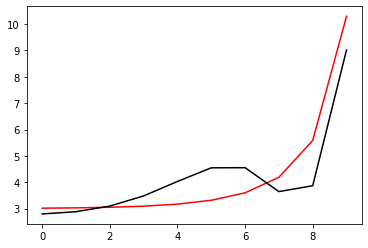

4500 0.015058251743124211
[2.79843269 2.88233517 3.09462575 3.47875906 4.02614172 4.54420787
 4.55275858 3.64874231 3.8712939  9.0187768 ]


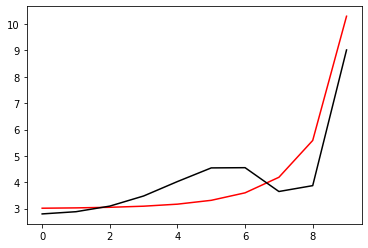

4600 0.015006010587428507
[2.79923734 2.88281655 3.09428077 3.47706884 4.02320207 4.54190266
 4.55364066 3.6531915  3.87498365 9.01828284]


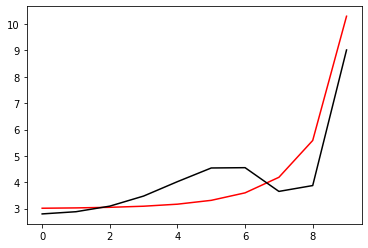

4700 0.01495420754850209
[2.80003463 2.88329437 3.09394078 3.47539508 4.02028358 4.53960053
 4.55451015 3.65762601 3.87866347 9.01778928]


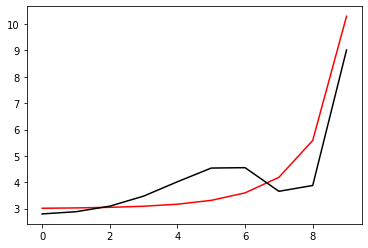

4800 0.014902837242467128
[2.80082461 2.88376864 3.09360569 3.47373757 4.01738608 4.53730162
 4.55536717 3.66204594 3.88233344 9.01729612]


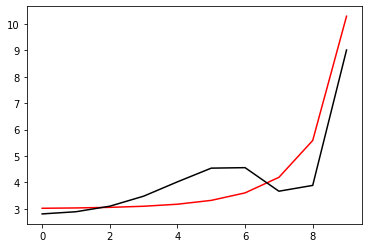

4900 0.014851894376354197
[2.80160738 2.8842394  3.09327542 3.47209612 4.01450938 4.53500604
 4.55621181 3.66645136 3.88599364 9.01680336]


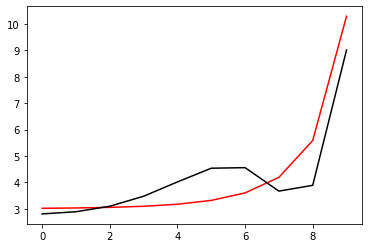

5000 0.014801373745778593
[2.802383   2.88470666 3.09294989 3.47047053 4.01165333 4.53271391
 4.5570442  3.67084236 3.88964414 9.016311  ]


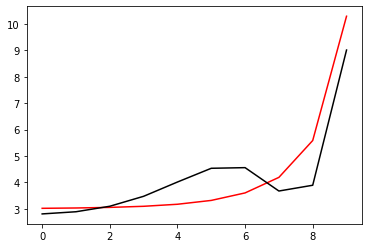

5100 0.014751270233244233
[2.80315155 2.88517047 3.09262904 3.46886061 4.00881776 4.53042535
 4.55786446 3.675219   3.89328502 9.01581904]


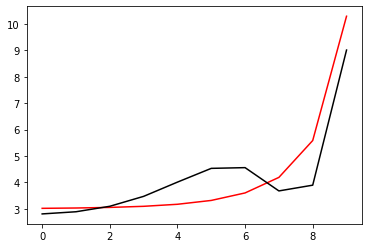

5200 0.014701578805944509
[2.8039131  2.88563084 3.09231277 3.46726617 4.00600248 4.52814049
 4.55867268 3.67958138 3.89691635 9.01532747]


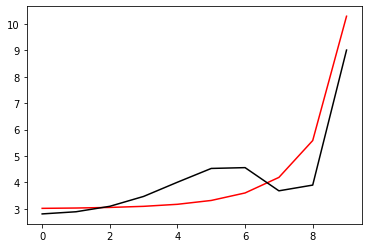

5300 0.014652294514136946
[2.80466773 2.8860878  3.09200103 3.46568702 4.00320733 4.52585942
 4.55946898 3.68392956 3.90053821 9.0148363 ]


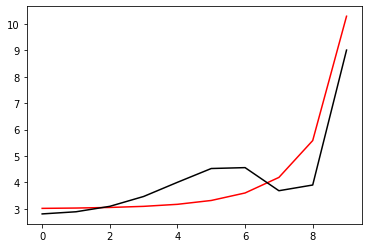

5400 0.01460341248906737
[2.8054155  2.88654137 3.09169374 3.46412298 4.00043216 4.52358225
 4.56025347 3.68826362 3.90415068 9.01434552]


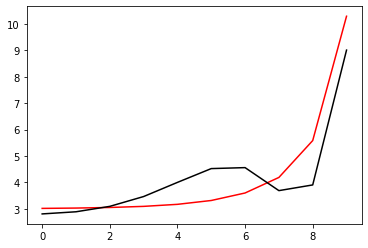

5500 0.014554927941416024
[2.80615649 2.88699158 3.09139082 3.46257387 3.99767678 4.5213091
 4.56102626 3.69258364 3.90775382 9.01385514]


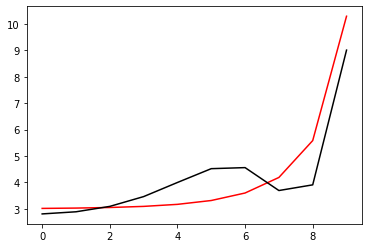

5600 0.014506836159399662
[2.80689076 2.88743846 3.0910922  3.46103951 3.99494105 4.51904007
 4.56178746 3.6968897  3.9113477  9.01336514]


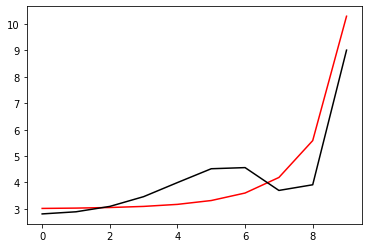

5700 0.01445913250719149
[2.80761839 2.88788202 3.09079783 3.45951972 3.99222479 4.51677525
 4.56253717 3.70118186 3.9149324  9.01287554]


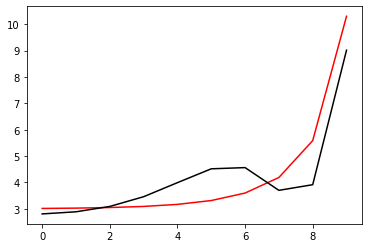

5800 0.014411812423287311
[2.80833944 2.8883223  3.09050763 3.45801432 3.98952785 4.51451475
 4.5632755  3.70546019 3.91850798 9.01238633]


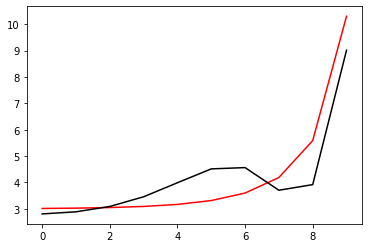

5900 0.014364871418865006
[2.80905397 2.88875931 3.09022153 3.45652316 3.98685006 4.51225866
 4.56400256 3.70972478 3.92207452 9.01189751]


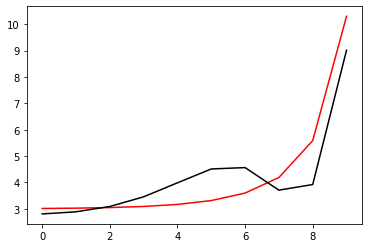

6000 0.014318305076225987
[2.80976206 2.88919309 3.08993946 3.45504606 3.98419127 4.51000707
 4.56471845 3.71397568 3.92563207 9.01140908]


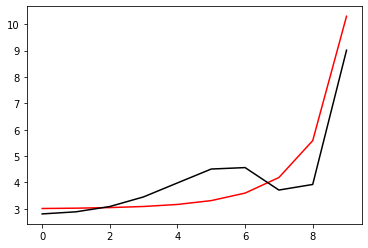

6100 0.014272109047388862
[2.81046377 2.88962365 3.08966138 3.45358285 3.98155132 4.50776008
 4.56542327 3.71821298 3.92918071 9.01092104]


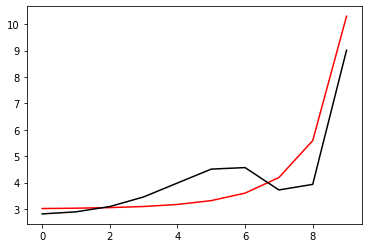

6200 0.014226279052495726
[2.81115917 2.89005101 3.0893872  3.45213336 3.97893006 4.50551778
 4.56611714 3.72243673 3.9327205  9.01043339]


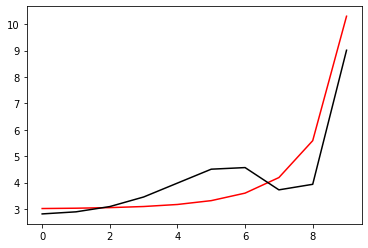

6300 0.014180810878554977
[2.81184831 2.89047521 3.08911687 3.45069745 3.97632733 4.50328024
 4.56680014 3.72664701 3.93625151 9.00994612]


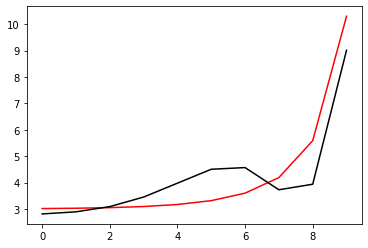

6400 0.014135700377799298
[2.81253127 2.89089627 3.08885033 3.44927495 3.97374298 4.50104756
 4.56747239 3.73084389 3.9397738  9.00945923]


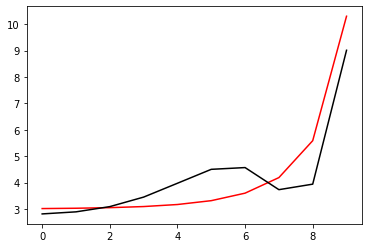

6500 0.014090943466679063
[2.8132081  2.8913142  3.08858751 3.44786569 3.97117686 4.4988198
 4.56813398 3.73502744 3.94328743 9.00897273]


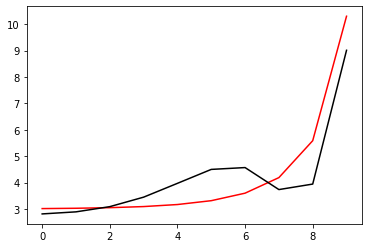

6600 0.014046536124216285
[2.81387886 2.89172903 3.08832837 3.44646954 3.96862882 4.49659707
 4.56878501 3.73919771 3.94679247 9.00848662]


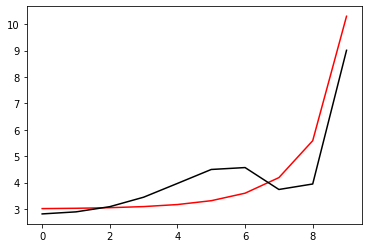

6700 0.014002474390923933
[2.81454363 2.89214079 3.08807283 3.44508632 3.9660987  4.49437942
 4.56942559 3.74335478 3.95028897 9.00800088]


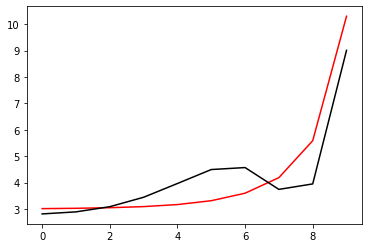

6800 0.013958754367507462
[2.81520245 2.89254949 3.08782085 3.4437159  3.96358636 4.49216694
 4.57005581 3.7474987  3.953777   9.00751553]


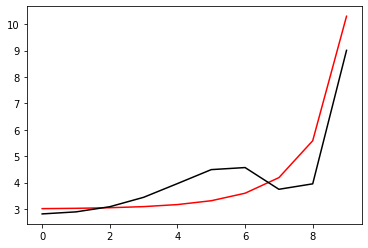

6900 0.013915372213635788
[2.81585539 2.89295516 3.08757236 3.44235812 3.96109166 4.48995969
 4.57067577 3.75162956 3.95725662 9.00703056]


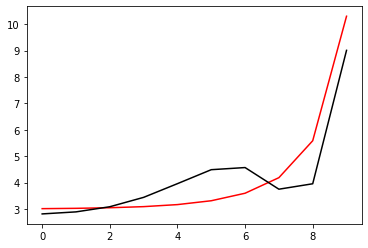

7000 0.013872324146782217
[2.8165025  2.89335783 3.08732731 3.44101284 3.95861444 4.48775775
 4.57128556 3.7557474  3.96072789 9.00654597]


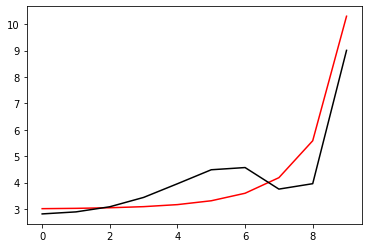

7100 0.013829606441083348
[2.81714386 2.8937575  3.08708565 3.43967992 3.95615457 4.48556119
 4.57188529 3.75985229 3.96419086 9.00606176]


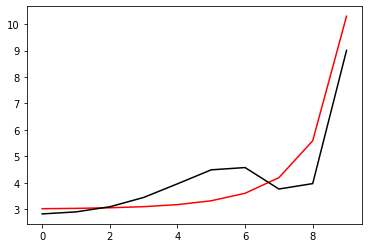

7200 0.013787215426156348
[2.8177795  2.89415421 3.08684732 3.4383592  3.95371191 4.48337006
 4.57247505 3.76394429 3.9676456  9.00557793]


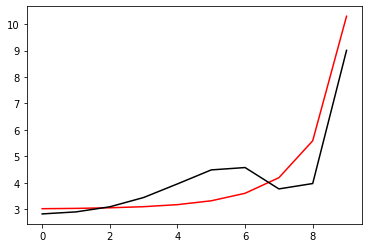

7300 0.013745147486091826
[2.8184095  2.89454798 3.08661227 3.43705055 3.9512863  4.48118444
 4.57305493 3.76802346 3.97109215 9.00509447]


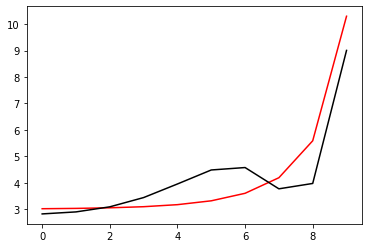

7400 0.013703399058352828
[2.8190339  2.89493882 3.08638045 3.43575383 3.94887761 4.47900439
 4.57362503 3.77208987 3.97453058 9.0046114 ]


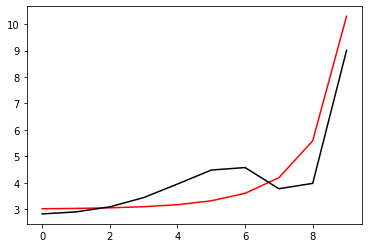

7500 0.013661966632701965
[2.81965277 2.89532677 3.0861518  3.4344689  3.9464857  4.47682997
 4.57418544 3.77614358 3.97796094 9.00412869]


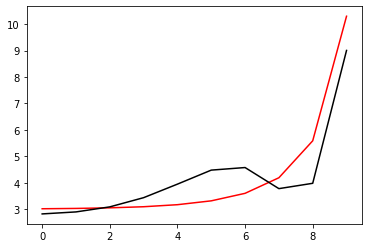

7600 0.013620846750257539
[2.82026616 2.89571183 3.08592628 3.43319562 3.94411043 4.47466123
 4.57473625 3.78018464 3.98138329 9.00364637]


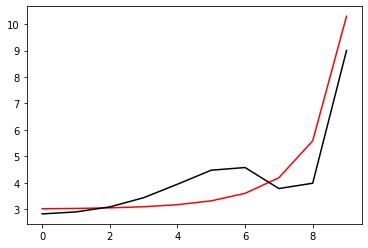

7700 0.013580036002419622
[2.82087412 2.89609404 3.08570383 3.43193387 3.94175166 4.47249824
 4.57527755 3.78421311 3.98479768 9.00316442]


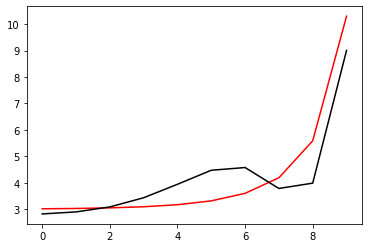

7800 0.01353953103005024
[2.82147672 2.89647341 3.08548441 3.43068351 3.93940927 4.47034104
 4.57580945 3.78822906 3.98820416 9.00268284]


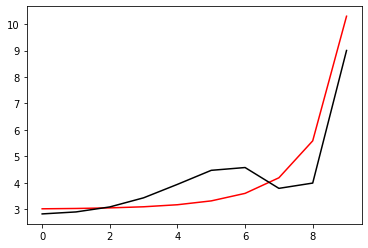

7900 0.013499328522372456
[2.82207399 2.89684996 3.08526797 3.42944441 3.9370831  4.46818969
 4.57633201 3.79223253 3.99160279 9.00220163]


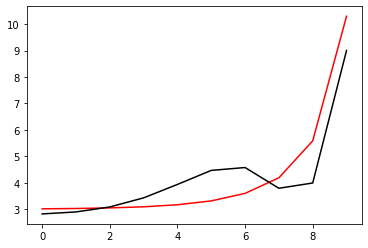

8000 0.013459425216179158
[2.82266601 2.89722372 3.08505446 3.42821644 3.93477304 4.46604425
 4.57684535 3.79622359 3.99499362 9.0017208 ]


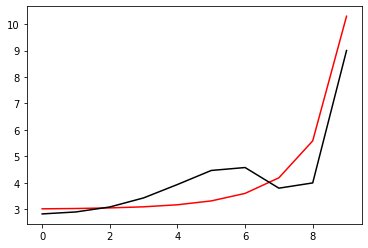

8100 0.013419817894875993
[2.82325281 2.8975947  3.08484383 3.42699948 3.93247894 4.46390475
 4.57734954 3.80020229 3.99837669 9.00124034]


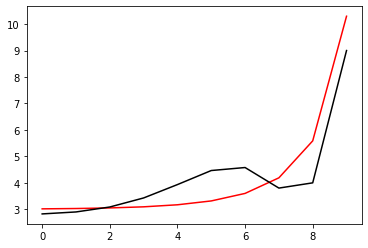

8200 0.013380503387639457
[2.82383446 2.89796293 3.08463604 3.42579339 3.93020068 4.46177125
 4.57784467 3.80416869 4.00175207 9.00076024]


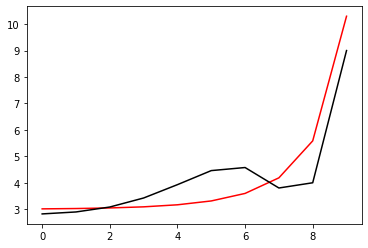

8300 0.013341478568617813
[2.824411   2.89832842 3.08443104 3.42459806 3.92793813 4.45964379
 4.57833083 3.80812285 4.0051198  9.00028052]


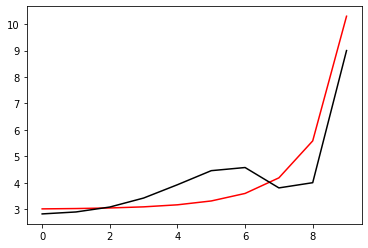

8400 0.013302740355953462
[2.82498249 2.8986912  3.08422879 3.42341336 3.92569114 4.45752242
 4.5788081  3.81206481 4.00847993 8.99980117]


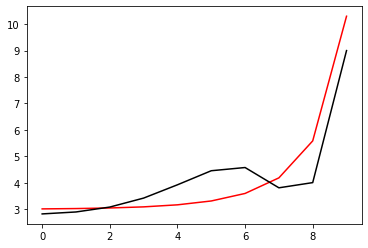

8500 0.013264285711202289
[2.82554897 2.89905129 3.08402924 3.42223917 3.92345961 4.45540718
 4.57927658 3.81599463 4.01183251 8.99932218]


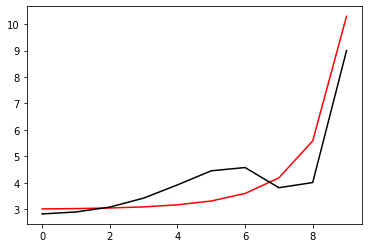

8600 0.01322611163829862
[2.82611051 2.8994087  3.08383235 3.42107537 3.9212434  4.45329811
 4.57973635 3.81991237 4.01517758 8.99884357]


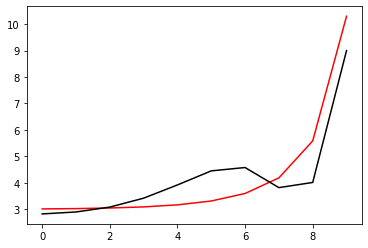

8700 0.013188215183004021
[2.82666714 2.89976346 3.08363808 3.41992185 3.91904238 4.45119525
 4.58018749 3.82381808 4.01851521 8.99836532]


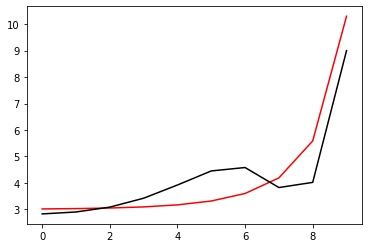

8800 0.013150593431993294
[2.82721891 2.90011558 3.08344639 3.41877849 3.91685642 4.44909864
 4.58063008 3.82771181 4.02184542 8.99788743]


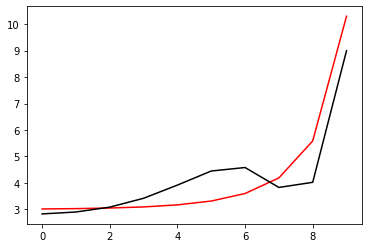

8900 0.013113243512221106
[2.82776589 2.90046509 3.08325722 3.41764517 3.91468541 4.44700831
 4.58106422 3.83159361 4.02516827 8.99740991]


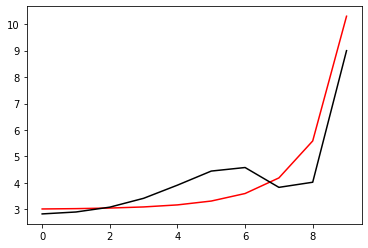

9000 0.013076162590209703
[2.82830811 2.90081201 3.08307055 3.41652177 3.91252923 4.4449243
 4.58148997 3.83546354 4.02848381 8.99693276]


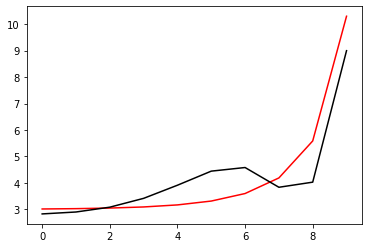

9100 0.013039347871279378
[2.82884562 2.90115634 3.08288634 3.4154082  3.91038774 4.44284664
 4.58190743 3.83932165 4.03179208 8.99645597]


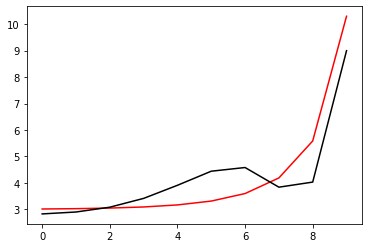

9200 0.013002796598899278
[2.82937848 2.90149813 3.08270453 3.41430433 3.90826082 4.44077537
 4.58231667 3.84316798 4.03509312 8.99597954]


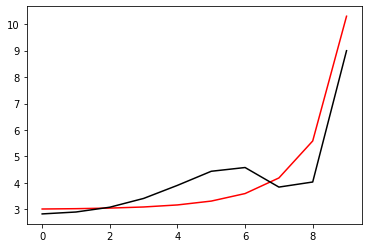

9300 0.01296650605407015
[2.82990672 2.90183737 3.0825251  3.41321005 3.90614837 4.43871051
 4.58271778 3.84700258 4.03838699 8.99550347]


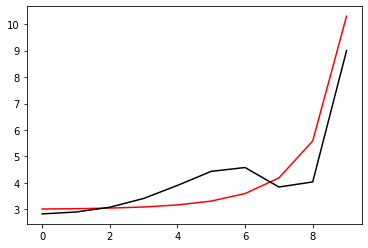

9400 0.01293047355461795
[2.8304304  2.9021741  3.082348   3.41212527 3.90405025 4.43665209
 4.58311083 3.85082551 4.04167371 8.99502777]


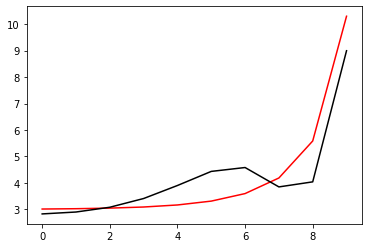

9500 0.012894696454521647
[2.83094957 2.90250833 3.0821732  3.41104986 3.90196635 4.43460015
 4.5834959  3.85463682 4.04495335 8.99455243]


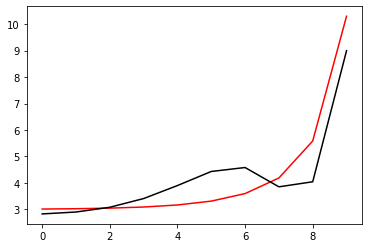

9600 0.012859172143427657
[2.83146426 2.90284007 3.08200066 3.40998373 3.89989655 4.4325547
 4.58387307 3.85843655 4.04822593 8.99407744]


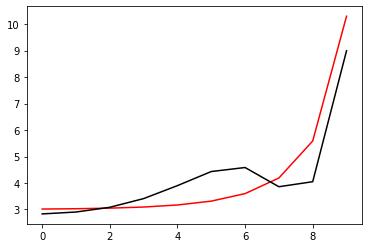

9700 0.012823898045890831
[2.83197452 2.90316936 3.08183035 3.40892677 3.89784073 4.43051578
 4.58424242 3.86222475 4.0514915  8.99360282]


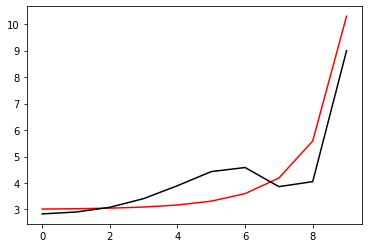

9800 0.012788871620881322
[2.8324804  2.9034962  3.08166222 3.40787888 3.89579879 4.4284834
 4.58460402 3.86600147 4.05475011 8.99312855]


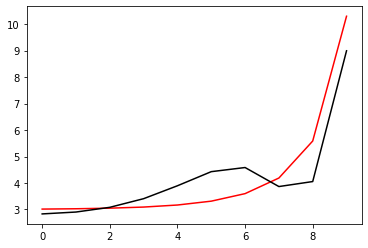

9900 0.012754090361174548
[2.83298195 2.90382062 3.08149623 3.40683996 3.89377059 4.4264576
 4.58495796 3.86976675 4.05800179 8.99265465]


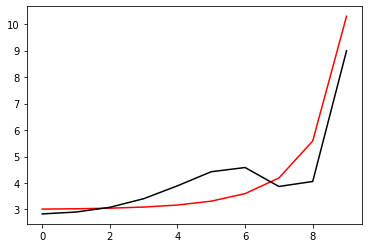

10000 0.012719551792755792
[2.83347921 2.90414263 3.08133237 3.4058099  3.89175604 4.42443838
 4.5853043  3.87352065 4.06124659 8.9921811 ]


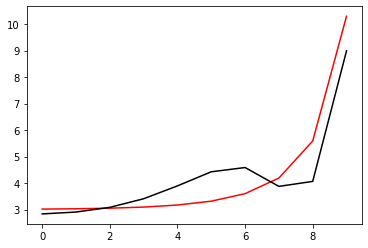

In [31]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.012685253474298242
[2.83397222 2.90446226 3.08117058 3.4047886  3.88975502 4.42242577
 4.58564313 3.8772632  4.06448454 8.9917079 ]


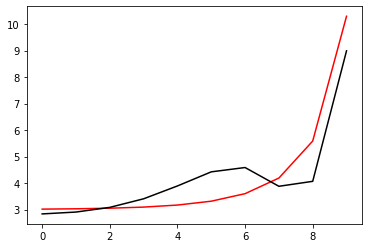

200 0.012651192996579822
[2.83446102 2.90477951 3.08101085 3.40377598 3.88776742 4.4204198
 4.58597451 3.88099446 4.06771569 8.99123506]


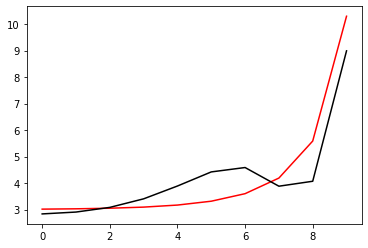

300 0.012617367982083046
[2.83494566 2.90509442 3.08085312 3.40277192 3.88579311 4.41842047
 4.58629851 3.88471447 4.07094007 8.99076258]


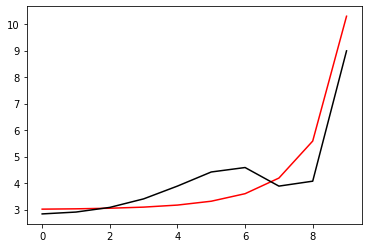

400 0.012583776084250218
[2.83542619 2.90540699 3.08069737 3.40177634 3.88383201 4.41642781
 4.58661523 3.88842328 4.07415772 8.99029046]


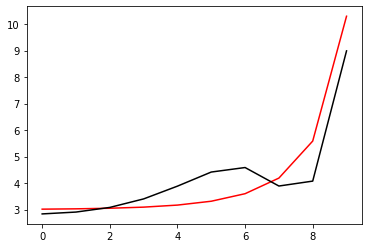

500 0.01255041498717686
[2.83590264 2.90571725 3.08054357 3.40078913 3.88188399 4.41444183
 4.58692471 3.89212092 4.07736869 8.98981868]


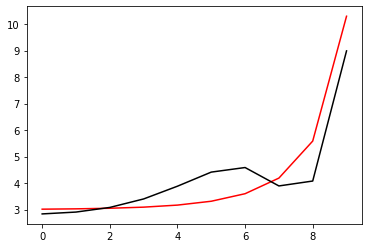

600 0.012517282405013905
[2.83637506 2.9060252  3.08039168 3.39981021 3.87994894 4.41246254
 4.58722704 3.89580745 4.080573   8.98934726]


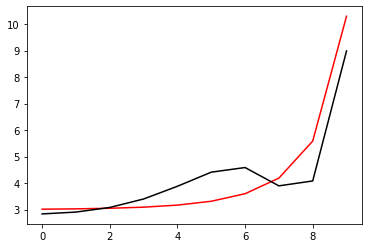

700 0.012484376081516573
[2.83684348 2.90633088 3.08024168 3.39883949 3.87802677 4.41048996
 4.58752229 3.8994829  4.08377071 8.98887619]


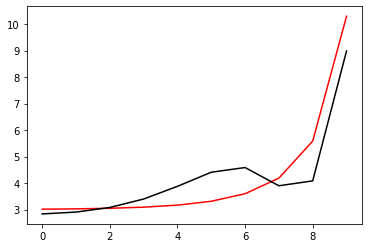

800 0.012451693789517285
[2.83730796 2.9066343  3.08009353 3.39787686 3.87611735 4.4085241
 4.58781053 3.90314733 4.08696183 8.98840548]


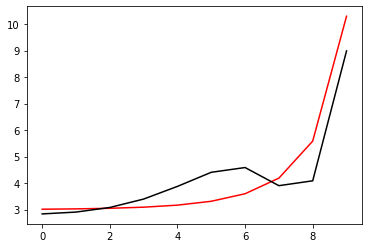

900 0.012419233330543544
[2.83776852 2.90693547 3.07994719 3.39692224 3.8742206  4.40656497
 4.58809182 3.90680076 4.09014642 8.98793511]


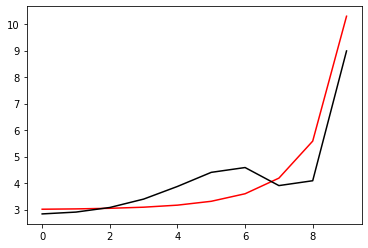

1000 0.012386992534244114
[2.83822522 2.90723442 3.07980265 3.39597554 3.87233639 4.40461259
 4.58836624 3.91044326 4.0933245  8.9874651 ]


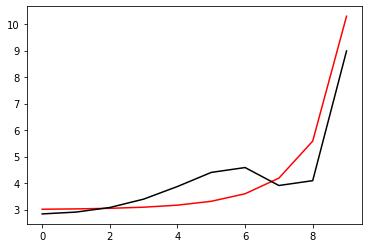

1100 0.012354969258114159
[2.83867809 2.90753115 3.07965987 3.39503668 3.87046464 4.40266695
 4.58863386 3.91407485 4.09649612 8.98699543]


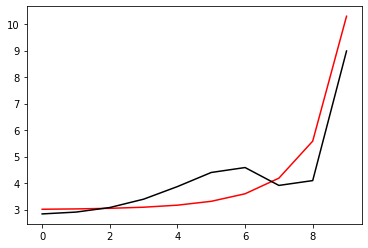

1200 0.012323161386827876
[2.83912717 2.9078257  3.07951881 3.39410556 3.86860523 4.40072808
 4.58889474 3.91769558 4.09966131 8.98652612]


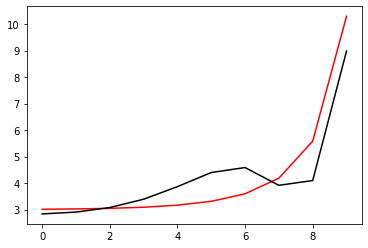

1300 0.012291566832042047
[2.8395725  2.90811806 3.07937946 3.39318209 3.86675806 4.39879597
 4.58914895 3.92130549 4.1028201  8.98605715]


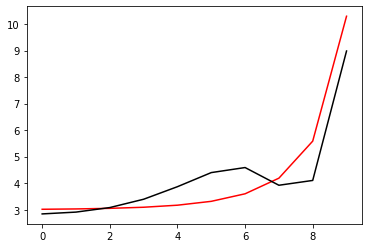

1400 0.012260183531778601
[2.84001412 2.90840827 3.07924178 3.3922662  3.86492303 4.39687064
 4.58939655 3.92490463 4.10597252 8.98558853]


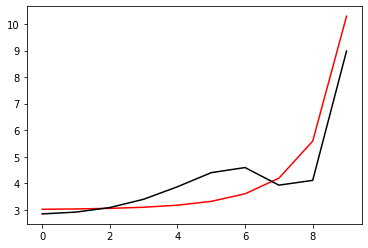

1500 0.012229009450150463
[2.84045207 2.90869634 3.07910574 3.3913578  3.86310004 4.39495208
 4.58963762 3.92849303 4.10911862 8.98512026]


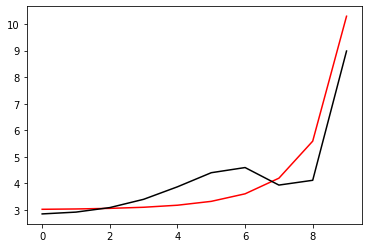

1600 0.012198042576870188
[2.84088639 2.90898229 3.07897132 3.39045679 3.86128898 4.39304032
 4.58987222 3.93207073 4.11225842 8.98465234]


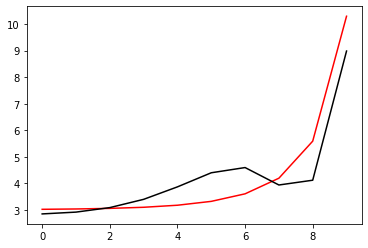

1700 0.012167280926932079
[2.84131711 2.90926613 3.07883849 3.38956311 3.85948977 4.39113533
 4.59010041 3.93563778 4.11539196 8.98418476]


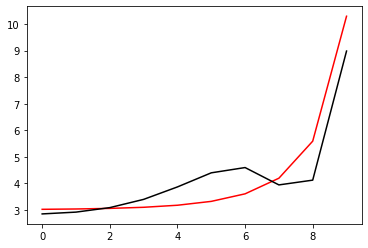

1800 0.01213672254010249
[2.84174427 2.90954787 3.07870722 3.38867667 3.8577023  4.38923715
 4.59032226 3.93919421 4.11851928 8.98371753]


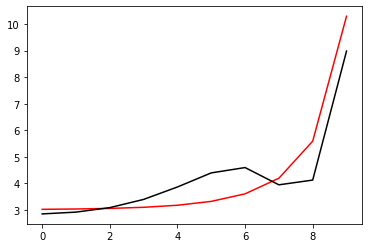

1900 0.012106365480712727
[2.84216792 2.90982755 3.07857748 3.38779739 3.85592647 4.38734575
 4.59053783 3.94274006 4.1216404  8.98325064]


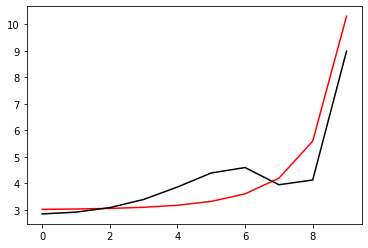

2000 0.012076207837098594
[2.84258808 2.91010516 3.07844926 3.38692519 3.85416219 4.38546115
 4.59074719 3.94627538 4.12475535 8.98278409]


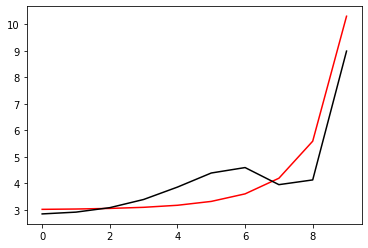

2100 0.01204624772134439
[2.8430048  2.91038074 3.07832252 3.38605998 3.85240936 4.38358334
 4.59095039 3.94980019 4.12786418 8.98231789]


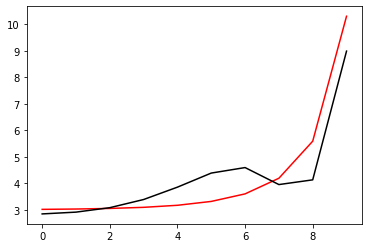

2200 0.012016483268910038
[2.8434181  2.91065429 3.07819723 3.3852017  3.85066789 4.38171233
 4.5911475  3.95331455 4.13096691 8.98185203]


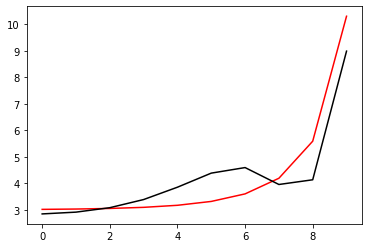

2300 0.011986912638306223
[2.84382803 2.91092583 3.07807338 3.38435026 3.84893767 4.37984812
 4.59133859 3.95681849 4.13406357 8.98138652]


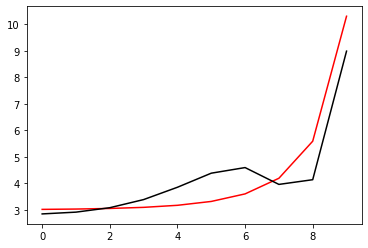

2400 0.011957534010602082
[2.84423463 2.91119538 3.07795094 3.38350559 3.84721862 4.3779907
 4.5915237  3.96031203 4.13715419 8.98092134]


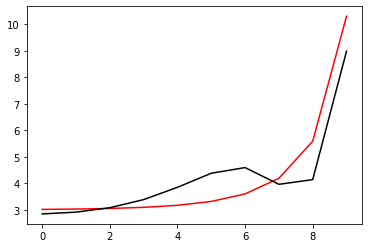

2500 0.01192834558931969
[2.84463792 2.91146296 3.07782988 3.38266761 3.84551065 4.37614006
 4.59170291 3.96379524 4.1402388  8.98045651]


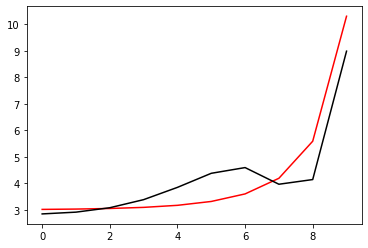

2600 0.011899345599874458
[2.84503794 2.91172857 3.07771018 3.38183625 3.84381365 4.37429622
 4.59187628 3.96726813 4.14331744 8.97999202]


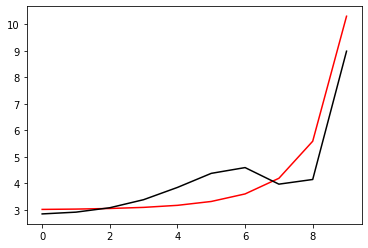

2700 0.0118705322893933
[2.84543473 2.91199224 3.07759182 3.38101144 3.84212755 4.37245916
 4.59204385 3.97073075 4.14639014 8.97952787]


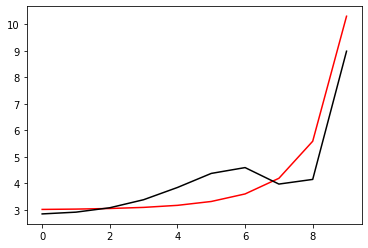

2800 0.011841903926320046
[2.84582832 2.91225398 3.07747477 3.3801931  3.84045224 4.37062888
 4.5922057  3.97418314 4.14945692 8.97906405]


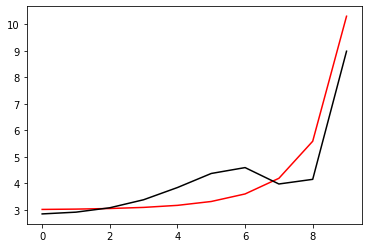

2900 0.011813458800161679
[2.84621874 2.91251381 3.07735901 3.37938115 3.83878764 4.36880537
 4.59236187 3.97762532 4.15251781 8.97860058]


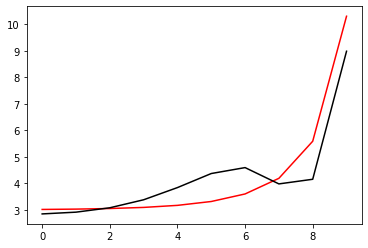

3000 0.011785195221102529
[2.84660603 2.91277174 3.07724452 3.37857554 3.83713366 4.36698863
 4.59251243 3.98105734 4.15557284 8.97813744]


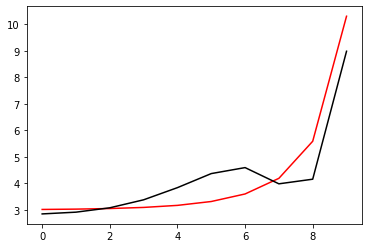

3100 0.011757111519786902
[2.84699023 2.91302779 3.07713127 3.37777618 3.83549021 4.36517866
 4.59265744 3.98447924 4.15862204 8.97767464]


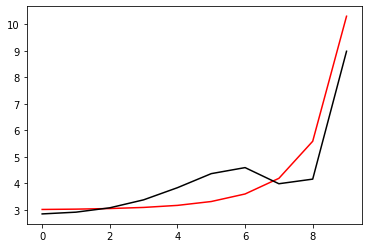

3200 0.011729206046902507
[2.84737136 2.91328198 3.07701925 3.37698302 3.8338572  4.36337543
 4.59279694 3.98789104 4.16166545 8.97721218]


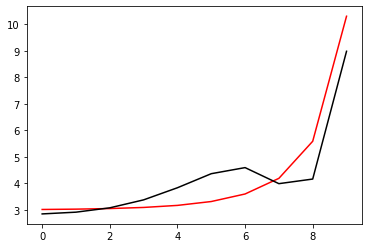

3300 0.011701477173028078
[2.84774946 2.91353431 3.07690843 3.37619597 3.83223455 4.36157896
 4.592931   3.99129279 4.16470308 8.97675005]


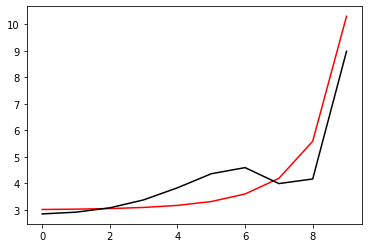

3400 0.011673923288195224
[2.84812455 2.91378481 3.0767988  3.37541498 3.83062217 4.35978923
 4.59305968 3.99468451 4.16773496 8.97628826]


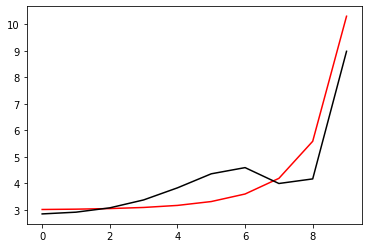

3500 0.011646542801805097
[2.84849668 2.91403349 3.07669032 3.37463997 3.82901996 4.35800622
 4.59318302 3.99806625 4.17076113 8.97582681]


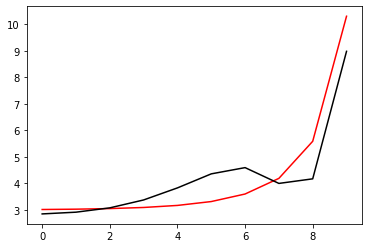

3600 0.011619334142086655
[2.84886587 2.91428036 3.07658299 3.37387087 3.82742786 4.35622994
 4.59330109 4.00143804 4.17378161 8.97536569]


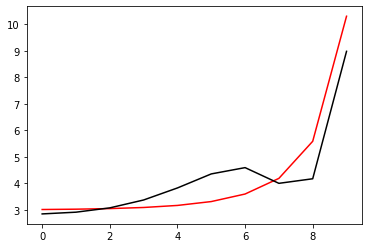

3700 0.011592295756059277
[2.84923216 2.91452545 3.07647677 3.37310764 3.82584577 4.35446037
 4.59341393 4.00479991 4.17679642 8.9749049 ]


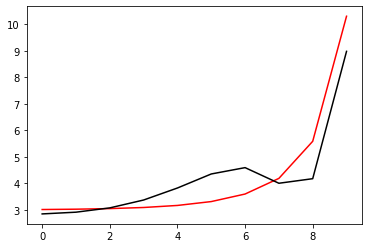

3800 0.011565426109140044
[2.84959557 2.91476875 3.07637166 3.37235018 3.8242736  4.35269751
 4.59352161 4.00815189 4.1798056  8.97444445]


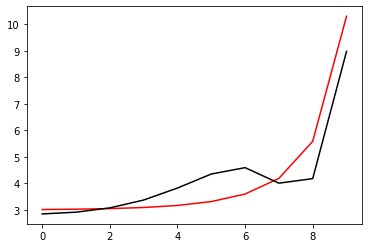

3900 0.01153872368492177
[2.84995614 2.9150103  3.07626763 3.37159846 3.82271128 4.35094133
 4.59362417 4.01149403 4.18280918 8.97398433]


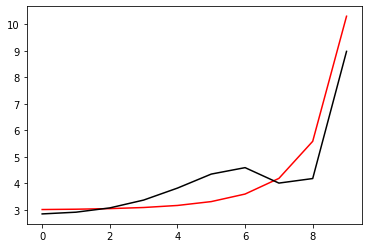

4000 0.011512186984870536
[2.8503139  2.9152501  3.07616466 3.37085239 3.82115873 4.34919183
 4.59372166 4.01482635 4.18580716 8.97352454]


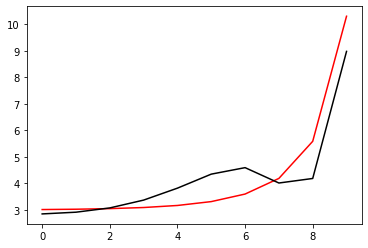

4100 0.011485814528153681
[2.85066887 2.91548817 3.07606273 3.37011192 3.81961586 4.347449
 4.59381414 4.01814889 4.18879959 8.97306508]


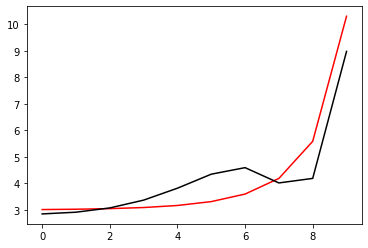

4200 0.011459604851256234
[2.85102109 2.91572453 3.07596183 3.36937699 3.81808258 4.34571283
 4.59390167 4.02146168 4.19178649 8.97260596]


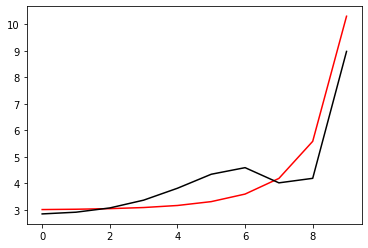

4300 0.01143355650786116
[2.85137059 2.91595918 3.07586193 3.36864753 3.81655883 4.3439833
 4.59398429 4.02476475 4.19476788 8.97214716]


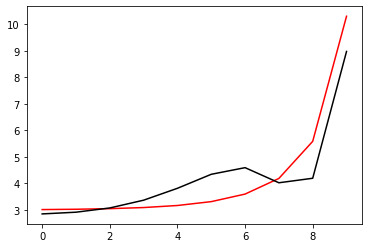

4400 0.011407668068592098
[2.85171739 2.91619215 3.07576303 3.36792348 3.81504452 4.34226039
 4.59406204 4.02805815 4.19774379 8.97168869]


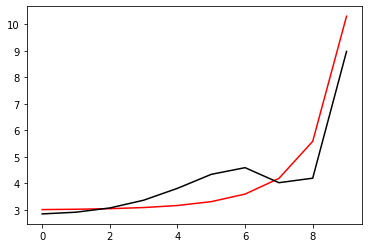

4500 0.011381938120660573
[2.85206153 2.91642344 3.07566509 3.36720479 3.81353957 4.34054411
 4.594135   4.03134189 4.20071425 8.97123056]


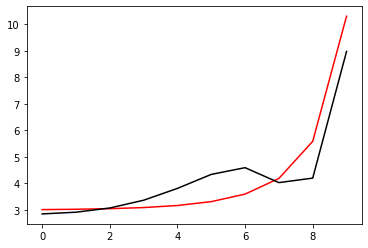

4600 0.01135636526777746
[2.85240303 2.91665307 3.07556811 3.3664914  3.81204391 4.33883442
 4.59420319 4.03461601 4.20367927 8.97077275]


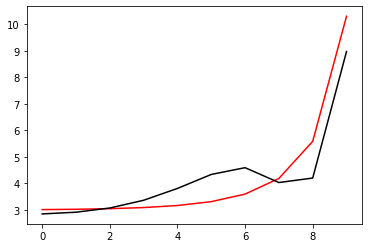

4700 0.011330948129831375
[2.85274193 2.91688106 3.07547206 3.36578324 3.81055745 4.33713133
 4.59426668 4.03788055 4.20663889 8.97031527]


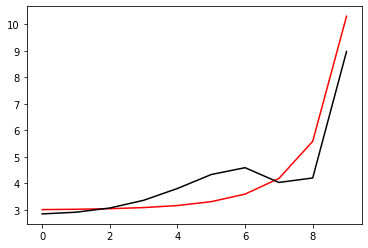

4800 0.011305685342677124
[2.85307824 2.91710741 3.07537693 3.36508026 3.80908011 4.3354348
 4.59432551 4.04113553 4.20959313 8.96985812]


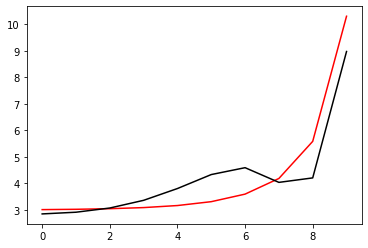

4900 0.011280575557937073
[2.853412   2.91733215 3.07528271 3.3643824  3.80761183 4.33374484
 4.59437974 4.04438099 4.212542   8.9694013 ]


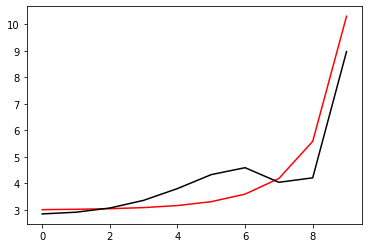

5000 0.011255617442776474
[2.85374323 2.91755528 3.07518938 3.36368961 3.80615253 4.33206141
 4.5944294  4.04761696 4.21548555 8.9689448 ]


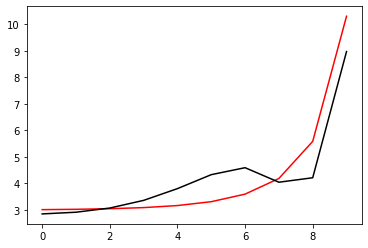

5100 0.011230809679643669
[2.85407197 2.91777683 3.07509691 3.36300183 3.80470212 4.33038451
 4.59447454 4.05084347 4.21842378 8.96848863]


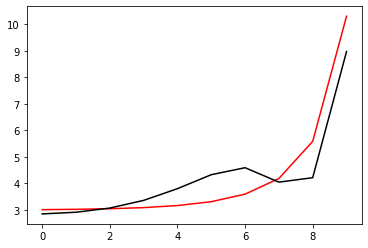

5200 0.011206150966140888
[2.85439824 2.91799679 3.0750053  3.362319   3.80326055 4.32871412
 4.59451523 4.05406056 4.22135672 8.96803279]


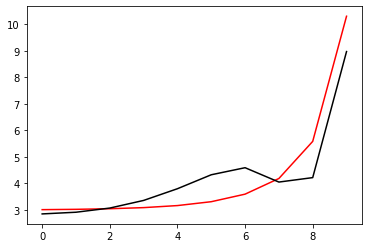

5300 0.011181640014683244
[2.85472206 2.9182152  3.07491453 3.36164107 3.80182772 4.32705023
 4.59455149 4.05726824 4.2242844  8.96757727]


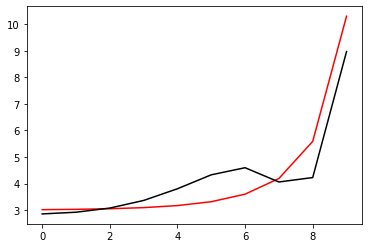

5400 0.011157275552462695
[2.85504346 2.91843205 3.07482459 3.36096799 3.80040358 4.32539281
 4.59458338 4.06046656 4.22720684 8.96712207]


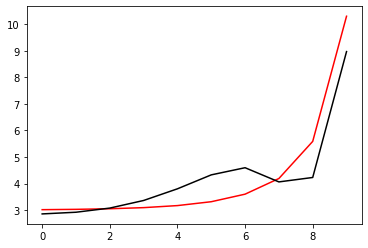

5500 0.011133056321124242
[2.85536248 2.91864737 3.07473545 3.3602997  3.79898804 4.32374185
 4.59461094 4.06365555 4.23012406 8.9666672 ]


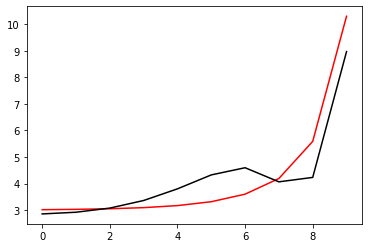

5600 0.011108981076578931
[2.85567912 2.91886117 3.07464711 3.35963616 3.79758104 4.32209733
 4.59463422 4.06683523 4.23303608 8.96621265]


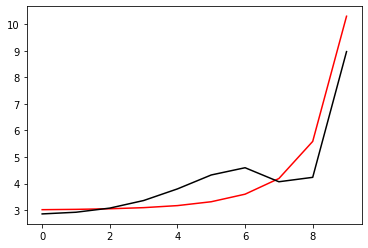

5700 0.01108504858882776
[2.85599343 2.91907346 3.07455955 3.3589773  3.79618249 4.32045923
 4.59465327 4.07000563 4.23594293 8.96575843]


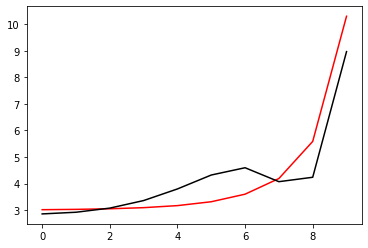

5800 0.011061257641822517
[2.85630542 2.91928425 3.07447276 3.35832308 3.79479235 4.31882754
 4.59466812 4.0731668  4.23884463 8.96530452]


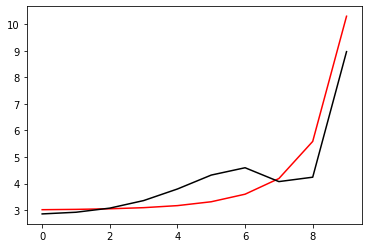

5900 0.011037607033153303
[2.85661511 2.91949355 3.07438672 3.35767344 3.79341052 4.31720223
 4.59467883 4.07631874 4.2417412  8.96485094]


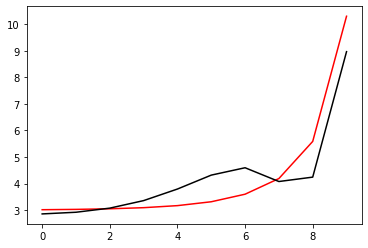

6000 0.011014095574025348
[2.85692255 2.91970139 3.07430142 3.35702834 3.79203695 4.3155833
 4.59468544 4.0794615  4.24463266 8.96439768]


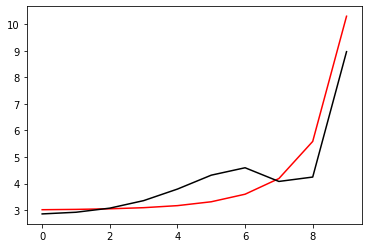

6100 0.010990722088823525
[2.85722774 2.91990777 3.07421685 3.35638773 3.79067156 4.31397071
 4.59468798 4.08259511 4.24751903 8.96394474]


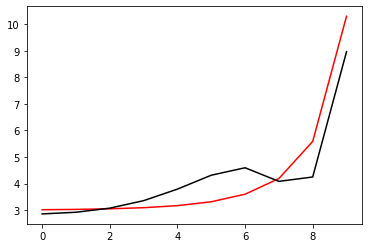

6200 0.0109674854152682
[2.85753071 2.9201127  3.07413299 3.35575156 3.78931428 4.31236445
 4.59468652 4.08571959 4.25040034 8.96349213]


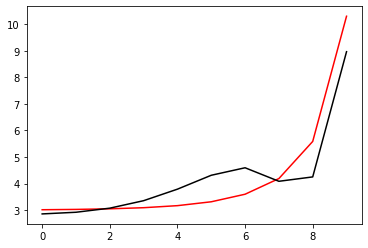

6300 0.010944384403923172
[2.85783149 2.9203162  3.07404982 3.35511978 3.78796505 4.3107645
 4.59468107 4.08883498 4.2532766  8.96303983]


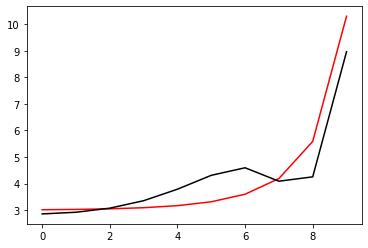

6400 0.010921417918201592
[2.85813009 2.92051827 3.07396735 3.35449234 3.78662381 4.30917084
 4.5946717  4.0919413  4.25614785 8.96258785]


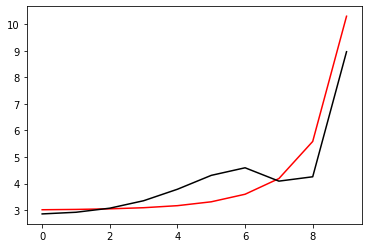

6500 0.010898584834159395
[2.85842656 2.92071894 3.07388555 3.3538692  3.78529047 4.30758346
 4.59465844 4.09503858 4.25901409 8.96213619]


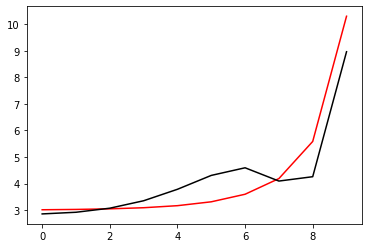

6600 0.01087588404026593
[2.85872089 2.92091822 3.07380441 3.3532503  3.78396499 4.30600232
 4.59464134 4.09812685 4.26187535 8.96168485]


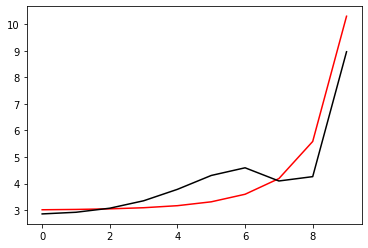

6700 0.01085331443730778
[2.85901313 2.92111611 3.07372392 3.35263561 3.78264728 4.30442741
 4.59462042 4.10120614 4.26473165 8.96123382]


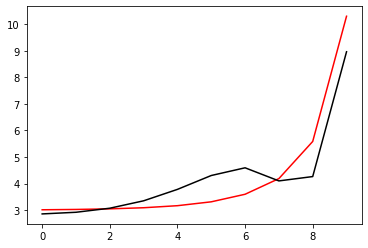

6800 0.010830874938236142
[2.85930329 2.92131263 3.07364407 3.35202507 3.78133729 4.30285871
 4.59459575 4.10427648 4.267583   8.96078311]


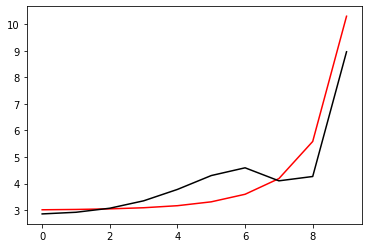

6900 0.010808564467849563
[2.85959139 2.92150779 3.07356485 3.35141865 3.78003496 4.3012962
 4.59456735 4.1073379  4.27042944 8.96033272]


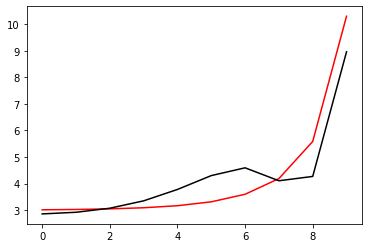

7000 0.010786381962902727
[2.85987745 2.9217016  3.07348624 3.35081629 3.77874022 4.29973986
 4.59453526 4.11039042 4.27327098 8.95988265]


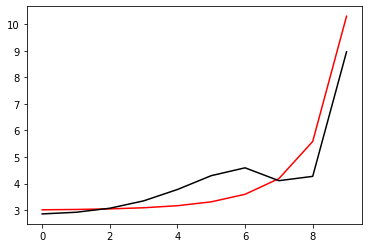

7100 0.010764326371614457
[2.86016151 2.92189408 3.07340823 3.35021796 3.777453   4.29818966
 4.59449954 4.11343408 4.27610764 8.95943289]


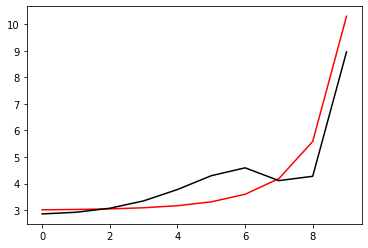

7200 0.01074239665387328
[2.86044357 2.92208523 3.07333082 3.34962361 3.77617324 4.29664559
 4.59446021 4.11646889 4.27893943 8.95898345]


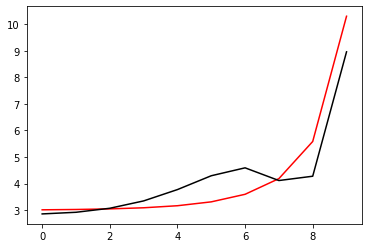

7300 0.010720591780761419
[2.86072366 2.92227507 3.07325399 3.34903319 3.77490088 4.29510762
 4.59441731 4.1194949  4.28176639 8.95853432]


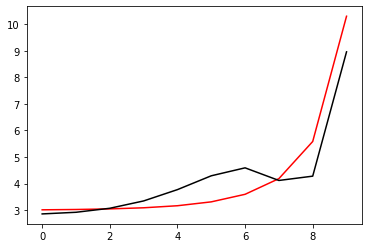

7400 0.010698910734618042
[2.8610018  2.92246361 3.07317773 3.34844667 3.77363587 4.29357573
 4.59437089 4.12251212 4.28458852 8.9580855 ]


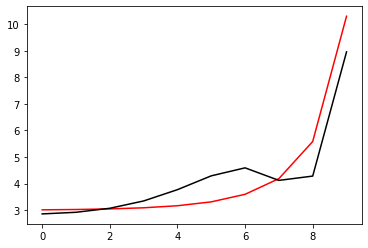

7500 0.010677352508789302
[2.86127802 2.92265086 3.07310204 3.34786401 3.77237813 4.29204991
 4.59432098 4.12552059 4.28740585 8.957637  ]


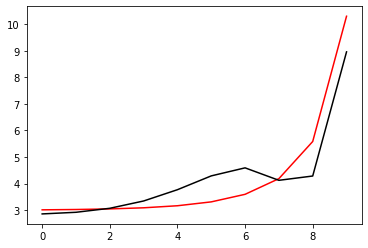

7600 0.010655916107551327
[2.86155233 2.92283683 3.07302689 3.34728515 3.77112761 4.29053012
 4.59426762 4.12852033 4.2902184  8.95718882]


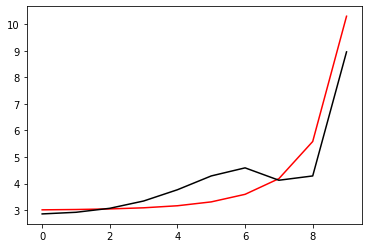

7700 0.010634600545865777
[2.86182475 2.92302153 3.07295229 3.34671007 3.76988425 4.28901634
 4.59421085 4.13151137 4.29302618 8.95674094]


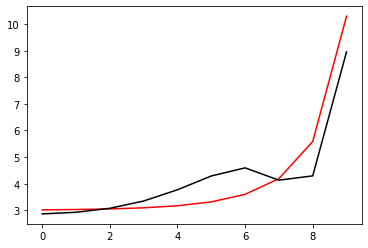

7800 0.010613404849358916
[2.8620953  2.92320498 3.07287821 3.34613872 3.76864799 4.28750856
 4.5941507  4.13449374 4.29582922 8.95629338]


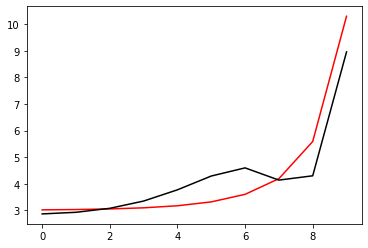

7900 0.010592328054066468
[2.86236401 2.92338719 3.07280466 3.34557106 3.76741876 4.28600675
 4.59408722 4.13746746 4.29862753 8.95584613]


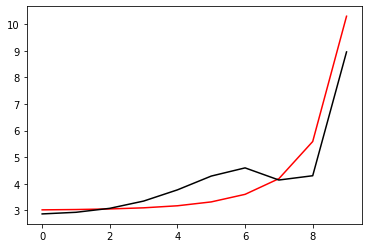

8000 0.010571369206392175
[2.86263088 2.92356816 3.07273162 3.34500705 3.76619652 4.28451089
 4.59402043 4.14043256 4.30142113 8.95539919]


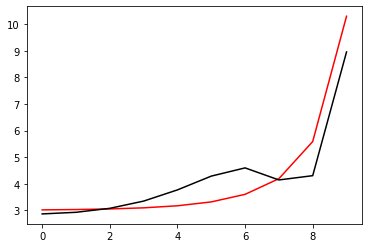

8100 0.01055052736289417
[2.86289595 2.92374791 3.07265908 3.34444666 3.76498121 4.28302095
 4.59395038 4.14338906 4.30421003 8.95495256]


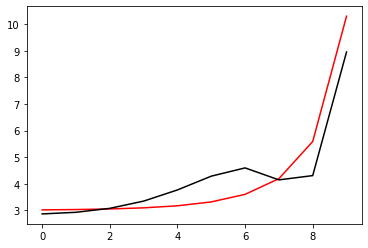

8200 0.010529801590250017
[2.86315924 2.92392645 3.07258704 3.34388984 3.76377275 4.28153692
 4.59387711 4.14633701 4.30699427 8.95450624]


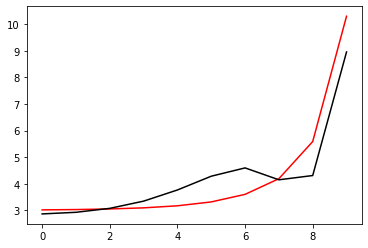

8300 0.010509190964982984
[2.86342075 2.92410378 3.07251547 3.34333656 3.76257111 4.28005877
 4.59380064 4.14927641 4.30977385 8.95406024]


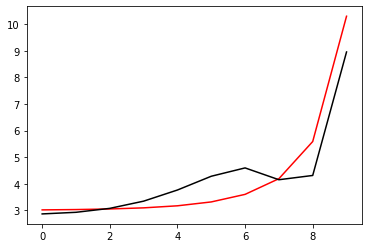

8400 0.010488694573463988
[2.8636805  2.92427993 3.07244439 3.34278678 3.76137622 4.27858647
 4.59372101 4.1522073  4.3125488  8.95361454]


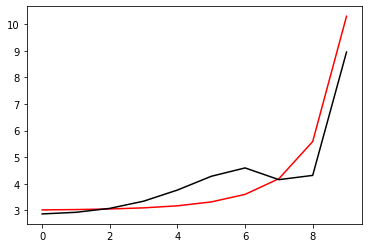

8500 0.010468311511715322
[2.86393853 2.92445489 3.07237377 3.34224046 3.76018803 4.27712001
 4.59363827 4.15512971 4.31531912 8.95316915]


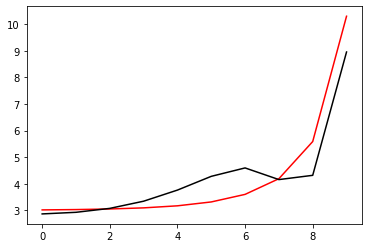

8600 0.01044804088531905
[2.86419484 2.92462869 3.07230361 3.34169757 3.75900648 4.27565936
 4.59355243 4.15804366 4.31808485 8.95272407]


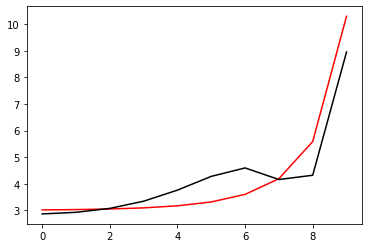

8700 0.010427881809246208
[2.86444945 2.92480133 3.0722339  3.34115807 3.75783152 4.2742045
 4.59346354 4.16094917 4.32084599 8.9522793 ]


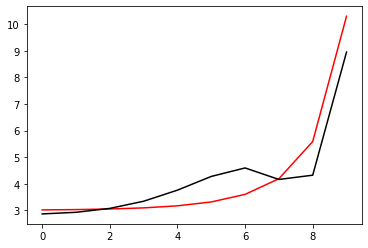

8800 0.010407833407799189
[2.86470239 2.92497282 3.07216464 3.34062192 3.7566631  4.2727554
 4.59337164 4.16384628 4.32360256 8.95183483]


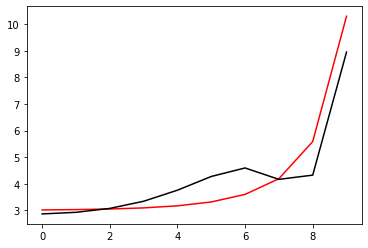

8900 0.010387894814445096
[2.86495366 2.92514317 3.0720958  3.34008909 3.75550115 4.27131205
 4.59327675 4.166735   4.32635459 8.95139067]


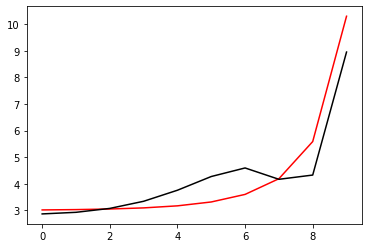

9000 0.01036806517167293
[2.86520329 2.92531239 3.0720274  3.33955955 3.75434563 4.26987441
 4.59317891 4.16961537 4.32910208 8.95094682]


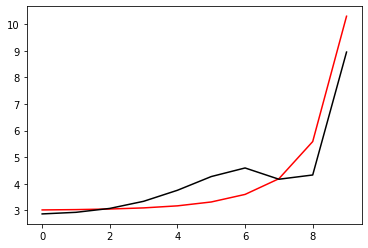

9100 0.010348343630958535
[2.86545129 2.92548049 3.07195941 3.33903326 3.75319648 4.26844247
 4.59307815 4.17248741 4.33184506 8.95050327]


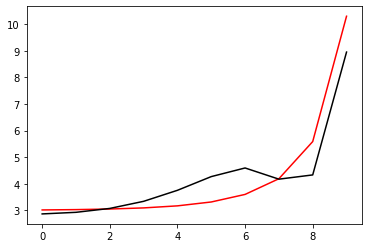

9200 0.010328729352584868
[2.86569769 2.92564748 3.07189183 3.33851018 3.75205365 4.26701619
 4.59297451 4.17535114 4.33458354 8.95006003]


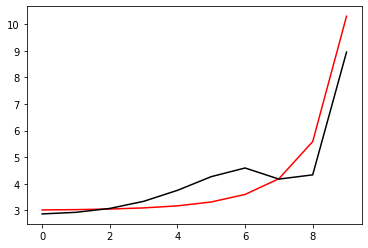

9300 0.010309221505563352
[2.86594248 2.92581338 3.07182466 3.33799029 3.7509171  4.26559557
 4.59286801 4.1782066  4.33731753 8.9496171 ]


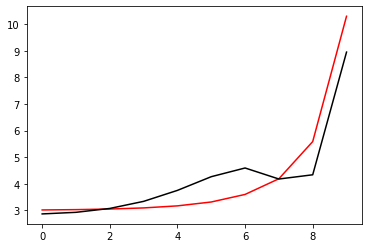

9400 0.01028981926747852
[2.86618571 2.92597819 3.07175788 3.33747355 3.74978676 4.26418057
 4.5927587  4.18105381 4.34004707 8.94917447]


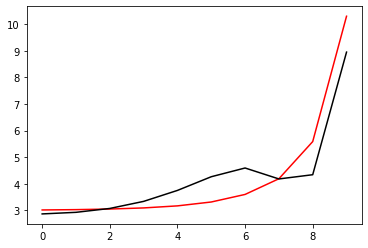

9500 0.010270521824401566
[2.86642737 2.92614191 3.0716915  3.33695992 3.74866259 4.26277117
 4.5926466  4.18389278 4.34277215 8.94873214]


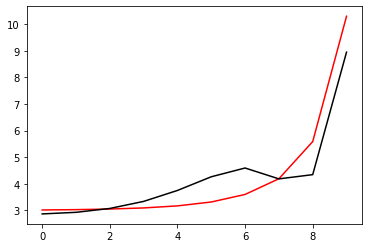

9600 0.010251328370837285
[2.86666749 2.92630457 3.07162549 3.33644939 3.74754453 4.26136734
 4.59253174 4.18672356 4.3454928  8.94829012]


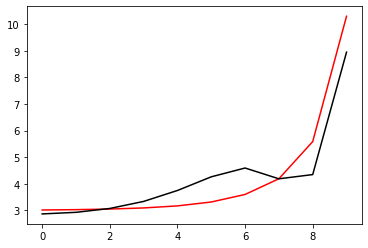

9700 0.010232238109506967
[2.86690608 2.92646617 3.07155986 3.3359419  3.74643254 4.25996907
 4.59241416 4.18954616 4.34820904 8.9478484 ]


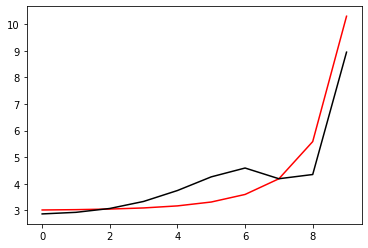

9800 0.010213250251345646
[2.86714316 2.92662672 3.0714946  3.33543744 3.74532657 4.25857633
 4.59229388 4.1923606  4.35092088 8.94740699]


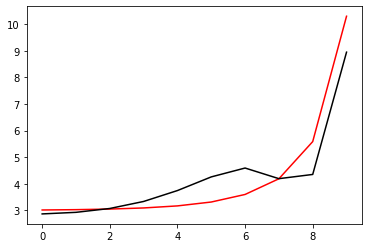

9900 0.010194364015284941
[2.86737874 2.92678622 3.07142971 3.33493597 3.74422657 4.25718909
 4.59217095 4.19516692 4.35362833 8.94696588]


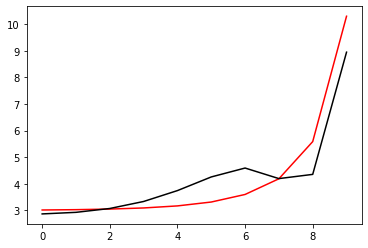

10000 0.010175578628311362
[2.86761284 2.9269447  3.07136517 3.33443746 3.74313249 4.25580734
 4.59204538 4.19796514 4.35633141 8.94652506]


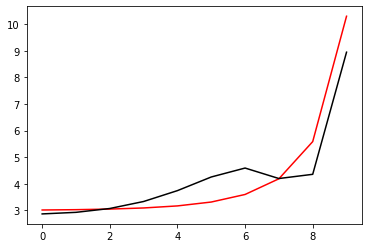

In [32]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.010156893325223045
[2.86784548 2.92710215 3.07130097 3.33394188 3.74204428 4.25443104
 4.59191721 4.20075527 4.35903015 8.94608455]


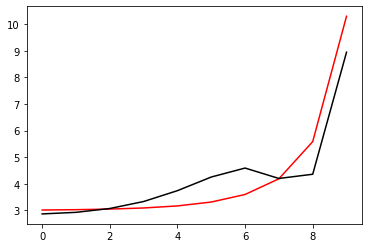

200 0.01013830734857096
[2.86807666 2.92725858 3.07123713 3.3334492  3.74096189 4.25306018
 4.59178647 4.20353736 4.36172454 8.94564435]


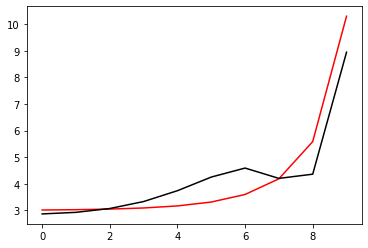

300 0.010119819948594844
[2.86830641 2.92741401 3.07117361 3.33295939 3.73988528 4.25169472
 4.59165319 4.20631142 4.36441462 8.94520444]


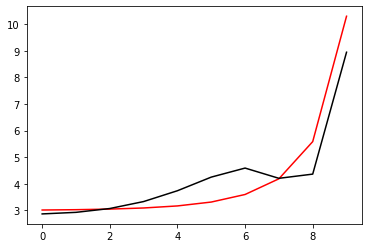

400 0.01010143038308232
[2.86853474 2.92756845 3.07111044 3.33247242 3.7388144  4.25033465
 4.5915174  4.20907747 4.36710039 8.94476483]


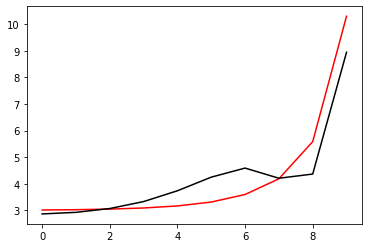

500 0.010083137917340858
[2.86876166 2.9277219  3.07104758 3.33198827 3.73774921 4.24897995
 4.59137913 4.21183555 4.36978187 8.94432552]


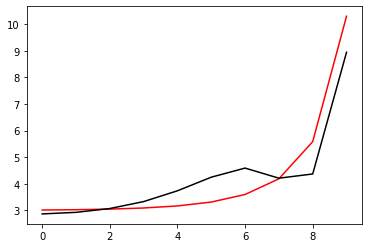

600 0.010064941823970082
[2.86898718 2.92787436 3.07098505 3.3315069  3.73668965 4.24763058
 4.5912384  4.21458567 4.37245908 8.94388652]


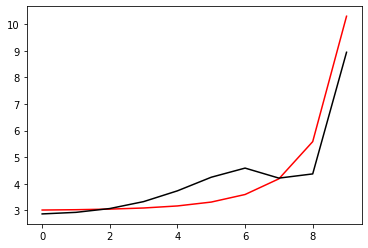

700 0.010046841382946741
[2.86921133 2.92802586 3.07092283 3.33102829 3.73563568 4.24628653
 4.59109525 4.21732786 4.37513203 8.94344781]


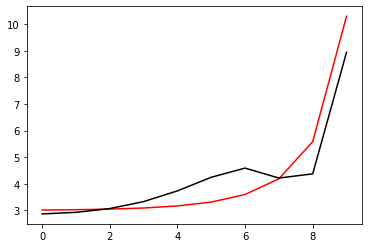

800 0.01002883588140416
[2.86943412 2.9281764  3.07086092 3.33055241 3.73458727 4.24494776
 4.59094971 4.22006214 4.37780073 8.9430094 ]


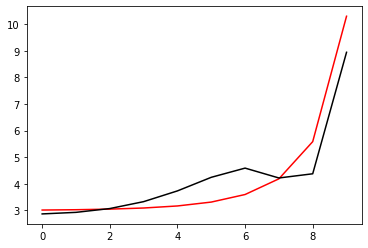

900 0.010010924613572914
[2.86965555 2.92832599 3.07079932 3.33007922 3.73354435 4.24361427
 4.5908018  4.22278854 4.38046521 8.94257128]


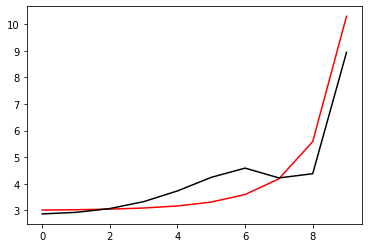

1000 0.009993106880674067
[2.86987565 2.92847463 3.07073801 3.32960872 3.73250689 4.24228602
 4.59065154 4.22550708 4.38312546 8.94213347]


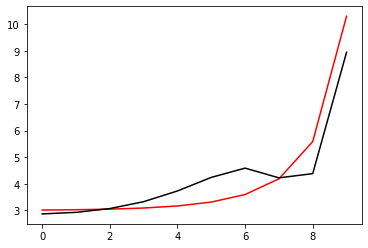

1100 0.00997538199093303
[2.87009442 2.92862233 3.07067699 3.32914086 3.73147485 4.24096298
 4.59049898 4.22821779 4.38578152 8.94169595]


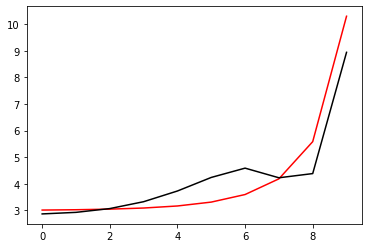

1200 0.009957749259388865
[2.87031188 2.92876911 3.07061627 3.32867562 3.73044818 4.23964514
 4.59034413 4.23092068 4.3884334  8.94125873]


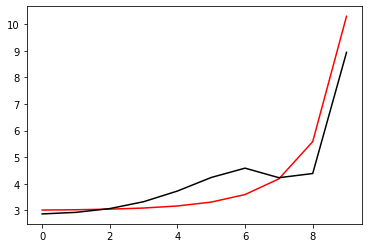

1300 0.009940208007793633
[2.87052805 2.92891497 3.07055583 3.32821298 3.72942683 4.23833248
 4.59018703 4.23361579 4.3910811  8.94082181]


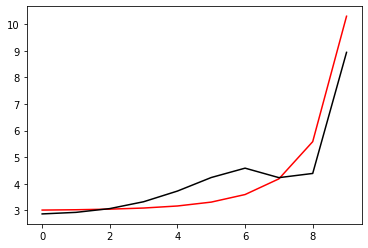

1400 0.009922757564625743
[2.87074293 2.92905991 3.07049566 3.3277529  3.72841078 4.23702496
 4.5900277  4.23630314 4.39372465 8.94038518]


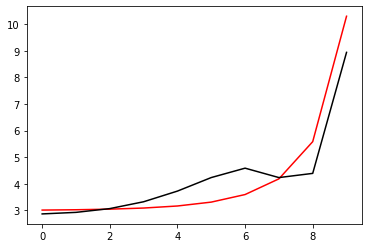

1500 0.00990539726496026
[2.87095654 2.92920396 3.07043577 3.32729538 3.72739996 4.23572256
 4.58986616 4.23898274 4.39636406 8.93994884]


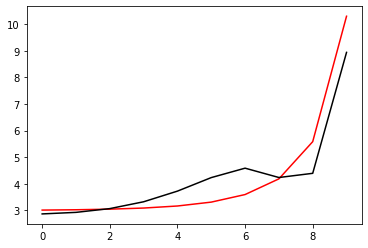

1600 0.009888126450317277
[2.87116889 2.9293471  3.07037615 3.32684037 3.72639435 4.23442527
 4.58970245 4.24165463 4.39899934 8.93951281]


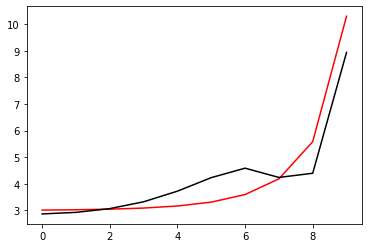

1700 0.009870944468747577
[2.87138    2.92948936 3.0703168  3.32638785 3.7253939  4.23313305
 4.58953658 4.24431883 4.40163051 8.93907706]


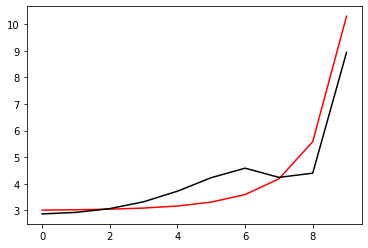

1800 0.009853850674591632
[2.87158987 2.92963074 3.0702577  3.32593781 3.72439856 4.23184588
 4.5893686  4.24697536 4.40425757 8.93864161]


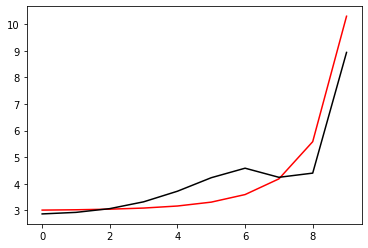

1900 0.00983684442844206
[2.87179852 2.92977125 3.07019886 3.32549021 3.72340831 4.23056375
 4.58919851 4.24962424 4.40688056 8.93820646]


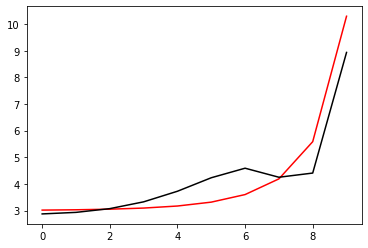

2000 0.009819925097147226
[2.87200596 2.92991089 3.07014027 3.32504504 3.72242309 4.22928662
 4.58902635 4.25226549 4.40949947 8.9377716 ]


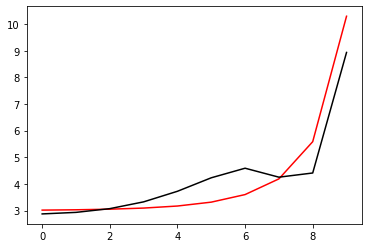

2100 0.009803092053665394
[2.8722122  2.93004968 3.07008193 3.32460226 3.72144287 4.22801447
 4.58885215 4.25489915 4.41211432 8.93733703]


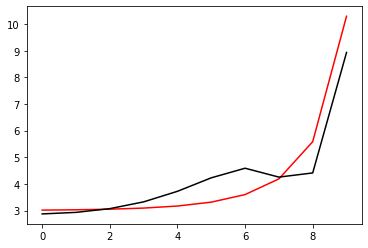

2200 0.00978634467697743
[2.87241726 2.93018762 3.07002384 3.32416186 3.72046761 4.22674728
 4.58867592 4.25752523 4.41472513 8.93690275]


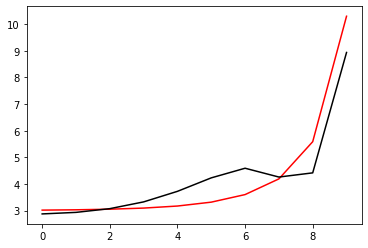

2300 0.009769682352056164
[2.87262114 2.93032471 3.06996598 3.32372381 3.71949727 4.22548503
 4.58849769 4.26014375 4.41733191 8.93646877]


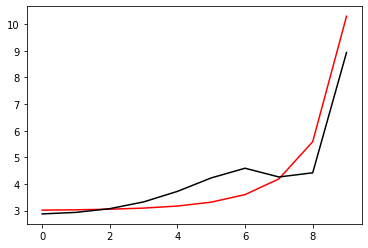

2400 0.009753104469774041
[2.87282386 2.93046097 3.06990836 3.3232881  3.71853181 4.22422768
 4.5883175  4.26275474 4.41993468 8.93603507]


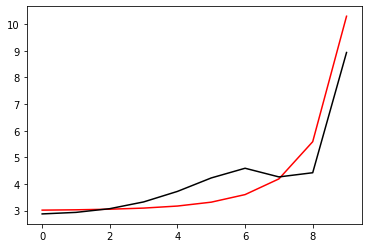

2500 0.009736610426810396
[2.87302542 2.93059641 3.06985097 3.32285469 3.7175712  4.22297523
 4.58813535 4.26535823 4.42253344 8.93560167]


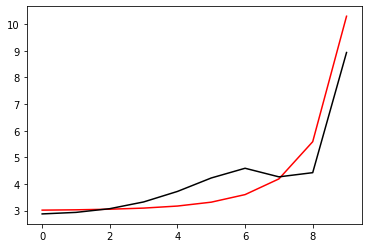

2600 0.00972019962568163
[2.87322585 2.93073102 3.06979381 3.32242356 3.71661539 4.22172764
 4.58795128 4.26795423 4.42512821 8.93516856]


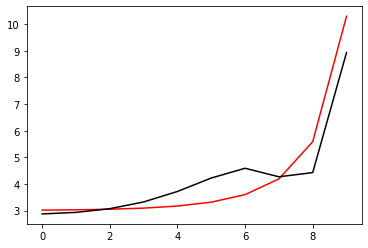

2700 0.00970387147448571
[2.87342515 2.93086482 3.06973687 3.3219947  3.71566434 4.2204849
 4.58776531 4.27054276 4.42771901 8.93473574]


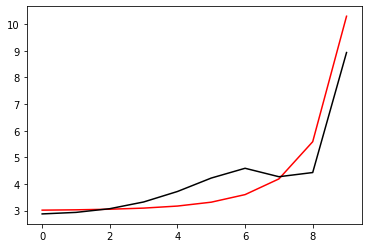

2800 0.009687625387020244
[2.87362333 2.93099782 3.06968015 3.32156808 3.71471803 4.21924697
 4.58757746 4.27312386 4.43030584 8.93430321]


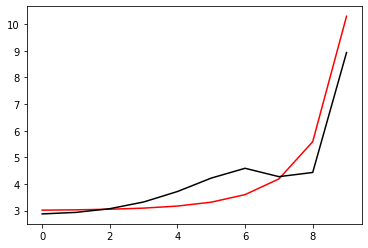

2900 0.009671460782623223
[2.8738204  2.93113001 3.06962365 3.32114368 3.71377641 4.21801384
 4.58738776 4.27569753 4.43288873 8.93387097]


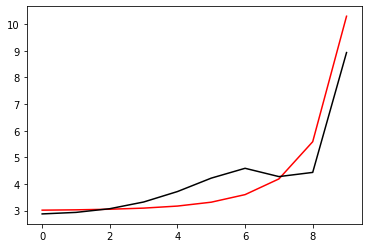

3000 0.00965537708609452
[2.87401637 2.93126142 3.06956737 3.32072149 3.71283945 4.21678548
 4.58719624 4.27826381 4.43546768 8.93343902]


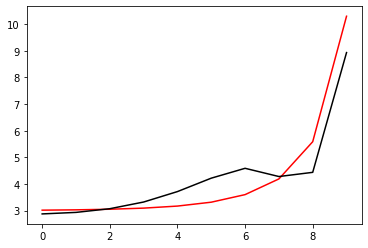

3100 0.009639373727672994
[2.87421126 2.93139204 3.06951129 3.32030147 3.7119071  4.21556187
 4.5870029  4.28082272 4.4380427  8.93300736]


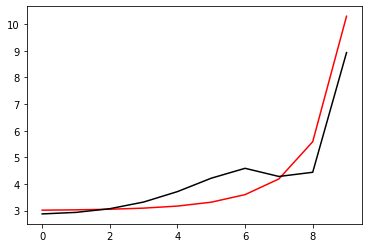

3200 0.009623450142977996
[2.87440507 2.93152188 3.06945542 3.31988361 3.71097934 4.21434299
 4.58680778 4.28337427 4.44061382 8.93257598]


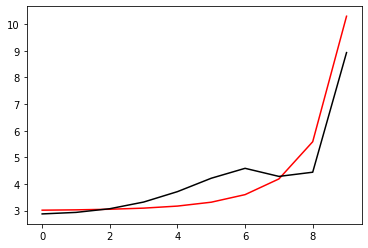

3300 0.009607605772881868
[2.87459781 2.93165095 3.06939976 3.31946789 3.71005613 4.21312881
 4.5866109  4.2859185  4.44318103 8.9321449 ]


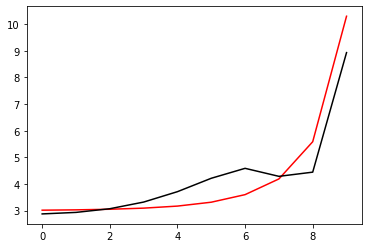

3400 0.009591840063506874
[2.8747895  2.93177926 3.0693443  3.31905429 3.70913743 4.21191932
 4.58641229 4.28845541 4.44574436 8.9317141 ]


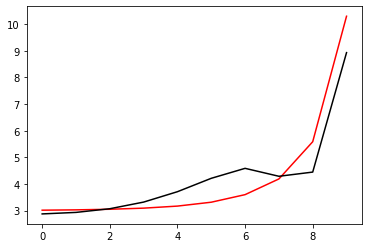

3500 0.009576152466151084
[2.87498015 2.93190681 3.06928903 3.31864278 3.70822321 4.21071448
 4.58621195 4.29098505 4.44830382 8.93128359]


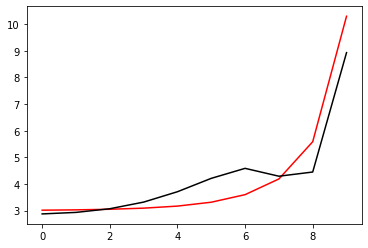

3600 0.009560542437200146
[2.87516975 2.9320336  3.06923396 3.31823336 3.70731343 4.20951428
 4.58600993 4.29350742 4.45085942 8.93085336]


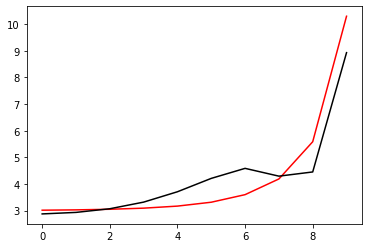

3700 0.009545009438125533
[2.87535833 2.93215965 3.06917908 3.317826   3.70640807 4.20831869
 4.58580623 4.29602255 4.45341117 8.93042343]


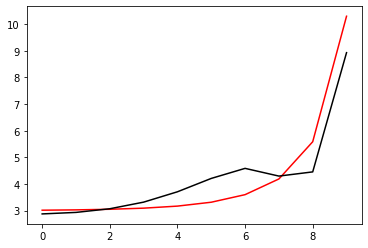

3800 0.009529552935361035
[2.8755459  2.93228497 3.06912439 3.31742067 3.70550708 4.20712769
 4.58560088 4.29853045 4.45595909 8.92999377]


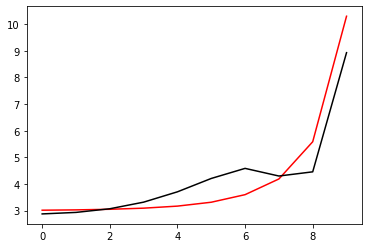

3900 0.009514172400224306
[2.87573245 2.93240955 3.06906989 3.31701737 3.70461043 4.20594125
 4.5853939  4.30103117 4.45850319 8.92956441]


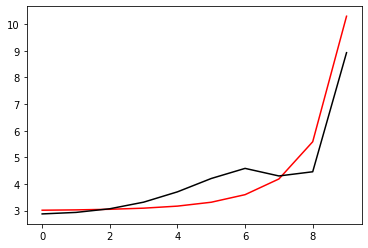

4000 0.009498867308980604
[2.87591801 2.9325334  3.06901557 3.31661608 3.70371809 4.20475937
 4.58518532 4.3035247  4.46104347 8.92913533]


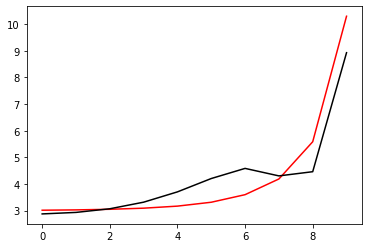

4100 0.009483637142697732
[2.87610258 2.93265654 3.06896143 3.31621677 3.70283002 4.203582
 4.58497515 4.30601108 4.46357996 8.92870653]


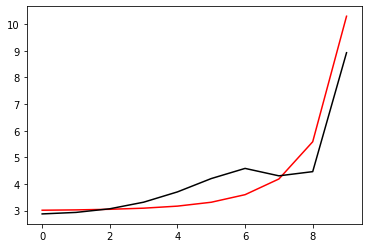

4200 0.009468481387154032
[2.87628617 2.93277896 3.06890747 3.31581942 3.7019462  4.20240914
 4.58476341 4.30849033 4.46611266 8.92827802]


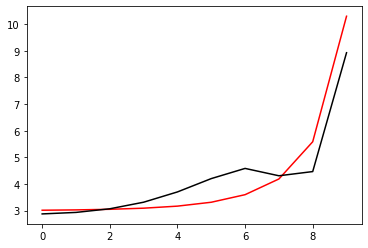

4300 0.009453399532892552
[2.87646879 2.93290067 3.06885368 3.31542403 3.70106659 4.20124076
 4.58455013 4.31096247 4.46864159 8.92784979]


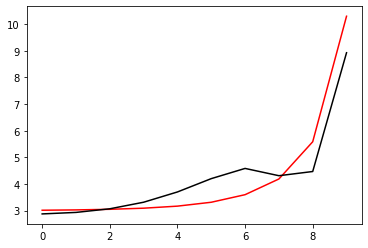

4400 0.009438391075042676
[2.87665045 2.93302168 3.06880007 3.31503057 3.70019116 4.20007683
 4.58433532 4.31342751 4.47116675 8.92742185]


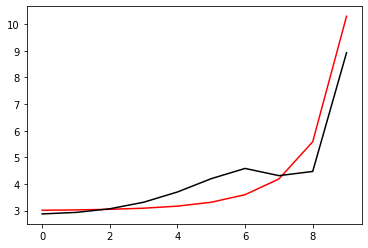

4500 0.009423455513349777
[2.87683116 2.933142   3.06874663 3.31463902 3.69931988 4.19891734
 4.58411901 4.31588549 4.47368817 8.92699419]


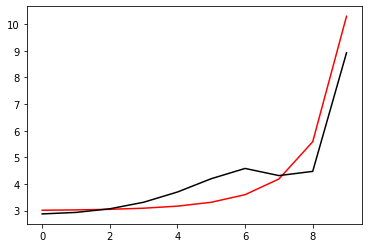

4600 0.009408592352129841
[2.87701092 2.93326163 3.06869335 3.31424937 3.69845271 4.19776226
 4.58390121 4.31833642 4.47620585 8.92656681]


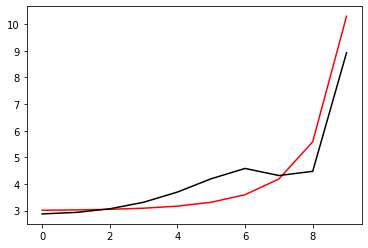

4700 0.009393801100139772
[2.87718975 2.93338057 3.06864024 3.3138616  3.69758963 4.19661157
 4.58368195 4.32078032 4.4787198  8.92613972]


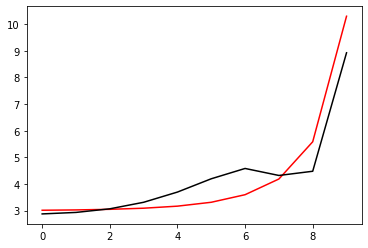

4800 0.009379081270624642
[2.87736765 2.93349884 3.0685873  3.3134757  3.6967306  4.19546525
 4.58346125 4.32321722 4.48123004 8.9257129 ]


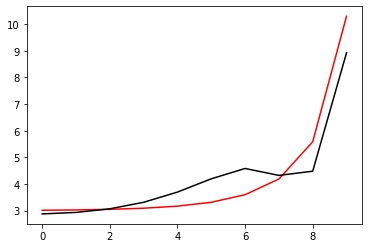

4900 0.009364432381177951
[2.87754464 2.93361644 3.06853451 3.31309164 3.6958756  4.19432328
 4.58323912 4.32564714 4.48373658 8.92528637]


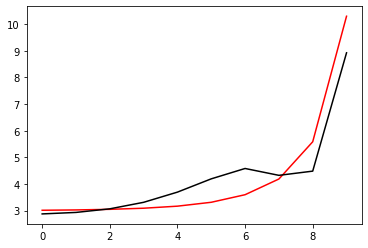

5000 0.00934985395369706
[2.87772071 2.93373336 3.06848188 3.31270941 3.69502459 4.19318563
 4.58301559 4.32807009 4.48623942 8.92486012]


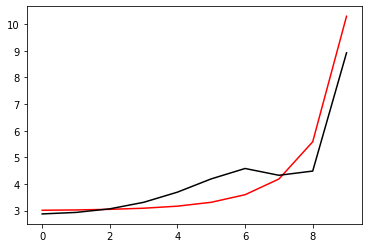

5100 0.009335345514460854
[2.87789588 2.93384963 3.06842941 3.312329   3.69417754 4.19205229
 4.58279067 4.3304861  4.48873859 8.92443415]


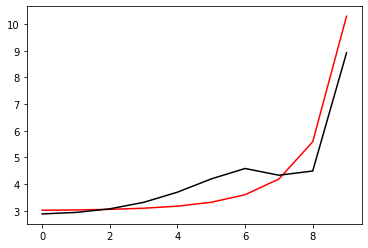

5200 0.009320906593890694
[2.87807016 2.93396524 3.0683771  3.31195038 3.69333443 4.19092322
 4.58256438 4.33289519 4.49123409 8.92400847]


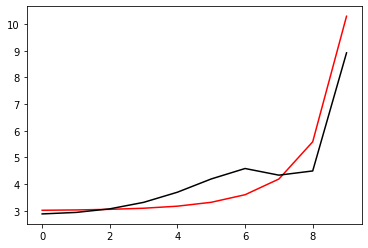

5300 0.009306536726667407
[2.87824355 2.9340802  3.06832494 3.31157355 3.69249522 4.18979842
 4.58233675 4.33529738 4.49372593 8.92358306]


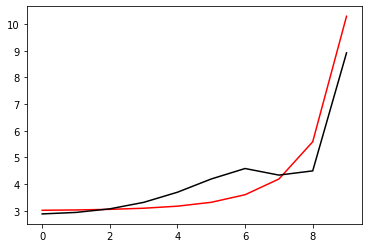

5400 0.009292235451538372
[2.87841607 2.93419452 3.06827293 3.31119849 3.69165988 4.18867786
 4.58210778 4.33769269 4.49621413 8.92315793]


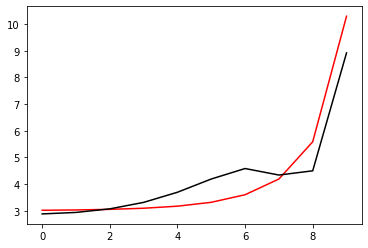

5500 0.009278002311421639
[2.87858771 2.9343082  3.06822106 3.31082518 3.69082839 4.18756152
 4.58187751 4.34008114 4.49869869 8.92273308]


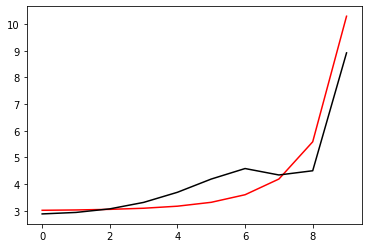

5600 0.009263836853209584
[2.87875849 2.93442125 3.06816935 3.3104536  3.69000072 4.18644938
 4.58164594 4.34246276 4.50117963 8.92230851]


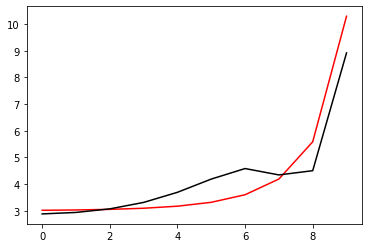

5700 0.00924973862783744
[2.87892842 2.93453367 3.06811777 3.31008375 3.68917684 4.18534141
 4.58141309 4.34483755 4.50365696 8.92188422]


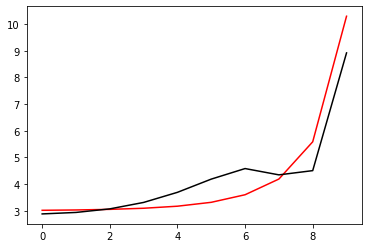

5800 0.009235707190203685
[2.8790975  2.93464546 3.06806634 3.3097156  3.68835672 4.1842376
 4.58117899 4.34720555 4.50613068 8.92146021]


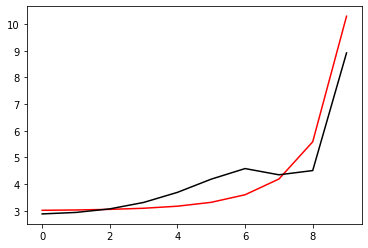

5900 0.009221742099115514
[2.87926574 2.93475664 3.06801506 3.30934915 3.68754034 4.18313792
 4.58094365 4.34956677 4.50860082 8.92103648]


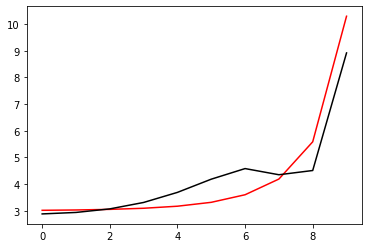

6000 0.009207842917200946
[2.87943315 2.9348672  3.06796391 3.30898437 3.68672766 4.18204236
 4.58070709 4.35192124 4.51106738 8.92061302]


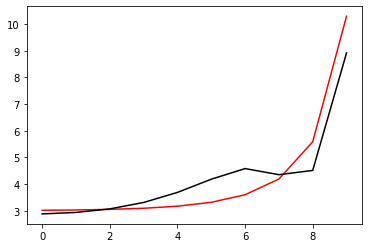

6100 0.009194009210948957
[2.87959974 2.93497716 3.0679129  3.30862126 3.68591866 4.18095089
 4.58046932 4.35426897 4.51353037 8.92018984]


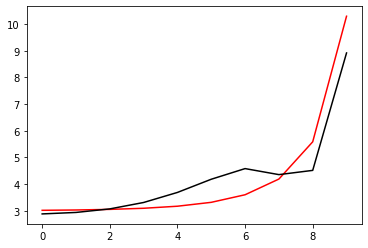

6200 0.009180240550653012
[2.8797655  2.93508652 3.06786202 3.30825979 3.68511331 4.17986349
 4.58023037 4.35660998 4.51598981 8.91976694]


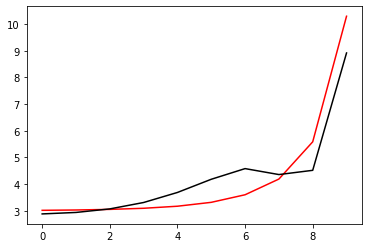

6300 0.009166536510315466
[2.87993046 2.93519528 3.06781128 3.30789997 3.68431158 4.17878014
 4.57999025 4.3589443  4.5184457  8.91934431]


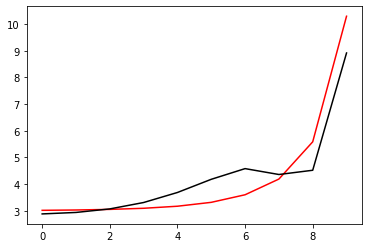

6400 0.00915289666761
[2.88009461 2.93530344 3.06776067 3.30754176 3.68351346 4.17770083
 4.57974897 4.36127194 4.52089805 8.91892196]


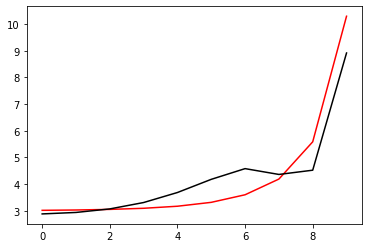

6500 0.009139320603931769
[2.88025797 2.93541102 3.06771019 3.30718516 3.68271891 4.17662552
 4.57950656 4.36359293 4.52334688 8.91849989]


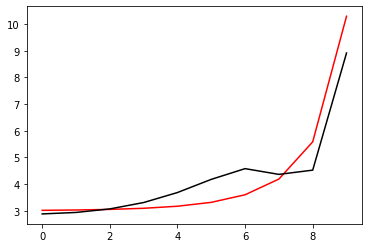

6600 0.009125807904231922
[2.88042053 2.93551801 3.06765984 3.30683015 3.6819279  4.17555421
 4.57926303 4.36590728 4.5257922  8.91807809]


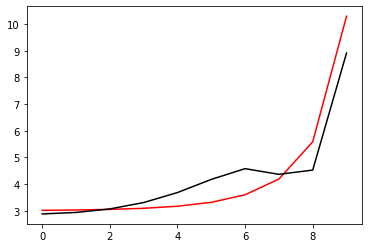

6700 0.009112358157066947
[2.88058231 2.93562443 3.06760962 3.30647673 3.68114042 4.17448687
 4.5790184  4.36821502 4.52823401 8.91765657]


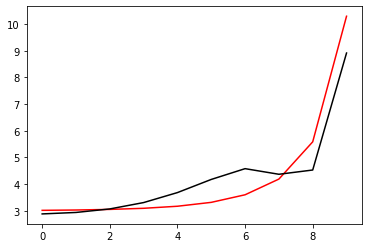

6800 0.009098970954532024
[2.88074332 2.93573028 3.06755953 3.30612488 3.68035643 4.17342348
 4.57877268 4.37051616 4.53067233 8.91723532]


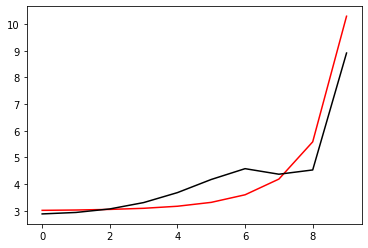

6900 0.00908564589223176
[2.88090356 2.93583555 3.06750956 3.30577458 3.67957591 4.17236402
 4.57852589 4.37281072 4.53310716 8.91681435]


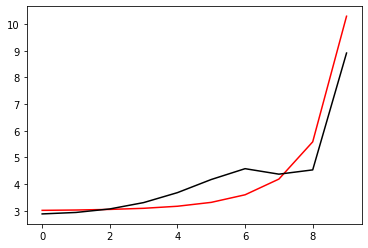

7000 0.00907238256918259
[2.88106303 2.93594026 3.06745971 3.30542582 3.67879884 4.17130847
 4.57827805 4.37509873 4.53553853 8.91639364]


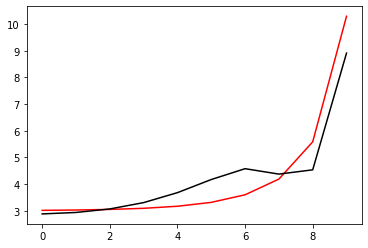

7100 0.009059180587879242
[2.88122174 2.93604442 3.06740999 3.30507859 3.67802518 4.17025681
 4.57802916 4.3773802  4.53796643 8.91597322]


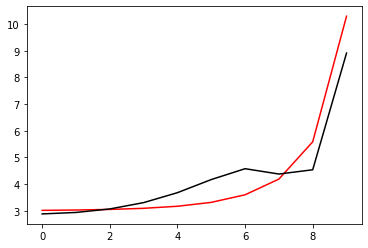

7200 0.009046039554138914
[2.88137971 2.93614801 3.06736039 3.30473288 3.67725493 4.16920902
 4.57777926 4.37965516 4.54039088 8.91555306]


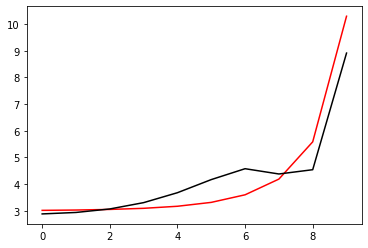

7300 0.009032959077170437
[2.88153693 2.93625106 3.0673109  3.30438867 3.67648804 4.16816509
 4.57752835 4.38192362 4.54281188 8.91513318]


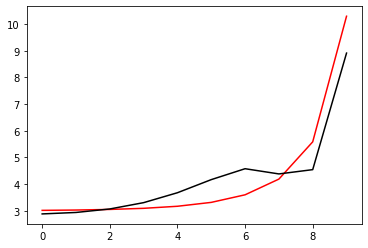

7400 0.009019938769482455
[2.88169341 2.93635356 3.06726154 3.30404596 3.6757245  4.16712499
 4.57727644 4.3841856  4.54522946 8.91471358]


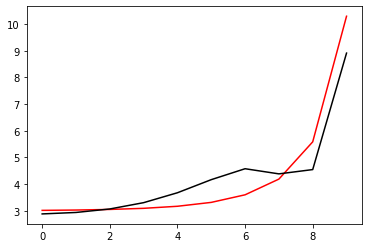

7500 0.009006978246884543
[2.88184917 2.93645552 3.06721229 3.30370472 3.67496429 4.1660887
 4.57702356 4.38644113 4.54764362 8.91429424]


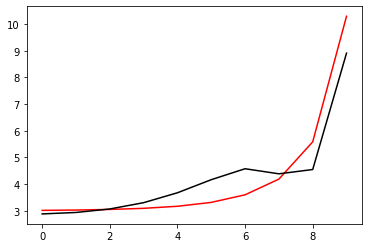

7600 0.00899407712834326
[2.88200419 2.93655695 3.06716316 3.30336496 3.67420738 4.1650562
 4.57676972 4.38869021 4.55005436 8.91387518]


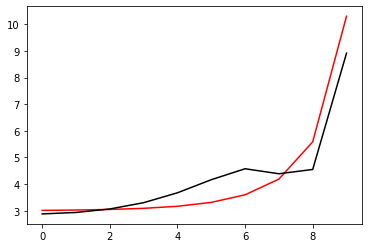

7700 0.008981235036111385
[2.8821585  2.93665784 3.06711414 3.30302665 3.67345374 4.16402748
 4.57651493 4.39093288 4.5524617  8.91345638]


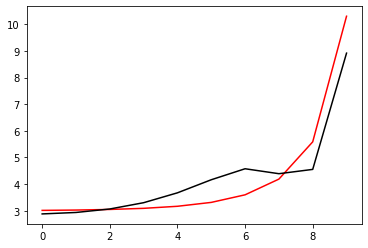

7800 0.008968451595605472
[2.88231209 2.9367582  3.06706524 3.30268978 3.67270336 4.16300251
 4.57625921 4.39316914 4.55486565 8.91303786]


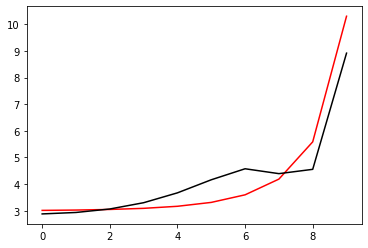

7900 0.008955726435306614
[2.88246497 2.93685804 3.06701645 3.30235435 3.6719562  4.16198128
 4.57600258 4.39539903 4.55726622 8.91261961]


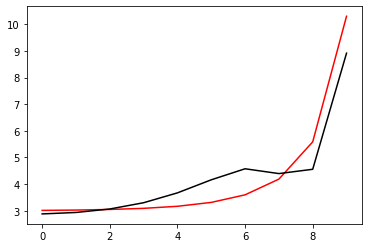

8000 0.00894305918688783
[2.88261716 2.93695736 3.06696777 3.30202034 3.67121226 4.16096377
 4.57574504 4.39762255 4.55966342 8.91220163]


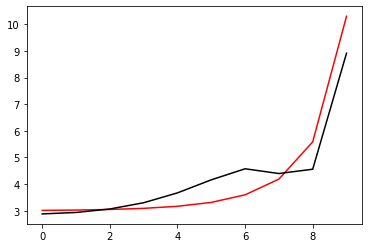

8100 0.008930449485036986
[2.88276864 2.93705617 3.0669192  3.30168775 3.6704715  4.15994996
 4.57548661 4.39983973 4.56205725 8.91178392]


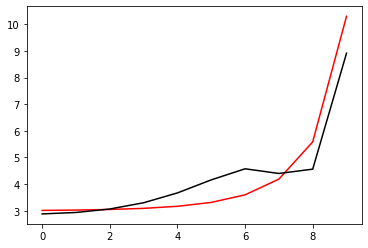

8200 0.008917896967502715
[2.88291944 2.93715446 3.06687073 3.30135655 3.6697339  4.15893982
 4.57522731 4.40205059 4.56444773 8.91136648]


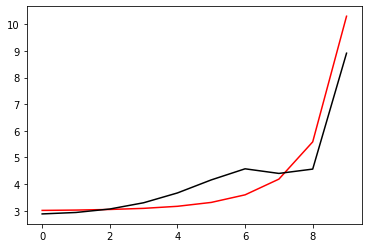

8300 0.008905401275006771
[2.88306955 2.93725224 3.06682238 3.30102674 3.66899944 4.15793335
 4.57496715 4.40425514 4.56683487 8.91094931]


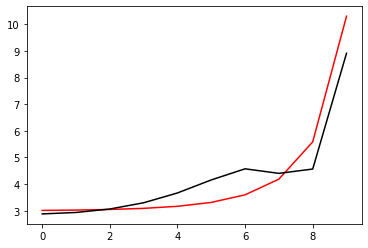

8400 0.008892962051256472
[2.88321898 2.93734952 3.06677413 3.30069831 3.6682681  4.15693052
 4.57470614 4.40645341 4.56921868 8.91053241]


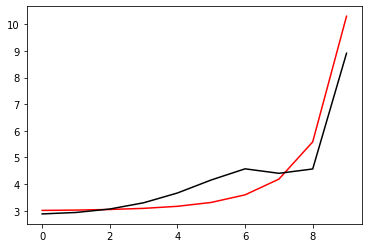

8500 0.008880578942905799
[2.88336773 2.93744631 3.06672599 3.30037124 3.66753986 4.15593131
 4.5744443  4.40864541 4.57159916 8.91011578]


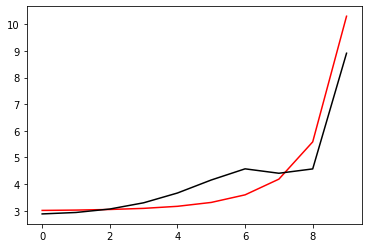

8600 0.008868251599518394
[2.88351582 2.93754259 3.06667796 3.30004553 3.6668147  4.15493571
 4.57418165 4.41083116 4.57397633 8.90969941]


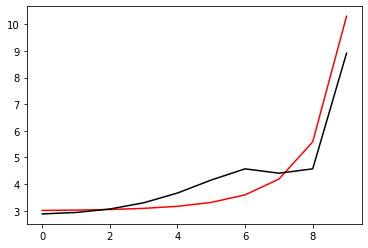

8700 0.008855979673551045
[2.88366324 2.93763839 3.06663003 3.29972117 3.66609258 4.15394369
 4.57391818 4.41301069 4.57635019 8.90928331]


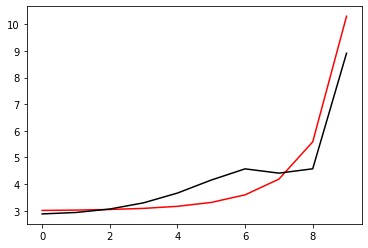

8800 0.008843762820261895
[2.88381001 2.93773369 3.0665822  3.29939814 3.66537351 4.15295525
 4.57365393 4.415184   4.57872076 8.90886748]


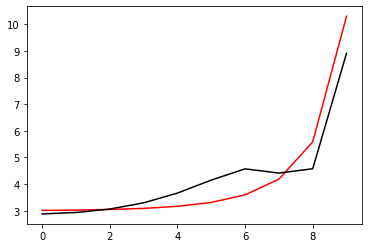

8900 0.00883160069778199
[2.88395612 2.93782852 3.06653447 3.29907644 3.66465744 4.15197035
 4.5733889  4.41735112 4.58108804 8.90845192]


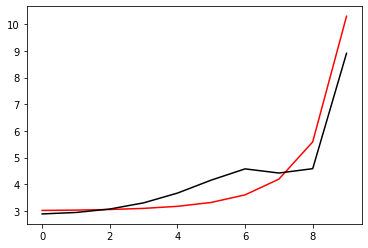

9000 0.008819492966968955
[2.88410159 2.93792286 3.06648684 3.29875606 3.66394436 4.15098899
 4.57312311 4.41951207 4.58345205 8.90803663]


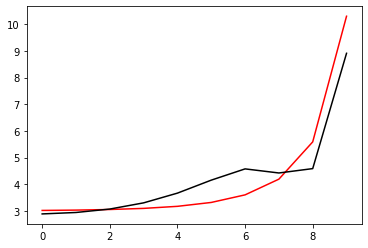

9100 0.008807439291482828
[2.88424641 2.93801673 3.06643932 3.29843697 3.66323426 4.15001114
 4.57285656 4.42166687 4.58581279 8.9076216 ]


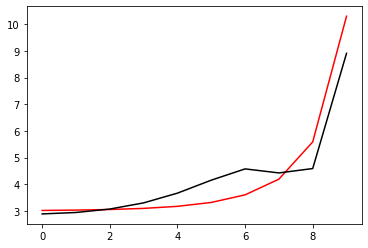

9200 0.008795439337754483
[2.88439059 2.93811012 3.06639189 3.29811919 3.66252711 4.14903679
 4.57258927 4.42381553 4.58817026 8.90720684]


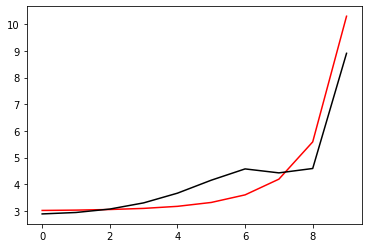

9300 0.008783492774810022
[2.88453414 2.93820305 3.06634457 3.29780269 3.66182288 4.14806592
 4.57232126 4.42595807 4.59052449 8.90679234]


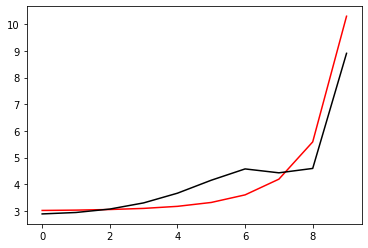

9400 0.00877159927442689
[2.88467707 2.93829551 3.06629734 3.29748746 3.66112157 4.14709852
 4.57205254 4.42809451 4.59287548 8.90637811]


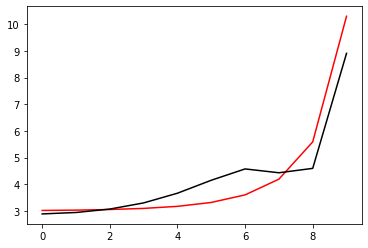

9500 0.008759758510997008
[2.88481937 2.93838751 3.0662502  3.2971735  3.66042315 4.14613455
 4.57178311 4.43022487 4.59522324 8.90596415]


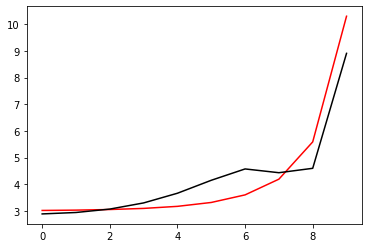

9600 0.008747970161583244
[2.88496105 2.93847905 3.06620317 3.2968608  3.6597276  4.14517402
 4.571513   4.43234917 4.59756778 8.90555045]


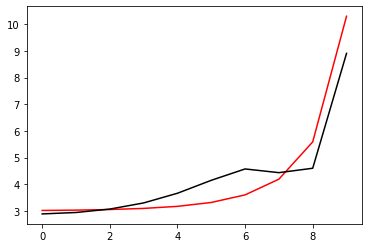

9700 0.008736233905770621
[2.88510213 2.93857014 3.06615623 3.29654935 3.6590349  4.14421689
 4.57124221 4.43446742 4.5999091  8.90513701]


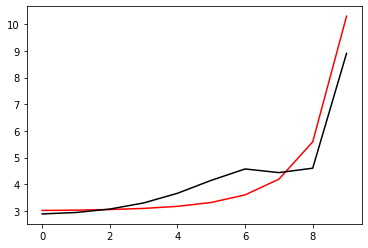

9800 0.008724549425737652
[2.88524259 2.93866077 3.06610938 3.29623913 3.65834503 4.14326315
 4.57097075 4.43657965 4.60224722 8.90472384]


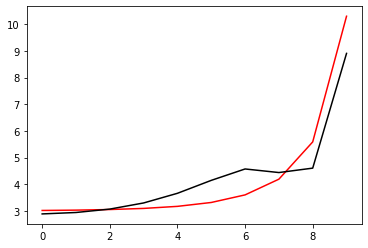

9900 0.008712916406225965
[2.88538245 2.93875096 3.06606263 3.29593014 3.65765798 4.14231279
 4.57069865 4.43868586 4.60458215 8.90431093]


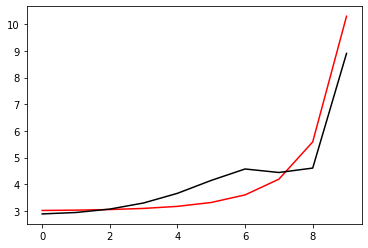

10000 0.008701334534448584
[2.88552171 2.9388407  3.06601597 3.29562237 3.65697372 4.14136579
 4.5704259  4.44078609 4.60691388 8.90389829]


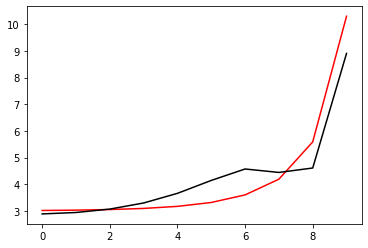

In [33]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.008689803500135342
[2.88566037 2.93893001 3.06596941 3.29531581 3.65629223 4.14042213
 4.57015252 4.44288035 4.60924244 8.90348591]


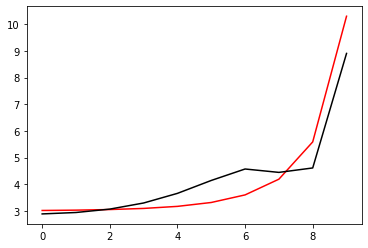

200 0.008678322995455744
[2.88579844 2.93901887 3.06592293 3.29501046 3.6556135  4.13948179
 4.56987853 4.44496865 4.61156783 8.90307379]


300 0.008666892715037063
[2.88593593 2.93910731 3.06587655 3.2947063  3.65493751 4.13854476
 4.56960393 4.44705101 4.61389006 8.90266194]


400 0.00865551235592707
[2.88607284 2.93919531 3.06583026 3.29440332 3.65426424 4.13761103
 4.56932874 4.44912746 4.61620914 8.90225035]


500 0.008644181617517104
[2.88620917 2.93928288 3.06578406 3.29410152 3.65359368 4.13668056
 4.56905297 4.45119801 4.61852508 8.90183902]


600 0.008632900201603698
[2.88634493 2.93937003 3.06573794 3.29380088 3.65292579 4.13575335
 4.56877663 4.45326267 4.62083788 8.90142795]


700 0.008621667812309726
[2.88648012 2.93945676 3.06569192 3.29350141 3.65226058 4.13482939
 4.56849972 4.45532147 4.62314755 8.90101714]


800 0.008610484156065513
[2.88661475 2.93954307 3.06564598 3.29320309 3.65159801 4.13390865
 4.56822227 4.45737442 4.62545411 8.90060659]


900 0.008599348941642413
[2.88674881 2.93962897 3.06560014 3.2929059  3.65093807 4.13299111
 4.56794428 4.45942153 4.62775755 8.90019631]


1000 0.00858826187999126
[2.88688232 2.93971446 3.06555438 3.29260986 3.65028075 4.13207677
 4.56766576 4.46146284 4.6300579  8.89978628]


1100 0.008577222684376388
[2.88701528 2.93979953 3.0655087  3.29231494 3.64962603 4.13116561
 4.56738673 4.46349835 4.63235515 8.89937652]


1200 0.008566231070285025
[2.88714769 2.93988421 3.06546311 3.29202114 3.64897389 4.1302576
 4.56710718 4.46552808 4.63464932 8.89896701]


1300 0.008555286755410129
[2.88727956 2.93996848 3.06541761 3.29172845 3.6483243  4.12935274
 4.56682715 4.46755206 4.63694041 8.89855777]


1400 0.00854438945958013
[2.88741089 2.94005235 3.06537219 3.29143686 3.64767727 4.12845101
 4.56654662 4.46957029 4.63922844 8.89814878]


1500 0.008533538904849675
[2.88754168 2.94013582 3.06532686 3.29114637 3.64703277 4.12755239
 4.56626563 4.47158279 4.6415134  8.89774005]


1600 0.00852273481535757
[2.88767194 2.9402189  3.06528161 3.29085696 3.64639078 4.12665687
 4.56598416 4.47358958 4.64379532 8.89733158]


1700 0.008511976917368077
[2.88780167 2.94030159 3.06523644 3.29056864 3.64575128 4.12576443
 4.56570224 4.47559068 4.64607419 8.89692337]


1800 0.008501264939282391
[2.88793088 2.9403839  3.06519136 3.29028139 3.64511427 4.12487506
 4.56541988 4.47758611 4.64835002 8.89651541]


1900 0.008490598611515732
[2.88805957 2.94046581 3.06514636 3.2899952  3.64447973 4.12398873
 4.56513708 4.47957588 4.65062283 8.89610772]


2000 0.0084799776666257
[2.88818774 2.94054735 3.06510144 3.28971008 3.64384763 4.12310545
 4.56485386 4.48156001 4.65289261 8.89570028]


2100 0.00846940183910775
[2.8883154  2.94062851 3.0650566  3.289426   3.64321797 4.12222518
 4.56457022 4.48353852 4.65515939 8.8952931 ]


2200 0.00845887086554483
[2.88844254 2.94070929 3.06501184 3.28914297 3.64259073 4.12134792
 4.56428617 4.48551141 4.65742316 8.89488617]


2300 0.008448384484481403
[2.88856919 2.9407897  3.06496717 3.28886097 3.64196589 4.12047365
 4.56400172 4.48747872 4.65968393 8.8944795 ]


2400 0.008437942436459884
[2.88869533 2.94086973 3.06492257 3.28858001 3.64134344 4.11960235
 4.56371689 4.48944046 4.66194172 8.89407309]


2500 0.008427544463945481
[2.88882097 2.9409494  3.06487806 3.28830007 3.64072336 4.11873402
 4.56343168 4.49139664 4.66419652 8.89366693]


2600 0.008417190311409757
[2.88894611 2.94102871 3.06483362 3.28802114 3.64010564 4.11786863
 4.5631461  4.49334727 4.66644836 8.89326103]


2700 0.008406879725159293
[2.88907077 2.94110765 3.06478926 3.28774322 3.63949026 4.11700617
 4.56286016 4.49529239 4.66869722 8.89285538]


2800 0.008396612453456572
[2.88919493 2.94118623 3.06474498 3.28746631 3.63887721 4.11614662
 4.56257386 4.497232   4.67094313 8.89244998]


2900 0.008386388246450955
[2.88931861 2.94126445 3.06470078 3.28719039 3.63826648 4.11528998
 4.56228723 4.49916612 4.67318609 8.89204485]


3000 0.008376206856174875
[2.88944181 2.94134232 3.06465666 3.28691546 3.63765804 4.11443623
 4.56200026 4.50109476 4.67542611 8.89163996]


3100 0.008366068036402177
[2.88956453 2.94141983 3.06461262 3.28664152 3.63705189 4.11358535
 4.56171296 4.50301795 4.67766319 8.89123533]


3200 0.008355971542896249
[2.88968677 2.941497   3.06456865 3.28636855 3.63644801 4.11273733
 4.56142535 4.50493569 4.67989735 8.89083095]


3300 0.00834591713311748
[2.88980854 2.94157381 3.06452476 3.28609655 3.63584639 4.11189216
 4.56113743 4.50684801 4.68212858 8.89042683]


3400 0.008335904566355565
[2.88992985 2.94165029 3.06448095 3.28582552 3.63524701 4.11104981
 4.56084921 4.50875493 4.68435691 8.89002296]


3500 0.008325933603713285
[2.89005069 2.94172642 3.06443721 3.28555544 3.63464986 4.11021028
 4.5605607  4.51065645 4.68658232 8.88961934]


3600 0.008316004007962497
[2.89017106 2.94180221 3.06439355 3.28528632 3.63405492 4.10937356
 4.5602719  4.51255259 4.68880484 8.88921597]


3700 0.00830611554375086
[2.89029098 2.94187766 3.06434996 3.28501814 3.63346218 4.10853962
 4.55998283 4.51444338 4.69102447 8.88881286]


3800 0.008296267977349609
[2.89041044 2.94195278 3.06430645 3.2847509  3.63287164 4.10770846
 4.55969349 4.51632882 4.69324122 8.88840999]


3900 0.00828646107682203
[2.89052944 2.94202756 3.06426302 3.28448459 3.63228327 4.10688006
 4.55940389 4.51820893 4.69545509 8.88800738]


4000 0.008276694611842914
[2.890648   2.94210201 3.06421966 3.28421921 3.63169706 4.1060544
 4.55911404 4.52008373 4.69766609 8.88760502]


4100 0.008266968353858475
[2.89076611 2.94217614 3.06417637 3.28395476 3.63111299 4.10523149
 4.55882395 4.52195324 4.69987423 8.88720291]


4200 0.008257282075916372
[2.89088378 2.94224994 3.06413316 3.28369122 3.63053107 4.10441129
 4.55853362 4.52381747 4.70207951 8.88680105]


4300 0.008247635552756486
[2.891001   2.94232341 3.06409002 3.28342859 3.62995126 4.1035938
 4.55824306 4.52567643 4.70428195 8.88639944]


4400 0.008238028560718494
[2.89111778 2.94239656 3.06404696 3.28316686 3.62937357 4.102779
 4.55795228 4.52753014 4.70648155 8.88599808]


4500 0.008228460877808538
[2.89123413 2.9424694  3.06400397 3.28290604 3.62879797 4.10196689
 4.55766129 4.52937862 4.70867831 8.88559697]


4600 0.008218932283620906
[2.89135005 2.94254191 3.06396105 3.2826461  3.62822446 4.10115744
 4.55737009 4.53122188 4.71087225 8.88519611]


4700 0.008209442559270252
[2.89146554 2.94261412 3.06391821 3.28238706 3.62765302 4.10035065
 4.55707869 4.53305994 4.71306336 8.8847955 ]


4800 0.008199991487569369
[2.8915806  2.94268601 3.06387543 3.28212889 3.62708363 4.0995465
 4.5567871  4.53489282 4.71525167 8.88439514]


4900 0.008190578852804168
[2.89169523 2.94275758 3.06383273 3.28187161 3.6265163  4.09874498
 4.55649532 4.53672053 4.71743717 8.88399502]


5000 0.00818120444084978
[2.89180945 2.94282885 3.0637901  3.28161519 3.625951   4.09794608
 4.55620337 4.53854308 4.71961987 8.88359515]


5100 0.008171868039103337
[2.89192324 2.94289982 3.06374755 3.28135965 3.62538772 4.09714978
 4.55591124 4.54036049 4.72179977 8.88319553]


5200 0.008162569436479153
[2.89203662 2.94297048 3.06370506 3.28110496 3.62482645 4.09635607
 4.55561896 4.54217278 4.7239769  8.88279616]


5300 0.0081533084234187
[2.89214958 2.94304083 3.06366265 3.28085113 3.62426719 4.09556493
 4.55532651 4.54397996 4.72615124 8.88239704]


5400 0.008144084791798253
[2.89226214 2.94311089 3.06362031 3.28059815 3.62370991 4.09477637
 4.55503392 4.54578204 4.72832281 8.88199816]


5500 0.008134898335057053
[2.89237428 2.94318065 3.06357804 3.28034601 3.6231546  4.09399035
 4.55474118 4.54757905 4.73049162 8.88159953]


5600 0.00812574884804148
[2.89248602 2.94325011 3.06353584 3.28009472 3.62260126 4.09320688
 4.5544483  4.54937099 4.73265767 8.88120115]


5700 0.008116636127053338
[2.89259736 2.94331928 3.06349371 3.27984426 3.62204988 4.09242594
 4.5541553  4.55115789 4.73482097 8.88080301]


5800 0.008107559969877946
[2.89270829 2.94338816 3.06345165 3.27959463 3.62150043 4.09164751
 4.55386217 4.55293975 4.73698152 8.88040512]


5900 0.008098520175631924
[2.89281883 2.94345675 3.06340966 3.27934583 3.62095291 4.09087159
 4.55356892 4.5547166  4.73913933 8.88000747]


6000 0.008089516545009365
[2.89292897 2.94352504 3.06336774 3.27909785 3.62040732 4.09009816
 4.55327556 4.55648845 4.74129441 8.87961007]


6100 0.008080548879924276
[2.89303872 2.94359306 3.06332589 3.27885068 3.61986362 4.08932721
 4.55298209 4.5582553  4.74344677 8.87921291]


6200 0.00807161698383366
[2.89314808 2.94366078 3.06328411 3.27860433 3.61932183 4.08855873
 4.55268853 4.56001719 4.74559641 8.878816  ]


6300 0.00806272066142126
[2.89325705 2.94372823 3.0632424  3.27835878 3.61878192 4.0877927
 4.55239487 4.56177411 4.74774333 8.87841933]


6400 0.0080538597188757
[2.89336563 2.94379539 3.06320076 3.27811403 3.61824389 4.08702912
 4.55210113 4.5635261  4.74988755 8.8780229 ]


6500 0.0080450339636742
[2.89347383 2.94386228 3.06315919 3.27787008 3.61770772 4.08626797
 4.5518073  4.56527315 4.75202907 8.87762672]


6600 0.00803624320462604
[2.89358165 2.94392889 3.06311768 3.27762693 3.61717341 4.08550924
 4.5515134  4.5670153  4.75416789 8.87723079]


6700 0.008027487251865112
[2.89368908 2.94399522 3.06307625 3.27738456 3.61664093 4.08475292
 4.55121943 4.56875254 4.75630403 8.87683509]


6800 0.008018765916931039
[2.89379615 2.94406128 3.06303488 3.27714297 3.61611029 4.08399901
 4.5509254  4.5704849  4.75843748 8.87643964]


6900 0.008010079012512798
[2.89390283 2.94412707 3.06299358 3.27690217 3.61558148 4.08324747
 4.55063131 4.57221239 4.76056827 8.87604443]


7000 0.00800142635274402
[2.89400915 2.94419259 3.06295235 3.27666214 3.61505447 4.08249831
 4.55033717 4.57393503 4.76269638 8.87564947]


7100 0.00799280775295675
[2.89411509 2.94425784 3.06291119 3.27642288 3.61452926 4.08175152
 4.55004298 4.57565282 4.76482183 8.87525474]


7200 0.007984223029778418
[2.89422067 2.94432282 3.0628701  3.27618438 3.61400585 4.08100708
 4.54974875 4.57736579 4.76694463 8.87486026]


7300 0.007975672001102458
[2.89432588 2.94438754 3.06282907 3.27594665 3.61348422 4.08026498
 4.54945448 4.57907395 4.76906477 8.87446602]


7400 0.007967154486070197
[2.89443073 2.944452   3.06278811 3.27570967 3.61296436 4.07952521
 4.54916018 4.58077731 4.77118227 8.87407202]


7500 0.007958670305082235
[2.89453522 2.94451619 3.06274722 3.27547345 3.61244626 4.07878776
 4.54886586 4.58247589 4.77329714 8.87367827]


7600 0.007950219279684456
[2.89463934 2.94458013 3.06270639 3.27523797 3.61192991 4.07805262
 4.54857152 4.5841697  4.77540937 8.87328475]


7700 0.007941801232775228
[2.89474312 2.94464381 3.06266564 3.27500324 3.6114153  4.07731978
 4.54827716 4.58585875 4.77751898 8.87289147]


7800 0.007933415988336232
[2.89484653 2.94470723 3.06262494 3.27476925 3.61090243 4.07658922
 4.5479828  4.58754307 4.77962596 8.87249843]


7900 0.007925063371629373
[2.89494959 2.9447704  3.06258432 3.274536   3.61039128 4.07586094
 4.54768843 4.58922266 4.78173034 8.87210564]


8000 0.007916743209063982
[2.89505231 2.94483332 3.06254376 3.27430347 3.60988184 4.07513493
 4.54739406 4.59089754 4.7838321  8.87171308]


8100 0.007908455328269805
[2.89515467 2.94489598 3.06250327 3.27407168 3.6093741  4.07441117
 4.54709969 4.59256772 4.78593127 8.87132076]


8200 0.007900199557965042
[2.89525669 2.94495839 3.06246285 3.27384061 3.60886806 4.07368965
 4.54680534 4.59423322 4.78802784 8.87092868]


8300 0.007891975728110743
[2.89535836 2.94502056 3.06242249 3.27361027 3.60836371 4.07297037
 4.546511   4.59589405 4.79012182 8.87053684]


8400 0.007883783669770182
[2.89545969 2.94508248 3.06238219 3.27338063 3.60786103 4.07225331
 4.54621668 4.59755022 4.79221321 8.87014524]


8500 0.007875623215145065
[2.89556068 2.94514415 3.06234197 3.27315171 3.60736001 4.07153846
 4.54592239 4.59920175 4.79430203 8.86975388]


8600 0.007867494197578272
[2.89566133 2.94520558 3.06230181 3.2729235  3.60686066 4.07082582
 4.54562812 4.60084865 4.79638827 8.86936275]


8700 0.007859396451523462
[2.89576164 2.94526677 3.06226171 3.272696   3.60636295 4.07011536
 4.54533389 4.60249094 4.79847195 8.86897186]


8800 0.007851329812568133
[2.89586162 2.94532772 3.06222168 3.27246919 3.60586688 4.06940709
 4.5450397  4.60412863 4.80055307 8.86858121]


8900 0.00784329411735506
[2.89596127 2.94538843 3.06218172 3.27224309 3.60537244 4.06870099
 4.54474555 4.60576173 4.80263163 8.8681908 ]


9000 0.007835289203673856
[2.89606058 2.94544891 3.06214182 3.27201767 3.60487963 4.06799706
 4.54445145 4.60739026 4.80470764 8.86780062]


9100 0.007827314910350245
[2.89615956 2.94550914 3.06210198 3.27179295 3.60438843 4.06729527
 4.5441574  4.60901423 4.80678111 8.86741068]


9200 0.007819371077283468
[2.89625822 2.94556914 3.06206221 3.27156891 3.60389883 4.06659563
 4.5438634  4.61063366 4.80885204 8.86702098]


9300 0.007811457545508337
[2.89635655 2.94562891 3.06202251 3.27134556 3.60341083 4.06589812
 4.54356947 4.61224855 4.81092044 8.86663151]


9400 0.007803574157004929
[2.89645456 2.94568845 3.06198287 3.27112288 3.60292441 4.06520273
 4.5432756  4.61385893 4.81298631 8.86624228]


9500 0.00779572075487492
[2.89655225 2.94574776 3.06194329 3.27090089 3.60243958 4.06450945
 4.5429818  4.6154648  4.81504966 8.86585328]


9600 0.0077878971832301405
[2.89664961 2.94580684 3.06190378 3.27067956 3.60195631 4.06381827
 4.54268807 4.61706617 4.81711049 8.86546452]


9700 0.007780103287274848
[2.89674666 2.94586569 3.06186434 3.2704589  3.60147461 4.06312919
 4.54239442 4.61866307 4.81916882 8.865076  ]


9800 0.007772338913113212
[2.89684339 2.94592431 3.06182495 3.27023891 3.60099446 4.06244219
 4.54210085 4.62025551 4.82122463 8.86468771]


9900 0.0077646039079555225
[2.89693981 2.94598272 3.06178564 3.27001957 3.60051586 4.06175726
 4.54180737 4.62184349 4.82327795 8.86429965]


10000 0.007756898120035681
[2.89703591 2.94604089 3.06174638 3.2698009  3.6000388  4.0610744
 4.54151397 4.62342704 4.82532878 8.86391183]


In [34]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

In [35]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.007749221398466675
[2.8971317  2.94609885 3.06170719 3.26958288 3.59956326 4.0603936
 4.54122067 4.62500616 4.82737712 8.86352424]


200 0.007741573593472513
[2.89722719 2.94615658 3.06166807 3.26936551 3.59908925 4.05971483
 4.54092747 4.62658087 4.82942297 8.86313689]


300 0.0077339545561971035
[2.89732236 2.9462141  3.061629   3.2691488  3.59861675 4.05903811
 4.54063436 4.62815118 4.83146635 8.86274976]


400 0.007726364138754294
[2.89741723 2.9462714  3.06159001 3.26893272 3.59814576 4.05836341
 4.54034136 4.6297171  4.83350725 8.86236288]


500 0.007718802194263161
[2.89751179 2.94632848 3.06155107 3.26871729 3.59767626 4.05769073
 4.54004847 4.63127866 4.83554569 8.86197622]


600 0.007711268576756182
[2.89760605 2.94638535 3.0615122  3.26850249 3.59720825 4.05702006
 4.53975569 4.63283585 4.83758166 8.8615898 ]


700 0.0077037631412279275
[2.89770001 2.946442   3.06147339 3.26828833 3.59674173 4.05635138
 4.53946302 4.6343887  4.83961518 8.86120361]


800 0.007696285743661307
[2.89779367 2.94649844 3.06143465 3.26807481 3.59627668 4.0556847
 4.53917048 4.63593721 4.84164625 8.86081765]


900 0.007688836240858968
[2.89788703 2.94655467 3.06139596 3.26786191 3.5958131  4.05502
 4.53887805 4.6374814  4.84367487 8.86043193]


1000 0.00768141449067934
[2.89798009 2.94661069 3.06135734 3.26764964 3.59535098 4.05435727
 4.53858575 4.63902129 4.84570105 8.86004643]


1100 0.007674020351820045
[2.89807286 2.9466665  3.06131879 3.26743799 3.59489031 4.0536965
 4.53829358 4.64055688 4.8477248  8.85966117]


1200 0.007666653683939026
[2.89816534 2.9467221  3.06128029 3.26722695 3.59443109 4.05303769
 4.53800155 4.64208818 4.84974611 8.85927614]


1300 0.007659314347517092
[2.89825752 2.9467775  3.06124186 3.26701654 3.5939733  4.05238082
 4.53770964 4.64361522 4.851765   8.85889134]


1400 0.007652002204010106
[2.89834941 2.94683269 3.0612035  3.26680674 3.59351694 4.05172589
 4.53741788 4.64513801 4.85378147 8.85850677]


1500 0.007644717115783894
[2.89844102 2.94688767 3.06116519 3.26659755 3.59306201 4.05107289
 4.53712626 4.64665654 4.85579553 8.85812243]


1600 0.007637458945998179
[2.89853233 2.94694246 3.06112695 3.26638896 3.59260849 4.05042181
 4.53683479 4.64817085 4.85780717 8.85773832]


1700 0.007630227558741867
[2.89862337 2.94699704 3.06108877 3.26618098 3.59215638 4.04977264
 4.53654346 4.64968094 4.85981641 8.85735444]


1800 0.007623022818993099
[2.89871411 2.94705142 3.06105065 3.26597361 3.59170567 4.04912537
 4.53625229 4.65118682 4.86182325 8.85697079]


1900 0.007615844592534771
[2.89880458 2.9471056  3.06101259 3.26576683 3.59125635 4.04848
 4.53596127 4.65268851 4.8638277  8.85658737]


2000 0.007608692746028885
[2.89889476 2.94715958 3.0609746  3.26556064 3.59080843 4.04783651
 4.53567041 4.65418601 4.86582975 8.85620418]


2100 0.007601567147031845
[2.89898466 2.94721337 3.06093666 3.26535505 3.59036188 4.0471949
 4.53537971 4.65567935 4.86782943 8.85582121]


2200 0.007594467663906325
[2.89907429 2.94726696 3.06089879 3.26515005 3.58991671 4.04655516
 4.53508918 4.65716853 4.86982672 8.85543848]


2300 0.007587394165798637
[2.89916363 2.94732036 3.06086098 3.26494563 3.5894729  4.04591728
 4.53479881 4.65865357 4.87182163 8.85505597]


2400 0.007580346522770705
[2.8992527  2.94737356 3.06082324 3.2647418  3.58903045 4.04528125
 4.53450861 4.66013448 4.87381418 8.8546737 ]


2500 0.007573324605673936
[2.8993415  2.94742657 3.06078555 3.26453855 3.58858936 4.04464707
 4.53421859 4.66161127 4.87580436 8.85429165]


2600 0.007566328286171164
[2.89943003 2.94747939 3.06074793 3.26433588 3.58814961 4.04401472
 4.53392874 4.66308395 4.87779219 8.85390982]


2700 0.0075593574367204775
[2.89951828 2.94753202 3.06071036 3.26413378 3.5877112  4.0433842
 4.53363907 4.66455253 4.87977765 8.85352823]


2800 0.007552411930601861
[2.89960626 2.94758446 3.06067286 3.26393226 3.58727412 4.04275551
 4.53334958 4.66601703 4.88176077 8.85314686]


2900 0.007545491641914318
[2.89969398 2.94763671 3.06063542 3.26373131 3.58683838 4.04212862
 4.53306027 4.66747746 4.88374154 8.85276572]


3000 0.007538596445493049
[2.89978142 2.94768878 3.06059804 3.26353093 3.58640395 4.04150354
 4.53277115 4.66893384 4.88571997 8.85238481]


3100 0.007531726217023747
[2.8998686  2.94774065 3.06056072 3.26333111 3.58597083 4.04088025
 4.53248222 4.67038616 4.88769606 8.85200412]


3200 0.007524880832894264
[2.89995552 2.94779235 3.06052347 3.26313185 3.58553902 4.04025875
 4.53219348 4.67183445 4.88966982 8.85162366]


3300 0.00751806017037071
[2.90004217 2.94784386 3.06048627 3.26293315 3.58510852 4.03963903
 4.53190493 4.67327872 4.89164126 8.85124342]


3400 0.007511264107368855
[2.90012857 2.94789518 3.06044913 3.26273501 3.5846793  4.03902109
 4.53161658 4.67471898 4.89361037 8.85086341]


3500 0.007504492522659481
[2.9002147  2.94794633 3.06041206 3.26253743 3.58425138 4.03840491
 4.53132843 4.67615524 4.89557717 8.85048363]


3600 0.007497745295708487
[2.90030057 2.94799729 3.06037504 3.26234039 3.58382474 4.03779049
 4.53104049 4.67758751 4.89754165 8.85010407]


3700 0.007491022306771823
[2.90038618 2.94804808 3.06033809 3.26214391 3.58339937 4.03717782
 4.53075274 4.67901581 4.89950383 8.84972473]


3800 0.007484323436830266
[2.90047154 2.94809868 3.0603012  3.26194797 3.58297527 4.03656689
 4.5304652  4.68044015 4.9014637  8.84934562]


3900 0.007477648567590109
[2.90055664 2.94814911 3.06026436 3.26175258 3.58255244 4.03595769
 4.53017787 4.68186053 4.90342128 8.84896674]


4000 0.007470997581503291
[2.90064148 2.94819936 3.06022759 3.26155773 3.58213086 4.03535022
 4.52989076 4.68327697 4.90537656 8.84858808]


4100 0.00746437036180172
[2.90072608 2.94824944 3.06019088 3.26136341 3.58171054 4.03474448
 4.52960385 4.68468949 4.90732955 8.84820964]


4200 0.007457766792317827
[2.90081042 2.94829934 3.06015422 3.26116964 3.58129146 4.03414044
 4.52931716 4.68609809 4.90928026 8.84783142]


4300 0.007451186757740447
[2.90089451 2.94834907 3.06011763 3.2609764  3.58087362 4.03353811
 4.52903069 4.68750278 4.91122868 8.84745343]


4400 0.007444630143356303
[2.90097835 2.94839862 3.0600811  3.26078369 3.58045701 4.03293748
 4.52874444 4.68890359 4.91317483 8.84707567]


4500 0.007438096835219628
[2.90106194 2.948448   3.06004462 3.26059151 3.58004163 4.03233854
 4.52845841 4.69030051 4.91511871 8.84669812]


4600 0.007431586720058756
[2.90114529 2.94849721 3.06000821 3.26039986 3.57962748 4.03174128
 4.52817261 4.69169356 4.91706033 8.8463208 ]


4700 0.007425099685330042
[2.90122839 2.94854625 3.05997186 3.26020873 3.57921454 4.0311457
 4.52788703 4.69308275 4.91899968 8.8459437 ]


4800 0.007418635619128065
[2.90131125 2.94859512 3.05993556 3.26001813 3.57880281 4.03055178
 4.52760168 4.69446809 4.92093677 8.84556683]


4900 0.007412194410277391
[2.90139386 2.94864383 3.05989933 3.25982804 3.57839228 4.02995953
 4.52731656 4.6958496  4.92287161 8.84519017]


5000 0.007405775948278485
[2.90147623 2.94869236 3.05986315 3.25963848 3.57798296 4.02936893
 4.52703168 4.69722728 4.9248042  8.84481374]


5100 0.007399380123238791
[2.90155836 2.94874073 3.05982704 3.25944943 3.57757482 4.02877998
 4.52674703 4.69860115 4.92673454 8.84443753]


5200 0.007393006826072834
[2.90164025 2.94878894 3.05979098 3.25926089 3.57716788 4.02819268
 4.52646261 4.69997122 4.92866265 8.84406154]


5300 0.007386655948210041
[2.9017219  2.94883697 3.05975498 3.25907286 3.57676212 4.027607
 4.52617843 4.7013375  4.93058852 8.84368577]


5400 0.007380327381861532
[2.90180331 2.94888485 3.05971904 3.25888534 3.57635753 4.02702295
 4.5258945  4.7027     4.93251216 8.84331022]


5500 0.007374021019792344
[2.90188449 2.94893256 3.05968316 3.25869833 3.57595412 4.02644053
 4.5256108  4.70405873 4.93443357 8.84293489]


5600 0.007367736755495546
[2.90196543 2.94898011 3.05964734 3.25851183 3.57555187 4.02585971
 4.52532735 4.7054137  4.93635276 8.84255979]


5700 0.007361474483050481
[2.90204613 2.9490275  3.05961158 3.25832582 3.57515078 4.0252805
 4.52504415 4.70676493 4.93826973 8.8421849 ]


5800 0.007355234097230594
[2.90212661 2.94907473 3.05957588 3.25814032 3.57475085 4.0247029
 4.52476119 4.70811242 4.94018448 8.84181023]


5900 0.007349015493413836
[2.90220685 2.9491218  3.05954023 3.25795531 3.57435207 4.02412688
 4.52447848 4.70945619 4.94209703 8.84143578]


6000 0.007342818567609344
[2.90228686 2.94916871 3.05950465 3.2577708  3.57395443 4.02355245
 4.52419603 4.71079625 4.94400737 8.84106156]


6100 0.007336643216481822
[2.90236664 2.94921547 3.05946912 3.25758678 3.57355794 4.0229796
 4.52391382 4.7121326  4.94591551 8.84068755]


6200 0.0073304893372538975
[2.90244619 2.94926206 3.05943365 3.25740325 3.57316257 4.02240833
 4.52363187 4.71346527 4.94782145 8.84031376]


6300 0.00732435682785894
[2.90252551 2.9493085  3.05939824 3.25722021 3.57276834 4.02183862
 4.52335018 4.71479425 4.9497252  8.83994019]


6400 0.0073182455867435185
[2.90260461 2.94935479 3.05936289 3.25703766 3.57237523 4.02127047
 4.52306874 4.71611956 4.95162676 8.83956683]


6500 0.007312155513030821
[2.90268348 2.94940092 3.05932759 3.25685559 3.57198324 4.02070387
 4.52278757 4.71744122 4.95352614 8.8391937 ]


6600 0.007306086506455105
[2.90276213 2.9494469  3.05929236 3.25667401 3.57159236 4.02013882
 4.52250665 4.71875923 4.95542333 8.83882078]


6700 0.007300038467278237
[2.90284055 2.94949272 3.05925718 3.25649291 3.57120259 4.01957531
 4.522226   4.7200736  4.95731835 8.83844809]


6800 0.007294011296423403
[2.90291875 2.94953839 3.05922206 3.25631228 3.57081393 4.01901334
 4.52194561 4.72138435 4.9592112  8.83807561]


6900 0.007288004895400364
[2.90299673 2.94958392 3.05918699 3.25613214 3.57042636 4.01845289
 4.52166548 4.72269148 4.96110188 8.83770334]


7000 0.007282019166261916
[2.90307449 2.94962929 3.05915199 3.25595246 3.57003989 4.01789397
 4.52138562 4.72399501 4.96299039 8.8373313 ]


7100 0.00727605401168618
[2.90315202 2.94967451 3.05911704 3.25577326 3.5696545  4.01733656
 4.52110603 4.72529494 4.96487675 8.83695947]


7200 0.007270109334910988
[2.90322934 2.94971958 3.05908215 3.25559453 3.56927021 4.01678066
 4.52082671 4.72659129 4.96676095 8.83658785]


7300 0.007264185039761771
[2.90330645 2.94976451 3.05904732 3.25541627 3.56888699 4.01622626
 4.52054766 4.72788407 4.96864299 8.83621646]


7400 0.007258281030609968
[2.90338333 2.94980928 3.05901255 3.25523848 3.56850484 4.01567336
 4.52026889 4.72917328 4.97052289 8.83584528]


7500 0.007252397212446889
[2.90346    2.94985391 3.05897783 3.25506115 3.56812376 4.01512195
 4.51999038 4.73045894 4.97240065 8.83547431]


7600 0.007246533490722027
[2.90353646 2.9498984  3.05894317 3.25488428 3.56774375 4.01457203
 4.51971216 4.73174107 4.97427627 8.83510356]


7700 0.00724068977157182
[2.9036127  2.94994274 3.05890857 3.25470788 3.5673648  4.01402358
 4.51943421 4.73301966 4.97614975 8.83473303]


7800 0.007234865961605078
[2.90368873 2.94998693 3.05887402 3.25453193 3.56698691 4.01347661
 4.51915653 4.73429473 4.97802109 8.83436271]


7900 0.007229061967962018
[2.90376454 2.95003099 3.05883953 3.25435644 3.56661006 4.0129311
 4.51887914 4.73556629 4.97989032 8.83399261]


8000 0.007223277698426836
[2.90384015 2.95007489 3.0588051  3.25418141 3.56623427 4.01238706
 4.51860202 4.73683435 4.98175741 8.83362272]


8100 0.007217513061223231
[2.90391554 2.95011866 3.05877073 3.25400683 3.56585951 4.01184446
 4.51832519 4.73809892 4.98362239 8.83325305]


8200 0.007211767965166949
[2.90399073 2.95016229 3.05873641 3.2538327  3.56548579 4.01130332
 4.51804864 4.73936002 4.98548525 8.83288359]


8300 0.007206042319603865
[2.90406571 2.95020577 3.05870215 3.25365902 3.5651131  4.01076362
 4.51777237 4.74061764 4.987346   8.83251435]


8400 0.00720033603439885
[2.90414048 2.95024912 3.05866794 3.25348579 3.56474145 4.01022536
 4.51749639 4.74187181 4.98920464 8.83214532]


8500 0.0071946490199558295
[2.90421505 2.95029232 3.0586338  3.253313   3.56437081 4.00968853
 4.51722069 4.74312253 4.99106117 8.8317765 ]


8600 0.007188981187184008
[2.90428941 2.95033539 3.0585997  3.25314066 3.5640012  4.00915312
 4.51694529 4.74436981 4.99291561 8.8314079 ]


8700 0.007183332447547479
[2.90436356 2.95037832 3.05856567 3.25296876 3.56363259 4.00861914
 4.51667017 4.74561366 4.99476795 8.83103951]


8800 0.007177702712977435
[2.90443752 2.95042111 3.05853169 3.2527973  3.563265   4.00808657
 4.51639533 4.74685409 4.99661819 8.83067133]


8900 0.007172091895963996
[2.90451127 2.95046377 3.05849777 3.25262628 3.56289842 4.0075554
 4.51612079 4.74809112 4.99846635 8.83030337]


9000 0.007166499909466866
[2.90458481 2.95050629 3.0584639  3.25245569 3.56253284 4.00702564
 4.51584654 4.74932475 5.00031242 8.82993562]


9100 0.007160926666993929
[2.90465816 2.95054867 3.05843009 3.25228554 3.56216825 4.00649728
 4.51557259 4.75055499 5.00215641 8.82956808]


9200 0.007155372082514077
[2.90473131 2.95059092 3.05839634 3.25211583 3.56180466 4.00597031
 4.51529892 4.75178185 5.00399833 8.82920075]


9300 0.0071498360705115815
[2.90480425 2.95063304 3.05836264 3.25194655 3.56144206 4.00544472
 4.51502555 4.75300534 5.00583816 8.82883364]


9400 0.0071443185459737395
[2.904877   2.95067502 3.058329   3.25177769 3.56108044 4.00492052
 4.51475248 4.75422548 5.00767593 8.82846674]


9500 0.0071388194243913105
[2.90494956 2.95071687 3.05829541 3.25160927 3.5607198  4.00439769
 4.5144797  4.75544227 5.00951163 8.82810004]


9600 0.00713333862169227
[2.90502191 2.95075859 3.05826188 3.25144127 3.56036014 4.00387623
 4.51420722 4.75665572 5.01134527 8.82773356]


9700 0.007127876054342669
[2.90509407 2.95080018 3.0582284  3.25127369 3.56000145 4.00335613
 4.51393504 4.75786584 5.01317685 8.8273673 ]


9800 0.007122431639244995
[2.90516604 2.95084164 3.05819498 3.25110654 3.55964373 4.0028374
 4.51366316 4.75907264 5.01500638 8.82700124]


9900 0.007117005293846613
[2.90523781 2.95088296 3.05816162 3.25093981 3.55928697 4.00232001
 4.51339157 4.76027614 5.01683385 8.82663539]


10000 0.0071115969359610755
[2.90530938 2.95092416 3.05812831 3.2507735  3.55893117 4.00180398
 4.51312029 4.76147633 5.01865927 8.82626975]


In [36]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.007106206483996797
[2.90538077 2.95096523 3.05809506 3.25060761 3.55857633 4.00128929
 4.51284931 4.76267324 5.02048265 8.82590433]


200 0.007100833856747207
[2.90545196 2.95100617 3.05806186 3.25044214 3.55822244 4.00077593
 4.51257863 4.76386686 5.02230399 8.82553911]


300 0.007095478973485397
[2.90552296 2.95104699 3.05802872 3.25027708 3.55786949 4.00026391
 4.51230825 4.76505722 5.0241233  8.8251741 ]


400 0.007090141753990794
[2.90559378 2.95108767 3.05799563 3.25011243 3.55751749 3.99975322
 4.51203818 4.76624431 5.02594057 8.82480931]


500 0.007084822118443133
[2.9056644  2.95112824 3.05796259 3.2499482  3.55716644 3.99924385
 4.51176841 4.76742816 5.0277558  8.82444472]


600 0.007079519987527533
[2.90573483 2.95116867 3.05792962 3.24978437 3.55681631 3.99873579
 4.51149895 4.76860876 5.02956902 8.82408034]


700 0.007074235282308666
[2.90580508 2.95120898 3.05789669 3.24962095 3.55646712 3.99822905
 4.51122979 4.76978613 5.03138021 8.82371617]


800 0.007068967924365177
[2.90587514 2.95124917 3.05786382 3.24945794 3.55611886 3.99772361
 4.51096094 4.77096028 5.03318938 8.82335221]


900 0.007063717835732208
[2.90594502 2.95128923 3.05783101 3.24929534 3.55577152 3.99721947
 4.5106924  4.77213121 5.03499653 8.82298846]


1000 0.007058484938844683
[2.9060147  2.95132917 3.05779825 3.24913314 3.5554251  3.99671664
 4.51042416 4.77329894 5.03680168 8.82262491]


1100 0.007053269156602192
[2.90608421 2.95136899 3.05776554 3.24897134 3.5550796  3.99621509
 4.51015624 4.77446348 5.03860481 8.82226158]


1200 0.0070480704122817175
[2.90615353 2.95140869 3.05773289 3.24880994 3.55473501 3.99571483
 4.50988862 4.77562483 5.04040594 8.82189845]


1300 0.007042888629737818
[2.90622267 2.95144826 3.0577003  3.24864894 3.55439134 3.99521585
 4.50962132 4.77678301 5.04220507 8.82153553]


1400 0.007037723733095811
[2.90629162 2.95148771 3.05766776 3.24848834 3.55404856 3.99471814
 4.50935432 4.77793802 5.0440022  8.82117281]


1500 0.007032575647007287
[2.9063604  2.95152705 3.05763527 3.24832814 3.55370669 3.99422171
 4.50908764 4.77908987 5.04579733 8.82081031]


1600 0.007027444296494725
[2.90642899 2.95156626 3.05760283 3.24816833 3.55336572 3.99372655
 4.50882127 4.78023858 5.04759048 8.82044801]


1700 0.0070223296070586
[2.9064974  2.95160536 3.05757046 3.24800891 3.55302564 3.99323265
 4.50855521 4.78138414 5.04938164 8.82008592]


1800 0.007017231504563626
[2.90656564 2.95164433 3.05753813 3.24784988 3.55268645 3.99274
 4.50828946 4.78252658 5.05117081 8.81972403]


1900 0.007012149915348733
[2.90663369 2.95168319 3.05750586 3.24769125 3.55234815 3.99224861
 4.50802403 4.7836659  5.052958   8.81936235]


2000 0.007007084766094934
[2.90670157 2.95172193 3.05747364 3.247533   3.55201073 3.99175846
 4.50775891 4.78480211 5.05474321 8.81900088]


2100 0.007002035983971399
[2.90676927 2.95176056 3.05744148 3.24737514 3.55167419 3.99126956
 4.5074941  4.78593521 5.05652645 8.81863961]


2200 0.006997003496499725
[2.9068368  2.95179906 3.05740937 3.24721766 3.55133853 3.99078189
 4.50722961 4.78706522 5.05830772 8.81827855]


2300 0.006991987231665164
[2.90690415 2.95183745 3.05737731 3.24706057 3.55100374 3.99029546
 4.50696544 4.78819215 5.06008703 8.8179177 ]


2400 0.0069869871177449215
[2.90697132 2.95187573 3.0573453  3.24690386 3.55066982 3.98981026
 4.50670158 4.78931601 5.06186436 8.81755705]


2500 0.006982003083580513
[2.90703832 2.95191389 3.05731335 3.24674754 3.55033677 3.98932628
 4.50643804 4.7904368  5.06363974 8.8171966 ]


2600 0.006977035058240771
[2.90710514 2.95195194 3.05728146 3.24659159 3.55000458 3.98884352
 4.50617481 4.79155453 5.06541316 8.81683636]


2700 0.006972082971322141
[2.9071718  2.95198988 3.05724961 3.24643602 3.54967325 3.98836197
 4.50591191 4.79266921 5.06718463 8.81647633]


2800 0.006967146752749004
[2.90723828 2.9520277  3.05721782 3.24628083 3.54934277 3.98788164
 4.50564932 4.79378086 5.06895415 8.8161165 ]


2900 0.006962226332823555
[2.90730459 2.95206541 3.05718609 3.24612601 3.54901315 3.98740251
 4.50538705 4.79488947 5.07072172 8.81575687]


3000 0.0069573216423127835
[2.90737073 2.952103   3.0571544  3.24597157 3.54868438 3.98692458
 4.50512509 4.79599507 5.07248734 8.81539745]


3100 0.006952432612264097
[2.9074367  2.95214049 3.05712277 3.2458175  3.54835645 3.98644785
 4.50486346 4.79709765 5.07425103 8.81503823]


3200 0.006947559174191651
[2.9075025  2.95217786 3.05709119 3.24566381 3.54802936 3.98597231
 4.50460215 4.79819723 5.07601278 8.81467921]


3300 0.006942701259943838
[2.90756813 2.95221513 3.05705967 3.24551048 3.54770311 3.98549795
 4.50434115 4.79929381 5.07777259 8.8143204 ]


3400 0.00693785880176701
[2.90763359 2.95225228 3.05702819 3.24535752 3.54737769 3.98502478
 4.50408048 4.80038741 5.07953047 8.8139618 ]


3500 0.006933031732259268
[2.90769889 2.95228933 3.05699677 3.24520493 3.54705311 3.98455279
 4.50382012 4.80147803 5.08128643 8.81360339]


3600 0.006928219984440723
[2.90776401 2.95232626 3.05696541 3.24505271 3.54672936 3.98408198
 4.50356009 4.80256568 5.08304046 8.81324519]


3700 0.0069234234916270496
[2.90782898 2.95236309 3.05693409 3.24490085 3.54640643 3.98361233
 4.50330038 4.80365037 5.08479257 8.81288719]


3800 0.00691864218754989
[2.90789377 2.95239981 3.05690283 3.24474935 3.54608433 3.98314385
 4.50304099 4.80473211 5.08654276 8.81252939]


3900 0.006913876006341848
[2.90795841 2.95243642 3.05687162 3.24459822 3.54576304 3.98267653
 4.50278192 4.80581091 5.08829104 8.8121718 ]


4000 0.006909124882398714
[2.90802288 2.95247292 3.05684046 3.24444744 3.54544257 3.98221037
 4.50252317 4.80688677 5.09003741 8.8118144 ]


4100 0.006904388750539064
[2.90808718 2.95250932 3.05680935 3.24429703 3.54512292 3.98174536
 4.50226474 4.80795971 5.09178186 8.81145721]


4200 0.006899667545961111
[2.90815132 2.95254561 3.0567783  3.24414697 3.54480407 3.98128149
 4.50200664 4.80902973 5.09352442 8.81110023]


4300 0.006894961204160282
[2.9082153  2.9525818  3.0567473  3.24399727 3.54448603 3.98081877
 4.50174886 4.81009685 5.09526507 8.81074344]


4400 0.00689026966102572
[2.90827912 2.95261788 3.05671635 3.24384793 3.54416879 3.9803572
 4.5014914  4.81116106 5.09700382 8.81038685]


4500 0.006885592852805919
[2.90834278 2.95265386 3.05668545 3.24369894 3.54385235 3.97989675
 4.50123427 4.81222238 5.09874068 8.81003047]


4600 0.006880930716039398
[2.90840628 2.95268973 3.0566546  3.24355031 3.54353671 3.97943744
 4.50097746 4.81328082 5.10047564 8.80967428]


4700 0.006876283187679057
[2.90846961 2.9527255  3.05662381 3.24340202 3.54322186 3.97897926
 4.50072097 4.81433639 5.10220872 8.8093183 ]


4800 0.006871650204976399
[2.90853279 2.95276117 3.05659306 3.24325409 3.54290781 3.9785222
 4.5004648  4.81538908 5.1039399  8.80896251]


4900 0.0068670317055518695
[2.90859581 2.95279673 3.05656237 3.2431065  3.54259454 3.97806626
 4.50020896 4.81643892 5.10566921 8.80860693]


5000 0.00686242762735041
[2.90865868 2.95283219 3.05653173 3.24295927 3.54228206 3.97761143
 4.49995345 4.81748592 5.10739664 8.80825155]


5100 0.006857837908650365
[2.90872138 2.95286755 3.05650114 3.24281238 3.54197036 3.97715771
 4.49969826 4.81853006 5.10912218 8.80789637]


5200 0.006853262488098423
[2.90878393 2.95290281 3.0564706  3.24266583 3.54165944 3.97670511
 4.49944339 4.81957138 5.11084586 8.80754138]


5300 0.006848701304624891
[2.90884632 2.95293796 3.05644012 3.24251963 3.54134929 3.9762536
 4.49918884 4.82060987 5.11256766 8.8071866 ]


5400 0.006844154297537063
[2.90890856 2.95297302 3.05640968 3.24237378 3.54103992 3.97580319
 4.49893463 4.82164555 5.1142876  8.80683201]


5500 0.006839621406428522
[2.90897064 2.95300797 3.0563793  3.24222826 3.54073131 3.97535388
 4.49868073 4.82267841 5.11600567 8.80647763]


5600 0.006835102571231395
[2.90903257 2.95304283 3.05634896 3.24208309 3.54042348 3.97490566
 4.49842716 4.82370848 5.11772188 8.80612344]


5700 0.006830597732265002
[2.90909434 2.95307759 3.05631868 3.24193825 3.54011641 3.97445852
 4.49817392 4.82473575 5.11943623 8.80576945]


5800 0.0068261068300515294
[2.90915596 2.95311225 3.05628845 3.24179376 3.5398101  3.97401247
 4.497921   4.82576025 5.12114873 8.80541566]


5900 0.0068216298055709754
[2.90921743 2.95314681 3.05625827 3.2416496  3.53950455 3.9735675
 4.4976684  4.82678196 5.12285937 8.80506207]


6000 0.0068171665999600065
[2.90927875 2.95318127 3.05622814 3.24150578 3.53919975 3.9731236
 4.49741613 4.82780091 5.12456816 8.80470868]


6100 0.006812717154863707
[2.90933991 2.95321564 3.05619806 3.24136229 3.53889571 3.97268078
 4.49716419 4.82881709 5.12627511 8.80435548]


6200 0.006808281412084708
[2.90940093 2.9532499  3.05616803 3.24121913 3.53859241 3.97223902
 4.49691257 4.82983053 5.12798021 8.80400248]


6300 0.006803859313783004
[2.90946179 2.95328408 3.05613805 3.24107631 3.53828987 3.97179832
 4.49666128 4.83084122 5.12968347 8.80364968]


6400 0.0067994508024763756
[2.90952251 2.95331815 3.05610812 3.24093382 3.53798807 3.97135869
 4.49641031 4.83184918 5.1313849  8.80329708]


6500 0.006795055820922956
[2.90958307 2.95335213 3.05607824 3.24079166 3.537687   3.97092011
 4.49615967 4.83285441 5.13308449 8.80294467]


6600 0.006790674312258386
[2.90964349 2.95338601 3.05604841 3.24064983 3.53738668 3.97048258
 4.49590935 4.83385692 5.13478224 8.80259247]


6700 0.006786306219848668
[2.90970376 2.9534198  3.05601863 3.24050833 3.5370871  3.9700461
 4.49565936 4.83485671 5.13647817 8.80224045]


6800 0.00678195148738615
[2.90976388 2.9534535  3.05598891 3.24036715 3.53678825 3.96961067
 4.49540969 4.83585381 5.13817227 8.80188864]


6900 0.0067776100589193415
[2.90982386 2.9534871  3.05595923 3.2402263  3.53649012 3.96917628
 4.49516035 4.8368482  5.13986455 8.80153702]


7000 0.00677328187872296
[2.90988368 2.95352061 3.0559296  3.24008577 3.53619273 3.96874292
 4.49491134 4.83783991 5.14155501 8.80118559]


7100 0.006768966891405567
[2.90994337 2.95355402 3.05590002 3.23994557 3.53589606 3.9683106
 4.49466265 4.83882894 5.14324365 8.80083437]


7200 0.006764665041844006
[2.9100029  2.95358734 3.05587049 3.23980569 3.53560012 3.96787931
 4.49441428 4.8398153  5.14493048 8.80048333]


7300 0.006760376275233251
[2.9100623  2.95362057 3.05584101 3.23966613 3.53530489 3.96744904
 4.49416624 4.84079899 5.1466155  8.8001325 ]


7400 0.006756100537075298
[2.91012154 2.95365371 3.05581158 3.23952689 3.53501038 3.9670198
 4.49391853 4.84178002 5.1482987  8.79978186]


7500 0.00675183777308573
[2.91018065 2.95368675 3.0557822  3.23938797 3.53471659 3.96659158
 4.49367114 4.8427584  5.14998011 8.79943141]


7600 0.006747587929384256
[2.91023961 2.9537197  3.05575287 3.23924936 3.53442351 3.96616437
 4.49342408 4.84373414 5.1516597  8.79908116]


7700 0.0067433509522724765
[2.91029843 2.95375257 3.05572359 3.23911108 3.53413113 3.96573817
 4.49317734 4.84470725 5.1533375  8.7987311 ]


7800 0.006739126788385947
[2.91035711 2.95378534 3.05569436 3.23897311 3.53383947 3.96531299
 4.49293093 4.84567773 5.1550135  8.79838124]


7900 0.006734915384634034
[2.91041564 2.95381802 3.05566518 3.23883545 3.53354851 3.9648888
 4.49268484 4.84664559 5.15668771 8.79803158]


8000 0.006730716688185805
[2.91047404 2.95385061 3.05563604 3.23869811 3.53325824 3.96446562
 4.49243908 4.84761084 5.15836012 8.7976821 ]


8100 0.00672653064653862
[2.91053229 2.95388312 3.05560696 3.23856108 3.53296868 3.96404344
 4.49219364 4.84857349 5.16003075 8.79733282]


8200 0.006722357207422813
[2.9105904  2.95391553 3.05557792 3.23842437 3.53267982 3.96362225
 4.49194852 4.84953354 5.16169959 8.79698374]


8300 0.00671819631883233
[2.91064838 2.95394785 3.05554894 3.23828796 3.53239165 3.96320205
 4.49170374 4.850491   5.16336665 8.79663485]


8400 0.006714047929103737
[2.91070621 2.95398009 3.05552    3.23815186 3.53210417 3.96278284
 4.49145927 4.85144588 5.16503192 8.79628615]


8500 0.006709911986784226
[2.91076391 2.95401224 3.05549111 3.23801607 3.53181738 3.96236461
 4.49121513 4.85239819 5.16669542 8.79593764]


8600 0.006705788440681234
[2.91082147 2.9540443  3.05546227 3.23788059 3.53153128 3.96194736
 4.49097132 4.85334793 5.16835714 8.79558933]


8700 0.006701677239929947
[2.91087889 2.95407627 3.05543348 3.23774542 3.53124586 3.96153109
 4.49072782 4.85429511 5.17001709 8.79524121]


8800 0.006697578333904748
[2.91093617 2.95410816 3.05540473 3.23761055 3.53096112 3.96111579
 4.49048466 4.85523974 5.17167528 8.79489329]


8900 0.006693491672207749
[2.91099332 2.95413996 3.05537604 3.23747598 3.53067706 3.96070147
 4.49024181 4.85618182 5.17333169 8.79454555]


9000 0.0066894172047362935
[2.91105033 2.95417168 3.05534739 3.23734172 3.53039368 3.96028811
 4.48999929 4.85712137 5.17498634 8.79419801]


9100 0.006685354881678834
[2.91110721 2.95420331 3.05531879 3.23720776 3.53011097 3.95987571
 4.4897571  4.85805839 5.17663923 8.79385066]


9200 0.006681304653449415
[2.91116395 2.95423485 3.05529024 3.2370741  3.52982894 3.95946428
 4.48951523 4.85899289 5.17829036 8.79350351]


9300 0.006677266470704376
[2.91122056 2.95426631 3.05526174 3.23694074 3.52954757 3.9590538
 4.48927368 4.85992487 5.17993974 8.79315654]


9400 0.006673240284397696
[2.91127703 2.95429768 3.05523328 3.23680768 3.52926687 3.95864428
 4.48903245 4.86085434 5.18158736 8.79280977]


9500 0.006669226045705596
[2.91133337 2.95432897 3.05520488 3.23667492 3.52898684 3.9582357
 4.48879155 4.86178132 5.18323323 8.79246318]


9600 0.006665223706086696
[2.91138957 2.95436018 3.05517652 3.23654246 3.52870747 3.95782807
 4.48855097 4.8627058  5.18487736 8.79211679]


9700 0.006661233217248344
[2.91144565 2.9543913  3.05514821 3.23641029 3.52842876 3.95742139
 4.48831071 4.86362779 5.18651974 8.79177059]


9800 0.006657254531089675
[2.91150159 2.95442234 3.05511994 3.23627842 3.5281507  3.95701565
 4.48807077 4.86454731 5.18816038 8.79142458]


9900 0.006653287599857926
[2.9115574  2.9544533  3.05509173 3.23614685 3.5278733  3.95661084
 4.48783116 4.86546436 5.18979927 8.79107876]


10000 0.006649332375960805
[2.91161307 2.95448417 3.05506356 3.23601556 3.52759656 3.95620697
 4.48759187 4.86637894 5.19143643 8.79073313]


In [37]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.006645388812108756
[2.91166862 2.95451496 3.05503544 3.23588457 3.52732047 3.95580403
 4.4873529  4.86729106 5.19307186 8.7903877 ]


200 0.0066414568612370405
[2.91172404 2.95454567 3.05500737 3.23575387 3.52704502 3.95540202
 4.48711425 4.86820073 5.19470555 8.79004245]


300 0.006637536476505548
[2.91177932 2.9545763  3.05497934 3.23562346 3.52677022 3.95500093
 4.48687593 4.86910796 5.19633752 8.78969739]


400 0.006633627611346023
[2.91183448 2.95460684 3.05495136 3.23549335 3.52649607 3.95460077
 4.48663792 4.87001276 5.19796776 8.78935252]


500 0.006629730219425934
[2.91188951 2.95463731 3.05492343 3.23536352 3.52622255 3.95420152
 4.48640024 4.87091512 5.19959627 8.78900784]


600 0.006625844254641309
[2.91194441 2.95466769 3.05489555 3.23523397 3.52594968 3.95380319
 4.48616287 4.87181507 5.20122306 8.78866335]


700 0.006621969671079375
[2.91199918 2.954698   3.05486771 3.23510472 3.52567744 3.95340577
 4.48592583 4.87271259 5.20284814 8.78831905]


800 0.006618106423185643
[2.91205383 2.95472822 3.05483992 3.23497575 3.52540584 3.95300926
 4.4856891  4.87360771 5.2044715  8.78797494]


900 0.0066142544655121704
[2.91210834 2.95475837 3.05481218 3.23484707 3.52513487 3.95261365
 4.4854527  4.87450043 5.20609314 8.78763102]


1000 0.0066104137529060455
[2.91216273 2.95478843 3.05478448 3.23471867 3.52486453 3.95221895
 4.48521662 4.87539076 5.20771307 8.78728728]


1100 0.006606584240442457
[2.912217   2.95481842 3.05475683 3.23459055 3.52459482 3.95182515
 4.48498085 4.87627869 5.2093313  8.78694374]


1200 0.006602765883448005
[2.91227113 2.95484833 3.05472923 3.23446272 3.52432574 3.95143224
 4.48474541 4.87716425 5.21094782 8.78660038]


1300 0.006598958637374196
[2.91232515 2.95487816 3.05470167 3.23433517 3.52405728 3.95104023
 4.48451028 4.87804743 5.21256264 8.78625721]


1400 0.006595162458088285
[2.91237903 2.95490791 3.05467416 3.23420789 3.52378944 3.95064911
 4.48427547 4.87892825 5.21417575 8.78591423]


1500 0.006591377301447822
[2.9124328  2.95493758 3.05464669 3.2340809  3.52352223 3.95025888
 4.48404098 4.8798067  5.21578717 8.78557143]


1600 0.006587603123745865
[2.91248643 2.95496718 3.05461928 3.23395419 3.52325563 3.94986953
 4.48380681 4.88068281 5.21739689 8.78522883]


1700 0.006583839881361656
[2.91253995 2.9549967  3.05459191 3.23382775 3.52298964 3.94948107
 4.48357296 4.88155656 5.21900492 8.78488641]


1800 0.006580087530996096
[2.91259334 2.95502614 3.05456458 3.23370159 3.52272427 3.94909348
 4.48333942 4.88242798 5.22061126 8.78454418]


1900 0.006576346029464673
[2.91264661 2.95505551 3.0545373  3.23357571 3.52245952 3.94870677
 4.4831062  4.88329706 5.22221591 8.78420213]


2000 0.006572615333898305
[2.91269976 2.9550848  3.05451007 3.2334501  3.52219537 3.94832094
 4.4828733  4.88416382 5.22381887 8.78386027]


2100 0.006568895401569876
[2.91275278 2.95511401 3.05448288 3.23332477 3.52193183 3.94793597
 4.48264071 4.88502826 5.22542016 8.7835186 ]


2200 0.006565186190039681
[2.91280568 2.95514315 3.05445574 3.23319971 3.52166889 3.94755187
 4.48240844 4.88589038 5.22701976 8.78317712]


2300 0.006561487657018967
[2.91285846 2.95517221 3.05442865 3.23307493 3.52140655 3.94716864
 4.48217649 4.8867502  5.22861768 8.78283582]


2400 0.006557799760476579
[2.91291113 2.9552012  3.0544016  3.23295041 3.52114482 3.94678626
 4.48194485 4.88760772 5.23021393 8.7824947 ]


2500 0.0065541224585866815
[2.91296367 2.95523012 3.05437459 3.23282617 3.52088369 3.94640475
 4.48171353 4.88846295 5.2318085  8.78215378]


2600 0.006550455709681586
[2.91301609 2.95525895 3.05434763 3.23270219 3.52062315 3.94602409
 4.48148252 4.88931589 5.23340141 8.78181304]


2700 0.006546799472392484
[2.91306839 2.95528772 3.05432072 3.23257849 3.52036321 3.94564429
 4.48125183 4.89016655 5.23499264 8.78147248]


2800 0.006543153705496947
[2.91312057 2.95531641 3.05429385 3.23245505 3.52010386 3.94526533
 4.48102145 4.89101494 5.23658221 8.78113211]


2900 0.0065395183680090575
[2.91317263 2.95534503 3.05426703 3.23233189 3.51984511 3.94488723
 4.48079139 4.89186106 5.23817012 8.78079192]


3000 0.006535893419129418
[2.91322458 2.95537357 3.05424025 3.23220899 3.51958694 3.94450997
 4.48056164 4.89270492 5.23975637 8.78045192]


3100 0.006532278818268416
[2.9132764  2.95540205 3.05421352 3.23208635 3.51932936 3.94413355
 4.4803322  4.89354653 5.24134095 8.78011211]


3200 0.006528674525059425
[2.91332811 2.95543044 3.05418684 3.23196398 3.51907236 3.94375796
 4.48010308 4.89438589 5.24292388 8.77977248]


3300 0.0065250804993172325
[2.9133797  2.95545877 3.0541602  3.23184187 3.51881595 3.94338322
 4.47987427 4.895223   5.24450516 8.77943303]


3400 0.006521496701064566
[2.91343118 2.95548703 3.0541336  3.23172003 3.51856012 3.94300931
 4.47964577 4.89605789 5.24608479 8.77909377]


3500 0.006517923090514509
[2.91348254 2.95551521 3.05410705 3.23159845 3.51830486 3.94263623
 4.47941758 4.89689054 5.24766277 8.77875469]


3600 0.0065143596281157035
[2.91353378 2.95554332 3.05408054 3.23147713 3.51805019 3.94226398
 4.47918971 4.89772098 5.2492391  8.7784158 ]


3700 0.006510806274479039
[2.91358491 2.95557136 3.05405408 3.23135608 3.51779609 3.94189255
 4.47896214 4.8985492  5.25081379 8.77807709]


3800 0.006507262990377363
[2.91363592 2.95559933 3.05402766 3.23123528 3.51754256 3.94152195
 4.47873489 4.89937521 5.25238683 8.77773856]


3900 0.006503729736881984
[2.91368681 2.95562723 3.05400129 3.23111474 3.51728961 3.94115217
 4.47850795 4.90019902 5.25395824 8.77740022]


4000 0.006500206475155604
[2.9137376  2.95565505 3.05397496 3.23099446 3.51703722 3.9407832
 4.47828132 4.90102063 5.25552801 8.77706206]


4100 0.006496693166617654
[2.91378826 2.95568281 3.05394868 3.23087444 3.51678541 3.94041505
 4.47805499 4.90184005 5.25709615 8.77672408]


4200 0.0064931897728706806
[2.91383882 2.9557105  3.05392244 3.23075468 3.51653416 3.94004772
 4.47782898 4.90265729 5.25866265 8.77638629]


4300 0.006489696255693926
[2.91388926 2.95573812 3.05389624 3.23063517 3.51628347 3.93968119
 4.47760328 4.90347235 5.26022753 8.77604868]


4400 0.006486212577043876
[2.91393959 2.95576566 3.05387009 3.23051592 3.51603335 3.93931547
 4.47737788 4.90428524 5.26179077 8.77571125]


4500 0.0064827386990752075
[2.9139898  2.95579314 3.05384399 3.23039692 3.51578378 3.93895055
 4.4771528  4.90509597 5.26335239 8.775374  ]


4600 0.0064792745841565896
[2.91403991 2.95582055 3.05381792 3.23027818 3.51553478 3.93858644
 4.47692802 4.90590453 5.26491239 8.77503694]


4700 0.0064758201948343285
[2.9140899  2.9558479  3.05379191 3.23015969 3.51528633 3.93822312
 4.47670355 4.90671095 5.26647077 8.77470006]


4800 0.006472375493805544
[2.91413978 2.95587517 3.05376593 3.23004145 3.51503843 3.9378606
 4.47647938 4.90751521 5.26802753 8.77436336]


4900 0.006468940443964204
[2.91418955 2.95590238 3.05374    3.22992347 3.51479109 3.93749888
 4.47625553 4.90831734 5.26958268 8.77402684]


5000 0.00646551500843617
[2.91423921 2.95592951 3.05371411 3.22980573 3.5145443  3.93713794
 4.47603198 4.90911733 5.27113621 8.7736905 ]


5100 0.006462099150454721
[2.91428875 2.95595658 3.05368827 3.22968825 3.51429806 3.9367778
 4.47580873 4.9099152  5.27268813 8.77335435]


5200 0.006458692833484141
[2.91433819 2.95598359 3.05366247 3.22957101 3.51405237 3.93641844
 4.47558579 4.91071094 5.27423844 8.77301837]


5300 0.0064552960211696755
[2.91438752 2.95601052 3.05363672 3.22945403 3.51380722 3.93605987
 4.47536316 4.91150457 5.27578715 8.77268258]


5400 0.006451908677297188
[2.91443674 2.95603739 3.053611   3.22933729 3.51356262 3.93570208
 4.47514083 4.91229609 5.27733425 8.77234697]


5500 0.006448530765871648
[2.91448585 2.9560642  3.05358534 3.2292208  3.51331856 3.93534506
 4.47491881 4.9130855  5.27887975 8.77201154]


5600 0.0064451622510555235
[2.91453485 2.95609093 3.05355971 3.22910455 3.51307504 3.93498883
 4.47469709 4.91387281 5.28042365 8.77167628]


5700 0.00644180309716924
[2.91458374 2.9561176  3.05353413 3.22898855 3.51283206 3.93463336
 4.47447567 4.91465804 5.28196595 8.77134121]


5800 0.006438453268777131
[2.91463253 2.95614421 3.05350859 3.2288728  3.51258961 3.93427867
 4.47425456 4.91544118 5.28350666 8.77100632]


5900 0.006435112730511549
[2.91468121 2.95617075 3.05348309 3.22875729 3.51234771 3.93392475
 4.47403375 4.91622224 5.28504577 8.77067161]


6000 0.006431781447262778
[2.91472978 2.95619722 3.05345764 3.22864202 3.51210633 3.93357159
 4.47381324 4.91700122 5.2865833  8.77033708]


6100 0.006428459384056762
[2.91477824 2.95622363 3.05343223 3.228527   3.51186549 3.9332192
 4.47359303 4.91777814 5.28811923 8.77000273]


6200 0.006425146506092421
[2.9148266  2.95624997 3.05340686 3.22841221 3.51162518 3.93286757
 4.47337313 4.91855299 5.28965358 8.76966856]


6300 0.006421842778774391
[2.91487485 2.95627625 3.05338154 3.22829767 3.51138539 3.9325167
 4.47315352 4.91932579 5.29118635 8.76933456]


6400 0.0064185481676188975
[2.91492299 2.95630247 3.05335626 3.22818337 3.51114614 3.93216659
 4.47293422 4.92009654 5.29271753 8.76900075]


6500 0.006415262638320459
[2.91497103 2.95632862 3.05333102 3.22806931 3.5109074  3.93181723
 4.47271522 4.92086524 5.29424713 8.76866712]


6600 0.006411986156807773
[2.91501897 2.95635471 3.05330583 3.22795549 3.5106692  3.93146862
 4.47249652 4.92163191 5.29577516 8.76833366]


6700 0.006408718689064554
[2.9150668  2.95638073 3.05328067 3.22784191 3.51043151 3.93112077
 4.47227811 4.92239654 5.29730161 8.76800038]


6800 0.006405460201359811
[2.91511452 2.95640669 3.05325556 3.22772856 3.51019434 3.93077366
 4.47206001 4.92315914 5.29882649 8.76766728]


6900 0.006402210659997871
[2.91516214 2.95643259 3.05323049 3.22761546 3.50995769 3.9304273
 4.4718422  4.92391973 5.3003498  8.76733436]


7000 0.006398970031560706
[2.91520966 2.95645842 3.05320547 3.22750259 3.50972156 3.93008167
 4.4716247  4.92467829 5.30187154 8.76700162]


7100 0.006395738282732847
[2.91525707 2.95648419 3.05318048 3.22738995 3.50948595 3.92973679
 4.47140749 4.92543485 5.30339172 8.76666906]


7200 0.006392515380369736
[2.91530438 2.9565099  3.05315554 3.22727755 3.50925085 3.92939265
 4.47119058 4.92618941 5.30491033 8.76633667]


7300 0.006389301291505008
[2.91535159 2.95653555 3.05313064 3.22716538 3.50901626 3.92904925
 4.47097396 4.92694196 5.30642738 8.76600446]


7400 0.006386095983299796
[2.9153987  2.95656113 3.05310579 3.22705345 3.50878218 3.92870657
 4.47075764 4.92769253 5.30794286 8.76567243]


7500 0.0063828994230831874
[2.9154457  2.95658666 3.05308097 3.22694175 3.5085486  3.92836463
 4.47054162 4.9284411  5.3094568  8.76534058]


7600 0.006379711578389831
[2.9154926  2.95661212 3.0530562  3.22683028 3.50831554 3.92802342
 4.47032589 4.9291877  5.31096917 8.7650089 ]


7700 0.006376532416792485
[2.9155394  2.95663752 3.05303147 3.22671905 3.50808298 3.92768293
 4.47011046 4.92993232 5.31247999 8.7646774 ]


7800 0.006373361906165293
[2.9155861  2.95666286 3.05300678 3.22660804 3.50785093 3.92734317
 4.46989532 4.93067497 5.31398927 8.76434607]


7900 0.006370200014443881
[2.91563269 2.95668814 3.05298213 3.22649727 3.50761938 3.92700413
 4.46968048 4.93141565 5.31549699 8.76401493]


8000 0.006367046709754969
[2.91567919 2.95671336 3.05295752 3.22638672 3.50738832 3.92666581
 4.46946593 4.93215438 5.31700317 8.76368396]


8100 0.006363901960356488
[2.91572559 2.95673851 3.05293296 3.22627641 3.50715777 3.92632821
 4.46925167 4.93289115 5.3185078  8.76335316]


8200 0.006360765734651488
[2.91577188 2.95676361 3.05290844 3.22616632 3.50692772 3.92599133
 4.46903771 4.93362598 5.32001089 8.76302255]


8300 0.006357638001230065
[2.91581808 2.95678865 3.05288395 3.22605646 3.50669816 3.92565515
 4.46882404 4.93435886 5.32151244 8.7626921 ]


8400 0.006354518728810692
[2.91586418 2.95681363 3.05285951 3.22594682 3.5064691  3.92531969
 4.46861066 4.93508981 5.32301245 8.76236184]


8500 0.006351407886257166
[2.91591018 2.95683854 3.05283511 3.22583742 3.50624052 3.92498494
 4.46839757 4.93581882 5.32451092 8.76203175]


8600 0.006348305442600086
[2.91595608 2.9568634  3.05281076 3.22572823 3.50601245 3.92465089
 4.46818477 4.93654591 5.32600786 8.76170183]


8700 0.006345211366987884
[2.91600188 2.9568882  3.05278644 3.22561928 3.50578486 3.92431755
 4.46797227 4.93727108 5.32750327 8.76137209]


8800 0.006342125628746835
[2.91604758 2.95691294 3.05276216 3.22551054 3.50555776 3.92398491
 4.46776005 4.93799434 5.32899715 8.76104253]


8900 0.006339048197336062
[2.91609319 2.95693762 3.05273793 3.22540204 3.50533114 3.92365297
 4.46754813 4.93871569 5.3304895  8.76071314]


9000 0.006335979042347638
[2.9161387  2.95696225 3.05271374 3.22529375 3.50510501 3.92332173
 4.46733649 4.93943513 5.33198033 8.76038392]


9100 0.006332918133531989
[2.91618411 2.95698681 3.05268958 3.22518569 3.50487937 3.92299119
 4.46712514 4.94015267 5.33346963 8.76005488]


9200 0.006329865440815076
[2.91622942 2.95701132 3.05266547 3.22507785 3.50465421 3.92266134
 4.46691408 4.94086832 5.33495741 8.75972602]


9300 0.006326820934208123
[2.91627464 2.95703577 3.0526414  3.22497022 3.50442953 3.92233218
 4.46670331 4.94158208 5.33644368 8.75939732]


9400 0.0063237845838689955
[2.91631976 2.95706016 3.05261737 3.22486282 3.50420532 3.92200371
 4.46649283 4.94229396 5.33792842 8.75906881]


9500 0.006320756360152741
[2.91636478 2.9570845  3.05259338 3.22475564 3.5039816  3.92167593
 4.46628263 4.94300397 5.33941165 8.75874046]


9600 0.006317736233503086
[2.91640971 2.95710877 3.05256943 3.22464868 3.50375835 3.92134883
 4.46607272 4.9437121  5.34089337 8.75841229]


9700 0.006314724174503407
[2.91645455 2.95713299 3.05254552 3.22454194 3.50353558 3.92102241
 4.46586309 4.94441837 5.34237357 8.7580843 ]


9800 0.006311720153934048
[2.91649929 2.95715716 3.05252165 3.22443542 3.50331328 3.92069668
 4.46565375 4.94512277 5.34385227 8.75775648]


9900 0.006308724142635159
[2.91654393 2.95718126 3.05249783 3.22432911 3.50309146 3.92037163
 4.4654447  4.94582532 5.34532946 8.75742883]


10000 0.006305736111623565
[2.91658848 2.95720531 3.05247404 3.22422302 3.5028701  3.92004725
 4.46523593 4.94652602 5.34680514 8.75710135]


In [38]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.006302756032046041
[2.91663294 2.95722931 3.05245029 3.22411715 3.50264921 3.91972355
 4.46502744 4.94722487 5.34827932 8.75677405]


200 0.0062997838751987015
[2.9166773  2.95725325 3.05242658 3.22401149 3.5024288  3.91940052
 4.46481924 4.94792188 5.349752   8.75644692]


300 0.0062968196125188685
[2.91672157 2.95727713 3.05240291 3.22390605 3.50220884 3.91907817
 4.46461132 4.94861706 5.35122319 8.75611996]


400 0.006293863215520475
[2.91676574 2.95730095 3.05237929 3.22380082 3.50198936 3.91875648
 4.46440368 4.94931041 5.35269287 8.75579318]


500 0.006290914655914189
[2.91680982 2.95732473 3.0523557  3.2236958  3.50177033 3.91843546
 4.46419633 4.95000193 5.35416106 8.75546656]


600 0.006287973905517328
[2.91685381 2.95734844 3.05233215 3.223591   3.50155177 3.9181151
 4.46398926 4.95069164 5.35562776 8.75514012]


700 0.006285040936296645
[2.91689771 2.9573721  3.05230864 3.22348641 3.50133367 3.9177954
 4.46378247 4.95137953 5.35709297 8.75481386]


800 0.006282115720337929
[2.91694151 2.95739571 3.05228517 3.22338203 3.50111603 3.91747637
 4.46357596 4.95206561 5.35855668 8.75448776]


900 0.006279198229792563
[2.91698522 2.95741926 3.05226175 3.22327786 3.50089885 3.917158
 4.46336973 4.95274989 5.36001892 8.75416184]


1000 0.0062762884370879245
[2.91702884 2.95744276 3.05223836 3.22317391 3.50068212 3.91684028
 4.46316378 4.95343237 5.36147966 8.75383608]


1100 0.006273386314670439
[2.91707237 2.9574662  3.05221501 3.22307016 3.50046585 3.91652322
 4.4629581  4.95411305 5.36293893 8.7535105 ]


1200 0.006270491835114791
[2.91711581 2.95748959 3.0521917  3.22296663 3.50025003 3.91620681
 4.46275271 4.95479195 5.36439671 8.75318509]


1300 0.00626760497117624
[2.91715916 2.95751292 3.05216843 3.2228633  3.50003467 3.91589105
 4.4625476  4.95546906 5.36585301 8.75285985]


1400 0.006264725695694336
[2.91720241 2.9575362  3.05214519 3.22276018 3.49981976 3.91557594
 4.46234276 4.9561444  5.36730784 8.75253478]


1500 0.0062618539816560355
[2.91724558 2.95755943 3.052122   3.22265727 3.49960529 3.91526148
 4.46213821 4.95681796 5.36876119 8.75220989]


1600 0.006258989802191882
[2.91728865 2.95758261 3.05209885 3.22255457 3.49939128 3.91494766
 4.46193393 4.95748975 5.37021307 8.75188516]


1700 0.00625613313050418
[2.91733164 2.95760573 3.05207573 3.22245207 3.49917771 3.91463449
 4.46172992 4.95815978 5.37166348 8.7515606 ]


1800 0.006253283939966794
[2.91737454 2.9576288  3.05205266 3.22234978 3.49896459 3.91432196
 4.46152619 4.95882805 5.37311242 8.75123622]


1900 0.006250442204040248
[2.91741734 2.95765181 3.05202962 3.2222477  3.49875191 3.91401006
 4.46132274 4.95949457 5.37455989 8.750912  ]


2000 0.006247607896354166
[2.91746006 2.95767477 3.05200663 3.22214582 3.49853968 3.91369881
 4.46111956 4.96015934 5.3760059  8.75058796]


2100 0.006244780990597
[2.91750269 2.95769768 3.05198367 3.22204414 3.49832788 3.91338819
 4.46091666 4.96082236 5.37745044 8.75026408]


2200 0.006241961460636803
[2.91754523 2.95772054 3.05196075 3.22194267 3.49811653 3.9130782
 4.46071403 4.96148365 5.37889353 8.74994037]


2300 0.006239149280429248
[2.91758769 2.95774335 3.05193787 3.2218414  3.49790562 3.91276885
 4.46051168 4.9621432  5.38033515 8.74961684]


2400 0.006236344424092746
[2.91763005 2.9577661  3.05191502 3.22174033 3.49769514 3.91246012
 4.46030959 4.96280103 5.38177532 8.74929347]


2500 0.006233546865804769
[2.91767233 2.95778881 3.05189222 3.22163947 3.4974851  3.91215203
 4.46010778 4.96345713 5.38321403 8.74897027]


2600 0.006230756579880117
[2.91771452 2.95781146 3.05186946 3.22153881 3.4972755  3.91184456
 4.45990625 4.96411151 5.38465128 8.74864724]


2700 0.006227973540784056
[2.91775662 2.95783406 3.05184673 3.22143835 3.49706633 3.91153771
 4.45970498 4.96476417 5.38608709 8.74832438]


2800 0.006225197723064742
[2.91779864 2.9578566  3.05182404 3.22133809 3.4968576  3.91123149
 4.45950399 4.96541513 5.38752145 8.74800169]


2900 0.006222429101404718
[2.91784057 2.9578791  3.05180139 3.22123803 3.49664929 3.91092589
 4.45930326 4.96606438 5.38895436 8.74767917]


3000 0.006219667650596384
[2.91788241 2.95790155 3.05177878 3.22113816 3.49644142 3.9106209
 4.45910281 4.96671194 5.39038582 8.74735682]


3100 0.006216913345541065
[2.91792417 2.95792395 3.0517562  3.2210385  3.49623397 3.91031654
 4.45890263 4.96735779 5.39181584 8.74703463]


3200 0.006214166161243579
[2.91796584 2.95794629 3.05173367 3.22093904 3.49602695 3.91001279
 4.45870271 4.96800196 5.39324441 8.74671261]


3300 0.006211426072860619
[2.91800743 2.95796859 3.05171117 3.22083977 3.49582036 3.90970965
 4.45850307 4.96864444 5.39467155 8.74639076]


3400 0.006208693055653715
[2.91804893 2.95799083 3.05168871 3.2207407  3.49561419 3.90940712
 4.45830369 4.96928524 5.39609725 8.74606908]


3500 0.006205967085003226
[2.91809034 2.95801303 3.05166629 3.22064183 3.49540845 3.90910521
 4.45810458 4.96992437 5.39752151 8.74574757]


3600 0.006203248136324869
[2.91813167 2.95803517 3.05164391 3.22054315 3.49520313 3.9088039
 4.45790574 4.97056182 5.39894434 8.74542622]


3700 0.006200536185239068
[2.91817292 2.95805727 3.05162156 3.22044467 3.49499823 3.9085032
 4.45770717 4.97119761 5.40036573 8.74510504]


3800 0.006197831207438945
[2.91821408 2.95807932 3.05159925 3.22034639 3.49479375 3.9082031
 4.45750886 4.97183174 5.40178569 8.74478403]


3900 0.006195133178764174
[2.91825516 2.95810131 3.05157698 3.2202483  3.49458969 3.90790361
 4.45731081 4.9724642  5.40320423 8.74446318]


4000 0.006192442075074817
[2.91829615 2.95812326 3.05155475 3.2201504  3.49438605 3.90760472
 4.45711304 4.97309502 5.40462134 8.7441425 ]


4100 0.006189757872443047
[2.91833706 2.95814516 3.05153255 3.2200527  3.49418283 3.90730642
 4.45691553 4.97372419 5.40603702 8.74382199]


4200 0.00618708054698933
[2.91837789 2.95816701 3.05151039 3.21995519 3.49398002 3.90700873
 4.45671828 4.97435171 5.40745128 8.74350165]


4300 0.006184410074962393
[2.91841863 2.95818881 3.05148827 3.21985787 3.49377762 3.90671163
 4.4565213  4.9749776  5.40886412 8.74318147]


4400 0.006181746432726962
[2.9184593  2.95821057 3.05146619 3.21976074 3.49357564 3.90641512
 4.45632458 4.97560185 5.41027554 8.74286146]


4500 0.006179089596703713
[2.91849987 2.95823227 3.05144414 3.21966381 3.49337407 3.90611921
 4.45612812 4.97622447 5.41168554 8.74254161]


4600 0.006176439543485778
[2.91854037 2.95825393 3.05142213 3.21956707 3.49317291 3.90582388
 4.45593192 4.97684547 5.41309412 8.74222193]


4700 0.006173796249739797
[2.91858078 2.95827554 3.05140016 3.21947051 3.49297216 3.90552915
 4.45573599 4.97746485 5.41450129 8.74190242]


4800 0.006171159692237766
[2.91862112 2.9582971  3.05137823 3.21937415 3.49277181 3.905235
 4.45554032 4.97808261 5.41590705 8.74158307]


4900 0.00616852984787437
[2.91866137 2.95831861 3.05135633 3.21927798 3.49257188 3.90494144
 4.45534491 4.97869876 5.4173114  8.74126389]


5000 0.00616590669362125
[2.91870153 2.95834008 3.05133447 3.21918199 3.49237235 3.90464846
 4.45514976 4.9793133  5.41871434 8.74094487]


5100 0.0061632902065636
[2.91874162 2.9583615  3.05131264 3.21908619 3.49217322 3.90435607
 4.45495487 4.97992624 5.42011587 8.74062602]


5200 0.006160680363899327
[2.91878163 2.95838287 3.05129086 3.21899059 3.4919745  3.90406425
 4.45476025 4.98053759 5.42151599 8.74030733]


5300 0.006158077142919712
[2.91882155 2.95840419 3.0512691  3.21889516 3.49177618 3.90377302
 4.45456588 4.98114734 5.42291472 8.73998881]


5400 0.006155480521018126
[2.9188614  2.95842547 3.05124739 3.21879993 3.49157826 3.90348236
 4.45437176 4.9817555  5.42431204 8.73967045]


5500 0.006152890475702727
[2.91890117 2.9584467  3.05122571 3.21870488 3.49138074 3.90319227
 4.45417791 4.98236208 5.42570796 8.73935225]


5600 0.0061503069845603425
[2.91894085 2.95846789 3.05120407 3.21861002 3.49118362 3.90290277
 4.45398432 4.98296708 5.42710249 8.73903423]


5700 0.006147730025262256
[2.91898046 2.95848903 3.05118247 3.21851534 3.4909869  3.90261383
 4.45379098 4.9835705  5.42849562 8.73871636]


5800 0.006145159575650141
[2.91901998 2.95851012 3.0511609  3.21842085 3.49079058 3.90232546
 4.4535979  4.98417235 5.42988735 8.73839866]


5900 0.006142595613602948
[2.91905943 2.95853116 3.05113937 3.21832655 3.49059465 3.90203766
 4.45340507 4.98477264 5.4312777  8.73808113]


6000 0.006140038117105154
[2.9190988  2.95855216 3.05111787 3.21823242 3.49039911 3.90175043
 4.4532125  4.98537136 5.43266665 8.73776375]


6100 0.006137487064250041
[2.91913808 2.95857312 3.05109641 3.21813848 3.49020397 3.90146377
 4.45302019 4.98596853 5.43405421 8.73744655]


6200 0.006134942433251812
[2.91917729 2.95859403 3.05107499 3.21804473 3.49000922 3.90117767
 4.45282813 4.98656414 5.43544039 8.7371295 ]


6300 0.0061324042023745435
[2.91921643 2.95861489 3.0510536  3.21795115 3.48981486 3.90089213
 4.45263633 4.9871582  5.43682518 8.73681262]


6400 0.00612987234999956
[2.91925548 2.95863571 3.05103225 3.21785776 3.48962089 3.90060715
 4.45244478 4.98775072 5.43820858 8.7364959 ]


6500 0.006127346854589323
[2.91929445 2.95865648 3.05101094 3.21776455 3.48942731 3.90032273
 4.45225348 4.9883417  5.43959061 8.73617935]


6600 0.006124827694751882
[2.91933335 2.95867721 3.05098966 3.21767152 3.48923412 3.90003887
 4.45206244 4.98893114 5.44097125 8.73586296]


6700 0.006122314849157347
[2.91937217 2.95869789 3.05096842 3.21757867 3.48904131 3.89975557
 4.45187164 4.98951905 5.44235052 8.73554673]


6800 0.006119808296539877
[2.91941091 2.95871853 3.05094721 3.217486   3.48884889 3.89947282
 4.4516811  4.99010544 5.44372841 8.73523066]


6900 0.006117308015803019
[2.91944958 2.95873912 3.05092604 3.21739351 3.48865686 3.89919062
 4.45149082 4.9906903  5.44510493 8.73491476]


7000 0.006114813985831394
[2.91948817 2.95875967 3.0509049  3.2173012  3.4884652  3.89890897
 4.45130078 4.99127364 5.44648007 8.73459902]


7100 0.00611232618569647
[2.91952668 2.95878018 3.0508838  3.21720907 3.48827393 3.89862788
 4.45111099 4.99185546 5.44785384 8.73428344]


7200 0.006109844594585875
[2.91956512 2.95880064 3.05086274 3.21711711 3.48808304 3.89834733
 4.45092146 4.99243578 5.44922624 8.73396802]


7300 0.006107369191644351
[2.91960348 2.95882105 3.05084171 3.21702534 3.48789253 3.89806733
 4.45073217 4.99301459 5.45059728 8.73365276]


7400 0.006104899956237407
[2.91964176 2.95884143 3.05082072 3.21693374 3.4877024  3.89778787
 4.45054313 4.9935919  5.45196694 8.73333767]


7500 0.006102436867773684
[2.91967997 2.95886176 3.05079976 3.21684232 3.48751265 3.89750896
 4.45035434 4.99416771 5.45333525 8.73302274]


7600 0.0060999799057450625
[2.9197181  2.95888204 3.05077883 3.21675107 3.48732328 3.89723059
 4.4501658  4.99474203 5.45470219 8.73270797]


7700 0.006097529049761585
[2.91975616 2.95890228 3.05075795 3.21666    3.48713428 3.89695276
 4.44997751 4.99531485 5.45606777 8.73239336]


7800 0.006095084279463075
[2.91979414 2.95892248 3.05073709 3.21656911 3.48694565 3.89667547
 4.44978946 4.99588619 5.45743199 8.73207891]


7900 0.006092645574630613
[2.91983204 2.95894264 3.05071628 3.21647839 3.4867574  3.89639872
 4.44960166 4.99645606 5.45879485 8.73176463]


8000 0.006090212915140996
[2.91986987 2.95896275 3.05069549 3.21638785 3.48656952 3.8961225
 4.44941411 4.99702444 5.46015636 8.7314505 ]


8100 0.0060877862809470855
[2.91990763 2.95898282 3.05067475 3.21629747 3.48638202 3.89584682
 4.4492268  4.99759135 5.46151651 8.73113654]


8200 0.0060853656520439186
[2.91994531 2.95900285 3.05065403 3.21620728 3.48619488 3.89557167
 4.44903974 4.99815679 5.46287531 8.73082273]


8300 0.006082951008589687
[2.91998292 2.95902283 3.05063336 3.21611725 3.48600812 3.89529705
 4.44885292 4.99872077 5.46423276 8.73050909]


8400 0.00608054233074563
[2.92002046 2.95904277 3.05061271 3.2160274  3.48582172 3.89502296
 4.44866635 4.99928329 5.46558887 8.73019561]


8500 0.006078139598842385
[2.92005792 2.95906267 3.0505921  3.21593772 3.48563569 3.8947494
 4.44848002 4.99984435 5.46694362 8.72988228]


8600 0.006075742793259745
[2.92009531 2.95908253 3.05057153 3.21584822 3.48545002 3.89447637
 4.44829394 5.00040396 5.46829703 8.72956912]


8700 0.006073351894438842
[2.92013262 2.95910235 3.05055099 3.21575888 3.48526473 3.89420386
 4.4481081  5.00096212 5.46964909 8.72925612]


8800 0.006070966882939057
[2.92016986 2.95912212 3.05053049 3.21566972 3.48507979 3.89393188
 4.4479225  5.00151884 5.47099982 8.72894327]


8900 0.00606858773939103
[2.92020703 2.95914185 3.05051002 3.21558072 3.48489522 3.89366042
 4.44773714 5.00207411 5.4723492  8.72863059]


9000 0.006066214444507551
[2.92024413 2.95916154 3.05048958 3.2154919  3.48471102 3.89338948
 4.44755202 5.00262795 5.47369724 8.72831807]


9100 0.006063846979106264
[2.92028115 2.95918119 3.05046918 3.21540325 3.48452717 3.89311906
 4.44736715 5.00318036 5.47504395 8.7280057 ]


9200 0.006061485324061802
[2.9203181  2.9592008  3.05044881 3.21531476 3.48434368 3.89284916
 4.44718251 5.00373134 5.47638932 8.7276935 ]


9300 0.006059129460298679
[2.92035498 2.95922036 3.05042848 3.21522644 3.48416056 3.89257978
 4.44699812 5.00428089 5.47773335 8.72738145]


9400 0.006056779368949567
[2.92039179 2.95923989 3.05040818 3.2151383  3.48397779 3.89231091
 4.44681396 5.00482903 5.47907606 8.72706956]


9500 0.006054435031070742
[2.92042852 2.95925937 3.05038792 3.21505032 3.48379538 3.89204255
 4.44663005 5.00537575 5.48041743 8.72675783]


9600 0.006052096427895231
[2.92046519 2.95927881 3.05036769 3.2149625  3.48361333 3.89177471
 4.44644637 5.00592105 5.48175748 8.72644626]


9700 0.006049763540739238
[2.92050178 2.95929822 3.05034749 3.21487486 3.48343163 3.89150738
 4.44626294 5.00646495 5.48309619 8.72613485]


9800 0.006047436350950645
[2.9205383  2.95931758 3.05032733 3.21478738 3.48325029 3.89124056
 4.44607974 5.00700745 5.48443358 8.7258236 ]


9900 0.0060451148399831445
[2.92057475 2.9593369  3.0503072  3.21470007 3.4830693  3.89097425
 4.44589677 5.00754854 5.48576965 8.7255125 ]


10000 0.00604279898936123
[2.92061113 2.95935618 3.05028711 3.21461292 3.48288866 3.89070844
 4.44571405 5.00808824 5.4871044  8.72520157]


In [39]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.006040488780736
[2.92064744 2.95937542 3.05026705 3.21452594 3.48270838 3.89044315
 4.44553156 5.00862654 5.48843782 8.72489079]


200 0.006038184195754604
[2.92068368 2.95939462 3.05024702 3.21443912 3.48252844 3.89017835
 4.44534931 5.00916345 5.48976993 8.72458016]


300 0.006035885216196128
[2.92071985 2.95941378 3.05022703 3.21435247 3.48234886 3.88991406
 4.44516729 5.00969898 5.49110072 8.7242697 ]


400 0.006033591823901827
[2.92075595 2.9594329  3.05020707 3.21426598 3.48216962 3.88965027
 4.4449855  5.01023313 5.49243019 8.72395939]


500 0.006031304000819629
[2.92079198 2.95945198 3.05018714 3.21417966 3.48199073 3.88938698
 4.44480396 5.0107659  5.49375835 8.72364925]


600 0.006029021728928666
[2.92082794 2.95947102 3.05016725 3.21409349 3.48181219 3.88912418
 4.44462264 5.0112973  5.4950852  8.72333925]


700 0.006026744990312476
[2.92086383 2.95949003 3.05014739 3.2140075  3.481634   3.88886189
 4.44444156 5.01182733 5.49641073 8.72302942]


800 0.006024473767130506
[2.92089965 2.95950899 3.05012757 3.21392166 3.48145615 3.88860009
 4.44426072 5.01235599 5.49773496 8.72271974]


900 0.006022208041601662
[2.9209354  2.95952791 3.05010777 3.21383599 3.48127864 3.88833879
 4.4440801  5.01288329 5.49905787 8.72241022]


1000 0.0060199477960327
[2.92097108 2.9595468  3.05008802 3.21375047 3.48110148 3.88807797
 4.44389972 5.01340923 5.50037949 8.72210086]


1100 0.006017693012822262
[2.9210067  2.95956564 3.05006829 3.21366512 3.48092466 3.88781766
 4.44371957 5.01393382 5.50169979 8.72179165]


1200 0.006015443674412234
[2.92104225 2.95958445 3.0500486  3.21357993 3.48074818 3.88755783
 4.44353965 5.01445706 5.5030188  8.7214826 ]


1300 0.006013199763346631
[2.92107773 2.95960322 3.05002894 3.2134949  3.48057204 3.88729849
 4.44335997 5.01497895 5.5043365  8.7211737 ]


1400 0.006010961262210849
[2.92111314 2.95962194 3.05000931 3.21341003 3.48039624 3.88703964
 4.44318051 5.01549949 5.50565291 8.72086496]


1500 0.006008728153685944
[2.92114848 2.95964064 3.04998972 3.21332532 3.48022078 3.88678127
 4.44300128 5.0160187  5.50696801 8.72055638]


1600 0.006006500420516217
[2.92118375 2.95965929 3.04997016 3.21324077 3.48004566 3.88652339
 4.44282229 5.01653657 5.50828182 8.72024795]


1700 0.0060042780455532435
[2.92121896 2.9596779  3.04995063 3.21315638 3.47987087 3.886266
 4.44264352 5.01705311 5.50959434 8.71993968]


1800 0.006002061011659831
[2.9212541  2.95969648 3.04993113 3.21307214 3.47969642 3.88600908
 4.44246498 5.01756832 5.51090556 8.71963156]


1900 0.00599984930184449
[2.92128917 2.95971502 3.04991167 3.21298807 3.47952231 3.88575265
 4.44228667 5.01808221 5.51221549 8.7193236 ]


2000 0.005997642899099648
[2.92132418 2.95973352 3.04989224 3.21290415 3.47934853 3.8854967
 4.44210859 5.01859477 5.51352413 8.7190158 ]


2100 0.00599544178656013
[2.92135912 2.95975198 3.04987284 3.21282039 3.47917508 3.88524123
 4.44193073 5.01910602 5.51483148 8.71870815]


2200 0.00599324594743334
[2.92139399 2.9597704  3.04985348 3.21273678 3.47900196 3.88498623
 4.4417531  5.01961595 5.51613754 8.71840065]


2300 0.00599105536492302
[2.9214288  2.95978879 3.04983415 3.21265333 3.47882918 3.88473171
 4.4415757  5.02012458 5.51744232 8.71809331]


2400 0.00598887002238995
[2.92146354 2.95980714 3.04981485 3.21257004 3.47865673 3.88447767
 4.44139853 5.0206319  5.51874581 8.71778613]


2500 0.005986689903209328
[2.92149821 2.95982545 3.04979558 3.21248691 3.4784846  3.8842241
 4.44122157 5.02113791 5.52004802 8.71747909]


2600 0.005984514990866795
[2.92153282 2.95984373 3.04977635 3.21240392 3.47831281 3.883971
 4.44104485 5.02164263 5.52134895 8.71717222]


2700 0.005982345268845842
[2.92156736 2.95986196 3.04975714 3.2123211  3.47814134 3.88371837
 4.44086835 5.02214605 5.52264861 8.71686549]


2800 0.005980180720799234
[2.92160184 2.95988017 3.04973797 3.21223843 3.4779702  3.88346621
 4.44069207 5.02264817 5.52394698 8.71655893]


2900 0.005978021330379189
[2.92163625 2.95989833 3.04971884 3.21215591 3.47779939 3.88321452
 4.44051602 5.02314901 5.52524408 8.71625251]


3000 0.005975867081330924
[2.9216706  2.95991646 3.04969973 3.21207354 3.4776289  3.8829633
 4.44034019 5.02364857 5.5265399  8.71594625]


3100 0.0059737179573964225
[2.92170488 2.95993455 3.04968066 3.21199133 3.47745873 3.88271254
 4.44016459 5.02414684 5.52783445 8.71564014]


3200 0.00597157394254829
[2.9217391  2.9599526  3.04966161 3.21190928 3.47728889 3.88246225
 4.4399892  5.02464384 5.52912773 8.71533419]


3300 0.005969435020679501
[2.92177325 2.95997062 3.0496426  3.21182737 3.47711937 3.88221243
 4.43981404 5.02513956 5.53041974 8.71502839]


3400 0.0059673011757913185
[2.92180734 2.9599886  3.04962363 3.21174562 3.47695018 3.88196306
 4.4396391  5.02563401 5.53171048 8.71472274]


3500 0.005965172391940923
[2.92184136 2.96000655 3.04960468 3.21166402 3.4767813  3.88171415
 4.43946438 5.0261272  5.53299996 8.71441725]


3600 0.005963048653310259
[2.92187532 2.96002446 3.04958576 3.21158257 3.47661274 3.88146571
 4.43928989 5.02661912 5.53428816 8.71411191]


3700 0.005960929944101042
[2.92190921 2.96004233 3.04956688 3.21150127 3.47644451 3.88121772
 4.43911561 5.02710978 5.53557511 8.71380672]


3800 0.0059588162485411465
[2.92194305 2.96006017 3.04954803 3.21142012 3.47627659 3.88097019
 4.43894155 5.02759918 5.53686079 8.71350169]


3900 0.005956707550994892
[2.92197681 2.96007797 3.04952921 3.21133912 3.47610899 3.88072312
 4.43876771 5.02808733 5.53814521 8.71319681]


4000 0.005954603835849011
[2.92201052 2.96009574 3.04951042 3.21125827 3.47594171 3.8804765
 4.4385941  5.02857423 5.53942838 8.71289208]


4100 0.005952505087582915
[2.92204416 2.96011347 3.04949167 3.21117757 3.47577474 3.88023034
 4.43842069 5.02905989 5.54071028 8.7125875 ]


4200 0.005950411290731414
[2.92207774 2.96013116 3.04947294 3.21109703 3.47560809 3.87998463
 4.43824751 5.0295443  5.54199093 8.71228307]


4300 0.00594832242984729
[2.92211125 2.96014882 3.04945425 3.21101663 3.47544175 3.87973937
 4.43807455 5.03002747 5.54327032 8.7119788 ]


4400 0.005946238489647213
[2.92214471 2.96016645 3.04943558 3.21093637 3.47527572 3.87949456
 4.4379018  5.03050941 5.54454846 8.71167468]


4500 0.005944159454801429
[2.9221781  2.96018404 3.04941695 3.21085627 3.47511001 3.8792502
 4.43772927 5.03099011 5.54582535 8.71137071]


4600 0.005942085310111911
[2.92221142 2.96020159 3.04939835 3.21077631 3.47494461 3.87900628
 4.43755696 5.03146959 5.54710099 8.7110669 ]


4700 0.005940016040417837
[2.92224469 2.96021911 3.04937978 3.21069651 3.47477952 3.87876281
 4.43738486 5.03194783 5.54837538 8.71076323]


4800 0.005937951630608619
[2.92227789 2.9602366  3.04936125 3.21061684 3.47461474 3.87851979
 4.43721298 5.03242486 5.54964853 8.71045972]


4900 0.005935892065689624
[2.92231103 2.96025405 3.04934274 3.21053733 3.47445027 3.87827721
 4.43704131 5.03290067 5.55092042 8.71015635]


5000 0.005933837330678404
[2.92234411 2.96027146 3.04932426 3.21045796 3.47428611 3.87803508
 4.43686986 5.03337526 5.55219108 8.70985314]


5100 0.0059317874106507625
[2.92237713 2.96028884 3.04930582 3.21037874 3.47412226 3.87779339
 4.43669862 5.03384864 5.55346049 8.70955008]


5200 0.005929742290772773
[2.92241009 2.96030619 3.0492874  3.21029966 3.47395871 3.87755213
 4.4365276  5.03432081 5.55472866 8.70924717]


5300 0.005927701956235256
[2.92244298 2.9603235  3.04926902 3.21022073 3.47379547 3.87731132
 4.43635679 5.03479178 5.55599558 8.70894441]


5400 0.005925666392326801
[2.92247582 2.96034078 3.04925067 3.21014194 3.47363253 3.87707095
 4.43618619 5.03526154 5.55726128 8.7086418 ]


5500 0.0059236355844030815
[2.92250859 2.96035803 3.04923235 3.2100633  3.4734699  3.87683101
 4.43601581 5.03573011 5.55852573 8.70833934]


5600 0.005921609517809088
[2.9225413  2.96037524 3.04921406 3.2099848  3.47330758 3.87659151
 4.43584563 5.03619748 5.55978895 8.70803704]


5700 0.005919588178046876
[2.92257395 2.96039241 3.0491958  3.20990645 3.47314555 3.87635244
 4.43567567 5.03666365 5.56105093 8.70773488]


5800 0.005917571550585132
[2.92260654 2.96040956 3.04917757 3.20982824 3.47298383 3.87611381
 4.43550592 5.03712864 5.56231169 8.70743287]


5900 0.005915559621020885
[2.92263907 2.96042667 3.04915937 3.20975017 3.47282241 3.87587561
 4.43533639 5.03759244 5.56357121 8.70713101]


6000 0.005913552374956816
[2.92267154 2.96044374 3.0491412  3.20967224 3.47266129 3.87563784
 4.43516706 5.03805506 5.5648295  8.70682931]


6100 0.005911549798096033
[2.92270396 2.96046078 3.04912306 3.20959446 3.47250047 3.8754005
 4.43499794 5.0385165  5.56608656 8.70652775]


6200 0.005909551876206074
[2.92273631 2.96047779 3.04910495 3.20951682 3.47233995 3.8751636
 4.43482903 5.03897677 5.5673424  8.70622634]


6300 0.005907558595050611
[2.9227686  2.96049477 3.04908687 3.20943932 3.47217973 3.87492711
 4.43466033 5.03943586 5.56859701 8.70592508]


6400 0.005905569940516538
[2.92280083 2.96051171 3.04906883 3.20936197 3.4720198  3.87469106
 4.43449184 5.03989378 5.5698504  8.70562397]


6500 0.0059035858985017255
[2.922833   2.96052862 3.04905081 3.20928475 3.47186018 3.87445543
 4.43432356 5.04035054 5.57110257 8.70532301]


6600 0.005901606454982996
[2.92286511 2.9605455  3.04903282 3.20920767 3.47170084 3.87422023
 4.43415549 5.04080613 5.57235352 8.7050222 ]


6700 0.005899631595991453
[2.92289717 2.96056234 3.04901487 3.20913074 3.47154181 3.87398545
 4.43398763 5.04126057 5.57360324 8.70472154]


6800 0.005897661307632648
[2.92292916 2.96057915 3.04899694 3.20905394 3.47138306 3.87375109
 4.43381997 5.04171384 5.57485175 8.70442102]


6900 0.005895695576013079
[2.9229611  2.96059593 3.04897904 3.20897729 3.47122462 3.87351716
 4.43365252 5.04216597 5.57609904 8.70412066]


7000 0.005893734387370408
[2.92299297 2.96061267 3.04896117 3.20890077 3.47106646 3.87328364
 4.43348527 5.04261694 5.57734512 8.70382044]


7100 0.0058917777278988965
[2.92302479 2.96062939 3.04894334 3.2088244  3.4709086  3.87305055
 4.43331823 5.04306677 5.57858999 8.70352037]


7200 0.005889825583990899
[2.92305655 2.96064607 3.04892553 3.20874816 3.47075102 3.87281787
 4.4331514  5.04351545 5.57983364 8.70322045]


7300 0.005887877941945712
[2.92308826 2.96066272 3.04890775 3.20867206 3.47059374 3.87258561
 4.43298477 5.04396299 5.58107608 8.70292068]


7400 0.005885934788197739
[2.9231199  2.96067933 3.04889    3.2085961  3.47043675 3.87235377
 4.43281835 5.04440939 5.58231731 8.70262106]


7500 0.005883996109202765
[2.92315149 2.96069592 3.04887228 3.20852027 3.47028005 3.87212234
 4.43265213 5.04485466 5.58355734 8.70232158]


7600 0.005882061891537802
[2.92318301 2.96071247 3.04885459 3.20844458 3.47012364 3.87189132
 4.43248612 5.0452988  5.58479615 8.70202225]


7700 0.005880132121728579
[2.92321449 2.96072899 3.04883694 3.20836903 3.46996751 3.87166072
 4.4323203  5.04574181 5.58603377 8.70172307]


7800 0.005878206786425414
[2.9232459  2.96074548 3.04881931 3.20829362 3.46981167 3.87143053
 4.4321547  5.04618369 5.58727017 8.70142404]


7900 0.005876285872334454
[2.92327726 2.96076194 3.04880171 3.20821835 3.46965612 3.87120075
 4.43198929 5.04662445 5.58850538 8.70112515]


8000 0.005874369366174904
[2.92330856 2.96077836 3.04878413 3.2081432  3.46950085 3.87097138
 4.43182409 5.0470641  5.58973939 8.70082642]


8100 0.005872457254723832
[2.9233398  2.96079475 3.04876659 3.2080682  3.46934587 3.87074241
 4.43165909 5.04750262 5.59097219 8.70052782]


8200 0.005870549524869475
[2.92337098 2.96081112 3.04874908 3.20799333 3.46919117 3.87051386
 4.43149429 5.04794004 5.5922038  8.70022938]


8300 0.005868646163483449
[2.92340211 2.96082745 3.0487316  3.2079186  3.46903676 3.87028571
 4.43132969 5.04837634 5.59343422 8.69993108]


8400 0.005866747157494473
[2.92343318 2.96084375 3.04871414 3.207844   3.46888262 3.87005797
 4.4311653  5.04881154 5.59466343 8.69963293]


8500 0.005864852493942856
[2.9234642  2.96086002 3.04869672 3.20776953 3.46872877 3.86983063
 4.4310011  5.04924564 5.59589146 8.69933493]


8600 0.005862962159860827
[2.92349516 2.96087625 3.04867932 3.2076952  3.46857521 3.8696037
 4.4308371  5.04967863 5.59711829 8.69903707]


8700 0.005861076142330949
[2.92352606 2.96089246 3.04866195 3.207621   3.46842192 3.86937717
 4.43067331 5.05011052 5.59834393 8.69873936]


8800 0.005859194428551599
[2.92355691 2.96090863 3.04864462 3.20754694 3.46826891 3.86915103
 4.43050971 5.05054133 5.59956838 8.69844179]


8900 0.005857317005696647
[2.9235877  2.96092478 3.04862731 3.20747301 3.46811618 3.8689253
 4.43034631 5.05097103 5.60079164 8.69814437]


9000 0.005855443861018854
[2.92361844 2.96094089 3.04861003 3.20739921 3.46796373 3.86869997
 4.43018311 5.05139966 5.60201372 8.6978471 ]


9100 0.005853574981855012
[2.92364912 2.96095698 3.04859278 3.20732555 3.46781156 3.86847504
 4.43002011 5.05182719 5.60323461 8.69754997]


9200 0.005851710355507593
[2.92367974 2.96097303 3.04857555 3.20725201 3.46765966 3.8682505
 4.4298573  5.05225364 5.60445431 8.69725299]


9300 0.005849849969433974
[2.92371031 2.96098905 3.04855836 3.20717861 3.46750804 3.86802636
 4.4296947  5.05267901 5.60567284 8.69695615]


9400 0.005847993811072623
[2.92374083 2.96100504 3.0485412  3.20710534 3.4673567  3.86780262
 4.42953229 5.05310331 5.60689018 8.69665946]


9500 0.005846141867900258
[2.92377129 2.96102101 3.04852406 3.20703221 3.46720563 3.86757927
 4.42937007 5.05352653 5.60810634 8.69636291]


9600 0.005844294127504822
[2.92380169 2.96103694 3.04850695 3.2069592  3.46705483 3.86735631
 4.42920806 5.05394868 5.60932133 8.69606651]


9700 0.005842450577453445
[2.92383204 2.96105284 3.04848987 3.20688632 3.46690431 3.86713375
 4.42904623 5.05436977 5.61053513 8.69577026]


9800 0.005840611205438443
[2.92386234 2.96106871 3.04847282 3.20681358 3.46675406 3.86691157
 4.42888461 5.05478978 5.61174776 8.69547415]


9900 0.00583877599913041
[2.92389258 2.96108455 3.0484558  3.20674096 3.46660409 3.86668979
 4.42872318 5.05520874 5.61295922 8.69517818]


10000 0.005836944946270602
[2.92392276 2.96110036 3.0484388  3.20666848 3.46645438 3.86646839
 4.42856194 5.05562664 5.6141695  8.69488236]


In [40]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.005835118034675921
[2.9239529  2.96111614 3.04842184 3.20659612 3.46630495 3.86624739
 4.4284009  5.05604348 5.61537862 8.69458668]


200 0.005833295252144887
[2.92398297 2.9611319  3.0484049  3.20652389 3.46615578 3.86602677
 4.42824005 5.05645927 5.61658656 8.69429115]


300 0.005831476586615066
[2.924013   2.96114762 3.04838799 3.20645179 3.46600689 3.86580654
 4.4280794  5.056874   5.61779333 8.69399576]


400 0.005829662026001808
[2.92404297 2.96116331 3.04837111 3.20637982 3.46585826 3.86558669
 4.42791893 5.05728769 5.61899893 8.69370052]


500 0.005827851558284592
[2.92407289 2.96117898 3.04835426 3.20630798 3.46570991 3.86536723
 4.42775866 5.05770034 5.62020337 8.69340542]


600 0.005826045171482586
[2.92410275 2.96119461 3.04833743 3.20623627 3.46556182 3.86514815
 4.42759859 5.05811194 5.62140665 8.69311046]


700 0.005824242853690986
[2.92413256 2.96121022 3.04832063 3.20616468 3.46541399 3.86492945
 4.4274387  5.0585225  5.62260876 8.69281565]


800 0.005822444593015072
[2.92416232 2.96122579 3.04830386 3.20609322 3.46526644 3.86471113
 4.42727901 5.05893203 5.62380971 8.69252098]


900 0.005820650377650765
[2.92419202 2.96124134 3.04828712 3.20602189 3.46511914 3.8644932
 4.42711951 5.05934052 5.62500949 8.69222645]


1000 0.005818860195789639
[2.92422167 2.96125686 3.04827041 3.20595068 3.46497212 3.86427564
 4.4269602  5.05974798 5.62620812 8.69193207]


1100 0.005817074035669671
[2.92425127 2.96127235 3.04825372 3.20587961 3.46482535 3.86405846
 4.42680108 5.06015442 5.62740559 8.69163783]


1200 0.005815291885640456
[2.92428082 2.96128781 3.04823707 3.20580865 3.46467886 3.86384166
 4.42664215 5.06055983 5.6286019  8.69134374]


1300 0.005813513734009677
[2.92431031 2.96130324 3.04822044 3.20573783 3.46453262 3.86362524
 4.42648341 5.06096422 5.62979706 8.69104979]


1400 0.005811739569209889
[2.92433975 2.96131864 3.04820383 3.20566713 3.46438665 3.86340919
 4.42632486 5.06136759 5.63099106 8.69075598]


1500 0.00580996937965174
[2.92436914 2.96133401 3.04818726 3.20559655 3.46424093 3.86319352
 4.42616649 5.06176994 5.63218391 8.69046231]


1600 0.005808203153846419
[2.92439848 2.96134936 3.04817071 3.2055261  3.46409548 3.86297822
 4.42600832 5.06217128 5.63337561 8.69016878]


1700 0.005806440880276721
[2.92442776 2.96136468 3.04815419 3.20545577 3.46395029 3.8627633
 4.42585034 5.06257161 5.63456616 8.6898754 ]


1800 0.005804682547552628
[2.92445699 2.96137996 3.0481377  3.20538557 3.46380536 3.86254874
 4.42569254 5.06297093 5.63575556 8.68958216]


1900 0.0058029281442649305
[2.92448617 2.96139523 3.04812123 3.20531549 3.46366068 3.86233456
 4.42553493 5.06336924 5.63694381 8.68928907]


2000 0.005801177659108371
[2.9245153  2.96141046 3.0481048  3.20524554 3.46351627 3.86212075
 4.42537751 5.06376655 5.63813091 8.68899611]


2100 0.005799431080739222
[2.92454438 2.96142566 3.04808839 3.20517571 3.46337211 3.8619073
 4.42522027 5.06416286 5.63931687 8.6887033 ]


2200 0.00579768839793619
[2.92457341 2.96144084 3.048072   3.205106   3.46322821 3.86169423
 4.42506322 5.06455818 5.64050169 8.68841063]


2300 0.005795949599466681
[2.92460238 2.96145599 3.04805565 3.20503642 3.46308457 3.86148152
 4.42490636 5.0649525  5.64168536 8.6881181 ]


2400 0.005794214674187306
[2.9246313  2.96147111 3.04803932 3.20496696 3.46294118 3.86126918
 4.42474968 5.06534583 5.6428679  8.68782571]


2500 0.005792483610933963
[2.92466018 2.9614862  3.04802302 3.20489762 3.46279805 3.8610572
 4.42459319 5.06573816 5.64404929 8.68753347]


2600 0.005790756398656748
[2.924689   2.96150126 3.04800674 3.2048284  3.46265517 3.86084559
 4.42443688 5.06612952 5.64522954 8.68724136]


2700 0.005789033026316403
[2.92471777 2.9615163  3.0479905  3.2047593  3.46251255 3.86063435
 4.42428076 5.06651989 5.64640866 8.6869494 ]


2800 0.005787313482870602
[2.92474649 2.96153131 3.04797428 3.20469033 3.46237018 3.86042346
 4.42412482 5.06690927 5.64758664 8.68665758]


2900 0.005785597757414848
[2.92477516 2.96154629 3.04795808 3.20462148 3.46222806 3.86021294
 4.42396907 5.06729768 5.64876349 8.6863659 ]


3000 0.005783885839003428
[2.92480378 2.96156125 3.04794192 3.20455275 3.46208619 3.86000278
 4.4238135  5.06768512 5.6499392  8.68607436]


3100 0.005782177716737327
[2.92483235 2.96157617 3.04792578 3.20448414 3.46194458 3.85979298
 4.42365811 5.06807158 5.65111379 8.68578296]


3200 0.005780473379835153
[2.92486087 2.96159107 3.04790966 3.20441565 3.46180322 3.85958353
 4.42350291 5.06845707 5.65228724 8.6854917 ]


3300 0.00577877281747578
[2.92488934 2.96160595 3.04789358 3.20434728 3.4616621  3.85937445
 4.42334789 5.06884159 5.65345956 8.68520058]


3400 0.005777076018884962
[2.92491776 2.96162079 3.04787752 3.20427903 3.46152124 3.85916572
 4.42319305 5.06922514 5.65463075 8.6849096 ]


3500 0.0057753829734062375
[2.92494613 2.96163561 3.04786148 3.2042109  3.46138062 3.85895735
 4.42303839 5.06960774 5.65580082 8.68461876]


3600 0.005773693670325085
[2.92497445 2.9616504  3.04784548 3.20414288 3.46124026 3.85874934
 4.42288392 5.06998937 5.65696976 8.68432807]


3700 0.005772008099033766
[2.92500272 2.96166517 3.0478295  3.20407499 3.46110014 3.85854168
 4.42272962 5.07037005 5.65813758 8.68403751]


3800 0.005770326248928371
[2.92503094 2.96167991 3.04781355 3.20400722 3.46096027 3.85833437
 4.42257551 5.07074977 5.65930427 8.68374709]


3900 0.0057686481094425
[2.92505911 2.96169462 3.04779762 3.20393956 3.46082064 3.85812742
 4.42242158 5.07112855 5.66046985 8.68345682]


4000 0.0057669736700909704
[2.92508723 2.9617093  3.04778172 3.20387203 3.46068126 3.85792082
 4.42226782 5.07150637 5.6616343  8.68316668]


4100 0.0057653029203894104
[2.92511531 2.96172396 3.04776584 3.20380461 3.46054213 3.85771457
 4.42211425 5.07188324 5.66279763 8.68287668]


4200 0.005763635849924432
[2.92514333 2.96173859 3.04775    3.20373731 3.46040324 3.85750867
 4.42196086 5.07225917 5.66395985 8.68258682]


4300 0.005761972448253936
[2.92517131 2.9617532  3.04773417 3.20367012 3.4602646  3.85730313
 4.42180764 5.07263416 5.66512095 8.6822971 ]


4400 0.005760312705087506
[2.92519923 2.96176778 3.04771838 3.20360306 3.4601262  3.85709793
 4.42165461 5.07300821 5.66628093 8.68200752]


4500 0.005758656610044153
[2.92522711 2.96178233 3.04770261 3.20353611 3.45998804 3.85689307
 4.42150175 5.07338132 5.6674398  8.68171808]


4600 0.0057570041528900075
[2.92525494 2.96179685 3.04768687 3.20346927 3.45985012 3.85668857
 4.42134907 5.0737535  5.66859755 8.68142878]


4700 0.005755355323376572
[2.92528273 2.96181135 3.04767115 3.20340256 3.45971245 3.85648441
 4.42119657 5.07412475 5.6697542  8.68113962]


4800 0.005753710111300077
[2.92531046 2.96182583 3.04765546 3.20333596 3.45957502 3.8562806
 4.42104424 5.07449507 5.67090973 8.68085059]


4900 0.005752068506484735
[2.92533815 2.96184028 3.04763979 3.20326947 3.45943782 3.85607713
 4.4208921  5.07486446 5.67206416 8.68056171]


5000 0.005750430498815624
[2.92536578 2.9618547  3.04762416 3.2032031  3.45930087 3.855874
 4.42074013 5.07523293 5.67321748 8.68027296]


5100 0.005748796078206664
[2.92539337 2.9618691  3.04760854 3.20313685 3.45916416 3.85567122
 4.42058833 5.07560047 5.67436969 8.67998435]


5200 0.005747165234622861
[2.92542091 2.96188347 3.04759296 3.20307071 3.45902769 3.85546878
 4.42043671 5.0759671  5.67552079 8.67969588]


5300 0.005745537958011442
[2.92544841 2.96189781 3.04757739 3.20300468 3.45889145 3.85526668
 4.42028527 5.07633281 5.67667079 8.67940755]


5400 0.005743914238439224
[2.92547586 2.96191213 3.04756186 3.20293877 3.45875546 3.85506493
 4.42013401 5.07669761 5.67781969 8.67911935]


5500 0.005742294065936137
[2.92550326 2.96192642 3.04754635 3.20287298 3.4586197  3.85486351
 4.41998291 5.07706149 5.67896749 8.6788313 ]


5600 0.005740677430600739
[2.92553061 2.96194069 3.04753086 3.2028073  3.45848417 3.85466243
 4.419832   5.07742447 5.68011419 8.67854338]


5700 0.005739064322587658
[2.92555791 2.96195493 3.04751541 3.20274173 3.45834889 3.85446168
 4.41968125 5.07778654 5.68125978 8.6782556 ]


5800 0.0057374547320540835
[2.92558517 2.96196915 3.04749997 3.20267627 3.45821383 3.85426128
 4.41953069 5.07814771 5.68240428 8.67796795]


5900 0.005735848649197944
[2.92561238 2.96198334 3.04748456 3.20261093 3.45807902 3.85406121
 4.41938029 5.07850797 5.68354769 8.67768045]


6000 0.0057342460642858
[2.92563955 2.96199751 3.04746918 3.2025457  3.45794444 3.85386148
 4.41923007 5.07886733 5.68469    8.67739308]


6100 0.005732646967602223
[2.92566667 2.96201165 3.04745383 3.20248059 3.45781009 3.85366208
 4.41908002 5.0792258  5.68583121 8.67710585]


6200 0.005731051349428011
[2.92569374 2.96202577 3.04743849 3.20241559 3.45767597 3.85346301
 4.41893015 5.07958338 5.68697133 8.67681875]


6300 0.00572945920011473
[2.92572076 2.96203986 3.04742319 3.2023507  3.45754209 3.85326428
 4.41878044 5.07994006 5.68811036 8.67653179]


6400 0.005727870510082035
[2.92574774 2.96205392 3.04740791 3.20228592 3.45740844 3.85306588
 4.41863091 5.08029585 5.6892483  8.67624497]


6500 0.005726285269724301
[2.92577467 2.96206796 3.04739265 3.20222125 3.45727502 3.85286781
 4.41848155 5.08065076 5.69038515 8.67595829]


6600 0.005724703469474363
[2.92580156 2.96208198 3.04737742 3.20215669 3.45714183 3.85267008
 4.41833237 5.08100478 5.69152091 8.67567174]


6700 0.005723125099891809
[2.9258284  2.96209597 3.04736222 3.20209225 3.45700888 3.85247267
 4.41818335 5.08135792 5.69265558 8.67538533]


6800 0.005721550151449668
[2.92585519 2.96210994 3.04734704 3.20202791 3.45687615 3.85227559
 4.4180345  5.08171018 5.69378917 8.67509906]


6900 0.005719978614734421
[2.92588194 2.96212388 3.04733188 3.20196369 3.45674365 3.85207884
 4.41788583 5.08206156 5.69492167 8.67481292]


7000 0.0057184104803117385
[2.92590864 2.9621378  3.04731675 3.20189958 3.45661138 3.85188242
 4.41773733 5.08241207 5.6960531  8.67452692]


7100 0.005716845738823912
[2.9259353  2.96215169 3.04730165 3.20183558 3.45647934 3.85168632
 4.41758899 5.0827617  5.69718343 8.67424105]


7200 0.005715284380933966
[2.92596191 2.96216556 3.04728657 3.20177168 3.45634753 3.85149055
 4.41744082 5.08311046 5.69831269 8.67395532]


7300 0.005713726397359337
[2.92598848 2.96217941 3.04727151 3.2017079  3.45621595 3.8512951
 4.41729283 5.08345836 5.69944087 8.67366973]


7400 0.005712171778791072
[2.926015   2.96219323 3.04725648 3.20164423 3.45608459 3.85109998
 4.417145   5.08380539 5.70056797 8.67338427]


7500 0.005710620516042799
[2.92604147 2.96220702 3.04724147 3.20158066 3.45595345 3.85090519
 4.41699734 5.08415156 5.701694   8.67309894]


7600 0.005709072599868925
[2.92606791 2.9622208  3.04722649 3.20151721 3.45582255 3.85071071
 4.41684985 5.08449686 5.70281894 8.67281376]


7700 0.005707528021120619
[2.92609429 2.96223454 3.04721154 3.20145386 3.45569187 3.85051656
 4.41670253 5.08484131 5.70394282 8.6725287 ]


7800 0.0057059867706303405
[2.92612063 2.96224827 3.04719661 3.20139062 3.45556141 3.85032273
 4.41655538 5.0851849  5.70506561 8.67224379]


7900 0.005704448839376204
[2.92614693 2.96226197 3.0471817  3.20132749 3.45543118 3.85012922
 4.41640839 5.08552764 5.70618734 8.671959  ]


8000 0.0057029142182106396
[2.92617318 2.96227564 3.04716682 3.20126447 3.45530117 3.84993603
 4.41626157 5.08586952 5.707308   8.67167436]


8100 0.005701382898103888
[2.92619939 2.96228929 3.04715196 3.20120156 3.45517138 3.84974315
 4.41611492 5.08621056 5.70842758 8.67138984]


8200 0.005699854870105379
[2.92622555 2.96230292 3.04713713 3.20113875 3.45504181 3.8495506
 4.41596843 5.08655075 5.7095461  8.67110547]


8300 0.005698330125173541
[2.92625167 2.96231653 3.04712232 3.20107605 3.45491247 3.84935836
 4.41582211 5.08689009 5.71066355 8.67082122]


8400 0.005696808654437176
[2.92627774 2.96233011 3.04710753 3.20101346 3.45478335 3.84916644
 4.41567595 5.08722859 5.71177993 8.67053711]


8500 0.0056952904489367875
[2.92630377 2.96234366 3.04709277 3.20095097 3.45465445 3.84897484
 4.41552996 5.08756625 5.71289525 8.67025314]


8600 0.005693775499817587
[2.92632976 2.9623572  3.04707804 3.20088859 3.45452577 3.84878355
 4.41538414 5.08790308 5.7140095  8.6699693 ]


8700 0.005692263798226212
[2.9263557  2.96237071 3.04706333 3.20082632 3.45439731 3.84859258
 4.41523848 5.08823907 5.71512269 8.66968559]


8800 0.005690755335390284
[2.9263816  2.96238419 3.04704864 3.20076415 3.45426907 3.84840192
 4.41509298 5.08857422 5.71623482 8.66940202]


8900 0.005689250102471954
[2.92640745 2.96239766 3.04703397 3.20070209 3.45414105 3.84821157
 4.41494765 5.08890854 5.71734589 8.66911858]


9000 0.005687748090748044
[2.92643326 2.9624111  3.04701934 3.20064014 3.45401325 3.84802153
 4.41480249 5.08924204 5.7184559  8.66883528]


9100 0.005686249291515641
[2.92645903 2.96242451 3.04700472 3.20057829 3.45388566 3.84783181
 4.41465748 5.0895747  5.71956485 8.66855211]


9200 0.0056847536960569905
[2.92648476 2.96243791 3.04699013 3.20051654 3.45375829 3.84764239
 4.41451265 5.08990655 5.72067274 8.66826907]


9300 0.0056832612957575974
[2.92651044 2.96245128 3.04697556 3.2004549  3.45363114 3.84745329
 4.41436797 5.09023757 5.72177958 8.66798617]


9400 0.005681772081962495
[2.92653608 2.96246463 3.04696102 3.20039336 3.45350421 3.8472645
 4.41422346 5.09056777 5.72288536 8.6677034 ]


9500 0.00568028604606266
[2.92656167 2.96247795 3.0469465  3.20033193 3.45337749 3.84707601
 4.4140791  5.09089715 5.72399009 8.66742076]


9600 0.005678803179520972
[2.92658722 2.96249125 3.04693201 3.20027061 3.45325098 3.84688784
 4.41393492 5.09122572 5.72509377 8.66713826]


9700 0.005677323473832762
[2.92661273 2.96250453 3.04691753 3.20020938 3.45312469 3.84669996
 4.41379089 5.09155347 5.7261964  8.66685589]


9800 0.005675846920449314
[2.9266382  2.96251779 3.04690309 3.20014826 3.45299862 3.8465124
 4.41364702 5.09188042 5.72729797 8.66657365]


9900 0.005674373510898361
[2.92666362 2.96253102 3.04688866 3.20008725 3.45287276 3.84632514
 4.41350332 5.09220655 5.7283985  8.66629155]


10000 0.005672903236763542
[2.926689   2.96254423 3.04687426 3.20002634 3.45274711 3.84613819
 4.41335978 5.09253188 5.72949798 8.66600958]


In [41]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.005671436089633107
[2.92671434 2.96255742 3.04685989 3.19996553 3.45262167 3.84595154
 4.41321639 5.0928564  5.73059642 8.66572774]


200 0.005669972061092389
[2.92673964 2.96257058 3.04684553 3.19990482 3.45249645 3.84576519
 4.41307317 5.09318012 5.7316938  8.66544603]


300 0.005668511142804988
[2.92676489 2.96258373 3.04683121 3.19984422 3.45237144 3.84557915
 4.41293011 5.09350304 5.73279015 8.66516445]


400 0.005667053326472992
[2.9267901  2.96259685 3.0468169  3.19978371 3.45224664 3.84539341
 4.41278721 5.09382516 5.73388545 8.66488301]


500 0.005665598603774504
[2.92681527 2.96260995 3.04680262 3.19972331 3.45212205 3.84520797
 4.41264447 5.09414649 5.73497971 8.6646017 ]


600 0.005664146966444955
[2.9268404  2.96262302 3.04678836 3.19966302 3.45199767 3.84502283
 4.41250188 5.09446702 5.73607292 8.66432052]


700 0.005662698406263258
[2.92686549 2.96263607 3.04677412 3.19960282 3.4518735  3.84483799
 4.41235946 5.09478676 5.7371651  8.66403948]


800 0.005661252915006399
[2.92689053 2.96264911 3.04675991 3.19954273 3.45174954 3.84465345
 4.41221719 5.09510571 5.73825624 8.66375856]


900 0.005659810484488247
[2.92691553 2.96266211 3.04674572 3.19948273 3.45162579 3.84446921
 4.41207509 5.09542387 5.73934634 8.66347778]


1000 0.005658371106583996
[2.9269405  2.9626751  3.04673156 3.19942284 3.45150225 3.84428527
 4.41193314 5.09574125 5.74043541 8.66319713]


1100 0.0056569347731803615
[2.92696542 2.96268807 3.04671742 3.19936305 3.45137892 3.84410162
 4.41179135 5.09605784 5.74152344 8.66291661]


1200 0.005655501476153166
[2.92699029 2.96270101 3.0467033  3.19930336 3.45125579 3.84391828
 4.41164972 5.09637365 5.74261044 8.66263622]


1300 0.00565407120746287
[2.92701513 2.96271393 3.0466892  3.19924377 3.45113287 3.84373522
 4.41150824 5.09668869 5.7436964  8.66235596]


1400 0.005652643959068648
[2.92703993 2.96272683 3.04667513 3.19918428 3.45101016 3.84355246
 4.41136692 5.09700294 5.74478134 8.66207583]


1500 0.005651219722945338
[2.92706468 2.96273971 3.04666108 3.19912489 3.45088765 3.84337
 4.41122576 5.09731643 5.74586524 8.66179584]


1600 0.005649798491140921
[2.92708939 2.96275256 3.04664705 3.19906559 3.45076535 3.84318783
 4.41108475 5.09762914 5.74694811 8.66151597]


1700 0.005648380255684254
[2.92711407 2.9627654  3.04663305 3.1990064  3.45064325 3.84300595
 4.4109439  5.09794107 5.74802995 8.66123624]


1800 0.005646965008667879
[2.9271387  2.96277821 3.04661907 3.19894731 3.45052136 3.84282437
 4.41080321 5.09825224 5.74911077 8.66095664]


1900 0.005645552742175691
[2.92716329 2.962791   3.04660511 3.19888832 3.45039967 3.84264307
 4.41066267 5.09856265 5.75019056 8.66067717]


2000 0.005644143448342385
[2.92718784 2.96280377 3.04659117 3.19882942 3.45027818 3.84246207
 4.41052229 5.09887229 5.75126933 8.66039782]


2100 0.005642737119322031
[2.92721235 2.96281651 3.04657726 3.19877063 3.4501569  3.84228136
 4.41038206 5.09918116 5.75234707 8.66011861]


2200 0.00564133374732078
[2.92723682 2.96282924 3.04656337 3.19871193 3.45003582 3.84210094
 4.41024198 5.09948928 5.75342379 8.65983953]


2300 0.005639933324534862
[2.92726125 2.96284195 3.04654951 3.19865333 3.44991495 3.84192081
 4.41010207 5.09979664 5.75449949 8.65956058]


2400 0.005638535843237374
[2.92728564 2.96285463 3.04653566 3.19859483 3.44979427 3.84174096
 4.4099623  5.10010324 5.75557417 8.65928176]


2500 0.005637141295636269
[2.92730999 2.96286729 3.04652184 3.19853642 3.4496738  3.84156141
 4.40982269 5.10040909 5.75664783 8.65900307]


2600 0.005635749674049675
[2.9273343  2.96287993 3.04650804 3.19847812 3.44955352 3.84138214
 4.40968323 5.10071418 5.75772047 8.6587245 ]


2700 0.005634360970823465
[2.92735857 2.96289255 3.04649427 3.19841991 3.44943345 3.84120315
 4.40954393 5.10101853 5.75879209 8.65844607]


2800 0.005632975178260438
[2.92738279 2.96290515 3.04648051 3.1983618  3.44931358 3.84102446
 4.40940478 5.10132212 5.7598627  8.65816777]


2900 0.0056315922887761076
[2.92740698 2.96291773 3.04646678 3.19830378 3.44919391 3.84084604
 4.40926578 5.10162497 5.76093229 8.6578896 ]


3000 0.005630212294739371
[2.92743113 2.96293028 3.04645307 3.19824586 3.44907443 3.84066791
 4.40912694 5.10192708 5.76200087 8.65761155]


3100 0.0056288351885915
[2.92745524 2.96294282 3.04643939 3.19818804 3.44895516 3.84049007
 4.40898824 5.10222845 5.76306843 8.65733364]


3200 0.005627460962771081
[2.92747931 2.96295534 3.04642572 3.19813032 3.44883608 3.84031251
 4.4088497  5.10252907 5.76413498 8.65705585]


3300 0.005626089609759319
[2.92750335 2.96296783 3.04641208 3.19807269 3.4487172  3.84013523
 4.40871131 5.10282896 5.76520053 8.65677819]


3400 0.00562472112206262
[2.92752734 2.9629803  3.04639846 3.19801515 3.44859852 3.83995823
 4.40857308 5.10312811 5.76626506 8.65650067]


3500 0.00562335549219982
[2.92755129 2.96299276 3.04638487 3.19795772 3.44848003 3.83978152
 4.40843499 5.10342652 5.76732859 8.65622327]


3600 0.005621992712760357
[2.9275752  2.96300519 3.04637129 3.19790037 3.44836174 3.83960508
 4.40829705 5.1037242  5.76839111 8.655946  ]


3700 0.005620632776275532
[2.92759908 2.9630176  3.04635774 3.19784313 3.44824365 3.83942893
 4.40815927 5.10402116 5.76945262 8.65566886]


3800 0.0056192756753664615
[2.92762291 2.96302999 3.04634421 3.19778597 3.44812575 3.83925305
 4.40802163 5.10431738 5.77051313 8.65539184]


3900 0.005617921402681792
[2.92764671 2.96304236 3.0463307  3.19772892 3.44800805 3.83907745
 4.40788415 5.10461288 5.77157263 8.65511496]


4000 0.005616569950865023
[2.92767047 2.96305471 3.04631721 3.19767195 3.44789054 3.83890213
 4.40774682 5.10490765 5.77263113 8.6548382 ]


4100 0.005615221312584546
[2.92769419 2.96306704 3.04630375 3.19761508 3.44777322 3.83872709
 4.40760963 5.1052017  5.77368863 8.65456157]


4200 0.0056138754805558294
[2.92771787 2.96307935 3.04629031 3.19755831 3.4476561  3.83855233
 4.4074726  5.10549503 5.77474513 8.65428507]


4300 0.005612532447538867
[2.92774151 2.96309164 3.04627689 3.19750163 3.44753917 3.83837784
 4.40733571 5.10578765 5.77580063 8.6540087 ]


4400 0.0056111922062163835
[2.92776511 2.9631039  3.04626349 3.19744504 3.44742244 3.83820362
 4.40719897 5.10607954 5.77685513 8.65373246]


4500 0.005609854749427837
[2.92778868 2.96311615 3.04625011 3.19738855 3.4473059  3.83802969
 4.40706238 5.10637072 5.77790863 8.65345634]


4600 0.00560852006996438
[2.9278122  2.96312838 3.04623676 3.19733215 3.44718955 3.83785602
 4.40692594 5.10666119 5.77896113 8.65318035]


4700 0.005607188160647753
[2.92783569 2.96314059 3.04622342 3.19727584 3.44707339 3.83768263
 4.40678965 5.10695094 5.78001265 8.65290449]


4800 0.005605859014331766
[2.92785914 2.96315277 3.04621011 3.19721963 3.44695742 3.83750951
 4.40665351 5.10723999 5.78106316 8.65262875]


4900 0.005604532623891123
[2.92788255 2.96316494 3.04619682 3.19716351 3.44684164 3.83733667
 4.40651751 5.10752833 5.78211269 8.65235314]


5000 0.005603208982231139
[2.92790593 2.96317709 3.04618355 3.19710748 3.44672605 3.83716409
 4.40638166 5.10781597 5.78316122 8.65207766]


5100 0.0056018880822905695
[2.92792927 2.96318922 3.04617031 3.19705154 3.44661066 3.83699179
 4.40624596 5.1081029  5.78420876 8.65180231]


5200 0.005600569916995006
[2.92795257 2.96320133 3.04615708 3.1969957  3.44649545 3.83681976
 4.4061104  5.10838913 5.78525531 8.65152709]


5300 0.00559925447931903
[2.92797583 2.96321341 3.04614388 3.19693995 3.44638043 3.83664799
 4.40597499 5.10867466 5.78630087 8.65125199]


5400 0.005597941762255103
[2.92799905 2.96322548 3.0461307  3.19688429 3.4462656  3.8364765
 4.40583973 5.10895949 5.78734545 8.65097701]


5500 0.005596631758856991
[2.92802224 2.96323753 3.04611754 3.19682872 3.44615096 3.83630528
 4.40570461 5.10924363 5.78838903 8.65070217]


5600 0.005595324462123959
[2.92804539 2.96324956 3.0461044  3.19677324 3.4460365  3.83613432
 4.40556964 5.10952707 5.78943164 8.65042745]


5700 0.005594019865157196
[2.9280685  2.96326157 3.04609128 3.19671786 3.44592223 3.83596363
 4.40543481 5.10980982 5.79047325 8.65015286]


5800 0.00559271796103436
[2.92809157 2.96327356 3.04607818 3.19666256 3.44580815 3.83579321
 4.40530013 5.11009188 5.79151389 8.64987839]


5900 0.005591418742850959
[2.92811461 2.96328553 3.04606511 3.19660736 3.44569426 3.83562305
 4.4051656  5.11037325 5.79255354 8.64960405]


6000 0.005590122203760691
[2.92813761 2.96329748 3.04605206 3.19655224 3.44558055 3.83545316
 4.40503121 5.11065394 5.79359221 8.64932983]


6100 0.005588828336938501
[2.92816057 2.96330941 3.04603902 3.19649722 3.44546703 3.83528354
 4.40489696 5.11093394 5.7946299  8.64905575]


6200 0.005587537135514072
[2.9281835  2.96332133 3.04602601 3.19644229 3.44535369 3.83511418
 4.40476286 5.11121325 5.79566661 8.64878178]


6300 0.005586248592753144
[2.92820639 2.96333322 3.04601302 3.19638744 3.44524054 3.83494508
 4.4046289  5.11149189 5.79670234 8.64850795]


6400 0.005584962701822314
[2.92822924 2.96334509 3.04600005 3.19633269 3.44512757 3.83477625
 4.40449509 5.11176985 5.79773709 8.64823423]


6500 0.005583679456035778
[2.92825206 2.96335695 3.0459871  3.19627803 3.44501478 3.83460768
 4.40436142 5.11204713 5.79877087 8.64796065]


6600 0.0055823988486201235
[2.92827484 2.96336878 3.04597418 3.19622345 3.44490218 3.83443937
 4.40422789 5.11232373 5.79980368 8.64768719]


6700 0.005581120872865063
[2.92829758 2.9633806  3.04596127 3.19616897 3.44478976 3.83427132
 4.40409451 5.11259966 5.80083551 8.64741385]


6800 0.005579845522137446
[2.92832029 2.96339239 3.04594839 3.19611457 3.44467753 3.83410353
 4.40396127 5.11287492 5.80186636 8.64714064]


6900 0.0055785727897410126
[2.92834296 2.96340417 3.04593552 3.19606027 3.44456547 3.83393601
 4.40382817 5.1131495  5.80289625 8.64686756]


7000 0.005577302669019324
[2.92836559 2.96341593 3.04592268 3.19600605 3.4444536  3.83376874
 4.40369521 5.11342342 5.80392516 8.6465946 ]


7100 0.005576035153397039
[2.92838819 2.96342767 3.04590986 3.19595192 3.44434191 3.83360174
 4.4035624  5.11369667 5.8049531  8.64632177]


7200 0.0055747702362333165
[2.92841075 2.96343939 3.04589706 3.19589788 3.4442304  3.83343499
 4.40342972 5.11396926 5.80598008 8.64604906]


7300 0.005573507911016901
[2.92843328 2.96345109 3.04588427 3.19584392 3.44411907 3.8332685
 4.40329719 5.11424118 5.80700609 8.64577647]


7400 0.00557224817112594
[2.92845577 2.96346278 3.04587151 3.19579006 3.44400792 3.83310226
 4.4031648  5.11451245 5.80803113 8.64550401]


7500 0.005570991010081853
[2.92847822 2.96347444 3.04585878 3.19573628 3.44389696 3.83293629
 4.40303256 5.11478305 5.8090552  8.64523168]


7600 0.005569736421364625
[2.92850064 2.96348609 3.04584606 3.19568259 3.44378617 3.83277057
 4.40290045 5.11505299 5.81007831 8.64495946]


7700 0.005568484398471957
[2.92852302 2.96349772 3.04583336 3.19562899 3.44367556 3.83260511
 4.40276848 5.11532228 5.81110046 8.64468738]


7800 0.0055672349349593616
[2.92854537 2.96350932 3.04582068 3.19557547 3.44356513 3.8324399
 4.40263665 5.11559092 5.81212164 8.64441541]


7900 0.005565988024356531
[2.92856768 2.96352092 3.04580802 3.19552204 3.44345487 3.83227494
 4.40250497 5.1158589  5.81314186 8.64414358]


8000 0.005564743660251548
[2.92858996 2.96353249 3.04579539 3.1954687  3.4433448  3.83211024
 4.40237342 5.11612623 5.81416112 8.64387186]


8100 0.005563501836261527
[2.9286122  2.96354404 3.04578277 3.19541545 3.4432349  3.8319458
 4.40224202 5.11639291 5.81517943 8.64360027]


8200 0.005562262545977603
[2.9286344  2.96355557 3.04577018 3.19536228 3.44312518 3.83178161
 4.40211075 5.11665894 5.81619677 8.6433288 ]


8300 0.005561025783077777
[2.92865657 2.96356709 3.0457576  3.19530919 3.44301564 3.83161767
 4.40197962 5.11692433 5.81721315 8.64305746]


8400 0.0055597915411856385
[2.92867871 2.96357859 3.04574505 3.1952562  3.44290627 3.83145398
 4.40184863 5.11718908 5.81822858 8.64278624]


8500 0.005558559813994705
[2.92870081 2.96359007 3.04573251 3.19520329 3.44279708 3.83129054
 4.40171778 5.11745318 5.81924306 8.64251514]


8600 0.005557330595189468
[2.92872287 2.96360153 3.04572    3.19515046 3.44268806 3.83112735
 4.40158707 5.11771664 5.82025658 8.64224417]


8700 0.005556103878521587
[2.9287449  2.96361297 3.0457075  3.19509772 3.44257922 3.83096442
 4.4014565  5.11797946 5.82126914 8.64197332]


8800 0.005554879657733944
[2.9287669  2.9636244  3.04569503 3.19504507 3.44247055 3.83080173
 4.40132606 5.11824165 5.82228076 8.64170259]


8900 0.00555365792655527
[2.92878886 2.9636358  3.04568258 3.1949925  3.44236206 3.83063929
 4.40119577 5.1185032  5.82329142 8.64143199]


9000 0.005552438678799636
[2.92881078 2.96364719 3.04567014 3.19494002 3.44225375 3.8304771
 4.40106561 5.11876411 5.82430113 8.64116151]


9100 0.005551221908281712
[2.92883268 2.96365856 3.04565773 3.19488762 3.4421456  3.83031516
 4.40093558 5.1190244  5.82530989 8.64089115]


9200 0.005550007608793235
[2.92885453 2.96366992 3.04564534 3.1948353  3.44203763 3.83015347
 4.4008057  5.11928405 5.82631771 8.64062092]


9300 0.0055487957741905385
[2.92887635 2.96368125 3.04563296 3.19478307 3.44192983 3.82999202
 4.40067595 5.11954307 5.82732457 8.6403508 ]


9400 0.005547586398350899
[2.92889814 2.96369257 3.04562061 3.19473093 3.44182221 3.82983082
 4.40054634 5.11980147 5.82833049 8.64008081]


9500 0.005546379475122473
[2.9289199  2.96370387 3.04560827 3.19467887 3.44171475 3.82966986
 4.40041686 5.12005924 5.82933547 8.63981095]


9600 0.005545174998463964
[2.92894162 2.96371515 3.04559596 3.19462689 3.44160747 3.82950915
 4.40028753 5.12031639 5.8303395  8.6395412 ]


9700 0.0055439729622549375
[2.9289633  2.96372641 3.04558367 3.19457499 3.44150036 3.82934869
 4.40015832 5.12057292 5.83134259 8.63927158]


9800 0.005542773360442945
[2.92898495 2.96373766 3.04557139 3.19452318 3.44139342 3.82918847
 4.40002926 5.12082882 5.83234473 8.63900208]


9900 0.005541576187007685
[2.92900657 2.96374889 3.04555914 3.19447146 3.44128665 3.82902849
 4.39990033 5.12108411 5.83334593 8.6387327 ]


10000 0.005540381435938894
[2.92902815 2.9637601  3.04554691 3.19441981 3.44118005 3.82886876
 4.39977153 5.12133878 5.8343462  8.63846344]


In [42]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.005539189101217733
[2.9290497  2.96377129 3.04553469 3.19436825 3.44107363 3.82870927
 4.39964287 5.12159284 5.83534552 8.63819431]


200 0.0055379991768479825
[2.92907122 2.96378246 3.0455225  3.19431677 3.44096737 3.82855002
 4.39951434 5.12184628 5.83634391 8.63792529]


300 0.00553681165690966
[2.9290927  2.96379362 3.04551032 3.19426538 3.44086128 3.82839101
 4.39938595 5.12209911 5.83734135 8.6376564 ]


400 0.005535626535438367
[2.92911415 2.96380476 3.04549817 3.19421406 3.44075536 3.82823225
 4.3992577  5.12235132 5.83833787 8.63738763]


500 0.0055344438065285
[2.92913556 2.96381588 3.04548603 3.19416283 3.4406496  3.82807372
 4.39912957 5.12260293 5.83933344 8.63711898]


600 0.005533263464255412
[2.92915695 2.96382699 3.04547391 3.19411169 3.44054402 3.82791543
 4.39900159 5.12285393 5.84032808 8.63685046]


700 0.005532085502728843
[2.92917829 2.96383808 3.04546182 3.19406062 3.4404386  3.82775739
 4.39887373 5.12310433 5.84132179 8.63658205]


800 0.005530909916125527
[2.92919961 2.96384915 3.04544974 3.19400964 3.44033335 3.82759958
 4.39874601 5.12335412 5.84231457 8.63631377]


900 0.005529736698566712
[2.92922089 2.9638602  3.04543768 3.19395873 3.44022827 3.82744201
 4.39861842 5.12360331 5.84330641 8.6360456 ]


1000 0.005528565844229167
[2.92924214 2.96387124 3.04542564 3.19390791 3.44012335 3.82728468
 4.39849097 5.1238519  5.84429733 8.63577756]


1100 0.005527397347320278
[2.92926335 2.96388226 3.04541362 3.19385717 3.4400186  3.82712759
 4.39836365 5.12409989 5.84528731 8.63550964]


1200 0.005526231202016172
[2.92928454 2.96389326 3.04540162 3.19380651 3.43991402 3.82697073
 4.39823646 5.12434728 5.84627637 8.63524183]


1300 0.005525067402592726
[2.92930569 2.96390424 3.04538964 3.19375593 3.4398096  3.82681411
 4.3981094  5.12459407 5.8472645  8.63497415]


1400 0.005523905943240342
[2.9293268  2.96391521 3.04537768 3.19370544 3.43970534 3.82665773
 4.39798248 5.12484027 5.8482517  8.63470659]


1500 0.005522746818276586
[2.92934789 2.96392616 3.04536574 3.19365502 3.43960125 3.82650158
 4.39785569 5.12508588 5.84923798 8.63443915]


1600 0.005521590021947233
[2.92936894 2.96393709 3.04535382 3.19360468 3.43949733 3.82634566
 4.39772903 5.1253309  5.85022333 8.63417183]


1700 0.005520435548568406
[2.92938995 2.96394801 3.04534191 3.19355443 3.43939357 3.82618998
 4.3976025  5.12557532 5.85120776 8.63390463]


1800 0.0055192833924427595
[2.92941094 2.96395891 3.04533003 3.19350425 3.43928997 3.82603454
 4.39747611 5.12581916 5.85219126 8.63363755]


1900 0.005518133547943069
[2.92943189 2.96396979 3.04531816 3.19345416 3.43918654 3.82587932
 4.39734984 5.12606241 5.85317385 8.63337059]


2000 0.00551698600938073
[2.92945281 2.96398066 3.04530632 3.19340414 3.43908327 3.82572434
 4.39722371 5.12630507 5.85415551 8.63310375]


2100 0.005515840771169273
[2.9294737  2.96399151 3.04529449 3.19335421 3.43898016 3.8255696
 4.3970977  5.12654716 5.85513625 8.63283704]


2200 0.005514697827680579
[2.92949456 2.96400234 3.04528268 3.19330435 3.43887721 3.82541508
 4.39697183 5.12678866 5.85611608 8.63257043]


2300 0.005513557173279603
[2.92951538 2.96401316 3.04527089 3.19325457 3.43877443 3.8252608
 4.39684609 5.12702958 5.85709499 8.63230395]


2400 0.005512418802476963
[2.92953617 2.96402396 3.04525912 3.19320487 3.43867181 3.82510674
 4.39672048 5.12726992 5.85807298 8.63203759]


2500 0.0055112827096529225
[2.92955693 2.96403474 3.04524737 3.19315525 3.43856935 3.82495292
 4.39659499 5.12750968 5.85905005 8.63177135]


2600 0.0055101488893015554
[2.92957766 2.9640455  3.04523564 3.19310571 3.43846705 3.82479933
 4.39646964 5.12774887 5.86002621 8.63150523]


2700 0.005509017335883434
[2.92959835 2.96405625 3.04522392 3.19305625 3.43836491 3.82464596
 4.39634442 5.12798748 5.86100146 8.63123923]


2800 0.005507888043889602
[2.92961902 2.96406699 3.04521223 3.19300687 3.43826293 3.82449283
 4.39621933 5.12822552 5.86197579 8.63097334]


2900 0.005506761007868432
[2.92963965 2.9640777  3.04520055 3.19295756 3.43816111 3.82433992
 4.39609436 5.12846298 5.86294921 8.63070758]


3000 0.005505636222305639
[2.92966025 2.9640884  3.04518889 3.19290834 3.43805945 3.82418724
 4.39596953 5.12869988 5.86392172 8.63044193]


3100 0.00550451368177198
[2.92968082 2.96409908 3.04517725 3.19285919 3.43795795 3.82403479
 4.39584482 5.12893621 5.86489332 8.63017641]


3200 0.005503393380810863
[2.92970135 2.96410975 3.04516563 3.19281012 3.43785661 3.82388257
 4.39572024 5.12917197 5.86586401 8.629911  ]


3300 0.00550227531404631
[2.92972186 2.9641204  3.04515403 3.19276112 3.43775542 3.82373057
 4.39559579 5.12940717 5.86683379 8.62964571]


3400 0.005501159476030986
[2.92974233 2.96413104 3.04514245 3.19271221 3.4376544  3.8235788
 4.39547147 5.12964181 5.86780267 8.62938054]


3500 0.0055000458614024965
[2.92976277 2.96414165 3.04513088 3.19266337 3.43755353 3.82342725
 4.39534728 5.12987588 5.86877064 8.62911548]


3600 0.005498934464793336
[2.92978318 2.96415226 3.04511934 3.19261461 3.43745282 3.82327593
 4.39522321 5.13010939 5.8697377  8.62885055]


3700 0.00549782528083791
[2.92980356 2.96416284 3.04510781 3.19256592 3.43735227 3.82312483
 4.39509928 5.13034234 5.87070386 8.62858573]


3800 0.005496718304223785
[2.92982391 2.96417341 3.0450963  3.19251731 3.43725187 3.82297396
 4.39497547 5.13057473 5.87166912 8.62832103]


3900 0.005495613529608447
[2.92984423 2.96418397 3.04508481 3.19246878 3.43715164 3.82282331
 4.39485178 5.13080657 5.87263347 8.62805645]


4000 0.005494510951704682
[2.92986451 2.9641945  3.04507334 3.19242033 3.43705155 3.82267288
 4.39472823 5.13103785 5.87359692 8.62779199]


4100 0.005493410565235942
[2.92988477 2.96420502 3.04506188 3.19237195 3.43695163 3.82252268
 4.3946048  5.13126858 5.87455947 8.62752765]


4200 0.005492312364912736
[2.92990499 2.96421553 3.04505045 3.19232365 3.43685185 3.8223727
 4.39448149 5.13149875 5.87552112 8.62726342]


4300 0.00549121634549617
[2.92992519 2.96422602 3.04503903 3.19227542 3.43675224 3.82222294
 4.39435832 5.13172838 5.87648188 8.62699931]


4400 0.005490122501734328
[2.92994535 2.96423649 3.04502763 3.19222727 3.43665278 3.8220734
 4.39423527 5.13195745 5.87744173 8.62673532]


4500 0.00548903082842975
[2.92996548 2.96424695 3.04501625 3.1921792  3.43655347 3.82192408
 4.39411234 5.13218598 5.87840069 8.62647145]


4600 0.005487941320380382
[2.92998558 2.96425739 3.04500489 3.1921312  3.43645431 3.82177499
 4.39398954 5.13241396 5.87935875 8.62620769]


4700 0.00548685397236958
[2.93000565 2.96426782 3.04499354 3.19208328 3.43635532 3.82162611
 4.39386687 5.1326414  5.88031592 8.62594405]


4800 0.005485768779234317
[2.93002569 2.96427823 3.04498222 3.19203543 3.43625647 3.82147745
 4.39374432 5.13286829 5.88127219 8.62568053]


4900 0.005484685735854999
[2.9300457  2.96428862 3.04497091 3.19198766 3.43615778 3.82132901
 4.3936219  5.13309465 5.88222757 8.62541712]


5000 0.005483604837031305
[2.93006568 2.964299   3.04495962 3.19193996 3.43605924 3.82118079
 4.3934996  5.13332046 5.88318206 8.62515383]


5100 0.005482526077696345
[2.93008563 2.96430936 3.04494835 3.19189234 3.43596085 3.82103279
 4.39337743 5.13354573 5.88413566 8.62489066]


5200 0.005481449452705299
[2.93010554 2.96431971 3.04493709 3.19184479 3.43586262 3.820885
 4.39325538 5.13377046 5.88508836 8.62462761]


5300 0.005480374956953789
[2.93012543 2.96433004 3.04492585 3.19179732 3.43576453 3.82073743
 4.39313346 5.13399466 5.88604018 8.62436467]


5400 0.0054793025854061
[2.93014529 2.96434036 3.04491464 3.19174992 3.4356666  3.82059008
 4.39301166 5.13421832 5.88699111 8.62410185]


5500 0.00547823233298238
[2.93016512 2.96435066 3.04490343 3.19170259 3.43556882 3.82044295
 4.39288998 5.13444145 5.88794115 8.62383914]


5600 0.005477164194629092
[2.93018491 2.96436095 3.04489225 3.19165534 3.43547119 3.82029603
 4.39276843 5.13466405 5.8888903  8.62357655]


5700 0.005476098165327184
[2.93020468 2.96437122 3.04488109 3.19160816 3.43537371 3.82014932
 4.392647   5.13488612 5.88983857 8.62331408]


5800 0.005475034240061688
[2.93022442 2.96438147 3.04486994 3.19156106 3.43527639 3.82000283
 4.3925257  5.13510766 5.89078595 8.62305173]


5900 0.005473972413839361
[2.93024412 2.96439171 3.04485881 3.19151403 3.43517921 3.81985656
 4.39240452 5.13532867 5.89173245 8.62278949]


6000 0.005472912681636095
[2.9302638  2.96440193 3.0448477  3.19146708 3.43508218 3.81971049
 4.39228346 5.13554915 5.89267807 8.62252736]


6100 0.005471855038525413
[2.93028345 2.96441214 3.0448366  3.19142019 3.4349853  3.81956465
 4.39216252 5.13576911 5.89362281 8.62226535]


6200 0.005470799479533351
[2.93030307 2.96442234 3.04482553 3.19137338 3.43488857 3.81941901
 4.39204171 5.13598854 5.89456666 8.62200346]


6300 0.0054697459997145766
[2.93032266 2.96443251 3.04481447 3.19132665 3.43479199 3.81927359
 4.39192102 5.13620746 5.89550963 8.62174168]


6400 0.005468694594158435
[2.93034222 2.96444268 3.04480343 3.19127998 3.43469556 3.81912838
 4.39180045 5.13642585 5.89645173 8.62148002]


6500 0.005467645257969769
[2.93036175 2.96445282 3.0447924  3.19123339 3.43459927 3.81898338
 4.39168001 5.13664372 5.89739294 8.62121848]


6600 0.005466597986219082
[2.93038125 2.96446296 3.0447814  3.19118687 3.43450313 3.81883859
 4.39155968 5.13686108 5.89833328 8.62095705]


6700 0.005465552774033025
[2.93040072 2.96447307 3.04477041 3.19114043 3.43440714 3.81869402
 4.39143948 5.13707791 5.89927275 8.62069573]


6800 0.005464509616574827
[2.93042016 2.96448318 3.04475944 3.19109405 3.4343113  3.81854965
 4.3913194  5.13729423 5.90021133 8.62043453]


6900 0.005463468508976286
[2.93043957 2.96449326 3.04474848 3.19104775 3.43421561 3.81840549
 4.39119944 5.13751004 5.90114904 8.62017345]


7000 0.0054624294464128195
[2.93045895 2.96450334 3.04473755 3.19100152 3.43412006 3.81826155
 4.39107961 5.13772534 5.90208588 8.61991248]


7100 0.005461392424034268
[2.93047831 2.96451339 3.04472663 3.19095536 3.43402465 3.81811781
 4.39095989 5.13794012 5.90302185 8.61965162]


7200 0.005460357437053186
[2.93049763 2.96452343 3.04471573 3.19090928 3.4339294  3.81797428
 4.39084029 5.13815439 5.90395694 8.61939089]


7300 0.0054593244806975805
[2.93051693 2.96453346 3.04470484 3.19086326 3.43383429 3.81783096
 4.39072082 5.13836816 5.90489116 8.61913026]


7400 0.0054582935501570826
[2.9305362  2.96454347 3.04469397 3.19081732 3.43373932 3.81768784
 4.39060147 5.13858141 5.90582451 8.61886975]


7500 0.005457264640671686
[2.93055543 2.96455347 3.04468312 3.19077145 3.4336445  3.81754494
 4.39048223 5.13879417 5.906757   8.61860935]


7600 0.0054562377475458924
[2.93057464 2.96456346 3.04467229 3.19072565 3.43354982 3.81740224
 4.39036312 5.13900641 5.90768861 8.61834907]


7700 0.005455212865971894
[2.93059382 2.96457342 3.04466147 3.19067992 3.43345529 3.81725975
 4.39024412 5.13921816 5.90861936 8.61808891]


7800 0.005454189991262444
[2.93061297 2.96458338 3.04465068 3.19063426 3.43336091 3.81711746
 4.39012525 5.1394294  5.90954924 8.61782885]


7900 0.005453169118698871
[2.9306321  2.96459332 3.04463989 3.19058867 3.43326666 3.81697538
 4.3900065  5.13964014 5.91047825 8.61756892]


8000 0.005452150243619327
[2.93065119 2.96460324 3.04462913 3.19054315 3.43317256 3.8168335
 4.38988786 5.13985038 5.9114064  8.61730909]


8100 0.005451133361293796
[2.93067026 2.96461315 3.04461838 3.1904977  3.43307861 3.81669183
 4.38976934 5.14006012 5.91233369 8.61704938]


8200 0.005450118467122849
[2.9306893  2.96462304 3.04460765 3.19045233 3.43298479 3.81655037
 4.38965095 5.14026937 5.91326011 8.61678978]


8300 0.005449105556415241
[2.93070831 2.96463292 3.04459694 3.19040702 3.43289112 3.8164091
 4.38953267 5.14047812 5.91418567 8.6165303 ]


8400 0.0054480946245593215
[2.93072729 2.96464279 3.04458624 3.19036178 3.43279759 3.81626804
 4.38941451 5.14068637 5.91511037 8.61627093]


8500 0.0054470856669010855
[2.93074624 2.96465264 3.04457556 3.19031662 3.4327042  3.81612719
 4.38929647 5.14089414 5.91603421 8.61601168]


8600 0.005446078678836618
[2.93076516 2.96466248 3.0445649  3.19027152 3.43261096 3.81598654
 4.38917855 5.14110141 5.91695719 8.61575254]


8700 0.005445073655813881
[2.93078406 2.9646723  3.04455426 3.19022649 3.43251786 3.81584608
 4.38906074 5.14130819 5.91787931 8.61549351]


8800 0.005444070593206541
[2.93080293 2.96468211 3.04454363 3.19018153 3.43242489 3.81570583
 4.38894306 5.14151448 5.91880057 8.61523459]


8900 0.005443069486456108
[2.93082177 2.9646919  3.04453301 3.19013664 3.43233207 3.81556579
 4.38882549 5.14172029 5.91972098 8.61497579]


9000 0.005442070331042791
[2.93084058 2.96470168 3.04452242 3.19009182 3.43223939 3.81542594
 4.38870804 5.1419256  5.92064053 8.6147171 ]


9100 0.0054410731223697335
[2.93085936 2.96471145 3.04451184 3.19004707 3.43214685 3.81528629
 4.38859071 5.14213044 5.92155922 8.61445853]


9200 0.005440077855949281
[2.93087812 2.9647212  3.04450128 3.19000239 3.43205445 3.81514685
 4.38847349 5.14233479 5.92247706 8.61420007]


9300 0.005439084527263874
[2.93089685 2.96473093 3.04449073 3.18995777 3.43196219 3.8150076
 4.38835639 5.14253865 5.92339405 8.61394172]


9400 0.0054380931317869596
[2.93091555 2.96474065 3.04448021 3.18991323 3.43187007 3.81486856
 4.38823941 5.14274204 5.92431019 8.61368348]


9500 0.005437103665064045
[2.93093422 2.96475036 3.04446969 3.18986875 3.43177809 3.81472971
 4.38812255 5.14294494 5.92522547 8.61342536]


9600 0.005436116122617173
[2.93095287 2.96476006 3.0444592  3.18982434 3.43168624 3.81459106
 4.3880058  5.14314737 5.9261399  8.61316734]


9700 0.005435130499981285
[2.93097149 2.96476974 3.04444872 3.18978    3.43159454 3.81445261
 4.38788917 5.14334932 5.92705349 8.61290945]


9800 0.0054341467926861675
[2.93099008 2.9647794  3.04443826 3.18973573 3.43150297 3.81431435
 4.38777265 5.14355079 5.92796622 8.61265166]


9900 0.005433164996325532
[2.93100864 2.96478905 3.04442781 3.18969152 3.43141154 3.8141763
 4.38765625 5.14375178 5.92887811 8.61239398]


10000 0.005432185106476711
[2.93102717 2.96479869 3.04441738 3.18964739 3.43132025 3.81403844
 4.38753997 5.14395231 5.92978915 8.61213642]


In [43]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.005431207118713538
[2.93104568 2.96480831 3.04440697 3.18960332 3.4312291  3.81390078
 4.3874238  5.14415236 5.93069934 8.61187897]


200 0.0054302310286596205
[2.93106416 2.96481792 3.04439657 3.18955932 3.43113808 3.81376331
 4.38730775 5.14435194 5.93160869 8.61162163]


300 0.0054292568319204235
[2.93108262 2.96482752 3.04438619 3.18951538 3.4310472  3.81362604
 4.38719182 5.14455104 5.93251719 8.61136441]


400 0.005428284524137512
[2.93110104 2.9648371  3.04437583 3.18947151 3.43095646 3.81348897
 4.38707599 5.14474968 5.93342485 8.61110729]


500 0.005427314100951783
[2.93111944 2.96484667 3.04436548 3.18942771 3.43086585 3.81335209
 4.38696029 5.14494786 5.93433167 8.61085029]


600 0.005426345557996963
[2.93113781 2.96485622 3.04435515 3.18938398 3.43077538 3.8132154
 4.3868447  5.14514556 5.93523764 8.6105934 ]


700 0.00542537889097006
[2.93115616 2.96486576 3.04434484 3.18934031 3.43068505 3.81307891
 4.38672922 5.1453428  5.93614278 8.61033662]


800 0.005424414095582249
[2.93117448 2.96487529 3.04433454 3.18929671 3.43059485 3.81294261
 4.38661386 5.14553958 5.93704707 8.61007996]


900 0.0054234511674391885
[2.93119277 2.9648848  3.04432425 3.18925318 3.43050479 3.81280651
 4.38649861 5.14573589 5.93795052 8.6098234 ]


1000 0.005422490102307755
[2.93121103 2.9648943  3.04431399 3.18920971 3.43041486 3.8126706
 4.38638348 5.14593174 5.93885314 8.60956696]


1100 0.005421530895914295
[2.93122927 2.96490378 3.04430374 3.18916631 3.43032506 3.81253488
 4.38626846 5.14612713 5.93975492 8.60931062]


1200 0.005420573543973045
[2.93124748 2.96491326 3.0442935  3.18912298 3.4302354  3.81239935
 4.38615356 5.14632207 5.94065586 8.6090544 ]


1300 0.005419618042211619
[2.93126567 2.96492271 3.04428329 3.18907971 3.43014588 3.81226402
 4.38603877 5.14651654 5.94155596 8.60879829]


1400 0.005418664386424823
[2.93128382 2.96493216 3.04427308 3.18903651 3.43005648 3.81212888
 4.38592409 5.14671056 5.94245523 8.60854229]


1500 0.005417712572338994
[2.93130195 2.96494159 3.0442629  3.18899337 3.42996723 3.81199392
 4.38580953 5.14690412 5.94335367 8.6082864 ]


1600 0.005416762595767347
[2.93132006 2.964951   3.04425273 3.1889503  3.4298781  3.81185916
 4.38569508 5.14709723 5.94425127 8.60803062]


1700 0.005415814452514313
[2.93133814 2.96496041 3.04424257 3.18890729 3.42978911 3.81172459
 4.38558074 5.14728988 5.94514804 8.60777495]


1800 0.005414868138322411
[2.93135619 2.9649698  3.04423244 3.18886435 3.42970025 3.81159021
 4.38546652 5.14748208 5.94604398 8.60751939]


1900 0.0054139236490727115
[2.93137421 2.96497917 3.04422231 3.18882148 3.42961152 3.81145602
 4.38535241 5.14767383 5.94693909 8.60726395]


2000 0.005412980980595797
[2.93139221 2.96498854 3.04421221 3.18877867 3.42952293 3.81132202
 4.38523841 5.14786514 5.94783337 8.60700861]


2100 0.005412040128690659
[2.93141018 2.96499789 3.04420212 3.18873592 3.42943446 3.81118821
 4.38512452 5.14805599 5.94872681 8.60675338]


2200 0.0054111010892349595
[2.93142813 2.96500722 3.04419204 3.18869324 3.42934613 3.81105458
 4.38501075 5.14824639 5.94961943 8.60649827]


2300 0.005410163858087621
[2.93144605 2.96501655 3.04418198 3.18865063 3.42925793 3.81092115
 4.38489709 5.14843635 5.95051123 8.60624326]


2400 0.005409228431129019
[2.93146394 2.96502586 3.04417194 3.18860807 3.42916986 3.8107879
 4.38478354 5.14862587 5.95140219 8.60598837]


2500 0.005408294804248374
[2.93148181 2.96503515 3.04416191 3.18856559 3.42908193 3.81065483
 4.3846701  5.14881494 5.95229233 8.60573358]


2600 0.005407362973359171
[2.93149965 2.96504444 3.0441519  3.18852317 3.42899412 3.81052196
 4.38455677 5.14900357 5.95318165 8.6054789 ]


2700 0.005406432934353984
[2.93151747 2.96505371 3.04414191 3.18848081 3.42890644 3.81038927
 4.38444356 5.14919175 5.95407014 8.60522434]


2800 0.0054055046831627965
[2.93153526 2.96506296 3.04413193 3.18843851 3.42881889 3.81025677
 4.38433046 5.1493795  5.95495781 8.60496988]


2900 0.005404578215754228
[2.93155302 2.96507221 3.04412196 3.18839628 3.42873148 3.81012445
 4.38421746 5.1495668  5.95584465 8.60471554]


3000 0.005403653528043039
[2.93157076 2.96508144 3.04411201 3.18835412 3.42864419 3.80999232
 4.38410458 5.14975367 5.95673068 8.6044613 ]


3100 0.005402730615972793
[2.93158848 2.96509065 3.04410208 3.18831201 3.42855703 3.80986038
 4.38399181 5.1499401  5.95761588 8.60420717]


3200 0.005401809475566583
[2.93160616 2.96509986 3.04409216 3.18826997 3.42847    3.80972862
 4.38387916 5.1501261  5.95850027 8.60395315]


3300 0.005400890102762487
[2.93162382 2.96510905 3.04408226 3.188228   3.4283831  3.80959704
 4.38376661 5.15031166 5.95938383 8.60369924]


3400 0.005399972493587822
[2.93164146 2.96511823 3.04407237 3.18818608 3.42829633 3.80946565
 4.38365417 5.15049679 5.96026658 8.60344544]


3500 0.005399056644017923
[2.93165907 2.96512739 3.0440625  3.18814424 3.42820969 3.80933444
 4.38354184 5.15068148 5.96114851 8.60319175]


3600 0.0053981425500896595
[2.93167665 2.96513654 3.04405264 3.18810245 3.42812317 3.80920341
 4.38342963 5.15086575 5.96202962 8.60293817]


3700 0.005397230207838536
[2.93169421 2.96514568 3.0440428  3.18806073 3.42803678 3.80907257
 4.38331752 5.15104958 5.96290992 8.60268469]


3800 0.005396319613293257
[2.93171175 2.96515481 3.04403298 3.18801906 3.42795052 3.80894191
 4.38320552 5.15123299 5.9637894  8.60243133]


3900 0.005395410762502861
[2.93172926 2.96516392 3.04402317 3.18797747 3.42786439 3.80881143
 4.38309363 5.15141596 5.96466807 8.60217807]


4000 0.005394503651527548
[2.93174674 2.96517302 3.04401337 3.18793593 3.42777838 3.80868113
 4.38298186 5.15159851 5.96554592 8.60192493]


4100 0.005393598276448334
[2.9317642  2.96518211 3.04400359 3.18789446 3.4276925  3.80855102
 4.38287019 5.15178064 5.96642296 8.60167189]


4200 0.005392694633351821
[2.93178163 2.96519118 3.04399383 3.18785305 3.42760675 3.80842108
 4.38275863 5.15196234 5.96729919 8.60141896]


4300 0.005391792718322971
[2.93179904 2.96520025 3.04398408 3.1878117  3.42752112 3.80829133
 4.38264718 5.15214361 5.96817461 8.60116614]


4400 0.005390892527496668
[2.93181642 2.9652093  3.04397434 3.18777041 3.42743562 3.80816176
 4.38253584 5.15232447 5.96904922 8.60091342]


4500 0.005389994056955262
[2.93183378 2.96521833 3.04396462 3.18772919 3.42735025 3.80803237
 4.38242461 5.1525049  5.96992303 8.60066082]


4600 0.005389097302835122
[2.93185111 2.96522736 3.04395492 3.18768802 3.427265   3.80790315
 4.38231348 5.15268491 5.97079602 8.60040832]


4700 0.005388202261296177
[2.93186842 2.96523637 3.04394523 3.18764692 3.42717987 3.80777412
 4.38220247 5.1528645  5.9716682  8.60015593]


4800 0.005387308928486596
[2.9318857  2.96524536 3.04393556 3.18760588 3.42709487 3.80764526
 4.38209156 5.15304368 5.97253958 8.59990365]


4900 0.005386417300539559
[2.93190296 2.96525435 3.0439259  3.1875649  3.42701    3.80751659
 4.38198076 5.15322244 5.97341016 8.59965148]


5000 0.005385527373662272
[2.9319202  2.96526332 3.04391626 3.18752399 3.42692524 3.80738809
 4.38187007 5.15340078 5.97427992 8.59939941]


5100 0.005384639144032146
[2.9319374  2.96527228 3.04390663 3.18748313 3.42684062 3.80725977
 4.38175949 5.15357871 5.97514889 8.59914745]


5200 0.0053837526078022845
[2.93195459 2.96528123 3.04389701 3.18744234 3.42675612 3.80713163
 4.38164901 5.15375622 5.97601705 8.5988956 ]


5300 0.005382867761247849
[2.93197175 2.96529017 3.04388742 3.1874016  3.42667174 3.80700366
 4.38153865 5.15393332 5.97688441 8.59864386]


5400 0.005381984600515096
[2.93198888 2.96529909 3.04387783 3.18736093 3.42658748 3.80687587
 4.38142839 5.15411001 5.97775096 8.59839222]


5500 0.005381103121888581
[2.93200599 2.965308   3.04386826 3.18732032 3.42650335 3.80674826
 4.38131823 5.15428629 5.97861672 8.59814069]


5600 0.005380223321572564
[2.93202308 2.9653169  3.04385871 3.18727977 3.42641934 3.80662082
 4.38120819 5.15446216 5.97948167 8.59788927]


5700 0.005379345195815078
[2.93204014 2.96532578 3.04384917 3.18723928 3.42633545 3.80649356
 4.38109825 5.15463762 5.98034583 8.59763796]


5800 0.005378468740887507
[2.93205718 2.96533466 3.04383965 3.18719885 3.42625169 3.80636648
 4.38098842 5.15481268 5.98120918 8.59738675]


5900 0.005377593953028486
[2.93207419 2.96534352 3.04383014 3.18715848 3.42616805 3.80623957
 4.3808787  5.15498733 5.98207174 8.59713565]


6000 0.005376720828551016
[2.93209118 2.96535237 3.04382064 3.18711817 3.42608453 3.80611284
 4.38076908 5.15516157 5.98293351 8.59688466]


6100 0.005375849363736098
[2.93210814 2.9653612  3.04381116 3.18707792 3.42600113 3.80598628
 4.38065957 5.15533541 5.98379447 8.59663377]


6200 0.005374979554872669
[2.93212508 2.96537003 3.0438017  3.18703773 3.42591785 3.80585989
 4.38055016 5.15550885 5.98465464 8.59638299]


6300 0.005374111398282899
[2.932142   2.96537884 3.04379225 3.18699759 3.4258347  3.80573368
 4.38044086 5.15568188 5.98551402 8.59613232]


6400 0.005373244890269316
[2.93215889 2.96538764 3.04378281 3.18695752 3.42575166 3.80560764
 4.38033167 5.15585451 5.98637261 8.59588175]


6500 0.005372380027186852
[2.93217576 2.96539643 3.04377339 3.18691751 3.42566875 3.80548177
 4.38022258 5.15602675 5.9872304  8.59563129]


6600 0.005371516805364781
[2.9321926  2.9654052  3.04376398 3.18687756 3.42558596 3.80535608
 4.3801136  5.15619858 5.98808739 8.59538094]


6700 0.005370655221128986
[2.93220942 2.96541396 3.04375459 3.18683767 3.42550328 3.80523056
 4.38000473 5.15637002 5.9889436  8.59513069]


6800 0.005369795270896138
[2.93222622 2.96542271 3.04374521 3.18679783 3.42542073 3.80510521
 4.37989596 5.15654106 5.98979902 8.59488055]


6900 0.005368936950979753
[2.93224299 2.96543145 3.04373585 3.18675806 3.4253383  3.80498003
 4.37978729 5.1567117  5.99065364 8.59463051]


7000 0.005368080257781651
[2.93225974 2.96544018 3.0437265  3.18671835 3.42525598 3.80485503
 4.37967873 5.15688195 5.99150748 8.59438058]


7100 0.005367225187711426
[2.93227646 2.96544889 3.04371716 3.18667869 3.42517379 3.8047302
 4.37957028 5.1570518  5.99236053 8.59413076]


7200 0.00536637173716097
[2.93229316 2.9654576  3.04370784 3.18663909 3.42509171 3.80460553
 4.37946193 5.15722127 5.9932128  8.59388104]


7300 0.005365519902527784
[2.93230984 2.96546629 3.04369854 3.18659955 3.42500976 3.80448104
 4.37935368 5.15739034 5.99406427 8.59363143]


7400 0.005364669680241973
[2.93232649 2.96547496 3.04368925 3.18656007 3.42492792 3.80435672
 4.37924554 5.15755902 5.99491496 8.59338193]


7500 0.0053638210667179016
[2.93234312 2.96548363 3.04367997 3.18652065 3.4248462  3.80423256
 4.37913751 5.15772731 5.99576487 8.59313252]


7600 0.005362974058413223
[2.93235973 2.96549229 3.04367071 3.18648129 3.4247646  3.80410858
 4.37902957 5.15789521 5.99661399 8.59288323]


7700 0.005362128651798697
[2.93237631 2.96550093 3.04366146 3.18644198 3.42468312 3.80398477
 4.37892175 5.15806272 5.99746233 8.59263404]


7800 0.005361284843305866
[2.93239287 2.96550956 3.04365223 3.18640273 3.42460175 3.80386112
 4.37881402 5.15822985 5.99830988 8.59238496]


7900 0.005360442629418963
[2.93240941 2.96551818 3.04364301 3.18636354 3.42452051 3.80373764
 4.3787064  5.15839659 5.99915666 8.59213598]


8000 0.005359602006581638
[2.93242592 2.96552678 3.0436338  3.18632441 3.42443937 3.80361433
 4.37859889 5.15856295 6.00000265 8.5918871 ]


8100 0.005358762971334142
[2.93244241 2.96553538 3.04362461 3.18628534 3.42435836 3.80349119
 4.37849148 5.15872892 6.00084786 8.59163833]


8200 0.005357925520151471
[2.93245888 2.96554396 3.04361543 3.18624632 3.42427746 3.80336822
 4.37838417 5.15889452 6.0016923  8.59138967]


8300 0.005357089649557899
[2.93247532 2.96555253 3.04360627 3.18620736 3.42419668 3.80324541
 4.37827696 5.15905972 6.00253595 8.59114111]


8400 0.005356255356028527
[2.93249174 2.96556109 3.04359712 3.18616846 3.42411602 3.80312277
 4.37816986 5.15922455 6.00337883 8.59089266]


8500 0.005355422636143496
[2.93250813 2.96556964 3.04358799 3.18612961 3.42403547 3.8030003
 4.37806286 5.159389   6.00422093 8.59064431]


8600 0.005354591486406438
[2.93252451 2.96557818 3.04357886 3.18609083 3.42395504 3.80287799
 4.37795597 5.15955307 6.00506225 8.59039606]


8700 0.005353761903381734
[2.93254086 2.9655867  3.04356976 3.1860521  3.42387473 3.80275585
 4.37784918 5.15971676 6.0059028  8.59014792]


8800 0.005352933883614018
[2.93255719 2.96559522 3.04356067 3.18601342 3.42379453 3.80263388
 4.37774249 5.15988008 6.00674257 8.58989989]


8900 0.005352107423685784
[2.93257349 2.96560372 3.04355159 3.18597481 3.42371444 3.80251207
 4.3776359  5.16004302 6.00758157 8.58965195]


9000 0.005351282520137876
[2.93258977 2.96561221 3.04354252 3.18593625 3.42363447 3.80239042
 4.37752941 5.16020559 6.0084198  8.58940413]


9100 0.005350459169593265
[2.93260603 2.96562069 3.04353347 3.18589774 3.42355461 3.80226894
 4.37742303 5.16036778 6.00925725 8.5891564 ]


9200 0.005349637368623885
[2.93262227 2.96562915 3.04352443 3.1858593  3.42347487 3.80214763
 4.37731675 5.1605296  6.01009394 8.58890879]


9300 0.005348817113849937
[2.93263848 2.96563761 3.04351541 3.18582091 3.42339525 3.80202648
 4.37721057 5.16069104 6.01092985 8.58866127]


9400 0.005347998401870738
[2.93265467 2.96564605 3.0435064  3.18578257 3.42331573 3.80190549
 4.3771045  5.16085212 6.01176499 8.58841386]


9500 0.005347181229291734
[2.93267084 2.96565448 3.04349741 3.18574429 3.42323633 3.80178466
 4.37699852 5.16101282 6.01259936 8.58816655]


9600 0.0053463655927684425
[2.93268698 2.9656629  3.04348842 3.18570607 3.42315705 3.801664
 4.37689265 5.16117316 6.01343297 8.58791935]


9700 0.005345551488947572
[2.93270311 2.96567131 3.04347946 3.18566791 3.42307788 3.8015435
 4.37678688 5.16133313 6.0142658  8.58767225]


9800 0.005344738914441819
[2.93271921 2.96567971 3.0434705  3.1856298  3.42299882 3.80142317
 4.37668121 5.16149273 6.01509787 8.58742526]


9900 0.0053439278659532016
[2.93273528 2.9656881  3.04346156 3.18559174 3.42291987 3.80130299
 4.37657564 5.16165197 6.01592917 8.58717836]


10000 0.005343118340091613
[2.93275134 2.96569647 3.04345264 3.18555374 3.42284104 3.80118298
 4.37647017 5.16181084 6.01675971 8.58693157]


In [44]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.005342310333574789
[2.93276737 2.96570484 3.04344372 3.1855158  3.42276232 3.80106313
 4.3763648  5.16196934 6.01758948 8.58668489]


200 0.005341503843108684
[2.93278338 2.96571319 3.04343482 3.18547791 3.42268371 3.80094344
 4.37625954 5.16212748 6.01841849 8.58643831]


300 0.0053406988653379684
[2.93279937 2.96572153 3.04342594 3.18544008 3.42260521 3.80082391
 4.37615437 5.16228526 6.01924674 8.58619183]


400 0.005339895396971329
[2.93281534 2.96572986 3.04341707 3.1854023  3.42252683 3.80070455
 4.37604931 5.16244268 6.02007422 8.58594545]


500 0.005339093434764713
[2.93283128 2.96573818 3.04340821 3.18536458 3.42244856 3.80058534
 4.37594434 5.16259974 6.02090095 8.58569918]


600 0.005338292975392298
[2.9328472  2.96574648 3.04339936 3.18532692 3.4223704  3.80046629
 4.37583948 5.16275644 6.02172691 8.58545301]


700 0.005337494015611121
[2.9328631  2.96575478 3.04339053 3.1852893  3.42229235 3.8003474
 4.37573471 5.16291278 6.02255211 8.58520694]


800 0.00533669655214081
[2.93287898 2.96576307 3.04338171 3.18525175 3.42221441 3.80022867
 4.37563005 5.16306876 6.02337655 8.58496098]


900 0.005335900581731097
[2.93289483 2.96577134 3.04337291 3.18521424 3.42213658 3.80011011
 4.37552549 5.16322439 6.02420023 8.58471512]


1000 0.005335106101142928
[2.93291066 2.9657796  3.04336412 3.1851768  3.42205886 3.7999917
 4.37542102 5.16337965 6.02502316 8.58446936]


1100 0.005334313107140635
[2.93292648 2.96578785 3.04335534 3.1851394  3.42198125 3.79987344
 4.37531666 5.16353457 6.02584533 8.5842237 ]


1200 0.00533352159649972
[2.93294226 2.96579609 3.04334658 3.18510206 3.42190376 3.79975535
 4.3752124  5.16368913 6.02666674 8.58397815]


1300 0.005332731565993228
[2.93295803 2.96580432 3.04333783 3.18506478 3.42182637 3.79963741
 4.37510823 5.16384334 6.02748739 8.5837327 ]


1400 0.005331943012423065
[2.93297378 2.96581254 3.04332909 3.18502755 3.42174909 3.79951964
 4.37500417 5.16399719 6.0283073  8.58348735]


1500 0.005331155932592945
[2.9329895  2.96582075 3.04332036 3.18499037 3.42167193 3.79940202
 4.3749002  5.16415069 6.02912644 8.5832421 ]


1600 0.0053303703232856214
[2.9330052  2.96582894 3.04331165 3.18495325 3.42159487 3.79928455
 4.37479633 5.16430385 6.02994484 8.58299696]


1700 0.005329586181343649
[2.93302088 2.96583713 3.04330296 3.18491618 3.42151792 3.79916725
 4.37469256 5.16445665 6.03076248 8.58275192]


1800 0.005328803503564308
[2.93303654 2.9658453  3.04329427 3.18487916 3.42144108 3.7990501
 4.37458889 5.1646091  6.03157937 8.58250698]


1900 0.005328022286805534
[2.93305218 2.96585347 3.0432856  3.1848422  3.42136435 3.7989331
 4.37448532 5.16476121 6.03239551 8.58226214]


2000 0.005327242527871721
[2.93306779 2.96586162 3.04327694 3.18480529 3.42128772 3.79881626
 4.37438185 5.16491297 6.0332109  8.5820174 ]


2100 0.00532646422366376
[2.93308339 2.96586976 3.0432683  3.18476844 3.42121121 3.79869958
 4.37427848 5.16506439 6.03402554 8.58177276]


2200 0.005325687371010658
[2.93309896 2.96587789 3.04325967 3.18473164 3.4211348  3.79858305
 4.3741752  5.16521545 6.03483943 8.58152823]


2300 0.005324911966797609
[2.93311451 2.96588601 3.04325105 3.18469489 3.4210585  3.79846668
 4.37407202 5.16536618 6.03565257 8.5812838 ]


2400 0.00532413800786715
[2.93313004 2.96589412 3.04324244 3.18465819 3.42098231 3.79835046
 4.37396895 5.16551656 6.03646497 8.58103947]


2500 0.00532336549112933
[2.93314554 2.96590222 3.04323385 3.18462155 3.42090623 3.7982344
 4.37386596 5.1656666  6.03727661 8.58079524]


2600 0.005322594413452434
[2.93316103 2.9659103  3.04322527 3.18458496 3.42083025 3.79811849
 4.37376308 5.1658163  6.03808752 8.58055111]


2700 0.005321824771771946
[2.93317649 2.96591838 3.04321671 3.18454843 3.42075438 3.79800274
 4.3736603  5.16596566 6.03889768 8.58030709]


2800 0.005321056562954941
[2.93319194 2.96592644 3.04320815 3.18451194 3.42067862 3.79788714
 4.37355761 5.16611467 6.03970709 8.58006316]


2900 0.005320289783949452
[2.93320736 2.9659345  3.04319961 3.18447551 3.42060296 3.79777169
 4.37345502 5.16626335 6.04051576 8.57981934]


3000 0.005319524431676896
[2.93322276 2.96594254 3.04319109 3.18443914 3.42052741 3.79765639
 4.37335252 5.16641169 6.04132369 8.57957561]


3100 0.005318760503022299
[2.93323814 2.96595058 3.04318257 3.18440281 3.42045197 3.79754125
 4.37325013 5.16655969 6.04213087 8.57933199]


3200 0.005317997994992904
[2.9332535  2.9659586  3.04317407 3.18436654 3.42037663 3.79742626
 4.37314783 5.16670736 6.04293732 8.57908847]


3300 0.0053172369045135556
[2.93326884 2.96596661 3.04316558 3.18433032 3.4203014  3.79731142
 4.37304563 5.16685469 6.04374302 8.57884505]


3400 0.005316477228517745
[2.93328415 2.96597461 3.04315711 3.18429415 3.42022627 3.79719674
 4.37294352 5.16700169 6.04454798 8.57860173]


3500 0.005315718963998309
[2.93329945 2.9659826  3.04314864 3.18425803 3.42015125 3.7970822
 4.37284151 5.16714835 6.04535221 8.57835851]


3600 0.005314962107915513
[2.93331473 2.96599058 3.04314019 3.18422196 3.42007633 3.79696782
 4.3727396  5.16729468 6.04615569 8.57811539]


3700 0.005314206657256959
[2.93332998 2.96599855 3.04313176 3.18418595 3.42000152 3.79685359
 4.37263779 5.16744068 6.04695844 8.57787237]


3800 0.005313452608979189
[2.93334521 2.96600651 3.04312333 3.18414999 3.41992682 3.79673951
 4.37253607 5.16758635 6.04776045 8.57762945]


3900 0.005312699960142692
[2.93336042 2.96601446 3.04311492 3.18411408 3.41985222 3.79662558
 4.37243445 5.16773169 6.04856173 8.57738664]


4000 0.0053119487076848
[2.93337562 2.9660224  3.04310652 3.18407822 3.41977772 3.79651179
 4.37233292 5.16787669 6.04936226 8.57714392]


4100 0.005311198848662772
[2.93339079 2.96603033 3.04309814 3.18404241 3.41970333 3.79639816
 4.37223149 5.16802137 6.05016207 8.5769013 ]


4200 0.005310450380067214
[2.93340594 2.96603824 3.04308976 3.18400666 3.41962904 3.79628468
 4.37213016 5.16816572 6.05096114 8.57665878]


4300 0.005309703298964643
[2.93342106 2.96604615 3.0430814  3.18397095 3.41955485 3.79617135
 4.37202892 5.16830975 6.05175948 8.57641637]


4400 0.005308957602333129
[2.93343617 2.96605405 3.04307306 3.1839353  3.41948077 3.79605817
 4.37192777 5.16845345 6.05255708 8.57617405]


4500 0.005308213287262942
[2.93345126 2.96606193 3.04306472 3.1838997  3.41940679 3.79594514
 4.37182673 5.16859682 6.05335396 8.57593183]


4600 0.005307470350782627
[2.93346633 2.96606981 3.0430564  3.18386415 3.41933292 3.79583225
 4.37172578 5.16873987 6.0541501  8.57568971]


4700 0.005306728789955311
[2.93348138 2.96607767 3.04304809 3.18382865 3.41925915 3.79571951
 4.37162492 5.16888259 6.05494551 8.57544769]


4800 0.005305988601890305
[2.9334964  2.96608553 3.04303979 3.1837932  3.41918548 3.79560692
 4.37152416 5.169025   6.05574019 8.57520578]


4900 0.005305249783587205
[2.93351141 2.96609337 3.04303151 3.1837578  3.41911191 3.79549448
 4.37142349 5.16916708 6.05653414 8.57496396]


5000 0.0053045123321547386
[2.93352639 2.96610121 3.04302323 3.18372245 3.41903845 3.79538219
 4.37132292 5.16930884 6.05732737 8.57472224]


5100 0.005303776244703712
[2.93354136 2.96610903 3.04301497 3.18368715 3.41896509 3.79527004
 4.37122244 5.16945028 6.05811986 8.57448062]


5200 0.005303041518309473
[2.9335563  2.96611684 3.04300673 3.18365191 3.41889183 3.79515804
 4.37112206 5.1695914  6.05891164 8.57423909]


5300 0.005302308150081285
[2.93357123 2.96612465 3.04299849 3.18361671 3.41881867 3.79504619
 4.37102178 5.1697322  6.05970268 8.57399767]


5400 0.005301576137145641
[2.93358613 2.96613244 3.04299027 3.18358156 3.41874562 3.79493449
 4.37092158 5.16987268 6.060493   8.57375635]


5500 0.005300845476593903
[2.93360101 2.96614022 3.04298206 3.18354647 3.41867266 3.79482292
 4.37082149 5.17001285 6.06128259 8.57351512]


5600 0.005300116165582052
[2.93361588 2.966148   3.04297386 3.18351142 3.41859981 3.79471151
 4.37072148 5.1701527  6.06207146 8.573274  ]


5700 0.005299388201221329
[2.93363072 2.96615576 3.04296567 3.18347642 3.41852706 3.79460024
 4.37062157 5.17029223 6.06285961 8.57303297]


5800 0.005298661580664165
[2.93364555 2.96616351 3.0429575  3.18344148 3.41845441 3.79448912
 4.37052176 5.17043145 6.06364703 8.57279204]


5900 0.0052979363010774005
[2.93366035 2.96617125 3.04294934 3.18340658 3.41838186 3.79437814
 4.37042204 5.17057036 6.06443374 8.57255122]


6000 0.005297212359565342
[2.93367513 2.96617898 3.04294119 3.18337173 3.41830941 3.79426731
 4.37032241 5.17070895 6.06521972 8.57231048]


6100 0.005296489753335498
[2.9336899  2.96618671 3.04293305 3.18333693 3.41823706 3.79415662
 4.37022287 5.17084723 6.06600498 8.57206985]


6200 0.00529576847954435
[2.93370464 2.96619442 3.04292493 3.18330218 3.41816481 3.79404607
 4.37012343 5.1709852  6.06678952 8.57182932]


6300 0.005295048535382109
[2.93371936 2.96620212 3.04291682 3.18326748 3.41809266 3.79393567
 4.37002409 5.17112286 6.06757335 8.57158888]


6400 0.005294329918029206
[2.93373407 2.96620981 3.04290872 3.18323283 3.41802061 3.79382541
 4.36992483 5.17126021 6.06835645 8.57134855]


6500 0.0052936126246716595
[2.93374875 2.96621749 3.04290063 3.18319823 3.41794866 3.7937153
 4.36982567 5.17139725 6.06913884 8.57110831]


6600 0.005292896652512804
[2.93376341 2.96622517 3.04289255 3.18316368 3.41787681 3.79360533
 4.36972661 5.17153398 6.06992051 8.57086817]


6700 0.005292181998766098
[2.93377806 2.96623283 3.04288449 3.18312918 3.41780506 3.7934955
 4.36962763 5.17167041 6.07070146 8.57062813]


6800 0.005291468660631633
[2.93379268 2.96624048 3.04287644 3.18309473 3.4177334  3.79338582
 4.36952875 5.17180653 6.0714817  8.57038818]


6900 0.005290756635330386
[2.93380729 2.96624812 3.0428684  3.18306032 3.41766185 3.79327628
 4.36942996 5.17194234 6.07226123 8.57014833]


7000 0.005290045920129676
[2.93382187 2.96625575 3.04286037 3.18302596 3.4175904  3.79316688
 4.36933127 5.17207785 6.07304004 8.56990859]


7100 0.005289336512205508
[2.93383644 2.96626337 3.04285236 3.18299166 3.41751904 3.79305762
 4.36923267 5.17221305 6.07381814 8.56966893]


7200 0.005288628408831431
[2.93385098 2.96627099 3.04284435 3.1829574  3.41744778 3.7929485
 4.36913416 5.17234795 6.07459552 8.56942938]


7300 0.005287921607284682
[2.93386551 2.96627859 3.04283636 3.18292319 3.41737662 3.79283953
 4.36903574 5.17248255 6.07537219 8.56918993]


7400 0.0052872161047764765
[2.93388001 2.96628618 3.04282838 3.18288902 3.41730556 3.79273069
 4.36893741 5.17261685 6.07614816 8.56895057]


7500 0.005286511898601435
[2.9338945  2.96629376 3.04282042 3.18285491 3.41723459 3.792622
 4.36883918 5.17275084 6.07692341 8.56871131]


7600 0.005285808986017187
[2.93390897 2.96630134 3.04281246 3.18282084 3.41716373 3.79251345
 4.36874104 5.17288453 6.07769795 8.56847214]


7700 0.005285107364311146
[2.93392342 2.9663089  3.04280452 3.18278683 3.41709296 3.79240504
 4.36864299 5.17301793 6.07847178 8.56823308]


7800 0.005284407030721718
[2.93393785 2.96631645 3.04279659 3.18275286 3.41702229 3.79229677
 4.36854503 5.17315102 6.07924491 8.56799411]


7900 0.005283707982603869
[2.93395226 2.966324   3.04278867 3.18271893 3.41695171 3.79218863
 4.36844717 5.17328382 6.08001732 8.56775524]


8000 0.005283010217247452
[2.93396665 2.96633153 3.04278076 3.18268506 3.41688123 3.79208064
 4.36834939 5.17341632 6.08078903 8.56751646]


8100 0.005282313731919543
[2.93398102 2.96633905 3.04277286 3.18265123 3.41681085 3.79197279
 4.36825171 5.17354852 6.08156003 8.56727778]


8200 0.005281618523989926
[2.93399537 2.96634657 3.04276498 3.18261745 3.41674057 3.79186508
 4.36815412 5.17368043 6.08233033 8.5670392 ]


8300 0.005280924590706444
[2.9340097  2.96635407 3.0427571  3.18258372 3.41667038 3.7917575
 4.36805662 5.17381204 6.08309993 8.56680072]


8400 0.00528023192944906
[2.93402402 2.96636157 3.04274924 3.18255004 3.41660028 3.79165007
 4.36795921 5.17394336 6.08386881 8.56656233]


8500 0.005279540537517946
[2.93403831 2.96636905 3.04274139 3.1825164  3.41653029 3.79154277
 4.36786189 5.17407439 6.084637   8.56632404]


8600 0.005278850412288446
[2.93405258 2.96637653 3.04273356 3.18248281 3.41646039 3.79143561
 4.36776466 5.17420512 6.08540448 8.56608585]


8700 0.005278161551085377
[2.93406684 2.966384   3.04272573 3.18244927 3.41639058 3.79132859
 4.36766753 5.17433556 6.08617126 8.56584775]


8800 0.005277473951247974
[2.93408108 2.96639145 3.04271792 3.18241578 3.41632087 3.79122171
 4.36757048 5.17446571 6.08693734 8.56560975]


8900 0.005276787610184967
[2.9340953  2.9663989  3.04271011 3.18238233 3.41625126 3.79111496
 4.36747353 5.17459557 6.08770272 8.56537184]


9000 0.005276102525202894
[2.93410949 2.96640634 3.04270232 3.18234893 3.41618174 3.79100835
 4.36737667 5.17472513 6.0884674  8.56513403]


9100 0.005275418693714612
[2.93412367 2.96641376 3.04269454 3.18231557 3.41611231 3.79090188
 4.36727989 5.17485441 6.08923138 8.56489632]


9200 0.005274736113070418
[2.93413784 2.96642118 3.04268678 3.18228227 3.41604298 3.79079554
 4.36718321 5.1749834  6.08999466 8.56465871]


9300 0.005274054780692712
[2.93415198 2.96642859 3.04267902 3.18224901 3.41597375 3.79068934
 4.36708662 5.17511211 6.09075724 8.56442119]


9400 0.005273374693949413
[2.9341661  2.96643599 3.04267128 3.18221579 3.4159046  3.79058328
 4.36699011 5.17524052 6.09151913 8.56418376]


9500 0.005272695850247772
[2.93418021 2.96644338 3.04266354 3.18218263 3.41583556 3.79047735
 4.3668937  5.17536865 6.09228031 8.56394643]


9600 0.005272018246994601
[2.93419429 2.96645076 3.04265582 3.1821495  3.4157666  3.79037156
 4.36679738 5.1754965  6.09304081 8.5637092 ]


9700 0.0052713418815898425
[2.93420836 2.96645813 3.04264811 3.18211643 3.41569774 3.79026591
 4.36670115 5.17562406 6.0938006  8.56347206]


9800 0.0052706667514794145
[2.93422241 2.96646549 3.04264041 3.1820834  3.41562898 3.79016039
 4.366605   5.17575134 6.09455971 8.56323502]


9900 0.0052699928540573485
[2.93423644 2.96647284 3.04263273 3.18205042 3.41556031 3.790055
 4.36650895 5.17587833 6.09531812 8.56299808]


10000 0.0052693201867791565
[2.93425045 2.96648019 3.04262505 3.18201748 3.41549173 3.78994975
 4.36641299 5.17600504 6.09607583 8.56276123]


In [45]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h).numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 0.005268648747090551
[2.93426444 2.96648752 3.04261739 3.18198459 3.41542324 3.78984464
 4.36631711 5.17613147 6.09683285 8.56252447]


200 0.0052679785324001496
[2.93427842 2.96649484 3.04260973 3.18195175 3.41535485 3.78973965
 4.36622133 5.17625761 6.09758919 8.56228781]


300 0.005267309540190302
[2.93429237 2.96650216 3.04260209 3.18191895 3.41528655 3.78963481
 4.36612563 5.17638348 6.09834483 8.56205125]


400 0.00526664176790679
[2.93430631 2.96650946 3.04259446 3.1818862  3.41521834 3.78953009
 4.36603002 5.17650907 6.09909978 8.56181478]


500 0.005265975213010964
[2.93432023 2.96651676 3.04258684 3.18185349 3.41515023 3.78942551
 4.36593451 5.17663438 6.09985404 8.56157841]


600 0.005265309873004638
[2.93433413 2.96652405 3.04257923 3.18182083 3.4150822  3.78932107
 4.36583908 5.17675941 6.10060761 8.56134213]


700 0.005264645745299469
[2.93434801 2.96653132 3.04257164 3.18178821 3.41501427 3.78921675
 4.36574374 5.17688416 6.10136049 8.56110594]


800 0.005263982827445696
[2.93436187 2.96653859 3.04256405 3.18175564 3.41494644 3.78911257
 4.36564849 5.17700864 6.10211268 8.56086986]


900 0.005263321116897165
[2.93437572 2.96654585 3.04255648 3.18172311 3.41487869 3.78900852
 4.36555332 5.17713284 6.10286419 8.56063386]


1000 0.005262660611153484
[2.93438955 2.9665531  3.04254892 3.18169063 3.41481103 3.78890461
 4.36545825 5.17725676 6.10361501 8.56039796]


1100 0.00526200130772022
[2.93440336 2.96656034 3.04254136 3.1816582  3.41474347 3.78880083
 4.36536326 5.17738041 6.10436515 8.56016216]


1200 0.005261343204119799
[2.93441715 2.96656757 3.04253382 3.18162581 3.414676   3.78869717
 4.36526837 5.17750378 6.1051146  8.55992645]


1300 0.005260686297837741
[2.93443092 2.9665748  3.04252629 3.18159346 3.41460862 3.78859365
 4.36517356 5.17762689 6.10586336 8.55969083]


1400 0.00526003058642169
[2.93444467 2.96658201 3.04251878 3.18156116 3.41454133 3.78849027
 4.36507884 5.17774972 6.10661145 8.55945531]


1500 0.005259376067378471
[2.93445841 2.96658921 3.04251127 3.18152891 3.41447413 3.78838701
 4.3649842  5.17787227 6.10735885 8.55921989]


1600 0.005258722738249506
[2.93447213 2.96659641 3.04250377 3.1814967  3.41440702 3.78828388
 4.36488966 5.17799456 6.10810556 8.55898456]


1700 0.0052580705965513865
[2.93448583 2.96660359 3.04249629 3.18146453 3.41434    3.78818089
 4.3647952  5.17811658 6.1088516  8.55874932]


1800 0.005257419639863015
[2.93449951 2.96661077 3.04248881 3.18143241 3.41427307 3.78807802
 4.36470083 5.17823832 6.10959695 8.55851417]


1900 0.005256769865737528
[2.93451317 2.96661794 3.04248135 3.18140033 3.41420623 3.78797529
 4.36460655 5.1783598  6.11034162 8.55827912]


2000 0.005256121271703903
[2.93452682 2.9666251  3.0424739  3.1813683  3.41413949 3.78787268
 4.36451235 5.17848101 6.11108562 8.55804417]


2100 0.005255473855340045
[2.93454045 2.96663225 3.04246646 3.18133631 3.41407283 3.78777021
 4.36441824 5.17860195 6.11182893 8.55780931]


2200 0.005254827614227318
[2.93455406 2.96663939 3.04245903 3.18130437 3.41400626 3.78766786
 4.36432422 5.17872262 6.11257157 8.55757454]


2300 0.005254182545893212
[2.93456765 2.96664652 3.04245161 3.18127247 3.41393978 3.78756565
 4.36423029 5.17884303 6.11331353 8.55733987]


2400 0.005253538647983757
[2.93458122 2.96665364 3.0424442  3.18124062 3.41387339 3.78746356
 4.36413645 5.17896317 6.11405481 8.55710529]


2500 0.005252895918049373
[2.93459478 2.96666075 3.0424368  3.1812088  3.41380709 3.78736161
 4.36404269 5.17908305 6.11479541 8.5568708 ]


2600 0.005252254353691268
[2.93460832 2.96666786 3.04242942 3.18117704 3.41374088 3.78725978
 4.36394901 5.17920266 6.11553534 8.55663641]


2700 0.005251613952492511
[2.93462184 2.96667495 3.04242204 3.18114531 3.41367475 3.78715808
 4.36385543 5.17932201 6.1162746  8.55640211]


2800 0.005250974712090611
[2.93463534 2.96668204 3.04241468 3.18111363 3.41360872 3.78705651
 4.36376193 5.17944109 6.11701318 8.5561679 ]


2900 0.005250336630053508
[2.93464883 2.96668912 3.04240732 3.181082   3.41354277 3.78695506
 4.36366852 5.17955991 6.11775108 8.55593379]


3000 0.005249699704036674
[2.9346623  2.96669619 3.04239998 3.1810504  3.41347692 3.78685375
 4.36357519 5.17967847 6.11848832 8.55569977]


3100 0.0052490639316600685
[2.93467575 2.96670325 3.04239265 3.18101885 3.41341115 3.78675256
 4.36348195 5.17979677 6.11922488 8.55546584]


3200 0.005248429310530782
[2.93468918 2.9667103  3.04238533 3.18098735 3.41334547 3.7866515
 4.3633888  5.17991481 6.11996076 8.55523201]


3300 0.0052477958382628
[2.9347026  2.96671734 3.04237802 3.18095589 3.41327987 3.78655057
 4.36329574 5.18003259 6.12069598 8.55499827]


3400 0.005247163512558588
[2.934716   2.96672437 3.04237072 3.18092447 3.41321437 3.78644976
 4.36320276 5.18015011 6.12143053 8.55476462]


3500 0.0052465323310523435
[2.93472938 2.9667314  3.04236343 3.18089309 3.41314895 3.78634908
 4.36310986 5.18026737 6.12216441 8.55453107]


3600 0.005245902291339789
[2.93474274 2.96673842 3.04235615 3.18086176 3.41308362 3.78624853
 4.36301705 5.18038438 6.12289761 8.55429761]


3700 0.005245273391136236
[2.93475609 2.96674542 3.04234888 3.18083047 3.41301837 3.7861481
 4.36292433 5.18050112 6.12363015 8.55406424]


3800 0.005244645628060786
[2.93476941 2.96675242 3.04234162 3.18079922 3.41295322 3.7860478
 4.36283169 5.18061761 6.12436202 8.55383096]


3900 0.00524401899980511
[2.93478272 2.96675941 3.04233438 3.18076802 3.41288815 3.78594763
 4.36273914 5.18073385 6.12509323 8.55359778]


4000 0.005243393504055846
[2.93479602 2.96676639 3.04232714 3.18073686 3.41282317 3.78584758
 4.36264668 5.18084983 6.12582377 8.55336469]


4100 0.005242769138471257
[2.93480929 2.96677336 3.04231992 3.18070574 3.41275827 3.78574765
 4.3625543  5.18096555 6.12655364 8.55313169]


4200 0.00524214590075526
[2.93482255 2.96678033 3.0423127  3.18067466 3.41269346 3.78564786
 4.362462   5.18108102 6.12728284 8.55289879]


4300 0.00524152378857875
[2.93483579 2.96678728 3.0423055  3.18064363 3.41262874 3.78554818
 4.36236979 5.18119624 6.12801138 8.55266597]


4400 0.005240902799654039
[2.93484902 2.96679423 3.0422983  3.18061264 3.4125641  3.78544863
 4.36227767 5.1813112  6.12873926 8.55243325]


4500 0.005240282931682487
[2.93486223 2.96680117 3.04229112 3.18058169 3.41249955 3.78534921
 4.36218563 5.18142592 6.12946648 8.55220062]


4600 0.005239664182374438
[2.93487542 2.96680809 3.04228395 3.18055079 3.41243508 3.78524991
 4.36209368 5.18154038 6.13019303 8.55196808]


4700 0.005239046549424932
[2.93488859 2.96681501 3.04227679 3.18051992 3.4123707  3.78515074
 4.36200181 5.18165459 6.13091892 8.55173564]


4800 0.005238430030580846
[2.93490175 2.96682193 3.04226963 3.1804891  3.41230641 3.78505168
 4.36191002 5.18176855 6.13164414 8.55150329]


4900 0.005237814623543861
[2.93491489 2.96682883 3.04226249 3.18045832 3.4122422  3.78495276
 4.36181832 5.18188226 6.13236871 8.55127103]


5000 0.00523720032605271
[2.93492801 2.96683572 3.04225536 3.18042758 3.41217808 3.78485395
 4.36172671 5.18199572 6.13309262 8.55103886]


5100 0.005236587135863776
[2.93494111 2.96684261 3.04224824 3.18039689 3.41211404 3.78475527
 4.36163518 5.18210894 6.13381587 8.55080678]


5200 0.005235975050678314
[2.9349542  2.96684949 3.04224113 3.18036624 3.41205008 3.78465671
 4.36154373 5.1822219  6.13453845 8.55057479]


5300 0.005235364068288026
[2.93496727 2.96685636 3.04223403 3.18033563 3.41198622 3.78455828
 4.36145237 5.18233462 6.13526038 8.5503429 ]


5400 0.005234754186403617
[2.93498033 2.96686322 3.04222694 3.18030506 3.41192243 3.78445997
 4.36136109 5.18244709 6.13598166 8.5501111 ]


5500 0.0052341454027954835
[2.93499336 2.96687007 3.04221986 3.18027453 3.41185873 3.78436178
 4.3612699  5.18255932 6.13670227 8.54987939]


5600 0.005233537715252824
[2.93500638 2.96687691 3.04221279 3.18024404 3.41179512 3.78426371
 4.36117879 5.1826713  6.13742223 8.54964777]


5700 0.005232931121511016
[2.93501939 2.96688375 3.04220573 3.1802136  3.41173158 3.78416577
 4.36108776 5.18278304 6.13814154 8.54941624]


5800 0.005232325619367985
[2.93503237 2.96689057 3.04219869 3.18018319 3.41166814 3.78406794
 4.36099682 5.18289454 6.13886019 8.5491848 ]


5900 0.005231721206579037
[2.93504534 2.96689739 3.04219165 3.18015283 3.41160477 3.78397024
 4.36090596 5.18300579 6.13957818 8.54895345]


6000 0.005231117880949347
[2.9350583  2.9669042  3.04218462 3.18012251 3.41154149 3.78387266
 4.36081519 5.18311679 6.14029552 8.5487222 ]


6100 0.005230515640272228
[2.93507123 2.966911   3.0421776  3.18009223 3.4114783  3.7837752
 4.3607245  5.18322756 6.14101221 8.54849104]


6200 0.005229914482331634
[2.93508415 2.96691779 3.0421706  3.18006199 3.41141518 3.78367786
 4.36063389 5.18333809 6.14172824 8.54825996]


6300 0.005229314404926426
[2.93509706 2.96692458 3.0421636  3.1800318  3.41135215 3.78358065
 4.36054337 5.18344837 6.14244363 8.54802898]


6400 0.00522871540586442
[2.93510994 2.96693135 3.04215661 3.18000164 3.41128921 3.78348355
 4.36045293 5.18355841 6.14315836 8.54779809]


6500 0.0052281174829665366
[2.93512281 2.96693812 3.04214963 3.17997152 3.41122634 3.78338657
 4.36036257 5.18366822 6.14387244 8.54756729]


6600 0.005227520634030097
[2.93513567 2.96694488 3.04214267 3.17994145 3.41116356 3.78328972
 4.3602723  5.18377778 6.14458587 8.54733658]


6700 0.005226924856900907
[2.93514851 2.96695163 3.04213571 3.17991142 3.41110087 3.78319298
 4.36018211 5.18388711 6.14529865 8.54710596]


6800 0.0052263301493684616
[2.93516133 2.96695837 3.04212876 3.17988142 3.41103825 3.78309637
 4.360092   5.1839962  6.14601079 8.54687543]


6900 0.005225736509328003
[2.93517413 2.96696511 3.04212183 3.17985147 3.41097572 3.78299987
 4.36000197 5.18410505 6.14672227 8.54664499]


7000 0.005225143934564453
[2.93518692 2.96697183 3.0421149  3.17982156 3.41091327 3.78290349
 4.35991203 5.18421367 6.14743311 8.54641464]


7100 0.00522455242292075
[2.93519969 2.96697855 3.04210798 3.17979169 3.4108509  3.78280723
 4.35982217 5.18432205 6.1481433  8.54618439]


7200 0.0052239619722749524
[2.93521244 2.96698526 3.04210108 3.17976186 3.41078861 3.7827111
 4.35973239 5.18443019 6.14885284 8.54595422]


7300 0.005223372580477721
[2.93522518 2.96699196 3.04209418 3.17973207 3.41072641 3.78261508
 4.3596427  5.1845381  6.14956174 8.54572414]


7400 0.005222784245357211
[2.9352379  2.96699866 3.04208729 3.17970232 3.41066428 3.78251917
 4.35955309 5.18464578 6.15027    8.54549416]


7500 0.0052221969647865685
[2.93525061 2.96700534 3.04208042 3.17967261 3.41060224 3.78242339
 4.35946356 5.18475322 6.15097761 8.54526426]


7600 0.005221610736657016
[2.9352633  2.96701202 3.04207355 3.17964294 3.41054028 3.78232773
 4.35937411 5.18486043 6.15168457 8.54503445]


7700 0.005221025558805839
[2.93527597 2.96701869 3.04206669 3.17961331 3.4104784  3.78223218
 4.35928475 5.1849674  6.1523909  8.54480473]


7800 0.005220441429161265
[2.93528863 2.96702535 3.04205985 3.17958372 3.4104166  3.78213675
 4.35919546 5.18507415 6.15309658 8.54457511]


7900 0.0052198583455514685
[2.93530127 2.967032   3.04205301 3.17955417 3.41035488 3.78204144
 4.35910626 5.18518066 6.15380162 8.54434557]


8000 0.005219276305911407
[2.9353139  2.96703864 3.04204618 3.17952466 3.41029325 3.78194625
 4.35901714 5.18528694 6.15450601 8.54411612]


8100 0.005218695308094081
[2.93532651 2.96704528 3.04203937 3.17949519 3.41023169 3.78185117
 4.35892811 5.18539299 6.15520977 8.54388676]


8200 0.005218115350024841
[2.9353391  2.96705191 3.04203256 3.17946576 3.41017022 3.78175621
 4.35883915 5.18549882 6.15591289 8.5436575 ]


8300 0.005217536429620474
[2.93535168 2.96705853 3.04202576 3.17943637 3.41010882 3.78166137
 4.35875028 5.18560441 6.15661536 8.54342832]


8400 0.005216958544743185
[2.93536424 2.96706514 3.04201897 3.17940701 3.41004751 3.78156664
 4.35866148 5.18570978 6.1573172  8.54319923]


8500 0.005216381693343415
[2.93537678 2.96707174 3.04201219 3.1793777  3.40998627 3.78147203
 4.35857277 5.18581491 6.1580184  8.54297023]


8600 0.00521580587332003
[2.93538931 2.96707834 3.04200543 3.17934843 3.40992512 3.78137754
 4.35848414 5.18591982 6.15871897 8.54274131]


8700 0.005215231082616343
[2.93540182 2.96708492 3.04199867 3.1793192  3.40986404 3.78128316
 4.35839559 5.18602451 6.15941889 8.54251249]


8800 0.005214657319152275
[2.93541432 2.9670915  3.04199192 3.17929    3.40980305 3.7811889
 4.35830713 5.18612896 6.16011818 8.54228376]


8900 0.00521408458085003
[2.9354268  2.96709807 3.04198518 3.17926085 3.40974213 3.78109475
 4.35821874 5.1862332  6.16081684 8.54205512]


9000 0.00521351286566368
[2.93543926 2.96710464 3.04197845 3.17923173 3.40968129 3.78100072
 4.35813044 5.1863372  6.16151486 8.54182656]


9100 0.005212942171522352
[2.93545171 2.96711119 3.04197173 3.17920266 3.40962054 3.7809068
 4.35804221 5.18644099 6.16221224 8.5415981 ]


9200 0.005212372496388043
[2.93546415 2.96711774 3.04196502 3.17917362 3.40955986 3.780813
 4.35795407 5.18654455 6.16290899 8.54136972]


9300 0.005211803838196343
[2.93547656 2.96712428 3.04195832 3.17914462 3.40949926 3.78071932
 4.35786601 5.18664788 6.16360511 8.54114143]


9400 0.005211236194929915
[2.93548897 2.96713081 3.04195163 3.17911566 3.40943874 3.78062575
 4.35777802 5.18675099 6.16430059 8.54091323]


9500 0.005210669564530791
[2.93550135 2.96713734 3.04194495 3.17908674 3.4093783  3.78053229
 4.35769012 5.18685389 6.16499545 8.54068512]


9600 0.005210103944959622
[2.93551372 2.96714385 3.04193828 3.17905786 3.40931793 3.78043895
 4.3576023  5.18695656 6.16568967 8.5404571 ]


9700 0.0052095393342235854
[2.93552608 2.96715036 3.04193161 3.17902902 3.40925765 3.78034572
 4.35751456 5.187059   6.16638326 8.54022916]


9800 0.005208975730246779
[2.93553842 2.96715686 3.04192496 3.17900021 3.40919744 3.78025261
 4.3574269  5.18716123 6.16707622 8.54000132]


9900 0.00520841313105664
[2.93555074 2.96716335 3.04191832 3.17897144 3.40913731 3.78015961
 4.35733932 5.18726324 6.16776855 8.53977356]


10000 0.0052078515346270626
[2.93556305 2.96716983 3.04191169 3.17894272 3.40907726 3.78006672
 4.35725182 5.18736503 6.16846025 8.53954589]


In [54]:
[Positive0, Positive1]=NN_func_01(h, Positive)
[Negative0, Negative1]=NN_func_01(h, Negative)

x_data1=[v[0] for v in Positive0]
y_data1=[v[1] for v in Positive0]
x_data2=[v[0] for v in Positive1]
y_data2=[v[1] for v in Positive1]
x_data3=[v[0] for v in Negative0]
y_data3=[v[1] for v in Negative0]
x_data4=[v[0] for v in Negative1]
y_data4=[v[1] for v in Negative1]
plt.plot(x_data4, y_data4, 'g.')
plt.plot(x_data2, y_data2, 'co', label='Positive')
plt.plot(x_data1, y_data1, 'ro', label='NN(p)=0')
plt.plot(x_data3, y_data3, 'mo', label='NN(n)=0')
plt.xlim(0.0, 1.5)
plt.ylim(-0.2, 0.2)
plt.legend(bbox_to_anchor=(1, 0.5))
plt.show()